In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

sig_mean = 5
sig_std = 5

bkg_mean = 10
bkg_std = 5

In [2]:
def generate_mixed_sample(sig_set, bkg_set, N, f):
    
    """
    INPUTS
    N: number of total events
    f: signal fraction
    
    OUTPUTS
    mixed_sample : unshuffled array of [signal, background] samples
    """
    
    num_sig = int(f*N)
    num_bkg = N - num_sig
    
    sig_selection = np.random.choice(sig_set, num_sig)
    bkg_selection = np.random.choice(bkg_set, num_bkg)
    
    mixed_sample = np.concatenate((sig_selection, bkg_selection))
    
    return mixed_sample
        
def generate_train_test_val(M1, M2, test_size = .9):
    """
    INPUTS
    M1: np.array of data to be given the label 1
    M2: np.array of data to be given the label 0
    
    OUPUTS
    training, and testing datasets + labels
    
    """

    # split data into train-test
    ((sig_train, sig_test),
     (bkg_train, bkg_test),) = [train_test_split(arr, test_size=test_size) for arr in [
                                                M1,
                                                M2,]]

    # prepare the datasets + labels
    data_train = np.concatenate([sig_train, bkg_train])
    labels_train = np.concatenate([np.ones(sig_train.shape[0]),np.zeros(bkg_train.shape[0])])
    data_train, labels_train = shuffle(data_train, labels_train)
    data_train = np.reshape(data_train, (-1,1))
    labels_train = np.reshape(labels_train, (-1,1))

    data_test = np.concatenate([sig_test, bkg_test])
    labels_test = np.concatenate([np.ones(sig_test.shape[0]),np.zeros(bkg_test.shape[0])])
    data_test, labels_test = shuffle(data_test, labels_test)
    data_test = np.reshape(data_test, (-1,1))
    labels_test = np.reshape(labels_test, (-1,1))
    
    return data_train, labels_train, data_test, labels_test

    

## Fully supervised classifier and CWoLa classifier

### Data preparation: Fully supervised

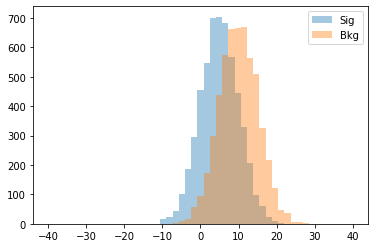

Fully supervised training datasets:
Training data shape: (1000, 1) Labels shape: (1000, 1)
Testing data shape: (10000, 1) Labels shape: (10000, 1)


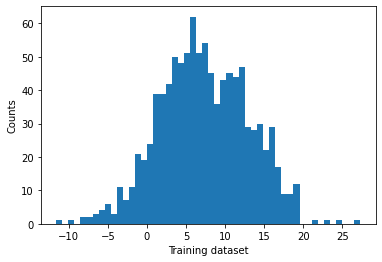

In [3]:
# Generate the data


N_train = 1000.0 # number of training samples
N_test = 10000.0 # number of testing samples

test_frac = N_test/(N_test+N_train)
N_tot = N_train+N_test

num_sig = int(N_tot/2)
num_bkg = int(N_tot/2)


ful_sup_sig = np.random.normal(sig_mean, sig_std, num_sig)
ful_sup_bkg = np.random.normal(bkg_mean, bkg_std, num_bkg)

bins = np.linspace(-40, 40, 50)
centers = .5*(bins[1:] + bins[:-1])

plt.figure()
plt.hist(ful_sup_sig, bins, label = "Sig", alpha = 0.4)
plt.hist(ful_sup_bkg, bins, label = "Bkg", alpha = 0.4)
plt.legend()
plt.show()

# Make the training datasets

ful_sup_data_train, ful_sup_labels_train, ful_sup_data_test, ful_sup_labels_test = generate_train_test_val(ful_sup_sig, ful_sup_bkg,                                                                                                                                    test_frac)  


print("Fully supervised training datasets:")
print("Training data shape:", ful_sup_data_train.shape, "Labels shape:", ful_sup_labels_train.shape)
print("Testing data shape:", ful_sup_data_test.shape, "Labels shape:", ful_sup_labels_test.shape)

plt.figure()
plt.hist(ful_sup_data_train, bins = 50)
plt.xlabel("Training dataset")
plt.ylabel("Counts")
plt.show()



### Data preparation: CWoLa

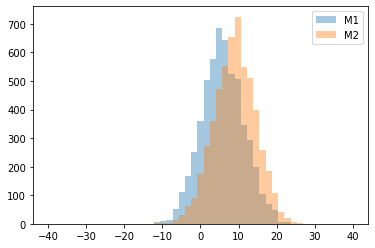

CWoLa training datasets:
Training data shape: (1000, 1) Labels shape: (1000, 1)
Testing data shape: (10000, 1) Labels shape: (10000, 1)


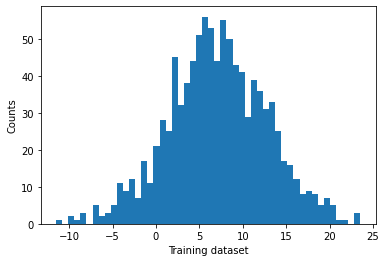

In [4]:
# Generate the data

num_M1 = num_sig
num_M2 = num_bkg


sig_set = np.random.normal(sig_mean, sig_std, num_sig)
bkg_set = np.random.normal(bkg_mean, bkg_std, num_bkg)

f1 = .8
f2 = 1.0 - f1

mixed_samp_1 = generate_mixed_sample(sig_set, bkg_set, num_M1, f1)
mixed_samp_2 = generate_mixed_sample(sig_set, bkg_set, num_M2, f2)


plt.figure()
plt.hist(mixed_samp_1, bins, label = "M1", alpha = 0.4)
plt.hist(mixed_samp_2, bins, label = "M2", alpha = 0.4)
plt.legend()
plt.show()

# Make the training datasets

CWoLa_data_train, CWoLa_labels_train, CWoLa_data_test, CWoLa_labels_test = generate_train_test_val(mixed_samp_1, mixed_samp_2,
                                                                                                                                    test_frac)  


print("CWoLa training datasets:")
print("Training data shape:", CWoLa_data_train.shape, "Labels shape:", CWoLa_labels_train.shape)
print("Testing data shape:", CWoLa_data_test.shape, "Labels shape:", CWoLa_labels_test.shape)

plt.figure()
plt.hist(CWoLa_data_train, bins = 50)
plt.xlabel("Training dataset")
plt.ylabel("Counts")
plt.show()

### Running the binary classifier: Fully supervised

0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
1.0 0.0 999999.0
1.0 1.0 1.0
16.0 0.0 999999.0
24.0 1.0 24.0
45.0 4.0 11.25
102.0 10.0 10.2
186.0 17.0 10.941176470588236
296.0 56.0 5.285714285714286
455.0 93.0 4.89247311827957
547.0 173.0 3.161849710982659
701.0 299.0 2.3444816053511706
704.0 438.0 1.6073059360730593
684.0 575.0 1.1895652173913043
567.0 663.0 0.8552036199095022
445.0 666.0 0.6681681681681682
329.0 668.0 0.49251497005988026
205.0 563.0 0.3641207815275311
97.0 509.0 0.1905697445972495
62.0 327.0 0.18960244648318042
22.0 218.0 0.10091743119266056
8.0 122.0 0.06557377049180328
2.0 46.0 0.043478260869565216
1.0 36.0 0.027777777777777776
0.0 5.0 0.0
0.0 7.0 0.0
0.0 2.0 0.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


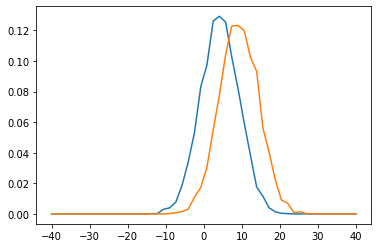

0.7581177400000002


In [18]:


def make_CWoLa_classifier(M1_train, M2_train, bins):
    
    """
    INPUTS
    M1_train, M2_train are the training samples for mixtures M1, M2
    """
    
    M1_binned, _ = np.histogram(M1_train, bins)
    M2_binned, _ = np.histogram(M2_train, bins)
    
    M1_binned = M1_binned.astype("float64")
    M2_binned = M2_binned.astype("float64")
    
    
    
    
    
    #likelihood_ratio = np.divide(M1_binned, M2_binned, out=np.zeros_like(M1_binned), where=M2_binned!=0)
    likelihood_ratio = np.nan_to_num(M1_binned/M2_binned,posinf=999999,neginf=999999,nan=1)
    
    for i in range(len(M2_binned)):
        print(M1_binned[i], M2_binned[i], likelihood_ratio[i])
    
    return likelihood_ratio

def calculate_AUC(test_sample, test_labels, bins, likelihood_ratio):
    # taken from the CWoLa paper, eq. 3.5
    
    bin_width = bins[1] - bins[0]
    
    # make dictionaries for num_sig, num_bkg per bin, denoted by the left bin edge
    num_sig_per_bin = {x:0 for x in bins}
    num_bkg_per_bin = {x:0 for x in bins}
    
    # go through the test data 
    for i in range(len(test_sample)):
        
        # assign each data point to a bin
        for bin_edge in bins:
            if (test_sample[i] >= bin_edge) and (test_sample[i] < (bin_edge + bin_width)):
                
                # increment num_sig_per_bin or num_bkg_per_bin
                if test_labels[i] == 1:
                    num_sig_per_bin[bin_edge] += 1
                elif test_labels[i] == 0:
                    num_bkg_per_bin[bin_edge] += 1
                
                break
                
    # make dictionaries for the conditional probabilities prob(bin | S/B)
    prob_bin_given_sig = {x:0 for x in bins}
    prob_bin_given_bkg = {x:0 for x in bins}
    
    num_sig = np.sum(list(num_sig_per_bin.values()))
    num_bkg = np.sum(list(num_bkg_per_bin.values()))
    
    prob_sig = []
    prob_bkg = []
    
    for bin_edge in bins:
        prob_bin_given_sig[bin_edge] = num_sig_per_bin[bin_edge] / num_sig
        prob_bin_given_bkg[bin_edge] = num_bkg_per_bin[bin_edge] / num_bkg
        prob_sig.append(prob_bin_given_sig[bin_edge])
        prob_bkg.append(prob_bin_given_bkg[bin_edge])
        
    
    
    plt.figure()
    plt.plot(bins, prob_sig)
    plt.plot(bins, prob_bkg)
    plt.show()
             
    # now compute the AUC
    AUC = 0
    
    # first term in the sum
    for bin_i in range(0, len(bins)):
        for bin_j in range(bin_i+1, len(bins)):
            #print(bin_i, bin_j)
            bin_edge_i = bins[bin_i]
            bin_edge_j = bins[bin_j]
            AUC += prob_bin_given_sig[bin_edge_i]*prob_bin_given_bkg[bin_edge_j]
            
    # second term in the sum
    for bin_i in range(0, len(bins)):
        bin_edge_i = bins[bin_i]
        AUC += (0.5)*prob_bin_given_sig[bin_edge_i]*prob_bin_given_bkg[bin_edge_i]
        
    if AUC < 0.5:
        AUC = 1.0 - AUC
            
    return(AUC)
    
# run it on the fully supervised case
    
full_sup_likelihood_ratio = make_CWoLa_classifier(ful_sup_sig, ful_sup_bkg, bins)

full_sup_AUC = calculate_AUC(ful_sup_data_test, ful_sup_labels_test, bins, full_sup_likelihood_ratio)





print(full_sup_AUC)




### Do the CWoLa training for a range of mixed sample fractions

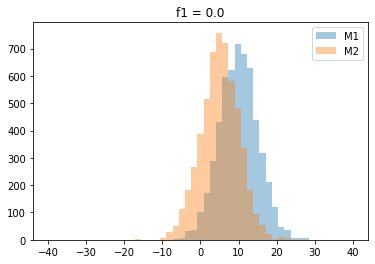

Starting CWoLa training run with f1 = 0.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 2.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 5.0 0.0
0.0 27.0 0.0
3.0 52.0 0.057692307692307696
8.0 112.0 0.07142857142857142
32.0 183.0 0.17486338797814208
36.0 268.0 0.13432835820895522
102.0 387.0 0.26356589147286824
173.0 514.0 0.33657587548638135
287.0 689.0 0.41654571843251087
430.0 758.0 0.5672823218997362
597.0 722.0 0.8268698060941828
620.0 582.0 1.0652920962199313
717.0 484.0 1.4814049586776858
680.0 335.0 2.029850746268657
630.0 183.0 3.442622950819672
437.0 96.0 4.552083333333333
319.0 55.0 5.8
211.0 23.0 9.173913043478262
119.0 4.0 29.75
48.0 12.0 4.0
35.0 7.0 5.0
5.0 0.0 999999.0
6.0 0.0 999999.0
5.0 0.0 999999.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


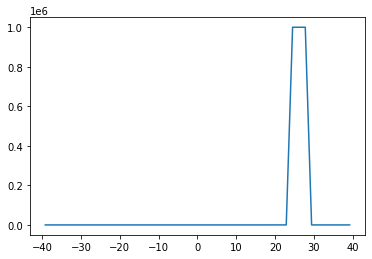

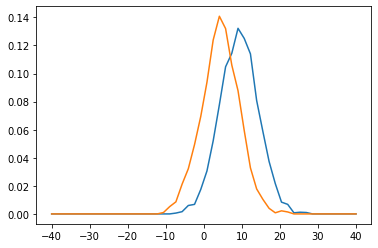

AUC: 0.7565567



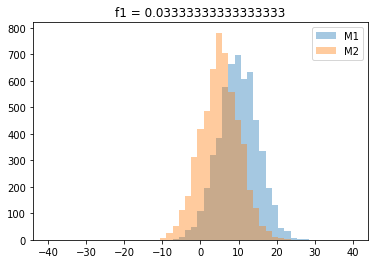

Starting CWoLa training run with f1 = 0.03333333333333333
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 8.0 0.0
1.0 25.0 0.04
3.0 53.0 0.05660377358490566
10.0 112.0 0.08928571428571429
37.0 166.0 0.22289156626506024
48.0 313.0 0.15335463258785942
109.0 420.0 0.25952380952380955
196.0 486.0 0.40329218106995884
322.0 644.0 0.5
385.0 782.0 0.49232736572890023
576.0 706.0 0.8158640226628895
663.0 557.0 1.1903052064631956
699.0 453.0 1.5430463576158941
607.0 362.0 1.6767955801104972
635.0 188.0 3.377659574468085
453.0 119.0 3.80672268907563
337.0 51.0 6.607843137254902
197.0 35.0 5.628571428571429
133.0 9.0 14.777777777777779
44.0 8.0 5.5
34.0 3.0 11.333333333333334
6.0 0.0 999999.0
3.0 0.0 999999.0
2.0 0.0 999999.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


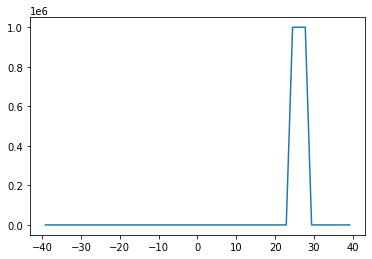

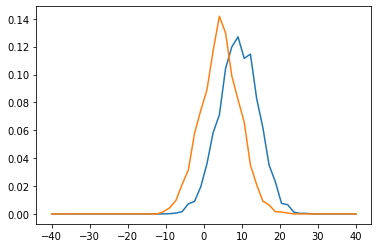

AUC: 0.7455668



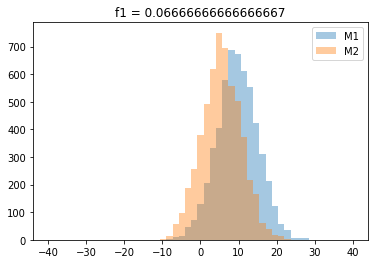

Starting CWoLa training run with f1 = 0.06666666666666667
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
1.0 1.0 1.0
0.0 4.0 0.0
3.0 15.0 0.2
10.0 59.0 0.1694915254237288
14.0 97.0 0.14432989690721648
48.0 186.0 0.25806451612903225
70.0 258.0 0.2713178294573643
131.0 381.0 0.3438320209973753
206.0 491.0 0.4195519348268839
331.0 618.0 0.5355987055016181
406.0 750.0 0.5413333333333333
580.0 696.0 0.8333333333333334
688.0 556.0 1.2374100719424461
673.0 501.0 1.343313373253493
610.0 373.0 1.6353887399463807
553.0 217.0 2.5483870967741935
424.0 167.0 2.538922155688623
312.0 60.0 5.2
212.0 38.0 5.578947368421052
121.0 16.0 7.5625
56.0 12.0 4.666666666666667
34.0 3.0 11.333333333333334
6.0 1.0 6.0
6.0 0.0 999999.0
5.0 0.0 999999.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


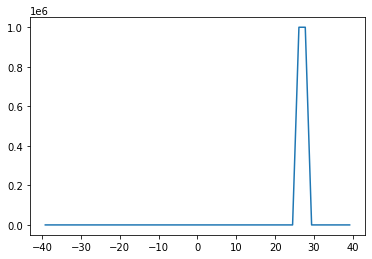

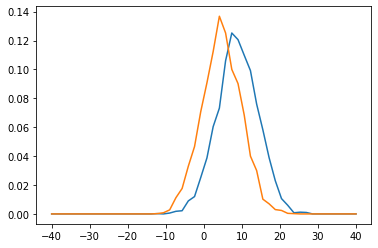

AUC: 0.7116276800000001



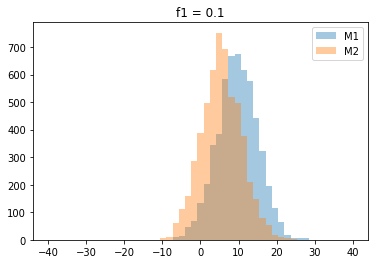

Starting CWoLa training run with f1 = 0.1
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 7.0 0.0
0.0 9.0 0.0
9.0 61.0 0.14754098360655737
15.0 111.0 0.13513513513513514
48.0 159.0 0.3018867924528302
70.0 287.0 0.24390243902439024
133.0 389.0 0.34190231362467866
204.0 498.0 0.40963855421686746
344.0 615.0 0.5593495934959349
386.0 752.0 0.5132978723404256
583.0 692.0 0.8424855491329479
666.0 519.0 1.283236994219653
674.0 495.0 1.3616161616161617
617.0 376.0 1.6409574468085106
575.0 209.0 2.751196172248804
441.0 149.0 2.959731543624161
322.0 80.0 4.025
196.0 55.0 3.5636363636363635
116.0 18.0 6.444444444444445
65.0 9.0 7.222222222222222
18.0 6.0 3.0
7.0 2.0 3.5
5.0 0.0 999999.0
6.0 0.0 999999.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


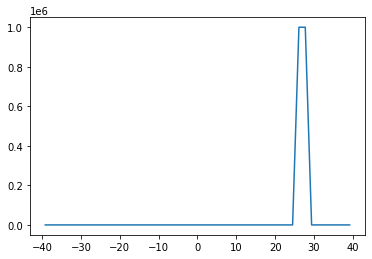

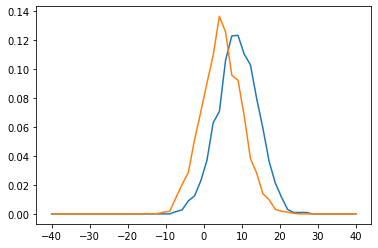

AUC: 0.7115996



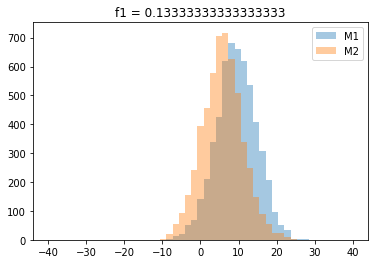

Starting CWoLa training run with f1 = 0.13333333333333333
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
1.0 4.0 0.25
4.0 20.0 0.2
14.0 54.0 0.25925925925925924
20.0 92.0 0.21739130434782608
50.0 156.0 0.32051282051282054
67.0 243.0 0.2757201646090535
140.0 395.0 0.35443037974683544
211.0 458.0 0.4606986899563319
337.0 579.0 0.5820379965457686
424.0 706.0 0.6005665722379604
620.0 717.0 0.8647140864714087
682.0 627.0 1.087719298245614
662.0 510.0 1.2980392156862746
620.0 340.0 1.8235294117647058
536.0 247.0 2.1700404858299596
407.0 149.0 2.7315436241610738
309.0 91.0 3.3956043956043955
206.0 54.0 3.814814814814815
97.0 24.0 4.041666666666667
50.0 22.0 2.272727272727273
34.0 8.0 4.25
4.0 3.0 1.3333333333333333
3.0 0.0 999999.0
2.0 0.0 999999.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0

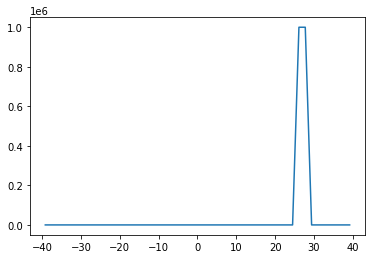

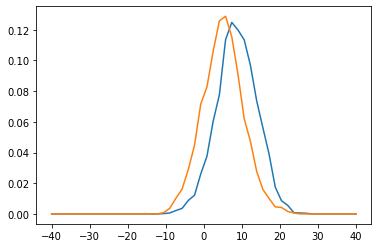

AUC: 0.68821492



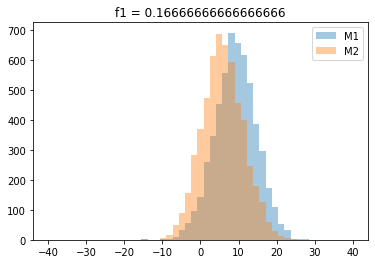

Starting CWoLa training run with f1 = 0.16666666666666666
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
1.0 3.0 0.3333333333333333
0.0 0.0 1.0
0.0 0.0 1.0
1.0 6.0 0.16666666666666666
3.0 16.0 0.1875
10.0 48.0 0.20833333333333334
32.0 88.0 0.36363636363636365
55.0 157.0 0.3503184713375796
95.0 284.0 0.3345070422535211
142.0 368.0 0.3858695652173913
260.0 474.0 0.5485232067510548
346.0 612.0 0.565359477124183
454.0 685.0 0.6627737226277373
556.0 650.0 0.8553846153846154
690.0 592.0 1.1655405405405406
657.0 457.0 1.437636761487965
617.0 399.0 1.5463659147869675
522.0 246.0 2.1219512195121952
386.0 178.0 2.168539325842697
296.0 126.0 2.3492063492063493
174.0 60.0 2.9
110.0 29.0 3.793103448275862
54.0 13.0 4.153846153846154
32.0 5.0 6.4
3.0 4.0 0.75
2.0 0.0 999999.0
2.0 0.0 999999.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0

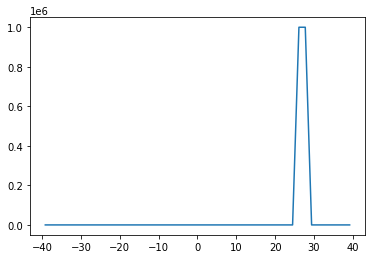

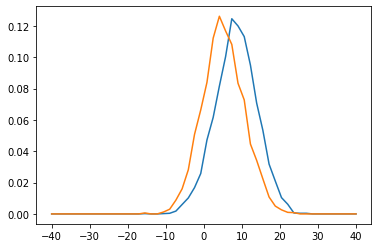

AUC: 0.6708685999999999



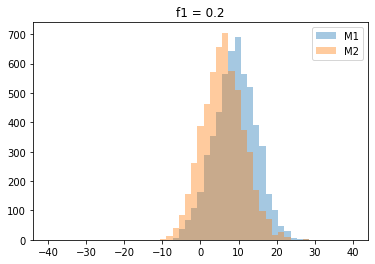

Starting CWoLa training run with f1 = 0.2
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
1.0 4.0 0.25
1.0 13.0 0.07692307692307693
6.0 40.0 0.15
36.0 85.0 0.4235294117647059
69.0 157.0 0.4394904458598726
107.0 263.0 0.4068441064638783
162.0 386.0 0.41968911917098445
289.0 461.0 0.6268980477223427
353.0 571.0 0.6182136602451839
436.0 657.0 0.6636225266362252
564.0 705.0 0.8
644.0 576.0 1.1180555555555556
690.0 509.0 1.3555992141453832
566.0 373.0 1.517426273458445
521.0 299.0 1.7424749163879598
392.0 171.0 2.2923976608187133
321.0 98.0 3.2755102040816326
156.0 70.0 2.2285714285714286
101.0 18.0 5.611111111111111
47.0 27.0 1.7407407407407407
29.0 9.0 3.2222222222222223
5.0 1.0 5.0
2.0 1.0 2.0
2.0 4.0 0.5
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


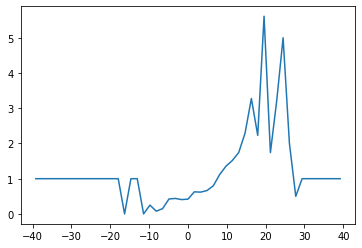

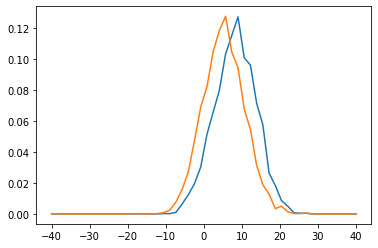

AUC: 0.6523666600000002



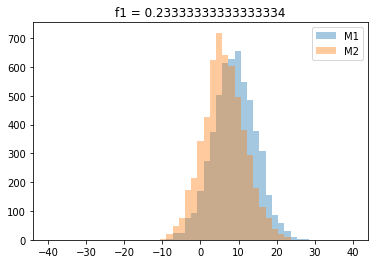

Starting CWoLa training run with f1 = 0.23333333333333334
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
1.0 4.0 0.25
4.0 19.0 0.21052631578947367
23.0 48.0 0.4791666666666667
25.0 75.0 0.3333333333333333
77.0 172.0 0.4476744186046512
94.0 216.0 0.4351851851851852
170.0 342.0 0.49707602339181284
273.0 425.0 0.6423529411764706
373.0 624.0 0.5977564102564102
503.0 719.0 0.6995827538247567
614.0 640.0 0.959375
629.0 605.0 1.0396694214876032
655.0 496.0 1.3205645161290323
547.0 380.0 1.4394736842105262
484.0 296.0 1.635135135135135
377.0 179.0 2.106145251396648
308.0 115.0 2.6782608695652175
156.0 74.0 2.108108108108108
87.0 36.0 2.4166666666666665
57.0 21.0 2.7142857142857144
30.0 10.0 3.0
9.0 1.0 9.0
2.0 0.0 999999.0
2.0 1.0 2.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


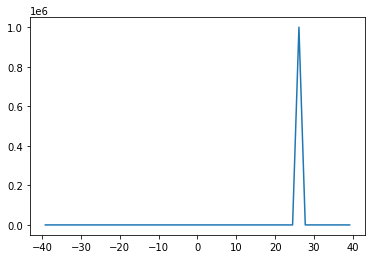

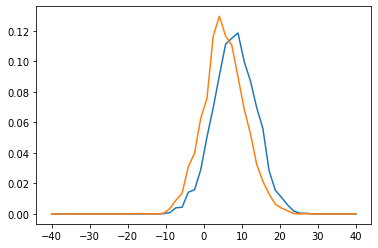

AUC: 0.6418891200000003



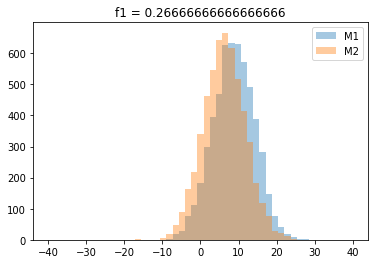

Starting CWoLa training run with f1 = 0.26666666666666666
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 5.0 0.0
4.0 18.0 0.2222222222222222
19.0 48.0 0.3958333333333333
27.0 88.0 0.3068181818181818
76.0 163.0 0.4662576687116564
111.0 219.0 0.5068493150684932
182.0 340.0 0.5352941176470588
297.0 461.0 0.6442516268980477
395.0 546.0 0.7234432234432234
468.0 641.0 0.7301092043681747
626.0 666.0 0.93993993993994
633.0 616.0 1.0275974025974026
631.0 517.0 1.2205029013539652
573.0 414.0 1.3840579710144927
491.0 314.0 1.5636942675159236
389.0 182.0 2.1373626373626373
281.0 119.0 2.361344537815126
147.0 77.0 1.9090909090909092
78.0 29.0 2.689655172413793
40.0 22.0 1.8181818181818181
19.0 11.0 1.7272727272727273
9.0 3.0 3.0
1.0 0.0 999999.0
3.0 0.0 999999.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0

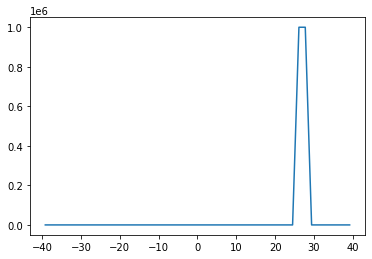

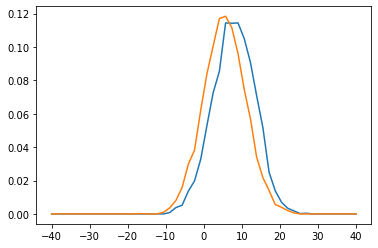

AUC: 0.6233717999999999



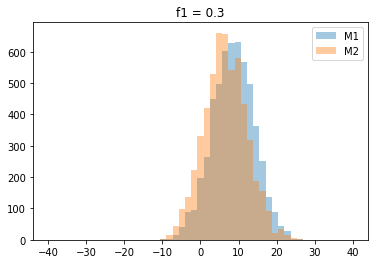

Starting CWoLa training run with f1 = 0.3
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
3.0 3.0 1.0
4.0 15.0 0.26666666666666666
16.0 44.0 0.36363636363636365
41.0 97.0 0.422680412371134
88.0 136.0 0.6470588235294118
94.0 223.0 0.42152466367713004
198.0 331.0 0.5981873111782477
263.0 420.0 0.6261904761904762
449.0 530.0 0.8471698113207548
498.0 661.0 0.7534039334341907
604.0 657.0 0.9193302891933028
629.0 542.0 1.1605166051660516
631.0 580.0 1.0879310344827586
569.0 432.0 1.3171296296296295
496.0 317.0 1.5646687697160884
363.0 188.0 1.9308510638297873
250.0 156.0 1.6025641025641026
137.0 91.0 1.5054945054945055
89.0 22.0 4.045454545454546
44.0 34.0 1.2941176470588236
29.0 15.0 1.9333333333333333
3.0 5.0 0.6
2.0 1.0 2.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


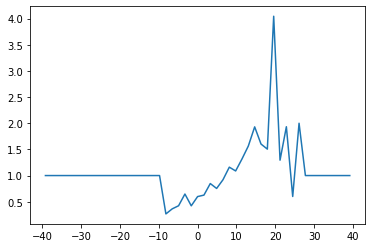

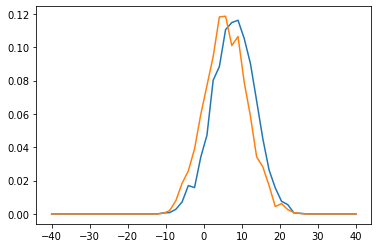

AUC: 0.6054531599999999



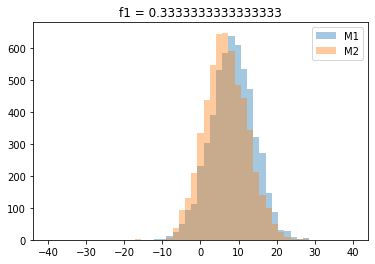

Starting CWoLa training run with f1 = 0.3333333333333333
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
1.0 0.0 999999.0
1.0 0.0 999999.0
13.0 6.0 2.1666666666666665
23.0 38.0 0.6052631578947368
50.0 93.0 0.5376344086021505
94.0 131.0 0.7175572519083969
111.0 208.0 0.5336538461538461
232.0 334.0 0.6946107784431138
304.0 438.0 0.6940639269406392
392.0 548.0 0.7153284671532847
533.0 646.0 0.8250773993808049
584.0 649.0 0.8998459167950693
638.0 591.0 1.0795262267343486
611.0 486.0 1.257201646090535
535.0 445.0 1.202247191011236
473.0 345.0 1.3710144927536232
322.0 214.0 1.5046728971962617
271.0 141.0 1.9219858156028369
146.0 99.0 1.4747474747474747
87.0 49.0 1.7755102040816326
32.0 23.0 1.391304347826087
29.0 10.0 2.9
10.0 3.0 3.3333333333333335
3.0 1.0 3.0
5.0 1.0 5.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.

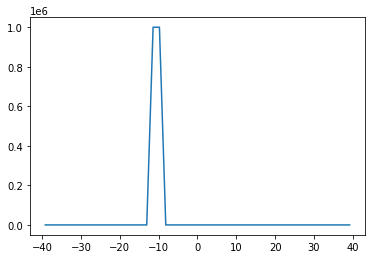

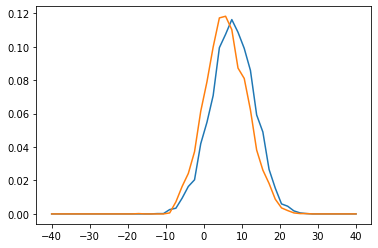

AUC: 0.5877286



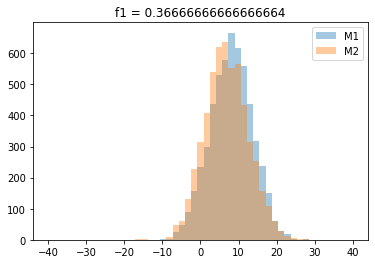

Starting CWoLa training run with f1 = 0.36666666666666664
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 2.0 0.0
0.0 2.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
2.0 0.0 999999.0
3.0 10.0 0.3
26.0 47.0 0.5531914893617021
46.0 62.0 0.7419354838709677
88.0 131.0 0.6717557251908397
157.0 229.0 0.6855895196506551
234.0 313.0 0.7476038338658147
299.0 409.0 0.7310513447432763
438.0 541.0 0.8096118299445472
531.0 621.0 0.855072463768116
578.0 635.0 0.9102362204724409
666.0 554.0 1.2021660649819494
617.0 566.0 1.0901060070671378
558.0 435.0 1.282758620689655
436.0 314.0 1.3885350318471337
317.0 253.0 1.2529644268774704
238.0 157.0 1.515923566878981
149.0 109.0 1.3669724770642202
61.0 61.0 1.0
29.0 29.0 1.0
20.0 11.0 1.8181818181818181
4.0 5.0 0.8
0.0 2.0 0.0
3.0 2.0 1.5
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


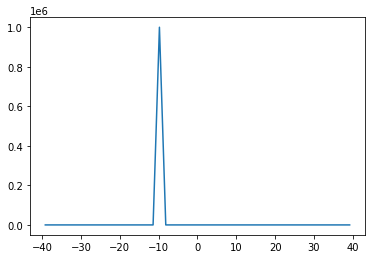

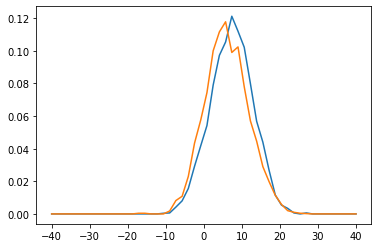

AUC: 0.56754294



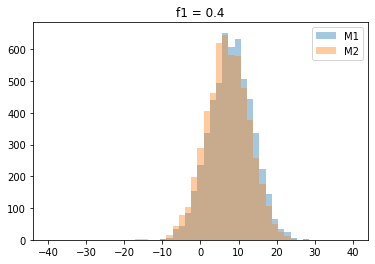

Starting CWoLa training run with f1 = 0.4
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 2.0 0.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
4.0 2.0 2.0
6.0 15.0 0.4
34.0 42.0 0.8095238095238095
43.0 78.0 0.5512820512820513
83.0 102.0 0.8137254901960784
153.0 198.0 0.7727272727272727
234.0 288.0 0.8125
337.0 405.0 0.8320987654320988
439.0 463.0 0.9481641468682506
493.0 619.0 0.7964458804523424
652.0 644.0 1.0124223602484472
606.0 581.0 1.0430292598967297
632.0 580.0 1.089655172413793
505.0 478.0 1.0564853556485356
442.0 376.0 1.175531914893617
335.0 256.0 1.30859375
223.0 175.0 1.2742857142857142
145.0 106.0 1.3679245283018868
67.0 49.0 1.3673469387755102
33.0 25.0 1.32
26.0 11.0 2.3636363636363638
7.0 2.0 3.5
0.0 0.0 1.0
1.0 2.0 0.5
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0


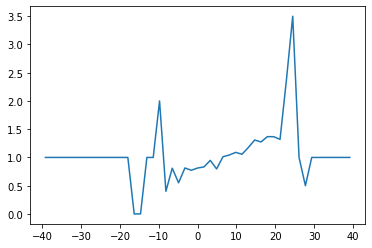

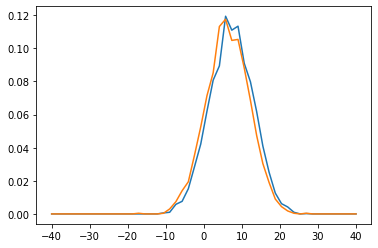

AUC: 0.54616698



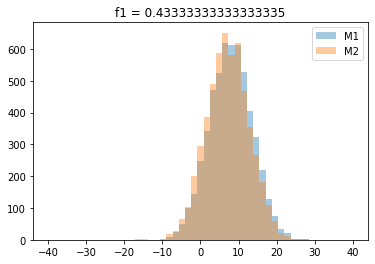

Starting CWoLa training run with f1 = 0.43333333333333335
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 1.0 0.0
0.0 1.0 0.0
0.0 0.0 1.0
0.0 0.0 1.0
3.0 0.0 999999.0
8.0 17.0 0.47058823529411764
23.0 28.0 0.8214285714285714
51.0 66.0 0.7727272727272727
100.0 103.0 0.970873786407767
144.0 199.0 0.7236180904522613
247.0 295.0 0.8372881355932204
343.0 385.0 0.8909090909090909
470.0 490.0 0.9591836734693877
525.0 588.0 0.8928571428571429
620.0 651.0 0.9523809523809523
612.0 582.0 1.0515463917525774
612.0 618.0 0.9902912621359223
528.0 469.0 1.1257995735607675
406.0 354.0 1.1468926553672316
324.0 267.0 1.2134831460674158
220.0 182.0 1.2087912087912087
128.0 108.0 1.1851851851851851
74.0 58.0 1.2758620689655173
35.0 20.0 1.75
20.0 13.0 1.5384615384615385
3.0 3.0 1.0
1.0 1.0 1.0
3.0 1.0 3.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 1.0
0.0 0.0 

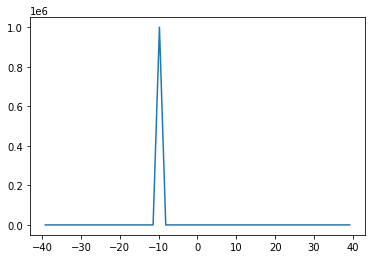

KeyboardInterrupt: 

In [19]:
# Always pull from the same signal / background samples (so we don't have to regenerate)



sig_set = np.random.normal(sig_mean, sig_std, num_sig)
bkg_set = np.random.normal(bkg_mean, bkg_std, num_bkg)
num_M1 = num_sig
num_M2 = num_bkg


f1_vals = []
ROC_AUC_vals = []

for f1 in np.linspace(0,1,31):
    
    f1_vals.append(f1)
    f2 = 1.0 - f1
    
    # Generate the mixed samples
    mixed_samp_1 = generate_mixed_sample(sig_set, bkg_set, num_M1, f1)
    mixed_samp_2 = generate_mixed_sample(sig_set, bkg_set, num_M2, f2)
    
    # Plot the mixed samples
    
    plt.figure()
    plt.hist(mixed_samp_1, bins, label = "M1", alpha = 0.4)
    plt.hist(mixed_samp_2, bins, label = "M2", alpha = 0.4)
    plt.title("f1 = "+str(f1))
    plt.legend()
    plt.show()

    # Make the training datasets
    CWoLa_data_train, CWoLa_labels_train, CWoLa_data_test, CWoLa_labels_test = generate_train_test_val(mixed_samp_1, mixed_samp_2,                                                                                                                               test_frac)  

    # Run the classifier

    
    print("Starting CWoLa training run with f1 =", f1)
    
    loc_likelihood_ratio = make_CWoLa_classifier(mixed_samp_1, mixed_samp_2, bins)
    
    
    
    plt.figure()
    plt.plot(centers, loc_likelihood_ratio)
    plt.show()
    
    loc_AUC = calculate_AUC(CWoLa_data_test, CWoLa_labels_test, bins, loc_likelihood_ratio)

    ROC_AUC_vals.append(loc_AUC)
    
    print("AUC:", loc_AUC)
    print()

    
    
    
    
    
    
    

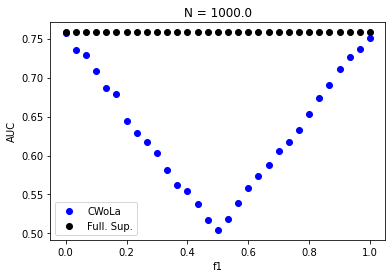

In [11]:
plt.figure()
plt.scatter(f1_vals,ROC_AUC_vals, label = "CWoLa", color = "b")
plt.scatter(f1_vals, np.full(len(f1_vals), full_sup_AUC), label = "Full. Sup.", color = "k")
plt.legend()

plt.xlabel("f1")
plt.ylabel("AUC")
plt.title("N = "+str(N_train))
plt.show()

# Ben's code

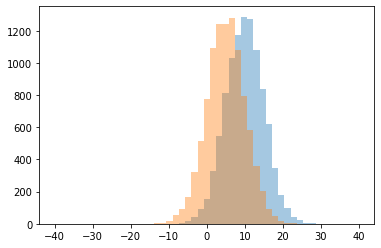

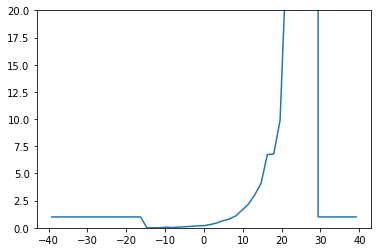

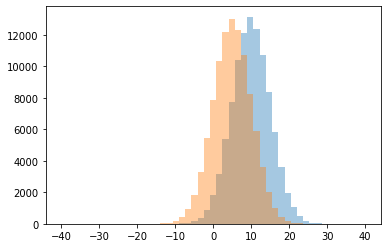

0 0.0
1 0.019230769230769232
2 0.0625
3 0.06521739130434782
4 0.0963855421686747
5 0.13395638629283488
6 0.1718146718146718
7 0.20258064516129032
8 0.29863013698630136
9 0.4396135265700483
10 0.655144694533762
11 0.8059467918622848
12 1.0
13 1.0861909175162188
14 1.620125786163522
15 2.1689419795221845
16 3.0280112044817926
17 4.087804878048781
18 6.739130434782608
19 6.784313725490196
20 9.88888888888889
21 22.0
22 22.5
23 24.75
24 999999.0




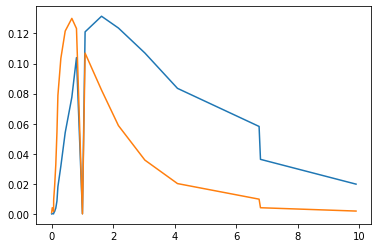

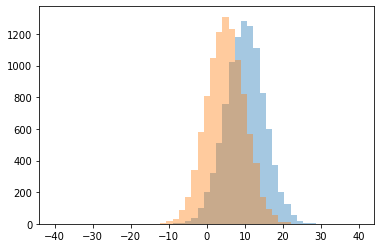

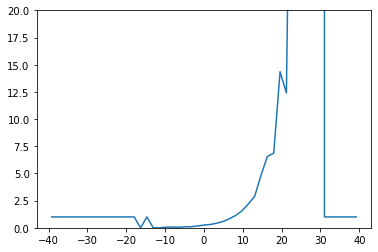

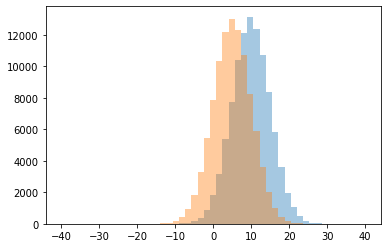

0 0.0
1 0.045454545454545456
2 0.058823529411764705
3 0.06666666666666667
4 0.09467455621301775
5 0.09970674486803519
6 0.17152658662092624
7 0.2506172839506173
8 0.3028571428571429
9 0.42326732673267325
10 0.5775401069518716
11 0.8306320907617504
12 1.0
13 1.1359691417550626
14 1.5658536585365854
15 2.193321616871705
16 2.9007832898172325
17 4.847953216374269
18 6.56043956043956
19 6.87037037037037
20 12.4
21 14.357142857142858
22 57.0
23 999999.0




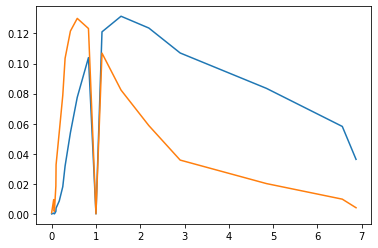

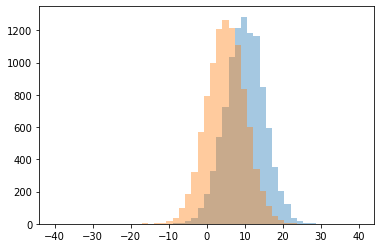

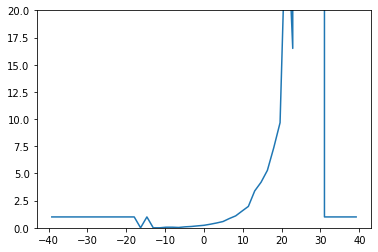

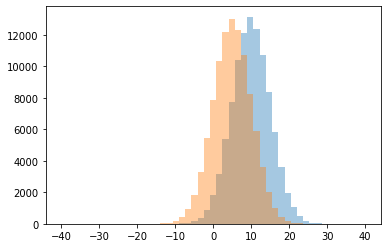

0 0.0
1 0.0297029702970297
2 0.05263157894736842
3 0.05405405405405406
4 0.08791208791208792
5 0.12074303405572756
6 0.17719298245614035
7 0.23008849557522124
8 0.32898696088264795
9 0.44426094137076794
10 0.5760697305863708
11 0.8519736842105263
12 1.0
13 1.096483318304779
14 1.5370813397129186
15 1.9667774086378738
16 3.39067055393586
17 4.188118811881188
18 5.283185840707965
19 7.354166666666667
20 9.666666666666666
21 16.5
22 30.25
23 999999.0




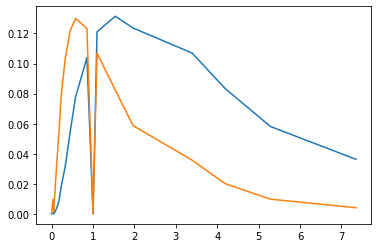

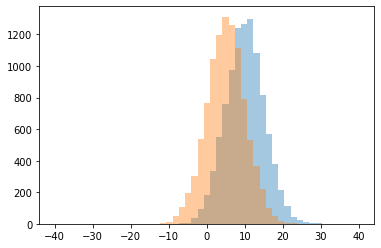

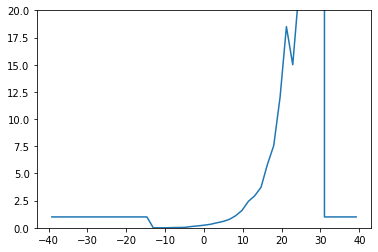

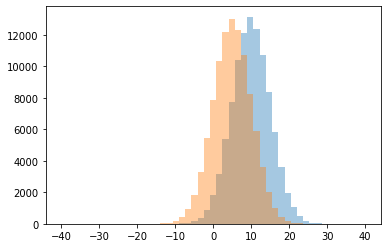

0 0.0
1 0.02
2 0.027522935779816515
3 0.04081632653061224
4 0.1180327868852459
5 0.17100371747211895
6 0.23989569752281617
7 0.3208453410182517
8 0.4562135112593828
9 0.5807926829268293
10 0.7738095238095238
11 1.0
12 1.1112107623318386
13 1.601010101010101
14 2.4296435272045027
15 2.9455040871934606
16 3.729357798165138
17 5.816326530612245
18 7.56
19 12.0
20 15.0
21 18.5
22 22.0
23 999999.0




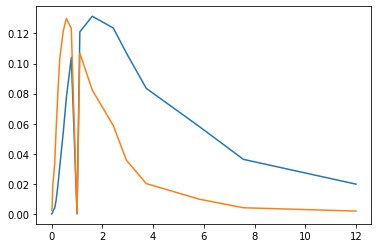

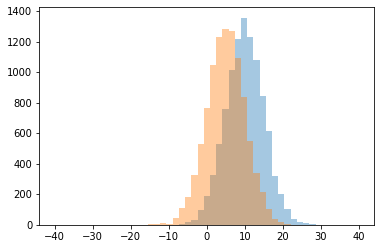

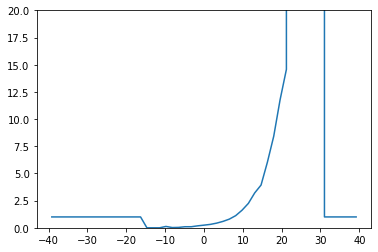

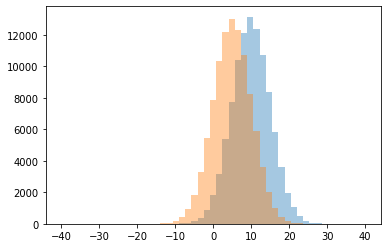

0 0.0
1 0.023255813953488372
2 0.03669724770642202
3 0.0972972972972973
4 0.09815950920245399
5 0.125
6 0.18026565464895636
7 0.24345549738219896
8 0.3135755258126195
9 0.42915309446254074
10 0.5892439594699922
11 0.7987371744277821
12 1.0
13 1.1173235563703026
14 1.6162097735399286
15 2.24408014571949
16 3.207715133531157
17 3.9302325581395348
18 6.029411764705882
19 8.421052631578947
20 11.764705882352942
21 14.571428571428571
22 999999.0




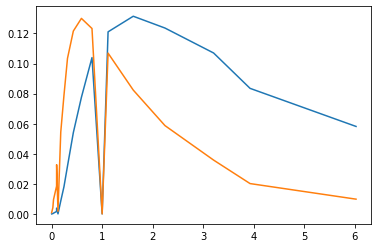

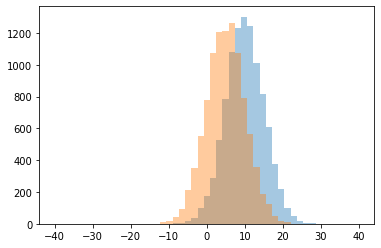

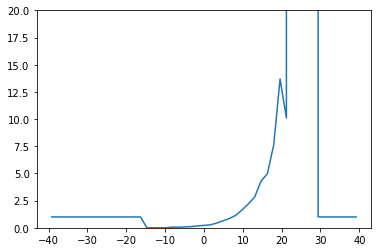

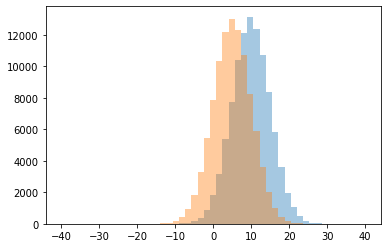

0 0.0
1 0.05319148936170213
2 0.06666666666666667
3 0.08372093023255814
4 0.10919540229885058
5 0.17689530685920576
6 0.2230769230769231
7 0.271455223880597
8 0.4348547717842324
9 0.6446826051112943
10 0.8544303797468354
11 1.0
12 1.1420612813370474
13 1.6418663303909204
14 2.1982300884955754
15 2.8375350140056024
16 4.301587301587301
17 4.967479674796748
18 7.63265306122449
19 10.1
20 13.6875
21 999999.0




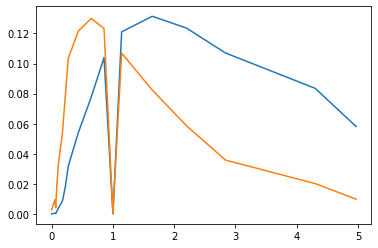

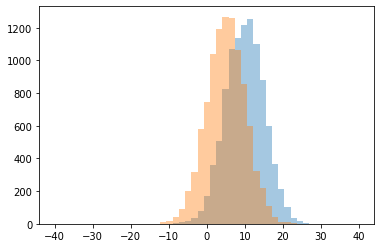

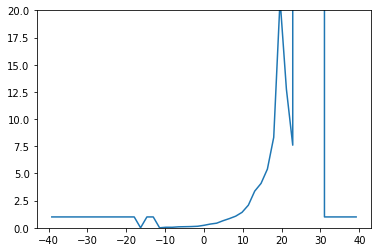

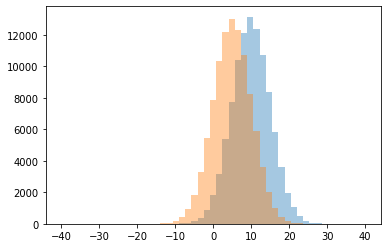

0 0.0
1 0.047619047619047616
2 0.05
3 0.0898876404494382
4 0.10101010101010101
5 0.11392405063291139
6 0.14038128249566725
7 0.22994652406417113
8 0.34390009606147937
9 0.4247266610597141
10 0.6495659037095501
11 0.8461538461538461
12 1.0
13 1.068609022556391
14 1.4212368728121354
15 2.08153078202995
16 3.371165644171779
17 4.083333333333333
18 5.396396396396397
19 7.6
20 8.318181818181818
21 12.75
22 21.0
23 999999.0




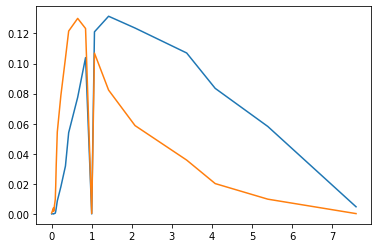

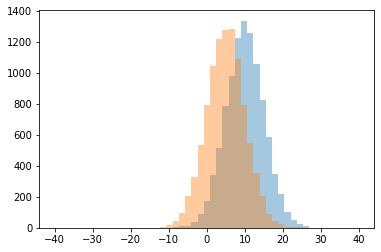

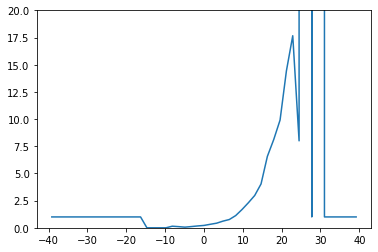

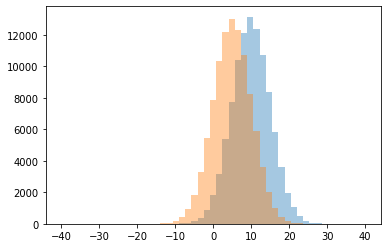

0 0.0
1 0.058823529411764705
2 0.10638297872340426
3 0.11246200607902736
4 0.14634146341463414
5 0.17009345794392525
6 0.21788413098236775
7 0.32344497607655504
8 0.42528735632183906
9 0.6142410015649452
10 0.7626854020296643
11 1.0
12 1.1236263736263736
13 1.6817610062893082
14 2.303473491773309
15 2.9719101123595504
16 4.034146341463415
17 6.573033707865169
18 8.0
19 8.116279069767442
20 9.909090909090908
21 14.428571428571429
22 17.666666666666668
23 999999.0




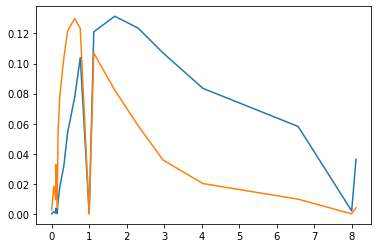

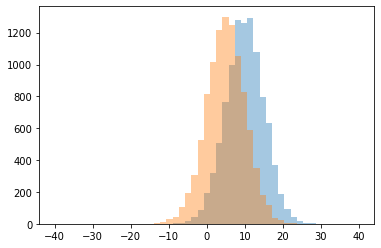

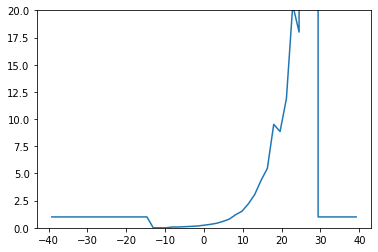

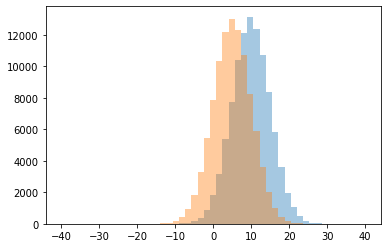

0 0.0
1 0.075
2 0.07547169811320754
3 0.10416666666666667
4 0.12987012987012986
5 0.166351606805293
6 0.23891625615763548
7 0.3159448818897638
8 0.41659819227608874
9 0.5884615384615385
10 0.8012820512820513
11 1.0
12 1.209280303030303
13 1.524848484848485
14 2.20442930153322
15 3.059659090909091
16 4.357142857142857
17 5.474137931034483
18 8.857142857142858
19 9.512820512820513
20 11.875
21 18.0
22 20.5
23 999999.0




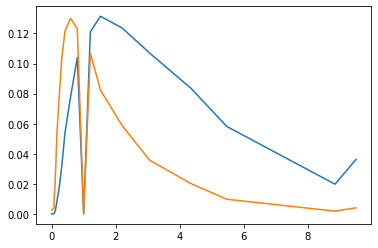

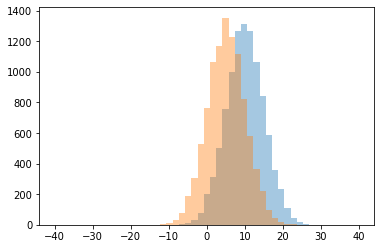

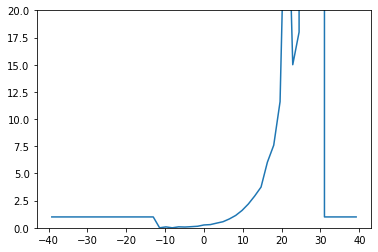

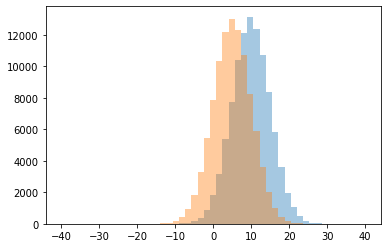

0 0.0
1 0.06989247311827956
2 0.08333333333333333
3 0.0875
4 0.10355987055016182
5 0.14124293785310735
6 0.2614980289093298
7 0.29350893697083724
8 0.43004291845493564
9 0.5587583148558758
10 0.8143322475570033
11 1.0
12 1.1364452423698383
13 1.5946601941747574
14 2.1917098445595853
15 2.9258241758241756
16 3.7455357142857144
17 6.030927835051546
18 7.595744680851064
19 11.6
20 15.0
21 18.0
22 36.666666666666664
23 999999.0




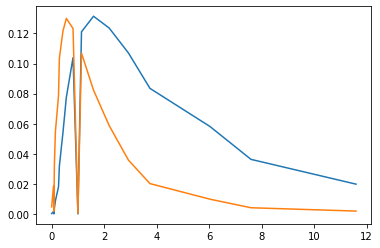

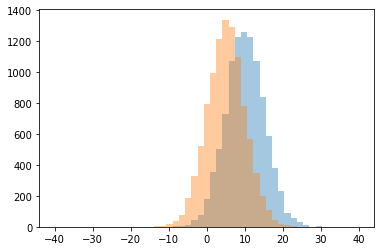

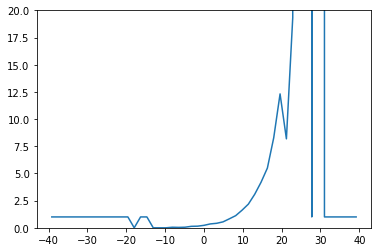

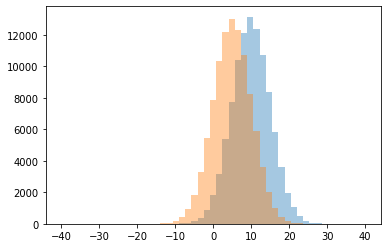

0 0.0
1 0.0379746835443038
2 0.05128205128205128
3 0.053475935828877004
4 0.13496932515337423
5 0.14971209213051823
6 0.22641509433962265
7 0.35678391959798994
8 0.4141331142152835
9 0.5447761194029851
10 0.8256172839506173
11 1.0
12 1.1166818596171377
13 1.6166666666666667
14 2.1769911504424777
15 3.0830945558739256
16 4.189054726368159
17 5.4953271028037385
18 8.181818181818182
19 8.282608695652174
20 12.31578947368421
21 19.333333333333332
22 999999.0




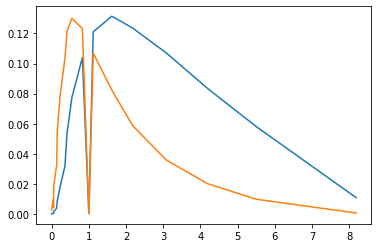

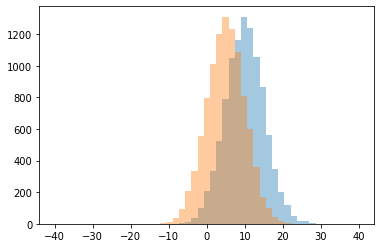

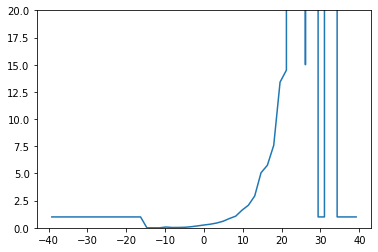

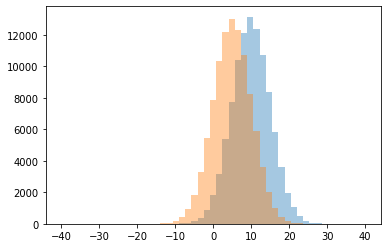

0 0.0
1 0.02857142857142857
2 0.03225806451612903
3 0.04830917874396135
4 0.07142857142857142
5 0.10119047619047619
6 0.17540687160940324
7 0.2565707133917397
8 0.33168805528134254
9 0.43869891576313597
10 0.6003051106025934
11 0.8495145631067961
12 1.0
13 1.0697247706422017
14 1.6212871287128714
15 2.0720268006700167
16 2.925414364640884
17 5.064327485380117
18 5.755102040816326
19 7.586956521739131
20 13.4
21 14.5
22 15.0
23 999999.0




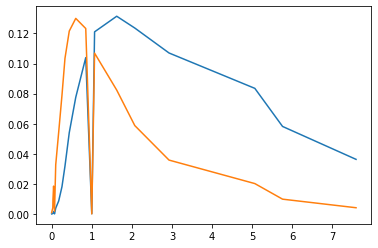

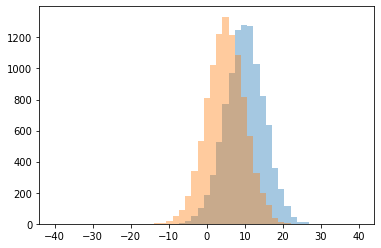

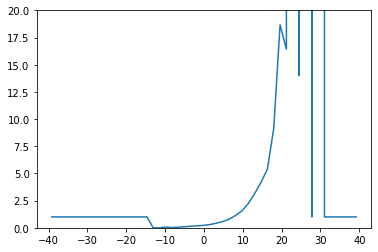

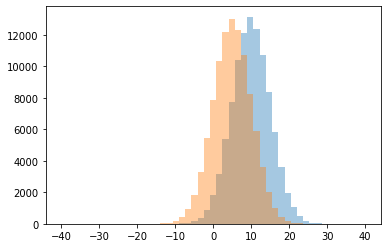

0 0.0
1 0.019230769230769232
2 0.05555555555555555
3 0.0625
4 0.0989010989010989
5 0.1436950146627566
6 0.1902071563088512
7 0.22772277227722773
8 0.30528375733855184
9 0.43218954248366015
10 0.5791447861965492
11 0.7970419063270336
12 1.0
13 1.1443014705882353
14 1.5672371638141809
15 2.2411971830985915
16 3.1529051987767582
17 4.187817258883249
18 5.398305084745763
19 9.128205128205128
20 14.0
21 16.428571428571427
22 18.666666666666668
23 999999.0




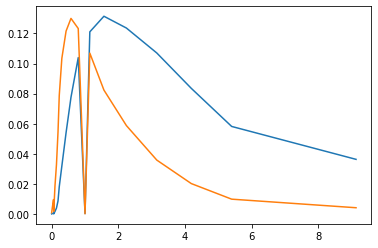

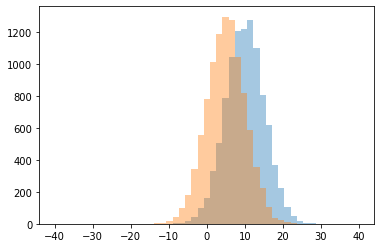

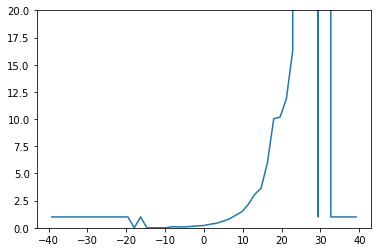

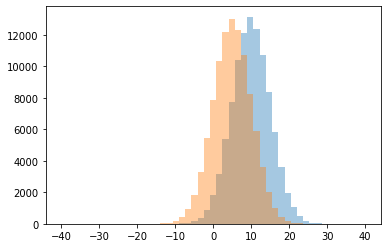

0 0.0
1 0.08333333333333333
2 0.08379888268156424
3 0.1
4 0.1264705882352941
5 0.1774193548387097
6 0.21025641025641026
7 0.3283877349159248
8 0.42304457527333894
9 0.6057098765432098
10 0.8169014084507042
11 1.0
12 1.15850144092219
13 1.485958485958486
14 2.1610169491525424
15 3.0754189944134076
16 3.6425339366515836
17 5.951923076923077
18 10.027027027027026
19 10.181818181818182
20 11.88888888888889
21 16.333333333333332
22 999999.0




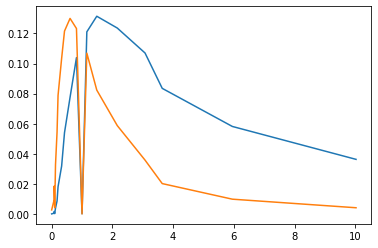

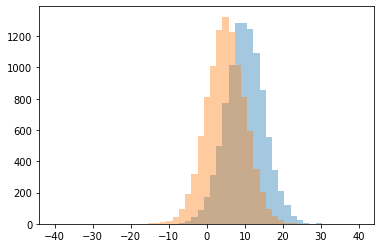

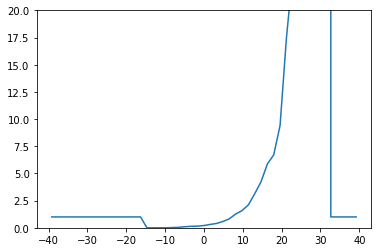

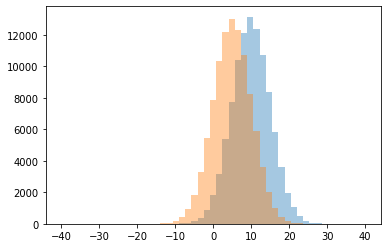

0 0.0
1 0.021739130434782608
2 0.043478260869565216
3 0.10106382978723404
4 0.13793103448275862
5 0.15302491103202848
6 0.2096177558569667
7 0.3118811881188119
8 0.3993558776167472
9 0.581570996978852
10 0.8287112561174551
11 1.0
12 1.267258382642998
13 1.5830258302583027
14 2.1030405405405403
15 3.1285714285714286
16 4.237623762376238
17 5.873684210526315
18 6.705882352941177
19 9.409090909090908
20 17.428571428571427
21 23.5
22 999999.0




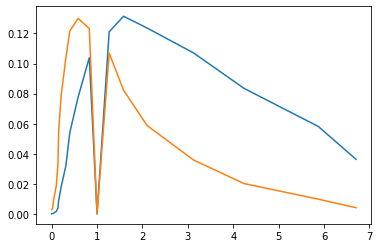

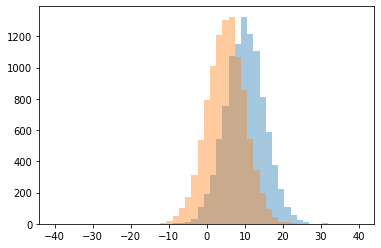

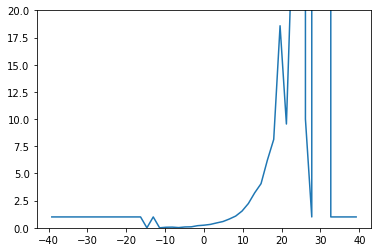

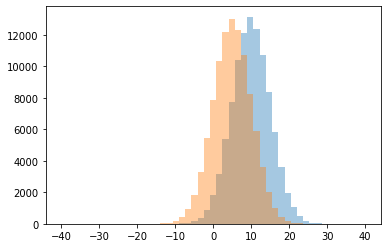

0 0.0
1 0.02
2 0.05
3 0.061224489795918366
4 0.07692307692307693
5 0.09003215434083602
6 0.19516728624535315
7 0.24050632911392406
8 0.3118811881188119
9 0.44896265560165977
10 0.5772482705611068
11 0.8083018867924529
12 1.0
13 1.0787992495309568
14 1.5378346915017462
15 2.2316176470588234
16 3.2186588921282797
17 4.06
18 6.223404255319149
19 8.130434782608695
20 9.545454545454545
21 10.0
22 18.583333333333332
23 27.5
24 999999.0




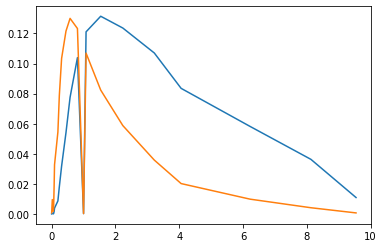

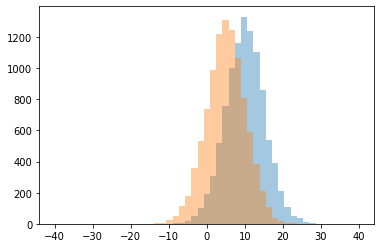

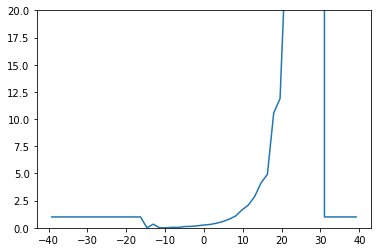

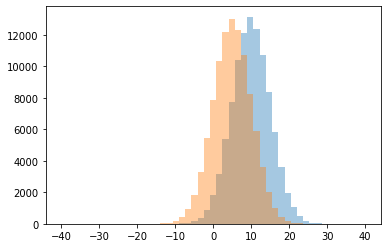

0 0.0
1 0.035398230088495575
2 0.04081632653061224
3 0.11666666666666667
4 0.1329639889196676
5 0.18679245283018867
6 0.2584573748308525
7 0.3114256825075834
8 0.3333333333333333
9 0.4245901639344262
10 0.5783040488922842
11 0.8011226944667201
12 1.0
13 1.0880149812734083
14 1.6452410383189122
15 2.093062605752961
16 2.8802083333333335
17 4.1298076923076925
18 4.918181818181818
19 10.567567567567568
20 11.88888888888889
21 26.0
22 26.5
23 37.0
24 999999.0




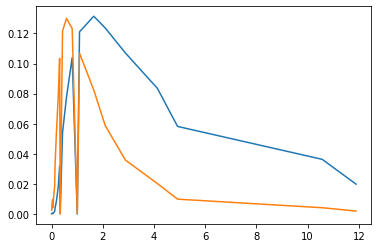

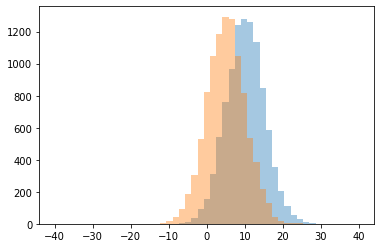

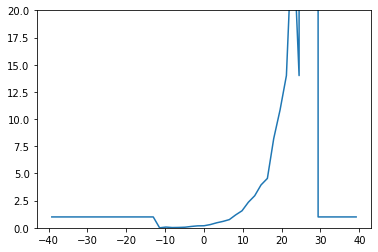

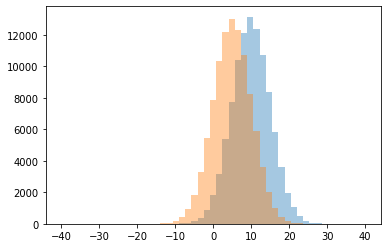

0 0.0
1 0.022727272727272728
2 0.03296703296703297
3 0.05319148936170213
4 0.06666666666666667
5 0.12459016393442623
6 0.17836812144212524
7 0.18757612667478685
8 0.2966507177033493
9 0.459915611814346
10 0.5893271461716937
11 0.7543035993740219
12 1.0
13 1.1872015281757402
14 1.565483476132191
15 2.3514018691588787
16 2.948186528497409
17 3.944186046511628
18 4.542635658914729
19 8.209302325581396
20 10.842105263157896
21 14.0
22 28.0
23 999999.0




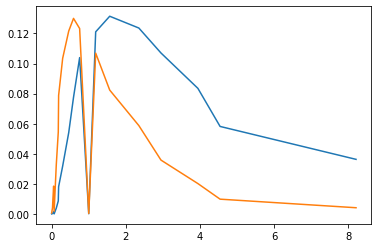

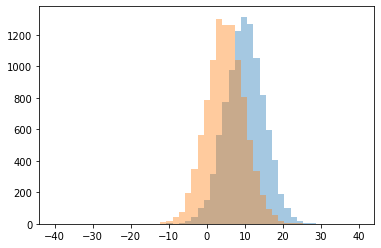

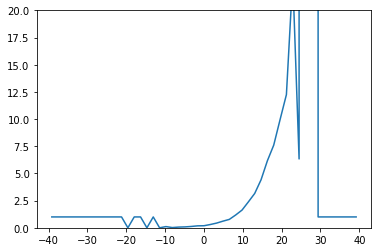

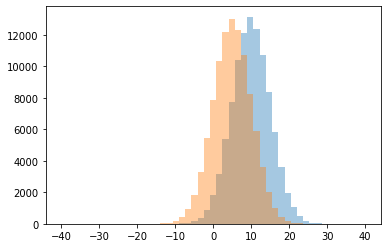

0 0.0
1 0.022222222222222223
2 0.06493506493506493
3 0.08247422680412371
4 0.1111111111111111
5 0.12320916905444126
6 0.17989417989417988
7 0.1895674300254453
8 0.30201342281879195
9 0.4341801385681293
10 0.6123417721518988
11 0.7739888977002379
12 1.0
13 1.1785028790786949
14 1.6287128712871286
15 2.3820224719101124
16 3.158682634730539
17 4.413978494623656
18 6.164948453608248
19 6.333333333333333
20 7.60377358490566
21 9.947368421052632
22 12.25
23 23.0
24 999999.0




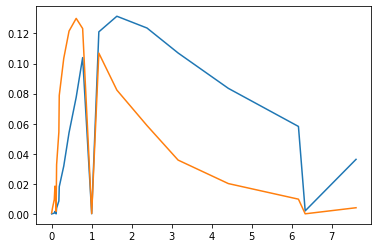

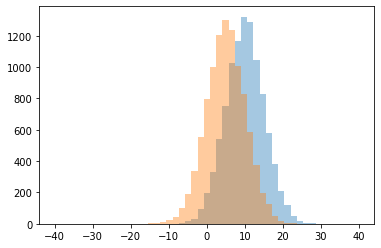

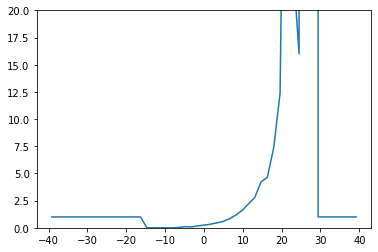

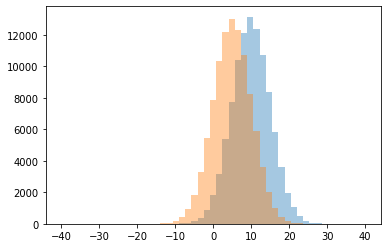

0 0.0
1 0.0297029702970297
2 0.08333333333333333
3 0.10526315789473684
4 0.17297297297297298
5 0.24528301886792453
6 0.32867132867132864
7 0.4498757249378625
8 0.5770416024653313
9 0.8278092158447857
10 1.0
11 1.156901688182721
12 1.5954106280193237
13 2.193877551020408
14 2.7813333333333334
15 4.218274111675127
16 4.653225806451613
17 7.384615384615385
18 12.352941176470589
19 16.0
20 24.5
21 58.5
22 999999.0




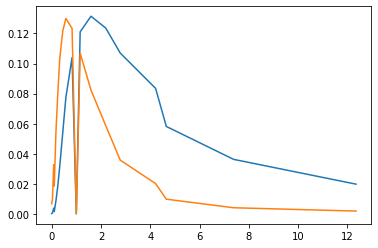

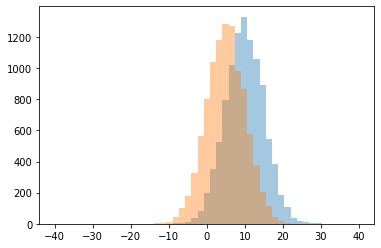

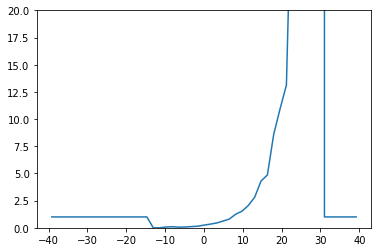

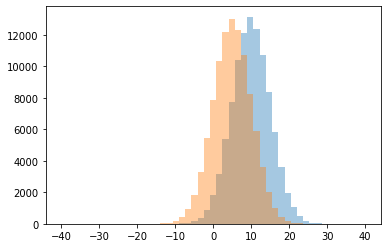

0 0.0
1 0.06
2 0.07142857142857142
3 0.0718232044198895
4 0.0975609756097561
5 0.10975609756097561
6 0.14487632508833923
7 0.2453066332916145
8 0.33751205400192863
9 0.44209636517328826
10 0.618380062305296
11 0.804416403785489
12 1.0
13 1.250255362614913
14 1.532258064516129
15 2.0556521739130433
16 2.816
17 4.304347826086956
18 4.857142857142857
19 8.6
20 10.941176470588236
21 13.125
22 21.0
23 36.0
24 999999.0




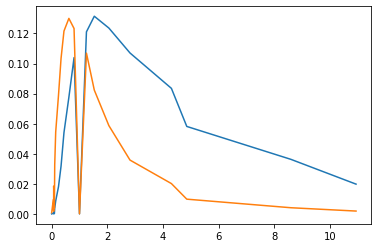

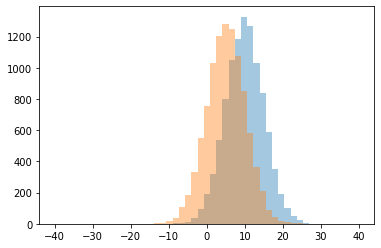

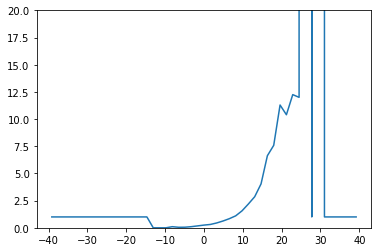

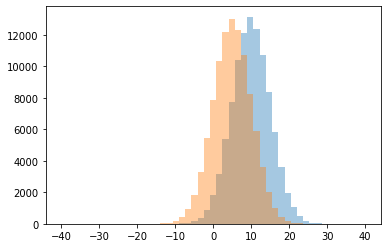

0 0.0
1 0.047619047619047616
2 0.05434782608695652
3 0.10256410256410256
4 0.1033434650455927
5 0.17572463768115942
6 0.24867724867724866
7 0.3071705426356589
8 0.44398340248962653
9 0.625
10 0.8385291766586731
11 1.0
12 1.0996275605214152
13 1.5593419506462984
14 2.1882556131260795
15 2.858725761772853
16 4.038461538461538
17 6.629213483146067
18 7.586956521739131
19 10.4
20 11.294117647058824
21 12.0
22 12.25
23 999999.0




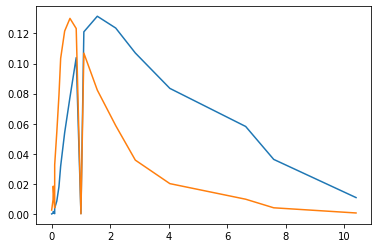

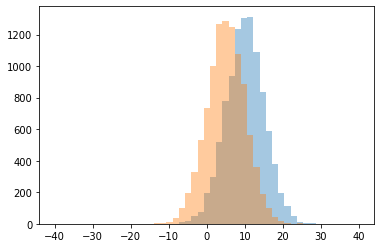

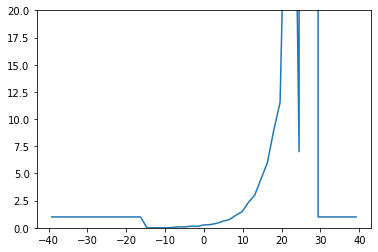

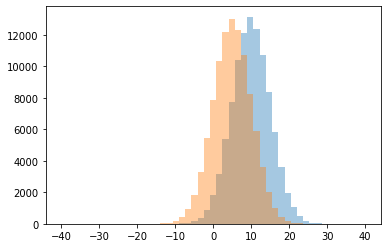

0 0.0
1 0.027777777777777776
2 0.08121827411167512
3 0.09
4 0.13696060037523453
5 0.1524390243902439
6 0.26430517711171664
7 0.29411764705882354
8 0.4097714736012608
9 0.6063664596273292
10 0.7528089887640449
11 1.0
12 1.1427247451343836
13 1.4785067873303168
14 2.3238938053097344
15 2.994490358126722
16 4.5
17 5.989795918367347
18 7.0
19 8.952380952380953
20 11.529411764705882
21 37.0
22 52.0
23 999999.0




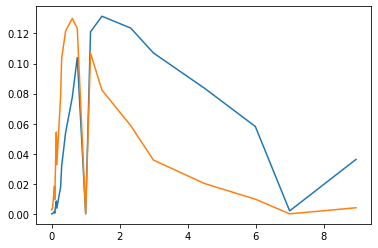

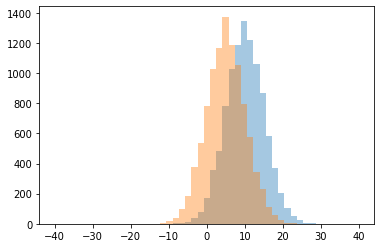

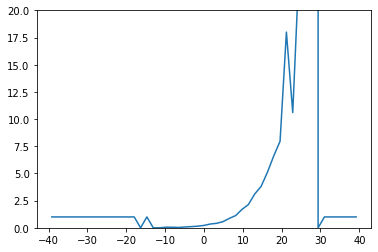

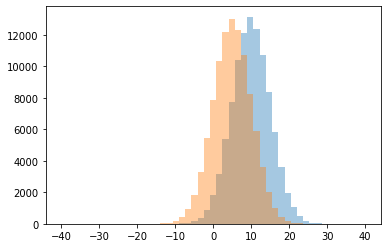

0 0.0
1 0.030612244897959183
2 0.05128205128205128
3 0.05555555555555555
4 0.07567567567567568
5 0.10933333333333334
6 0.14925373134328357
7 0.2176696542893726
8 0.347953216374269
9 0.41201716738197425
10 0.5676855895196506
11 0.864592094196804
12 1.0
13 1.1259469696969697
14 1.6955974842767296
15 2.1326352530541013
16 3.1052631578947367
17 3.7991266375545854
18 5.0964912280701755
19 6.607142857142857
20 7.961538461538462
21 10.6
22 18.0
23 24.0
24 999999.0




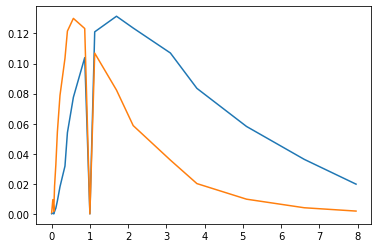

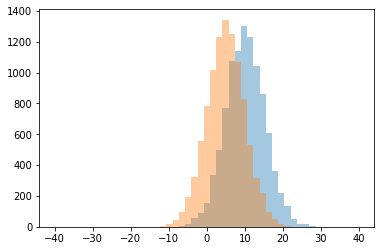

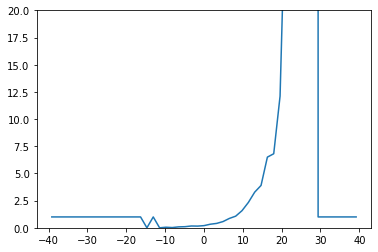

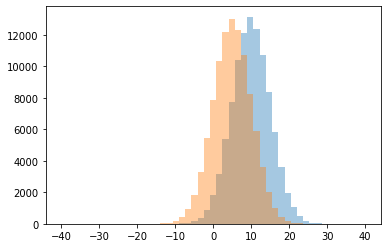

0 0.0
1 0.022222222222222223
2 0.05263157894736842
3 0.0851063829787234
4 0.10204081632653061
5 0.15591397849462366
6 0.16615384615384615
7 0.1989795918367347
8 0.32941176470588235
9 0.40439381611065905
10 0.5718540580789278
11 0.8610223642172524
12 1.0
13 1.0694183864915572
14 1.576086956521739
15 2.331439393939394
16 3.2789968652037618
17 3.8959276018099547
18 6.5
19 6.811320754716981
20 12.11111111111111
21 33.75
22 51.0
23 999999.0




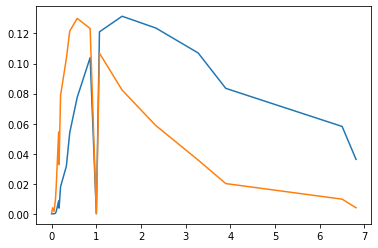

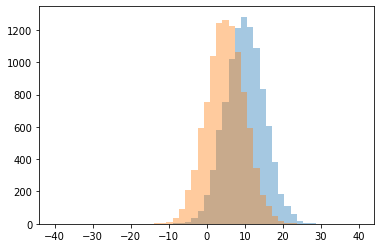

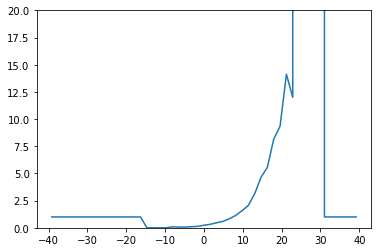

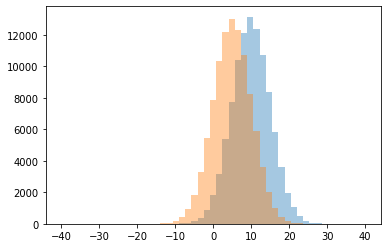

0 0.0
1 0.06382978723404255
2 0.06698564593301436
3 0.08823529411764706
4 0.09850746268656717
5 0.1315345699831366
6 0.23537234042553193
7 0.32146294513955725
8 0.4642570281124498
9 0.5941455696202531
10 0.8323793949304987
11 1.0
12 1.1370892018779342
13 1.569155446756426
14 2.0592216582064298
15 3.1445086705202314
16 4.648044692737431
17 5.568807339449541
18 8.148936170212766
19 9.35
20 12.0
21 14.125
22 999999.0




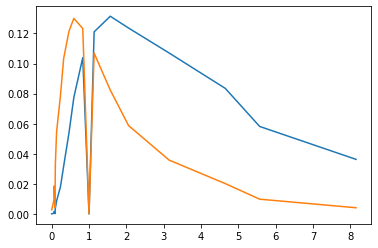

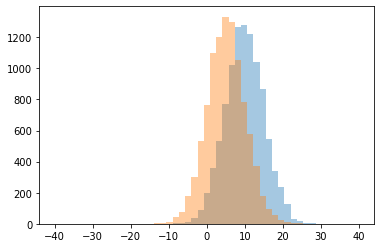

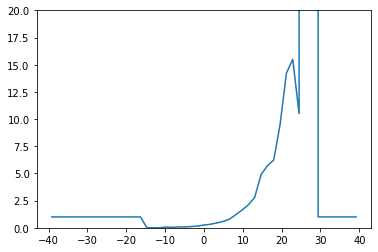

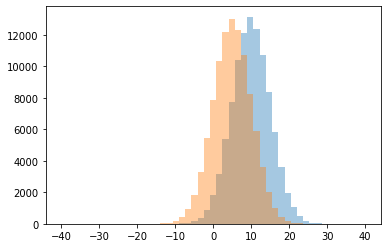

0 0.0
1 0.043478260869565216
2 0.07142857142857142
3 0.07386363636363637
4 0.07792207792207792
5 0.11627906976744186
6 0.16448598130841122
7 0.25557011795543905
8 0.3245214220601641
9 0.443796835970025
10 0.5773273273273273
11 0.7875288683602771
12 1.0
13 1.200570342205323
14 1.6301020408163265
15 2.1145833333333335
16 2.7983870967741935
17 4.898305084745763
18 5.697916666666667
19 6.2407407407407405
20 9.48
21 10.5
22 14.222222222222221
23 15.5
24 999999.0




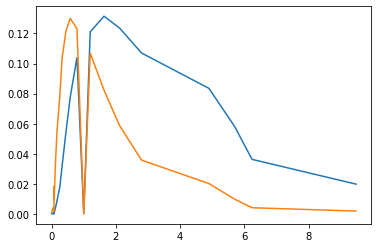

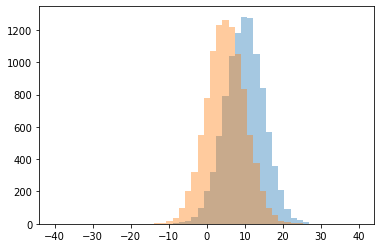

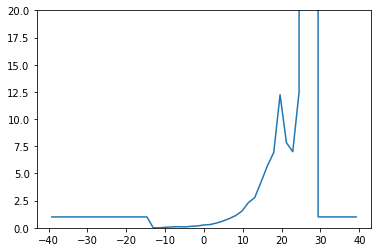

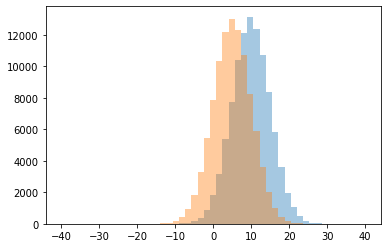

0 0.0
1 0.05555555555555555
2 0.08333333333333333
3 0.10204081632653061
4 0.13664596273291926
5 0.1724137931034483
6 0.2641025641025641
7 0.3
8 0.4427294882209586
9 0.6254948535233571
10 0.8509418509418509
11 1.0
12 1.1248808388941849
13 1.539015606242497
14 2.3169398907103824
15 2.7730870712401057
16 4.205
17 5.7
18 6.923076923076923
19 7.0
20 7.833333333333333
21 12.235294117647058
22 12.5
23 999999.0




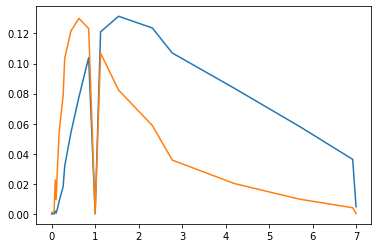

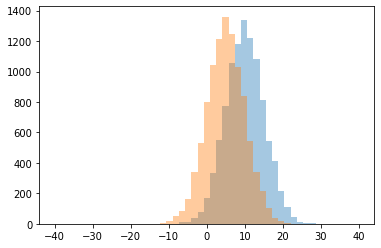

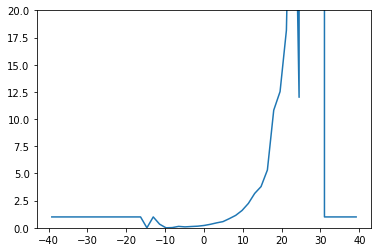

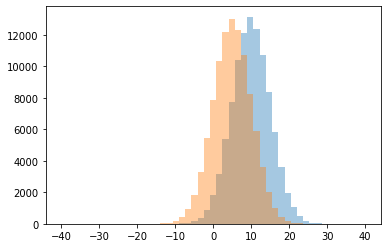

0 0.0
1 0.0196078431372549
2 0.08433734939759036
3 0.11834319526627218
4 0.12941176470588237
5 0.14821763602251406
6 0.21329987452948557
7 0.3196172248803828
8 0.3333333333333333
9 0.4546204620462046
10 0.5691176470588235
11 0.8438751000800641
12 1.0
13 1.1423039690222652
14 1.5916666666666666
15 2.2408088235294117
16 3.163265306122449
17 3.789719626168224
18 5.313725490196078
19 10.81578947368421
20 12.0
21 12.529411764705882
22 18.166666666666668
23 46.0
24 999999.0




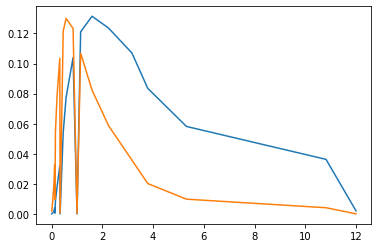

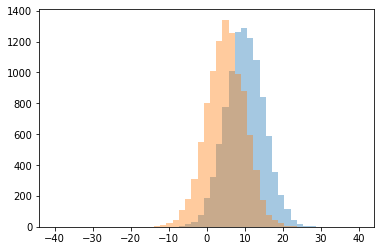

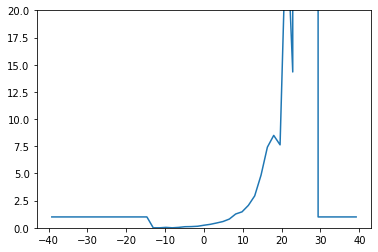

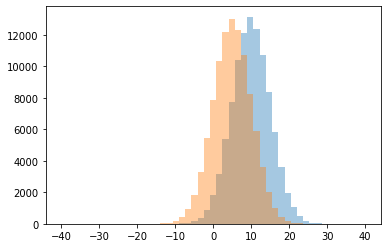

0 0.0
1 0.03669724770642202
2 0.038461538461538464
3 0.09944751381215469
4 0.11074918566775244
5 0.14207650273224043
6 0.23625
7 0.3198019801980198
8 0.44389027431421446
9 0.5767511177347243
10 0.804140127388535
11 1.0
12 1.2701612903225807
13 1.467502850627138
14 2.0606060606060606
15 2.937669376693767
16 4.844827586206897
17 7.417721518987341
18 7.62962962962963
19 8.5
20 14.333333333333334
21 28.5
22 999999.0




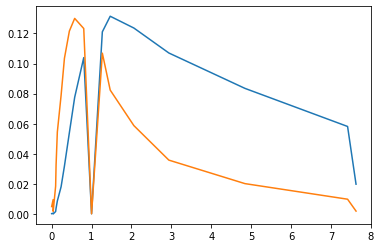

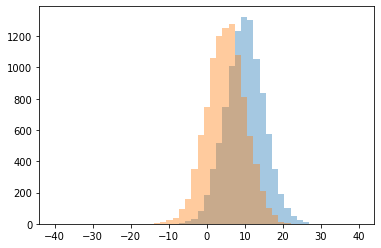

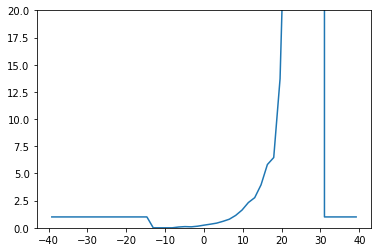

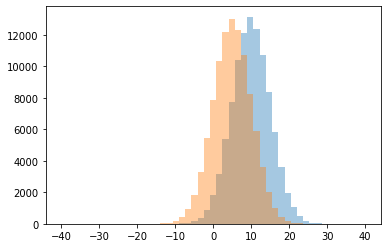

0 0.0
1 0.07216494845360824
2 0.08908045977011494
3 0.10897435897435898
4 0.14736842105263157
5 0.24331550802139038
6 0.3314500941619586
7 0.42964196502914237
8 0.596
9 0.7909162098668755
10 1.0
11 1.1408711770157554
12 1.6305418719211822
13 2.3220640569395017
14 2.7716535433070866
15 3.952830188679245
16 5.818181818181818
17 6.462962962962963
18 13.714285714285714
19 34.666666666666664
20 47.0
21 999999.0




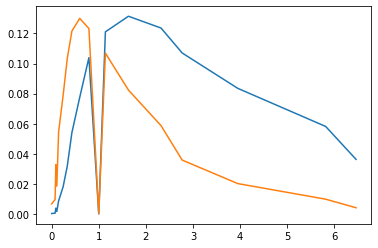

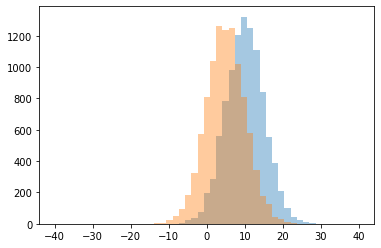

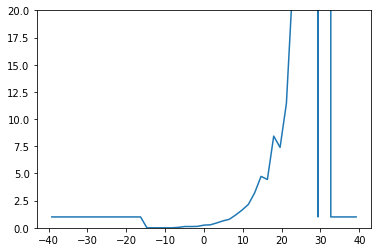

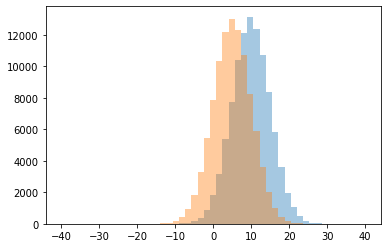

0 0.0
1 0.0425531914893617
2 0.11490683229813664
3 0.11891891891891893
4 0.13043478260869565
5 0.24598269468479605
6 0.2737752161383285
7 0.44479745830023826
8 0.6369529983792545
9 0.7844551282051282
10 1.0
11 1.178082191780822
12 1.6268472906403941
13 2.149484536082474
14 3.2244897959183674
15 4.443548387096774
16 4.730337078651686
17 7.392857142857143
18 8.434782608695652
19 11.444444444444445
20 22.0
21 22.5
22 999999.0




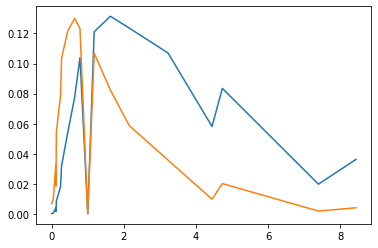

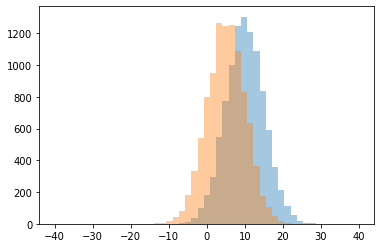

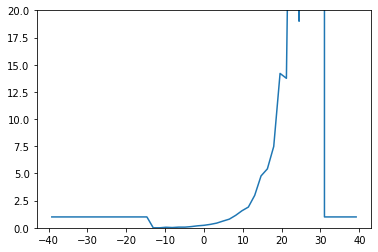

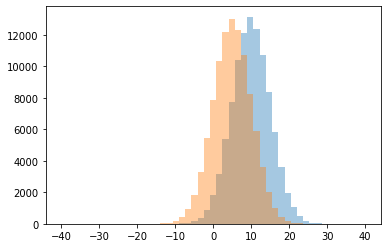

0 0.0
1 0.023255813953488372
2 0.05
3 0.06043956043956044
4 0.06097560975609756
5 0.1111111111111111
6 0.1821561338289963
7 0.22971285892634208
8 0.3143459915611814
9 0.43037974683544306
10 0.6185897435897436
11 0.7972865123703112
12 1.0
13 1.1458715596330276
14 1.5703971119133573
15 1.9069400630914826
16 2.9836065573770494
17 4.771428571428571
18 5.422018348623853
19 7.479166666666667
20 13.75
21 14.2
22 19.0
23 57.0
24 999999.0




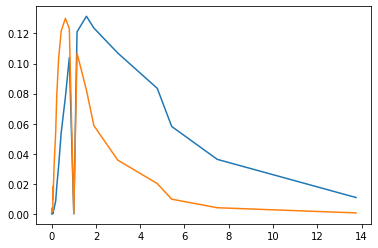

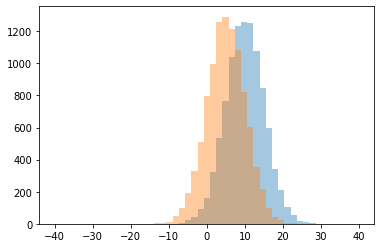

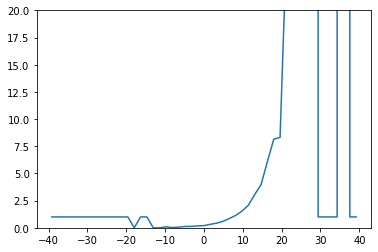

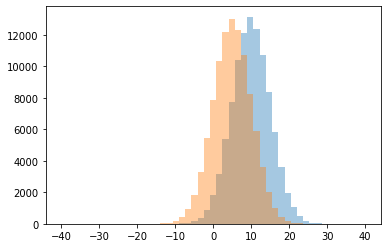

0 0.0
1 0.02040816326530612
2 0.061224489795918366
3 0.09090909090909091
4 0.12371134020618557
5 0.1276595744680851
6 0.177734375
7 0.20175438596491227
8 0.3213213213213213
9 0.42754777070063693
10 0.5948876839659178
11 0.8557295960428689
12 1.0
13 1.1414048059149722
14 1.5378048780487805
15 2.074626865671642
16 3.059659090909091
17 3.967289719626168
18 6.081632653061225
19 8.142857142857142
20 8.32
21 25.75
22 28.0
23 999999.0




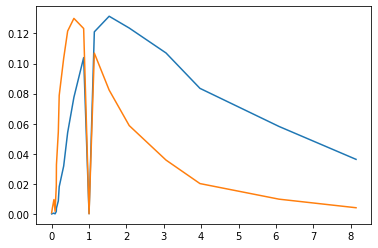

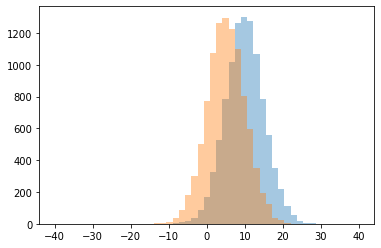

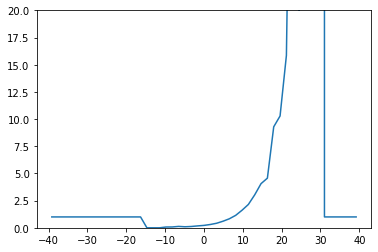

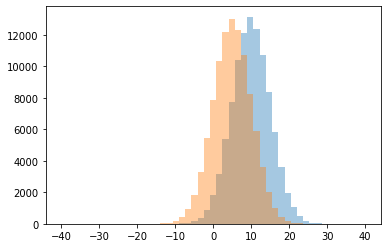

0 0.0
1 0.07142857142857142
2 0.07692307692307693
3 0.09444444444444444
4 0.12040133779264214
5 0.12790697674418605
6 0.1743486973947896
7 0.22093023255813954
8 0.3045496750232126
9 0.41871530531324347
10 0.6046332046332046
11 0.8289902280130294
12 1.0
13 1.145322434150772
14 1.614622057001239
15 2.1464646464646466
16 3.03125
17 4.061855670103093
18 4.565573770491803
19 9.289473684210526
20 10.285714285714286
21 15.857142857142858
22 20.0
23 55.0
24 999999.0




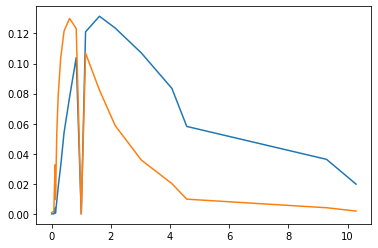

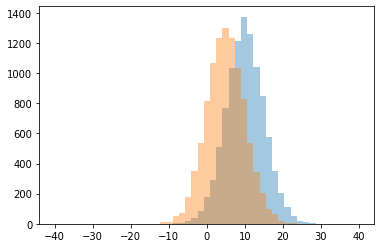

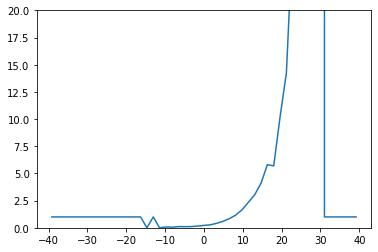

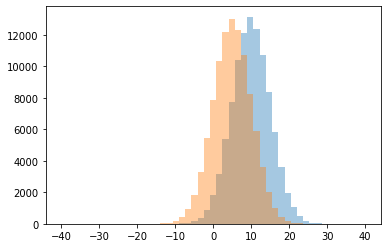

0 0.0
1 0.057692307692307696
2 0.07692307692307693
3 0.10555555555555556
4 0.1095890410958904
5 0.11174785100286533
6 0.16074766355140188
7 0.2215422276621787
8 0.27289719626168224
9 0.41429731925264013
10 0.5916795069337443
11 0.8392857142857143
12 1.0
13 1.1690821256038648
14 1.6574185765983112
15 2.3426443202979517
16 3.038011695906433
17 4.106796116504855
18 5.693548387096774
19 5.808080808080808
20 10.2
21 14.25
22 27.0
23 999999.0




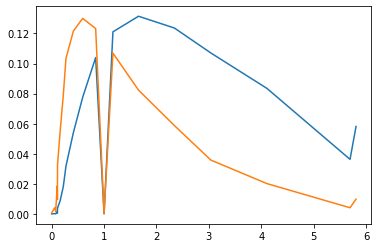

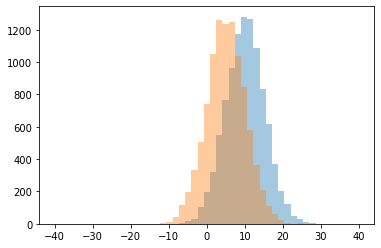

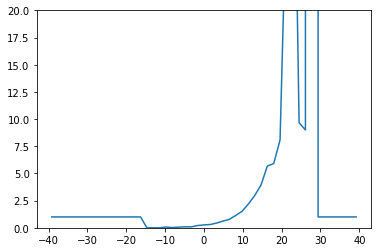

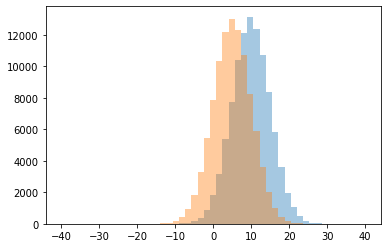

0 0.0
1 0.022727272727272728
2 0.05982905982905983
3 0.07142857142857142
4 0.08656716417910448
5 0.09230769230769231
6 0.20866141732283464
7 0.2641509433962264
8 0.3038095238095238
9 0.4364069952305246
10 0.6187399030694669
11 0.7736757624398074
12 1.0
13 1.135135135135135
14 1.512396694214876
15 2.1882556131260795
16 2.969945355191257
17 3.943127962085308
18 5.6880733944954125
19 5.904761904761905
20 8.08
21 9.0
22 9.666666666666666
23 30.25
24 46.0
25 999999.0




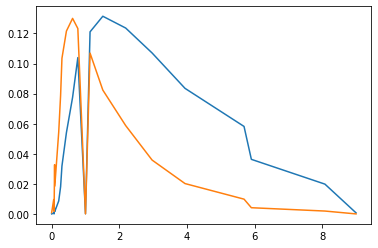

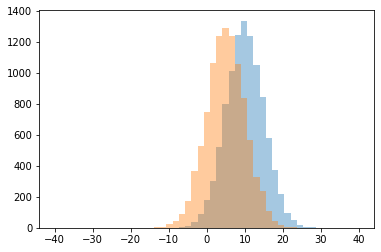

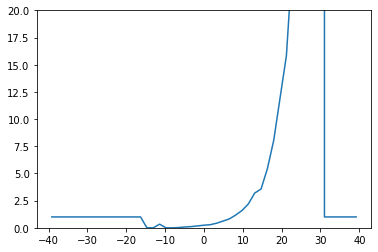

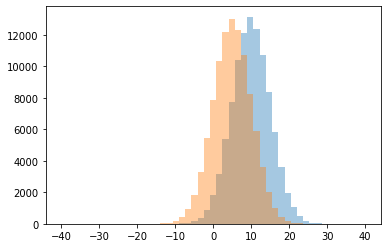

0 0.0
1 0.02197802197802198
2 0.07602339181286549
3 0.11019283746556474
4 0.17300380228136883
5 0.23994638069705093
6 0.28598306679209784
7 0.3333333333333333
8 0.42301458670988656
9 0.6167571761055082
10 0.8166397415185783
11 1.0
12 1.173913043478261
13 1.5911799761620977
14 2.1950354609929077
15 3.1951219512195124
16 3.5635593220338984
17 5.433962264150943
18 8.043478260869565
19 11.944444444444445
20 15.833333333333334
21 25.0
22 999999.0




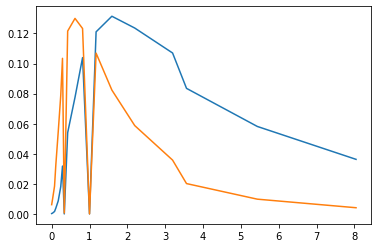

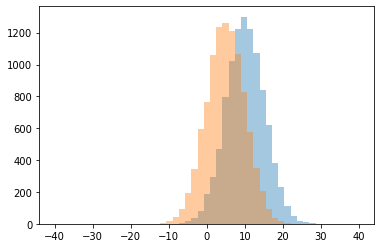

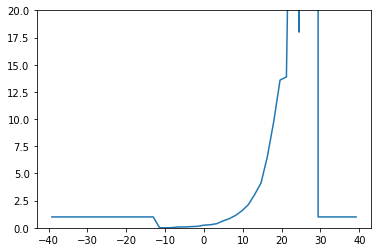

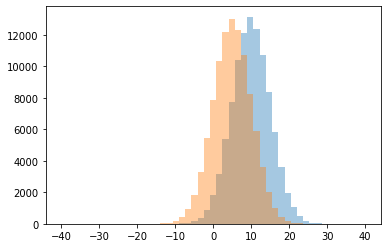

0 0.0
1 0.022727272727272728
2 0.07692307692307693
3 0.07853403141361257
4 0.10982658959537572
5 0.13490725126475547
6 0.24511082138200782
7 0.2800378429517502
8 0.37894736842105264
9 0.6311605723370429
10 0.8431048720066061
11 1.0
12 1.146866230121609
13 1.5719467956469166
14 2.126736111111111
15 3.0685714285714285
16 4.12807881773399
17 6.557894736842106
18 9.76923076923077
19 13.588235294117647
20 13.875
21 18.0
22 51.0
23 999999.0




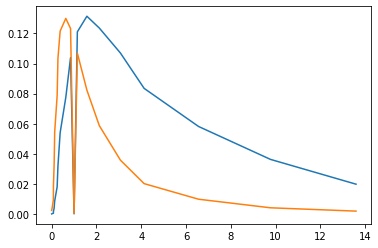

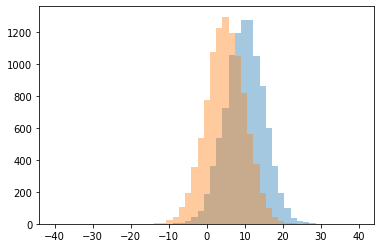

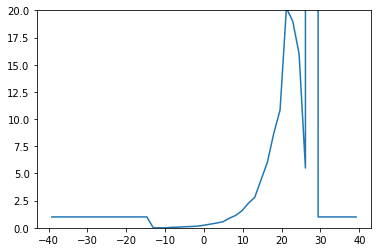

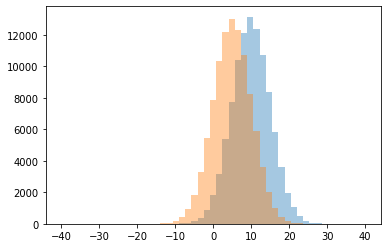

0 0.0
1 0.046511627906976744
2 0.05555555555555555
3 0.09947643979057591
4 0.11864406779661017
5 0.1524163568773234
6 0.23932729624838292
7 0.33643122676579923
8 0.4362745098039216
9 0.5594135802469136
10 0.8828451882845189
11 1.0
12 1.14
13 1.5661764705882353
14 2.2606382978723403
15 2.7904509283819627
16 4.410256410256411
17 5.5
18 6.03030303030303
19 8.666666666666666
20 10.833333333333334
21 16.0
22 19.0
23 20.2
24 999999.0




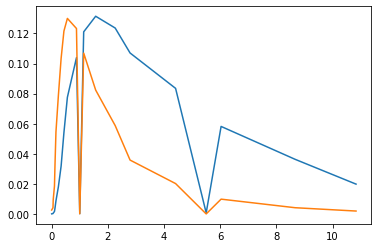

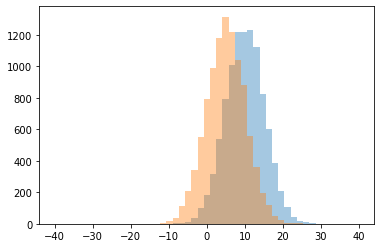

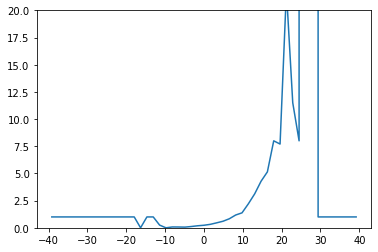

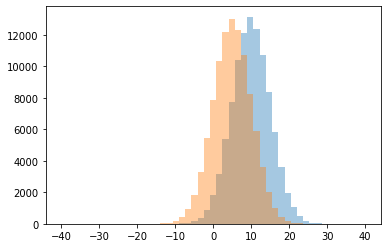

0 0.0
1 0.0625
2 0.07272727272727272
3 0.07692307692307693
4 0.11764705882352941
5 0.18592057761732853
6 0.2339622641509434
7 0.25
8 0.3181818181818182
9 0.45639288738357325
10 0.6022813688212928
11 0.8314144736842105
12 1.0
13 1.1764705882352942
14 1.37599093997735
15 2.206463195691203
16 3.1253481894150417
17 4.27979274611399
18 5.145299145299146
19 7.703703703703703
20 8.0
21 11.5
22 21.8
23 999999.0




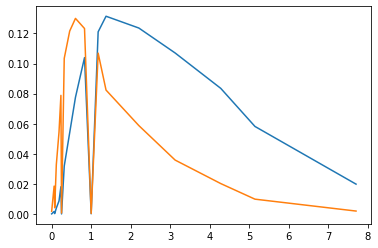

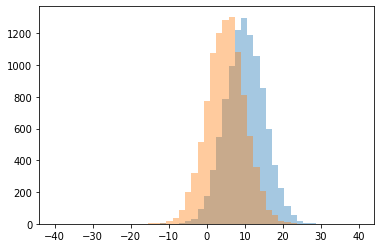

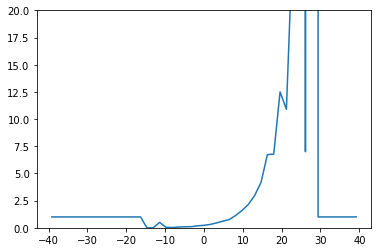

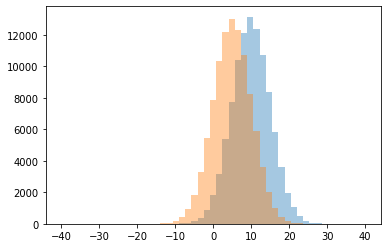

0 0.0
1 0.02702702702702703
2 0.05
3 0.06896551724137931
4 0.09090909090909091
5 0.10377358490566038
6 0.1796875
7 0.2296774193548387
8 0.3128491620111732
9 0.4533333333333333
10 0.5
11 0.6127527216174183
12 0.7615030674846626
13 1.0
14 1.133456904541242
15 1.5896805896805897
16 2.151898734177215
17 2.983098591549296
18 4.175609756097561
19 6.730337078651686
20 6.781818181818182
21 7.0
22 10.9
23 12.5
24 26.5
25 999999.0




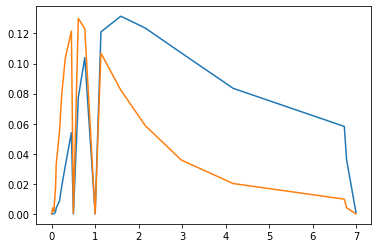

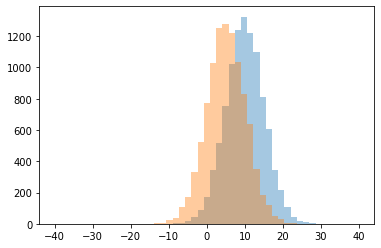

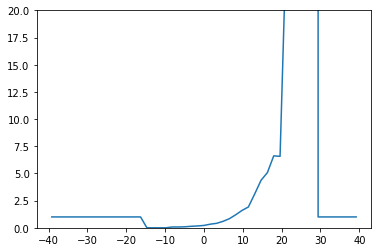

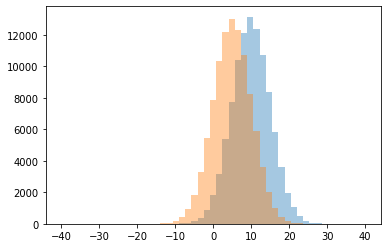

0 0.0
1 0.07476635514018691
2 0.07692307692307693
3 0.09302325581395349
4 0.13813813813813813
5 0.1689059500959693
6 0.21806451612903227
7 0.3333333333333333
8 0.41232986389111287
9 0.5929411764705882
10 0.8352459016393443
11 1.0
12 1.1961352657004831
13 1.5971049457177322
14 1.913657770800628
15 3.1136363636363638
16 4.370967741935484
17 5.07563025210084
18 6.575757575757576
19 6.615384615384615
20 20.5
21 26.75
22 999999.0




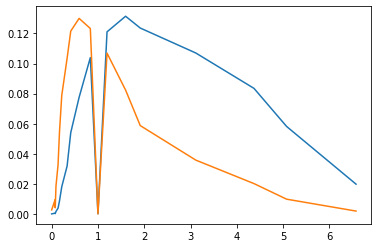

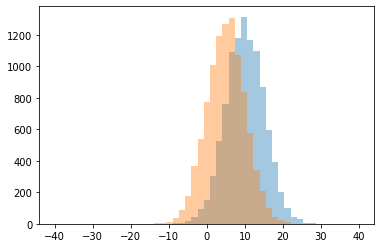

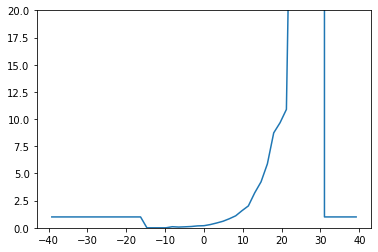

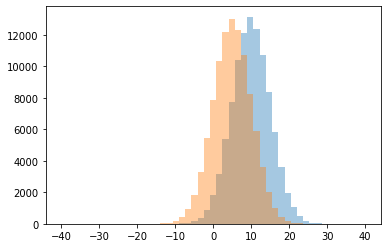

0 0.0
1 0.06741573033707865
2 0.0903954802259887
3 0.1
4 0.11891891891891893
5 0.17537313432835822
6 0.1937984496124031
7 0.2983151635282458
8 0.44184100418410044
9 0.6020488573680063
10 0.8332058148431523
11 1.0
12 1.101489757914339
13 1.5760479041916167
14 2.0120689655172415
15 3.2140762463343107
16 4.228155339805825
17 5.881188118811881
18 8.733333333333333
19 9.666666666666666
20 10.88888888888889
21 28.0
22 46.0
23 999999.0




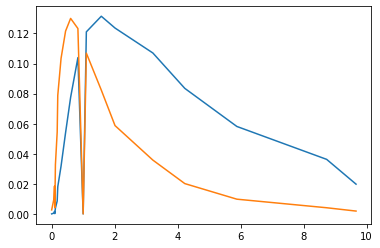

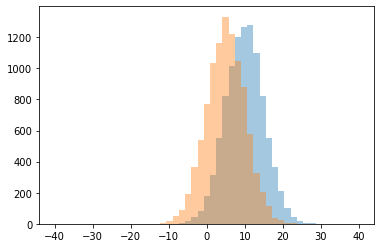

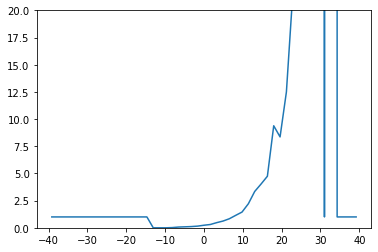

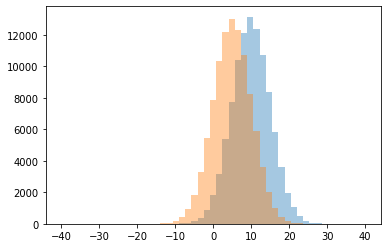

0 0.0
1 0.02
2 0.06896551724137931
3 0.08994708994708994
4 0.11294765840220386
5 0.15427509293680297
6 0.23567708333333334
7 0.3036750483558994
8 0.47332185886402756
9 0.6193693693693694
10 0.8323793949304987
11 1.0
12 1.1438095238095238
13 1.4469783352337515
14 2.2114384748700173
15 3.341463414634146
16 4.024390243902439
17 4.741379310344827
18 8.36
19 9.384615384615385
20 12.5
21 21.5
22 999999.0




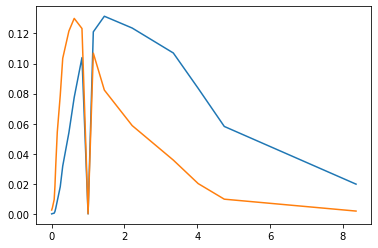

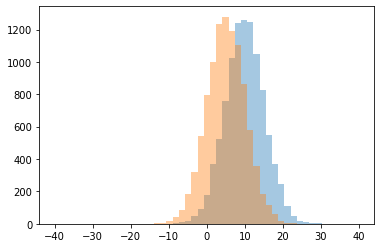

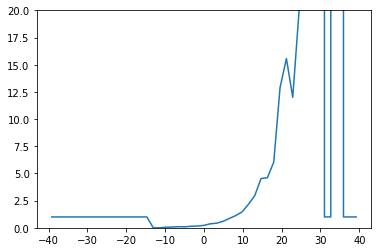

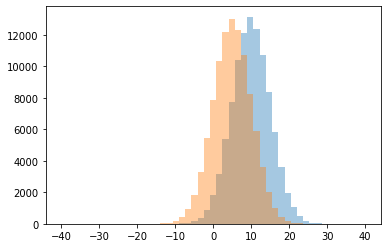

0 0.0
1 0.05263157894736842
2 0.07142857142857142
3 0.09239130434782608
4 0.10344827586206896
5 0.14285714285714285
6 0.1636029411764706
7 0.2244640605296343
8 0.367
9 0.42382495948136145
10 0.5949960906958561
11 0.8608549874266554
12 1.0
13 1.1234119782214156
14 1.4577056778679027
15 2.150259067357513
16 2.949438202247191
17 4.530054644808743
18 4.605042016806722
19 6.032786885245901
20 12.0
21 12.894736842105264
22 15.571428571428571
23 20.0
24 999999.0




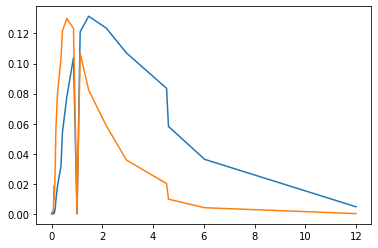

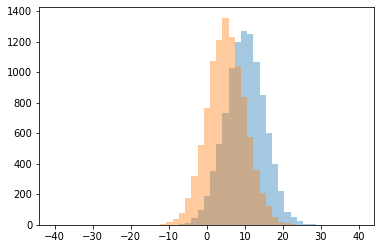

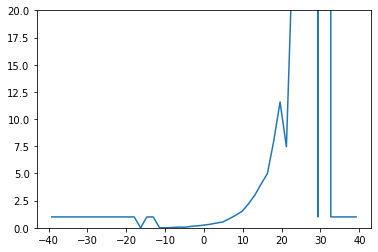

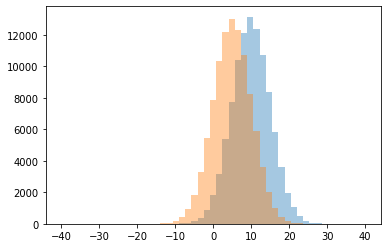

0 0.0
1 0.02857142857142857
2 0.05113636363636364
3 0.0625
4 0.13522012578616352
5 0.18007662835249041
6 0.24934383202099739
7 0.32866479925303455
8 0.44039735099337746
9 0.5420353982300885
10 0.8363192182410424
11 1.0
12 1.1509615384615384
13 1.5125448028673836
14 2.183246073298429
15 2.988795518207283
16 4.014218009478673
17 4.983333333333333
18 7.454545454545454
19 7.98
20 11.578947368421053
21 24.0
22 25.5
23 999999.0




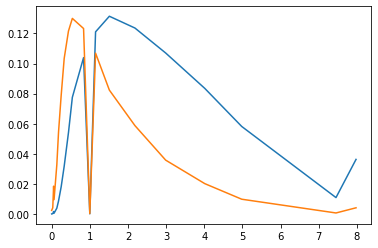

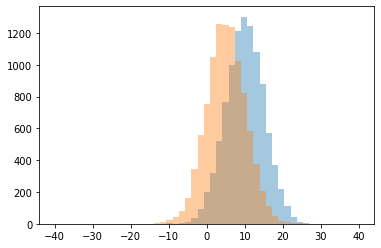

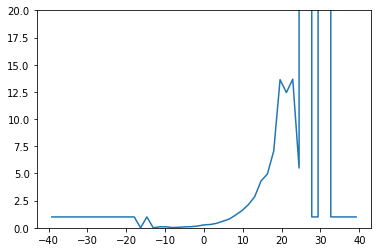

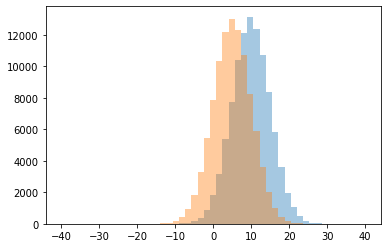

0 0.0
1 0.024390243902439025
2 0.04819277108433735
3 0.08536585365853659
4 0.09090909090909091
5 0.1037463976945245
6 0.1625
7 0.26851851851851855
8 0.3047619047619048
9 0.4128878281622912
10 0.6124401913875598
11 0.807258064516129
12 1.0
13 1.1803118908382066
14 1.583232077764277
15 2.124786324786325
16 2.8647214854111405
17 4.303921568627451
18 4.947826086956522
19 5.5
20 7.0576923076923075
21 12.444444444444445
22 13.625
23 13.666666666666666
24 999999.0




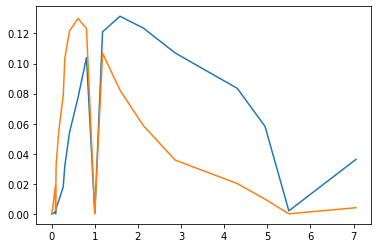

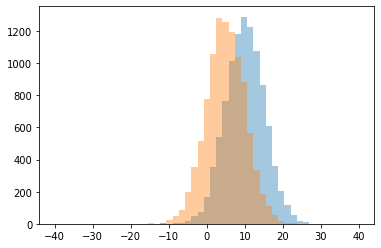

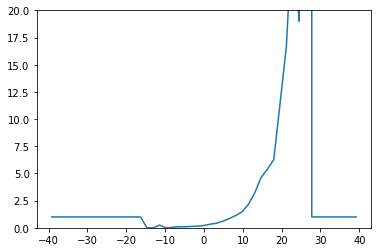

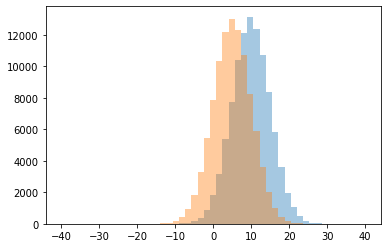

0 0.0
1 0.041666666666666664
2 0.09411764705882353
3 0.09693877551020408
4 0.13031161473087818
5 0.14785992217898833
6 0.21520618556701032
7 0.25
8 0.3345971563981043
9 0.42232630757220924
10 0.6089385474860335
11 0.8509212730318257
12 1.0
13 1.133525456292027
14 1.4647727272727273
15 2.158450704225352
16 3.2059701492537314
17 4.620320855614973
18 5.389380530973451
19 6.2631578947368425
20 11.444444444444445
21 16.714285714285715
22 19.0
23 28.0
24 999999.0




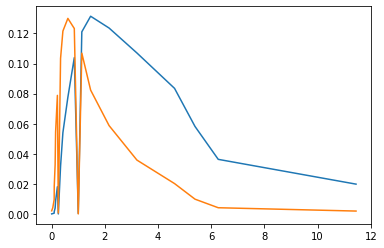

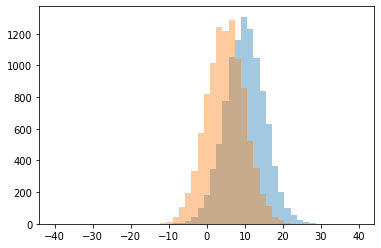

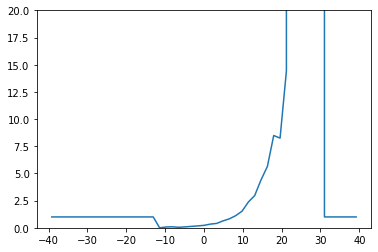

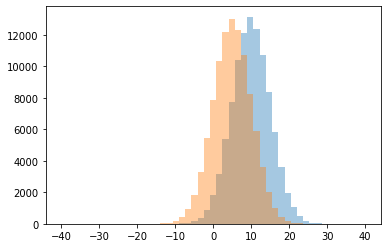

0 0.0
1 0.045871559633027525
2 0.07142857142857142
3 0.08333333333333333
4 0.09302325581395349
5 0.12874251497005987
6 0.1733800350262697
7 0.22466422466422467
8 0.3382497541789577
9 0.40321285140562246
10 0.6356907894736842
11 0.8211508553654744
12 1.0
13 1.116122840690979
14 1.5262543757292881
15 2.3692307692307693
16 2.9660056657223794
17 4.410526315789474
18 5.642857142857143
19 8.25
20 8.488372093023257
21 14.428571428571429
22 23.0
23 999999.0




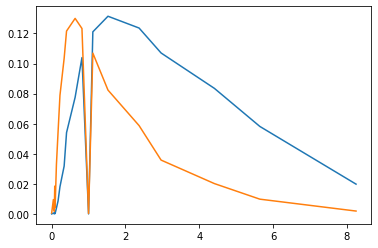

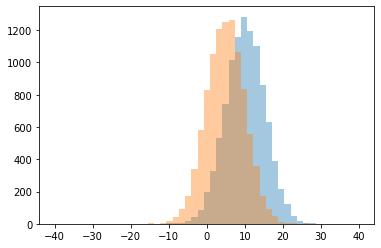

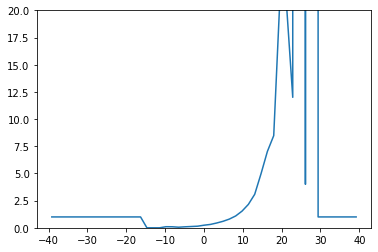

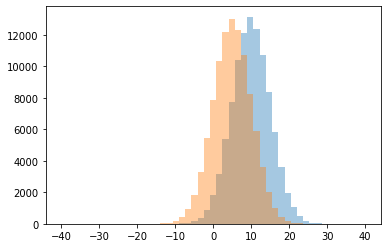

0 0.0
1 0.05434782608695652
2 0.09142857142857143
3 0.09523809523809523
4 0.1
5 0.11869436201780416
6 0.14802065404475043
7 0.23792270531400966
8 0.30893536121673004
9 0.44029850746268656
10 0.5969551282051282
11 0.8019017432646592
12 1.0
13 1.0892018779342723
14 1.5328554360812425
15 2.151351351351351
16 3.0810055865921786
17 4.0
18 4.976878612716763
19 7.022222222222222
20 8.478260869565217
21 12.0
22 20.666666666666668
23 21.4
24 999999.0




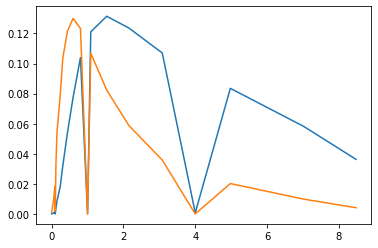

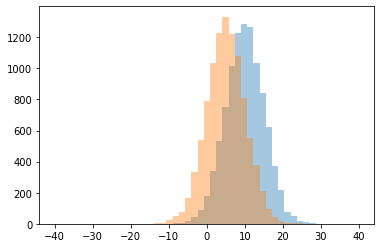

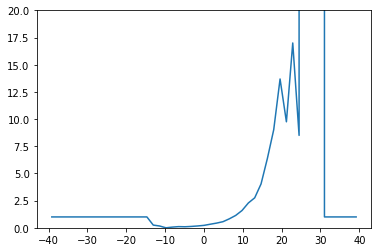

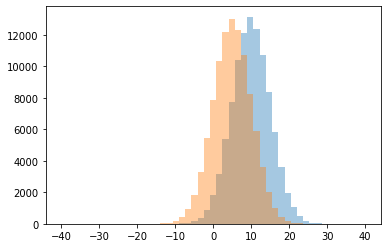

0 0.0
1 0.06382978723404255
2 0.09523809523809523
3 0.10810810810810811
4 0.1253731343283582
5 0.16666666666666666
6 0.1691449814126394
7 0.223203026481715
8 0.25
9 0.32979749276759884
10 0.433115823817292
11 0.5623123123123123
12 0.826797385620915
13 1.0
14 1.137037037037037
15 1.5896168108776267
16 2.2839059674502713
17 2.7573333333333334
18 4.033492822966507
19 6.377551020408164
20 8.5
21 9.024390243902438
22 9.75
23 13.6875
24 17.0
25 999999.0




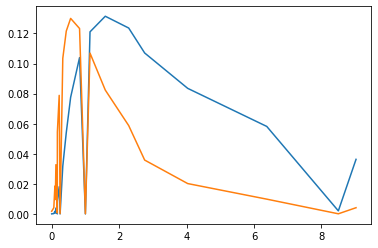

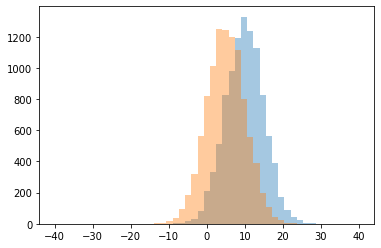

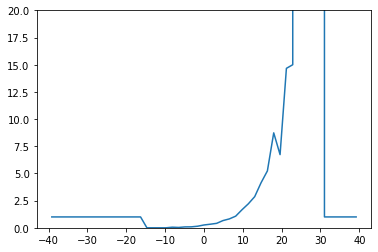

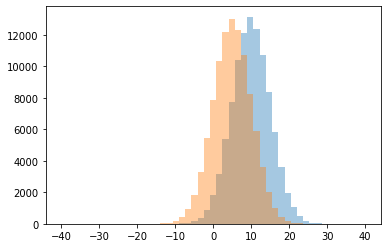

0 0.0
1 0.03225806451612903
2 0.05555555555555555
3 0.08196721311475409
4 0.0880503144654088
5 0.1453900709219858
6 0.2597560975609756
7 0.33004926108374383
8 0.4099279423538831
9 0.6653225806451613
10 0.8176519567027477
11 1.0
12 1.0701438848920863
13 1.6620775969962454
14 2.2093023255813953
15 2.8651399491094147
16 4.14070351758794
17 5.231481481481482
18 6.730769230769231
19 8.733333333333333
20 14.666666666666666
21 15.0
22 999999.0




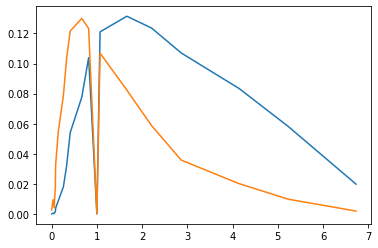

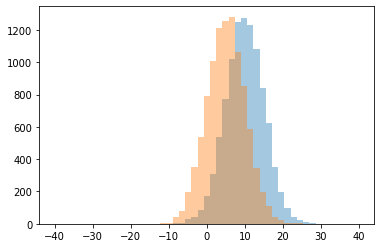

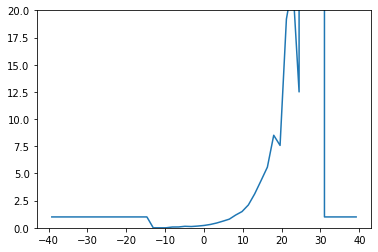

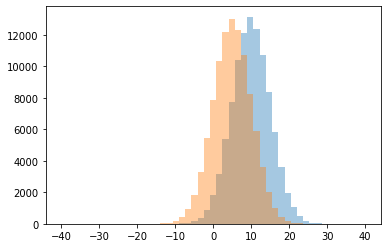

0 0.0
1 0.07142857142857142
2 0.07692307692307693
3 0.11647727272727272
4 0.1377551020408163
5 0.15858208955223882
6 0.21491782553729458
7 0.30646766169154227
8 0.4403292181069959
9 0.6125696101829753
10 0.797191887675507
11 1.0
12 1.1748120300751879
13 1.4918032786885247
14 2.1006825938566553
15 3.123919308357349
16 4.34020618556701
17 5.580357142857143
18 7.576923076923077
19 8.512195121951219
20 12.5
21 19.2
22 22.5
23 999999.0




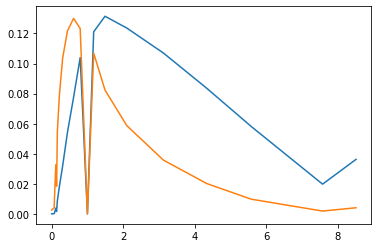

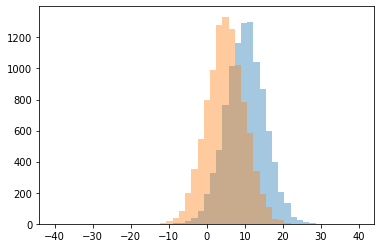

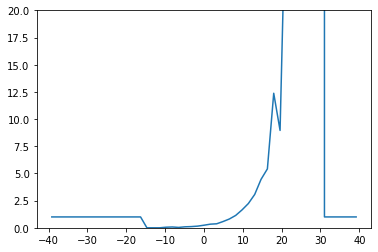

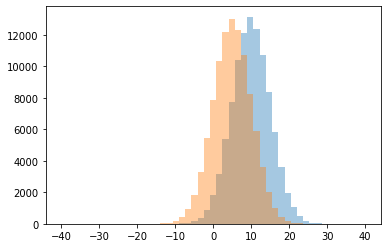

0 0.0
1 0.03529411764705882
2 0.05263157894736842
3 0.075
4 0.09045226130653267
5 0.1111111111111111
6 0.15384615384615385
7 0.23779724655819776
8 0.33367037411526795
9 0.36846213895394225
10 0.5738934733683421
11 0.8090692124105012
12 1.0
13 1.1385365853658536
14 1.6445859872611466
15 2.231958762886598
16 3.0678466076696167
17 4.456410256410257
18 5.418181818181818
19 8.956521739130435
20 12.375
21 33.25
22 999999.0




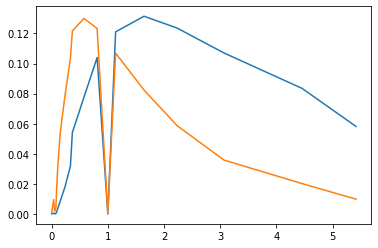

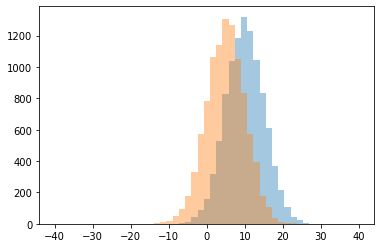

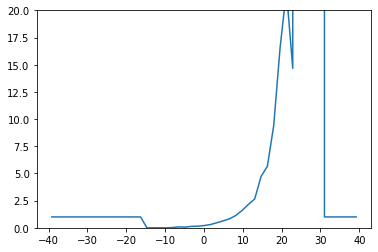

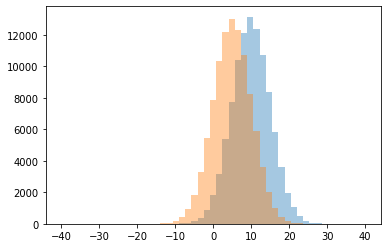

0 0.0
1 0.02040816326530612
2 0.062146892655367235
3 0.08247422680412371
4 0.1276595744680851
5 0.14886164623467601
6 0.20332480818414322
7 0.2973733583489681
8 0.4605263157894737
9 0.6326687116564417
10 0.8212025316455697
11 1.0
12 1.1274976213130352
13 1.5884476534296028
14 2.1486013986013988
15 2.6513994910941476
16 4.7175141242937855
17 5.657407407407407
18 9.41025641025641
19 14.666666666666666
20 16.53846153846154
21 21.8
22 999999.0




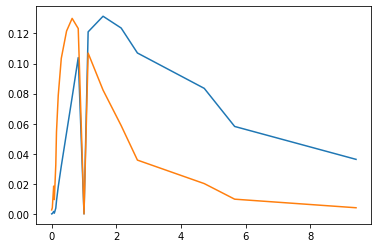

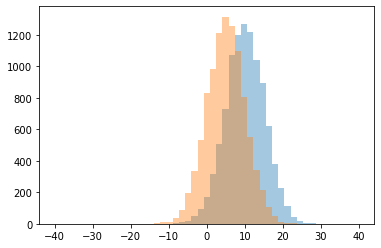

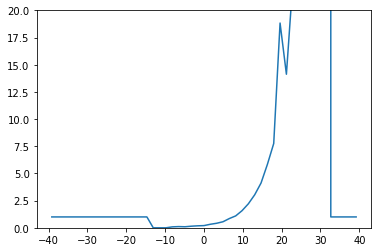

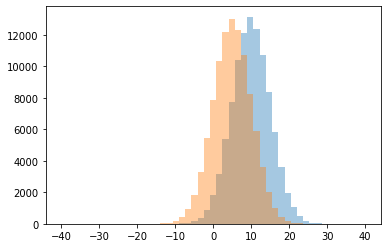

0 0.0
1 0.08571428571428572
2 0.09595959595959595
3 0.1111111111111111
4 0.1467065868263473
5 0.18233082706766918
6 0.20216606498194944
7 0.3241869918699187
8 0.41701073492981006
9 0.556316590563166
10 0.8513513513513513
11 1.0
12 1.0938924339106655
13 1.5726708074534161
14 2.2083333333333335
15 3.038011695906433
16 4.119815668202765
17 5.830188679245283
18 7.755102040816326
19 14.125
20 18.833333333333332
21 22.5
22 999999.0




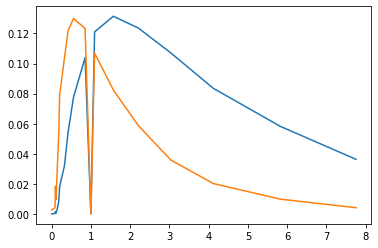

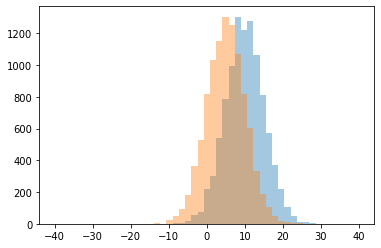

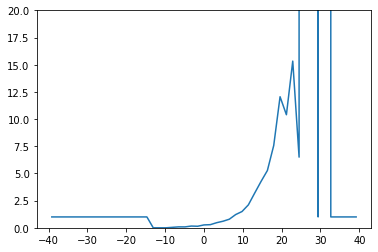

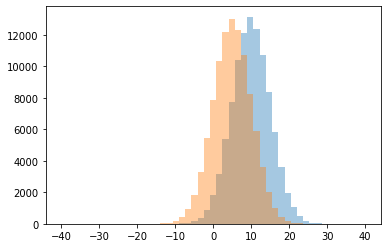

0 0.0
1 0.041666666666666664
2 0.08287292817679558
3 0.0851063829787234
4 0.14177693761814744
5 0.16066481994459833
6 0.2647058823529412
7 0.28820116054158607
8 0.4695121951219512
9 0.6035276073619632
10 0.7915335463258786
11 1.0
12 1.2177570093457943
13 1.4969400244798041
14 2.108910891089109
15 3.1957831325301207
16 4.2631578947368425
17 5.268518518518518
18 6.5
19 7.571428571428571
20 10.4
21 12.055555555555555
22 15.333333333333334
23 999999.0




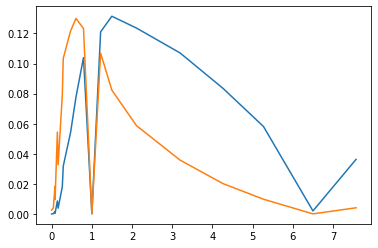

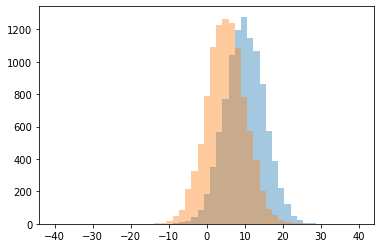

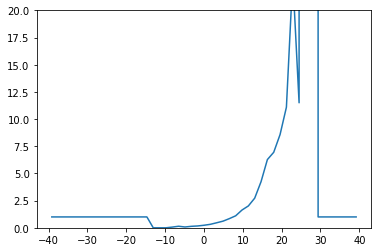

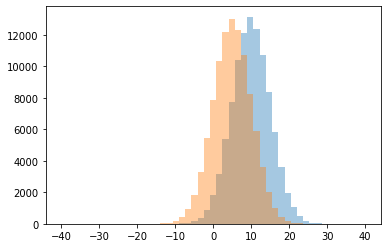

0 0.0
1 0.06521739130434782
2 0.07511737089201878
3 0.13496932515337423
4 0.14285714285714285
5 0.16938775510204082
6 0.2332065906210393
7 0.31955922865013775
8 0.4620408163265306
9 0.6104513064133017
10 0.8439773645917542
11 1.0
12 1.1035120147874307
13 1.6363636363636365
14 2.010507880910683
15 2.7263427109974425
16 4.241379310344827
17 6.274725274725275
18 6.946428571428571
19 8.576923076923077
20 11.090909090909092
21 11.5
22 23.0
23 999999.0




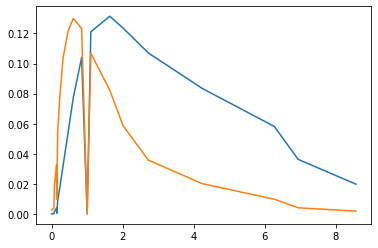

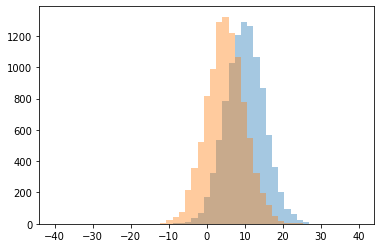

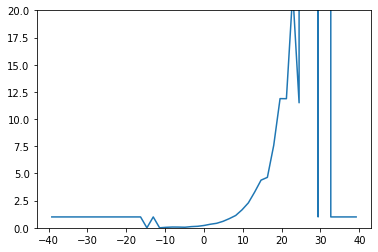

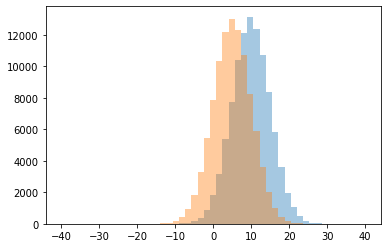

0 0.0
1 0.043478260869565216
2 0.0514018691588785
3 0.06578947368421052
4 0.06976744186046512
5 0.10863509749303621
6 0.13740458015267176
7 0.21323529411764705
8 0.32661290322580644
9 0.4144074360960496
10 0.5941043083900227
11 0.8445723684210527
12 1.0
13 1.1323943661971831
14 1.6517285531370038
15 2.2945454545454544
16 3.29320987654321
17 4.383838383838384
18 4.639344262295082
19 7.583333333333333
20 11.5
21 11.875
22 11.882352941176471
23 21.666666666666668
24 999999.0




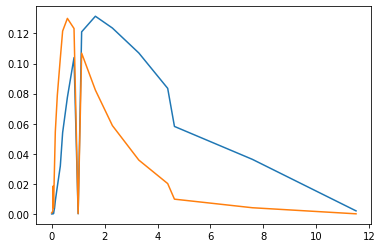

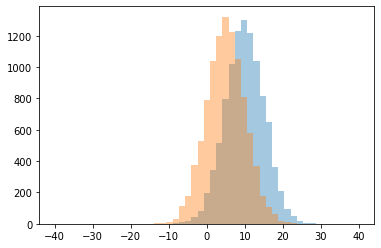

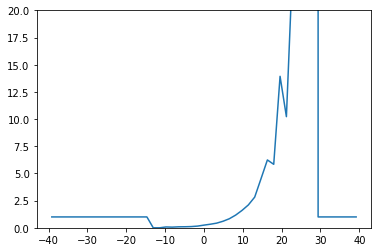

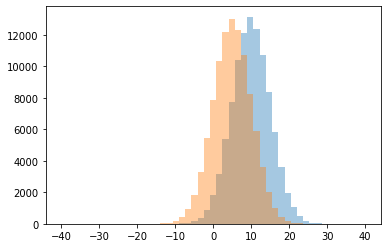

0 0.0
1 0.06060606060606061
2 0.07692307692307693
3 0.09009009009009009
4 0.096045197740113
5 0.1126005361930295
6 0.1571969696969697
7 0.2468354430379747
8 0.3285302593659942
9 0.42857142857142855
10 0.6018168054504164
11 0.833469387755102
12 1.0
13 1.1699905033238367
14 1.599260172626387
15 2.1039861351819757
16 2.8228882833787465
17 4.522222222222222
18 5.838709677419355
19 6.240384615384615
20 10.222222222222221
21 13.933333333333334
22 24.5
23 999999.0




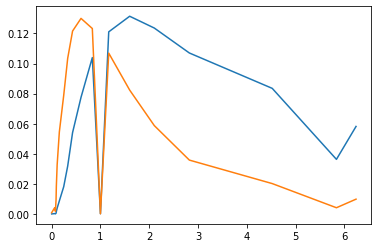

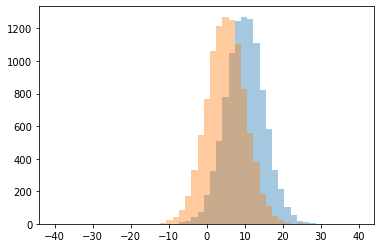

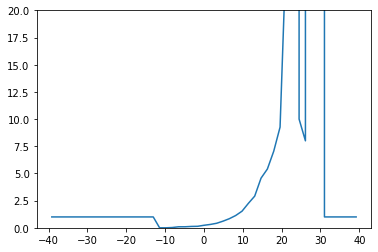

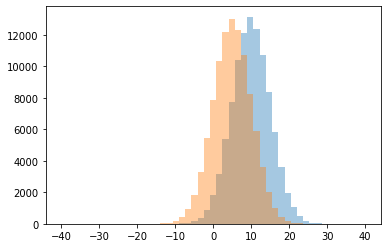

0 0.0
1 0.02564102564102564
2 0.09302325581395349
3 0.09411764705882353
4 0.125
5 0.13761467889908258
6 0.23137254901960785
7 0.3087818696883853
8 0.41680395387149916
9 0.610062893081761
10 0.8377298161470823
11 1.0
12 1.1295289855072463
13 1.527710843373494
14 2.2468694096601074
15 2.9133858267716537
16 4.566666666666666
17 5.407407407407407
18 7.042553191489362
19 8.0
20 9.26086956521739
21 10.0
22 26.25
23 999999.0




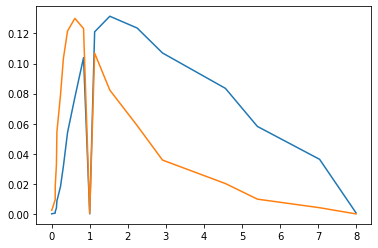

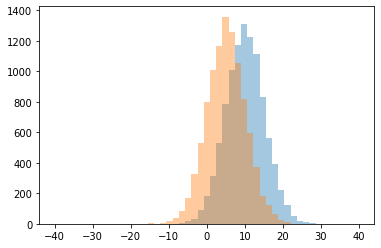

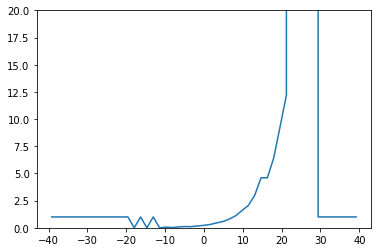

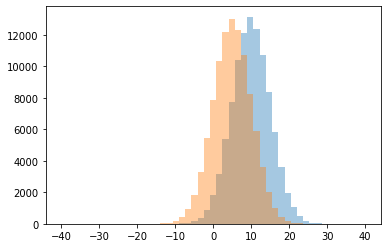

0 0.0
1 0.02702702702702703
2 0.058823529411764705
3 0.08235294117647059
4 0.10461538461538461
5 0.1144578313253012
6 0.17325800376647835
7 0.22681704260651628
8 0.3086053412462908
9 0.4531384350816853
10 0.5787923416789397
11 0.804140127388535
12 1.0
13 1.1106906338694418
14 1.5919610231425092
15 2.053781512605042
16 2.986559139784946
17 4.598360655737705
18 4.602209944751381
19 6.426229508196721
20 9.291666666666666
21 12.2
22 999999.0




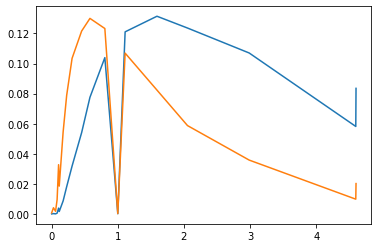

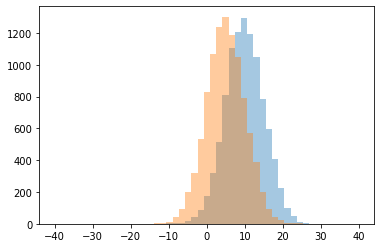

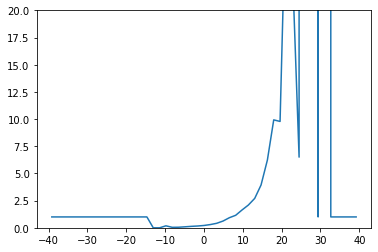

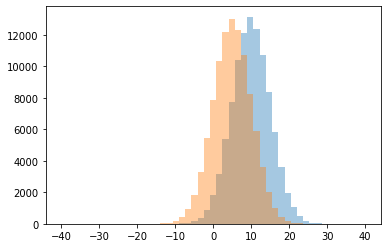

0 0.0
1 0.044444444444444446
2 0.052083333333333336
3 0.09090909090909091
4 0.13249211356466878
5 0.1651031894934334
6 0.18181818181818182
7 0.213768115942029
8 0.2976525821596244
9 0.4129032258064516
10 0.619815668202765
11 0.926890756302521
12 1.0
13 1.1503330161750713
14 1.638432364096081
15 2.093145869947276
16 2.7036082474226806
17 3.935
18 6.229166666666667
19 6.5
20 9.782608695652174
21 9.926829268292684
22 23.0
23 32.333333333333336
24 999999.0




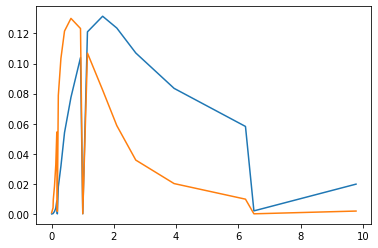

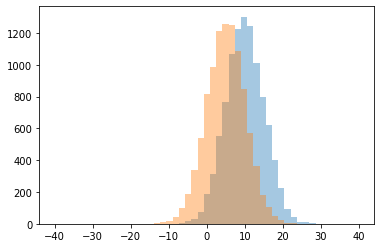

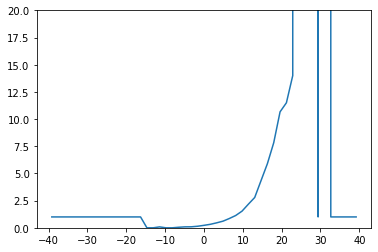

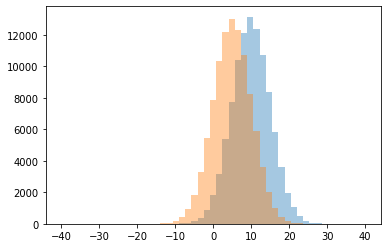

0 0.0
1 0.04950495049504951
2 0.08333333333333333
3 0.08602150537634409
4 0.09198813056379822
5 0.14338919925512103
6 0.22643818849449204
7 0.3204868154158215
8 0.45634266886326197
9 0.6100478468899522
10 0.855084067253803
11 1.0
12 1.1298342541436464
13 1.531764705882353
14 2.1713286713286712
15 2.787292817679558
16 4.342391304347826
17 5.895238095238096
18 7.823529411764706
19 10.666666666666666
20 11.5
21 14.0
22 999999.0




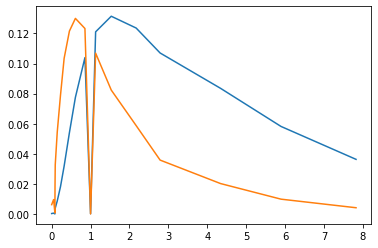

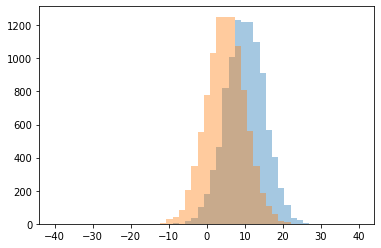

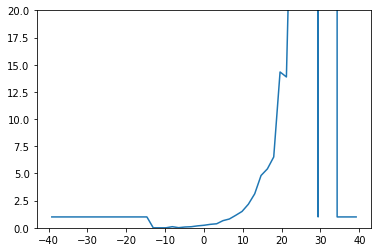

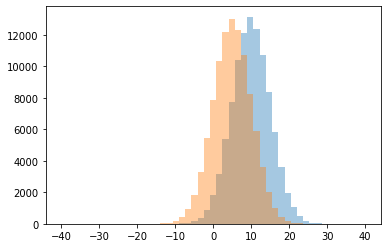

0 0.0
1 0.011904761904761904
2 0.07352941176470588
3 0.09943181818181818
4 0.10256410256410256
5 0.17805755395683454
6 0.23294723294723294
7 0.3174757281553398
8 0.3706070287539936
9 0.6581265012009607
10 0.8092948717948718
11 1.0
12 1.1461824953445066
13 1.5030826140567202
14 2.168738898756661
15 3.1253561253561255
16 4.809523809523809
17 5.419047619047619
18 6.516129032258065
19 13.875
20 14.333333333333334
21 38.0
22 999999.0




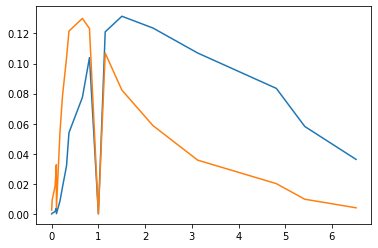

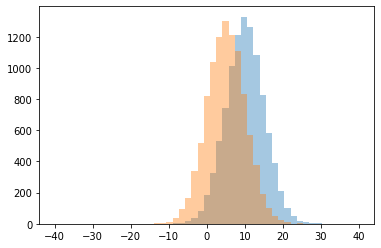

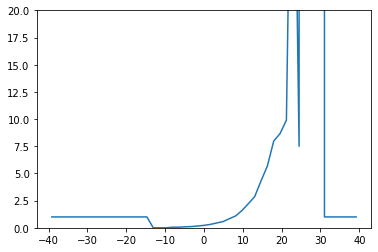

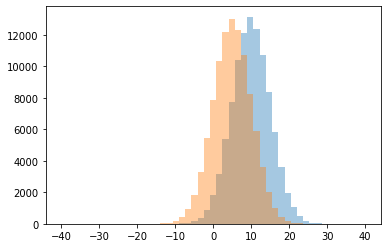

0 0.0
1 0.05434782608695652
2 0.05555555555555555
3 0.09036144578313253
4 0.11176470588235295
5 0.16346153846153846
6 0.2237163814180929
7 0.31213872832369943
8 0.4427736006683375
9 0.5701078582434514
10 0.8356729975227085
11 1.0
12 1.0940325497287522
13 1.5942376950780313
14 2.2204585537918873
15 2.867724867724868
16 4.317708333333333
17 5.686274509803922
18 7.5
19 7.979591836734694
20 8.666666666666666
21 9.9
22 49.0
23 999999.0




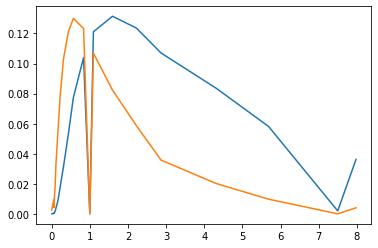

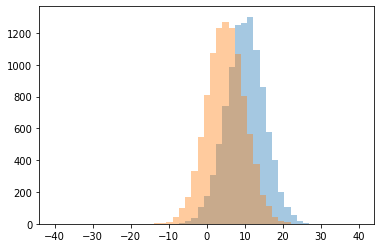

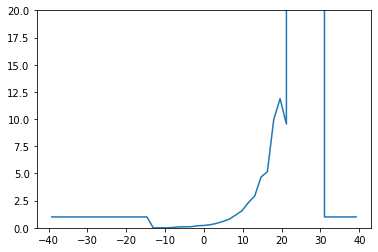

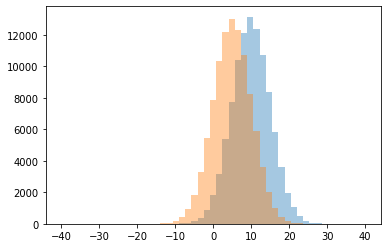

0 0.0
1 0.022222222222222223
2 0.08247422680412371
3 0.09467455621301775
4 0.10179640718562874
5 0.1882998171846435
6 0.21551724137931033
7 0.28677839851024206
8 0.4084621643612693
9 0.5851735015772871
10 0.799512987012987
11 1.0
12 1.172607879924953
13 1.5708955223880596
14 2.316725978647687
15 2.9222520107238608
16 4.668478260869565
17 5.160714285714286
18 9.545454545454545
19 9.95
20 11.882352941176471
21 999999.0




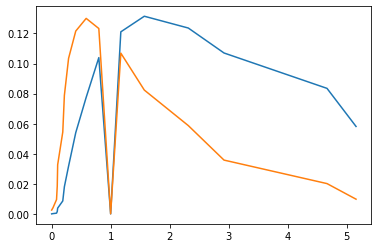

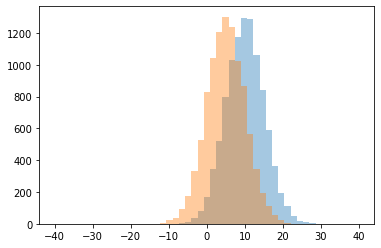

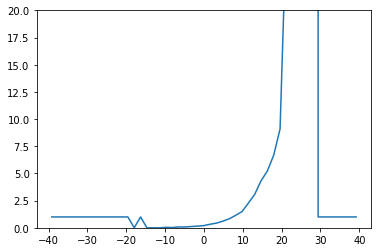

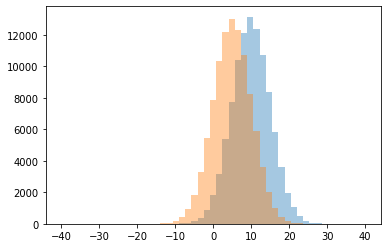

0 0.0
1 0.02564102564102564
2 0.043478260869565216
3 0.07428571428571429
4 0.07692307692307693
5 0.11711711711711711
6 0.15458015267175573
7 0.2045728038507822
8 0.3317307692307692
9 0.43283582089552236
10 0.6136712749615976
11 0.8311793214862682
12 1.0
13 1.1477495107632094
14 1.4919354838709677
15 2.2698412698412698
16 3.0751445086705202
17 4.323076923076923
18 5.230088495575221
19 6.685185185185185
20 9.095238095238095
21 28.0
22 999999.0




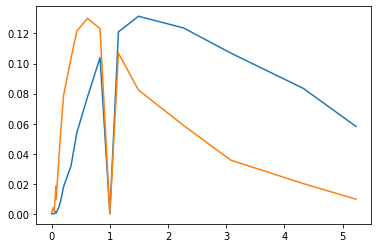

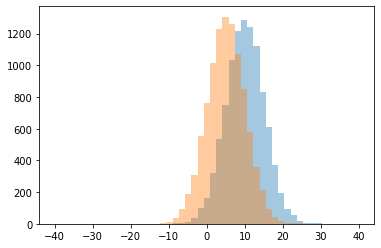

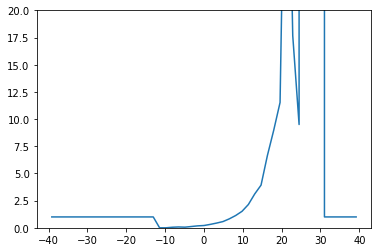

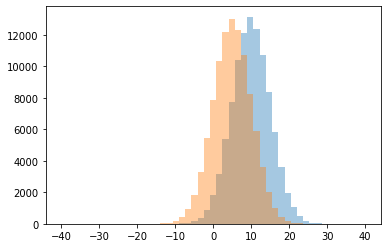

0 0.0
1 0.05128205128205128
2 0.05789473684210526
3 0.07692307692307693
4 0.11726384364820847
5 0.17805755395683454
6 0.20969855832241152
7 0.3145956607495069
8 0.43566775244299677
9 0.5735068912710567
10 0.8241845664280032
11 1.0
12 1.130475302889096
13 1.5159386068476977
14 2.1413793103448278
15 3.110803324099723
16 3.9245283018867925
17 6.641304347826087
18 8.975609756097562
19 9.5
20 11.529411764705882
21 17.666666666666668
22 46.5
23 999999.0




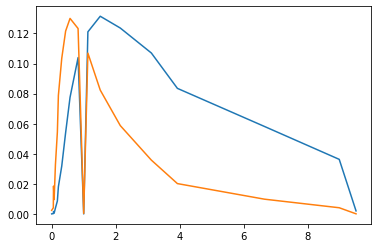

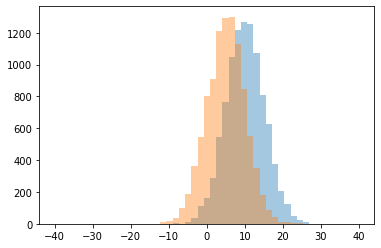

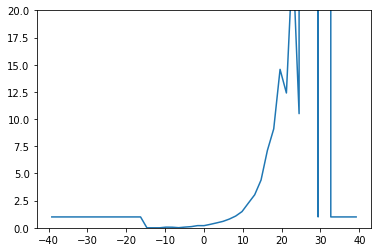

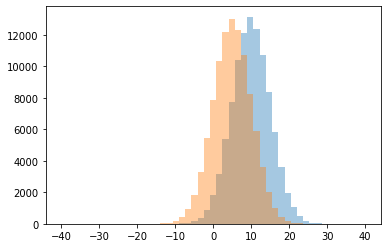

0 0.0
1 0.010101010101010102
2 0.05263157894736842
3 0.058823529411764705
4 0.06486486486486487
5 0.10803324099722991
6 0.19751552795031055
7 0.20036764705882354
8 0.31833150384193193
9 0.4517724649629019
10 0.5916473317865429
11 0.8039969254419678
12 1.0
13 1.0806023029229406
14 1.491745283018868
15 2.2717391304347827
16 3.039772727272727
17 4.391304347826087
18 7.113636363636363
19 9.097560975609756
20 10.5
21 12.4
22 14.571428571428571
23 25.0
24 999999.0




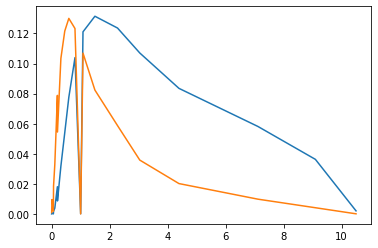

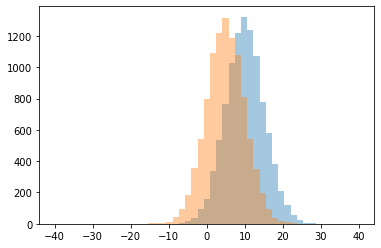

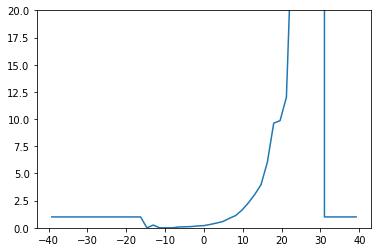

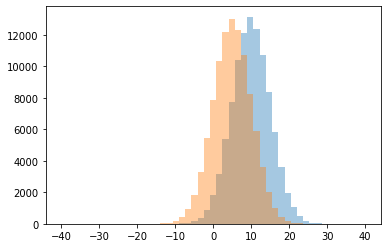

0 0.0
1 0.07368421052631578
2 0.0918918918918919
3 0.11235955056179775
4 0.16911764705882354
5 0.20175438596491227
6 0.25
7 0.30987202925045704
8 0.4388843314191961
9 0.5820668693009119
10 0.8682432432432432
11 1.0
12 1.129062209842154
13 1.6293103448275863
14 2.293135435992579
15 3.0598290598290596
16 3.9693877551020407
17 6.041666666666667
18 9.625
19 9.857142857142858
20 12.0
21 22.0
22 29.0
23 999999.0




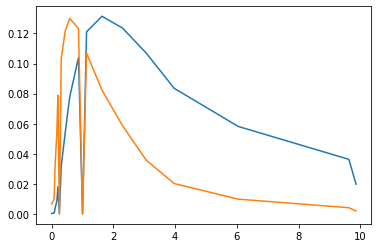

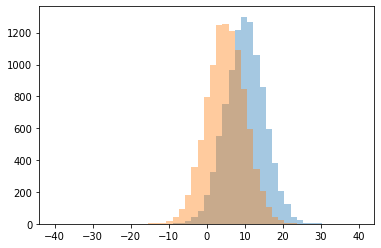

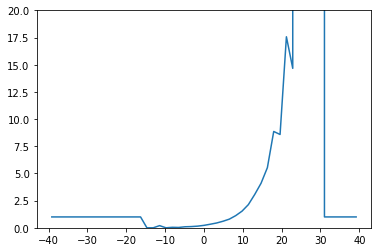

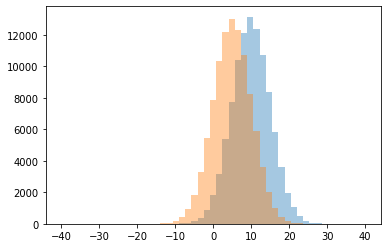

0 0.0
1 0.031578947368421054
2 0.045454545454545456
3 0.09392265193370165
4 0.11235955056179775
5 0.1523809523809524
6 0.2
7 0.22431077694235588
8 0.3289738430583501
9 0.44310897435897434
10 0.6025538707102953
11 0.7971854304635762
12 1.0
13 1.1175390266299357
14 1.5312131919905771
15 2.1315345699831365
16 3.0635838150289016
17 4.095693779904306
18 5.5327102803738315
19 8.583333333333334
20 8.86046511627907
21 14.666666666666666
22 17.571428571428573
23 999999.0




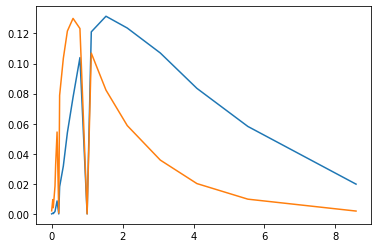

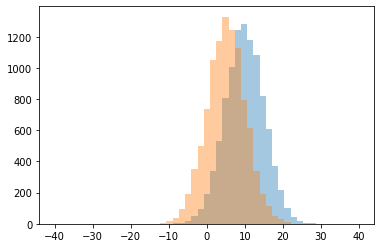

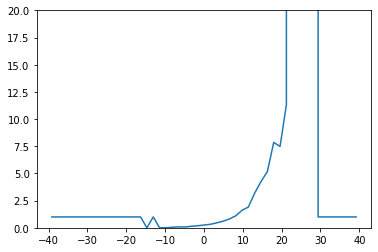

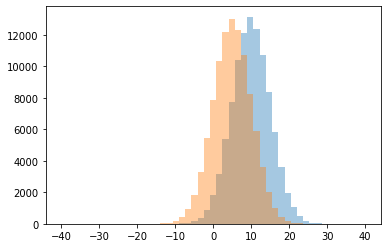

0 0.0
1 0.05263157894736842
2 0.07936507936507936
3 0.08247422680412371
4 0.13714285714285715
5 0.186
6 0.2557510148849797
7 0.323164918970448
8 0.4547008547008547
9 0.6054216867469879
10 0.8083735909822867
11 1.0
12 1.0992028343666962
13 1.6097867001254704
14 1.9090909090909092
15 3.198224852071006
16 4.253886010362694
17 5.17948717948718
18 7.482758620689655
19 7.851063829787234
20 11.333333333333334
21 999999.0




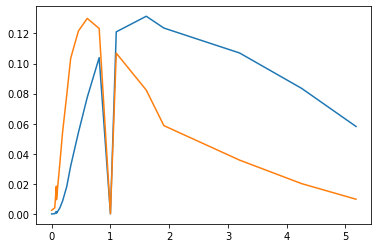

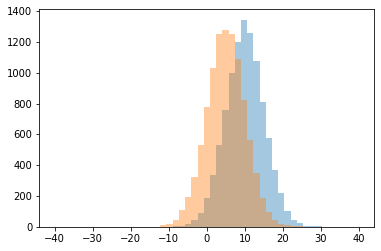

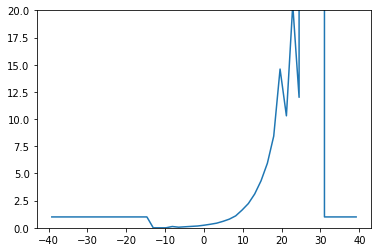

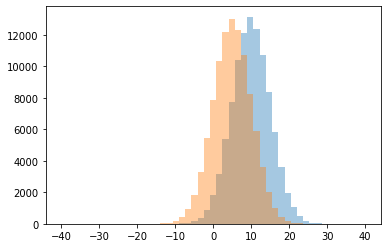

0 0.0
1 0.05504587155963303
2 0.09326424870466321
3 0.11904761904761904
4 0.12923076923076923
5 0.1647940074906367
6 0.23741935483870968
7 0.32490272373540857
8 0.42594075260208164
9 0.5940438871473355
10 0.7972865123703112
11 1.0
12 1.0971585701191566
13 1.6271186440677967
14 2.230496453900709
15 3.11271676300578
16 4.324468085106383
17 5.938144329896907
18 8.431818181818182
19 10.3
20 12.0
21 14.6
22 20.5
23 999999.0




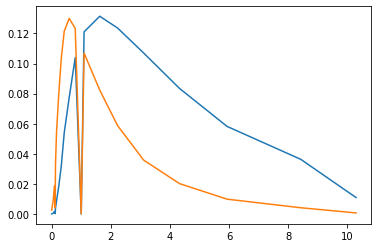

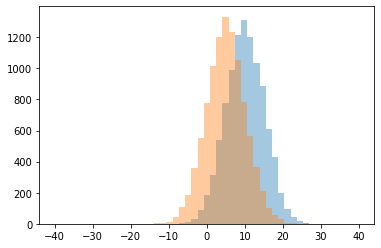

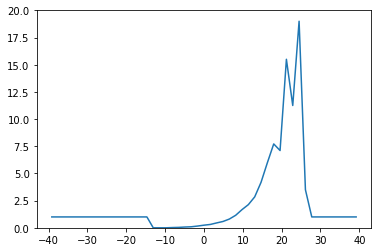

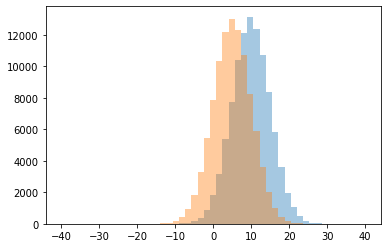

0 0.0
1 0.022727272727272728
2 0.03773584905660377
3 0.07065217391304347
4 0.09418282548476455
5 0.16152450090744103
6 0.24066924066924067
7 0.3080708661417323
8 0.4487072560467056
9 0.581081081081081
10 0.8045417680454177
11 1.0
12 1.1515151515151516
13 1.673052362707535
14 2.1309734513274337
15 2.84297520661157
16 3.5
17 4.183962264150943
18 5.990196078431373
19 7.107142857142857
20 7.714285714285714
21 11.25
22 15.5
23 19.0




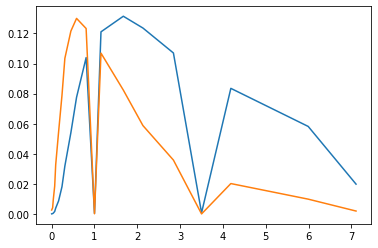

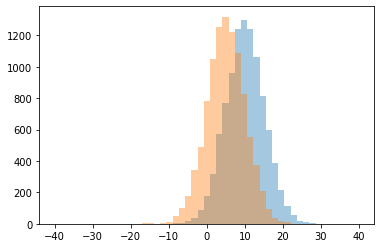

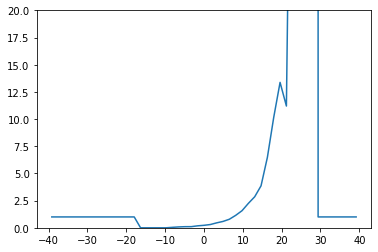

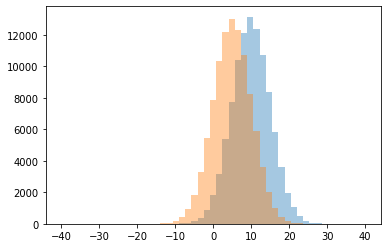

0 0.0
1 0.041666666666666664
2 0.08
3 0.10285714285714286
4 0.10526315789473684
5 0.18126272912423624
6 0.22849807445442877
7 0.3005725190839695
8 0.4544728434504792
9 0.5852918877937832
10 0.7860655737704918
11 1.0
12 1.144700460829493
13 1.5728155339805825
14 2.2459312839059673
15 2.8548387096774195
16 3.862559241706161
17 6.478260869565218
18 10.157894736842104
19 11.2
20 13.375
21 58.0
22 999999.0




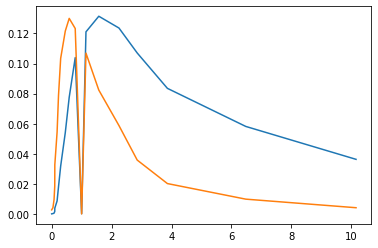

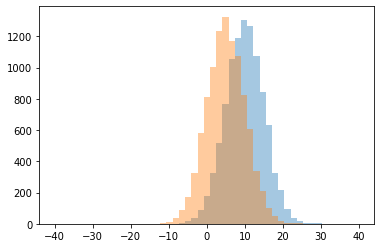

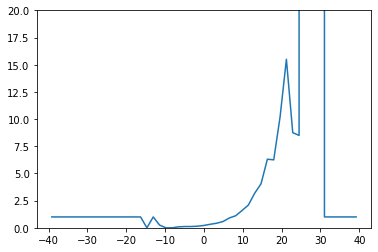

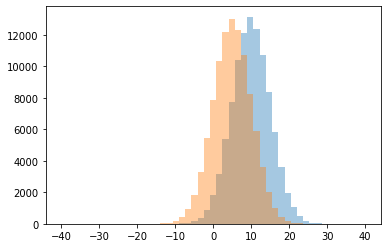

0 0.0
1 0.08888888888888889
2 0.11695906432748537
3 0.11728395061728394
4 0.14802065404475043
5 0.2177121771217712
6 0.25
7 0.325024925224327
8 0.42011354420113545
9 0.5761689291101055
10 0.9050470487596236
11 1.0
12 1.1070763500931098
13 1.5912408759124088
14 2.0892561983471074
15 3.1839762611275964
16 4.048076923076923
17 6.25
18 6.31
19 8.5
20 8.75
21 10.19047619047619
22 15.5
23 999999.0




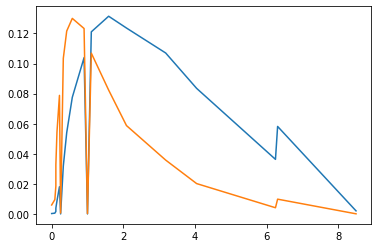

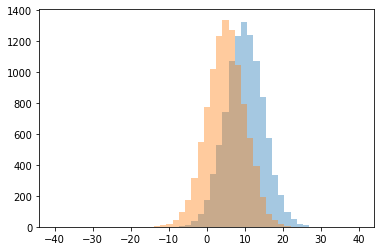

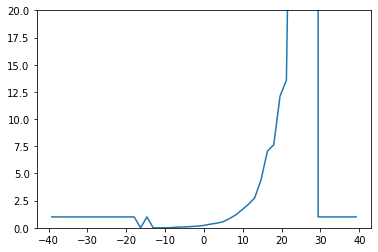

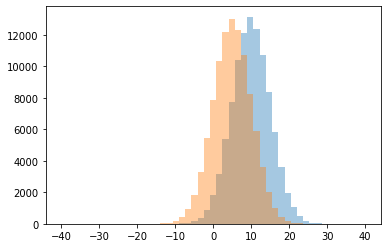

0 0.0
1 0.023809523809523808
2 0.07142857142857142
3 0.08092485549132948
4 0.11464968152866242
5 0.15300546448087432
6 0.22007722007722008
7 0.3330058939096267
8 0.4272948822095857
9 0.5541448842419716
10 0.8430141287284144
11 1.0
12 1.182775119617225
13 1.657465495608532
14 2.1542461005199307
15 2.7564102564102564
16 4.410526315789474
17 7.049382716049383
18 7.636363636363637
19 12.117647058823529
20 13.571428571428571
21 53.0
22 999999.0




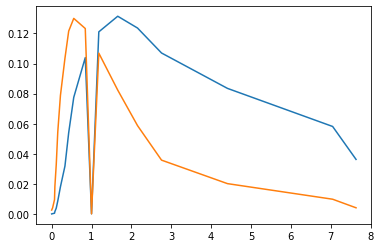

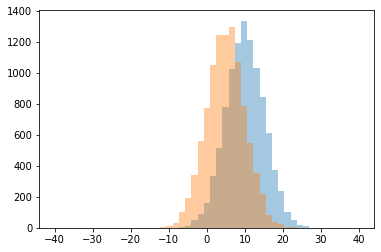

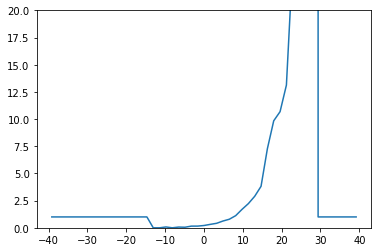

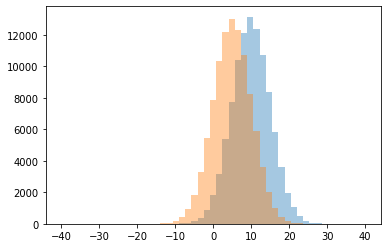

0 0.0
1 0.05128205128205128
2 0.06666666666666667
3 0.07692307692307693
4 0.15384615384615385
5 0.15591397849462366
6 0.211139896373057
7 0.3159392789373814
8 0.414320193081255
9 0.624198717948718
10 0.7884615384615384
11 1.0
12 1.116931711880262
13 1.6958174904942966
14 2.223034734917733
15 2.898876404494382
16 3.81447963800905
17 7.273809523809524
18 9.842105263157896
19 10.681818181818182
20 13.125
21 24.5
22 999999.0




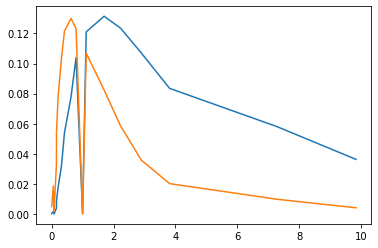

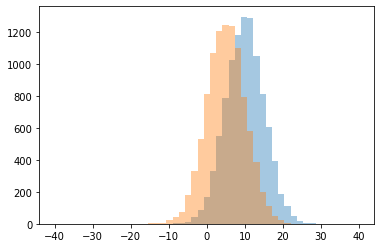

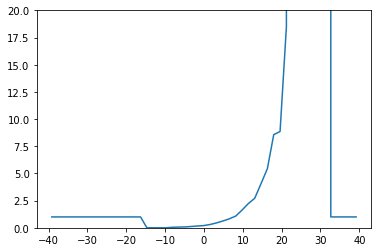

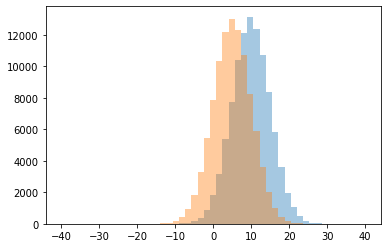

0 0.0
1 0.04878048780487805
2 0.06578947368421052
3 0.07909604519774012
4 0.12048192771084337
5 0.166351606805293
6 0.20638820638820637
7 0.3083411433926898
8 0.45439469320066334
9 0.6302250803858521
10 0.8279483037156704
11 1.0
12 1.0745454545454545
13 1.6276729559748428
14 2.2322357019064123
15 2.7124352331606216
16 4.065
17 5.441441441441442
18 8.565217391304348
19 8.857142857142858
20 18.5
21 999999.0




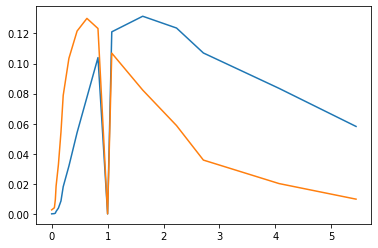

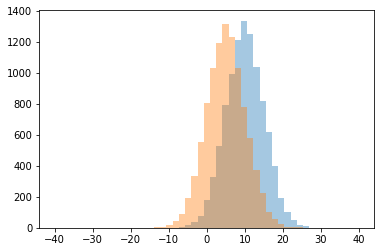

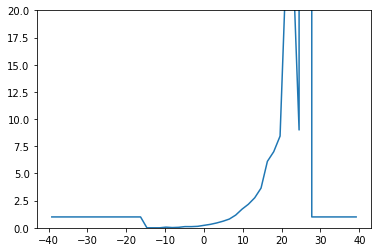

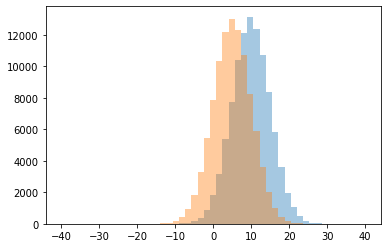

0 0.0
1 0.02127659574468085
2 0.043478260869565216
3 0.058823529411764705
4 0.10682492581602374
5 0.109375
6 0.13430127041742287
7 0.22580645161290322
8 0.31619786614936957
9 0.4450041981528128
10 0.6051829268292683
11 0.8045417680454177
12 1.0
13 1.1692456479690523
14 1.7128205128205127
15 2.164644714038128
16 2.757978723404255
17 3.6517857142857144
18 6.108910891089109
19 7.0
20 8.434782608695652
21 9.0
22 24.75
23 25.0
24 999999.0




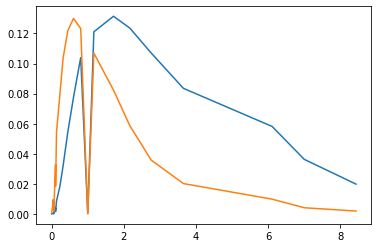

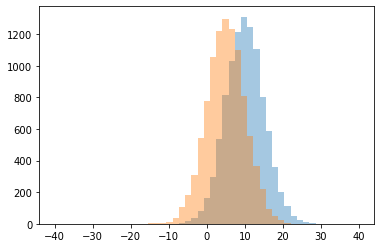

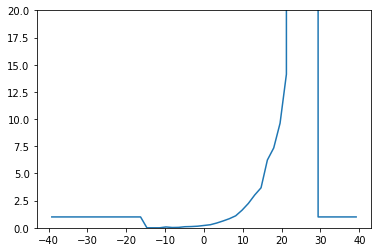

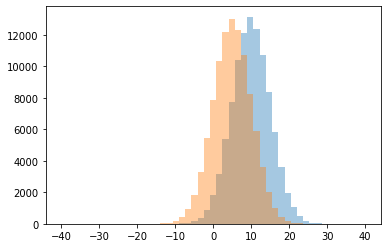

0 0.0
1 0.02631578947368421
2 0.0380952380952381
3 0.07692307692307693
4 0.09944751381215469
5 0.11437908496732026
6 0.14705882352941177
7 0.21419354838709678
8 0.2821969696969697
9 0.4369885433715221
10 0.6265432098765432
11 0.8365853658536585
12 1.0
13 1.1019108280254777
14 1.617283950617284
15 2.2418772563176894
16 3.016348773841962
17 3.6788990825688073
18 6.23404255319149
19 7.346938775510204
20 9.619047619047619
21 14.125
22 999999.0




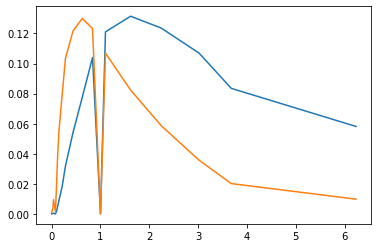

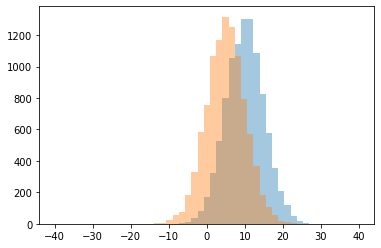

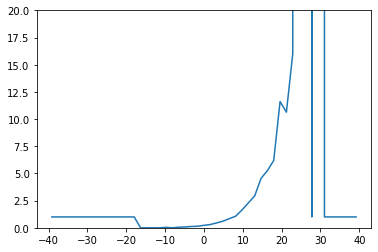

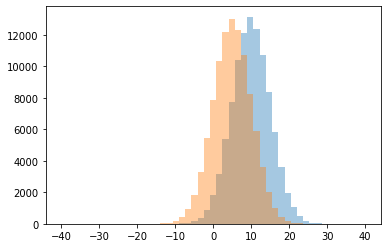

0 0.0
1 0.045454545454545456
2 0.05263157894736842
3 0.07692307692307693
4 0.12121212121212122
5 0.14261168384879724
6 0.22823218997361477
7 0.30112570356472795
8 0.4490145672664953
9 0.6082004555808656
10 0.8427773343974462
11 1.0
12 1.068288119738073
13 1.6431273644388398
14 2.288732394366197
15 2.937837837837838
16 4.54696132596685
17 5.254545454545455
18 6.192982456140351
19 10.636363636363637
20 11.61111111111111
21 16.0
22 999999.0




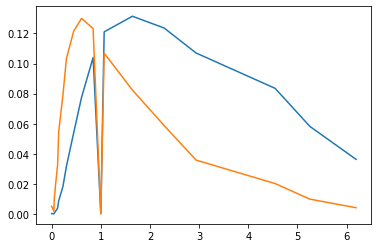

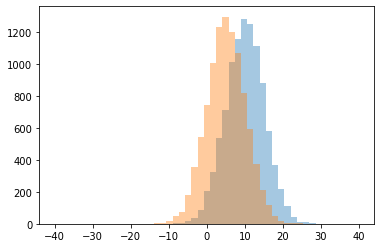

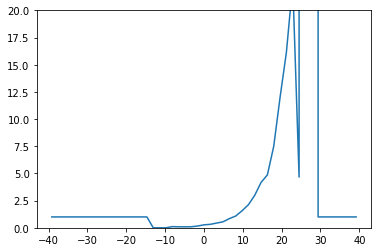

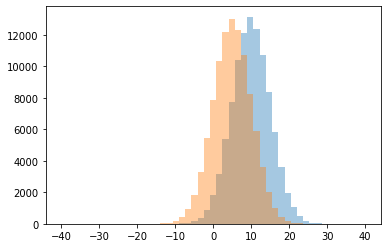

0 0.0
1 0.08743169398907104
2 0.09090909090909091
3 0.0947075208913649
4 0.10869565217391304
5 0.16420664206642066
6 0.2727272727272727
7 0.32007952286282304
8 0.43527508090614886
9 0.5511932255581217
10 0.8431535269709544
11 1.0
12 1.0812324929971988
13 1.56394640682095
14 2.1163575042158516
15 2.983957219251337
16 4.169811320754717
17 4.666666666666667
18 4.866666666666666
19 7.489795918367347
20 12.0
21 16.142857142857142
22 22.5
23 999999.0




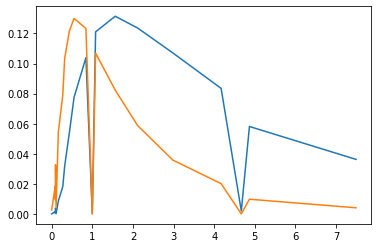

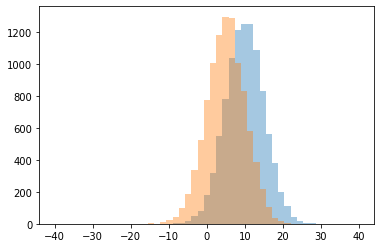

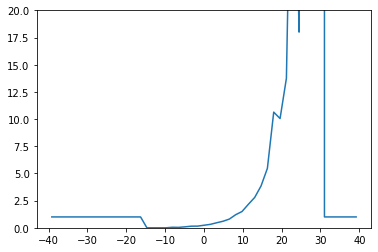

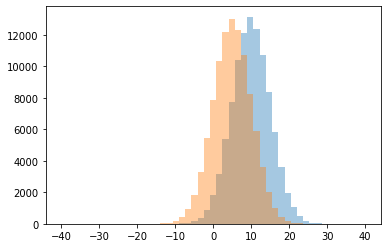

0 0.0
1 0.0392156862745098
2 0.04878048780487805
3 0.08947368421052632
4 0.14836795252225518
5 0.15428571428571428
6 0.2345360824742268
7 0.31646825396825395
8 0.46244725738396625
9 0.6020015396458814
10 0.8021638330757341
11 1.0
12 1.2041625371655105
13 1.4976076555023923
14 2.1600688468158347
15 2.792307692307692
16 3.847926267281106
17 5.466019417475728
18 10.05
19 10.63888888888889
20 13.75
21 18.0
22 45.0
23 999999.0




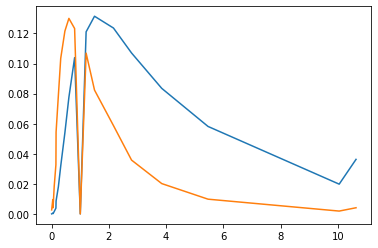

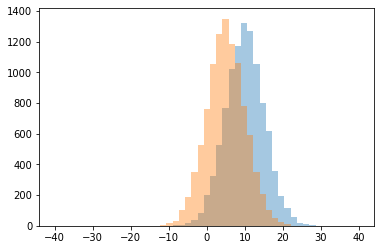

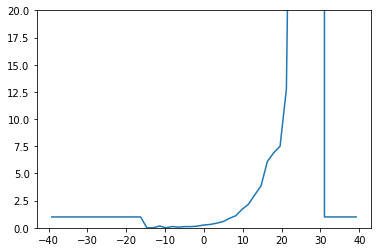

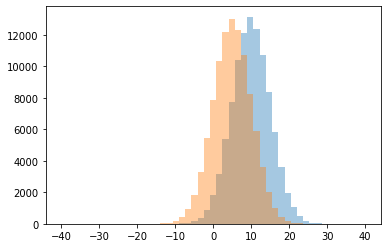

0 0.0
1 0.058823529411764705
2 0.10752688172043011
3 0.10888252148997135
4 0.11764705882352941
5 0.1555977229601518
6 0.16666666666666666
7 0.2617801047120419
8 0.30959164292497626
9 0.4230769230769231
10 0.5674074074074074
11 0.863905325443787
12 1.0
13 1.1076487252124645
14 1.6918158567774937
15 2.1559322033898307
16 3.02
17 3.860576923076923
18 6.099009900990099
19 6.903846153846154
20 7.5
21 12.777777777777779
22 58.0
23 999999.0




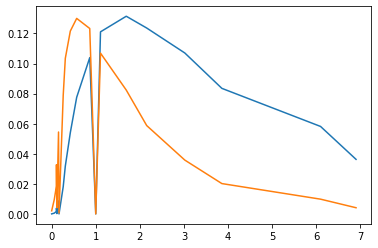

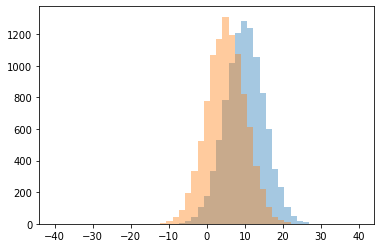

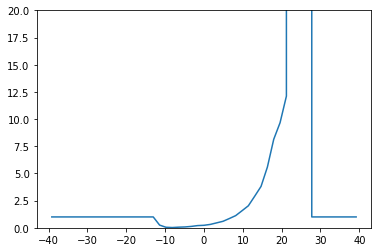

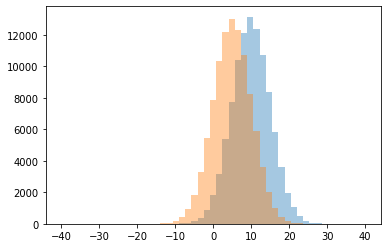

0 0.024390243902439025
1 0.05
2 0.05747126436781609
3 0.078125
4 0.12797619047619047
5 0.2030360531309298
6 0.2300771208226221
7 0.25
8 0.31179775280898875
9 0.4541559554413025
10 0.597254004576659
11 0.8518828451882845
12 1.0
13 1.1197771587743732
14 1.568986568986569
15 2.026143790849673
16 2.90633608815427
17 3.8073394495412844
18 5.583333333333333
19 8.13953488372093
20 9.666666666666666
21 12.11111111111111
22 999999.0




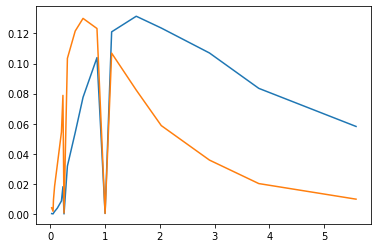

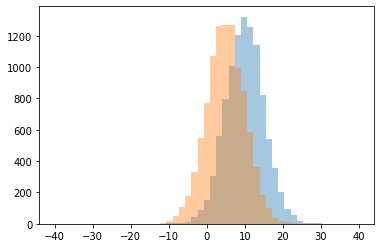

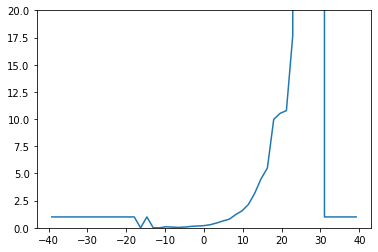

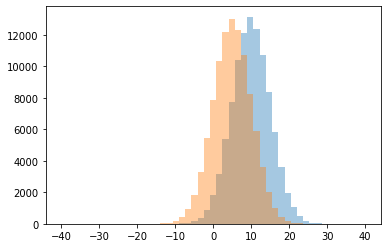

0 0.0
1 0.037383177570093455
2 0.06
3 0.06857142857142857
4 0.1
5 0.13109756097560976
6 0.1651376146788991
7 0.1979301423027167
8 0.28785046728971964
9 0.44285714285714284
10 0.6301261829652997
11 0.7940015785319653
12 1.0
13 1.213925327951564
14 1.5596221959858323
15 2.141880341880342
16 3.172222222222222
17 4.5054945054945055
18 5.494949494949495
19 9.972222222222221
20 10.526315789473685
21 10.777777777777779
22 17.666666666666668
23 999999.0




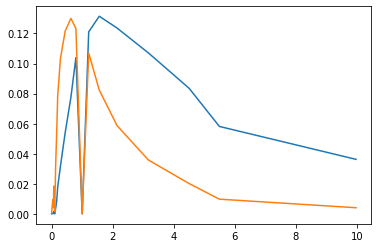

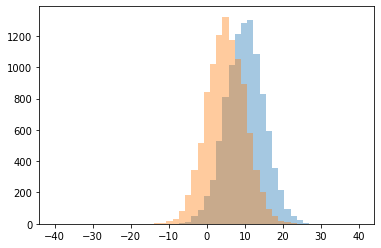

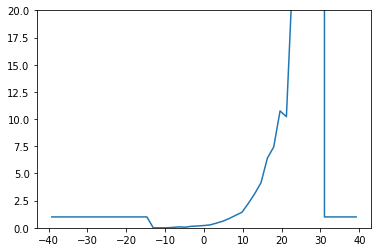

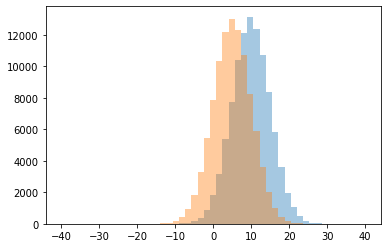

0 0.0
1 0.03225806451612903
2 0.05434782608695652
3 0.08333333333333333
4 0.13742690058479531
5 0.16602316602316602
6 0.20952380952380953
7 0.2727272727272727
8 0.43661971830985913
9 0.6099773242630385
10 0.8621276595744681
11 1.0
12 1.1499051233396584
13 1.4312849162011174
14 2.251299826689775
15 3.1358381502890174
16 4.155
17 6.408602150537634
18 7.4375
19 10.222222222222221
20 10.75
21 23.5
22 999999.0




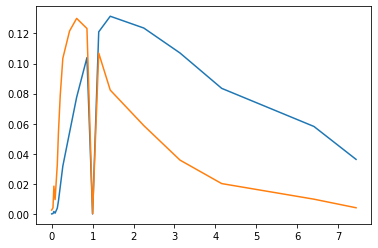

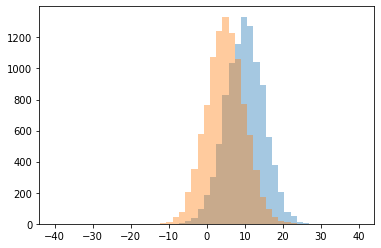

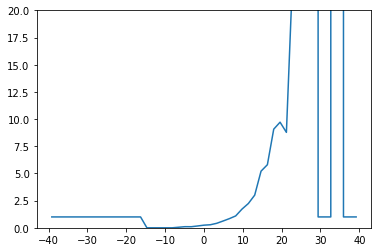

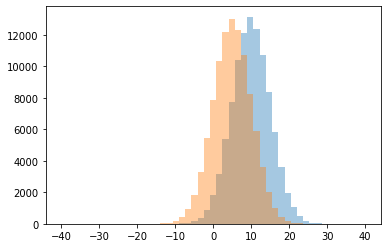

0 0.0
1 0.05128205128205128
2 0.09943181818181818
3 0.1024390243902439
4 0.1681109185441941
5 0.24214659685863874
6 0.2798507462686567
7 0.4114331723027375
8 0.6218045112781955
9 0.8410757946210269
10 1.0
11 1.0915094339622642
12 1.7222222222222223
13 2.233743409490334
14 3.005763688760807
15 5.209302325581396
16 5.802083333333333
17 8.777777777777779
18 9.071428571428571
19 9.714285714285714
20 23.5
21 999999.0




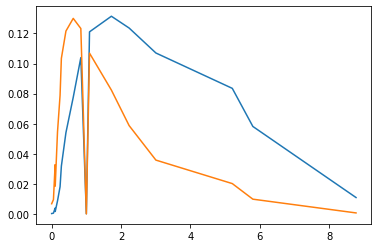

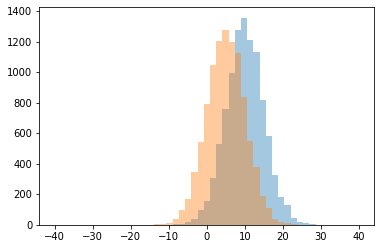

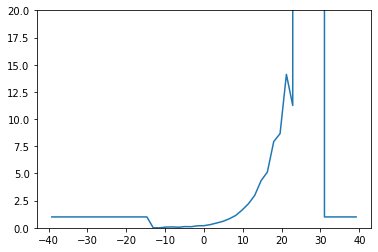

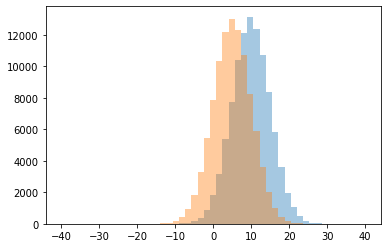

0 0.0
1 0.05154639175257732
2 0.06666666666666667
3 0.08108108108108109
4 0.10115606936416185
5 0.11046511627906977
6 0.18450184501845018
7 0.19395465994962216
8 0.2950191570881226
9 0.4405652535328346
10 0.594679186228482
11 0.8308333333333333
12 1.0
13 1.1343416370106763
14 1.6251497005988025
15 2.2036363636363636
16 2.9789473684210526
17 4.322751322751323
18 5.132743362831858
19 7.926829268292683
20 8.666666666666666
21 11.25
22 14.11111111111111
23 999999.0




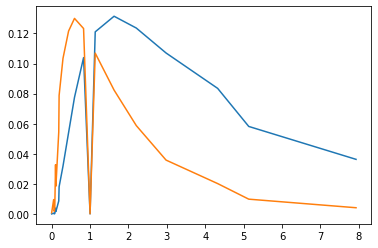

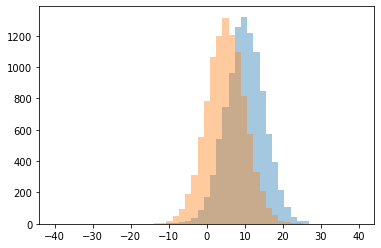

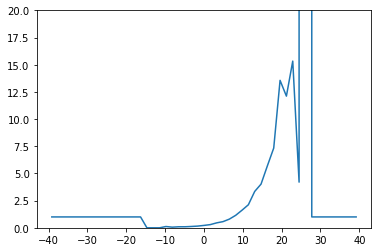

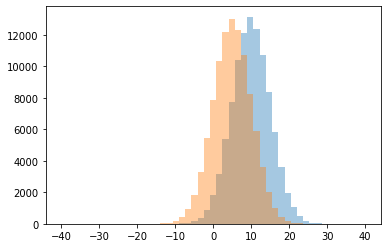

0 0.0
1 0.058823529411764705
2 0.09375
3 0.09473684210526316
4 0.11764705882352941
5 0.12140575079872204
6 0.1564748201438849
7 0.2193877551020408
8 0.294062205466541
9 0.45363408521303256
10 0.5669710806697108
11 0.7978369384359401
12 1.0
13 1.147810218978102
14 1.6188725490196079
15 2.118673647469459
16 3.3445121951219514
17 4.018957345971564
18 4.2
19 5.7
20 7.333333333333333
21 12.11111111111111
22 13.5625
23 15.333333333333334
24 999999.0




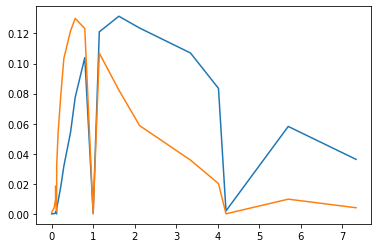

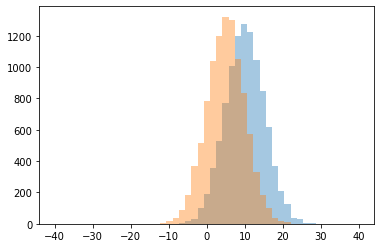

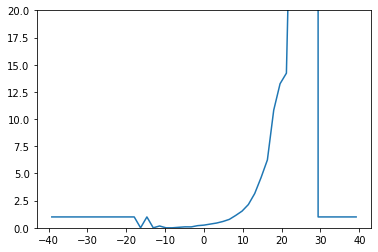

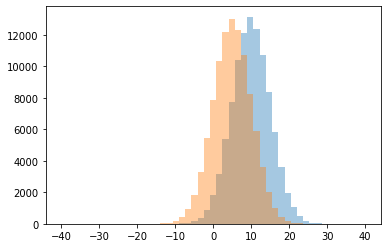

0 0.0
1 0.0449438202247191
2 0.08355795148247978
3 0.08648648648648649
4 0.16666666666666666
5 0.19729206963249515
6 0.24648786717752236
7 0.34326923076923077
8 0.43880099916736054
9 0.5821347464042392
10 0.7756360832690825
11 1.0
12 1.1358024691358024
13 1.5324519230769231
14 2.138353765323993
15 3.1506024096385543
16 4.614130434782608
17 6.242424242424242
18 10.823529411764707
19 13.25
20 14.222222222222221
21 30.0
22 40.0
23 999999.0




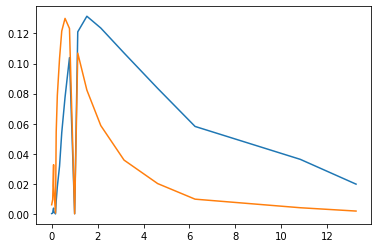

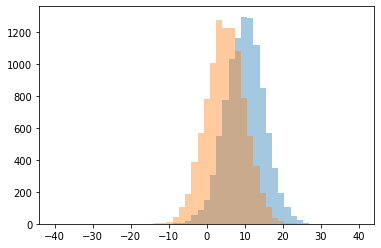

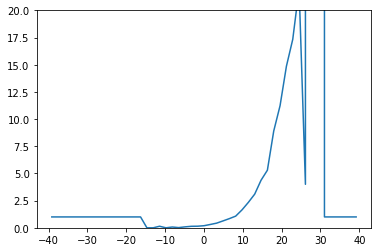

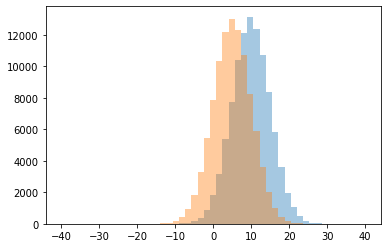

0 0.0
1 0.018691588785046728
2 0.07142857142857142
3 0.0855614973262032
4 0.13766233766233765
5 0.14285714285714285
6 0.14685314685314685
7 0.1910828025477707
8 0.30654761904761907
9 0.4284597341673182
10 0.6332518337408313
11 0.8429617575264443
12 1.0
13 1.0728110599078342
14 1.6493011435832274
15 2.338768115942029
16 3.096685082872928
17 4.0
18 4.374358974358974
19 5.296296296296297
20 8.897435897435898
21 11.235294117647058
22 14.857142857142858
23 17.333333333333332
24 22.0
25 999999.0




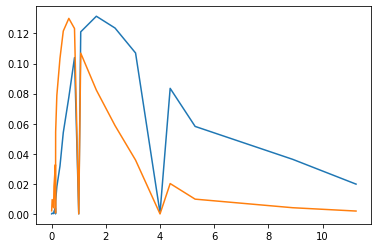

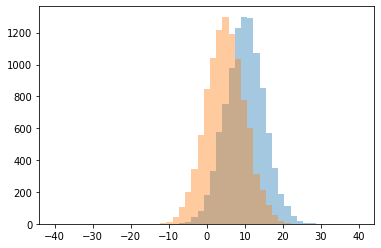

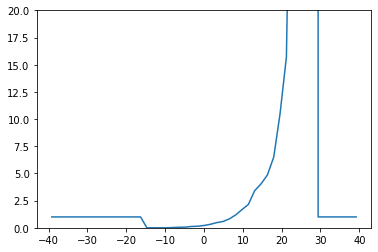

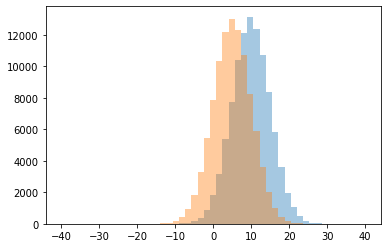

0 0.0
1 0.025
2 0.04672897196261682
3 0.06091370558375635
4 0.11988304093567251
5 0.14311270125223613
6 0.21208530805687204
7 0.32019230769230766
8 0.4745484400656814
9 0.5792307692307692
10 0.818105616093881
11 1.0
12 1.185149469623915
13 1.6774193548387097
14 2.1440397350993377
15 3.4203821656050954
16 4.037914691943128
17 4.854700854700854
18 6.5
19 10.5
20 15.714285714285714
21 50.0
22 999999.0




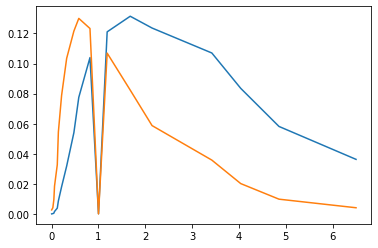

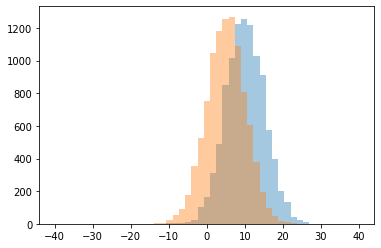

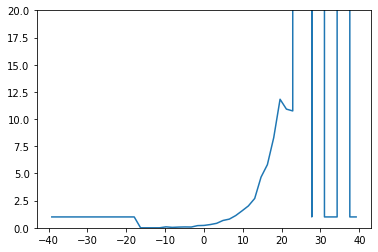

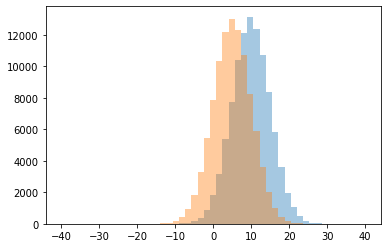

0 0.0
1 0.038461538461538464
2 0.06521739130434782
3 0.0708215297450425
4 0.07865168539325842
5 0.08695652173913043
6 0.2
7 0.21866666666666668
8 0.29894937917860553
9 0.41216216216216217
10 0.6746221161495625
11 0.7990543735224587
12 1.0
13 1.1239669421487604
14 1.5576208178438662
15 2.0098846787479405
16 2.6981627296587924
17 4.661538461538462
18 5.808080808080808
19 8.291666666666666
20 10.75
21 10.916666666666666
22 11.823529411764707
23 999999.0




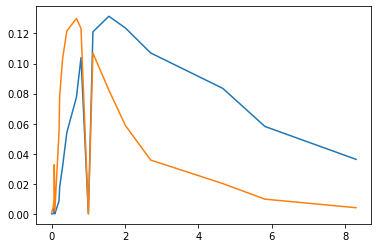

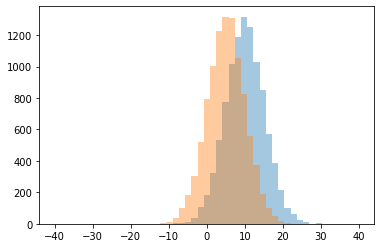

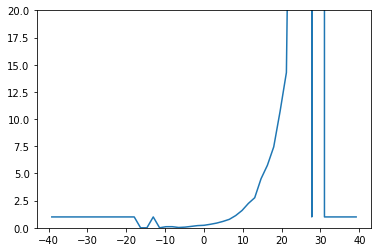

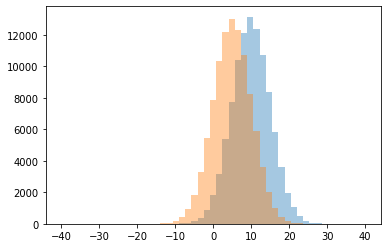

0 0.0
1 0.0297029702970297
2 0.06111111111111111
3 0.1
4 0.10256410256410256
5 0.13071895424836602
6 0.20153550863723607
7 0.23008849557522124
8 0.3220675944333996
9 0.43322475570032576
10 0.5876993166287016
11 0.7790519877675841
12 1.0
13 1.125
14 1.5912938331318016
15 2.2397137745974955
16 2.7640750670241285
17 4.5132275132275135
18 5.747474747474747
19 7.4423076923076925
20 10.7
21 14.285714285714286
22 60.0
23 999999.0




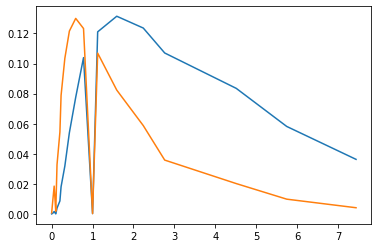

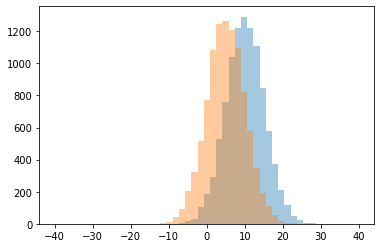

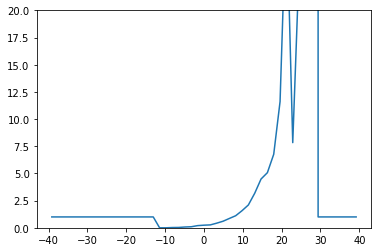

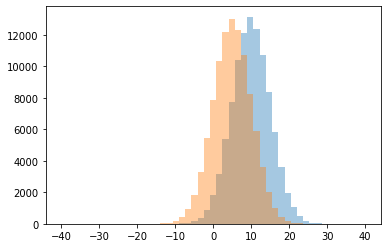

0 0.0
1 0.024390243902439025
2 0.031914893617021274
3 0.07281553398058252
4 0.096875
5 0.20038910505836577
6 0.24057217165149544
7 0.26709796672828096
8 0.4245585874799358
9 0.6022187004754358
10 0.8584437086092715
11 1.0
12 1.110200364298725
13 1.5724725943970768
14 2.099827882960413
15 3.174785100286533
16 4.4867724867724865
17 5.0701754385964914
18 6.763636363636364
19 7.833333333333333
20 11.61111111111111
21 24.0
22 30.0
23 999999.0




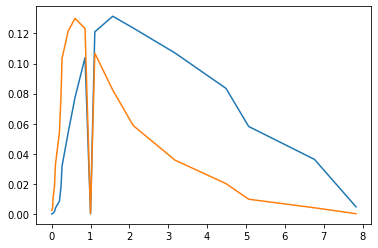

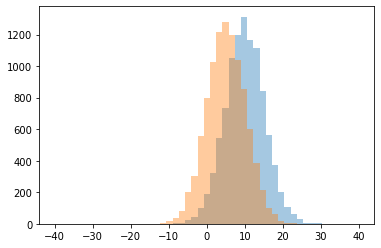

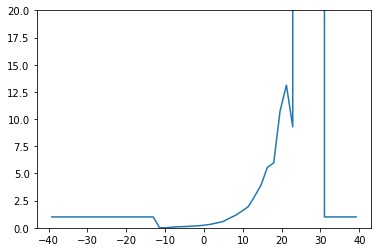

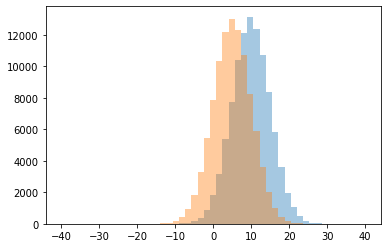

0 0.0
1 0.058823529411764705
2 0.0975609756097561
3 0.11442786069651742
4 0.1490066225165563
5 0.17805755395683454
6 0.2399497487437186
7 0.3157894736842105
8 0.44535743631881675
9 0.5755677368833203
10 0.8770903010033445
11 1.0
12 1.1549566891241578
13 1.5374707259953162
14 1.951505016722408
15 2.9138381201044385
16 3.9209302325581397
17 5.564356435643564
18 5.967741935483871
19 9.285714285714286
20 10.736842105263158
21 13.125
22 999999.0




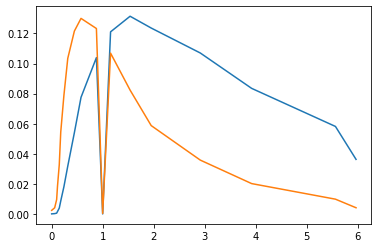

on f= 0.0


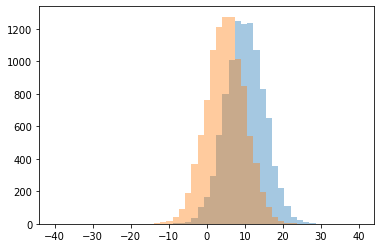

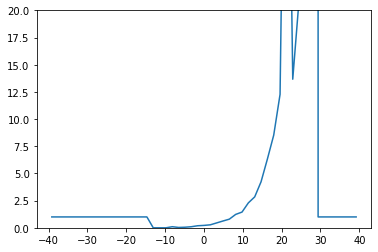

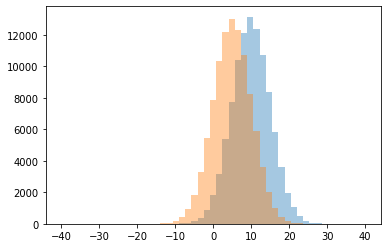

0 0.0
1 0.03260869565217391
2 0.05291005291005291
3 0.09809264305177112
4 0.1
5 0.1882998171846435
6 0.22018348623853212
7 0.27450980392156865
8 0.44921552436003304
9 0.6258823529411764
10 0.7954366640440598
11 1.0
12 1.2319842053307009
13 1.4464075382803299
14 2.293135435992579
15 2.843501326259947
16 4.229591836734694
17 6.320388349514563
18 8.523809523809524
19 12.277777777777779
20 13.666666666666666
21 21.0
22 55.5
23 999999.0




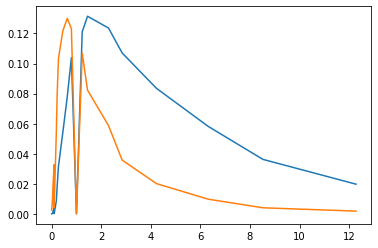

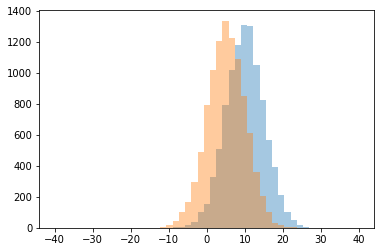

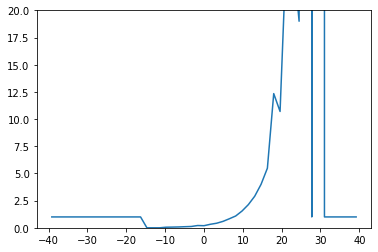

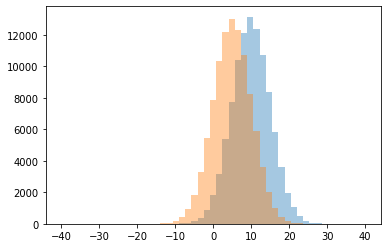

0 0.0
1 0.05263157894736842
2 0.06382978723404255
3 0.07766990291262135
4 0.10059171597633136
5 0.12121212121212122
6 0.19318181818181818
7 0.20934959349593496
8 0.3228655544651619
9 0.4206611570247934
10 0.5911808669656203
11 0.8307567127746135
12 1.0
13 1.0853994490358128
14 1.5418138987043581
15 2.132569558101473
16 2.903314917127072
17 3.995169082125604
18 5.480769230769231
19 10.7
20 12.34375
21 19.0
22 25.5
23 25.75
24 999999.0




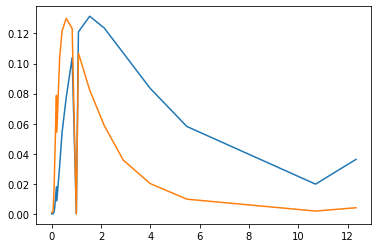

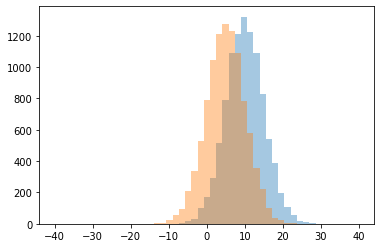

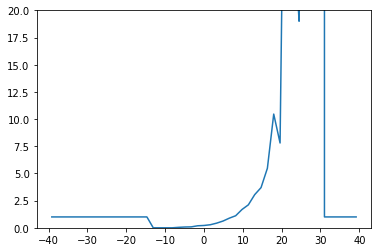

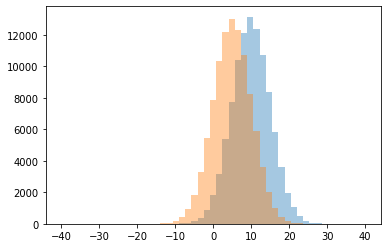

0 0.0
1 0.042105263157894736
2 0.07246376811594203
3 0.0855457227138643
4 0.1856060606060606
5 0.2139240506329114
6 0.2820267686424474
7 0.428099173553719
8 0.6202830188679245
9 0.886899918633035
10 1.0
11 1.1091743119266055
12 1.6849489795918366
13 2.112456747404844
14 3.0504201680672267
15 3.6964285714285716
16 5.474747474747475
17 7.8
18 10.45945945945946
19 19.0
20 29.0
21 55.0
22 999999.0




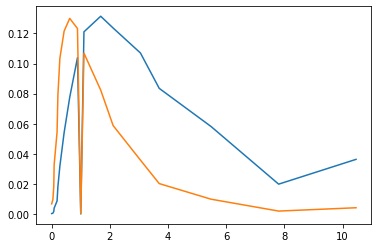

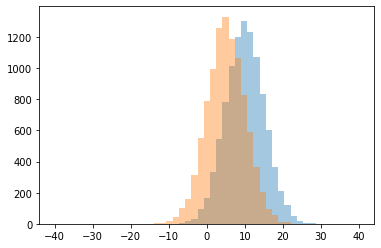

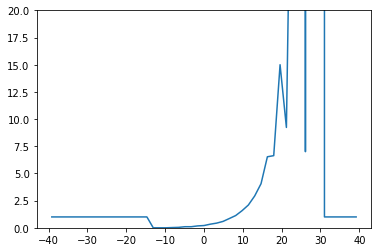

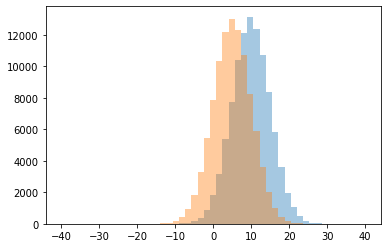

0 0.0
1 0.022222222222222223
2 0.04040404040404041
3 0.09937888198757763
4 0.09967845659163987
5 0.17391304347826086
6 0.20733249051833122
7 0.3333333333333333
8 0.43061062648691517
9 0.5860255447032306
10 0.8529411764705882
11 1.0
12 1.1264044943820224
13 1.5716004813477737
14 2.095076400679117
15 2.9315068493150687
16 4.058536585365854
17 6.532608695652174
18 6.636363636363637
19 7.0
20 9.23076923076923
21 15.0
22 47.0
23 999999.0




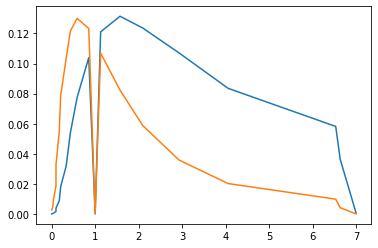

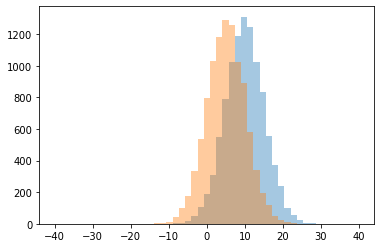

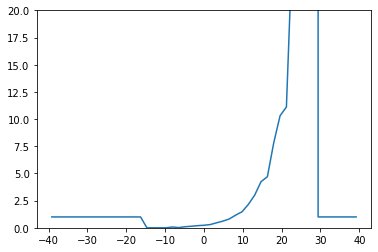

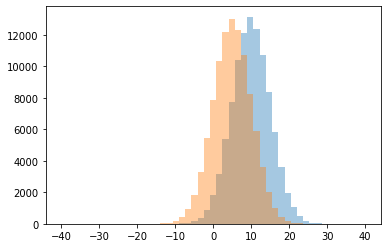

0 0.0
1 0.020202020202020204
2 0.07317073170731707
3 0.096045197740113
4 0.14156626506024098
5 0.1973929236499069
6 0.23433583959899748
7 0.29912875121006777
8 0.46199324324324326
9 0.6156832298136646
10 0.8154335719968179
11 1.0
12 1.1653620352250489
13 1.4746906636670416
14 2.1497418244406195
15 3.0088235294117647
16 4.243654822335025
17 4.697478991596639
18 7.8125
19 10.304347826086957
20 11.11111111111111
21 27.0
22 999999.0




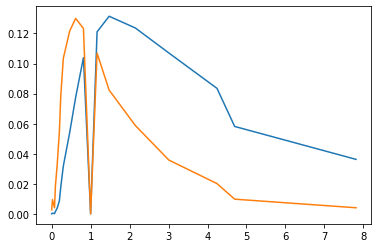

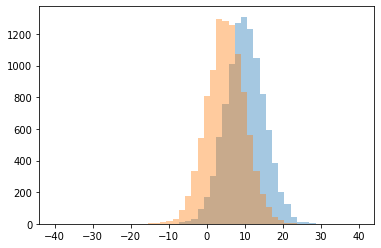

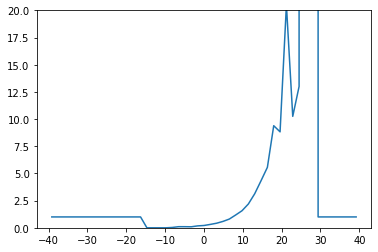

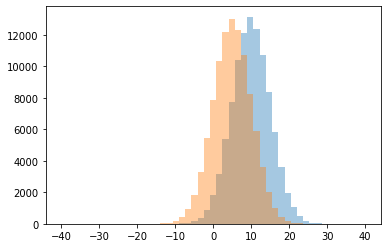

0 0.0
1 0.03125
2 0.09337349397590361
3 0.10112359550561797
4 0.10227272727272728
5 0.1761467889908257
6 0.2124223602484472
7 0.3117283950617284
8 0.4223938223938224
9 0.5883268482490273
10 0.8047808764940239
11 1.0
12 1.179368029739777
13 1.5695443645083933
14 2.1900532859680286
15 3.1313432835820896
16 4.331578947368421
17 5.5607476635514015
18 8.826086956521738
19 9.390243902439025
20 10.25
21 13.0
22 20.5
23 999999.0




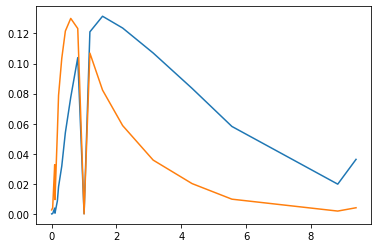

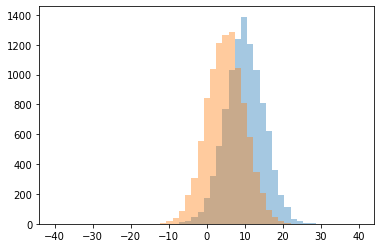

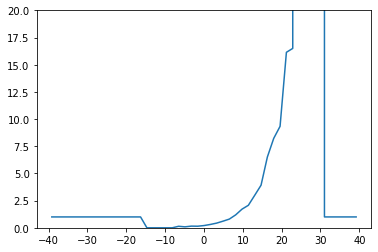

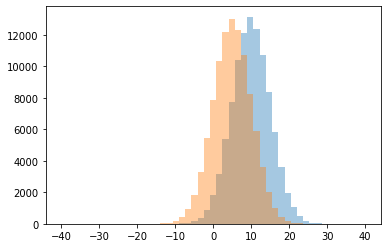

0 0.0
1 0.08808290155440414
2 0.13953488372093023
3 0.14542190305206462
4 0.1540983606557377
5 0.20546318289786222
6 0.30732177263969174
7 0.4310487200660611
8 0.6091772151898734
9 0.8012422360248447
10 1.0
11 1.1902017291066282
12 1.715698393077874
13 2.070446735395189
14 2.9884393063583814
15 3.9174757281553396
16 6.515789473684211
17 8.227272727272727
18 9.333333333333334
19 16.142857142857142
20 16.5
21 999999.0




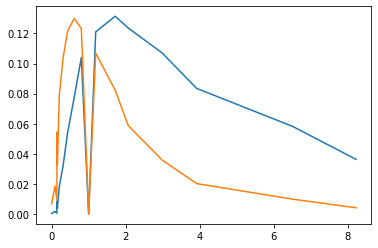

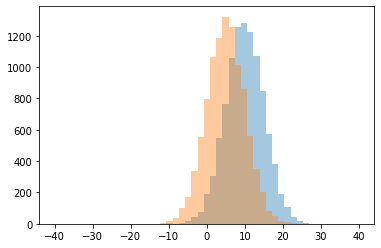

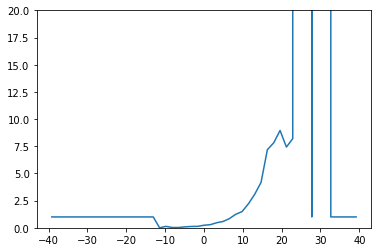

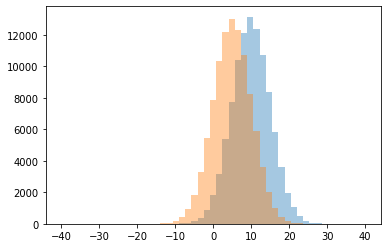

0 0.0
1 0.02564102564102564
2 0.029411764705882353
3 0.08620689655172414
4 0.12275449101796407
5 0.13176895306859207
6 0.13333333333333333
7 0.23492462311557788
8 0.2879924953095685
9 0.46491969568892644
10 0.5798637395912187
11 0.841686555290374
12 1.0
13 1.2379072063178678
14 1.486078886310905
15 2.201077199281867
16 3.0833333333333335
17 4.177339901477833
18 7.1875
19 7.428571428571429
20 7.816326530612245
21 8.2
22 8.952380952380953
23 999999.0




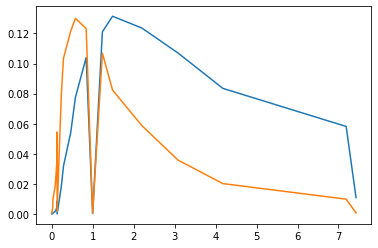

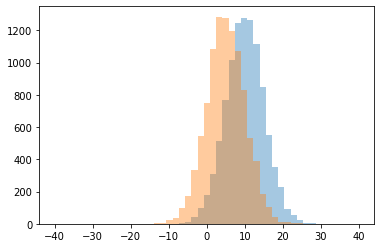

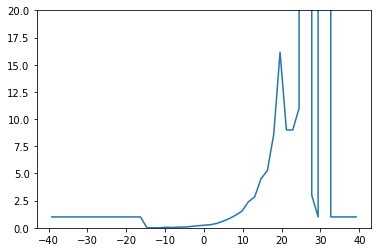

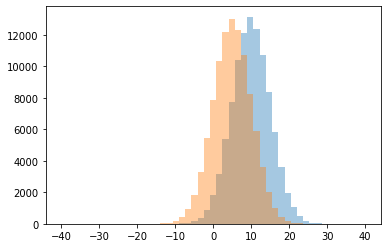

0 0.0
1 0.02857142857142857
2 0.047619047619047616
3 0.0625
4 0.06857142857142857
5 0.1253731343283582
6 0.1846435100548446
7 0.23663101604278075
8 0.285451197053407
9 0.3976653696498054
10 0.6051805337519623
11 0.8482068390325271
12 1.0
13 1.162162162162162
14 1.5349397590361447
15 2.3860640301318266
16 2.853846153846154
17 3.0
18 4.51595744680851
19 5.269230769230769
20 8.585365853658537
21 9.0
22 11.0
23 16.142857142857142
24 999999.0




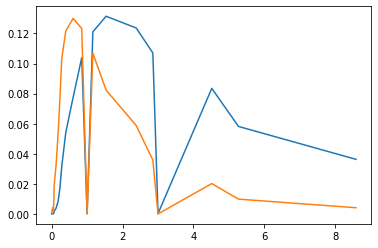

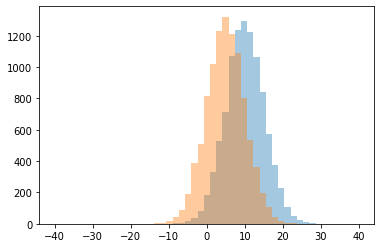

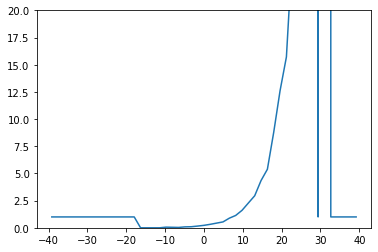

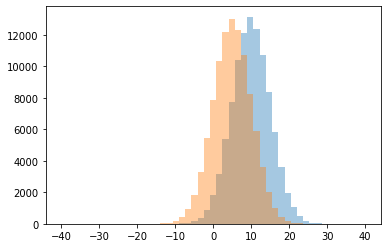

0 0.0
1 0.033707865168539325
2 0.046511627906976744
3 0.058823529411764705
4 0.0851063829787234
5 0.09844559585492228
6 0.15913555992141454
7 0.22616136919315402
8 0.32125367286973555
9 0.4320585842148088
10 0.5412566237698713
11 0.8857615894039735
12 1.0
13 1.1352345906163754
14 1.605721393034826
15 2.279850746268657
16 2.9472222222222224
17 4.345360824742268
18 5.383177570093458
19 8.790697674418604
20 12.61111111111111
21 15.714285714285714
22 22.0
23 26.0
24 999999.0




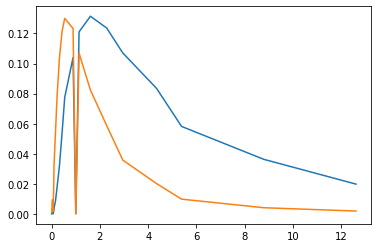

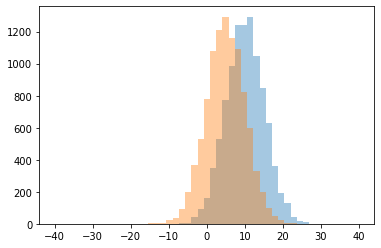

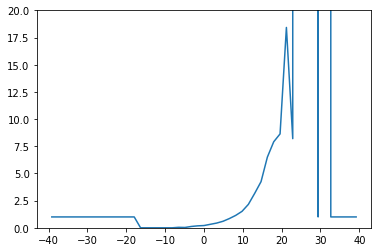

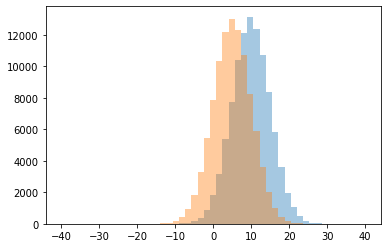

0 0.0
1 0.030612244897959183
2 0.043478260869565216
3 0.12195121951219512
4 0.1792452830188679
5 0.2069408740359897
6 0.32070240295748614
7 0.43446001648804616
8 0.5993812838360402
9 0.8485370051635112
10 1.0
11 1.1395775941230486
12 1.51278928136419
13 2.1533333333333333
14 3.16969696969697
15 4.2462311557788945
16 6.505154639175258
17 7.913043478260869
18 8.2
19 8.636363636363637
20 18.428571428571427
21 999999.0




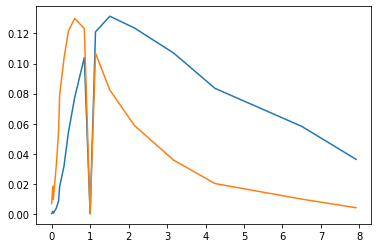

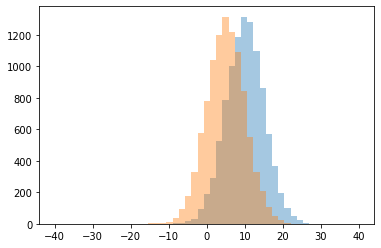

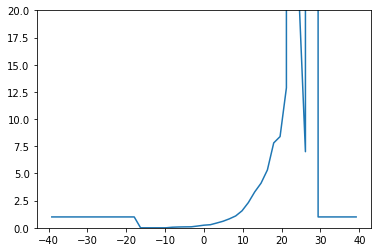

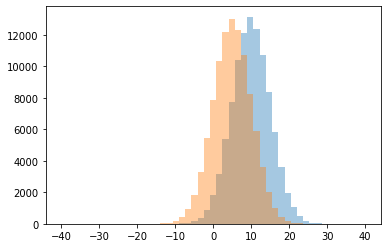

0 0.0
1 0.05263157894736842
2 0.07446808510638298
3 0.08426966292134831
4 0.0911854103343465
5 0.16319444444444445
6 0.24102564102564103
7 0.2829643888354187
8 0.43812709030100333
9 0.601067887109077
10 0.8230958230958231
11 1.0
12 1.0899908172635446
13 1.5617577197149644
14 2.3206521739130435
15 3.2981927710843375
16 4.104761904761904
17 5.317757009345795
18 7.0
19 7.808510638297872
20 8.391304347826088
21 12.875
22 21.0
23 999999.0




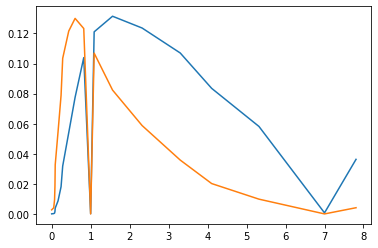

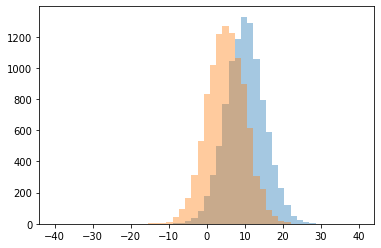

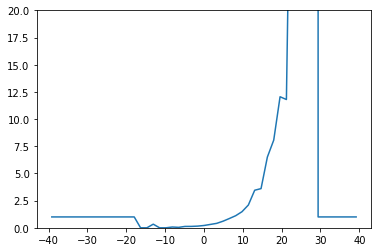

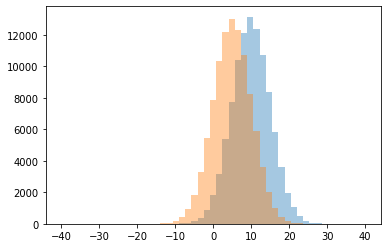

0 0.0
1 0.04081632653061224
2 0.07142857142857142
3 0.12574850299401197
4 0.1282051282051282
5 0.15500945179584122
6 0.21223021582733814
7 0.3094302554027505
8 0.3333333333333333
9 0.4077112387202625
10 0.6062992125984252
11 0.8529411764705882
12 1.0
13 1.1119473189087488
14 1.4821428571428572
15 2.096091205211726
16 3.455737704918033
17 3.6045454545454545
18 6.511111111111111
19 8.063829787234043
20 11.8
21 12.052631578947368
22 50.0
23 999999.0




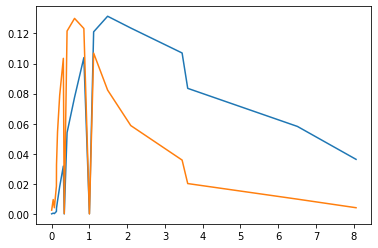

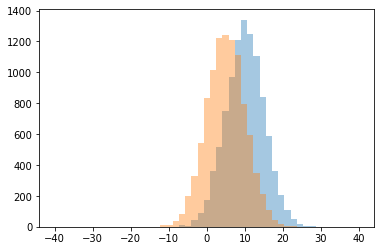

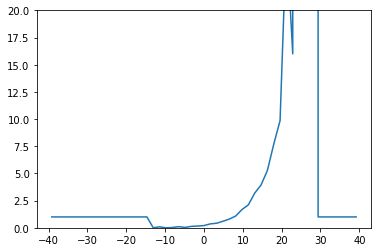

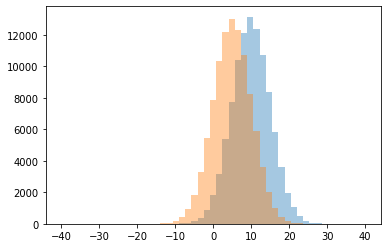

0 0.0
1 0.02702702702702703
2 0.034653465346534656
3 0.09090909090909091
4 0.10465116279069768
5 0.13069908814589665
6 0.15992647058823528
7 0.20479041916167665
8 0.35932872655478776
9 0.4207516339869281
10 0.6036977491961415
11 0.8024793388429752
12 1.0
13 1.0825112107623318
14 1.6825595984943538
15 2.109612141652614
16 3.1873198847262247
17 3.9345794392523366
18 5.27027027027027
19 7.680851063829787
20 9.857142857142858
21 16.0
22 26.75
23 999999.0




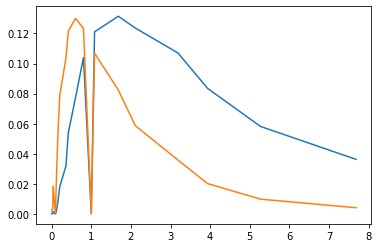

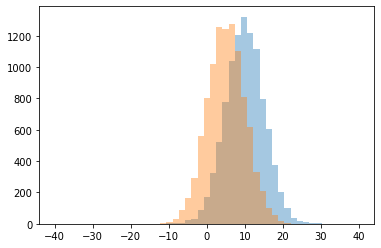

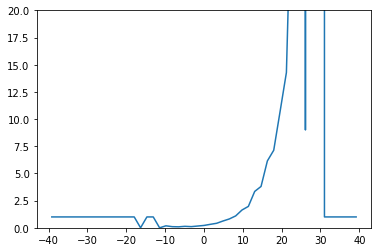

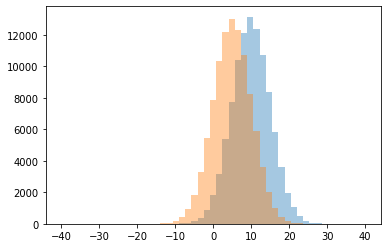

0 0.0
1 0.0898876404494382
2 0.10344827586206896
3 0.10689655172413794
4 0.13496932515337423
5 0.1622103386809269
6 0.18181818181818182
7 0.21641791044776118
8 0.3185840707964602
9 0.4152744630071599
10 0.6252006420545746
11 0.8142633228840125
12 1.0
13 1.0935513169845594
14 1.6381660470879802
15 1.967741935483871
16 3.3453453453453452
17 3.8038277511961724
18 6.153061224489796
19 7.132075471698113
20 9.0
21 10.68421052631579
22 14.285714285714286
23 36.0
24 999999.0




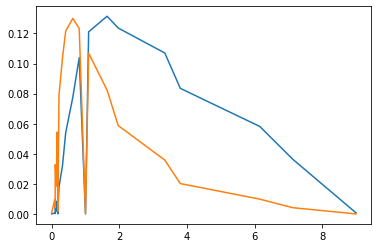

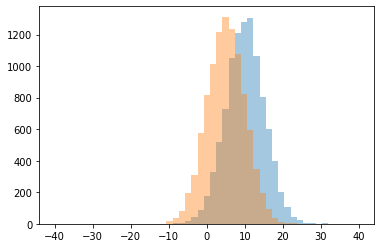

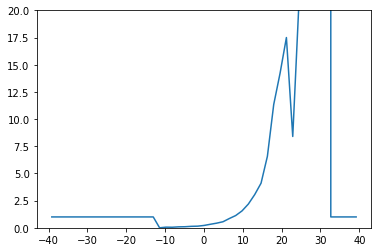

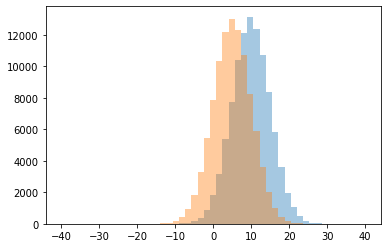

0 0.0
1 0.05128205128205128
2 0.058823529411764705
3 0.0875
4 0.0979381443298969
5 0.1346153846153846
6 0.15008726003490402
7 0.21542227662178703
8 0.32344213649851633
9 0.4265791632485644
10 0.5567402894135567
11 0.8530844155844156
12 1.0
13 1.1265116279069767
14 1.5540704738760631
15 2.185929648241206
16 3.054441260744986
17 4.1020408163265305
18 6.571428571428571
19 8.4
20 11.342857142857143
21 14.214285714285714
22 17.5
23 21.0
24 999999.0




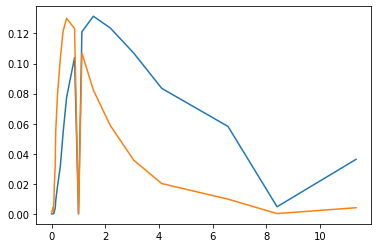

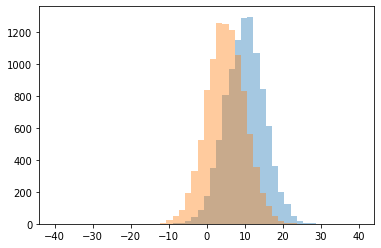

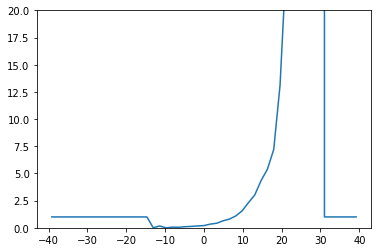

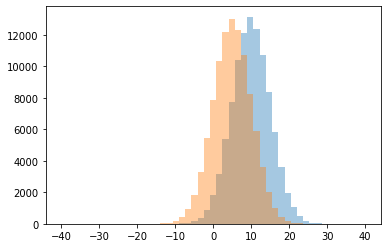

0 0.0
1 0.046511627906976744
2 0.06
3 0.1
4 0.1276595744680851
5 0.16666666666666666
6 0.16984732824427481
7 0.20381406436233612
8 0.33978702807357214
9 0.4169976171564734
10 0.6435406698564593
11 0.7975308641975308
12 1.0
13 1.0860113421550095
14 1.5479616306954436
15 2.299645390070922
16 3.011267605633803
17 4.333333333333333
18 5.385964912280702
19 7.2
20 13.133333333333333
21 23.5
22 24.8
23 999999.0




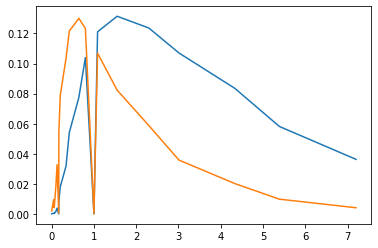

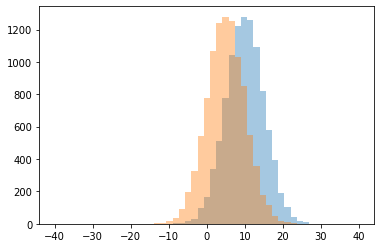

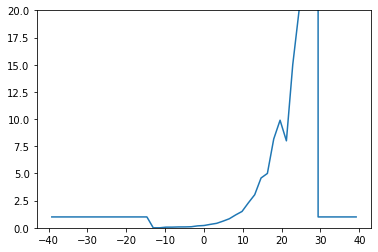

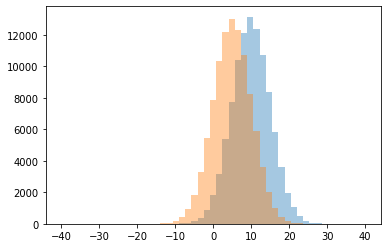

0 0.0
1 0.058823529411764705
2 0.06060606060606061
3 0.07865168539325842
4 0.08040201005025126
5 0.0972644376899696
6 0.17712177121771217
7 0.2103225806451613
8 0.3154929577464789
9 0.4114331723027375
10 0.6109803921568627
11 0.8326693227091634
12 1.0
13 1.186226964112512
14 1.5029377203290246
15 2.295620437956204
16 3.0417827298050137
17 4.581005586592179
18 5.0
19 8.0
20 8.166666666666666
21 9.894736842105264
22 15.0
23 20.0
24 999999.0




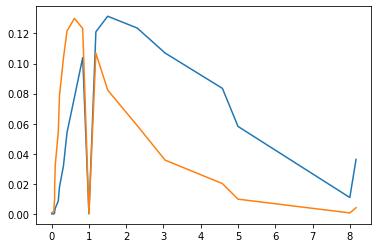

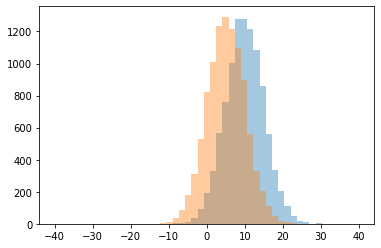

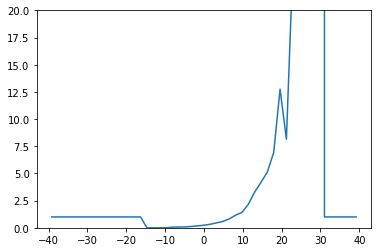

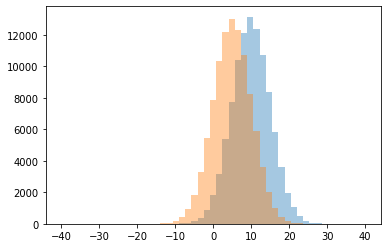

0 0.0
1 0.058823529411764705
2 0.07058823529411765
3 0.07909604519774012
4 0.12297734627831715
5 0.17836812144212524
6 0.23780487804878048
7 0.3273809523809524
8 0.4574898785425101
9 0.586687306501548
10 0.8243021346469622
11 1.0
12 1.16636197440585
13 1.4204671857619577
14 2.1660714285714286
15 3.288753799392097
16 4.190243902439025
17 5.137614678899083
18 6.9375
19 8.142857142857142
20 12.75
21 24.0
22 999999.0




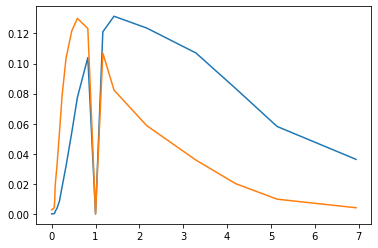

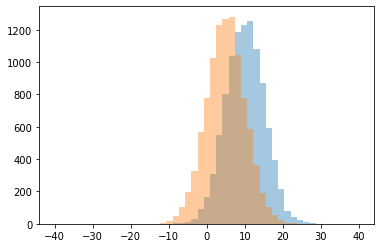

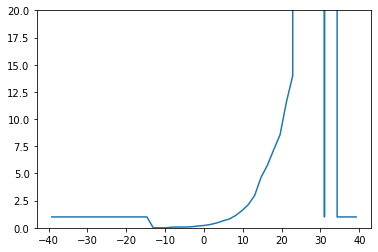

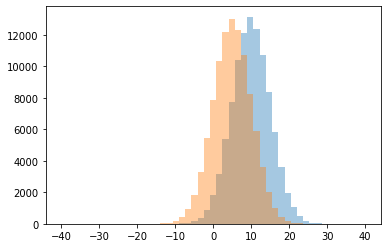

0 0.0
1 0.0625
2 0.0673076923076923
3 0.07142857142857142
4 0.09422492401215805
5 0.15817223198594024
6 0.2120822622107969
7 0.3028237585199611
8 0.4474327628361858
9 0.6376582278481012
10 0.8079625292740047
11 1.0
12 1.1318051575931232
13 1.5842985842985844
14 2.1377551020408165
15 2.9834710743801653
16 4.638297872340425
17 5.747572815533981
18 7.181818181818182
19 8.56
20 11.571428571428571
21 14.0
22 999999.0




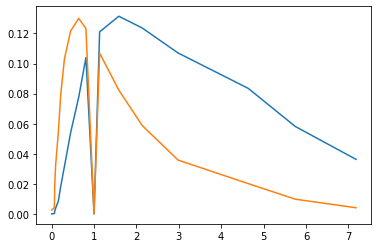

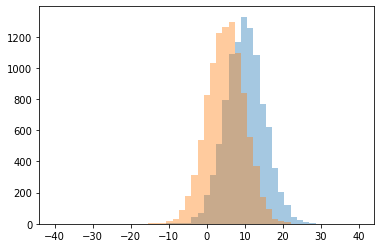

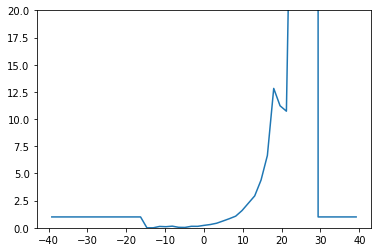

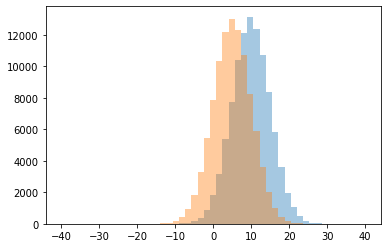

0 0.0
1 0.03389830508474576
2 0.0449438202247191
3 0.1
4 0.125
5 0.1340782122905028
6 0.13738019169329074
7 0.15151515151515152
8 0.22330097087378642
9 0.30077369439071566
10 0.42096642096642095
11 0.6262866191607285
12 0.8379629629629629
13 1.0
14 1.069533394327539
15 1.5847255369928401
16 2.2612612612612613
17 2.934959349593496
18 4.388571428571429
19 6.655913978494624
20 10.727272727272727
21 11.222222222222221
22 12.821428571428571
23 44.0
24 999999.0




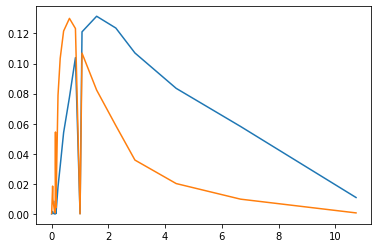

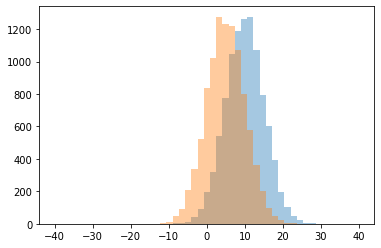

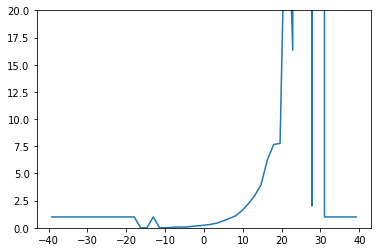

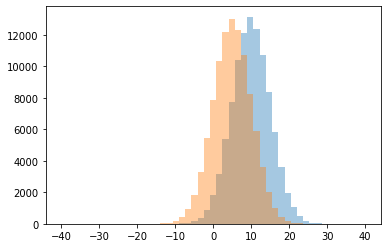

0 0.0
1 0.044444444444444446
2 0.06310679611650485
3 0.07446808510638298
4 0.12462908011869436
5 0.17748091603053434
6 0.23381294964028776
7 0.31085043988269795
8 0.4263322884012539
9 0.6298701298701299
10 0.8566748566748567
11 1.0
12 1.1100746268656716
13 1.5782227784730913
14 2.0
15 2.217391304347826
16 2.958563535911602
17 3.97
18 6.260416666666667
19 7.666666666666667
20 7.76
21 16.333333333333332
22 35.333333333333336
23 999999.0




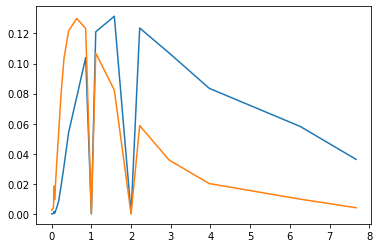

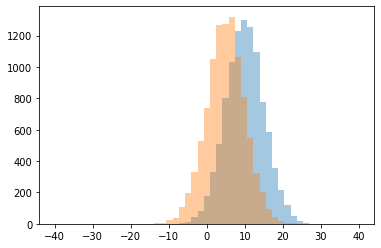

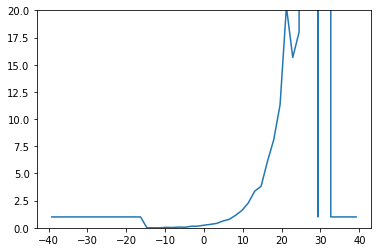

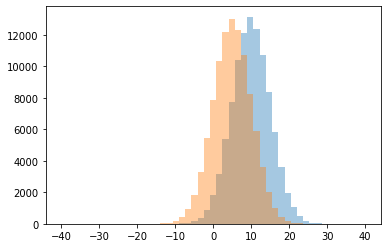

0 0.0
1 0.02631578947368421
2 0.043478260869565216
3 0.050761421319796954
4 0.06666666666666667
5 0.13761467889908258
6 0.1509433962264151
7 0.23848238482384823
8 0.3162393162393162
9 0.4031620553359684
10 0.627742946708464
11 0.7818181818181819
12 1.0
13 1.1568075117370893
14 1.6044499381953028
15 2.293040293040293
16 3.375384615384615
17 3.8088235294117645
18 6.083333333333333
19 8.090909090909092
20 11.31578947368421
21 15.666666666666666
22 18.0
23 20.333333333333332
24 999999.0




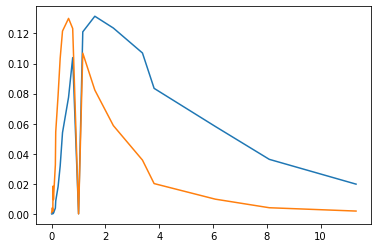

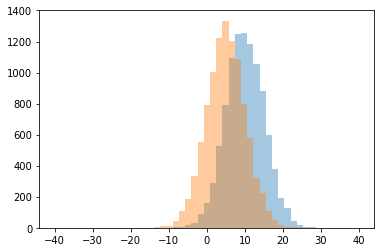

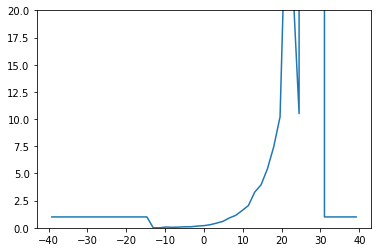

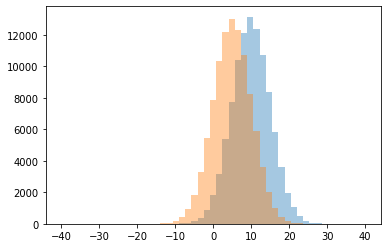

0 0.0
1 0.043478260869565216
2 0.06542056074766354
3 0.07142857142857142
4 0.09090909090909091
5 0.09850746268656717
6 0.16
7 0.19873417721518988
8 0.2857142857142857
9 0.43300653594771243
10 0.5952023988005997
11 0.9068994181213632
12 1.0
13 1.1441689623507805
14 1.5784190715181932
15 2.043103448275862
16 3.2803738317757007
17 3.9506726457399104
18 5.409090909090909
19 7.450980392156863
20 10.210526315789474
21 10.5
22 22.5
23 31.5
24 999999.0




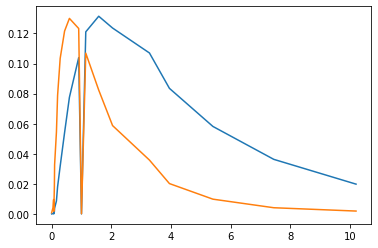

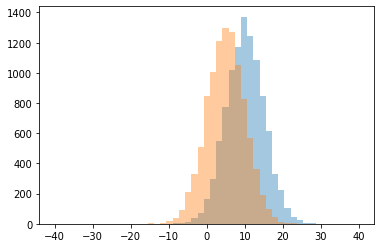

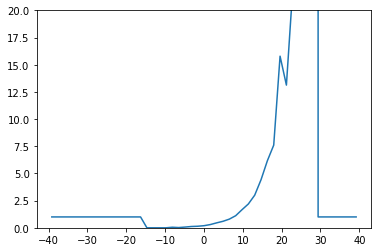

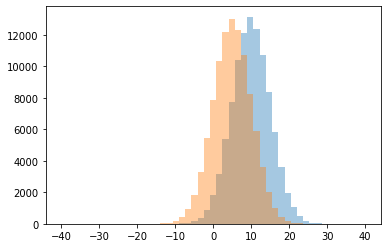

0 0.0
1 0.02247191011235955
2 0.05128205128205128
3 0.0660377358490566
4 0.11890243902439024
5 0.142578125
6 0.19289940828402366
7 0.29780876494023906
8 0.45454545454545453
9 0.5983037779491134
10 0.7982731554160125
11 1.0
12 1.1119544592030361
13 1.6650485436893203
14 2.1922398589065257
15 3.0
16 4.424083769633508
17 6.17
18 7.604651162790698
19 13.125
20 15.785714285714286
21 22.0
22 27.0
23 999999.0




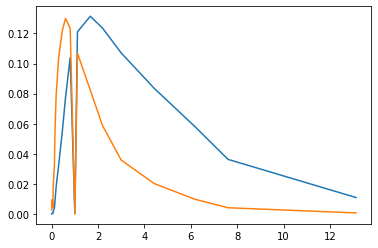

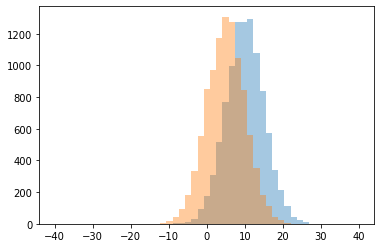

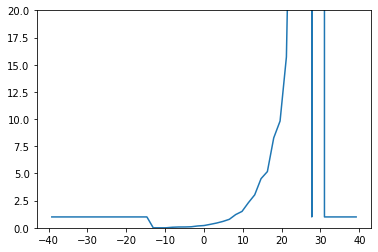

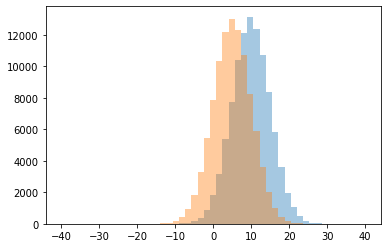

0 0.0
1 0.05
2 0.07368421052631578
3 0.07567567567567568
4 0.09523809523809523
5 0.16817359855334538
6 0.20750293083235638
7 0.3182751540041068
8 0.43829787234042555
9 0.5879204892966361
10 0.7811764705882352
11 1.0
12 1.21585482330468
13 1.5076741440377803
14 2.306049822064057
15 3.0309859154929577
16 4.518918918918919
17 5.171171171171171
18 8.268292682926829
19 9.818181818181818
20 15.714285714285714
21 27.0
22 46.0
23 999999.0




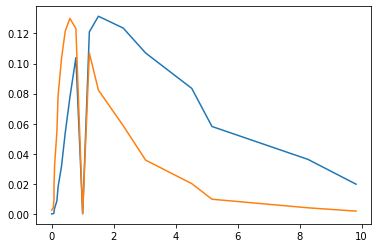

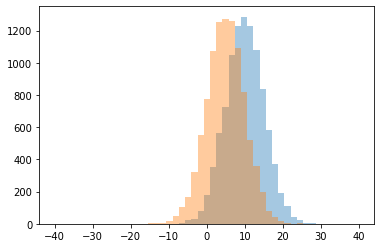

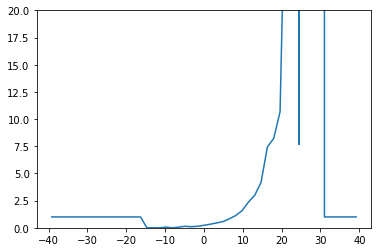

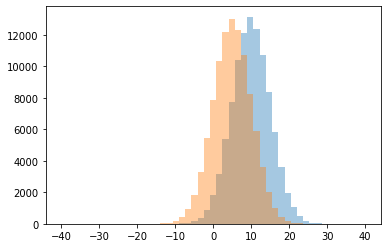

0 0.0
1 0.057692307692307696
2 0.0625
3 0.09876543209876543
4 0.13924050632911392
5 0.1402439024390244
6 0.2300771208226221
7 0.33115671641791045
8 0.44772545889864324
9 0.5723270440251572
10 0.8295003965107058
11 1.0
12 1.1264894592117323
13 1.5702075702075702
14 2.3524904214559386
15 2.9889502762430937
16 4.175
17 7.435897435897436
18 7.666666666666667
19 8.222222222222221
20 10.666666666666666
21 37.0
22 999999.0




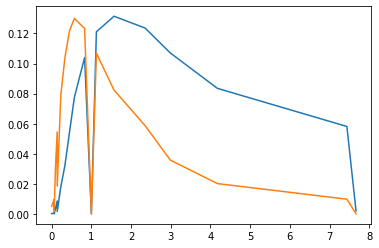

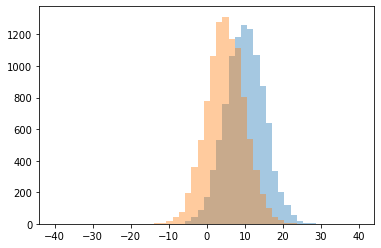

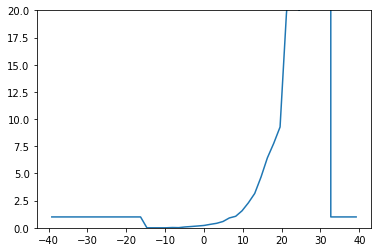

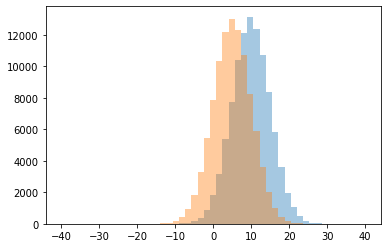

0 0.0
1 0.013333333333333334
2 0.025
3 0.07731958762886598
4 0.11878453038674033
5 0.1651031894934334
6 0.21510883482714468
7 0.3183098591549296
8 0.41360437842064113
9 0.5792682926829268
10 0.905982905982906
11 1.0
12 1.0582437275985663
13 1.5607940446650124
14 2.295539033457249
15 3.1563421828908553
16 4.67379679144385
17 6.434343434343434
18 7.767441860465116
19 9.272727272727273
20 19.666666666666668
21 20.0
22 26.5
23 999999.0




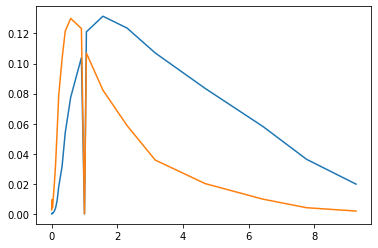

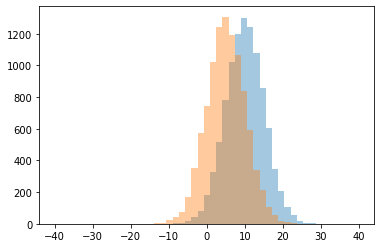

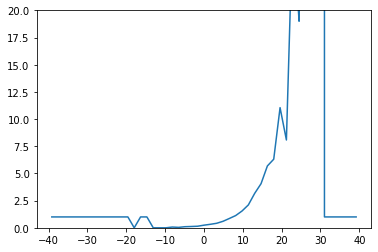

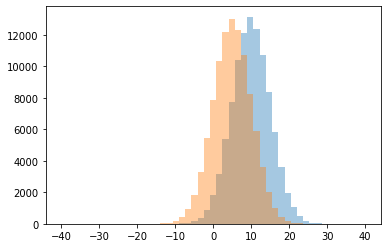

0 0.0
1 0.039473684210526314
2 0.06818181818181818
3 0.10059171597633136
4 0.11965811965811966
5 0.14485165794066318
6 0.24128686327077747
7 0.3212890625
8 0.41498791297340853
9 0.5975516449885233
10 0.856663872590109
11 1.0
12 1.1258215962441314
13 1.5446960667461263
14 2.1052631578947367
15 3.1700879765395893
16 4.056603773584905
17 5.688679245283019
18 6.3090909090909095
19 8.076923076923077
20 11.052631578947368
21 19.0
22 28.0
23 999999.0




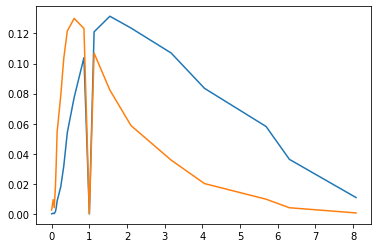

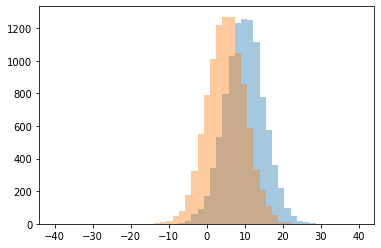

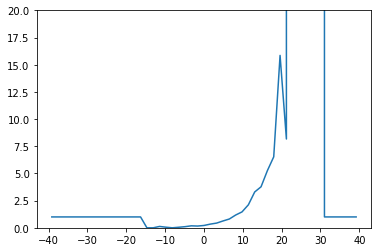

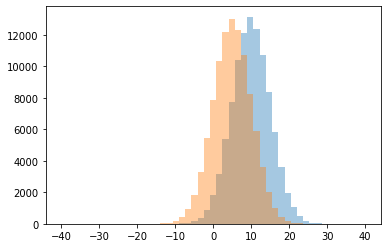

0 0.0
1 0.04938271604938271
2 0.05555555555555555
3 0.10227272727272728
4 0.125
5 0.1609403254972875
6 0.18153846153846154
7 0.21419518377693283
8 0.33893280632411066
9 0.4337152209492635
10 0.6290449881610103
11 0.8086614173228347
12 1.0
13 1.1757402101241643
14 1.4627906976744185
15 2.113559322033898
16 3.2958579881656807
17 3.7718446601941746
18 5.256880733944954
19 6.527272727272727
20 8.166666666666666
21 15.857142857142858
22 999999.0




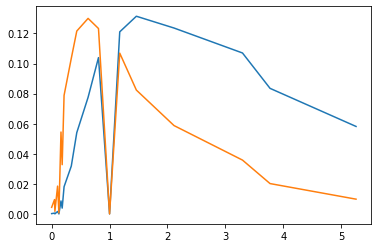

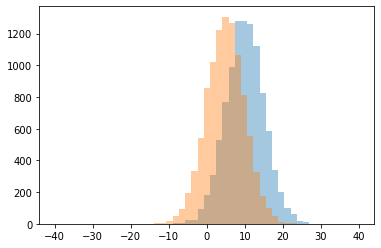

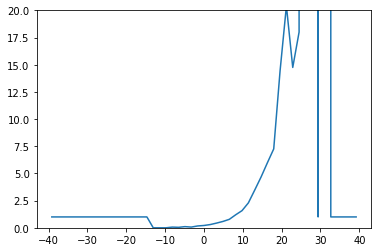

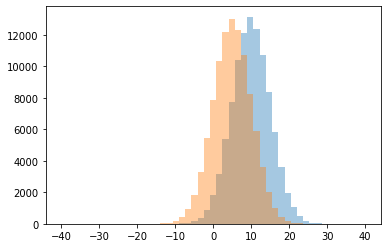

0 0.0
1 0.04395604395604396
2 0.06382978723404255
3 0.06626506024096386
4 0.1076923076923077
5 0.1691449814126394
6 0.21311475409836064
7 0.29931305201177627
8 0.4348894348894349
9 0.5857580398162328
10 0.7797947908445146
11 1.0
12 1.1969981238273921
13 1.5775862068965518
14 2.2903811252268604
15 3.4660493827160495
16 4.666666666666667
17 5.979591836734694
18 7.25531914893617
19 14.428571428571429
20 14.75
21 18.0
22 20.4
23 999999.0




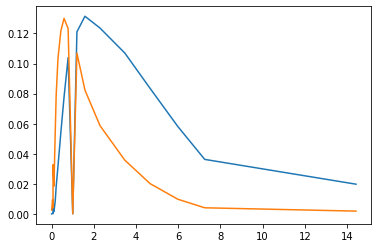

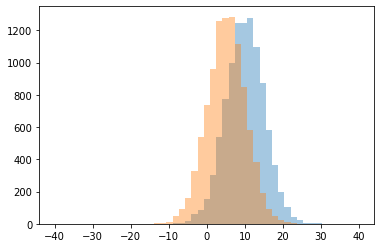

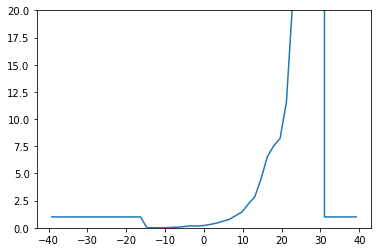

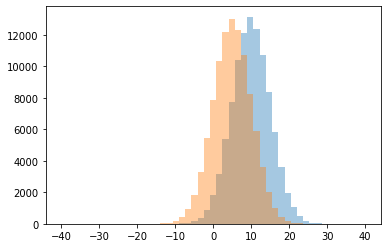

0 0.0
1 0.041666666666666664
2 0.06521739130434782
3 0.125
4 0.16201117318435754
5 0.18404907975460122
6 0.2105978260869565
7 0.31347962382445144
8 0.4273232724384432
9 0.6076742364917777
10 0.778816199376947
11 1.0
12 1.1136974037600715
13 1.464705882352941
14 2.1907216494845363
15 2.8415584415584414
16 4.494845360824742
17 6.53932584269663
18 7.541666666666667
19 8.208333333333334
20 11.555555555555555
21 21.0
22 25.0
23 999999.0




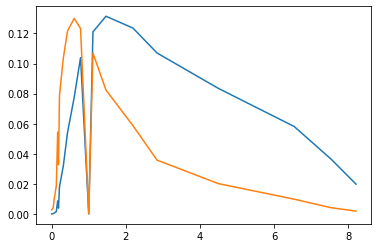

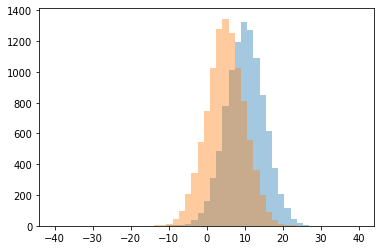

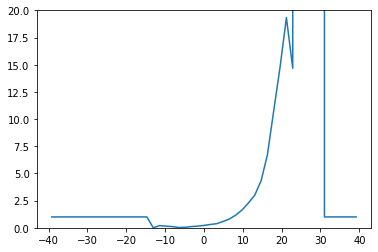

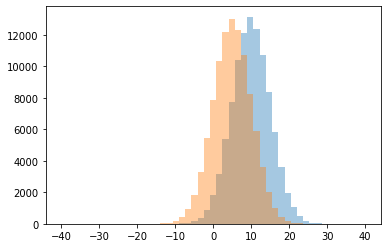

0 0.0
1 0.031914893617021274
2 0.04326923076923077
3 0.1111111111111111
4 0.11304347826086956
5 0.15257352941176472
6 0.15384615384615385
7 0.2
8 0.21983914209115282
9 0.30430528375733856
10 0.3788235294117647
11 0.5784386617100372
12 0.8094475580464372
13 1.0
14 1.1624513618677044
15 1.6341161928306551
16 2.2777777777777777
17 2.991758241758242
18 4.314720812182741
19 6.695652173913044
20 10.771428571428572
21 14.666666666666666
22 14.785714285714286
23 19.333333333333332
24 999999.0




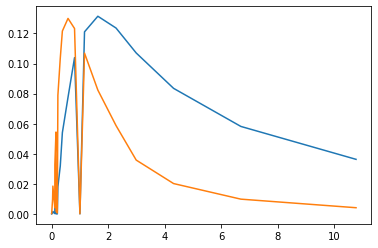

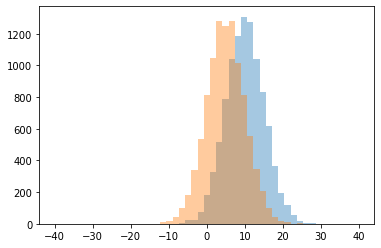

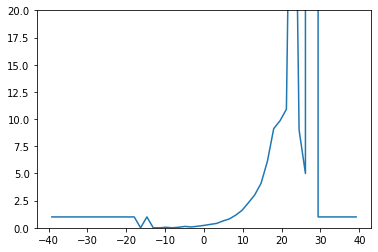

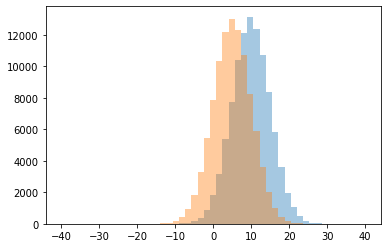

0 0.0
1 0.05
2 0.050505050505050504
3 0.07692307692307693
4 0.1270718232044199
5 0.14446529080675422
6 0.22058823529411764
7 0.3138755980861244
8 0.4028103044496487
9 0.630016051364366
10 0.8145539906103286
11 1.0
12 1.1640471512770139
13 1.603680981595092
14 2.299638989169675
15 3.0232558139534884
16 4.088235294117647
17 5.0
18 6.108910891089109
19 9.0
20 9.125
21 9.85
22 10.909090909090908
23 53.0
24 999999.0




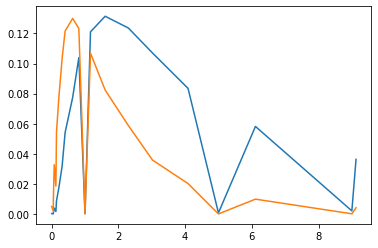

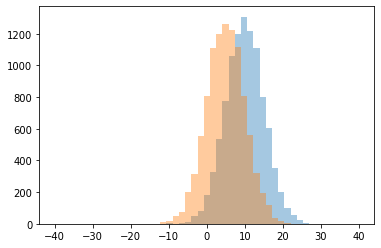

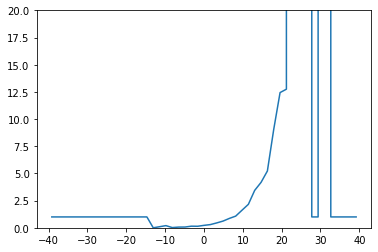

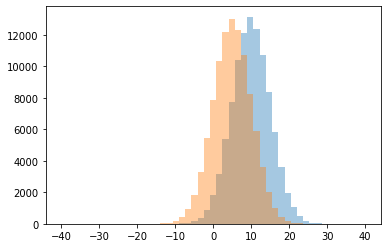

0 0.0
1 0.02127659574468085
2 0.06493506493506493
3 0.07
4 0.1
5 0.1407942238267148
6 0.14826498422712933
7 0.2
8 0.22428748451053285
9 0.2945945945945946
10 0.4470391993327773
11 0.6163621922160445
12 0.8629690048939641
13 1.0
14 1.073542600896861
15 1.6195786864931847
16 2.158081705150977
17 3.4440993788819876
18 4.177083333333333
19 5.224137931034483
20 9.051282051282051
21 12.4375
22 12.75
23 999999.0




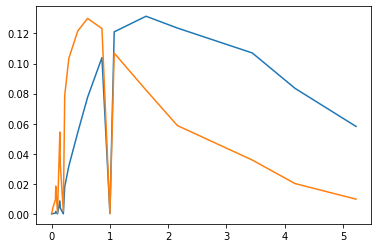

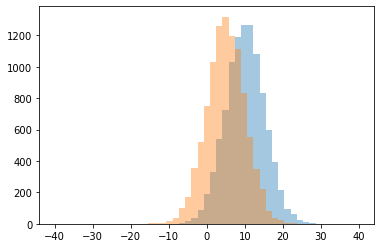

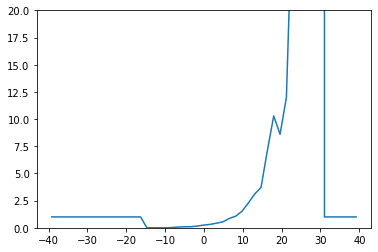

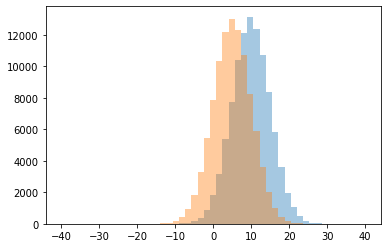

0 0.0
1 0.027777777777777776
2 0.07142857142857142
3 0.09467455621301775
4 0.1016949152542373
5 0.16698656429942418
6 0.250996015936255
7 0.3178294573643411
8 0.42709984152139463
9 0.5504169825625473
10 0.8614357262103506
11 1.0
12 1.0691202872531418
13 1.5216346153846154
14 2.2815884476534296
15 3.1091954022988504
16 3.7142857142857144
17 7.119047619047619
18 8.6
19 10.289473684210526
20 12.0
21 31.0
22 999999.0




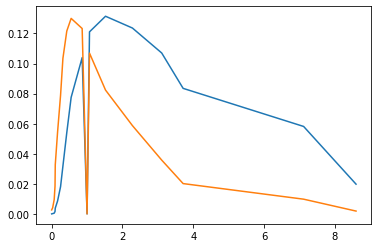

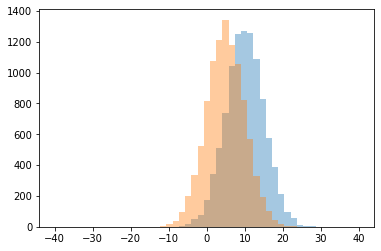

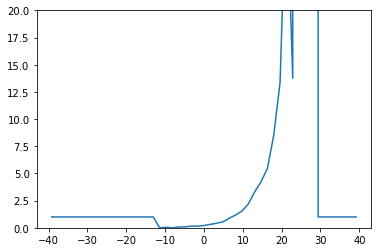

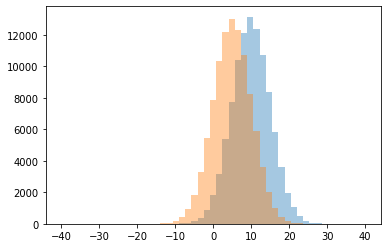

0 0.0
1 0.05
2 0.07216494845360824
3 0.08585858585858586
4 0.1491395793499044
5 0.15384615384615385
6 0.2114914425427873
7 0.3165735567970205
8 0.41962077493816985
9 0.5502606105733433
10 0.883248730964467
11 1.0
12 1.183538315988647
13 1.5406060606060605
14 2.2
15 3.3140243902439024
16 4.235897435897436
17 5.457142857142857
18 8.5
19 13.375
20 13.75
21 32.0
22 999999.0




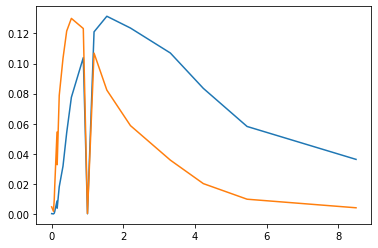

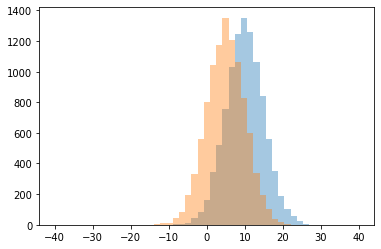

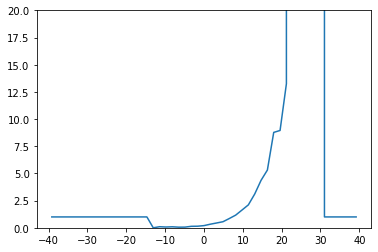

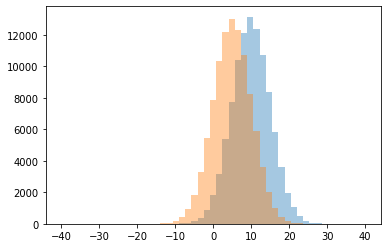

0 0.0
1 0.05813953488372093
2 0.0625
3 0.07142857142857142
4 0.09302325581395349
5 0.1
6 0.13636363636363635
7 0.14669051878354203
8 0.20050125313283207
9 0.3310940499040307
10 0.44340425531914895
11 0.5588452997779423
12 0.8546511627906976
13 1.0
14 1.1661971830985915
15 1.6347087378640777
16 2.109060402684564
17 3.1055718475073313
18 4.364583333333333
19 5.311320754716981
20 8.775
21 8.952380952380953
22 13.25
23 999999.0




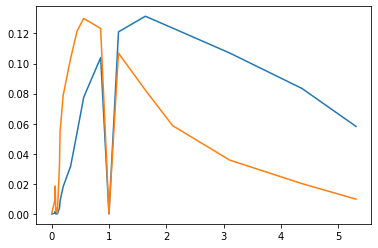

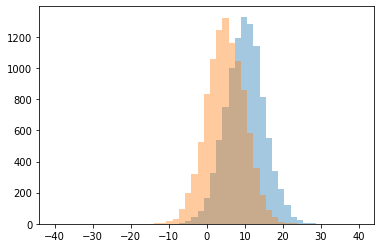

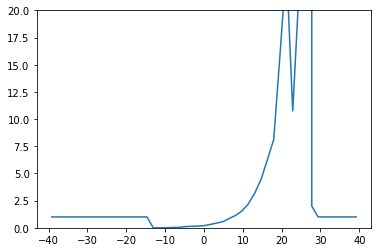

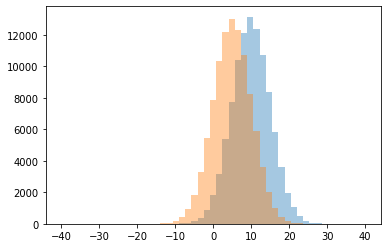

0 0.0
1 0.03125
2 0.031914893617021274
3 0.1044776119402985
4 0.13707165109034267
5 0.15180265654648956
6 0.19687875150060025
7 0.31031220435193946
8 0.43121480289621883
9 0.5685087055261165
10 0.8614457831325302
11 1.0
12 1.140401146131805
13 1.5519253208868145
14 2.0
15 2.202401372212693
16 3.1871508379888267
17 4.442622950819672
18 6.261363636363637
19 8.119047619047619
20 10.75
21 16.0
22 22.0
23 24.2
24 999999.0




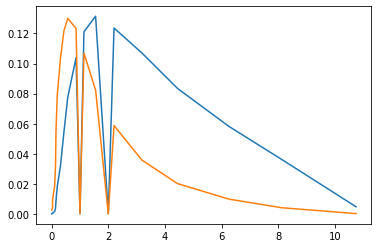

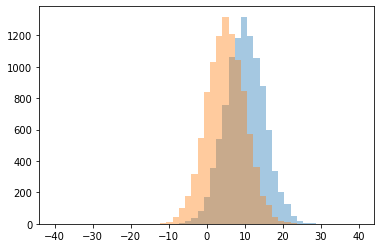

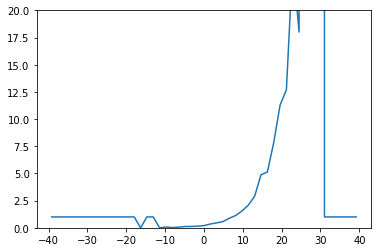

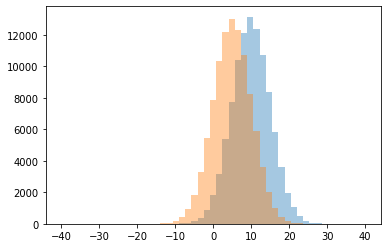

0 0.0
1 0.021739130434782608
2 0.058823529411764705
3 0.07142857142857142
4 0.12
5 0.12264150943396226
6 0.1478102189781022
7 0.2007168458781362
8 0.34791059280855197
9 0.4524207011686144
10 0.5735963581183612
11 0.8785123966942149
12 1.0
13 1.1302681992337165
14 1.5495283018867925
15 2.087260034904014
16 2.9224376731301938
17 4.877777777777778
18 5.128205128205129
19 7.837209302325581
20 11.277777777777779
21 12.7
22 18.0
23 24.5
24 999999.0




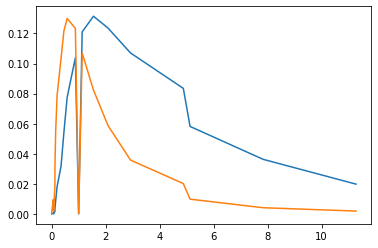

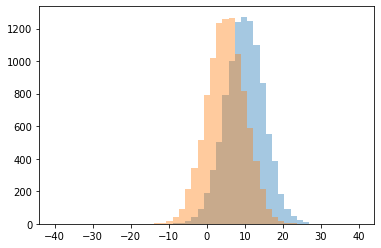

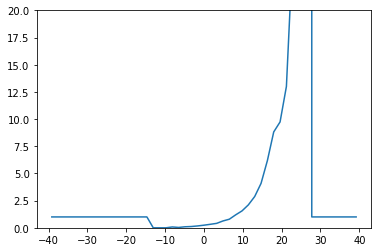

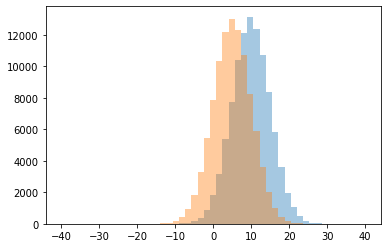

0 0.0
1 0.03296703296703297
2 0.07692307692307693
3 0.09389671361502347
4 0.11730205278592376
5 0.17153996101364521
6 0.24055415617128464
7 0.3215686274509804
8 0.4082792207792208
9 0.630071599045346
10 0.7910094637223974
11 1.0
12 1.1921229586935638
13 1.5543345543345544
14 2.1099830795262267
15 2.877284595300261
16 4.084905660377358
17 6.179775280898877
18 8.818181818181818
19 9.736842105263158
20 13.0
21 25.5
22 999999.0




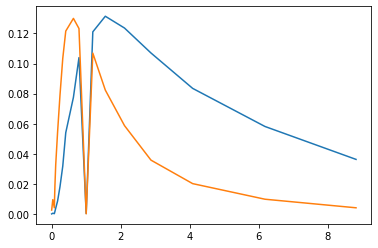

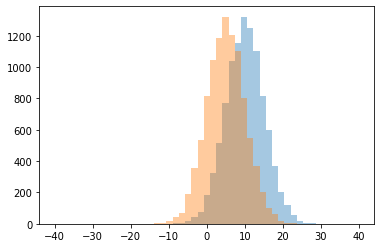

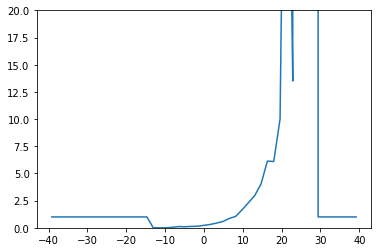

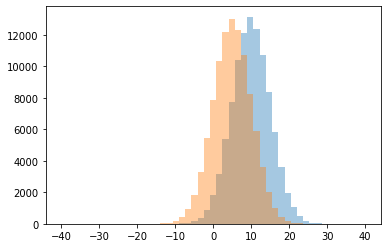

0 0.0
1 0.046511627906976744
2 0.09574468085106383
3 0.11267605633802817
4 0.1271186440677966
5 0.14392523364485982
6 0.22616136919315402
7 0.31064237775647174
8 0.4345991561181435
9 0.5821347464042392
10 0.8612956810631229
11 1.0
12 1.0489573889392565
13 1.6483790523690773
14 2.2990825688073393
15 2.9596774193548385
16 4.034653465346534
17 6.098360655737705
18 6.13265306122449
19 10.0
20 13.5
21 59.0
22 999999.0




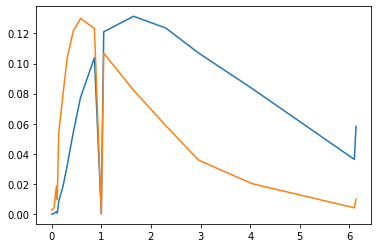

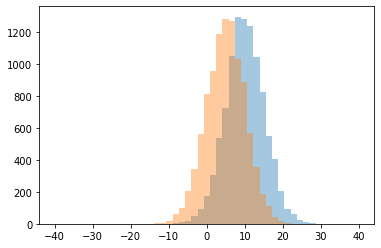

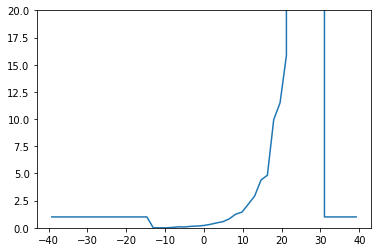

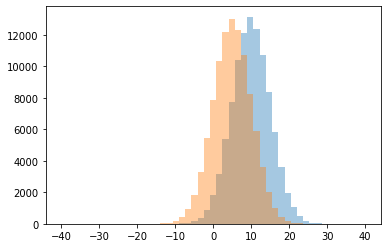

0 0.0
1 0.03389830508474576
2 0.07804878048780488
3 0.09
4 0.13823529411764707
5 0.1625
6 0.21481481481481482
7 0.3172774869109948
8 0.4502529510961214
9 0.5663026521060842
10 0.8264984227129337
11 1.0
12 1.253384912959381
13 1.4435665914221218
14 2.1795774647887325
15 2.9327731092436973
16 4.398936170212766
17 4.833333333333333
18 9.951219512195122
19 11.5
20 15.833333333333334
21 24.0
22 999999.0




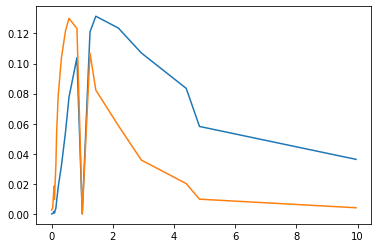

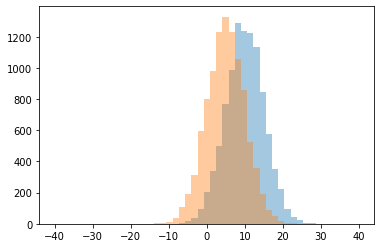

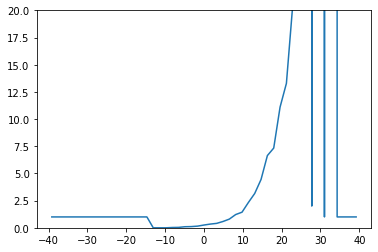

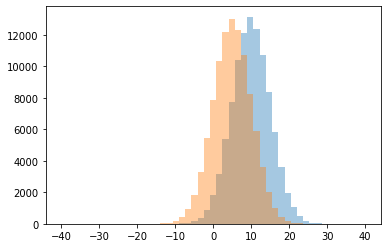

0 0.0
1 0.027777777777777776
2 0.0380952380952381
3 0.09844559585492228
4 0.1111111111111111
5 0.15436241610738255
6 0.2543859649122807
7 0.3421588594704684
8 0.40698619008935827
9 0.5801354401805869
10 0.8006509357200976
11 1.0
12 1.218543046357616
13 1.4355400696864111
14 2.0
15 2.3244781783681217
16 3.1555555555555554
17 4.445026178010472
18 6.64367816091954
19 7.333333333333333
20 11.1
21 13.285714285714286
22 20.5
23 999999.0




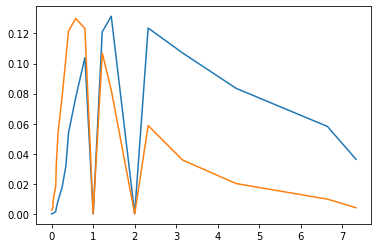

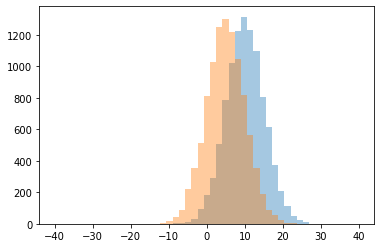

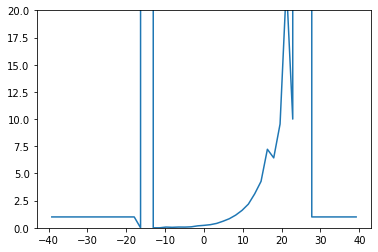

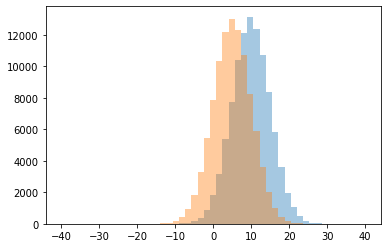

0 0.0
1 0.044444444444444446
2 0.06422018348623854
3 0.06666666666666667
4 0.06896551724137931
5 0.0896358543417367
6 0.1784313725490196
7 0.22509225092250923
8 0.28654970760233917
9 0.4044764188649081
10 0.6033820138355112
11 0.8359310910582445
12 1.0
13 1.1669847328244274
14 1.6017052375152254
15 2.176678445229682
16 3.125
17 4.2712765957446805
18 6.431034482758621
19 7.223529411764706
20 9.545454545454545
21 10.0
22 22.4
23 999999.0




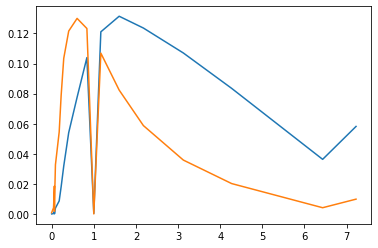

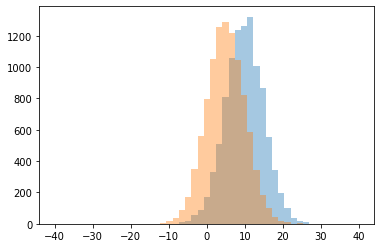

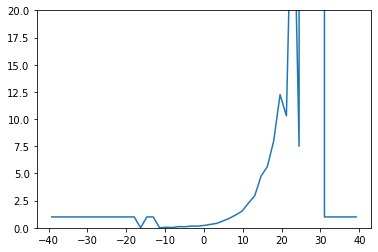

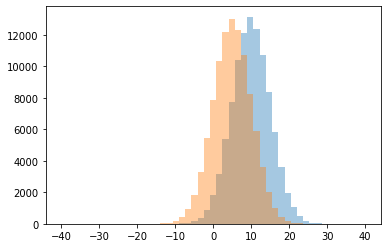

0 0.0
1 0.02631578947368421
2 0.047619047619047616
3 0.09941520467836257
4 0.10989010989010989
5 0.15097690941385436
6 0.16
7 0.21553884711779447
8 0.311787072243346
9 0.40540540540540543
10 0.6314152410575428
11 0.8693508627773213
12 1.0
13 1.1826003824091778
14 1.5279126213592233
15 2.2658662092624358
16 2.9415204678362574
17 4.743169398907104
18 5.642857142857143
19 7.5
20 8.0
21 10.3
22 12.25
23 36.0
24 999999.0




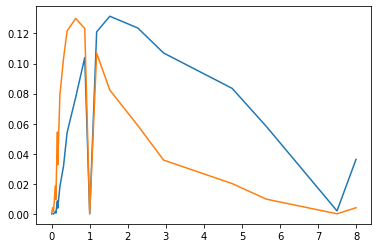

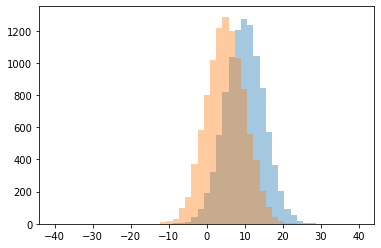

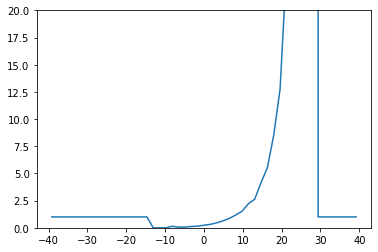

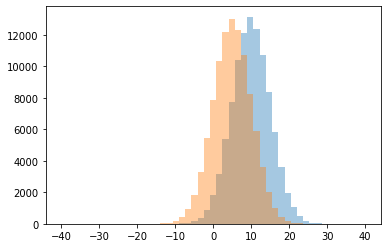

0 0.0
1 0.06
2 0.0658682634730539
3 0.11796246648793565
4 0.13793103448275862
5 0.15213675213675212
6 0.23720349563046192
7 0.3169774288518155
8 0.4540229885057471
9 0.6381987577639752
10 0.8657214345287739
11 1.0
12 1.1729834791059282
13 1.5232974910394266
14 2.2075134168157424
15 2.6354430379746834
16 4.151960784313726
17 5.533980582524272
18 8.511627906976743
19 12.75
20 23.75
21 26.5
22 999999.0




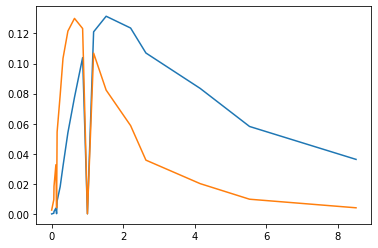

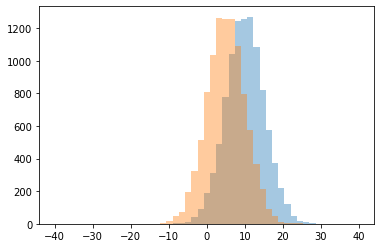

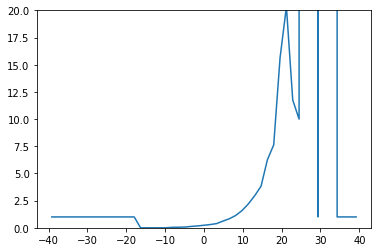

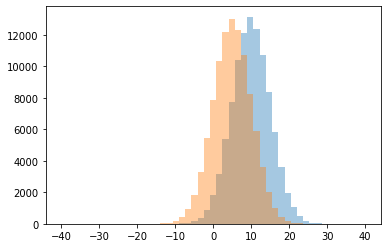

0 0.0
1 0.044444444444444446
2 0.05333333333333334
3 0.06735751295336788
4 0.12732919254658384
5 0.17120622568093385
6 0.23514851485148514
7 0.29912875121006777
8 0.3885804916732752
9 0.6194267515923567
10 0.8309409888357256
11 1.0
12 1.1352833638025595
13 1.5818639798488665
14 2.198961937716263
15 2.9510869565217392
16 3.8271028037383177
17 6.25
18 7.63265306122449
19 10.0
20 11.75
21 15.642857142857142
22 20.333333333333332
23 999999.0




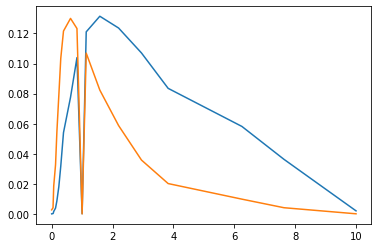

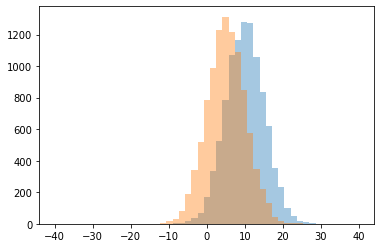

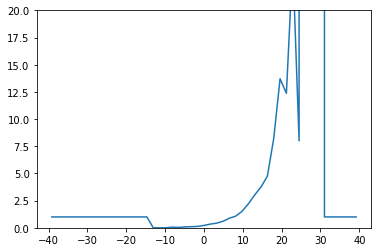

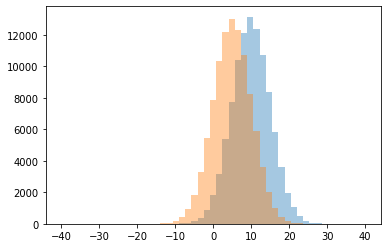

0 0.0
1 0.037037037037037035
2 0.0625
3 0.07894736842105263
4 0.10204081632653061
5 0.1276595744680851
6 0.21628498727735368
7 0.34074823053589487
8 0.4286878565607172
9 0.5993907083015994
10 0.8814814814814815
11 1.0
12 1.0698529411764706
13 1.5094562647754137
14 2.2024221453287196
15 3.025714285714286
16 3.7567567567567566
17 4.746153846153846
18 8.0
19 8.209302325581396
20 12.375
21 13.705882352941176
22 24.5
23 999999.0




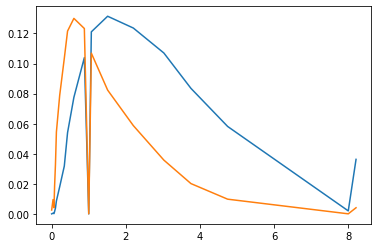

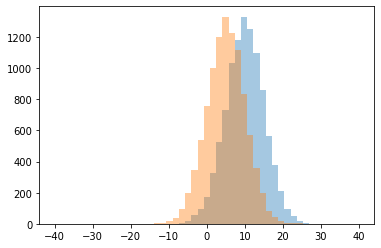

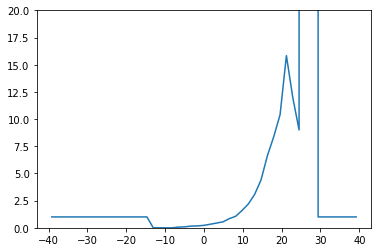

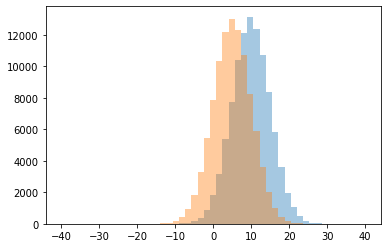

0 0.0
1 0.06451612903225806
2 0.09
3 0.15895953757225434
4 0.17164179104477612
5 0.22631578947368422
6 0.3283283283283283
7 0.4372402327514547
8 0.5492111194590533
9 0.8429617575264443
10 1.0
11 1.0580875781948167
12 1.5904191616766468
13 2.189141856392294
14 3.0842696629213484
15 4.4051282051282055
16 6.623529411764705
17 8.377777777777778
18 9.0
19 10.4
20 12.0
21 15.833333333333334
22 999999.0




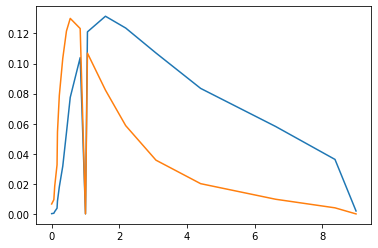

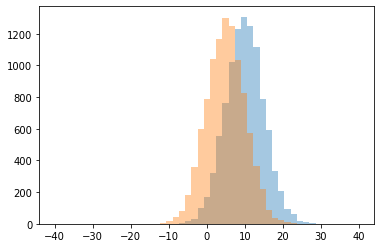

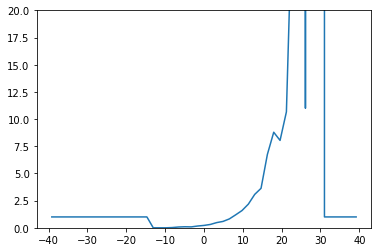

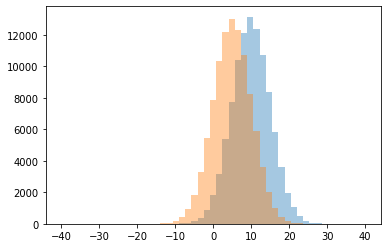

0 0.0
1 0.022727272727272728
2 0.07317073170731707
3 0.08426966292134831
4 0.09497206703910614
5 0.1636060100166945
6 0.21855146124523506
7 0.3074712643678161
8 0.4777015437392796
9 0.5862865947611711
10 0.8166533226581265
11 1.0
12 1.193798449612403
13 1.587378640776699
14 2.1780104712041886
15 3.071625344352617
16 3.6313364055299537
17 6.75
18 8.038461538461538
19 8.789473684210526
20 10.666666666666666
21 11.0
22 31.0
23 999999.0




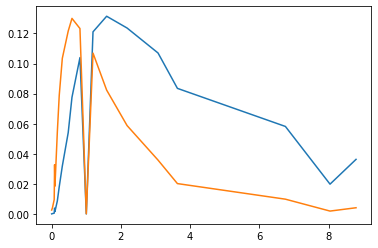

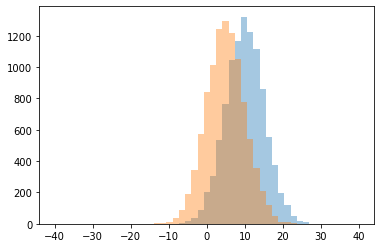

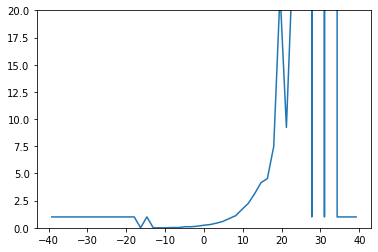

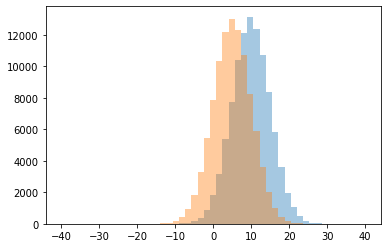

0 0.0
1 0.022727272727272728
2 0.025
3 0.09941520467836257
4 0.10052910052910052
5 0.14834205933682373
6 0.23781212841854935
7 0.30039525691699603
8 0.432475884244373
9 0.5915057915057915
10 0.8556193601312552
11 1.0
12 1.1132254995242625
13 1.6948717948717948
14 2.254612546125461
15 3.1464788732394364
16 4.159420289855072
17 4.524590163934426
18 7.48
19 9.23076923076923
20 21.666666666666668
21 24.5
22 999999.0




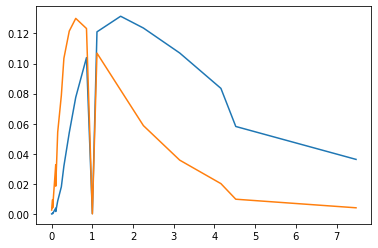

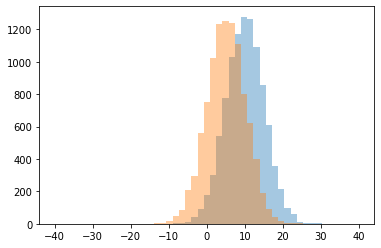

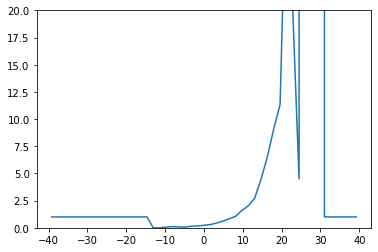

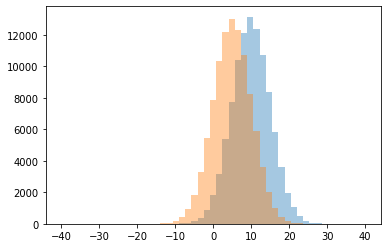

0 0.0
1 0.05825242718446602
2 0.058823529411764705
3 0.09090909090909091
4 0.10869565217391304
5 0.14625850340136054
6 0.16341030195381884
7 0.23474801061007958
8 0.2957884427032321
9 0.4368932038834951
10 0.6196957566052842
11 0.832258064516129
12 1.0
13 1.0568592057761732
14 1.5975
15 2.02724358974359
16 2.7293233082706765
17 4.471204188481676
18 4.5
19 6.526881720430108
20 9.102564102564102
21 11.31578947368421
22 20.0
23 33.333333333333336
24 999999.0




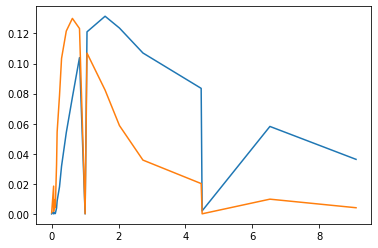

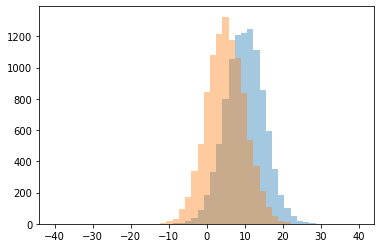

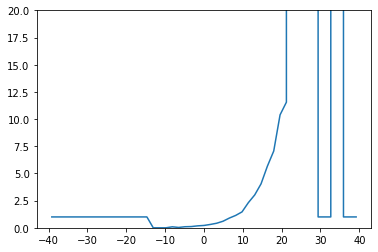

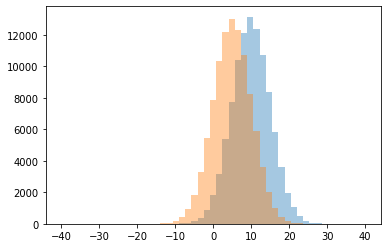

0 0.0
1 0.03260869565217391
2 0.09090909090909091
3 0.09770114942528736
4 0.11343283582089553
5 0.17913385826771652
6 0.2158956109134045
7 0.308263695450325
8 0.4189300411522634
9 0.6030188679245283
10 0.8948261238337574
11 1.0
12 1.1384180790960452
13 1.4629186602870814
14 2.3141263940520447
15 3.021680216802168
16 4.042654028436019
17 5.666666666666667
18 7.06
19 10.38888888888889
20 11.555555555555555
21 999999.0




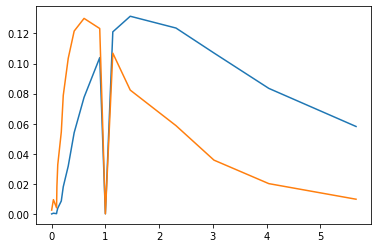

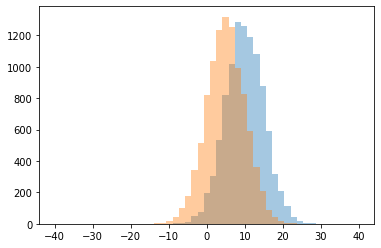

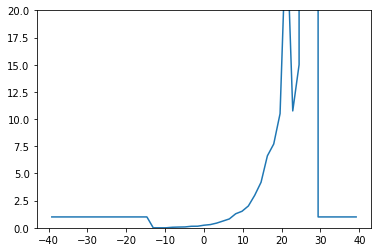

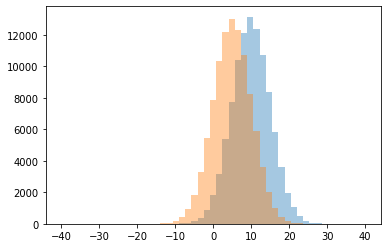

0 0.0
1 0.04878048780487805
2 0.06796116504854369
3 0.07865168539325842
4 0.13994169096209913
5 0.14563106796116504
6 0.23780487804878048
7 0.2956521739130435
8 0.43262987012987014
9 0.622154779969651
10 0.816
11 1.0
12 1.2907444668008048
13 1.5205811138014529
14 2.0067453625632377
15 2.988919667590028
16 4.186602870813397
17 6.617977528089888
18 7.7073170731707314
19 10.5
20 10.75
21 15.0
22 28.0
23 999999.0




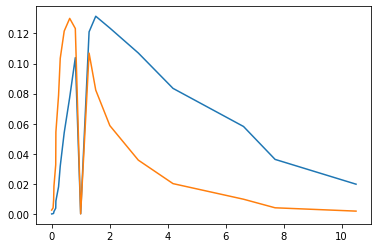

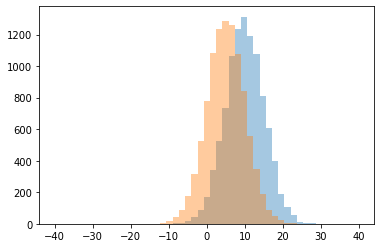

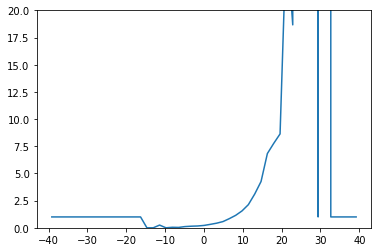

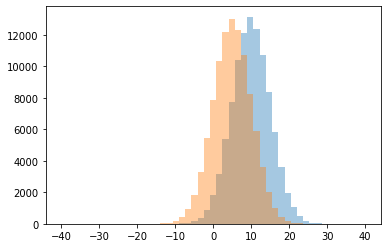

0 0.0
1 0.03488372093023256
2 0.047619047619047616
3 0.11173184357541899
4 0.1464968152866242
5 0.16698292220113853
6 0.2175032175032175
7 0.25
8 0.31637372802960223
9 0.42487883683360256
10 0.5723172628304821
11 0.8431061806656102
12 1.0
13 1.1465677179962894
14 1.5538461538461539
15 2.129032258064516
16 3.1040462427745665
17 4.257894736842105
18 6.831460674157303
19 7.764705882352941
20 8.636363636363637
21 18.666666666666668
22 27.0
23 999999.0




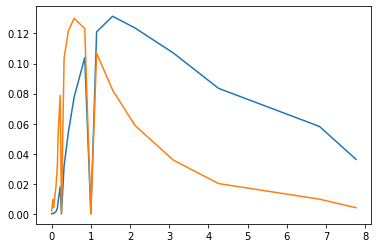

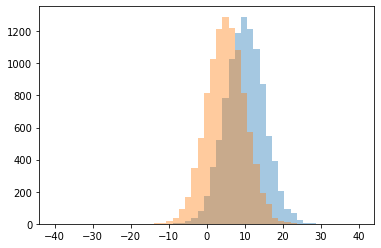

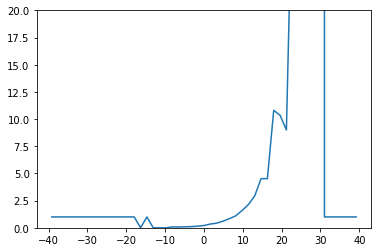

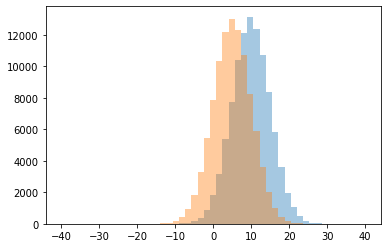

0 0.0
1 0.07446808510638298
2 0.08108108108108109
3 0.0963855421686747
4 0.10601719197707736
5 0.15037593984962405
6 0.21026894865525672
7 0.34371957156767285
8 0.4292763157894737
9 0.6077519379844961
10 0.8397383483237939
11 1.0
12 1.0960295475530932
13 1.5840490797546012
14 2.135087719298246
15 2.9249329758713136
16 4.518134715025907
17 4.520661157024794
18 9.0
19 10.35
20 10.805555555555555
21 34.0
22 999999.0




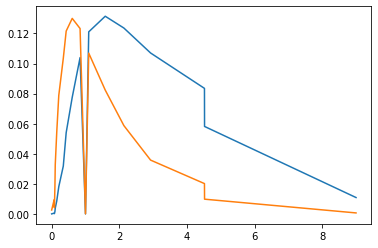

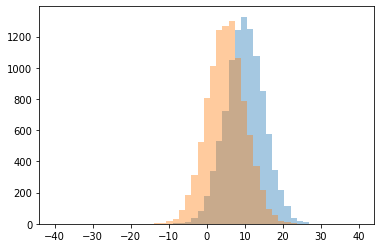

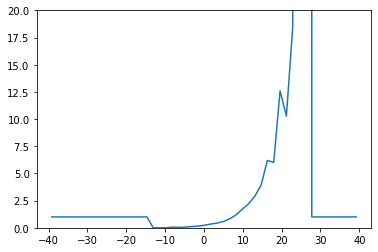

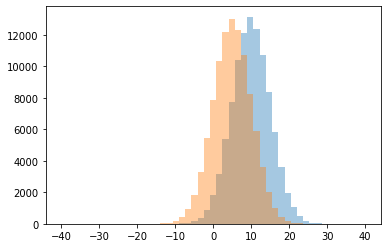

0 0.0
1 0.03296703296703297
2 0.06060606060606061
3 0.06486486486486487
4 0.1111111111111111
5 0.15399239543726237
6 0.22208436724565755
7 0.33663366336633666
8 0.4263877715205149
9 0.5689519306540584
10 0.804147465437788
11 1.0
12 1.1652582159624414
13 1.6861499364675985
14 2.183887915936953
15 2.8870967741935485
16 3.912442396313364
17 6.017543859649122
18 6.193548387096774
19 10.272727272727273
20 12.588235294117647
21 18.5
22 999999.0




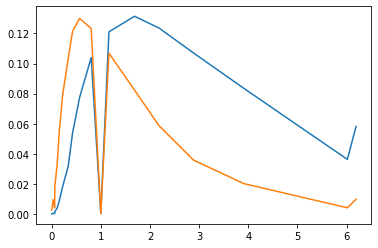

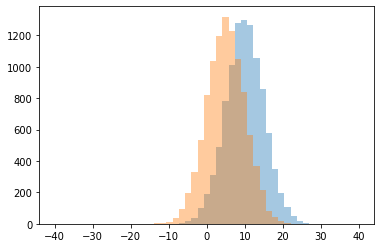

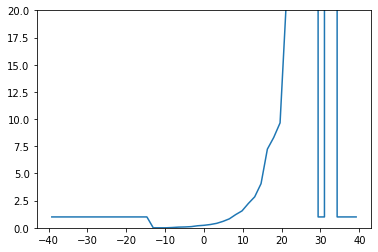

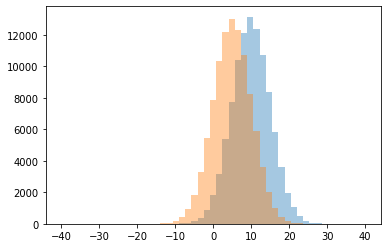

0 0.0
1 0.02564102564102564
2 0.0625
3 0.07692307692307693
4 0.10843373493975904
5 0.1865671641791045
6 0.22992700729927007
7 0.3012512030798845
8 0.4100418410041841
9 0.5910470409711684
10 0.8236734693877551
11 1.0
12 1.2138783269961977
13 1.555023923444976
14 2.2367491166077738
15 2.848648648648649
16 4.061320754716981
17 7.2375
18 8.30952380952381
19 9.65
20 21.0
21 49.0
22 999999.0




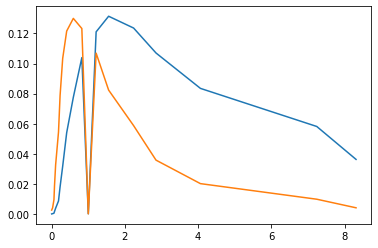

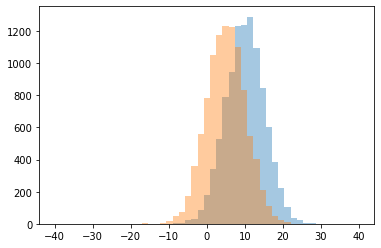

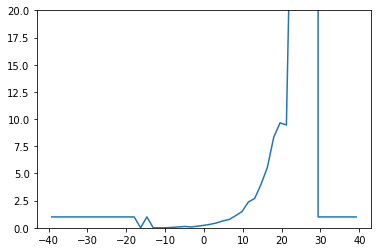

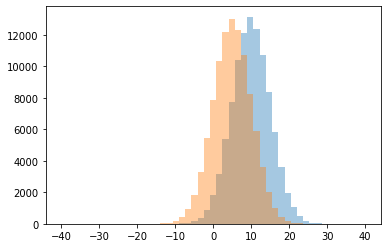

0 0.0
1 0.04
2 0.0782122905027933
3 0.07894736842105263
4 0.12209302325581395
5 0.15151515151515152
6 0.22802547770700637
7 0.3231939163498099
8 0.45191489361702125
9 0.637246963562753
10 0.7705451586655818
11 1.0
12 1.117059891107078
13 1.4903846153846154
14 2.3713235294117645
15 2.7037037037037037
16 4.0
17 5.555555555555555
18 8.326086956521738
19 9.454545454545455
20 9.652173913043478
21 39.0
22 999999.0




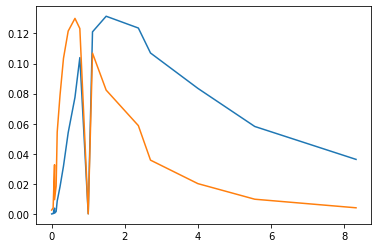

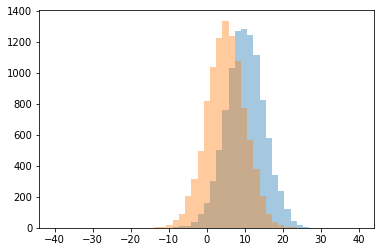

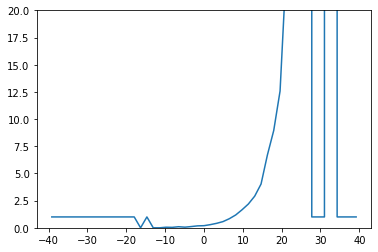

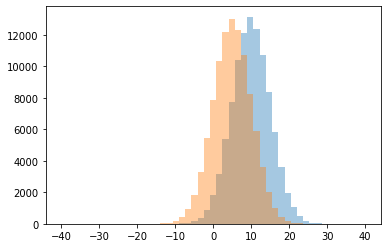

0 0.0
1 0.04081632653061224
2 0.05263157894736842
3 0.057692307692307696
4 0.0989010989010989
5 0.11428571428571428
6 0.178714859437751
7 0.1948529411764706
8 0.2906641000962464
9 0.4117647058823529
10 0.5696107784431138
11 0.8365695792880259
12 1.0
13 1.179201485608171
14 1.656774193548387
15 2.18804920913884
16 2.910994764397906
17 4.024390243902439
18 6.689655172413793
19 8.947368421052632
20 12.578947368421053
21 23.0
22 24.2
23 999999.0




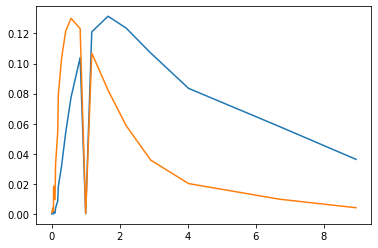

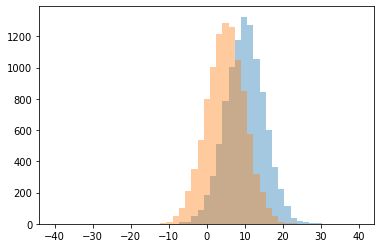

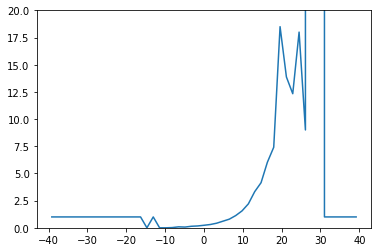

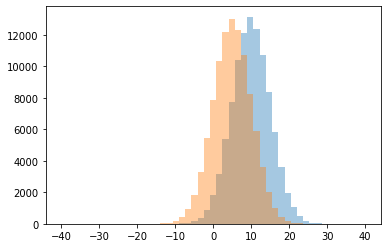

0 0.0
1 0.020833333333333332
2 0.0673076923076923
3 0.08823529411764706
4 0.1396011396011396
5 0.16977611940298507
6 0.23212045169385195
7 0.3026973026973027
8 0.4229183841714757
9 0.609642301710731
10 0.795869737887212
11 1.0
12 1.1228571428571428
13 1.5545134818288393
14 2.20103986135182
15 3.3238993710691824
16 4.147058823529412
17 6.03
18 7.408163265306122
19 9.0
20 12.333333333333334
21 13.875
22 18.0
23 18.5
24 999999.0




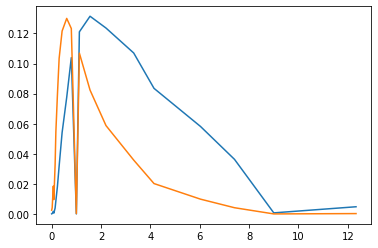

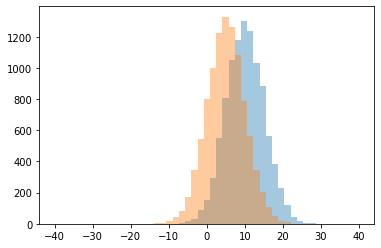

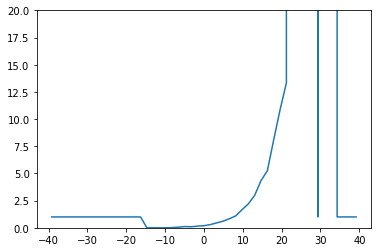

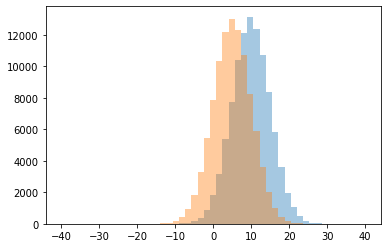

0 0.0
1 0.021739130434782608
2 0.060240963855421686
3 0.09510086455331412
4 0.11627906976744186
5 0.15722120658135283
6 0.19201995012468828
7 0.2957042957042957
8 0.4512694512694513
9 0.6054216867469879
10 0.8310864393338621
11 1.0
12 1.0914972273567467
13 1.6577608142493638
14 2.201067615658363
15 2.991279069767442
16 4.3431372549019605
17 5.252336448598131
18 8.106382978723405
19 10.857142857142858
20 13.333333333333334
21 21.0
22 999999.0




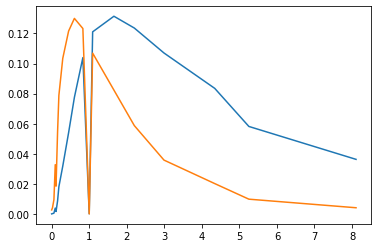

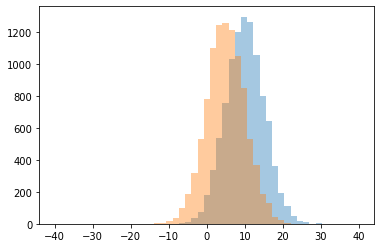

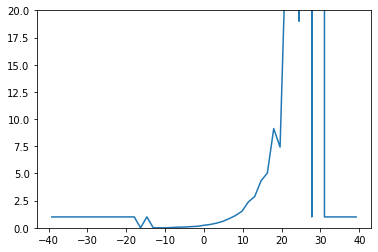

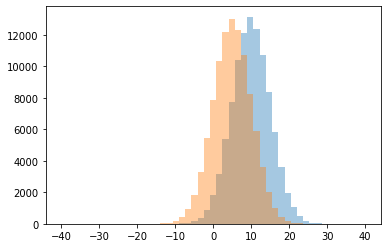

0 0.0
1 0.029411764705882353
2 0.0594059405940594
3 0.06989247311827956
4 0.109375
5 0.1383177570093458
6 0.2330345710627401
7 0.30881017257039056
8 0.43086816720257237
9 0.5990491283676703
10 0.8512736236647493
11 1.0
12 1.1383886255924172
13 1.5282352941176471
14 2.377110694183865
15 2.875338753387534
16 4.324324324324325
17 5.0390625
18 7.423076923076923
19 9.125
20 19.0
21 27.25
22 49.0
23 999999.0




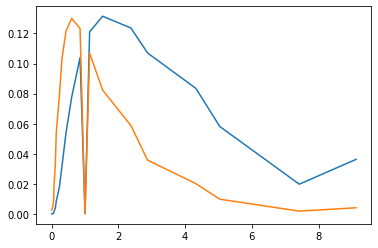

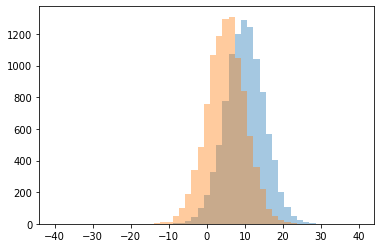

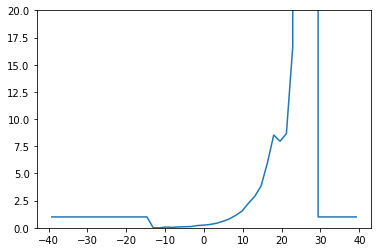

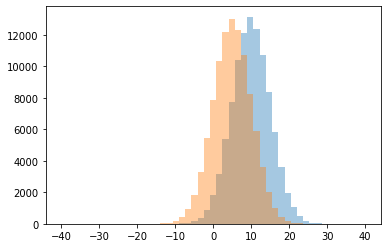

0 0.0
1 0.04081632653061224
2 0.07142857142857142
3 0.08080808080808081
4 0.10160427807486631
5 0.11730205278592376
6 0.21074380165289255
7 0.2447089947089947
8 0.30927835051546393
9 0.4206081081081081
10 0.5992277992277992
11 0.8189457601222307
12 1.0
13 1.140952380952381
14 1.536904761904762
15 2.246846846846847
16 2.888888888888889
17 3.8433179723502304
18 5.957894736842105
19 7.96
20 8.53191489361702
21 8.666666666666666
22 16.666666666666668
23 999999.0




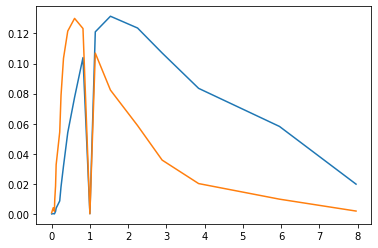

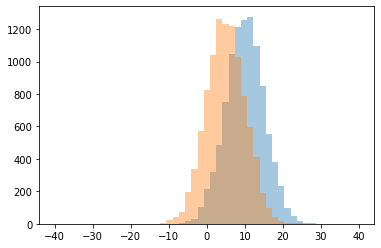

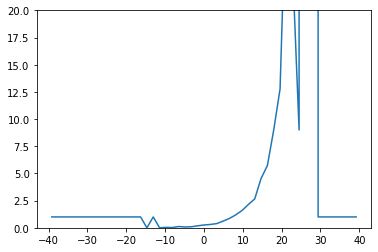

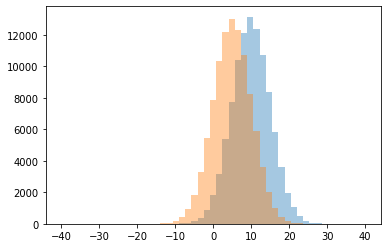

0 0.0
1 0.025
2 0.04
3 0.07653061224489796
4 0.09411764705882353
5 0.11428571428571428
6 0.1827768014059754
7 0.25907990314769974
8 0.3068072866730585
9 0.3847980997624703
10 0.6105691056910569
11 0.8573770491803279
12 1.0
13 1.184390243902439
14 1.5933926302414232
15 2.140939597315436
16 2.6529126213592233
17 4.531914893617022
18 5.721649484536083
19 9.0
20 12.777777777777779
21 23.5
22 32.0
23 999999.0




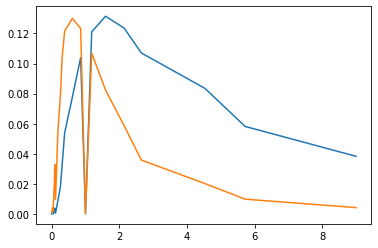

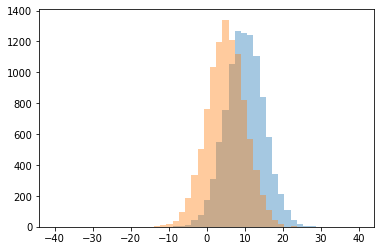

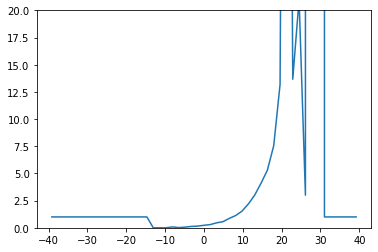

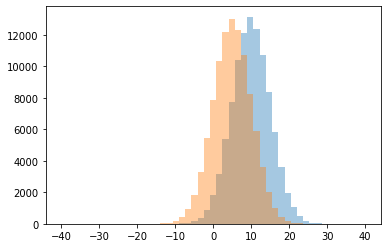

0 0.0
1 0.021505376344086023
2 0.05851063829787234
3 0.07894736842105263
4 0.12462908011869436
5 0.15581854043392504
6 0.2297650130548303
7 0.29797492767598843
8 0.45690376569037655
9 0.5637583892617449
10 0.868595041322314
11 1.0
12 1.1292335115864527
13 1.5322777101096223
14 2.1925795053003534
15 3.0
16 3.008174386920981
17 4.102439024390244
18 5.3
19 7.555555555555555
20 13.1875
21 13.666666666666666
22 21.0
23 112.0
24 999999.0




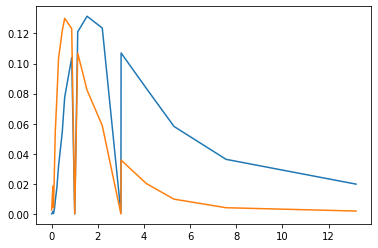

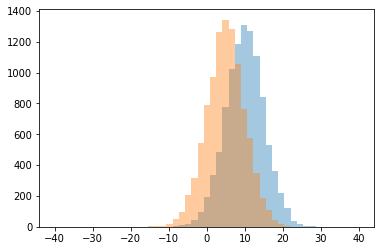

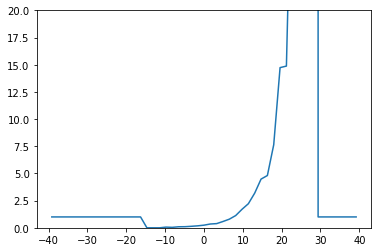

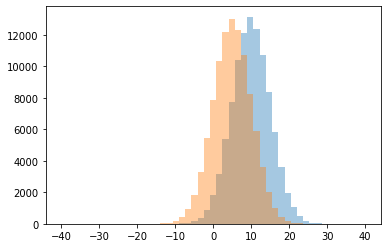

0 0.0
1 0.041666666666666664
2 0.0625
3 0.09473684210526316
4 0.10144927536231885
5 0.13694267515923567
6 0.18047882136279927
7 0.24242424242424243
8 0.34881320949432404
9 0.3849802371541502
10 0.5800446760982875
11 0.7939346811819595
12 1.0
13 1.1253561253561253
14 1.7027379400260756
15 2.2146596858638743
16 3.190201729106628
17 4.4787234042553195
18 4.8090909090909095
19 7.638297872340425
20 14.733333333333333
21 14.875
22 39.0
23 999999.0




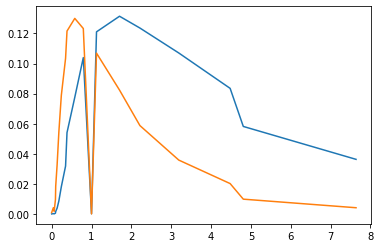

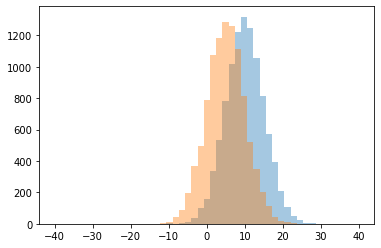

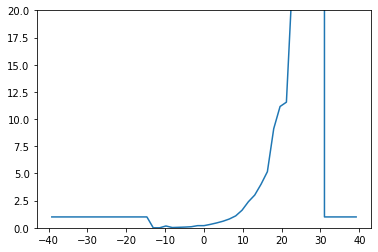

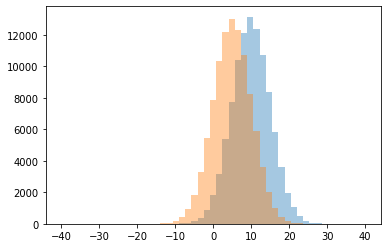

0 0.0
1 0.024390243902439025
2 0.044444444444444446
3 0.06565656565656566
4 0.09836065573770492
5 0.16666666666666666
6 0.19771863117870722
7 0.19797979797979798
8 0.3138347260909935
9 0.4484797297297297
10 0.6048136645962733
11 0.8095238095238095
12 1.0
13 1.095067264573991
14 1.6144430844553244
15 2.3953934740882916
16 3.0085714285714285
17 4.004901960784314
18 5.162162162162162
19 9.116279069767442
20 11.157894736842104
21 11.555555555555555
22 22.0
23 23.5
24 999999.0




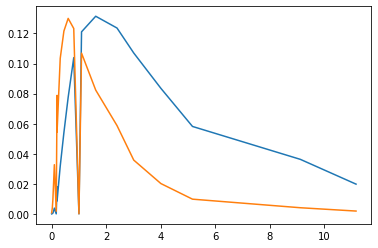

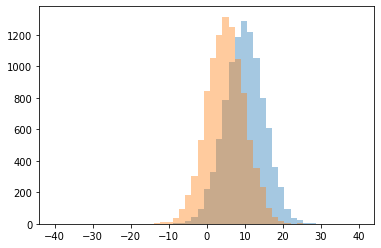

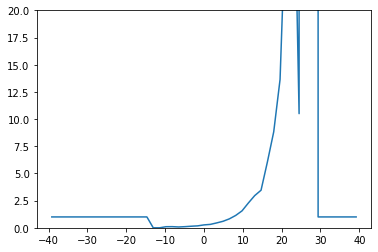

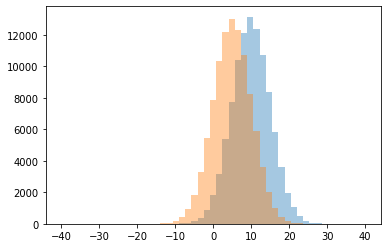

0 0.0
1 0.07608695652173914
2 0.1
3 0.1043956043956044
4 0.10526315789473684
5 0.14473684210526316
6 0.17823639774859287
7 0.26634958382877527
8 0.3137440758293839
9 0.44841930116472545
10 0.5980243161094225
11 0.8217426059152678
12 1.0
13 1.1365807067812799
14 1.55729794933655
15 2.2814258911819887
16 2.960674157303371
17 3.456896551724138
18 6.0495049504950495
19 8.829268292682928
20 10.5
21 13.647058823529411
22 30.666666666666668
23 40.0
24 999999.0




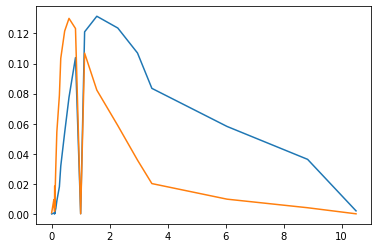

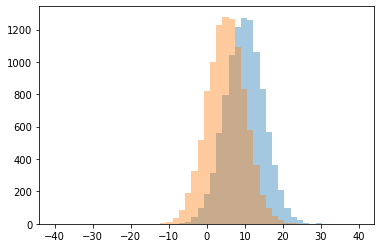

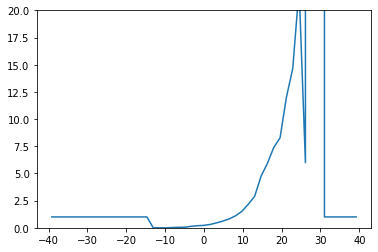

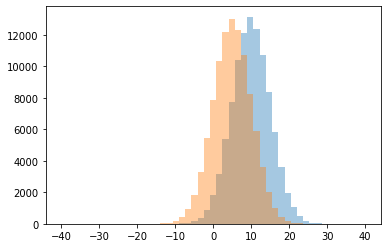

0 0.0
1 0.02631578947368421
2 0.046511627906976744
3 0.05291005291005291
4 0.13677811550151975
5 0.19223300970873786
6 0.22506082725060828
7 0.3116883116883117
8 0.45639771801140994
9 0.6207974980453479
10 0.8272583201267829
11 1.0
12 1.108675799086758
13 1.524609843937575
14 2.174438687392055
15 2.907103825136612
16 4.748571428571428
17 5.916666666666667
18 6.0
19 7.387755102040816
20 8.28
21 12.0
22 14.666666666666666
23 22.0
24 999999.0




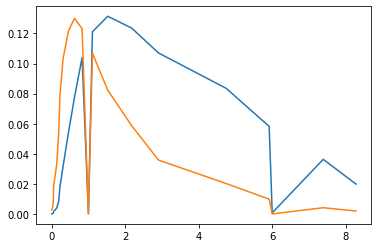

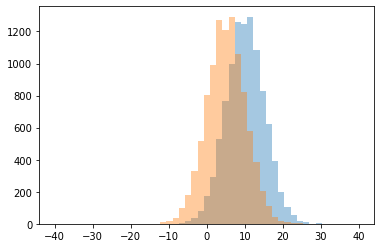

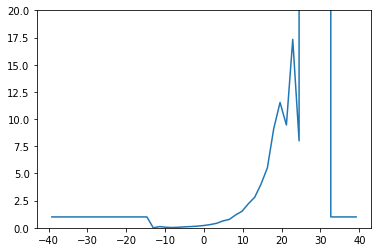

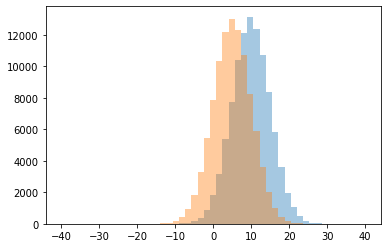

0 0.0
1 0.02857142857142857
2 0.05
3 0.05102040816326531
4 0.08888888888888889
5 0.1111111111111111
6 0.11550151975683891
7 0.15310077519379844
8 0.2126865671641791
9 0.29625884732052576
10 0.4146341463414634
11 0.6333608587943848
12 0.7708978328173375
13 1.0
14 1.1866163996229973
15 1.5200974421437272
16 2.2130584192439864
17 2.8108808290155443
18 4.024271844660194
19 5.513274336283186
20 8.0
21 9.116279069767442
22 9.454545454545455
23 11.529411764705882
24 17.333333333333332
25 999999.0




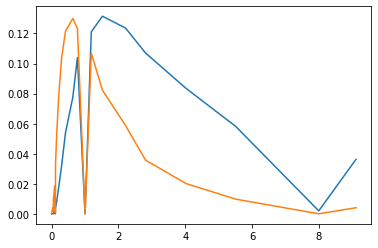

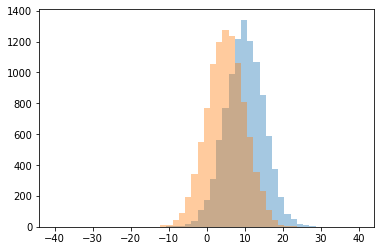

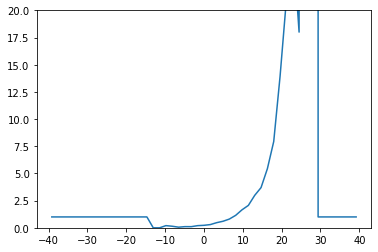

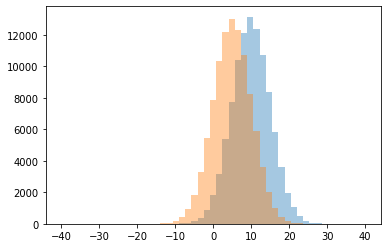

0 0.0
1 0.056818181818181816
2 0.10465116279069768
3 0.10714285714285714
4 0.14285714285714285
5 0.19782214156079855
6 0.2
7 0.22857142857142856
8 0.2957345971563981
9 0.4716193656093489
10 0.6009389671361502
11 0.8030794165316045
12 1.0
13 1.1466165413533835
14 1.654747225647349
15 2.059931506849315
16 2.983240223463687
17 3.696969696969697
18 5.435185185185185
19 7.9361702127659575
20 13.928571428571429
21 18.0
22 21.0
23 26.5
24 999999.0




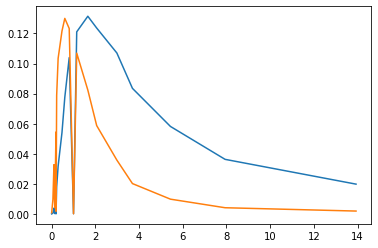

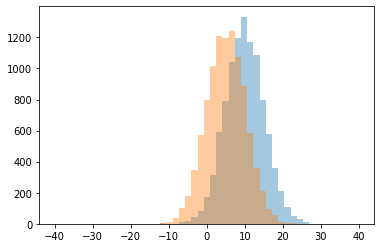

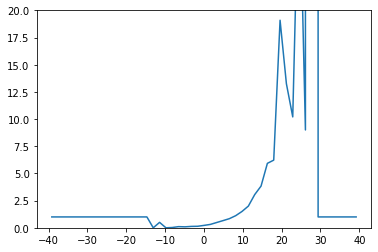

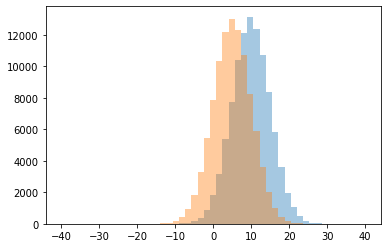

0 0.0
1 0.027777777777777776
2 0.08888888888888889
3 0.10679611650485436
4 0.12790697674418605
5 0.14010507880910683
6 0.22040302267002518
7 0.3106508875739645
8 0.4859504132231405
9 0.5
10 0.6602510460251046
11 0.83883964544722
12 1.0
13 1.1143122676579926
14 1.5045146726862302
15 1.9965811965811966
16 3.053370786516854
17 3.8365384615384617
18 5.928571428571429
19 6.224137931034483
20 9.0
21 10.2
22 13.25
23 19.09090909090909
24 34.0
25 999999.0




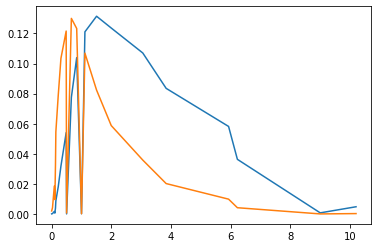

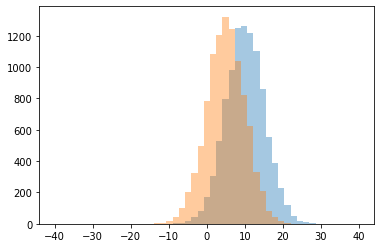

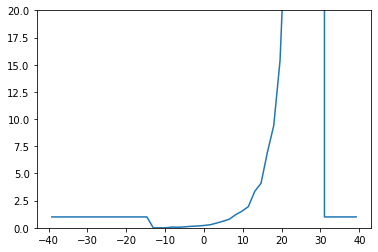

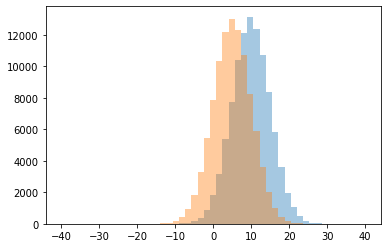

0 0.0
1 0.050505050505050504
2 0.06818181818181818
3 0.08955223880597014
4 0.13580246913580246
5 0.1646586345381526
6 0.2140127388535032
7 0.28294930875576035
8 0.43661971830985913
9 0.6025738077214232
10 0.7914653784219001
11 1.0
12 1.2073288331726133
13 1.5315533980582525
14 1.9487179487179487
15 3.3454545454545452
16 4.104761904761904
17 6.9375
18 9.390243902439025
19 15.4
20 29.75
21 50.0
22 999999.0




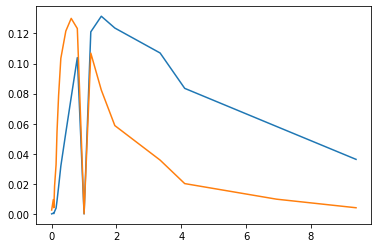

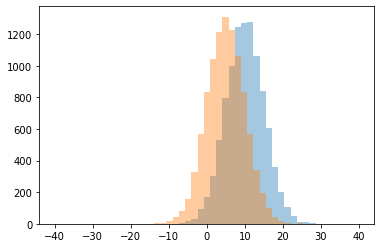

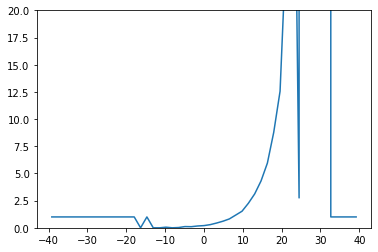

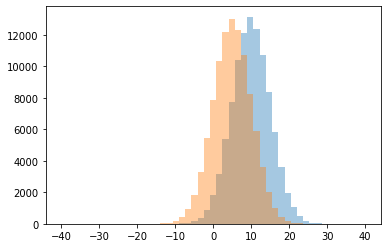

0 0.0
1 0.024691358024691357
2 0.05555555555555555
3 0.10153846153846154
4 0.1125
5 0.16725352112676056
6 0.20168067226890757
7 0.29242569511025884
8 0.4389438943894389
9 0.6071700991609459
10 0.8159609120521173
11 1.0
12 1.1690140845070423
13 1.524609843937575
14 2.254416961130742
15 2.75
16 3.1202346041055717
17 4.312820512820513
18 5.950980392156863
19 8.78048780487805
20 12.5625
21 26.5
22 51.0
23 999999.0




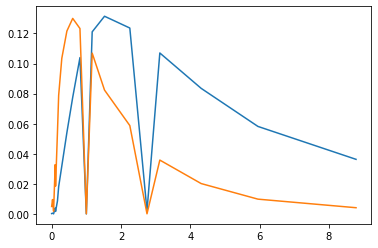

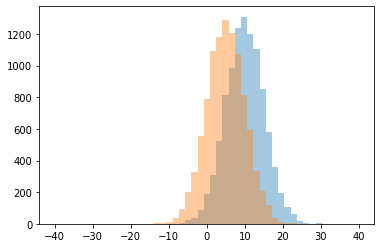

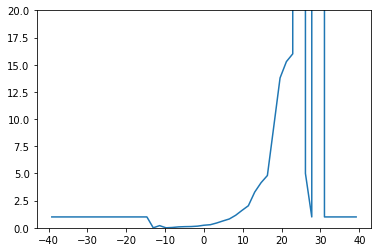

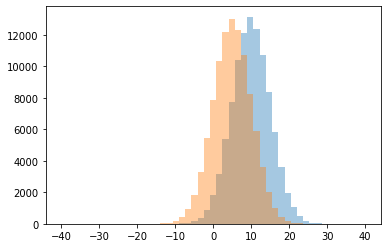

0 0.0
1 0.029411764705882353
2 0.08421052631578947
3 0.10552763819095477
4 0.11550151975683891
5 0.1526032315978456
6 0.2
7 0.2366412213740458
8 0.2838827838827839
9 0.4416243654822335
10 0.6327639751552795
11 0.8130686517783292
12 1.0
13 1.1534883720930234
14 1.602203182374541
15 2.028813559322034
16 3.2827380952380953
17 4.146341463414634
18 4.809917355371901
19 5.0
20 9.282051282051283
21 13.785714285714286
22 15.285714285714286
23 16.0
24 999999.0




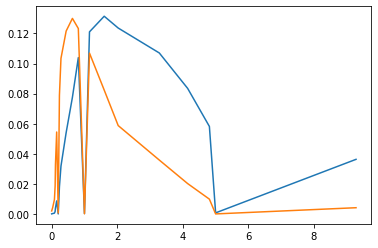

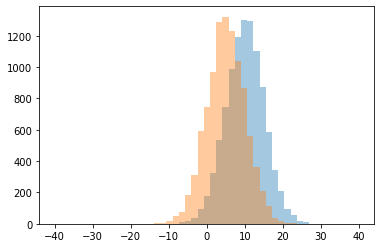

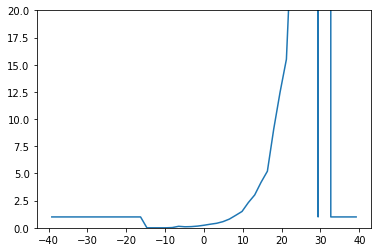

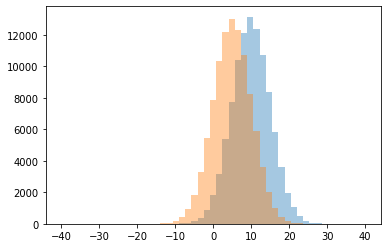

0 0.0
1 0.020833333333333332
2 0.09340659340659341
3 0.10828025477707007
4 0.136986301369863
5 0.15619694397283532
6 0.23521505376344087
7 0.3305870236869207
8 0.41550387596899224
9 0.5662376987130961
10 0.8003246753246753
11 1.0
12 1.1450528338136408
13 1.5023148148148149
14 2.3231597845601435
15 3.021978021978022
16 4.1826923076923075
17 5.20353982300885
18 9.078947368421053
19 12.470588235294118
20 15.5
21 29.0
22 999999.0




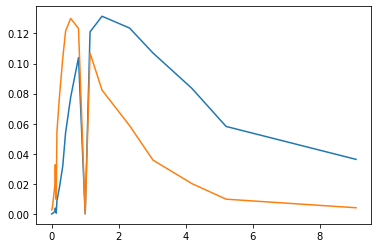

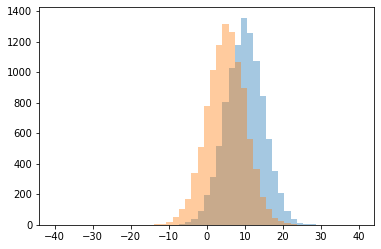

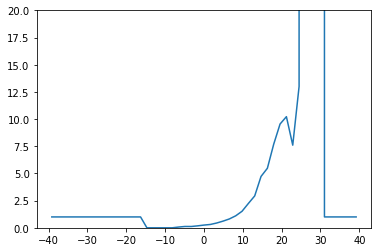

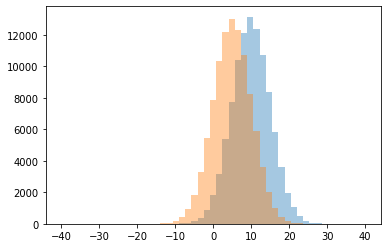

0 0.0
1 0.06930693069306931
2 0.11988304093567251
3 0.12209302325581395
4 0.1794871794871795
5 0.25
6 0.3067061143984221
7 0.4391489361702128
8 0.6122913505311077
9 0.8134920634920635
10 1.0
11 1.1010289990645463
12 1.5184770436730124
13 2.236654804270463
14 2.9315068493150687
15 4.726256983240224
16 5.475728155339806
17 7.6
18 7.695652173913044
19 9.545454545454545
20 10.222222222222221
21 13.0
22 999999.0




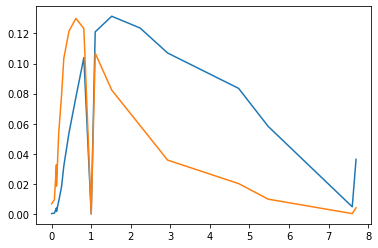

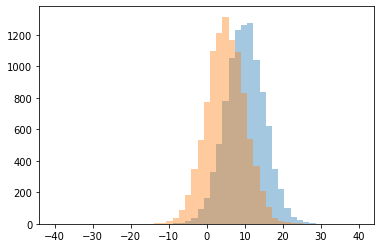

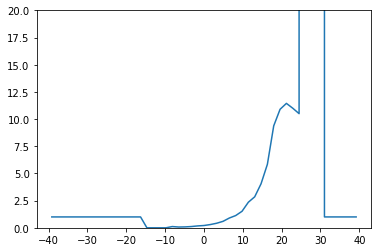

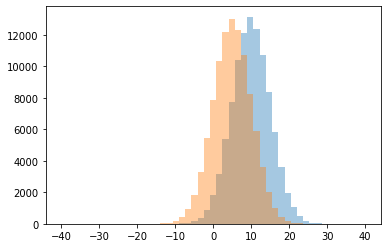

0 0.0
1 0.07058823529411765
2 0.08241758241758242
3 0.11428571428571428
4 0.11461318051575932
5 0.17325800376647835
6 0.21005154639175258
7 0.29808568824065634
8 0.4184514003294893
9 0.5931558935361216
10 0.8991452991452992
11 1.0
12 1.1254578754578755
13 1.5180288461538463
14 2.353049907578558
15 2.849726775956284
16 4.048309178743962
17 5.839622641509434
18 9.378378378378379
19 10.5
20 10.9
21 11.0
22 11.444444444444445
23 999999.0




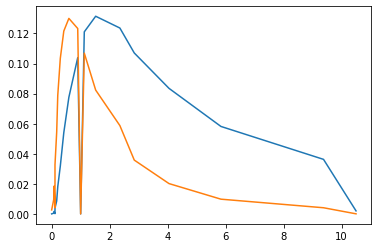

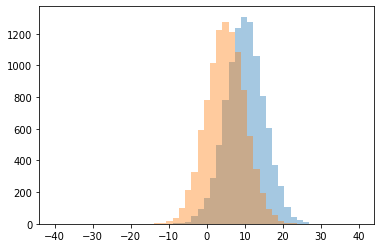

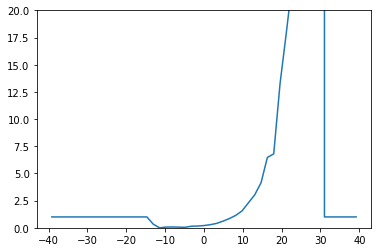

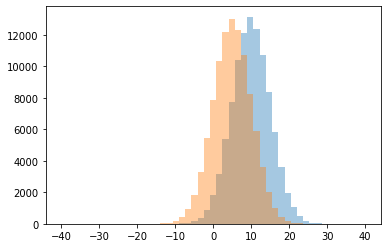

0 0.0
1 0.04739336492890995
2 0.06
3 0.06666666666666667
4 0.07692307692307693
5 0.14329268292682926
6 0.16074450084602368
7 0.20535714285714285
8 0.28641732283464566
9 0.3333333333333333
10 0.4055600981193786
11 0.6120689655172413
12 0.847682119205298
13 1.0
14 1.1382488479262673
15 1.5504151838671412
16 2.291891891891892
17 3.0286532951289398
18 4.143589743589744
19 6.473118279569892
20 6.8
21 13.277777777777779
22 18.0
23 23.0
24 999999.0




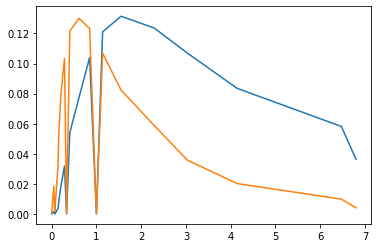

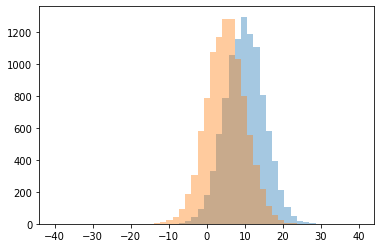

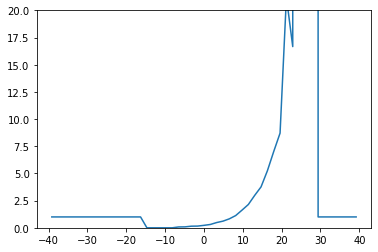

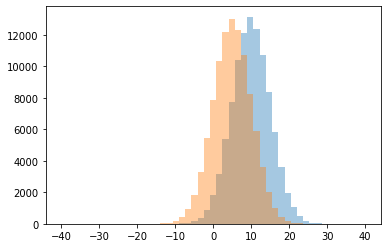

0 0.0
1 0.07777777777777778
2 0.08602150537634409
3 0.14802631578947367
4 0.15780445969125215
5 0.22588832487309646
6 0.30604651162790697
7 0.4828767123287671
8 0.6121495327102804
9 0.8244929797191888
10 1.0
11 1.1252427184466018
12 1.6260978670012547
13 2.1444043321299637
14 2.983783783783784
15 3.7627906976744185
16 5.243243243243243
17 7.017857142857143
18 8.708333333333334
19 16.666666666666668
20 21.2
21 999999.0




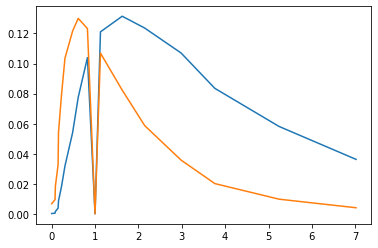

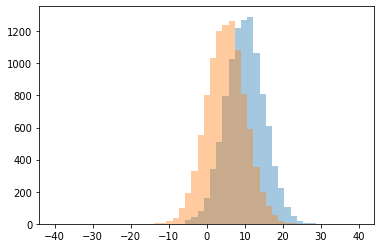

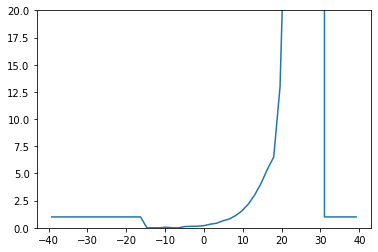

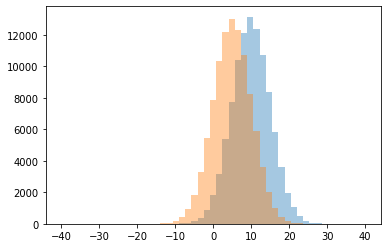

0 0.0
1 0.05263157894736842
2 0.11578947368421053
3 0.13677811550151975
4 0.14673913043478262
5 0.19825436408977556
6 0.3313953488372093
7 0.42368640533778146
8 0.6435483870967742
9 0.8097868981846882
10 1.0
11 1.1273062730627306
12 1.563501849568434
13 2.1844331641285955
14 3.022727272727273
15 4.08080808080808
16 5.380530973451328
17 6.509090909090909
18 13.0
19 25.5
20 34.0
21 999999.0




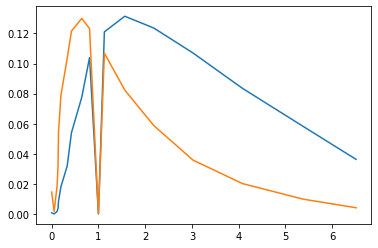

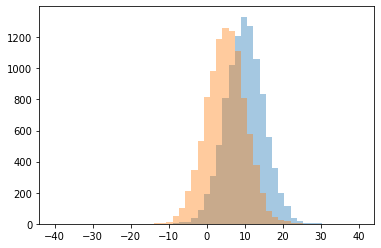

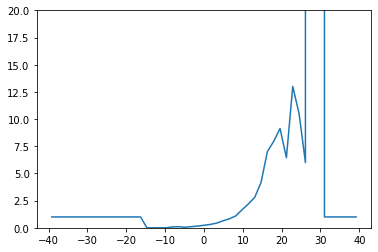

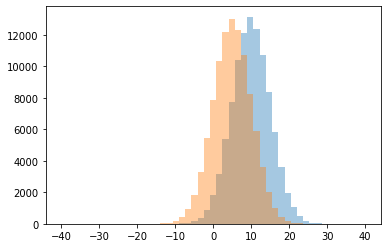

0 0.0
1 0.052884615384615384
2 0.08
3 0.10101010101010101
4 0.10601719197707736
5 0.16104868913857678
6 0.23190184049079754
7 0.31269035532994927
8 0.42857142857142855
9 0.6434231378763867
10 0.8236714975845411
11 1.0
12 1.0865644724977457
13 1.652605459057072
14 2.1951640759930915
15 2.7994722955145117
16 4.17
17 6.0
18 6.444444444444445
19 7.0125
20 7.955555555555556
21 9.136363636363637
22 10.5
23 13.0
24 999999.0




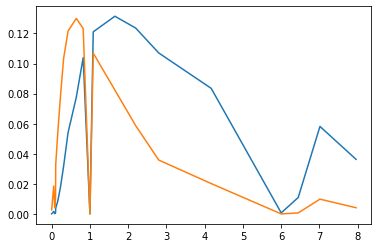

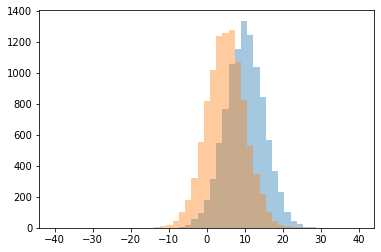

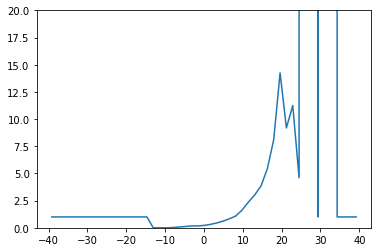

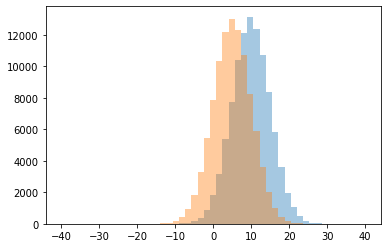

0 0.0
1 0.02127659574468085
2 0.06862745098039216
3 0.11602209944751381
4 0.16878402903811252
5 0.16927899686520376
6 0.2178702570379437
7 0.31200787401574803
8 0.4406779661016949
9 0.6127490039840637
10 0.827073552425665
11 1.0
12 1.0784313725490196
13 1.6260657734470159
14 2.3579545454545454
15 3.020348837209302
16 3.8493150684931505
17 4.6
18 5.451923076923077
19 8.11111111111111
20 9.181818181818182
21 11.25
22 14.25
23 999999.0




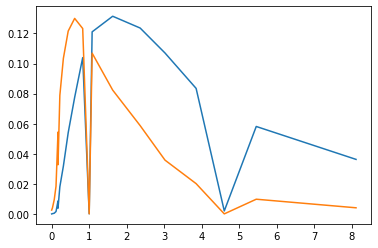

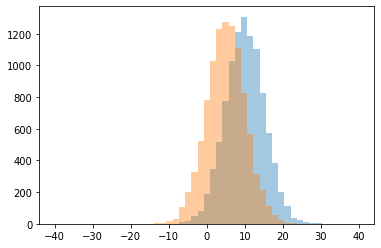

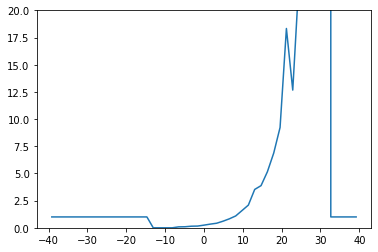

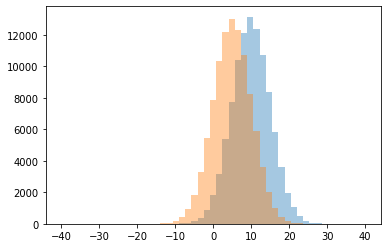

0 0.0
1 0.08571428571428572
2 0.09595959595959595
3 0.14634146341463414
4 0.15930902111324377
5 0.24487179487179486
6 0.3391642371234208
7 0.42032520325203254
8 0.6062745098039216
9 0.8251804330392943
10 1.0
11 1.0890287769784173
12 1.5861650485436893
13 2.0878734622144113
14 3.5288461538461537
15 3.8779342723004695
16 5.153153153153153
17 6.875
18 9.227272727272727
19 12.666666666666666
20 18.333333333333332
21 23.0
22 999999.0




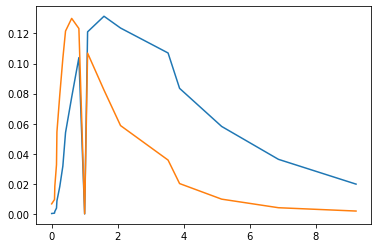

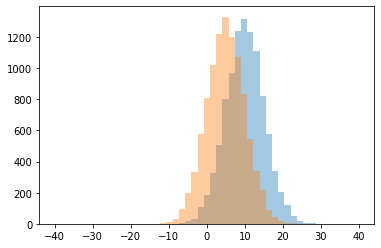

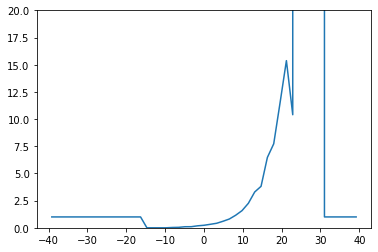

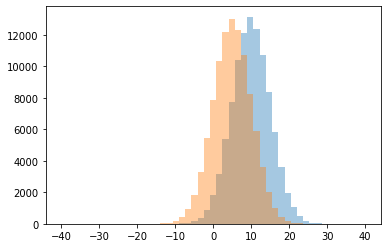

0 0.0
1 0.029411764705882353
2 0.0425531914893617
3 0.09743589743589744
4 0.10149253731343283
5 0.18292682926829268
6 0.23200992555831265
7 0.3215686274509804
8 0.4165302782324059
9 0.6010518407212622
10 0.8086522462562395
11 1.0
12 1.15622076707203
13 1.5786314525810323
14 2.2536496350364965
15 3.293768545994065
16 3.813953488372093
17 6.47191011235955
18 7.7272727272727275
19 10.4
20 11.5
21 15.375
22 999999.0




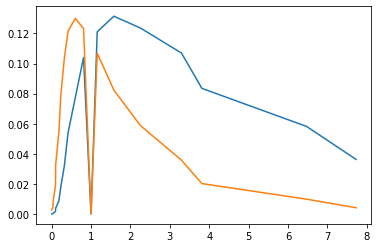

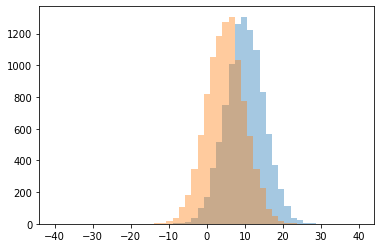

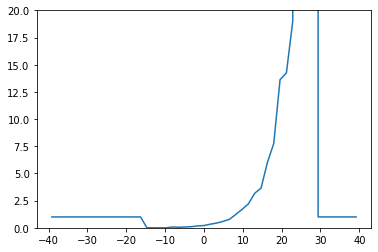

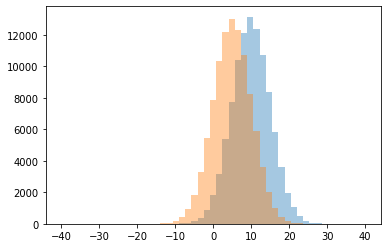

0 0.0
1 0.047619047619047616
2 0.07608695652173914
3 0.07692307692307693
4 0.10086455331412104
5 0.1746880570409982
6 0.20706455542021923
7 0.3333333333333333
8 0.43496621621621623
9 0.5866666666666667
10 0.7733537519142419
11 1.0
12 1.2193236714975846
13 1.6917098445595855
14 2.197841726618705
15 3.1739130434782608
16 3.6491228070175437
17 6.0
18 7.75
19 13.625
20 14.25
21 19.0
22 999999.0




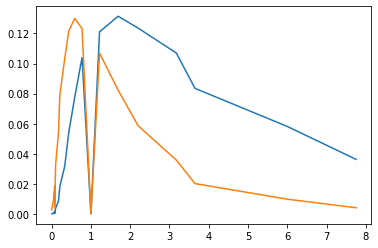

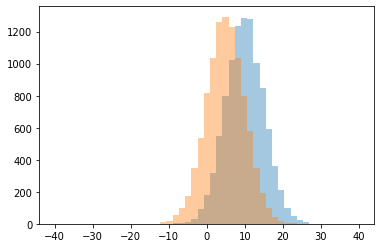

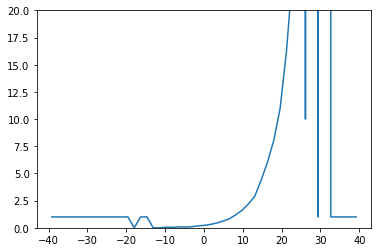

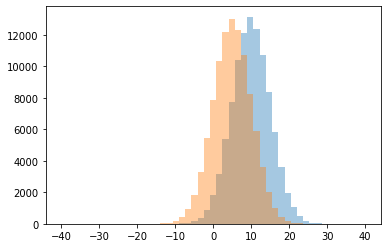

0 0.0
1 0.038461538461538464
2 0.05263157894736842
3 0.07017543859649122
4 0.08333333333333333
5 0.09455587392550144
6 0.17472118959107807
7 0.22031823745410037
8 0.3076181292189007
9 0.43720190779014306
10 0.6163959783449343
11 0.8294069861900893
12 1.0
13 1.1926427879961279
14 1.6057571964956194
15 2.1962134251290877
16 2.893063583815029
17 4.3538461538461535
18 6.01010101010101
19 8.022222222222222
20 10.0
21 10.947368421052632
22 16.166666666666668
23 23.5
24 999999.0




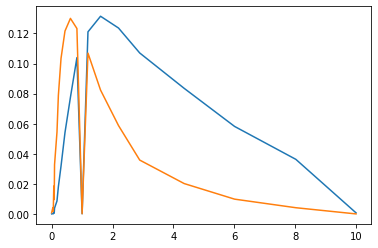

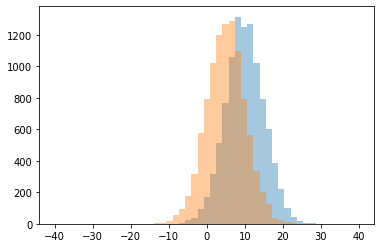

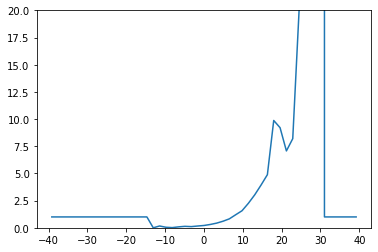

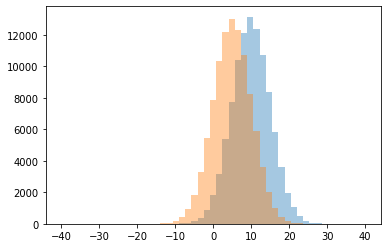

0 0.0
1 0.018518518518518517
2 0.05
3 0.08602150537634409
4 0.10862619808306709
5 0.1348314606741573
6 0.1643598615916955
7 0.16666666666666666
8 0.2128463476070529
9 0.3074656188605108
10 0.4298831385642738
11 0.6039525691699604
12 0.823208722741433
13 1.0
14 1.2
15 1.568553459119497
16 2.25177304964539
17 3.0297619047619047
18 3.9303482587064678
19 4.8861788617886175
20 7.071428571428571
21 8.2
22 9.208333333333334
23 9.871794871794872
24 20.0
25 999999.0




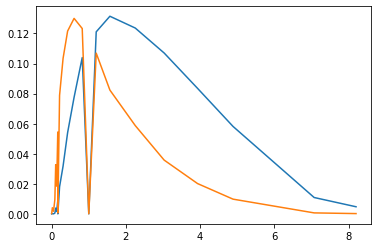

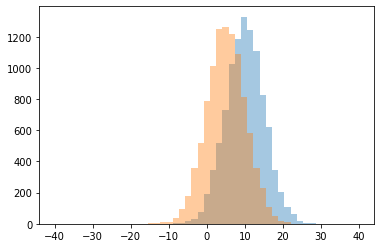

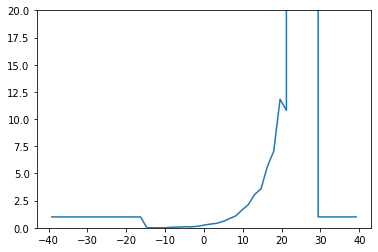

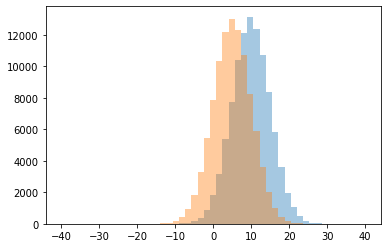

0 0.0
1 0.05555555555555555
2 0.061855670103092786
3 0.08169014084507042
4 0.1
5 0.14119922630560927
6 0.24650571791613723
7 0.33925049309664695
8 0.4128
9 0.5784469096671949
10 0.8412828947368421
11 1.0
12 1.0902394106813997
13 1.6334563345633457
14 2.1337907375643224
15 3.074792243767313
16 3.588744588744589
17 5.6454545454545455
18 7.040816326530612
19 10.8
20 11.823529411764707
21 999999.0




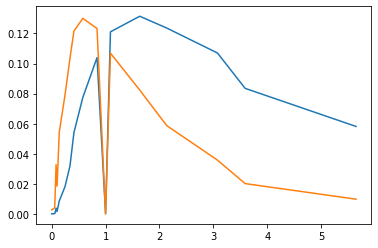

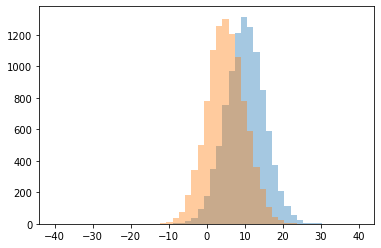

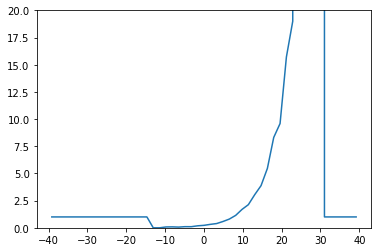

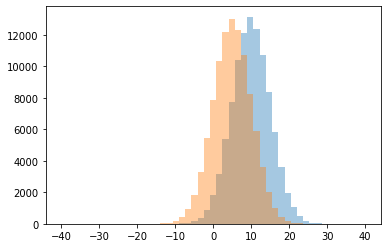

0 0.0
1 0.06493506493506493
2 0.07692307692307693
3 0.08571428571428572
4 0.10204081632653061
5 0.10382513661202186
6 0.1827309236947791
7 0.2260536398467433
8 0.3161231884057971
9 0.3907863383637808
10 0.58
11 0.8031430934656741
12 1.0
13 1.143126177024482
14 1.6915167095115682
15 2.127551020408163
16 3.0446927374301676
17 3.8772727272727274
18 5.462962962962963
19 8.311111111111112
20 9.590909090909092
21 15.714285714285714
22 19.0
23 999999.0




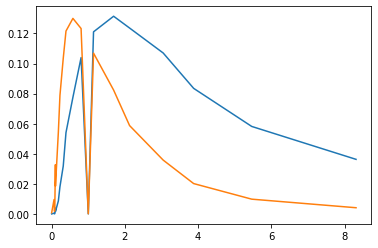

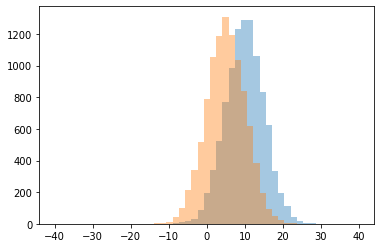

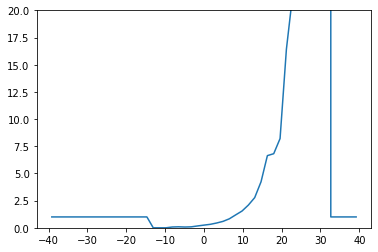

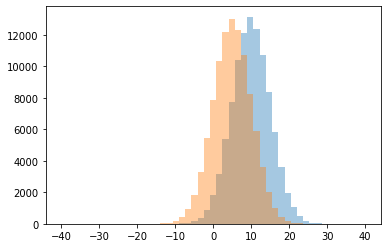

0 0.0
1 0.07075471698113207
2 0.07317073170731707
3 0.08875739644970414
4 0.09090909090909091
5 0.17120622568093385
6 0.24652338811630847
7 0.32037914691943126
8 0.4408783783783784
9 0.5905271199388846
10 0.8270361041141897
11 1.0
12 1.188042430086789
13 1.5412186379928314
14 2.0892857142857144
15 2.775456919060052
16 4.23469387755102
17 6.638297872340425
18 6.816326530612245
19 8.208333333333334
20 16.428571428571427
21 21.5
22 999999.0




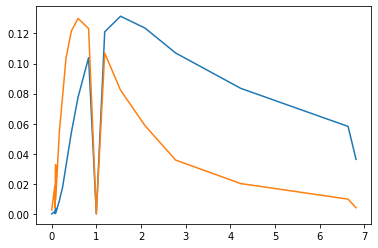

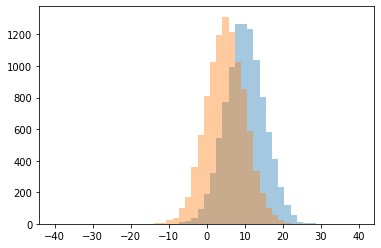

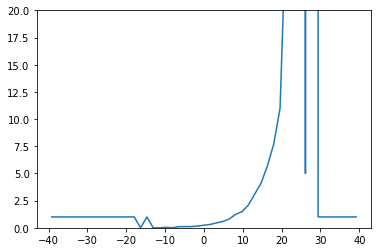

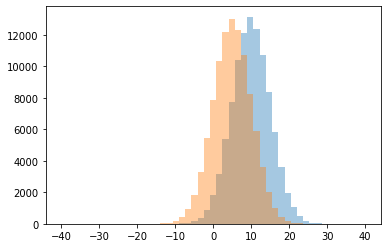

0 0.0
1 0.043478260869565216
2 0.1
3 0.10833333333333334
4 0.11242603550295859
5 0.1622103386809269
6 0.2360939431396786
7 0.3115234375
8 0.4527986633249791
9 0.5861280487804879
10 0.8175842235004108
11 1.0
12 1.2336903602726388
13 1.4894366197183098
14 2.0913705583756346
15 3.1014925373134328
16 4.1020408163265305
17 5.0
18 5.686274509803922
19 7.69811320754717
20 11.0
21 29.0
22 53.0
23 999999.0




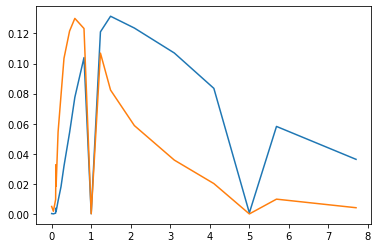

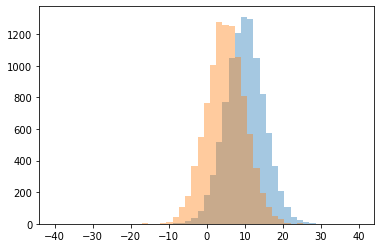

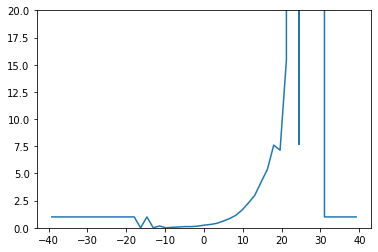

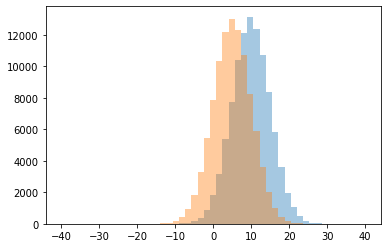

0 0.0
1 0.046511627906976744
2 0.07547169811320754
3 0.10743801652892562
4 0.11173184357541899
5 0.1509090909090909
6 0.16666666666666666
7 0.24151436031331594
8 0.30677290836653387
9 0.40688575899843504
10 0.6098334655035687
11 0.8349282296650717
12 1.0
13 1.143939393939394
14 1.6265508684863523
15 2.2816901408450705
16 2.9745042492917846
17 4.1938775510204085
18 5.373831775700935
19 7.137931034482759
20 7.604166666666667
21 7.666666666666667
22 15.428571428571429
23 999999.0




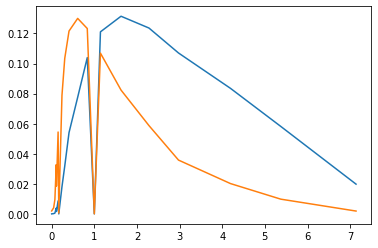

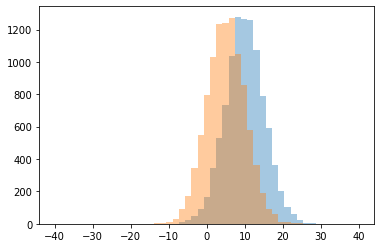

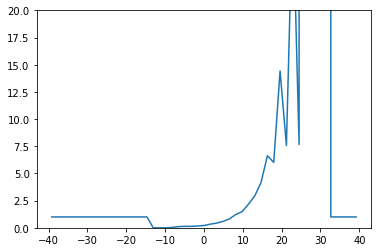

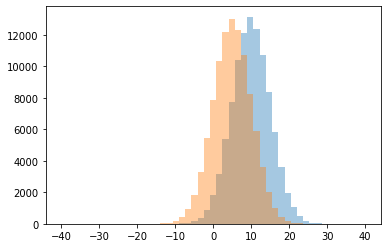

0 0.0
1 0.03225806451612903
2 0.1111111111111111
3 0.1329479768786127
4 0.13411078717201166
5 0.16757741347905283
6 0.21185372005044137
7 0.33365664403491757
8 0.43262987012987014
9 0.589516129032258
10 0.8155416012558869
11 1.0
12 1.2192564346997141
13 1.480140186915888
14 2.1597938144329896
15 2.9262295081967213
16 4.164021164021164
17 6.016666666666667
18 6.629213483146067
19 7.571428571428571
20 7.666666666666667
21 14.428571428571429
22 30.0
23 999999.0




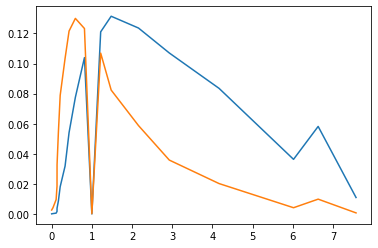

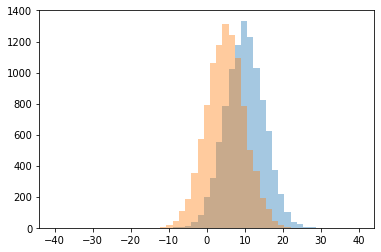

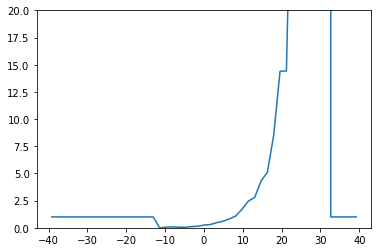

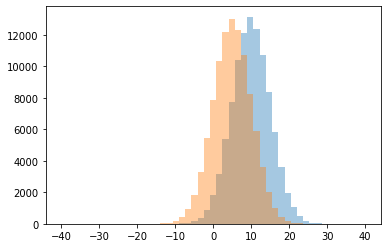

0 0.0
1 0.04864864864864865
2 0.05405405405405406
3 0.058823529411764705
4 0.0851063829787234
5 0.11363636363636363
6 0.13937282229965156
7 0.2509505703422053
8 0.300376647834275
9 0.4697872340425532
10 0.5986290936785986
11 0.8208835341365461
12 1.0
13 1.0795974382433668
14 1.7037037037037037
15 2.456
16 2.7934782608695654
17 4.302083333333333
18 5.10655737704918
19 8.522727272727273
20 14.4
21 14.428571428571429
22 23.0
23 40.0
24 999999.0




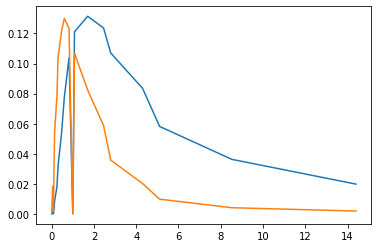

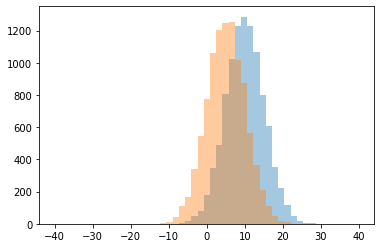

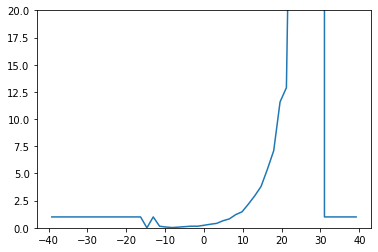

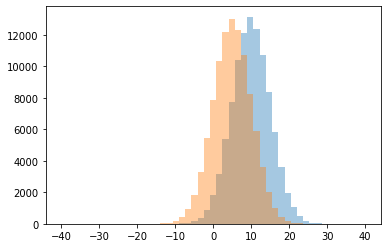

0 0.0
1 0.023255813953488372
2 0.06422018348623854
3 0.07142857142857142
4 0.10650887573964497
5 0.14285714285714285
6 0.14442413162705667
7 0.14868804664723032
8 0.23255813953488372
9 0.3267419962335217
10 0.4071310116086235
11 0.6477181745396317
12 0.8188347964884277
13 1.0
14 1.2116141732283465
15 1.4680365296803652
16 2.1769911504424777
17 2.9368131868131866
18 3.8
19 5.380530973451328
20 7.1
21 11.578947368421053
22 12.88888888888889
23 50.0
24 999999.0




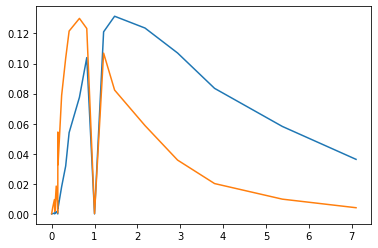

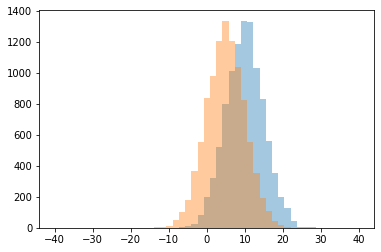

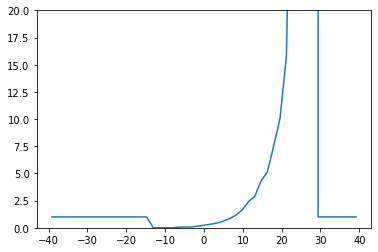

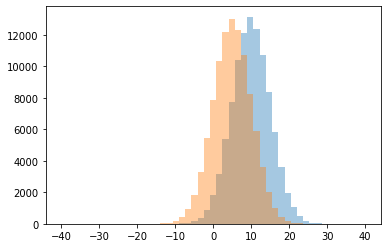

0 0.0
1 0.06666666666666667
2 0.07262569832402235
3 0.07317073170731707
4 0.14721723518850988
5 0.23832335329341317
6 0.3258426966292135
7 0.4334160463192721
8 0.5968586387434555
9 0.8376139188069595
10 1.0
11 1.1487922705314009
12 1.6221142162818956
13 2.389189189189189
14 2.8823529411764706
15 4.298969072164948
16 5.137614678899083
17 7.531914893617022
18 10.1
19 15.75
20 47.0
21 999999.0




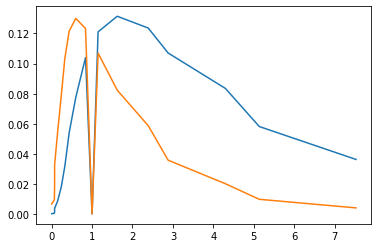

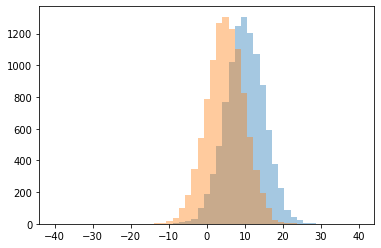

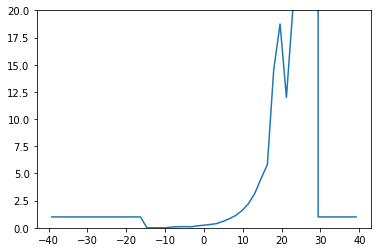

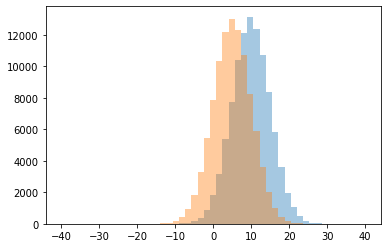

0 0.0
1 0.07692307692307693
2 0.0953757225433526
3 0.09803921568627451
4 0.11173184357541899
5 0.18114602587800369
6 0.24045801526717558
7 0.30358874878758485
8 0.38910812943962114
9 0.5886415963161934
10 0.8344208809135399
11 1.0
12 1.1327272727272728
13 1.5811138014527846
14 2.2110091743119265
15 3.150442477876106
16 4.523316062176166
17 5.813725490196078
18 12.0
19 14.538461538461538
20 18.75
21 20.0
22 24.0
23 999999.0




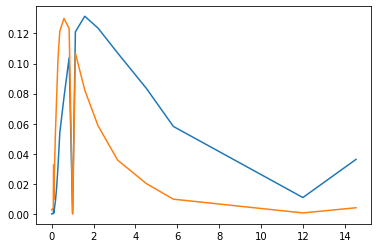

on f= 0.034482758620689655


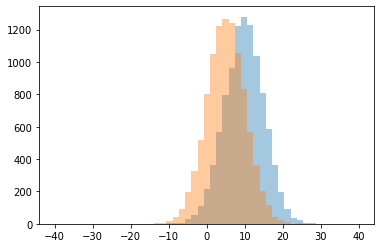

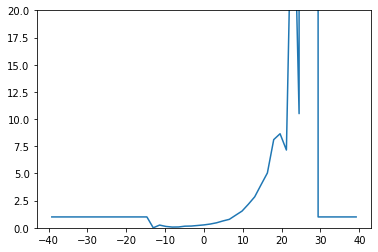

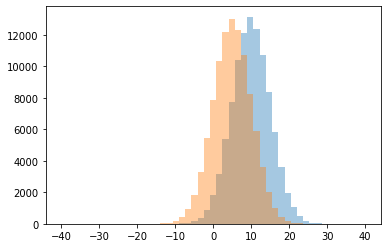

0 0.0
1 0.06666666666666667
2 0.07692307692307693
3 0.125
4 0.14871794871794872
5 0.16049382716049382
6 0.2127659574468085
7 0.25
8 0.26683291770573564
9 0.3466666666666667
10 0.4627964022894522
11 0.632120253164557
12 0.7788539144471348
13 1.0
14 1.160037878787879
15 1.5366146458583434
16 2.1672535211267605
17 2.848901098901099
18 3.9558823529411766
19 5.043103448275862
20 7.153846153846154
21 8.11111111111111
22 8.652173913043478
23 10.5
24 36.0
25 999999.0




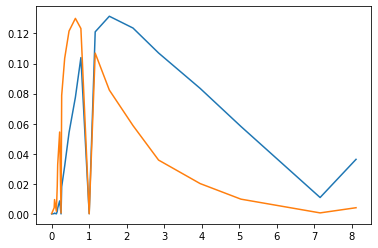

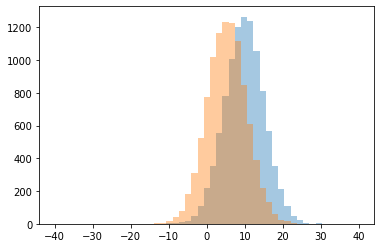

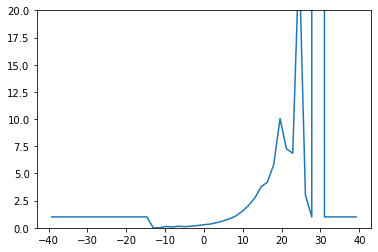

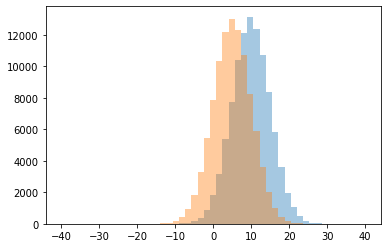

0 0.0
1 0.075
2 0.10270270270270271
3 0.125
4 0.14285714285714285
5 0.15335463258785942
6 0.20872865275142316
7 0.28350515463917525
8 0.3464180569185476
9 0.4751286449399657
10 0.6312803889789304
11 0.8175895765472313
12 1.0
13 1.0789946140035906
14 1.4970414201183433
15 2.041186161449753
16 2.7268041237113403
17 3.0
18 3.763888888888889
19 4.2
20 5.819672131147541
21 6.857142857142857
22 7.266666666666667
23 10.047619047619047
24 25.0
25 999999.0




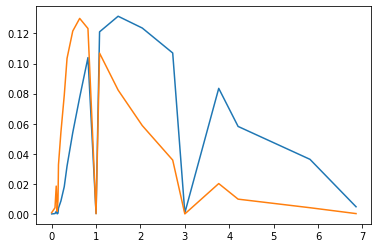

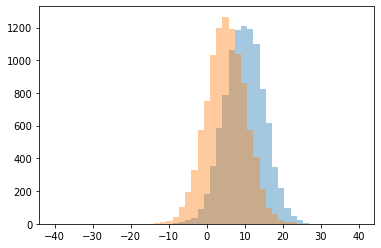

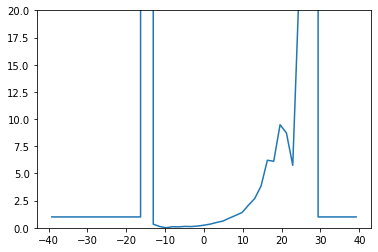

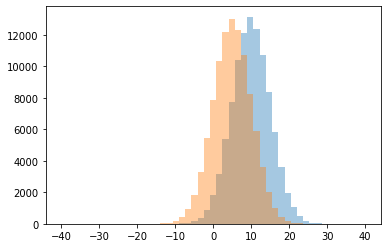

0 0.0
1 0.08653846153846154
2 0.1
3 0.11314984709480122
4 0.125
5 0.12755102040816327
6 0.16
7 0.2403718459495352
8 0.3333333333333333
9 0.34075508228460794
10 0.4903765690376569
11 0.6224328593996841
12 0.8939393939393939
13 1.0
14 1.140790742526519
15 1.4030197444831591
16 2.0694444444444446
17 2.6919315403422983
18 3.841860465116279
19 5.75
20 6.12280701754386
21 6.212121212121212
22 8.727272727272727
23 9.478260869565217
24 22.0
25 999999.0




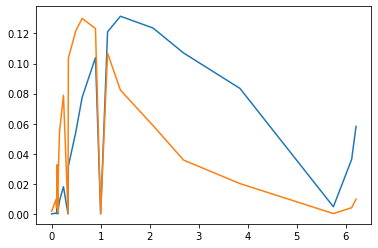

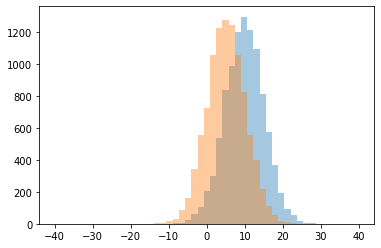

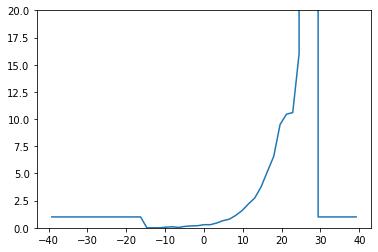

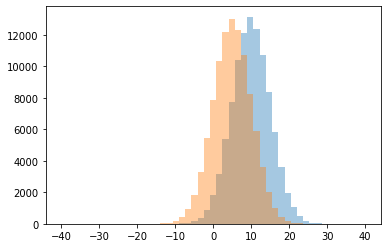

0 0.0
1 0.03529411764705882
2 0.058823529411764705
3 0.09090909090909091
4 0.12883435582822086
5 0.17391304347826086
6 0.19244604316546762
7 0.2836946277097078
8 0.28591160220994477
9 0.4377542717656631
10 0.6580392156862745
11 0.7942353883106485
12 1.0
13 1.1390728476821192
14 1.577156743620899
15 2.1873873873873872
16 2.7375
17 3.7546296296296298
18 5.171171171171171
19 6.571428571428571
20 9.5
21 10.444444444444445
22 10.6
23 16.0
24 999999.0




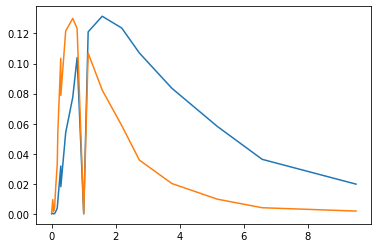

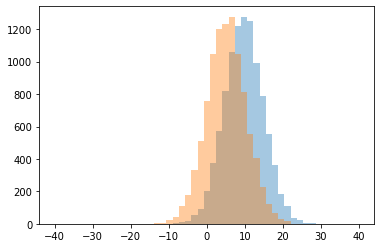

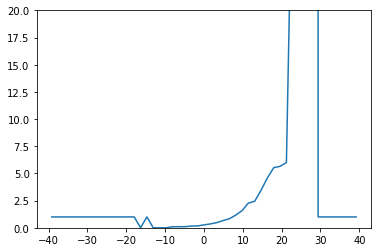

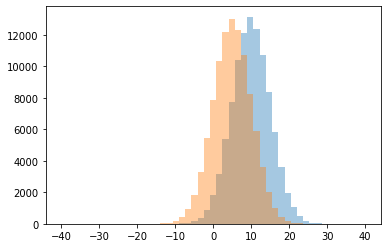

0 0.0
1 0.09523809523809523
2 0.1
3 0.102803738317757
4 0.16109422492401215
5 0.173828125
6 0.26745718050065875
7 0.35619047619047617
8 0.4742524916943522
9 0.6645004061738424
10 0.8296703296703297
11 1.0
12 1.1623686723973257
13 1.5745992601726264
14 2.2740471869328496
15 2.4373464373464375
16 3.4517543859649122
17 4.586776859504132
18 5.53030303030303
19 5.65625
20 6.0
21 21.0
22 36.0
23 999999.0




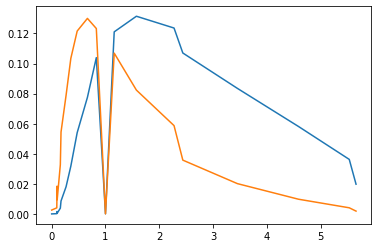

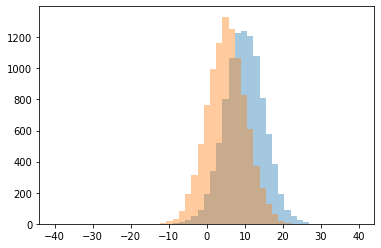

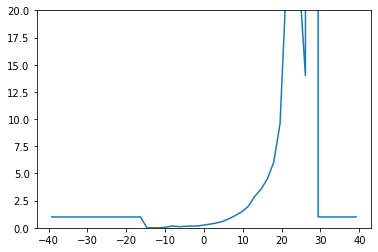

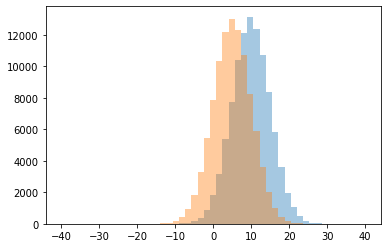

0 0.0
1 0.05555555555555555
2 0.10714285714285714
3 0.13612565445026178
4 0.1597444089456869
5 0.1724137931034483
6 0.17509727626459143
7 0.24804177545691905
8 0.342713567839196
9 0.444253859348199
10 0.6036036036036037
11 0.8492822966507177
12 1.0
13 1.150749063670412
14 1.4903614457831325
15 1.9803600654664484
16 2.8927613941018766
17 3.5482456140350878
18 4.5078125
19 6.03125
20 9.6
21 14.0
22 22.75
23 23.0
24 53.0
25 999999.0




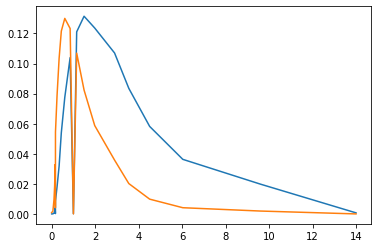

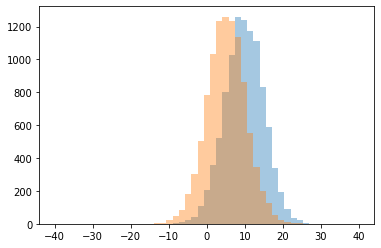

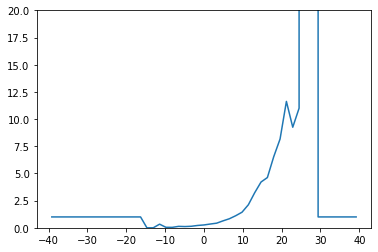

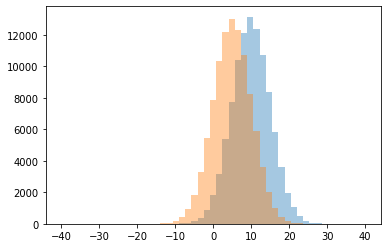

0 0.0
1 0.041666666666666664
2 0.045454545454545456
3 0.11413043478260869
4 0.13253012048192772
5 0.14052287581699346
6 0.2155688622754491
7 0.26214833759590794
8 0.3333333333333333
9 0.3475314617618587
10 0.4256701868399675
11 0.638095238095238
12 0.8313057583130575
13 1.0
14 1.109251101321586
15 1.4340277777777777
16 2.119349005424955
17 3.2267441860465116
18 4.212121212121212
19 4.622047244094488
20 6.538461538461538
21 8.166666666666666
22 9.25
23 11.0
24 11.625
25 999999.0




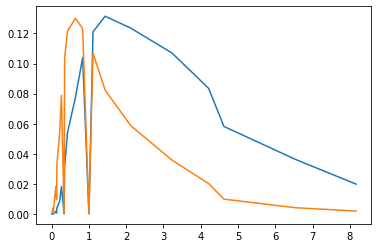

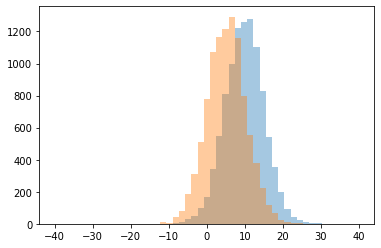

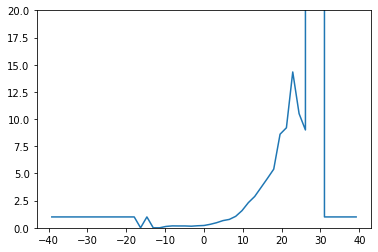

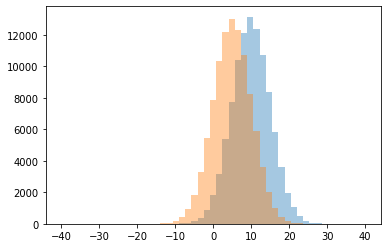

0 0.0
1 0.125
2 0.14790996784565916
3 0.16883116883116883
4 0.16939890710382513
5 0.175
6 0.1875
7 0.2120822622107969
8 0.32212885154061627
9 0.4703862660944206
10 0.6625615763546798
11 0.7724458204334366
12 1.0
13 1.0544511668107173
14 1.579145728643216
15 2.313974591651543
16 2.8821989528795813
17 3.708520179372197
18 4.53781512605042
19 5.393939393939394
20 8.608695652173912
21 9.0
22 9.2
23 10.5
24 14.333333333333334
25 999999.0




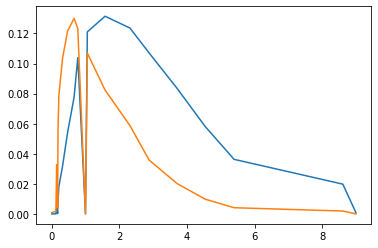

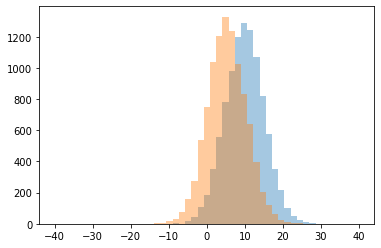

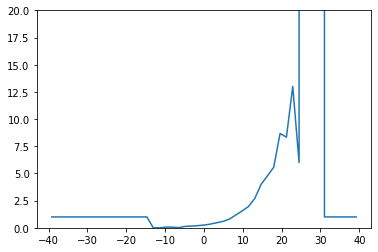

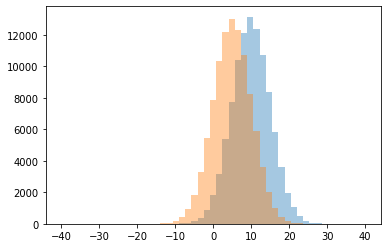

0 0.0
1 0.013333333333333334
2 0.058823529411764705
3 0.06060606060606061
4 0.1282051282051282
5 0.15942028985507245
6 0.19814814814814816
7 0.24866310160427807
8 0.3400576368876081
9 0.46434494195688225
10 0.5891647855530474
11 0.7936893203883495
12 1.0
13 1.1666666666666667
14 1.5479616306954436
15 1.94679186228482
16 2.6842105263157894
17 3.9854368932038833
18 4.768595041322314
19 5.571428571428571
20 6.0
21 8.333333333333334
22 8.68
23 13.0
24 999999.0




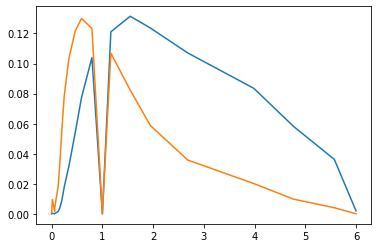

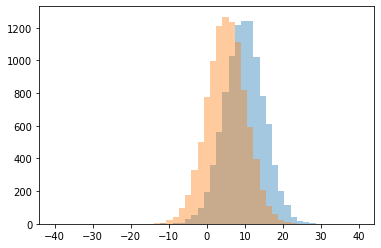

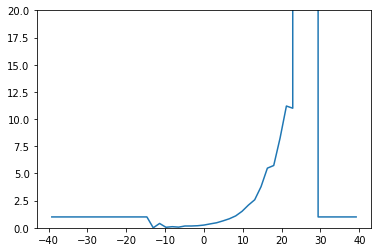

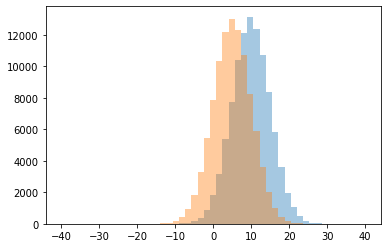

0 0.0
1 0.047619047619047616
2 0.061224489795918366
3 0.10256410256410256
4 0.16477272727272727
5 0.16566265060240964
6 0.1903807615230461
7 0.2519280205655527
8 0.3614457831325301
9 0.4
10 0.4640792733278282
11 0.6377269139700079
12 0.8310428455941795
13 1.0
14 1.0936936936936936
15 1.5140073081607794
16 2.0841750841750843
17 2.5772151898734177
18 3.782608695652174
19 5.486486486486487
20 5.73015873015873
21 8.25
22 11.0
23 11.2
24 999999.0




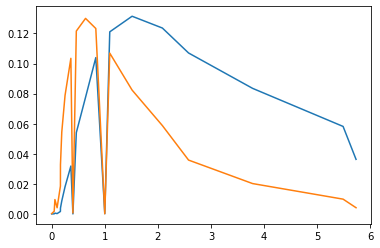

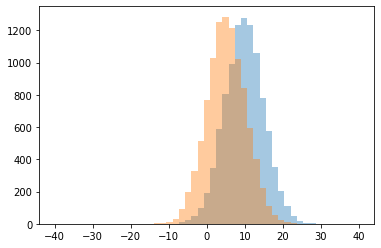

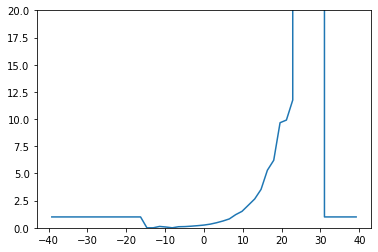

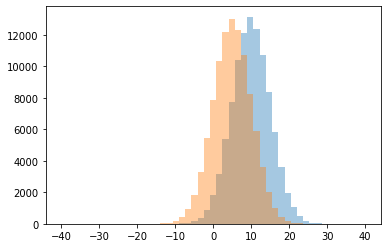

0 0.0
1 0.07142857142857142
2 0.0989010989010989
3 0.1111111111111111
4 0.125
5 0.14939024390243902
6 0.19569471624266144
7 0.2516297262059974
8 0.3375609756097561
9 0.46837469975980783
10 0.6261682242990654
11 0.8176567656765676
12 1.0
13 1.209598432908913
14 1.514218009478673
15 2.081081081081081
16 2.6525
17 3.5318181818181817
18 5.293577981651376
19 6.2105263157894735
20 9.666666666666666
21 9.909090909090908
22 11.75
23 999999.0




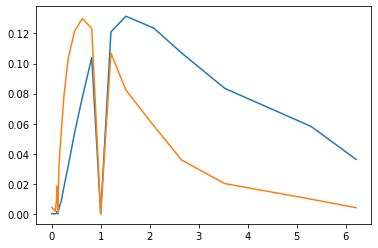

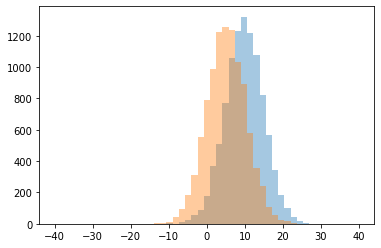

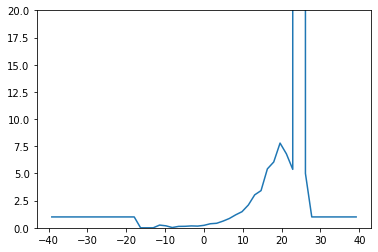

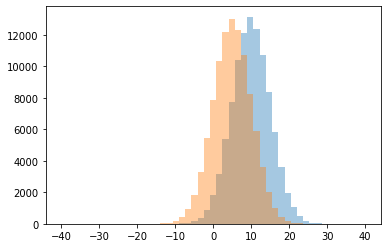

0 0.0
1 0.024390243902439025
2 0.13043478260869565
3 0.13736263736263737
4 0.15551537070524413
5 0.17307692307692307
6 0.18181818181818182
7 0.22658227848101264
8 0.25
9 0.372210953346856
10 0.41551020408163264
11 0.6140350877192983
12 0.8558704453441296
13 1.0
14 1.192046556741028
15 1.4820627802690582
16 2.098106712564544
17 3.0309859154929577
18 3.4208333333333334
19 5.0
20 5.375
21 5.419047619047619
22 6.052631578947368
23 6.8
24 7.791666666666667
25 999999.0




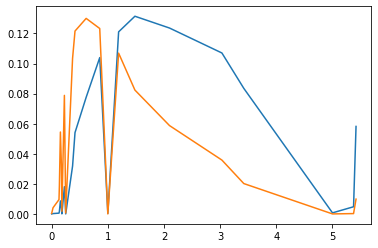

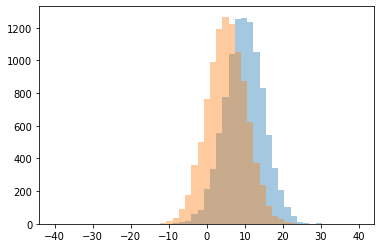

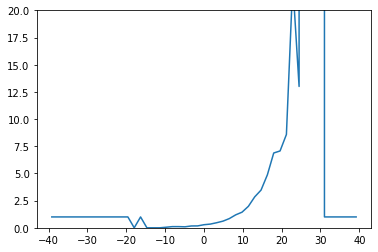

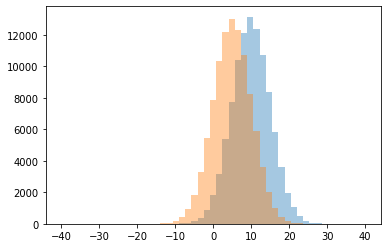

0 0.0
1 0.05
2 0.09142857142857143
3 0.10810810810810811
4 0.10869565217391304
5 0.16806722689075632
6 0.1743486973947896
7 0.28346456692913385
8 0.34074823053589487
9 0.46694560669456064
10 0.612776025236593
11 0.8479149632052331
12 1.0
13 1.190521327014218
14 1.4360730593607305
15 1.9728434504792332
16 2.8436657681940702
17 3.4686192468619246
18 4.875
19 6.88
20 7.068965517241379
21 8.583333333333334
22 13.0
23 22.5
24 999999.0




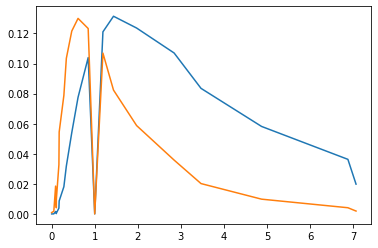

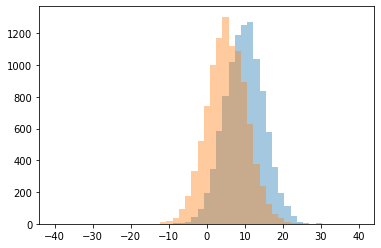

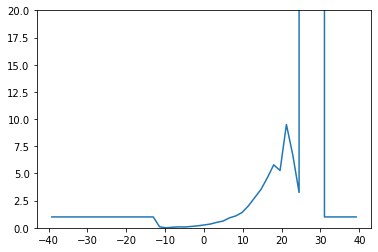

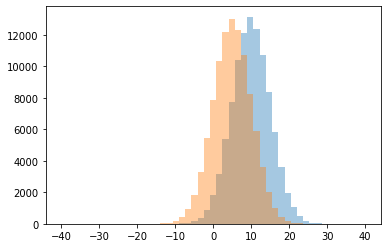

0 0.0
1 0.05128205128205128
2 0.07471264367816093
3 0.08333333333333333
4 0.09090909090909091
5 0.12574850299401197
6 0.1811175337186898
7 0.2570659488559892
8 0.34496510468594216
9 0.49701110162254486
10 0.6180981595092024
11 0.9097408400357462
12 1.0
13 1.0898258478460128
14 1.404494382022472
15 2.011093502377179
16 2.7733333333333334
17 3.25
18 3.538135593220339
19 4.608
20 5.27027027027027
21 5.790322580645161
22 6.714285714285714
23 9.5
24 999999.0




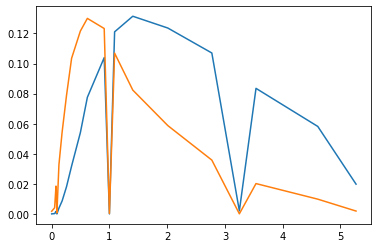

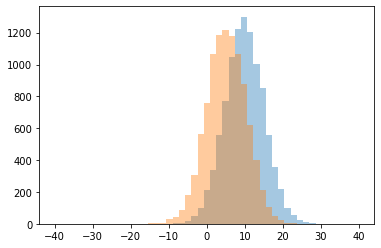

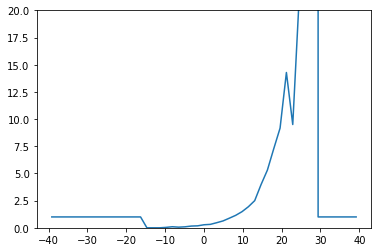

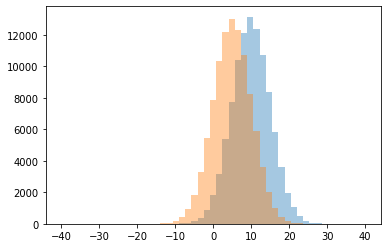

0 0.0
1 0.037037037037037035
2 0.058823529411764705
3 0.0898876404494382
4 0.0975609756097561
5 0.1590909090909091
6 0.18085106382978725
7 0.27873183619550856
8 0.3151969981238274
9 0.4675652906486942
10 0.6313628899835796
11 0.8840947546531303
12 1.0
13 1.1455399061032865
14 1.4840182648401827
15 1.9357945425361156
16 2.4975124378109452
17 3.97196261682243
18 5.304761904761905
19 7.26530612244898
20 9.166666666666666
21 9.5
22 14.285714285714286
23 21.0
24 999999.0




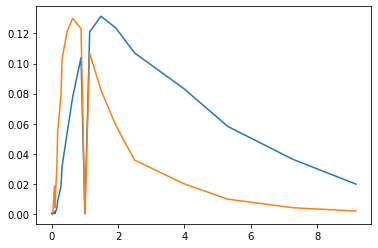

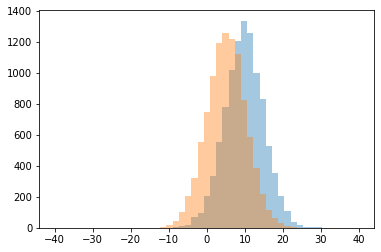

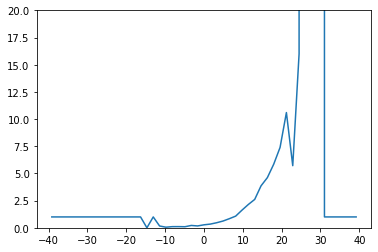

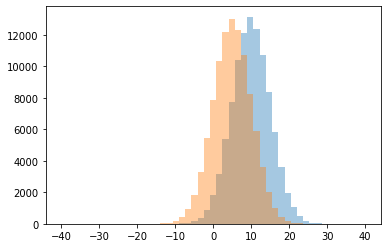

0 0.0
1 0.05555555555555555
2 0.09852216748768473
3 0.10638297872340426
4 0.10891089108910891
5 0.16666666666666666
6 0.17086330935251798
7 0.21630094043887146
8 0.2744310575635877
9 0.34049079754601225
10 0.4661087866108787
11 0.6214285714285714
12 0.8379934210526315
13 1.0
14 1.0738434163701067
15 1.6265206812652069
16 2.1467576791808876
17 2.609375
18 3.86046511627907
19 4.6173913043478265
20 5.714285714285714
21 5.852459016393443
22 7.392857142857143
23 10.6
24 16.0
25 999999.0




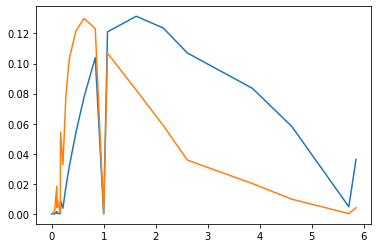

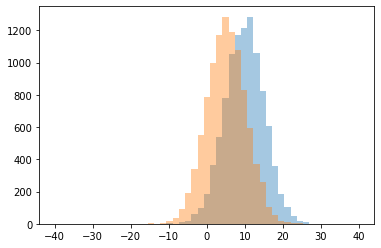

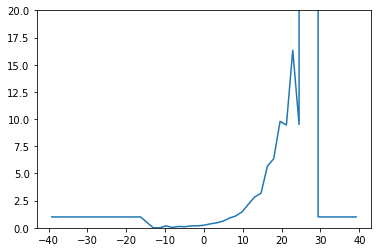

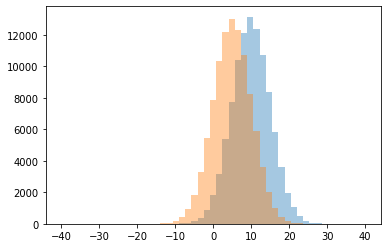

0 0.0
1 0.029411764705882353
2 0.09895833333333333
3 0.11956521739130435
4 0.17352941176470588
5 0.17647058823529413
6 0.1843065693430657
7 0.2370088719898606
8 0.3627254509018036
9 0.45865302642796246
10 0.5
11 0.6074766355140186
12 0.8842281879194631
13 1.0
14 1.0891364902506964
15 1.4620938628158844
16 2.16722972972973
17 2.839142091152815
18 3.1814671814671813
19 5.663551401869159
20 6.357142857142857
21 9.454545454545455
22 9.5
23 9.789473684210526
24 16.333333333333332
25 999999.0




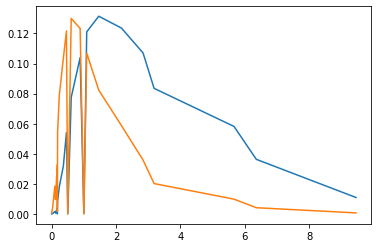

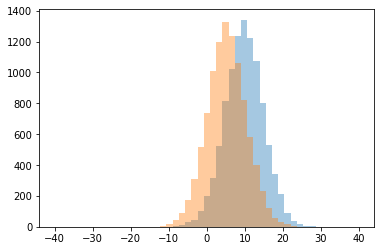

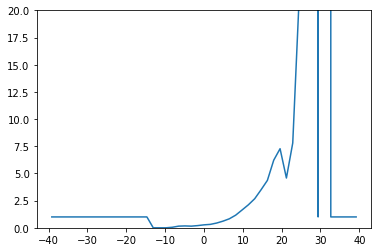

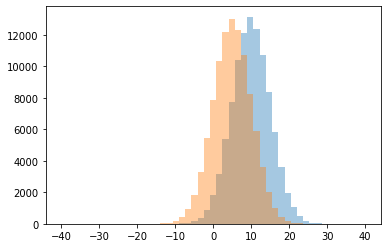

0 0.0
1 0.04878048780487805
2 0.15210355987055016
3 0.15217391304347827
4 0.1724137931034483
5 0.20194174757281552
6 0.2716216216216216
7 0.31485148514851485
8 0.4373956594323873
9 0.6112781954887218
10 0.8284789644012945
11 1.0
12 1.1629001883239172
13 1.6345919610231425
14 2.113793103448276
15 2.674129353233831
16 3.4956521739130433
17 4.360655737704918
18 4.578947368421052
19 6.218181818181818
20 7.275862068965517
21 7.8
22 21.0
23 999999.0




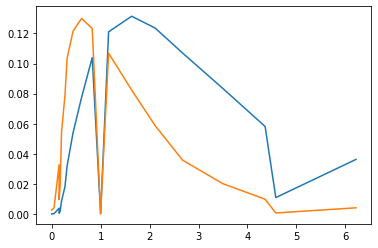

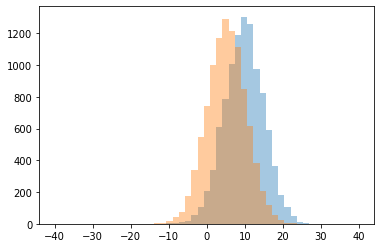

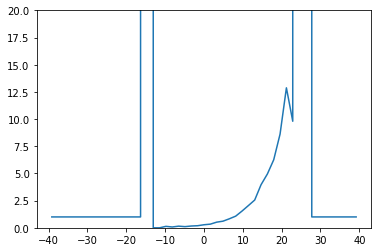

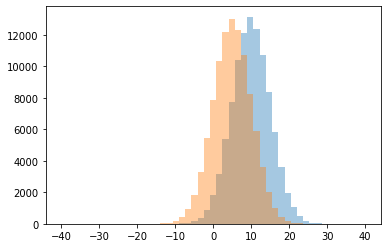

0 0.0
1 0.075
2 0.10674157303370786
3 0.13333333333333333
4 0.1506849315068493
5 0.1636904761904762
6 0.1912568306010929
7 0.27994616419919244
8 0.3356643356643357
9 0.5183290707587382
10 0.6094354215003867
11 0.8283828382838284
12 1.0
13 1.071107110711071
14 1.5389150943396226
15 2.042207792207792
16 2.5538057742782154
17 3.9615384615384617
18 4.95
19 6.258620689655173
20 8.619047619047619
21 9.8
22 12.875
23 999999.0




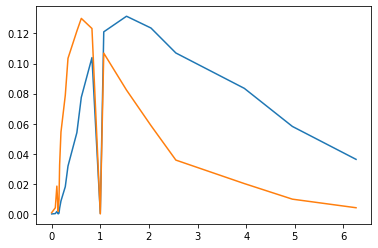

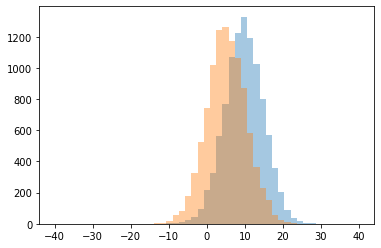

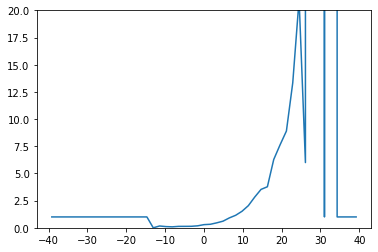

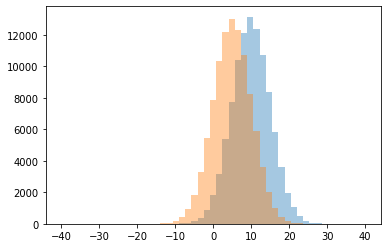

0 0.0
1 0.08928571428571429
2 0.1111111111111111
3 0.13095238095238096
4 0.13259668508287292
5 0.13761467889908258
6 0.16666666666666666
7 0.18164435946462715
8 0.29071332436069985
9 0.32350049164208455
10 0.4541800643086817
11 0.6085578446909667
12 0.9105621805792163
13 1.0
14 1.1514581373471309
15 1.5205949656750573
16 2.0376068376068375
17 2.8241758241758244
18 3.5330396475770924
19 3.774834437086093
20 6.0
21 6.280701754385965
22 7.62962962962963
23 8.9
24 13.333333333333334
25 21.0
26 999999.0




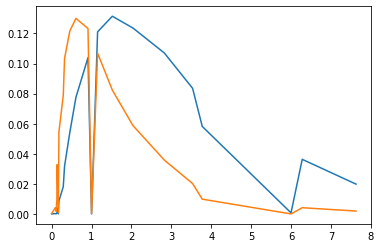

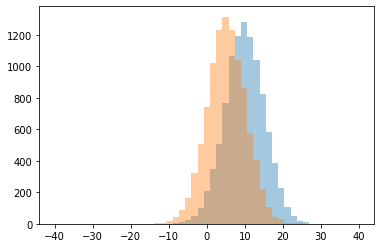

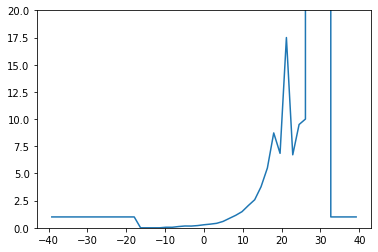

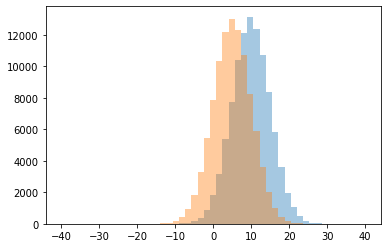

0 0.0
1 0.047619047619047616
2 0.05
3 0.11627906976744186
4 0.15950920245398773
5 0.1656441717791411
6 0.20436507936507936
7 0.27956989247311825
8 0.33822091886608013
9 0.4121951219512195
10 0.5843465045592705
11 0.8666666666666667
12 1.0
13 1.1457334611697028
14 1.4849537037037037
15 2.0500863557858375
16 2.5806451612903225
17 3.776255707762557
18 5.5
19 6.714285714285714
20 6.848484848484849
21 8.727272727272727
22 9.5
23 10.0
24 17.5
25 999999.0




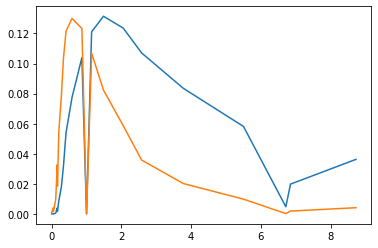

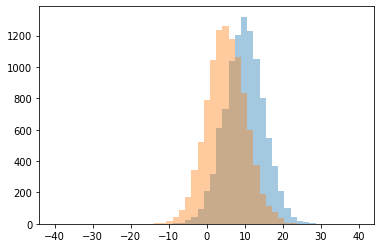

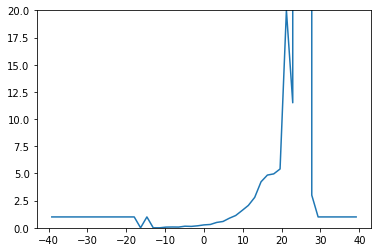

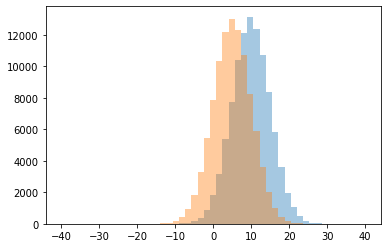

0 0.0
1 0.0625
2 0.06666666666666667
3 0.07317073170731707
4 0.1286549707602339
5 0.14619883040935672
6 0.183206106870229
7 0.2676767676767677
8 0.30592734225621415
9 0.4931062449310625
10 0.5816164817749604
11 0.8812553011026294
12 1.0
13 1.129455909943715
14 1.5865384615384615
15 2.0587248322147653
16 2.797872340425532
17 3.0
18 4.231578947368421
19 4.849557522123894
20 4.95945945945946
21 5.410256410256411
22 11.5
23 20.0
24 999999.0




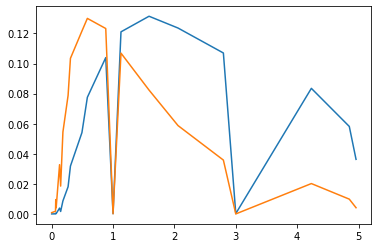

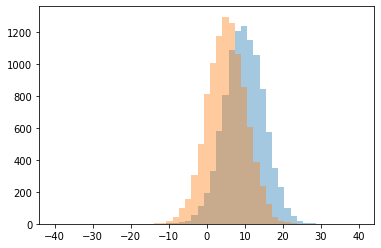

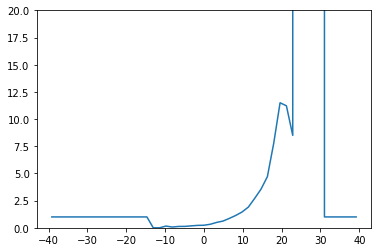

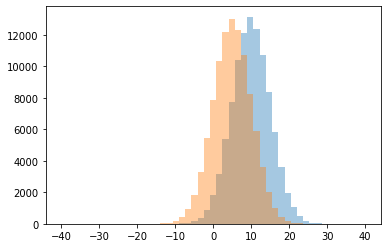

0 0.0
1 0.06976744186046512
2 0.125
3 0.12987012987012986
4 0.15789473684210525
5 0.17763157894736842
6 0.2217741935483871
7 0.23551171393341552
8 0.32602193419740777
9 0.49531116794543906
10 0.6197836166924265
11 0.8650159744408946
12 1.0
13 1.1327683615819208
14 1.4508196721311475
15 1.9053156146179402
16 2.709511568123393
17 3.559322033898305
18 4.704918032786885
19 7.777777777777778
20 8.5
21 11.222222222222221
22 11.5
23 999999.0




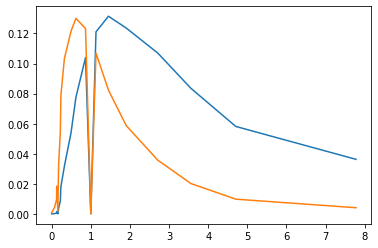

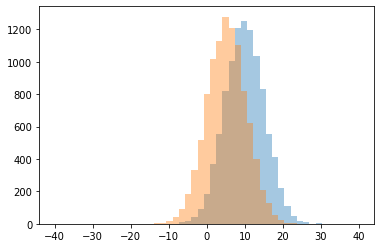

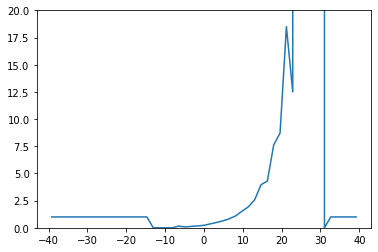

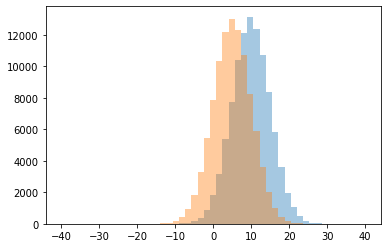

0 0.0
1 0.08241758241758242
2 0.12874251497005987
3 0.15555555555555556
4 0.1718146718146718
5 0.22932330827067668
6 0.3614931237721022
7 0.4911504424778761
8 0.6416275430359938
9 0.8289256198347107
10 1.0
11 1.0980036297640654
12 1.5261875761266748
13 1.92914653784219
14 2.582089552238806
15 3.961904761904762
16 4.3023255813953485
17 7.62962962962963
18 8.72
19 12.5
20 18.5
21 999999.0




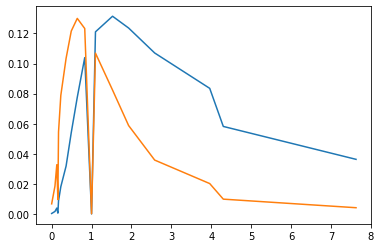

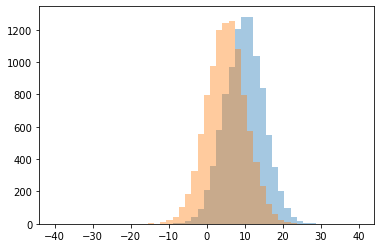

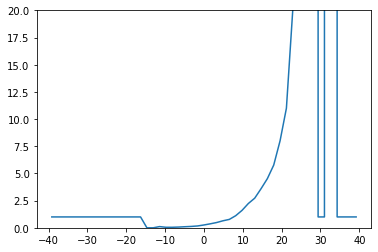

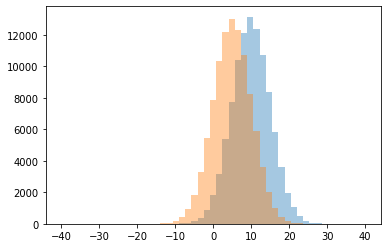

0 0.0
1 0.047619047619047616
2 0.06796116504854369
3 0.09836065573770492
4 0.1111111111111111
5 0.12615384615384614
6 0.16998191681735986
7 0.26032540675844806
8 0.3670756646216769
9 0.4853801169590643
10 0.6460176991150443
11 0.7730891719745223
12 1.0
13 1.1116236162361623
14 1.6015037593984962
15 2.235602094240838
16 2.723684210526316
17 3.594017094017094
18 4.524590163934426
19 5.770491803278689
20 8.0
21 11.0
22 20.0
23 999999.0




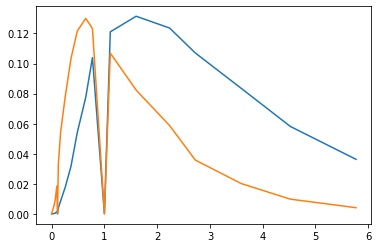

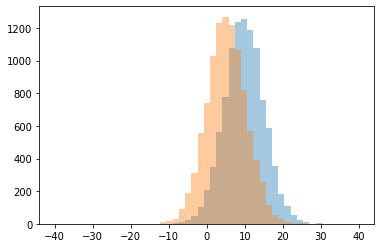

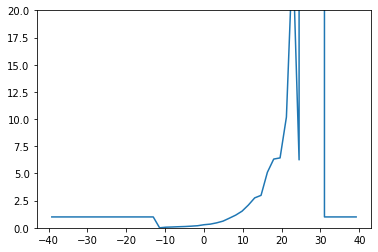

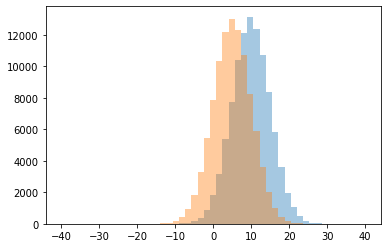

0 0.0
1 0.05555555555555555
2 0.07407407407407407
3 0.0989010989010989
4 0.11764705882352941
5 0.15064102564102563
6 0.19030520646319568
7 0.28263795423956933
8 0.33787731256085685
9 0.45565500406834825
10 0.6130811662726556
11 0.8841413311421529
12 1.0
13 1.1646284101599247
14 1.5274056029232643
15 2.0913884007029875
16 2.752551020408163
17 2.984251968503937
18 5.104347826086957
19 6.25
20 6.321428571428571
21 6.428571428571429
22 10.181818181818182
23 25.5
24 999999.0




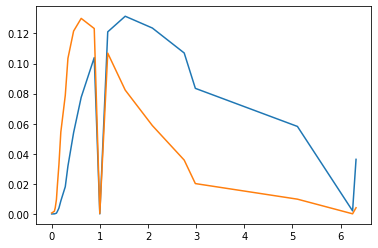

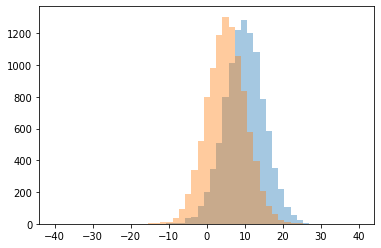

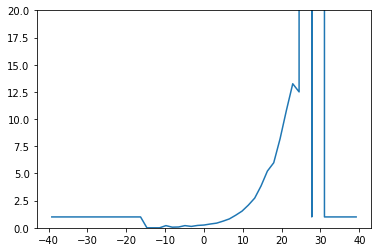

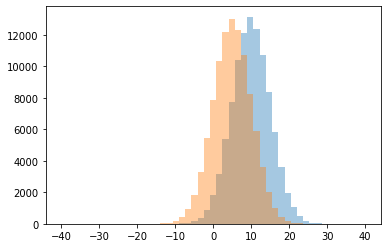

0 0.0
1 0.05714285714285714
2 0.07446808510638298
3 0.12759643916913946
4 0.2
5 0.21755725190839695
6 0.2537688442211055
7 0.34928716904276985
8 0.4294117647058823
9 0.6104294478527608
10 0.8172999191592563
11 1.0
12 1.1559546313799622
13 1.532777115613826
14 2.0866551126516466
15 2.731645569620253
16 3.848780487804878
17 5.214285714285714
18 5.983050847457627
19 8.185185185185185
20 10.8
21 12.5
22 13.25
23 999999.0




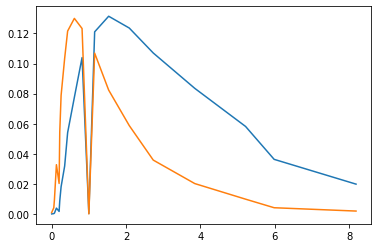

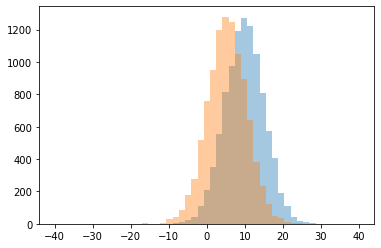

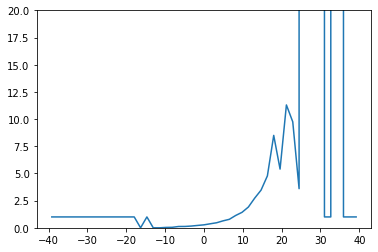

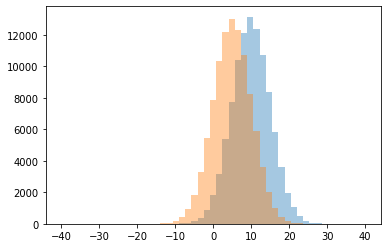

0 0.0
1 0.034482758620689655
2 0.045454545454545456
3 0.12048192771084337
4 0.12429378531073447
5 0.16071428571428573
6 0.21814671814671815
7 0.27212681638044917
8 0.3705263157894737
9 0.465
10 0.63828125
11 0.7808
12 1.0
13 1.1341579448144625
14 1.4228187919463087
15 1.9079563182527302
16 2.72987012987013
17 3.463519313304721
18 3.6
19 4.775
20 5.4
21 8.5
22 9.75
23 11.3
24 999999.0




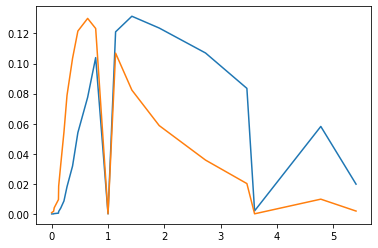

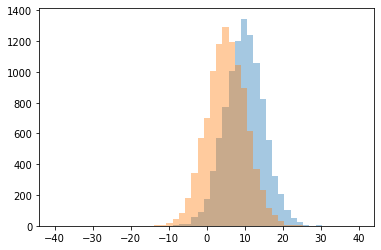

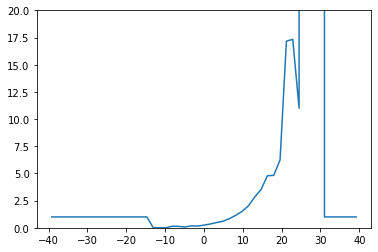

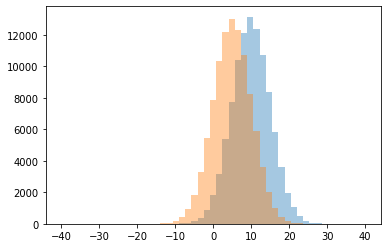

0 0.0
1 0.0782122905027933
2 0.13095238095238096
3 0.14634146341463414
4 0.16112084063047286
5 0.17595307917888564
6 0.24679029957203993
7 0.3501984126984127
8 0.4851569126378287
9 0.5995352439969016
10 0.8415758591785415
11 1.0
12 1.1450381679389312
13 1.5072788353863382
14 2.013008130081301
15 2.836021505376344
16 3.519148936170213
17 4.786324786324786
18 4.82089552238806
19 6.242424242424242
20 11.0
21 17.166666666666668
22 17.333333333333332
23 999999.0




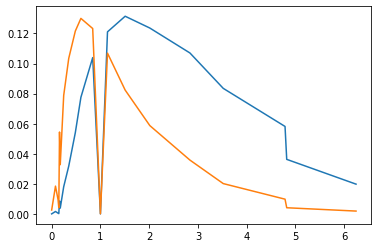

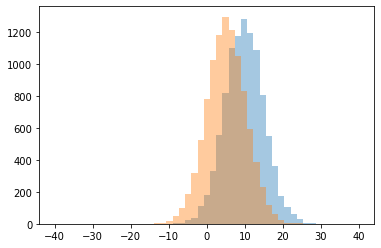

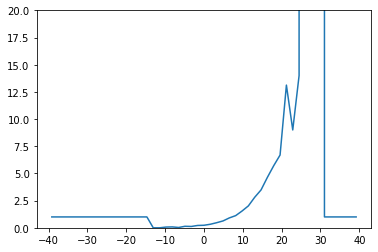

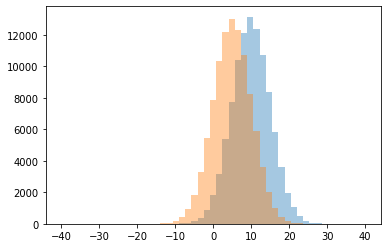

0 0.0
1 0.0297029702970297
2 0.06666666666666667
3 0.08163265306122448
4 0.12264150943396226
5 0.13903743315508021
6 0.21497120921305182
7 0.2326478149100257
8 0.3255131964809384
9 0.46864406779661016
10 0.6308880308880309
11 0.9098428453267163
12 1.0
13 1.1201143946615824
14 1.5416164053075996
15 2.0134907251264758
16 2.8082901554404147
17 3.4827586206896552
18 4.638655462184874
19 5.714285714285714
20 6.6923076923076925
21 9.0
22 13.125
23 14.0
24 999999.0




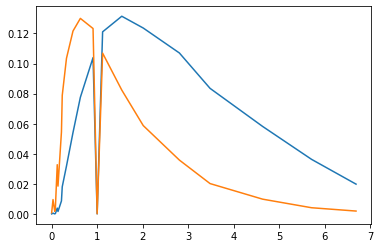

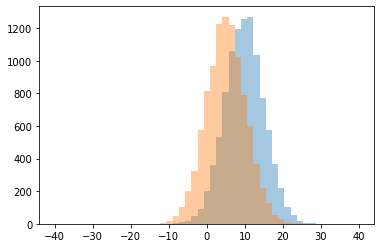

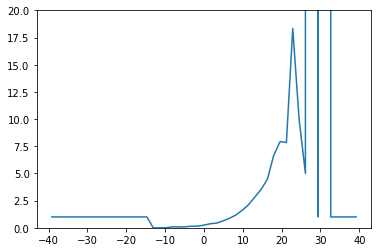

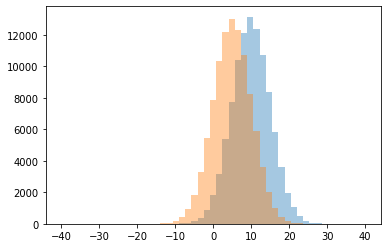

0 0.0
1 0.07766990291262135
2 0.08542713567839195
3 0.08888888888888889
4 0.1476923076923077
5 0.15304347826086956
6 0.2493857493857494
7 0.37163561076604557
8 0.4319478402607987
9 0.6362204724409449
10 0.8695652173913043
11 1.0
12 1.1648780487804877
13 1.5939086294416243
14 2.11
15 2.81029810298103
16 3.5251141552511416
17 4.465116279069767
18 5.0
19 6.672727272727273
20 7.846153846153846
21 7.928571428571429
22 10.0
23 18.333333333333332
24 999999.0




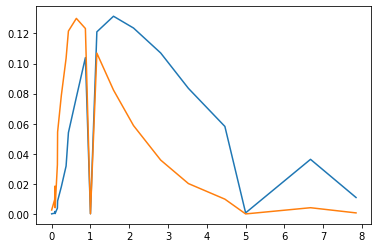

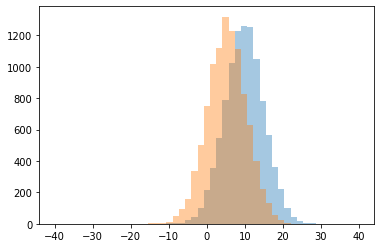

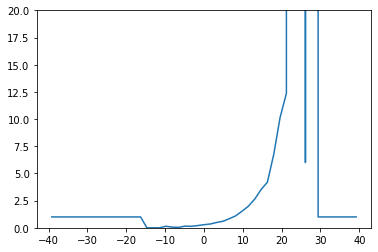

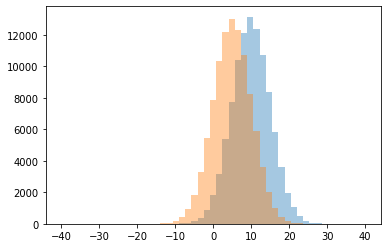

0 0.0
1 0.041237113402061855
2 0.061224489795918366
3 0.13432835820895522
4 0.14285714285714285
5 0.15384615384615385
6 0.2051792828685259
7 0.285140562248996
8 0.35
9 0.4910394265232975
10 0.5993930197268589
11 0.8382352941176471
12 1.0
13 1.0987432675044884
14 1.5254237288135593
15 1.9841521394611727
16 2.635678391959799
17 3.5135135135135136
18 4.1940298507462686
19 6.0
20 6.7407407407407405
21 10.136363636363637
22 12.375
23 999999.0




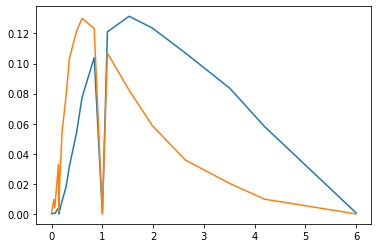

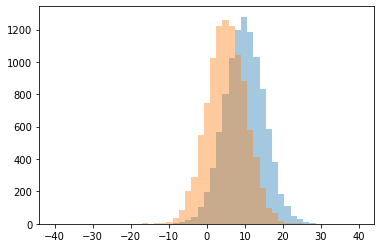

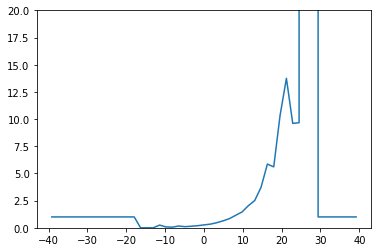

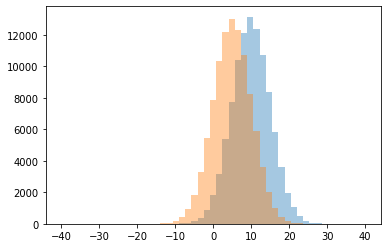

0 0.0
1 0.05714285714285714
2 0.08333333333333333
3 0.10344827586206896
4 0.14383561643835616
5 0.16470588235294117
6 0.19237749546279492
7 0.25
8 0.2667560321715818
9 0.33528265107212474
10 0.4664484451718494
11 0.6367961934972244
12 0.8392124692370796
13 1.0
14 1.15
15 1.4550625711035268
16 2.0343642611683848
17 2.504854368932039
18 3.7219730941704037
19 5.602941176470588
20 5.86
21 9.6
22 9.666666666666666
23 10.333333333333334
24 13.75
25 999999.0




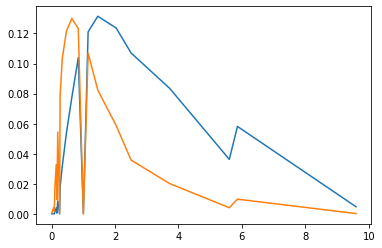

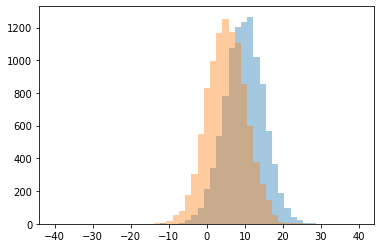

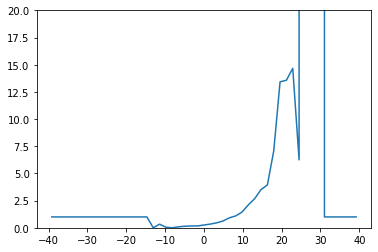

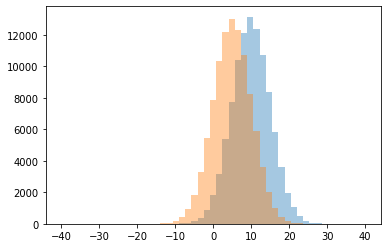

0 0.0
1 0.05263157894736842
2 0.08974358974358974
3 0.14367816091954022
4 0.16887417218543047
5 0.1736745886654479
6 0.2560386473429952
7 0.3333333333333333
8 0.3420260782347041
9 0.4571917808219178
10 0.6248
11 0.9173764906303237
12 1.0
13 1.0914855072463767
14 1.4473067915690867
15 2.1135225375626043
16 2.681578947368421
17 3.520661157024793
18 3.9375
19 6.25
20 7.0576923076923075
21 13.428571428571429
22 13.571428571428571
23 14.666666666666666
24 999999.0




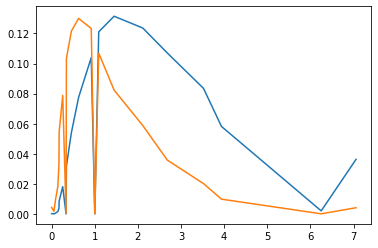

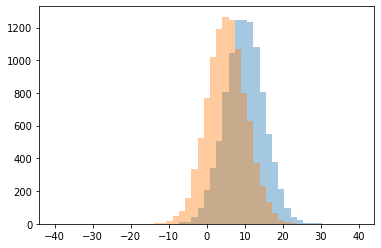

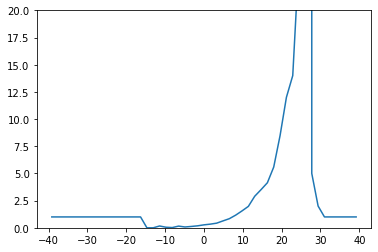

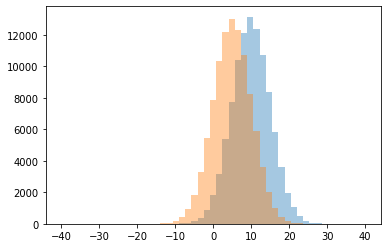

0 0.0
1 0.021739130434782608
2 0.05263157894736842
3 0.075
4 0.12349397590361445
5 0.15584415584415584
6 0.16666666666666666
7 0.18199233716475097
8 0.2714285714285714
9 0.33659491193737767
10 0.42676767676767674
11 0.6350710900473934
12 0.8380112269446672
13 1.0
14 1.165266106442577
15 1.55375
16 1.9696969696969697
17 2.0
18 2.900537634408602
19 3.508695652173913
20 4.143939393939394
21 5.0
22 5.588235294117647
23 8.48
24 12.0
25 14.0
26 25.0
27 999999.0




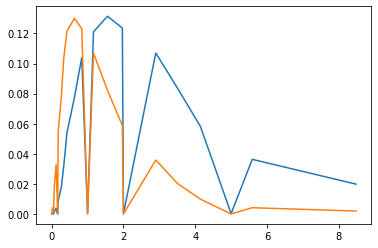

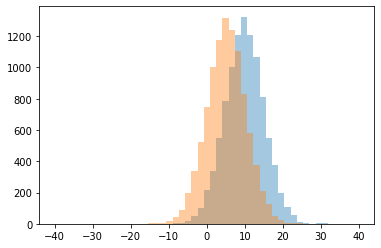

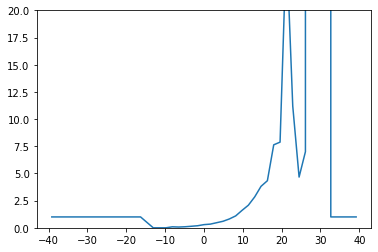

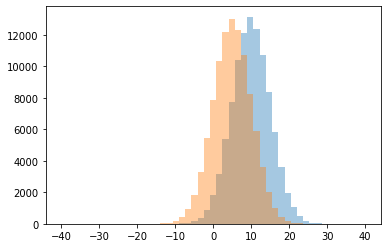

0 0.0
1 0.06976744186046512
2 0.09090909090909091
3 0.095
4 0.14029850746268657
5 0.1896551724137931
6 0.2916666666666667
7 0.338
8 0.4685374149659864
9 0.5
10 0.5993907083015994
11 0.8124494745351657
12 1.0
13 1.0941176470588236
14 1.6009673518742442
15 2.0774526678141134
16 2.8430851063829787
17 3.8160377358490565
18 4.330708661417323
19 4.666666666666667
20 7.0
21 7.63265306122449
22 7.88
23 11.2
24 26.25
25 999999.0




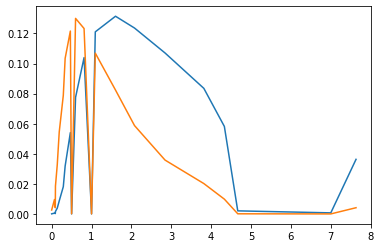

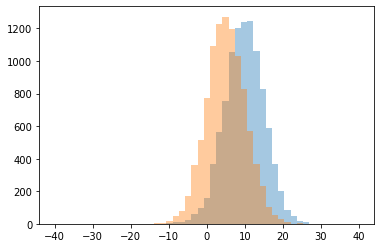

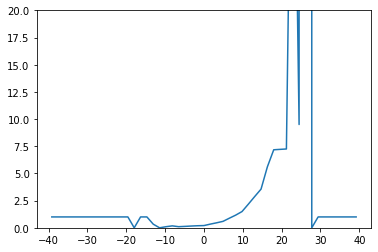

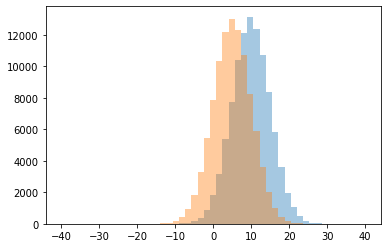

0 0.0
1 0.1
2 0.10256410256410256
3 0.1301775147928994
4 0.1620879120879121
5 0.17777777777777778
6 0.1895551257253385
7 0.20516129032258065
8 0.3333333333333333
9 0.3385321100917431
10 0.46016260162601624
11 0.5919811320754716
12 0.8824020016680567
13 1.0
14 1.1650485436893203
15 1.494571773220748
16 2.176265270506108
17 2.875338753387534
18 3.5579399141630903
19 5.609523809523809
20 7.176470588235294
21 7.214285714285714
22 7.25
23 9.5
24 50.0
25 999999.0




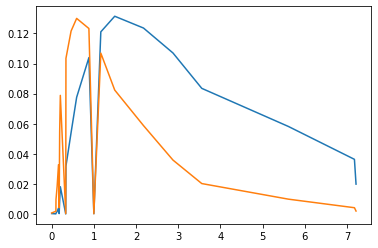

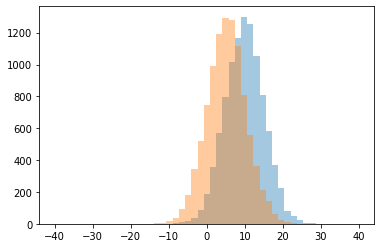

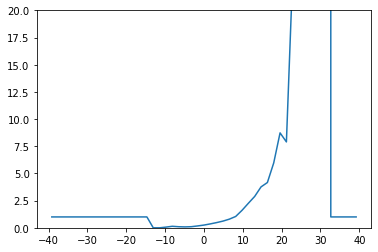

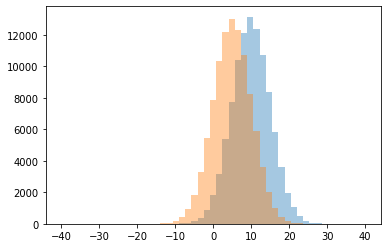

0 0.0
1 0.0625
2 0.08241758241758242
3 0.0989010989010989
4 0.10115606936416185
5 0.1388888888888889
6 0.17148362235067438
7 0.25100671140939596
8 0.358948432760364
9 0.4798994974874372
10 0.616576297443842
11 0.795774647887324
12 1.0
13 1.0420393559928445
14 1.6069221260815822
15 2.255855855855856
16 2.8873626373626373
17 3.7627906976744185
18 4.164285714285715
19 5.967741935483871
20 7.9
21 8.73076923076923
22 23.5
23 999999.0




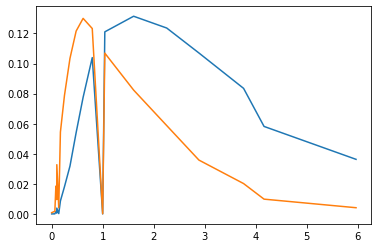

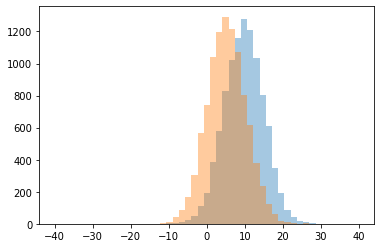

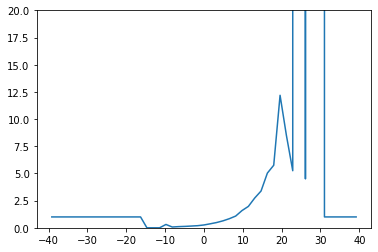

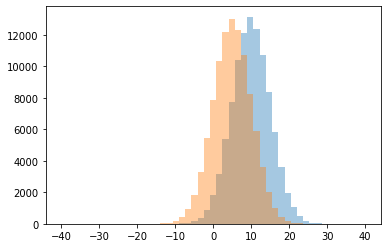

0 0.0
1 0.07317073170731707
2 0.10843373493975904
3 0.12941176470588237
4 0.1611842105263158
5 0.19469026548672566
6 0.260752688172043
7 0.3076923076923077
8 0.3691275167785235
9 0.48576214405360135
10 0.6408668730650154
11 0.8374384236453202
12 1.0
13 1.0791433891992552
14 1.585820895522388
15 1.9674267100977199
16 2.738095238095238
17 3.3823529411764706
18 4.5
19 5.033057851239669
20 5.25
21 5.754098360655738
22 8.5
23 12.1875
24 999999.0




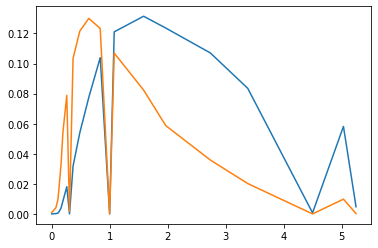

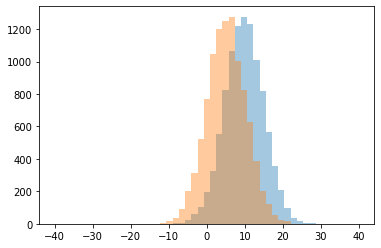

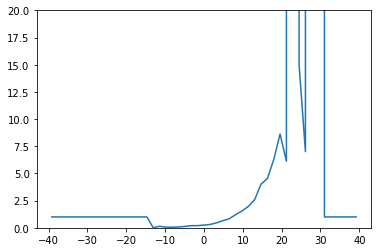

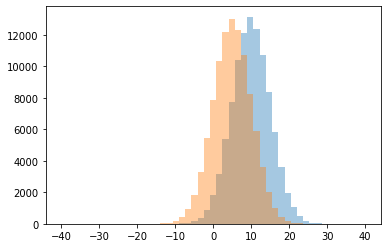

0 0.0
1 0.05714285714285714
2 0.058823529411764705
3 0.07692307692307693
4 0.12935323383084577
5 0.14285714285714285
6 0.19614147909967847
7 0.1988527724665392
8 0.25
9 0.3103448275862069
10 0.45802161263507896
11 0.6605431309904153
12 0.8338557993730408
13 1.0
14 1.215568862275449
15 1.5485436893203883
16 1.963258785942492
17 2.602067183462532
18 4.014705882352941
19 4.536
20 6.125
21 6.2631578947368425
22 7.0
23 8.625
24 15.0
25 999999.0




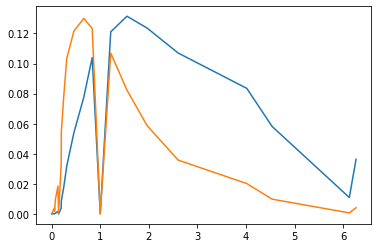

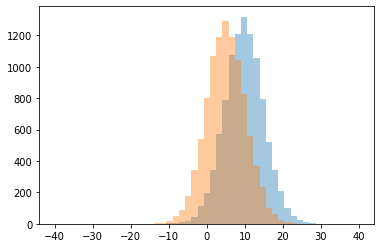

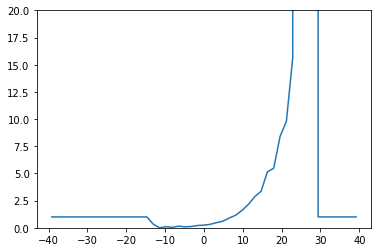

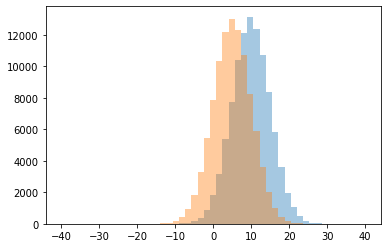

0 0.0
1 0.041666666666666664
2 0.0903954802259887
3 0.1
4 0.12058823529411765
5 0.14942528735632185
6 0.2140221402214022
7 0.2428035043804756
8 0.32209737827715357
9 0.3333333333333333
10 0.479394449116905
11 0.6106811145510835
12 0.9033613445378151
13 1.0
14 1.157088122605364
15 1.6007281553398058
16 2.1476868327402134
17 2.854054054054054
18 3.3586497890295357
19 5.138613861386139
20 5.483870967741935
21 8.4
22 9.8
23 15.666666666666666
24 999999.0




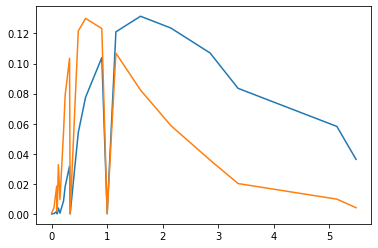

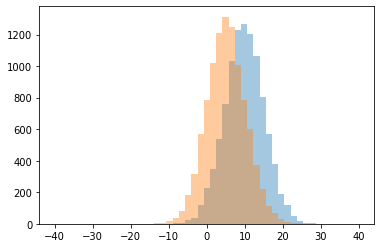

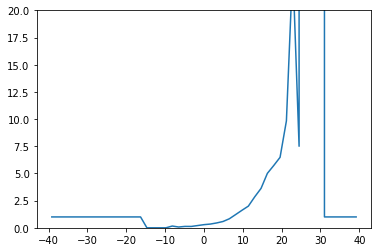

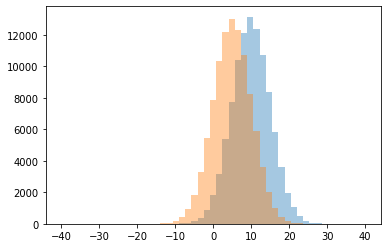

0 0.0
1 0.07228915662650602
2 0.12460063897763578
3 0.12777777777777777
4 0.16216216216216217
5 0.20701754385964913
6 0.289171974522293
7 0.3431372549019608
8 0.4461920529801324
9 0.5788271134805788
10 0.8297188755020081
11 1.0
12 1.2202380952380953
13 1.6145038167938932
14 1.9933774834437086
15 2.8453333333333335
16 3.6244343891402715
17 5.008771929824562
18 5.7272727272727275
19 6.482758620689655
20 7.5
21 9.833333333333334
22 24.0
23 999999.0




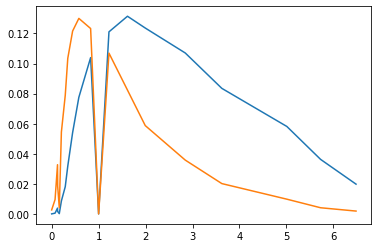

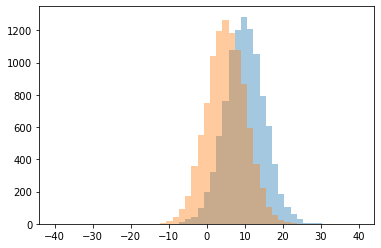

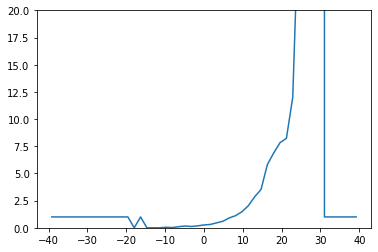

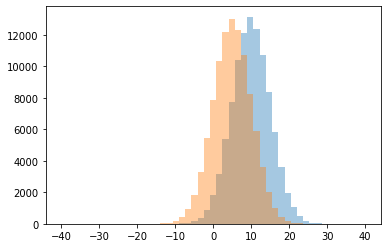

0 0.0
1 0.023809523809523808
2 0.05
3 0.10112359550561797
4 0.12290502793296089
5 0.16470588235294117
6 0.17883211678832117
7 0.2596537949400799
8 0.3102785782901057
9 0.45484949832775917
10 0.6033254156769596
11 0.9120135363790186
12 1.0
13 1.1189591078066914
14 1.4804147465437787
15 2.033613445378151
16 2.8559782608695654
17 3.528888888888889
18 5.8173076923076925
19 6.888888888888889
20 7.833333333333333
21 8.23076923076923
22 12.0
23 30.0
24 999999.0




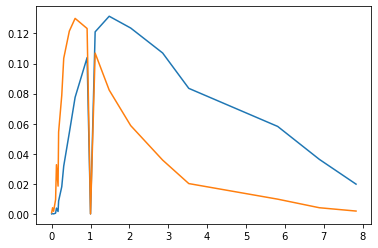

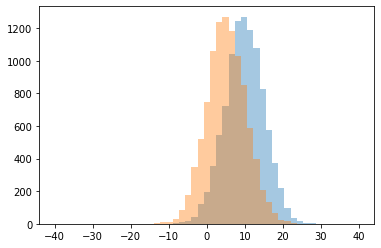

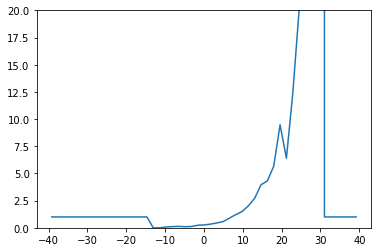

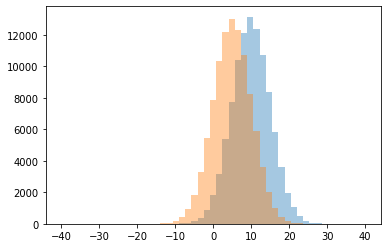

0 0.0
1 0.07142857142857142
2 0.10227272727272728
3 0.1111111111111111
4 0.11714285714285715
5 0.12941176470588237
6 0.23224568138195778
7 0.26336898395721925
8 0.3352165725047081
9 0.4413904607922393
10 0.5672698662470496
11 0.8807106598984772
12 1.0
13 1.2101167315175096
14 1.4917647058823529
15 2.01864406779661
16 2.722921914357683
17 3.9617224880382773
18 4.313432835820896
19 5.666666666666667
20 6.4
21 9.478260869565217
22 12.333333333333334
23 20.0
24 999999.0




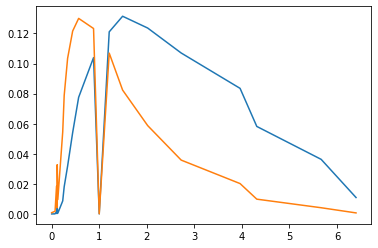

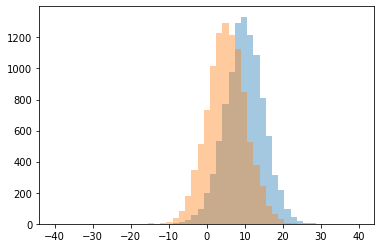

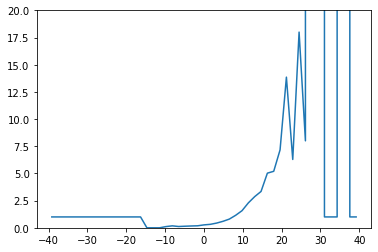

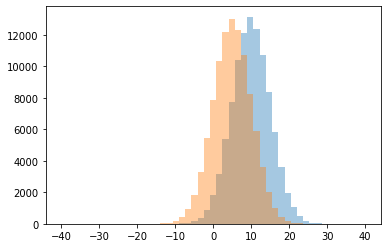

0 0.0
1 0.1111111111111111
2 0.11904761904761904
3 0.1452513966480447
4 0.16714697406340057
5 0.1794871794871795
6 0.18446601941747573
7 0.2680272108843537
8 0.3188548864758144
9 0.43474714518760194
10 0.596749226006192
11 0.8016460905349794
12 1.0
13 1.1515151515151516
14 1.5737898465171192
15 2.2930056710775046
16 2.8680738786279685
17 3.34297520661157
18 5.0265486725663715
19 5.19672131147541
20 6.285714285714286
21 7.166666666666667
22 8.0
23 13.857142857142858
24 18.0
25 999999.0




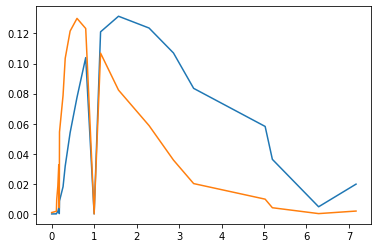

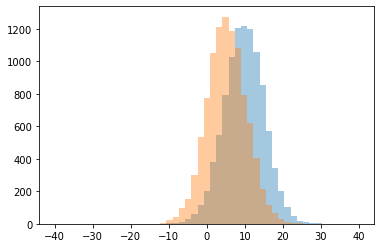

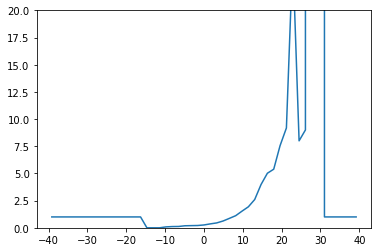

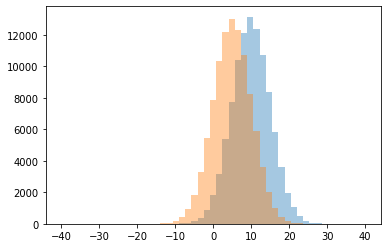

0 0.0
1 0.08333333333333333
2 0.11363636363636363
3 0.12244897959183673
4 0.18666666666666668
5 0.2
6 0.21082089552238806
7 0.26098191214470284
8 0.36087369420702753
9 0.44810543657331137
10 0.6227450980392157
11 0.8650927487352446
12 1.0
13 1.113573407202216
14 1.5326633165829147
15 1.930756843800322
16 2.600985221674877
17 3.9813084112149535
18 5.017543859649122
19 5.390625
20 7.555555555555555
21 8.0
22 9.0
23 9.181818181818182
24 25.0
25 999999.0




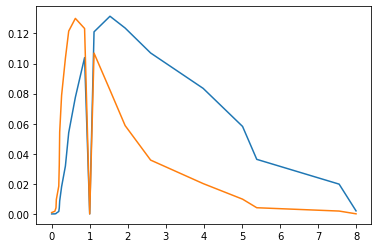

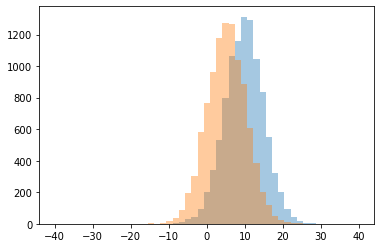

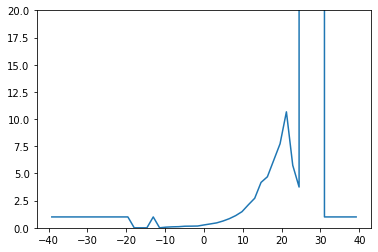

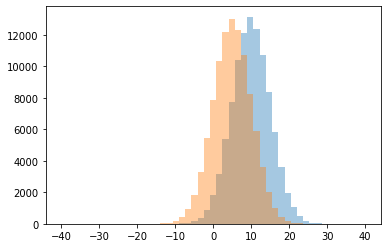

0 0.0
1 0.058823529411764705
2 0.08823529411764706
3 0.10344827586206896
4 0.14507772020725387
5 0.15181518151815182
6 0.1623931623931624
7 0.2627450980392157
8 0.35625
9 0.4523809523809524
10 0.6238244514106583
11 0.8403162055335969
12 1.0
13 1.1206563706563706
14 1.4852941176470589
15 2.1180327868852458
16 2.7161458333333335
17 3.75
18 4.175
19 4.6923076923076925
20 5.75
21 6.211538461538462
22 7.730769230769231
23 10.666666666666666
24 999999.0




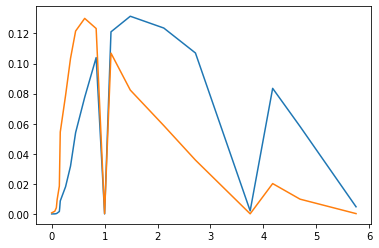

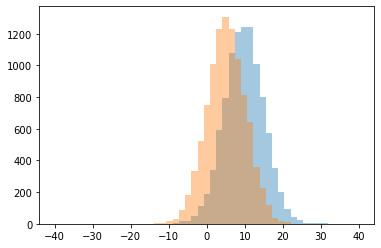

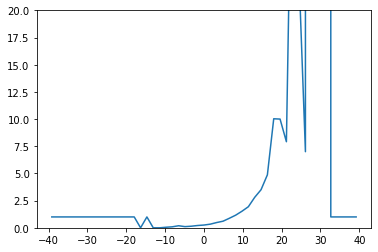

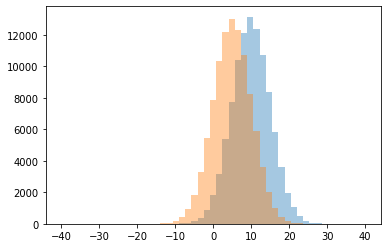

0 0.0
1 0.05
2 0.09090909090909091
3 0.10810810810810811
4 0.14583333333333334
5 0.18888888888888888
6 0.21113243761996162
7 0.2536520584329349
8 0.3353115727002967
9 0.4833468724614135
10 0.6055045871559633
11 0.875609756097561
12 1.0
13 1.162032598274209
14 1.527027027027027
15 1.9390625
16 2.8027777777777776
17 3.502183406113537
18 4.872881355932203
19 7.0
20 7.916666666666667
21 10.0
22 10.028571428571428
23 23.0
24 42.0
25 999999.0




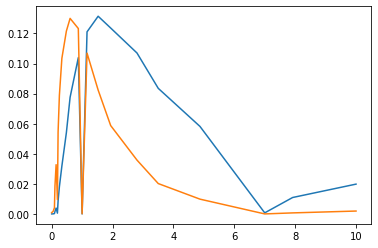

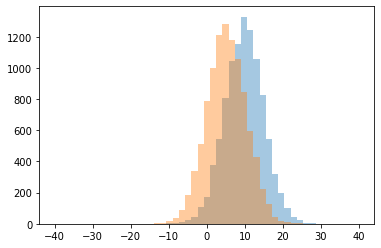

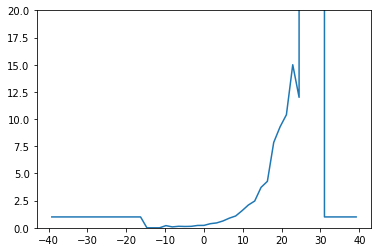

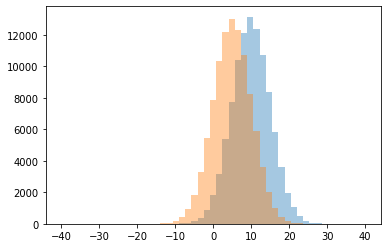

0 0.0
1 0.08333333333333333
2 0.12087912087912088
3 0.1348973607038123
4 0.13793103448275862
5 0.2
6 0.21611001964636542
7 0.22208121827411167
8 0.3776223776223776
9 0.44966996699669964
10 0.629976580796253
11 0.8872881355932203
12 1.0
13 1.0869565217391304
14 1.5697399527186762
15 2.095959595959596
16 2.4627906976744187
17 3.7162162162162162
18 4.2734375
19 7.853658536585366
20 9.285714285714286
21 10.4
22 12.0
23 15.0
24 999999.0




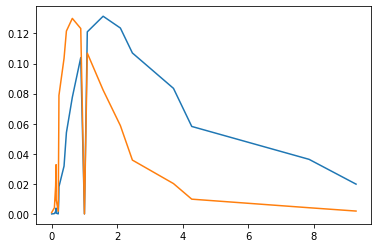

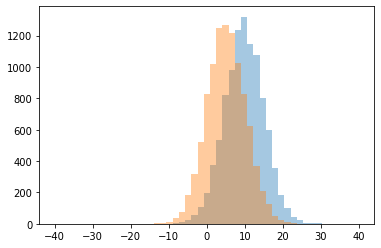

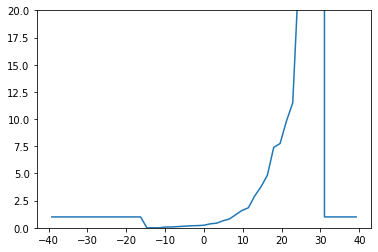

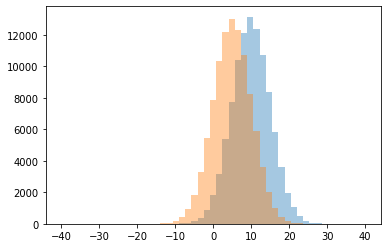

0 0.0
1 0.07692307692307693
2 0.11538461538461539
3 0.14835164835164835
4 0.18670886075949367
5 0.20114942528735633
6 0.23458282950423218
7 0.3656862745098039
8 0.42582197273456296
9 0.6458990536277602
10 0.805761316872428
11 1.0
12 1.2052785923753666
13 1.5980629539951574
14 1.842443729903537
15 2.932065217391304
16 3.7735849056603774
17 4.838709677419355
18 7.395833333333333
19 7.75
20 9.8
21 11.5
22 24.0
23 999999.0




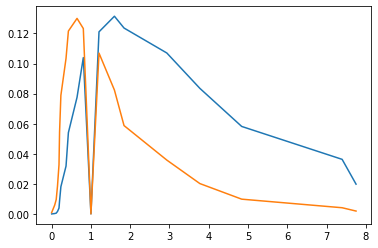

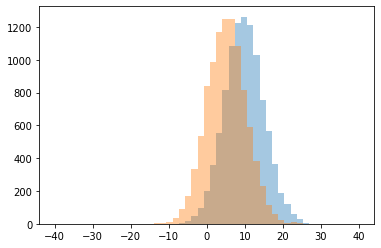

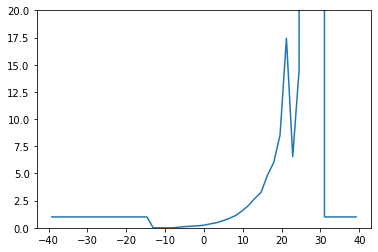

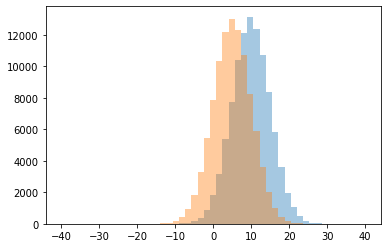

0 0.0
1 0.05555555555555555
2 0.1111111111111111
3 0.1437125748502994
4 0.17757009345794392
5 0.2413793103448276
6 0.36133603238866396
7 0.47386461011139674
8 0.6546762589928058
9 0.8672
10 1.0
11 1.1320406278855033
12 1.5535055350553506
13 2.040472175379427
14 2.68848167539267
15 3.2543103448275863
16 4.82051282051282
17 6.0
18 6.555555555555555
19 8.545454545454545
20 14.5
21 17.428571428571427
22 999999.0




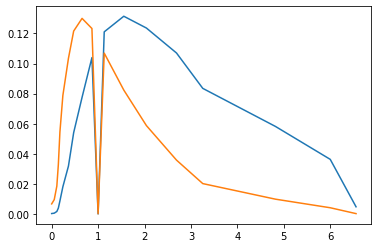

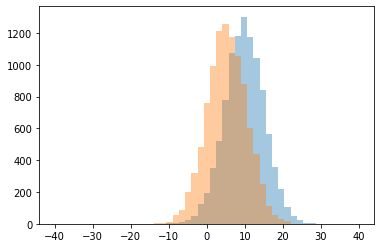

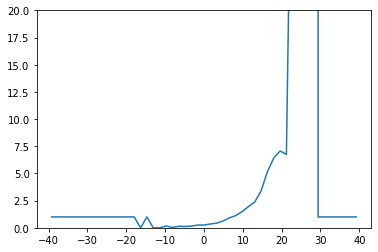

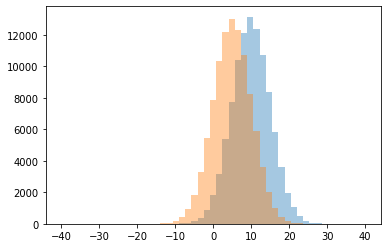

0 0.0
1 0.034482758620689655
2 0.1218274111675127
3 0.13793103448275862
4 0.1540880503144654
5 0.16666666666666666
6 0.25102880658436216
7 0.2513157894736842
8 0.3515151515151515
9 0.4289256198347107
10 0.6202229299363057
11 0.9148936170212766
12 1.0
13 1.1213270142180094
14 1.4823663253697383
15 1.943801652892562
16 2.3704545454545456
17 3.3775100401606424
18 5.154545454545454
19 6.410714285714286
20 6.75
21 7.064516129032258
22 46.0
23 999999.0




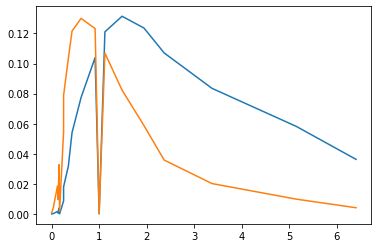

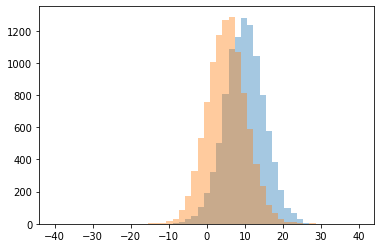

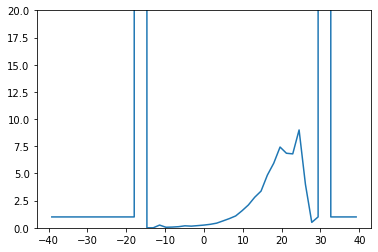

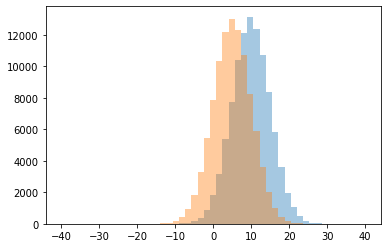

0 0.0
1 0.05
2 0.06666666666666667
3 0.10344827586206896
4 0.1519756838905775
5 0.18181818181818182
6 0.19962335216572505
7 0.25
8 0.2503311258278146
9 0.32075471698113206
10 0.42772108843537415
11 0.5
12 0.6338582677165354
13 0.8462732919254659
14 1.0
15 1.0909090909090908
16 1.5661764705882353
17 2.098471986417657
18 2.8086253369272236
19 3.3755274261603376
20 4.0
21 4.848739495798319
22 5.938461538461539
23 6.8
24 6.857142857142857
25 7.428571428571429
26 9.0
27 999999.0




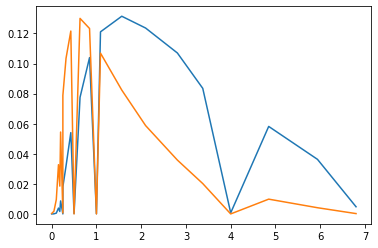

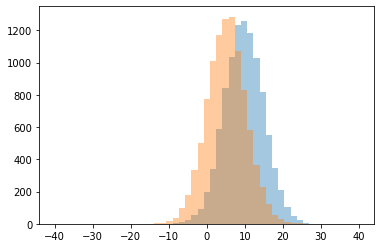

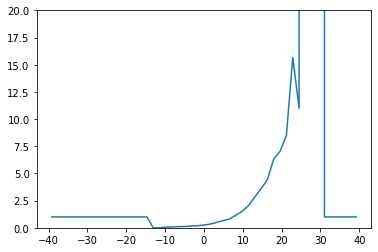

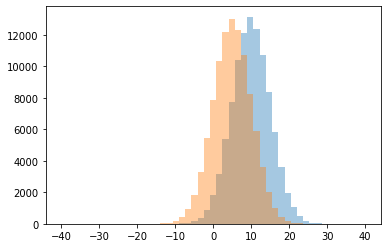

0 0.0
1 0.06666666666666667
2 0.08108108108108109
3 0.11224489795918367
4 0.11602209944751381
5 0.16566265060240964
6 0.1848906560636183
7 0.25611325611325614
8 0.33762376237623765
9 0.5025597269624573
10 0.6614173228346457
11 0.8054474708171206
12 1.0
13 1.1471135940409682
14 1.5096153846153846
15 2.029059829059829
16 2.8114754098360657
17 3.590308370044053
18 4.432
19 6.327272727272727
20 7.033333333333333
21 8.5
22 11.0
23 15.666666666666666
24 999999.0




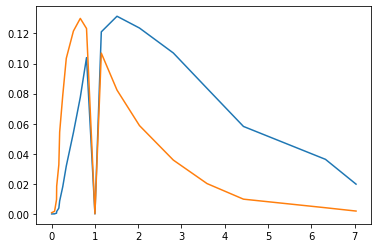

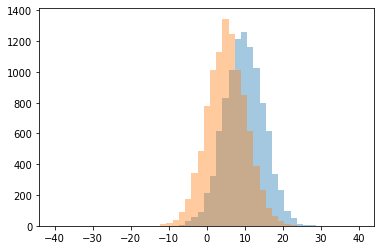

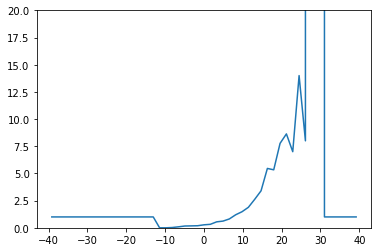

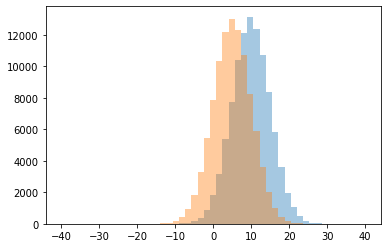

0 0.0
1 0.02631578947368421
2 0.09090909090909091
3 0.16477272727272727
4 0.17595307917888564
5 0.19008264462809918
6 0.2740076824583867
7 0.31948565776458954
8 0.5474711623779946
9 0.61635687732342
10 0.813953488372093
11 1.0
12 1.1980295566502464
13 1.4782608695652173
14 1.8833063209076175
15 2.6189258312020463
16 3.4017094017094016
17 5.333333333333333
18 5.460176991150442
19 7.0
20 7.766666666666667
21 8.0
22 8.636363636363637
23 14.0
24 999999.0




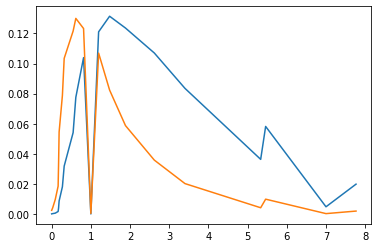

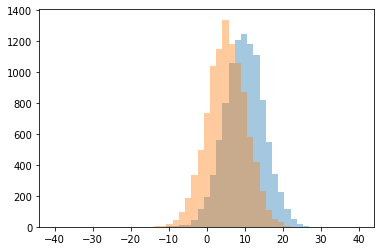

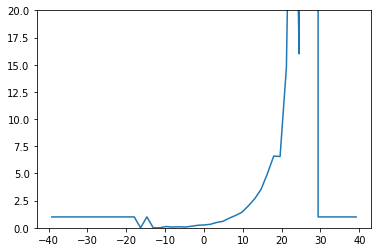

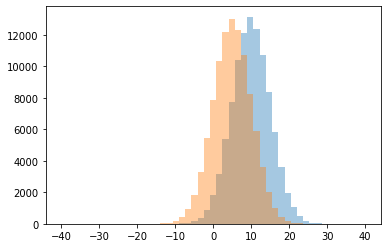

0 0.0
1 0.06666666666666667
2 0.06989247311827956
3 0.09473684210526316
4 0.11764705882352941
5 0.13988095238095238
6 0.22937625754527163
7 0.26294277929155313
8 0.32208293153326906
9 0.4895833333333333
10 0.5974607916355489
11 0.8919831223628693
12 1.0
13 1.1385485391140433
14 1.432183908045977
15 2.0222984562607205
16 2.668269230769231
17 3.536796536796537
18 4.972727272727273
19 6.5588235294117645
20 6.596153846153846
21 14.75
22 16.0
23 51.0
24 999999.0




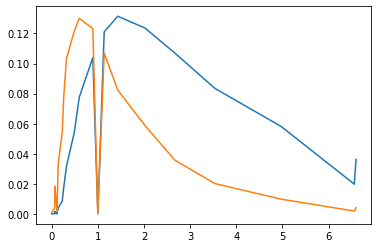

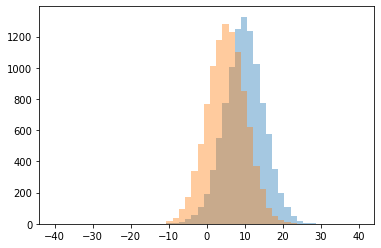

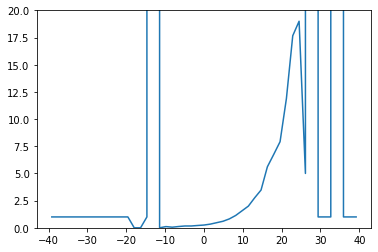

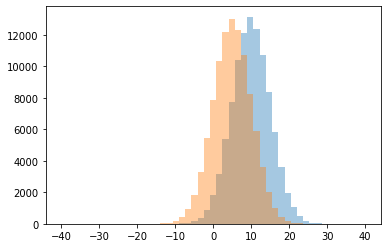

0 0.0
1 0.05555555555555555
2 0.1111111111111111
3 0.11827956989247312
4 0.16666666666666666
5 0.16715542521994134
6 0.212890625
7 0.25326370757180156
8 0.33794466403162055
9 0.47023809523809523
10 0.6009353078721746
11 0.8186991869918699
12 1.0
13 1.1345454545454545
14 1.56301531213192
15 1.9935483870967743
16 2.7628032345013476
17 3.472972972972973
18 5.0
19 5.611650485436893
20 6.75
21 7.92
22 11.88888888888889
23 17.666666666666668
24 19.0
25 999999.0




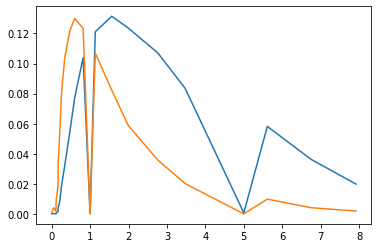

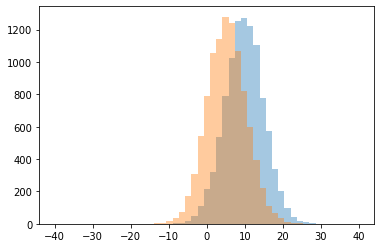

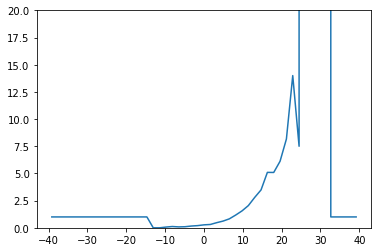

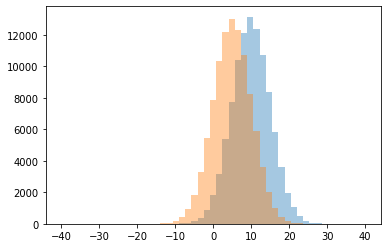

0 0.0
1 0.06666666666666667
2 0.08333333333333333
3 0.09826589595375723
4 0.11764705882352941
5 0.16129032258064516
6 0.20036764705882354
7 0.2715736040609137
8 0.3058712121212121
9 0.4707423580786026
10 0.615625
11 0.8230088495575221
12 1.0
13 1.17196261682243
14 1.5550122249388754
15 2.043405676126878
16 2.7954545454545454
17 3.484304932735426
18 5.08955223880597
19 5.097345132743363
20 6.121212121212121
21 7.5
22 8.166666666666666
23 14.0
24 999999.0




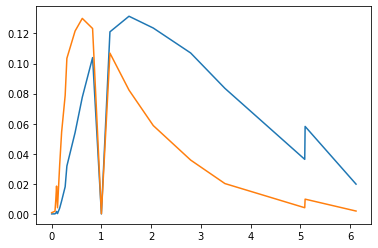

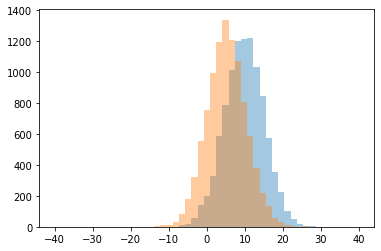

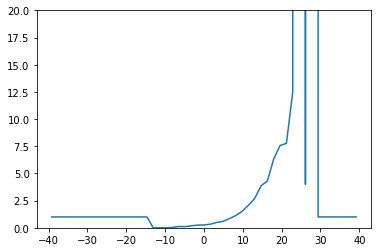

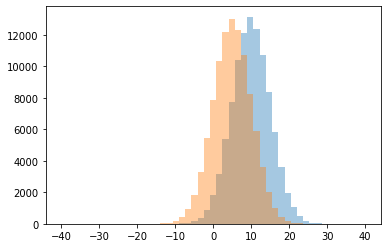

0 0.0
1 0.03333333333333333
2 0.11049723756906077
3 0.11904761904761904
4 0.17846153846153845
5 0.2495511669658887
6 0.2605820105820106
7 0.33098591549295775
8 0.4928751047778709
9 0.5892457057505601
10 0.8410596026490066
11 1.0
12 1.1194029850746268
13 1.5062034739454093
14 2.0694915254237287
15 2.7049608355091386
16 3.86697247706422
17 4.0
18 4.298507462686567
19 6.339285714285714
20 7.566666666666666
21 7.769230769230769
22 12.5
23 999999.0




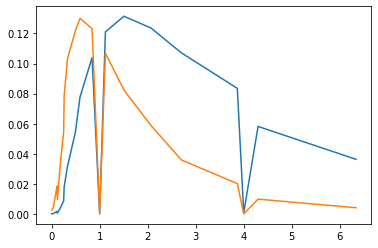

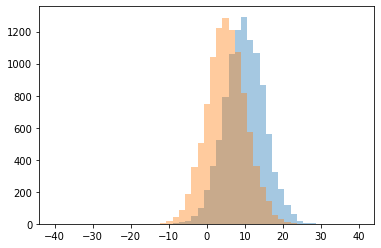

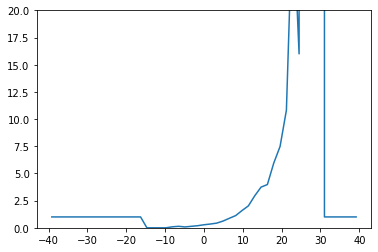

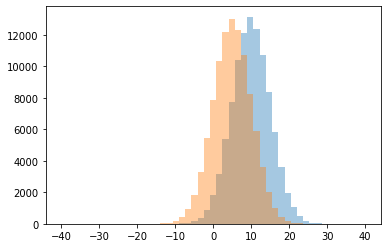

0 0.0
1 0.0797872340425532
2 0.09090909090909091
3 0.13636363636363635
4 0.19207920792079208
5 0.2796271637816245
6 0.345821325648415
7 0.42868852459016393
8 0.6177847113884556
9 0.8752066115702479
10 1.0
11 1.1227906976744186
12 1.5865030674846625
13 2.0140105078809105
14 2.9392265193370166
15 3.74025974025974
16 3.978723404255319
17 5.944444444444445
18 7.482758620689655
19 10.818181818181818
20 16.0
21 29.5
22 999999.0




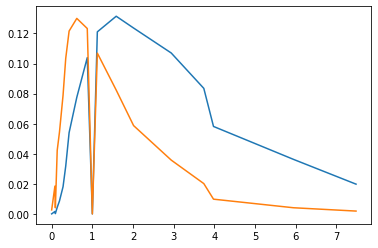

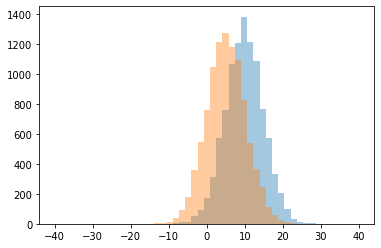

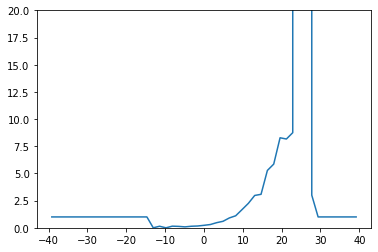

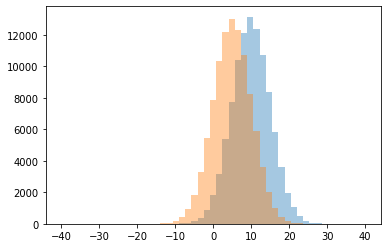

0 0.0
1 0.08522727272727272
2 0.13043478260869565
3 0.14206128133704735
4 0.14285714285714285
5 0.15
6 0.1657559198542805
7 0.22823218997361477
8 0.3004784688995215
9 0.47165160230073955
10 0.5968627450980392
11 0.9066213921901528
12 1.0
13 1.1050228310502284
14 1.6723095525997582
15 2.248148148148148
16 2.9754098360655736
17 3.0
18 3.0803212851405624
19 5.275229357798165
20 5.859649122807017
21 8.166666666666666
22 8.28
23 8.75
24 999999.0




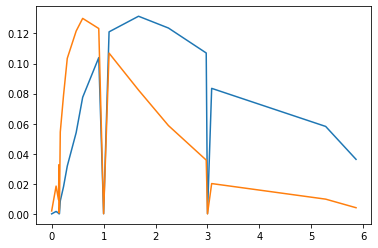

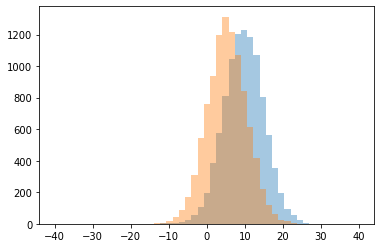

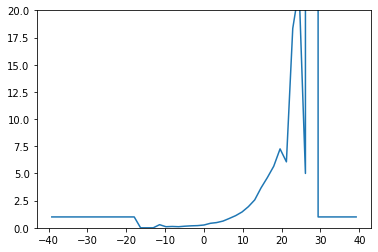

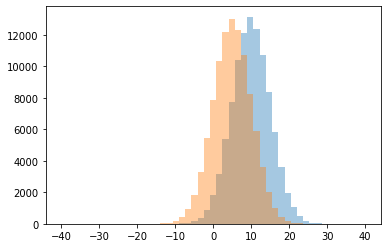

0 0.0
1 0.1
2 0.12195121951219512
3 0.14792899408284024
4 0.18181818181818182
5 0.2011070110701107
6 0.25624178712220763
7 0.2857142857142857
8 0.41220556745182013
9 0.4816053511705686
10 0.6184310738766184
11 0.8616144975288303
12 1.0
13 1.119291705498602
14 1.4544378698224851
15 1.9427168576104745
16 2.5645933014354068
17 3.671232876712329
18 4.622950819672131
19 5.0
20 5.661290322580645
21 6.066666666666666
22 7.2592592592592595
23 18.333333333333332
24 22.0
25 999999.0




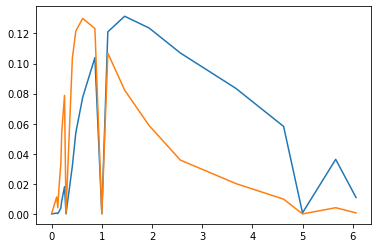

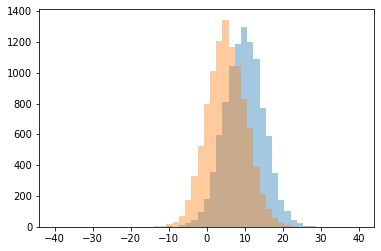

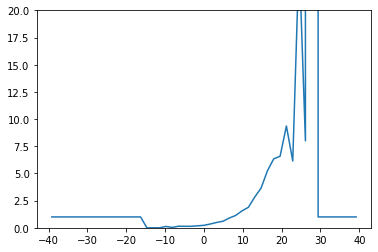

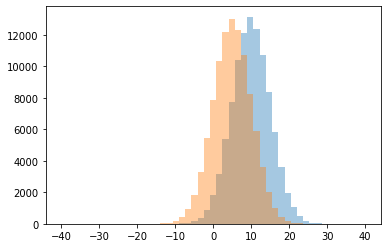

0 0.0
1 0.034482758620689655
2 0.125
3 0.13636363636363635
4 0.13897280966767372
5 0.14705882352941177
6 0.1859582542694497
7 0.22710163111668757
8 0.35014836795252224
9 0.4921161825726141
10 0.6019345238095238
11 0.8986254295532646
12 1.0
13 1.135755258126195
14 1.5583634175691938
15 1.8824451410658307
16 2.8233766233766233
17 3.6462264150943398
18 5.230088495575221
19 6.142857142857143
20 6.345454545454546
21 6.576923076923077
22 8.0
23 9.363636363636363
24 25.0
25 999999.0




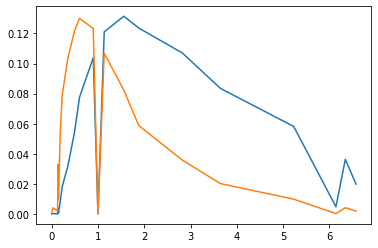

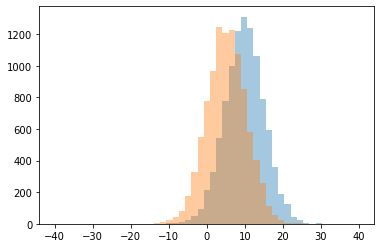

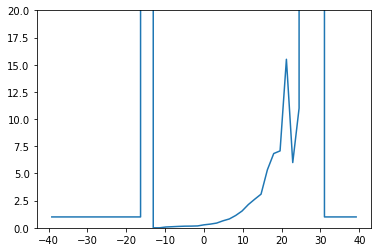

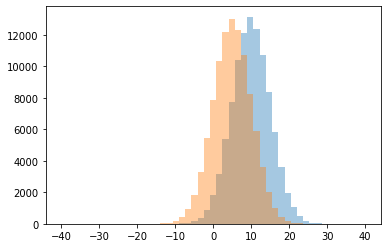

0 0.0
1 0.07407407407407407
2 0.1
3 0.1282051282051282
4 0.14942528735632185
5 0.15501519756838905
6 0.17184643510054845
7 0.2728442728442728
8 0.33954451345755693
9 0.4344328238133548
10 0.6437448218724109
11 0.8140293637846656
12 1.0
13 1.133147113594041
14 1.5411764705882354
15 2.140138408304498
16 2.627791563275434
17 3.09375
18 5.333333333333333
19 6.0
20 6.830188679245283
21 7.074074074074074
22 11.0
23 15.5
24 999999.0




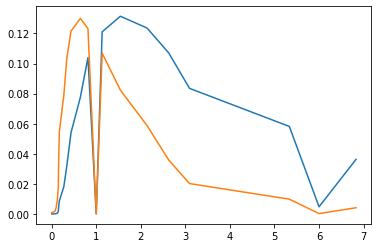

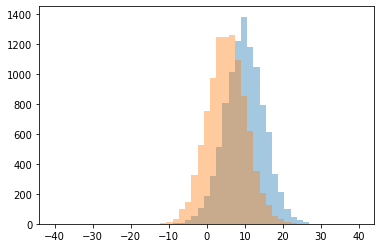

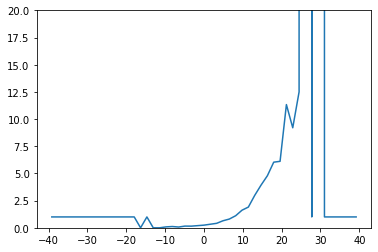

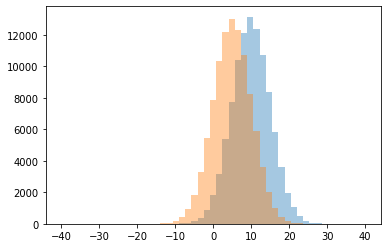

0 0.0
1 0.0707070707070707
2 0.08333333333333333
3 0.11764705882352941
4 0.1519756838905775
5 0.1564625850340136
6 0.19848771266540643
7 0.24435590969455512
8 0.32786885245901637
9 0.4117174959871589
10 0.6471531676022454
11 0.8047619047619048
12 1.0
13 1.1111111111111112
14 1.6198830409356726
15 1.9063004846526657
16 2.9800569800569803
17 3.9261083743842367
18 4.7890625
19 6.036363636363636
20 6.114285714285714
21 9.2
22 11.333333333333334
23 12.5
24 999999.0




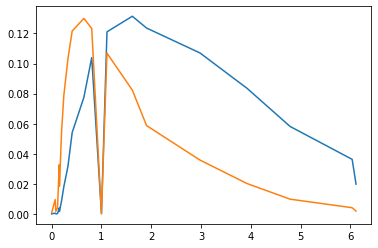

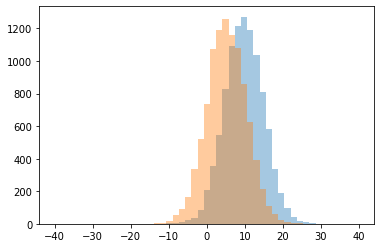

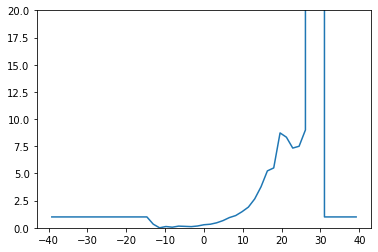

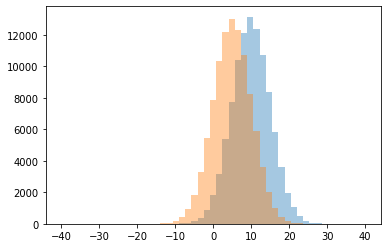

0 0.0
1 0.05454545454545454
2 0.10714285714285714
3 0.11764705882352941
4 0.1317365269461078
5 0.15384615384615385
6 0.16634799235181644
7 0.28125
8 0.32898415657036345
9 0.3333333333333333
10 0.4597315436241611
11 0.6616242038216561
12 0.9380378657487092
13 1.0
14 1.1251158480074144
15 1.4790697674418605
16 1.901116427432217
17 2.657289002557545
18 3.7757009345794392
19 5.2342342342342345
20 5.508196721311475
21 7.333333333333333
22 7.5
23 8.333333333333334
24 8.727272727272727
25 9.0
26 999999.0




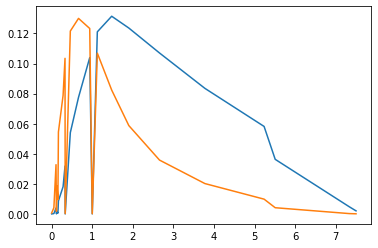

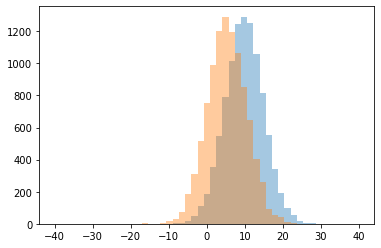

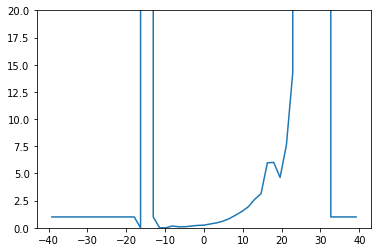

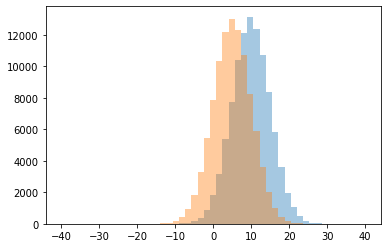

0 0.0
1 0.0945945945945946
2 0.0962566844919786
3 0.16129032258064516
4 0.16666666666666666
5 0.2198443579766537
6 0.2423841059602649
7 0.3562753036437247
8 0.45341098169717137
9 0.6134779240898528
10 0.8476987447698745
11 1.0
12 1.1671361502347417
13 1.511137162954279
14 1.93944099378882
15 2.620347394540943
16 3.142857142857143
17 4.634146341463414
18 5.978494623655914
19 6.017543859649122
20 7.615384615384615
21 14.25
22 999999.0




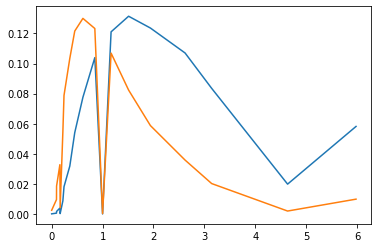

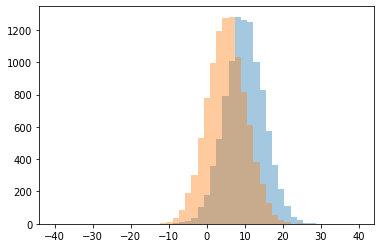

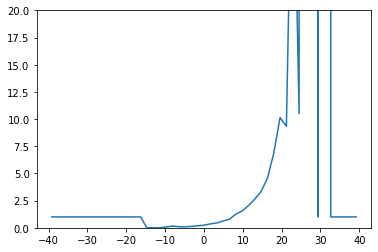

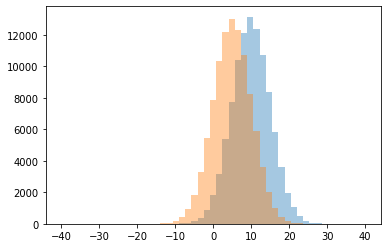

0 0.0
1 0.07142857142857142
2 0.09473684210526316
3 0.10344827586206896
4 0.12871287128712872
5 0.16216216216216217
6 0.19101123595505617
7 0.23234916559691912
8 0.36072144288577157
9 0.4412751677852349
10 0.6223446105428796
11 0.7875
12 1.0
13 1.2446601941747573
14 1.5421245421245422
15 2.035830618892508
16 2.6230366492146597
17 3.3293172690763053
18 4.5396825396825395
19 6.849056603773585
20 9.333333333333334
21 10.142857142857142
22 10.5
23 40.0
24 999999.0




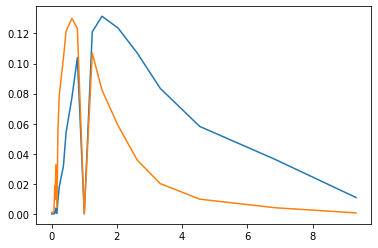

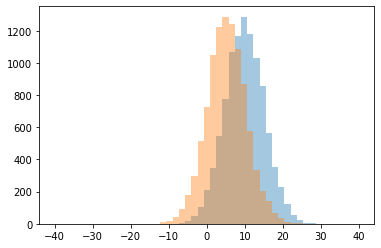

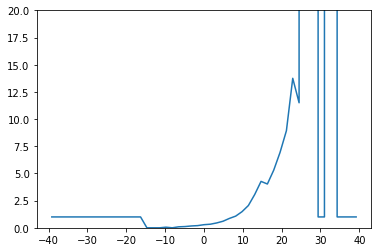

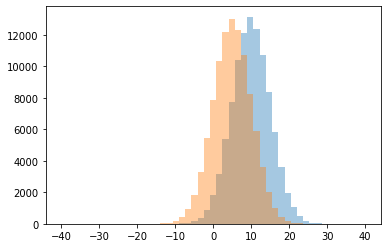

0 0.0
1 0.05555555555555555
2 0.0898876404494382
3 0.11363636363636363
4 0.16835016835016836
5 0.20077972709551656
6 0.28591160220994477
7 0.32983794089609153
8 0.4461663947797716
9 0.602952602952603
10 0.8605962933118453
11 1.0
12 1.0735970561177552
13 1.4826789838337182
14 2.046875
15 3.0623145400593472
16 4.0285714285714285
17 4.268656716417911
18 5.303030303030303
19 6.9393939393939394
20 8.928571428571429
21 11.5
22 13.75
23 999999.0




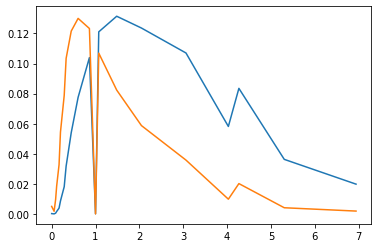

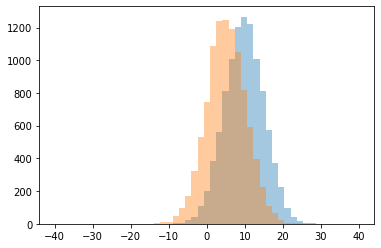

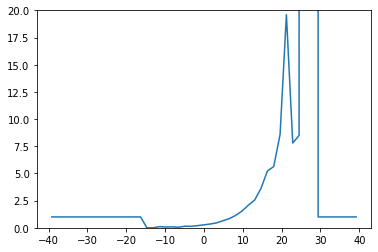

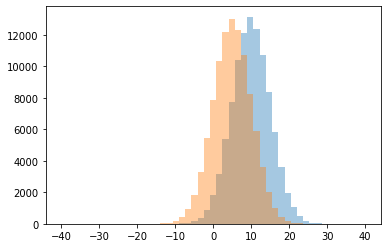

0 0.0
1 0.05154639175257732
2 0.07142857142857142
3 0.0851063829787234
4 0.1111111111111111
5 0.13395638629283488
6 0.14705882352941177
7 0.2026266416510319
8 0.27211796246648795
9 0.349862258953168
10 0.45410628019323673
11 0.6514056224899598
12 0.8471872376154492
13 1.0
14 1.141634980988593
15 1.5439024390243903
16 2.0747028862478776
17 2.5569620253164556
18 3.6412556053811658
19 5.218181818181818
20 5.636363636363637
21 7.8
22 8.5
23 8.576923076923077
24 19.6
25 999999.0




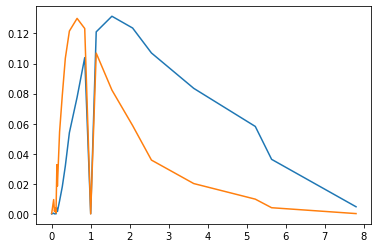

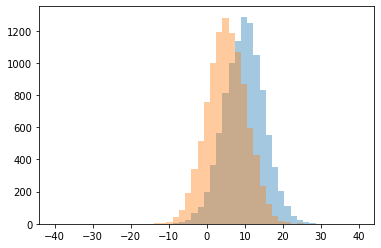

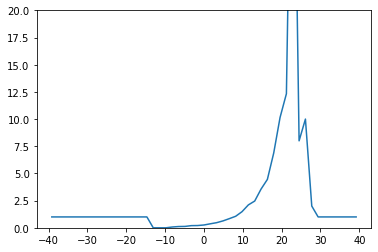

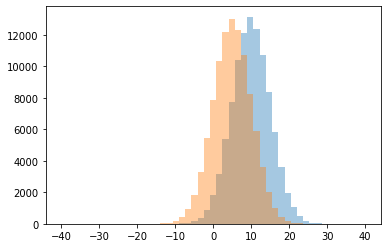

0 0.0
1 0.07317073170731707
2 0.11627906976744186
3 0.12698412698412698
4 0.19883040935672514
5 0.20817120622568094
6 0.25862068965517243
7 0.368
8 0.471872376154492
9 0.634585289514867
10 0.842327150084317
11 1.0
12 1.060747663551402
13 1.4827188940092166
14 2.0
15 2.106239460370995
16 2.460093896713615
17 3.5598290598290596
18 4.451612903225806
19 6.882352941176471
20 8.0
21 10.0
22 10.15
23 12.333333333333334
24 48.0




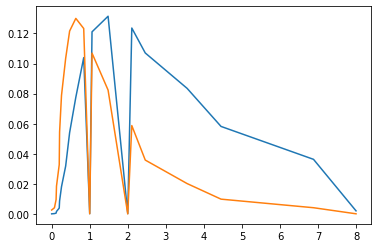

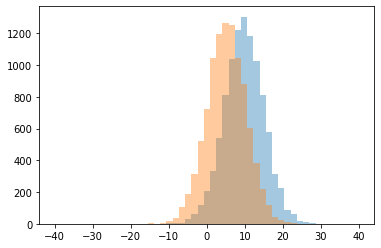

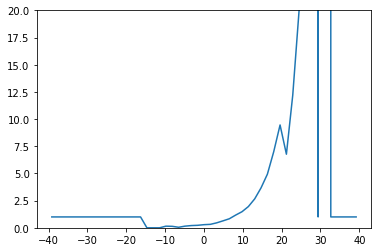

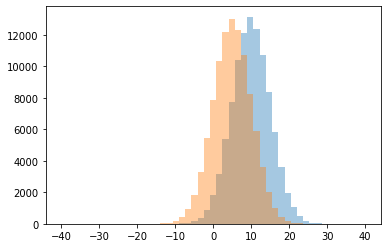

0 0.0
1 0.04854368932038835
2 0.13513513513513514
3 0.15
4 0.15135135135135136
5 0.20512820512820512
6 0.22884615384615384
7 0.2875
8 0.31709646609360076
9 0.4551550712489522
10 0.6393054459352802
11 0.8312
12 1.0
13 1.170989433237272
14 1.4801362088535754
15 1.9521452145214522
16 2.660621761658031
17 3.672727272727273
18 4.931623931623932
19 6.769230769230769
20 7.0
21 9.458333333333334
22 12.2
23 20.0
24 999999.0




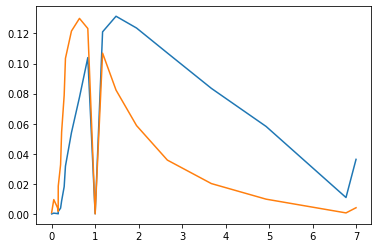

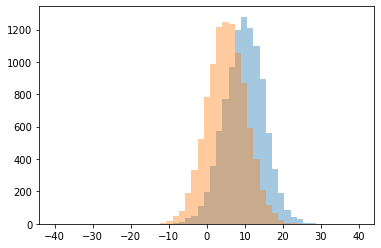

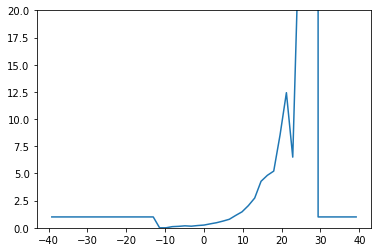

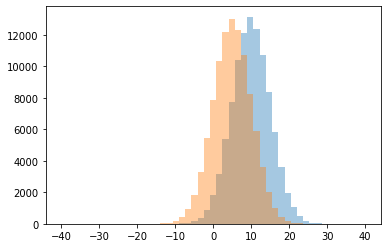

0 0.0
1 0.10638297872340426
2 0.13414634146341464
3 0.14803625377643503
4 0.18085106382978725
5 0.2072936660268714
6 0.25095541401273885
7 0.36446700507614216
8 0.47034596375617793
9 0.6172938350680545
10 0.784727863525589
11 1.0
12 1.1374407582938388
13 1.468427095292767
14 2.0388513513513513
15 2.7381546134663344
16 4.277511961722488
17 4.827586206896552
18 5.2153846153846155
19 6.5
20 8.545454545454545
21 12.428571428571429
22 27.0
23 999999.0




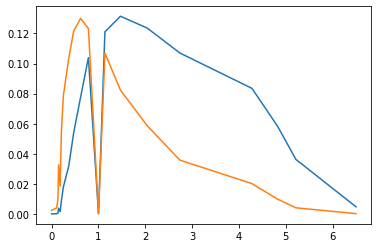

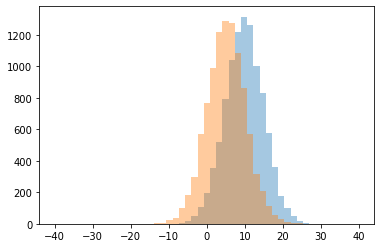

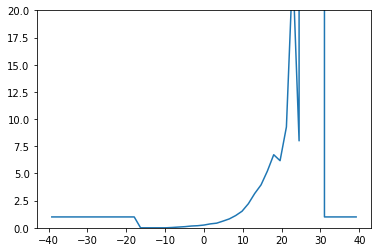

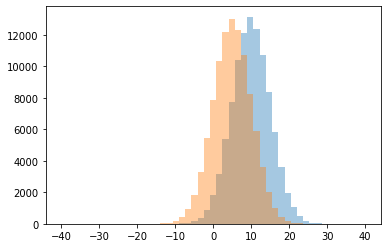

0 0.0
1 0.029411764705882353
2 0.06862745098039216
3 0.1043956043956044
4 0.16333333333333333
5 0.19223985890652556
6 0.25326370757180156
7 0.3602421796165489
8 0.4262295081967213
9 0.6160436137071651
10 0.8198269079464988
11 1.0
12 1.1266173752310535
13 1.522595596755504
14 2.2144112478031635
15 3.1545741324921135
16 3.947619047619048
17 5.218181818181818
18 6.172413793103448
19 6.722222222222222
20 8.0
21 9.272727272727273
22 24.0
23 999999.0




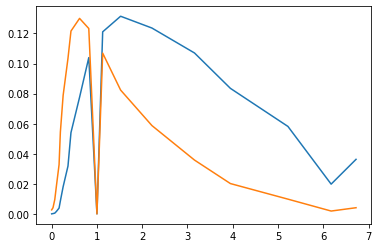

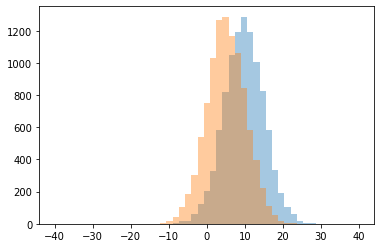

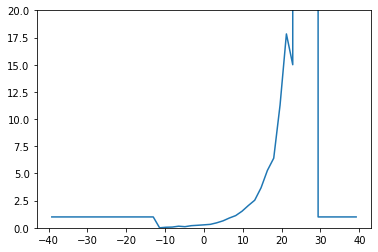

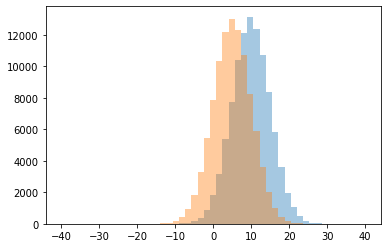

0 0.0
1 0.05
2 0.06666666666666667
3 0.10215053763440861
4 0.14705882352941177
5 0.19536423841059603
6 0.23148148148148148
7 0.272
8 0.31681243926141883
9 0.4570527974783294
10 0.6391270459859704
11 0.8999144568006844
12 1.0
13 1.1212406015037595
14 1.5248815165876777
15 2.0481927710843375
16 2.5353535353535355
17 3.6785714285714284
18 5.2727272727272725
19 6.403846153846154
20 11.294117647058824
21 15.0
22 17.833333333333332
23 999999.0




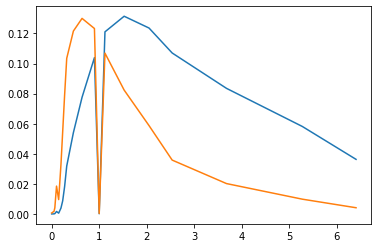

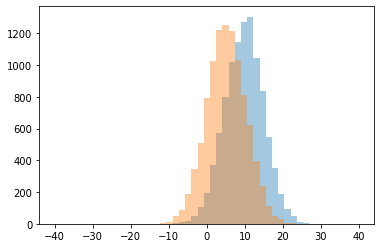

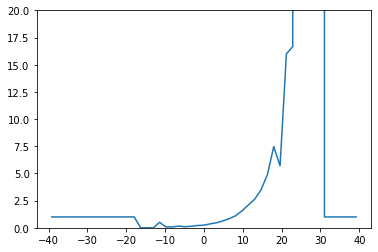

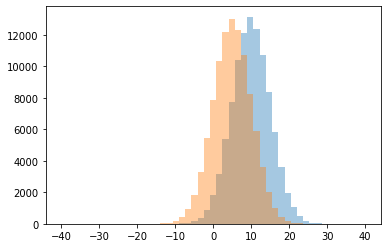

0 0.0
1 0.07692307692307693
2 0.08
3 0.09574468085106383
4 0.14035087719298245
5 0.15555555555555556
6 0.2125984251968504
7 0.24116161616161616
8 0.364613880742913
9 0.4677023712183156
10 0.5
11 0.636073423782921
12 0.8431048720066061
13 1.0
14 1.1135922330097088
15 1.561576354679803
16 2.0964630225080385
17 2.630653266331658
18 3.493723849372385
19 4.883928571428571
20 5.696969696969697
21 7.468085106382978
22 16.0
23 16.666666666666668
24 999999.0




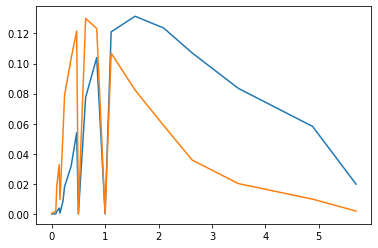

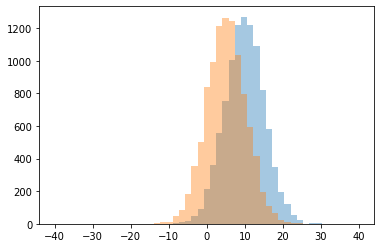

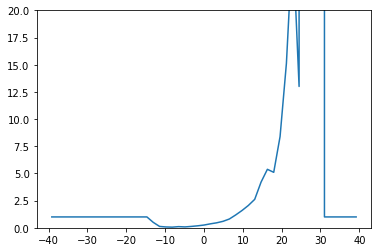

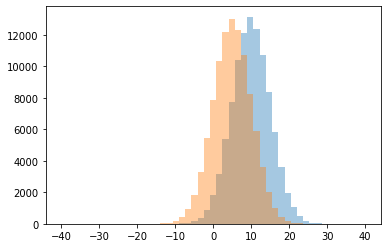

0 0.06
1 0.07692307692307693
2 0.08152173913043478
3 0.10714285714285714
4 0.125
5 0.12640449438202248
6 0.18253968253968253
7 0.2529691211401425
8 0.36363636363636365
9 0.45843621399176954
10 0.5
11 0.5949367088607594
12 0.8082191780821918
13 1.0
14 1.1819941916747339
15 1.5914786967418546
16 2.0556492411467118
17 2.6153846153846154
18 4.198979591836735
19 5.102941176470588
20 5.37962962962963
21 8.391304347826088
22 13.0
23 15.125
24 26.5
25 999999.0




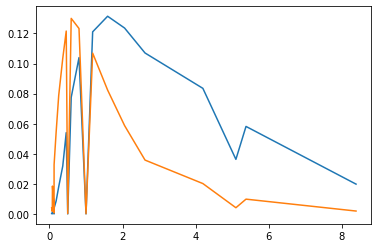

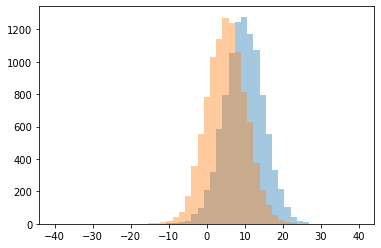

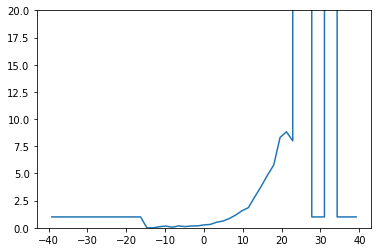

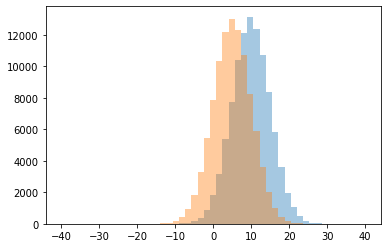

0 0.0
1 0.05128205128205128
2 0.1
3 0.11046511627906977
4 0.15789473684210525
5 0.16666666666666666
6 0.17333333333333334
7 0.17753623188405798
8 0.2659846547314578
9 0.3119533527696793
10 0.5126859142607174
11 0.6237234878240377
12 0.8531073446327684
13 1.0
14 1.1756373937677054
15 1.5680981595092025
16 1.8541996830427891
17 2.8386243386243386
18 3.7904761904761903
19 4.826086956521739
20 5.771929824561403
21 8.0
22 8.307692307692308
23 8.833333333333334
24 999999.0




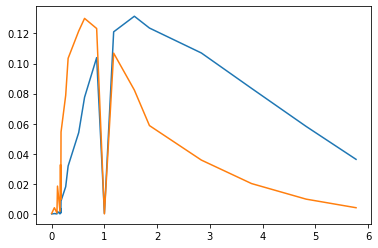

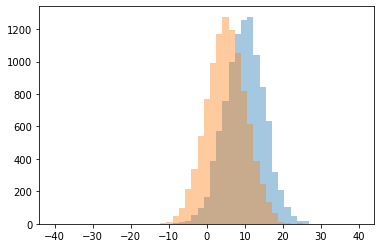

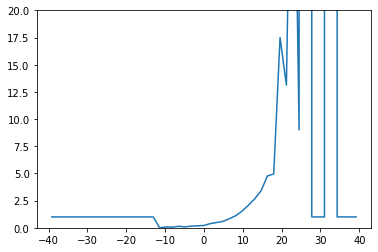

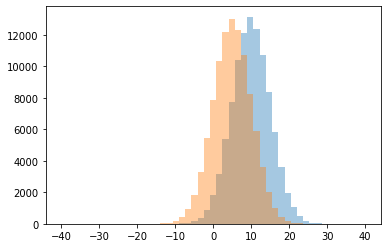

0 0.0
1 0.061224489795918366
2 0.07692307692307693
3 0.08490566037735849
4 0.13541666666666666
5 0.1572700296735905
6 0.18232044198895028
7 0.21688311688311687
8 0.38872104733131924
9 0.488013698630137
10 0.5929411764705882
11 0.8365465213746857
12 1.0
13 1.1131178707224334
14 1.531059683313033
15 2.0747967479674796
16 2.6683804627249357
17 3.4008097165991904
18 4.7669172932330826
19 4.953846153846154
20 9.0
21 13.125
22 17.5
23 48.0
24 999999.0




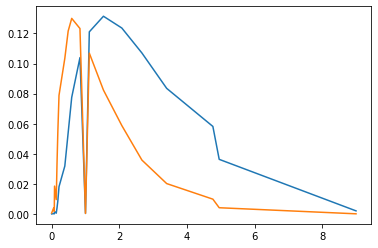

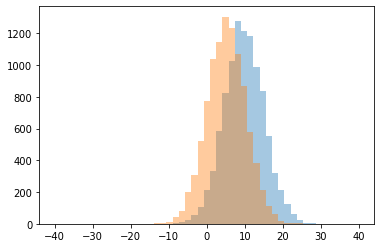

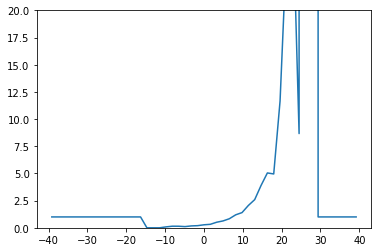

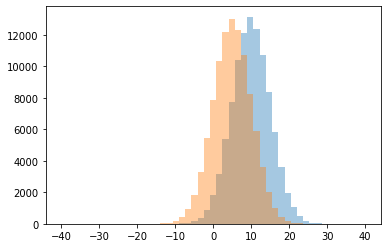

0 0.0
1 0.08333333333333333
2 0.11
3 0.14457831325301204
4 0.14634146341463414
5 0.17207792207792208
6 0.19694072657743786
7 0.2761290322580645
8 0.32019230769230766
9 0.5117698343504795
10 0.6314176245210728
11 0.8325242718446602
12 1.0
13 1.1930970149253732
14 1.3983926521239953
15 2.053726169844021
16 2.5916230366492146
17 3.8930232558139535
18 4.953125
19 5.045454545454546
20 8.666666666666666
21 11.666666666666666
22 25.4
23 29.5
24 999999.0




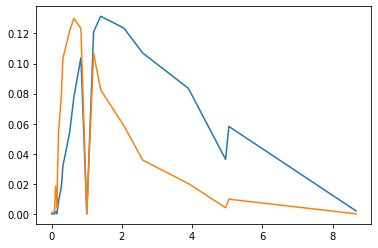

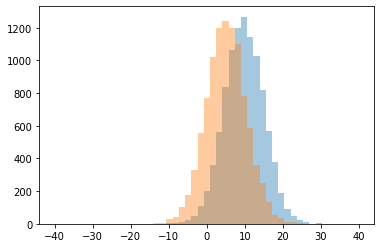

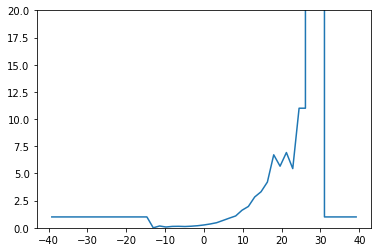

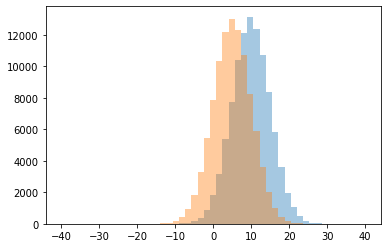

0 0.0
1 0.07142857142857142
2 0.11797752808988764
3 0.1282051282051282
4 0.13725490196078433
5 0.14678899082568808
6 0.16666666666666666
7 0.19099099099099098
8 0.2613195342820181
9 0.3535749265426053
10 0.4691666666666667
11 0.6771589991928975
12 0.8890742285237698
13 1.0
14 1.08983666061706
15 1.6152866242038217
16 1.9623287671232876
17 2.834710743801653
18 3.314516129032258
19 4.207407407407407
20 5.444444444444445
21 5.666666666666667
22 6.714285714285714
23 6.923076923076923
24 11.0
25 999999.0




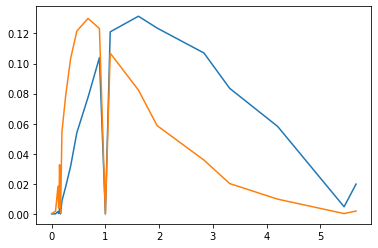

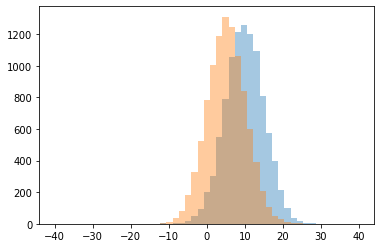

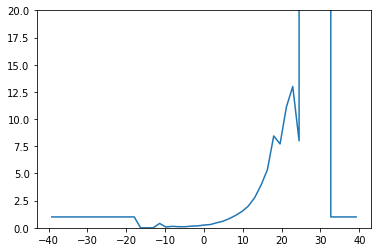

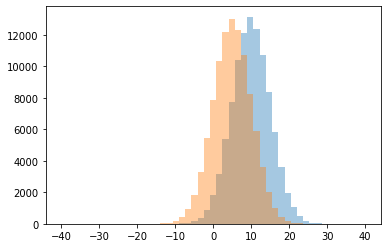

0 0.0
1 0.07142857142857142
2 0.09836065573770492
3 0.09876543209876543
4 0.13513513513513514
5 0.1524390243902439
6 0.17557251908396945
7 0.2541507024265645
8 0.299800796812749
9 0.4
10 0.4617968094038623
11 0.6045801526717557
12 0.8470209339774557
13 1.0
14 1.1440677966101696
15 1.5041816009557945
16 2.0
17 2.78117048346056
18 3.9223300970873787
19 5.333333333333333
20 7.714285714285714
21 8.0
22 8.446808510638299
23 11.11111111111111
24 13.0
25 999999.0




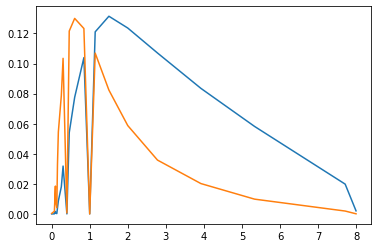

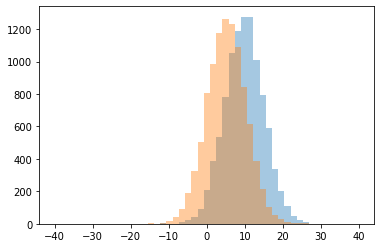

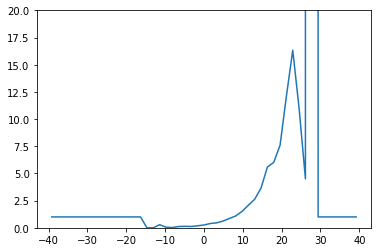

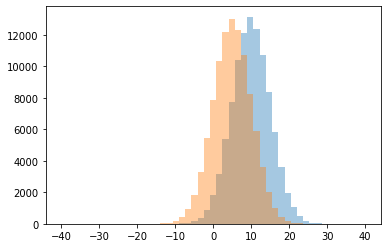

0 0.0
1 0.023809523809523808
2 0.058823529411764705
3 0.11702127659574468
4 0.12037037037037036
5 0.1368421052631579
6 0.18613861386138614
7 0.2558714462299135
8 0.2857142857142857
9 0.39553752535496955
10 0.45408163265306123
11 0.618368962787015
12 0.8544715447154472
13 1.0
14 1.0901563937442502
15 1.5076923076923077
16 2.0747967479674796
17 2.625974025974026
18 3.654377880184332
19 4.5
20 5.584905660377358
21 6.017857142857143
22 7.592592592592593
23 11.0
24 12.11111111111111
25 16.333333333333332
26 999999.0




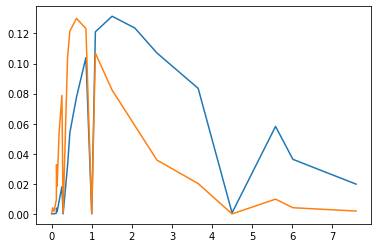

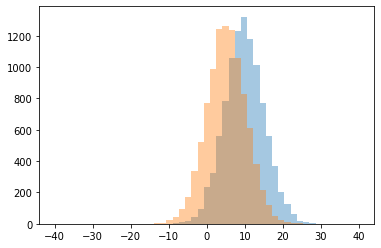

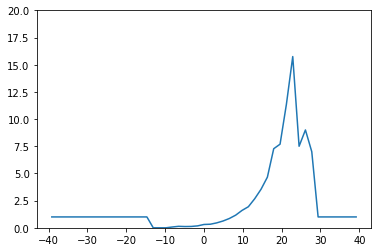

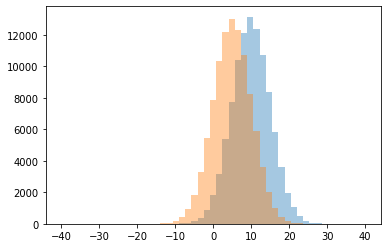

0 0.0
1 0.07317073170731707
2 0.11560693641618497
3 0.1242603550295858
4 0.13541666666666666
5 0.17692307692307693
6 0.3059895833333333
7 0.32894736842105265
8 0.4512489927477841
9 0.6241078509119746
10 0.8550607287449393
11 1.0
12 1.163670766319773
13 1.5985489721886337
14 1.9376026272577997
15 2.6728232189973613
16 3.5458715596330275
17 4.658333333333333
18 7.0
19 7.2745098039215685
20 7.5
21 7.6923076923076925
22 9.0
23 11.363636363636363
24 15.75




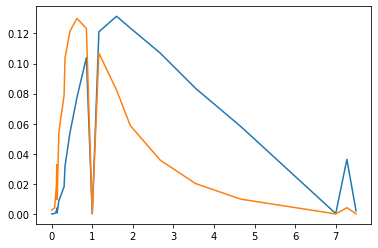

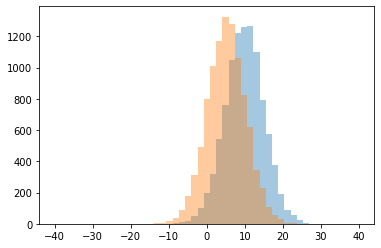

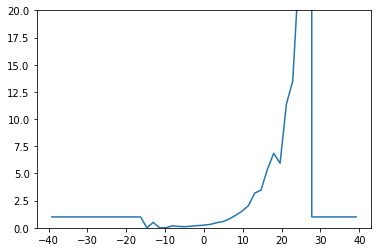

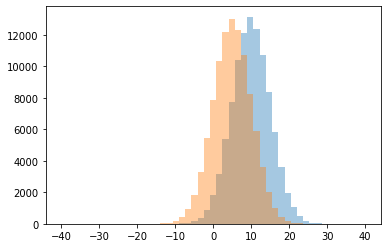

0 0.0
1 0.1
2 0.125
3 0.1501597444089457
4 0.18421052631578946
5 0.2028397565922921
6 0.24592220828105396
7 0.314484126984127
8 0.4674657534246575
9 0.5
10 0.5716440422322775
11 0.8184663536776213
12 1.0
13 1.1508011310084825
14 1.5297691373025517
15 2.032154340836013
16 3.1855072463768117
17 3.4780701754385963
18 5.373831775700935
19 5.9375
20 6.8545454545454545
21 11.375
22 13.5
23 24.0
24 999999.0




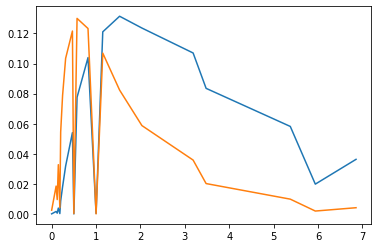

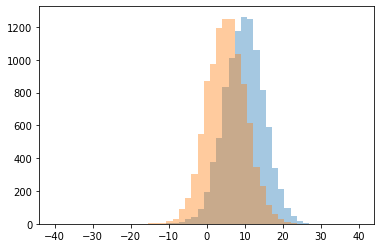

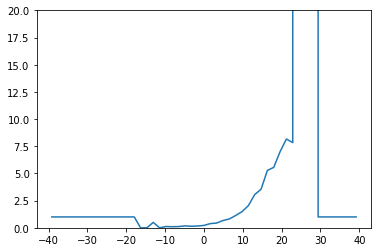

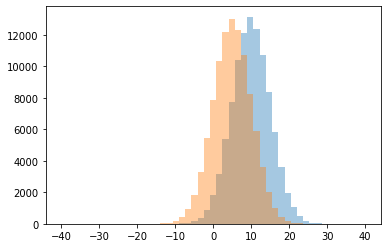

0 0.0
1 0.1
2 0.11363636363636363
3 0.11764705882352941
4 0.1419141914191419
5 0.1663619744058501
6 0.175
7 0.21954022988505748
8 0.3858751279426817
9 0.43609022556390975
10 0.5
11 0.6693354683746997
12 0.8112
13 1.0
14 1.1319845857418112
15 1.4858823529411764
16 2.035772357723577
17 3.0545977011494254
18 3.5454545454545454
19 5.276785714285714
20 5.557377049180328
21 7.0
22 7.833333333333333
23 8.166666666666666
24 999999.0




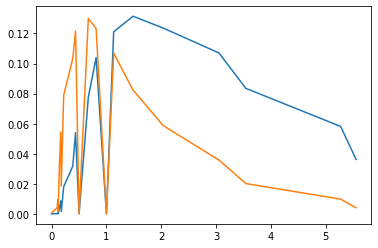

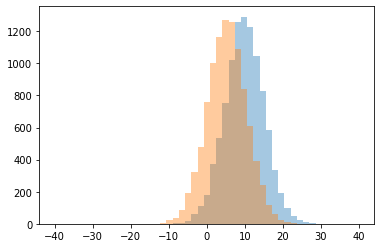

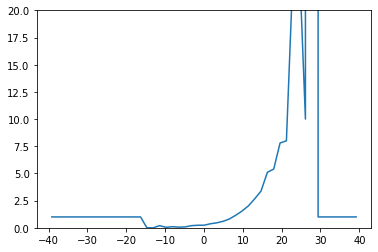

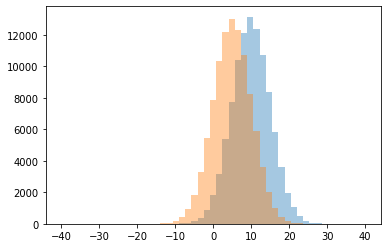

0 0.0
1 0.043478260869565216
2 0.05813953488372093
3 0.07894736842105263
4 0.10256410256410256
5 0.19504643962848298
6 0.2
7 0.23333333333333334
8 0.23715415019762845
9 0.36852589641434264
10 0.45586975149957154
11 0.5925925925925926
12 0.8101667990468626
13 1.0
14 1.15018315018315
15 1.5405727923627686
16 2.013157894736842
17 2.6666666666666665
18 3.3836734693877553
19 5.104347826086957
20 5.403225806451613
21 7.8
22 8.0
23 10.0
24 23.0
25 25.0
26 999999.0




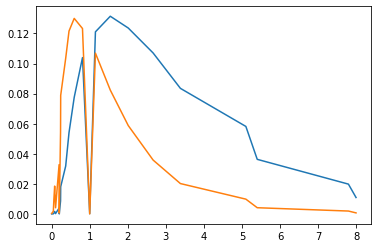

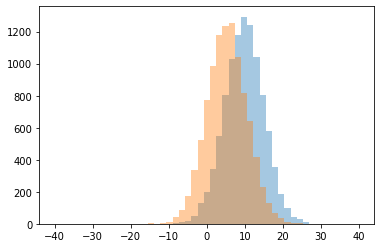

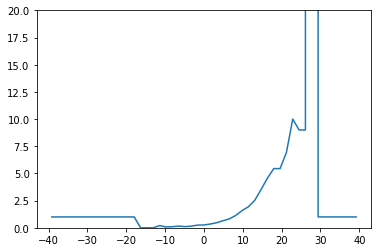

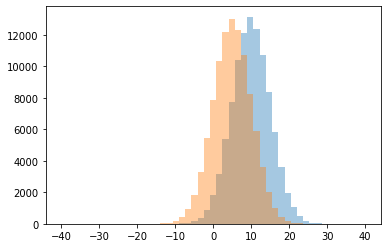

0 0.0
1 0.08333333333333333
2 0.1
3 0.10857142857142857
4 0.15315315315315314
5 0.1590909090909091
6 0.2
7 0.24761904761904763
8 0.2597402597402597
9 0.34787018255578095
10 0.467687074829932
11 0.6483427647534358
12 0.8215139442231075
13 1.0
14 1.1314779270633397
15 1.580684596577017
16 1.931570762052877
17 2.5193236714975846
18 3.51528384279476
19 4.559055118110236
20 5.4411764705882355
21 5.446153846153846
22 6.928571428571429
23 9.0
24 10.0
25 999999.0




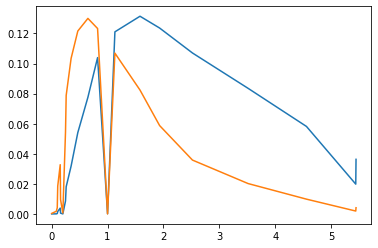

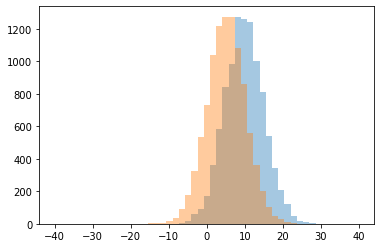

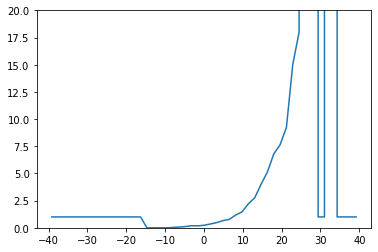

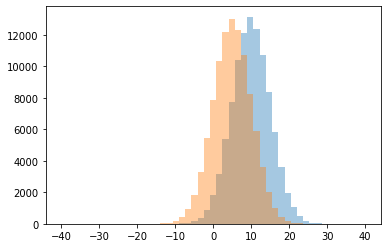

0 0.0
1 0.027777777777777776
2 0.06593406593406594
3 0.10857142857142857
4 0.17570093457943925
5 0.1926605504587156
6 0.23424657534246576
7 0.3490838958534233
8 0.47662018047579985
9 0.6632653061224489
10 0.7720125786163522
11 1.0
12 1.1761992619926198
13 1.4610917537746806
14 2.2081850533807827
15 2.758241758241758
16 4.0
17 5.123809523809523
18 6.784313725490196
19 7.62962962962963
20 9.23076923076923
21 15.0
22 18.0
23 999999.0




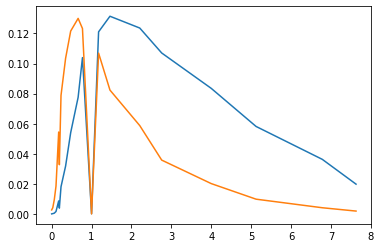

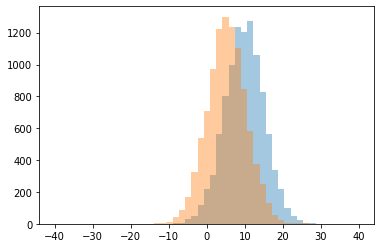

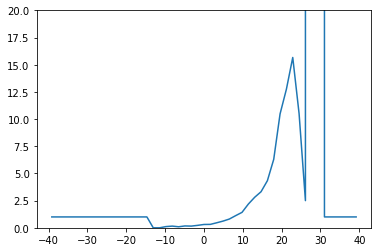

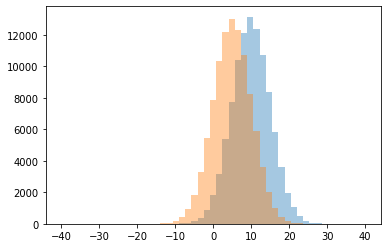

0 0.0
1 0.09411764705882353
2 0.1111111111111111
3 0.15555555555555556
4 0.1559633027522936
5 0.17058823529411765
6 0.22490706319702602
7 0.3064971751412429
8 0.31443298969072164
9 0.46040816326530615
10 0.6153846153846154
11 0.8055105348460292
12 1.0
13 1.1193490054249549
14 1.4209905660377358
15 2.183848797250859
16 2.5
17 2.8095238095238093
18 3.317269076305221
19 4.3307692307692305
20 6.296296296296297
21 10.476190476190476
22 10.5
23 12.75
24 15.666666666666666
25 999999.0




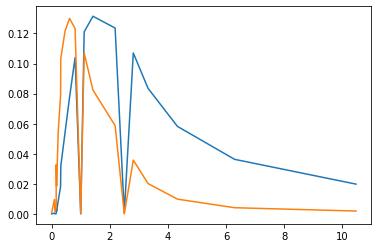

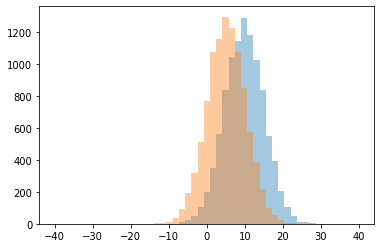

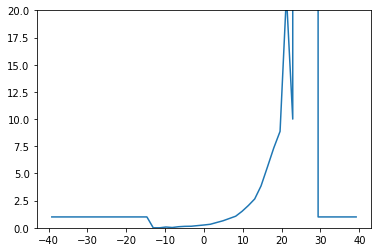

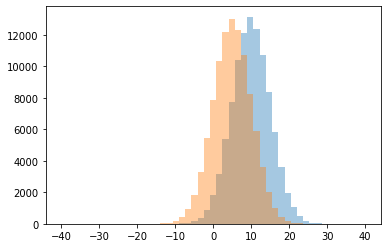

0 0.0
1 0.02631578947368421
2 0.07142857142857142
3 0.1
4 0.13402061855670103
5 0.14330218068535824
6 0.20156555772994128
7 0.25810635538262
8 0.3246753246753247
9 0.48704663212435234
10 0.6456086286594761
11 0.8555102040816327
12 1.0
13 1.0651769087523277
14 1.5129107981220657
15 2.048526863084922
16 2.6528497409326426
17 3.853211009174312
18 5.575757575757576
19 7.333333333333333
20 8.869565217391305
21 10.0
22 21.4
23 999999.0




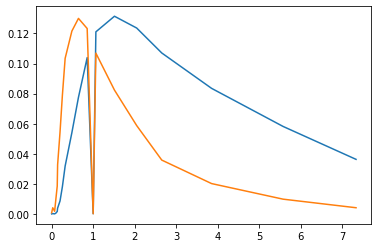

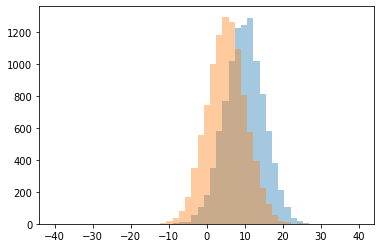

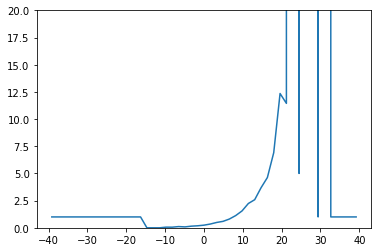

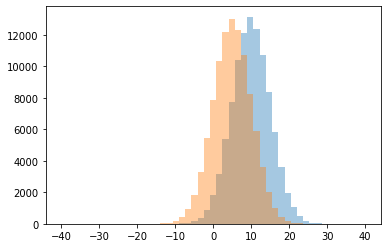

0 0.0
1 0.05714285714285714
2 0.058823529411764705
3 0.08333333333333333
4 0.1125
5 0.14942528735632185
6 0.18525179856115107
7 0.24262734584450402
8 0.3463073852295409
9 0.49153976311336717
10 0.591820987654321
11 0.8047430830039526
12 1.0
13 1.1236263736263736
14 1.550995024875622
15 2.236521739130435
16 2.5848101265822785
17 3.683257918552036
18 4.624
19 5.0
20 6.909090909090909
21 11.444444444444445
22 12.352941176470589
23 999999.0




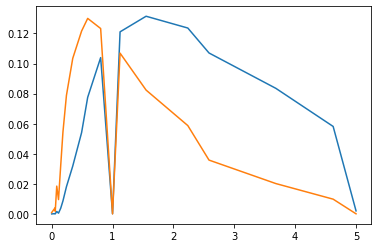

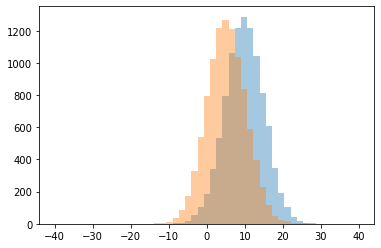

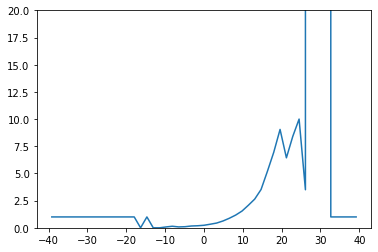

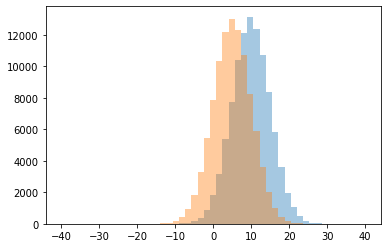

0 0.0
1 0.07692307692307693
2 0.08139534883720931
3 0.1
4 0.14285714285714285
5 0.1651376146788991
6 0.1881918819188192
7 0.23232323232323232
8 0.330078125
9 0.43688524590163935
10 0.6277602523659306
11 0.8779884583676835
12 1.0
13 1.170520231213873
14 1.5406698564593302
15 2.073253833049404
16 2.638888888888889
17 3.5
18 3.5194805194805197
19 5.188034188034188
20 6.4375
21 6.94
22 8.4
23 9.047619047619047
24 10.0
25 999999.0




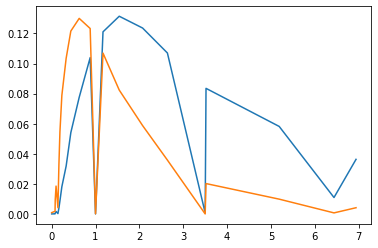

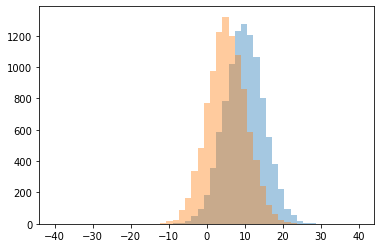

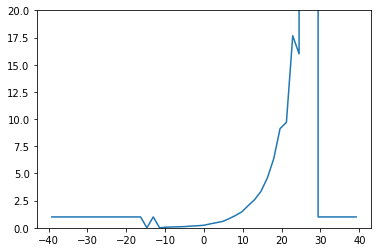

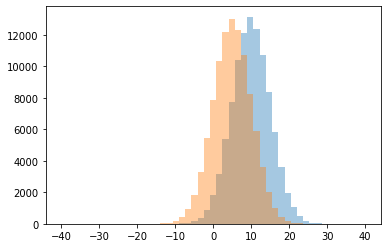

0 0.0
1 0.05555555555555555
2 0.07692307692307693
3 0.09090909090909091
4 0.11377245508982035
5 0.15522388059701492
6 0.188911704312115
7 0.23567708333333334
8 0.3633572159672467
9 0.4779050736497545
10 0.5922844175491679
11 0.8528428093645485
12 1.0
13 1.1402042711234912
14 1.4814385150812064
15 2.054607508532423
16 2.5990220048899757
17 3.3640167364016738
18 4.591666666666667
19 6.35
20 9.125
21 9.7
22 16.0
23 17.666666666666668
24 999999.0




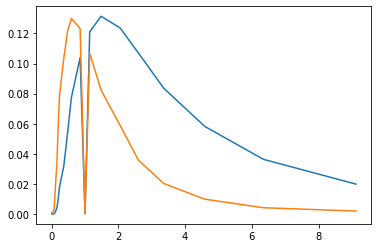

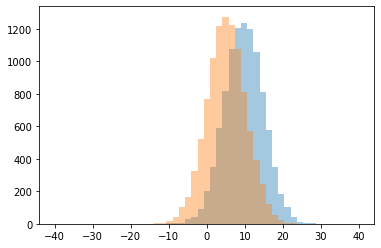

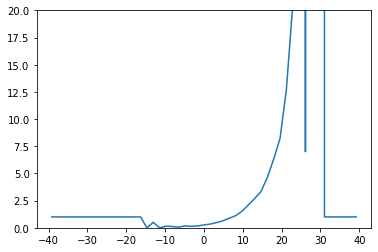

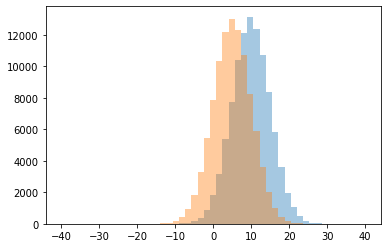

0 0.0
1 0.05660377358490566
2 0.12195121951219512
3 0.1345565749235474
4 0.15
5 0.17177914110429449
6 0.1743295019157088
7 0.26631853785900783
8 0.34411764705882353
9 0.48442622950819675
10 0.5
11 0.6407843137254902
12 0.8805237315875614
13 1.0
14 1.1177015755329007
15 1.5221130221130221
16 2.1052631578947367
17 2.691326530612245
18 3.3415637860082303
19 4.645161290322581
20 6.327272727272727
21 7.0
22 8.227272727272727
23 12.75
24 20.5
25 999999.0




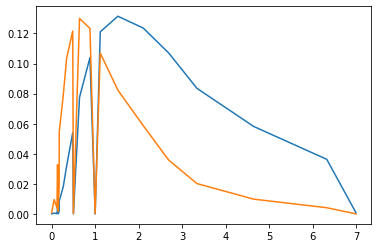

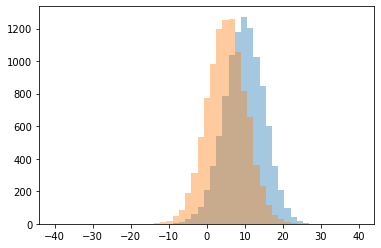

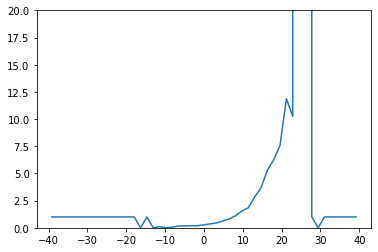

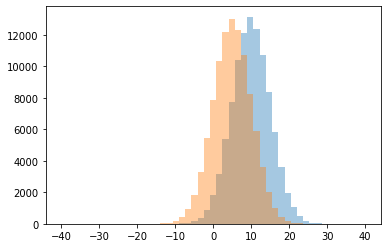

0 0.0
1 0.058823529411764705
2 0.1
3 0.16091954022988506
4 0.1702127659574468
5 0.19402985074626866
6 0.1942675159235669
7 0.2690815006468305
8 0.35910478128179046
9 0.4531772575250836
10 0.6264964086193137
11 0.8272292993630573
12 1.0
13 1.1123701605288008
14 1.5562347188264058
15 1.842507645259939
16 2.852777777777778
17 3.675324675324675
18 5.298245614035087
19 6.2631578947368425
20 7.592592592592593
21 10.25
22 11.875
23 999999.0




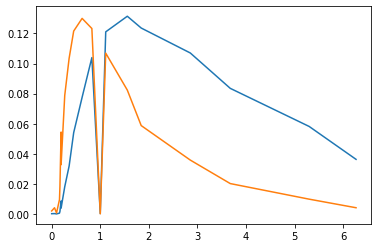

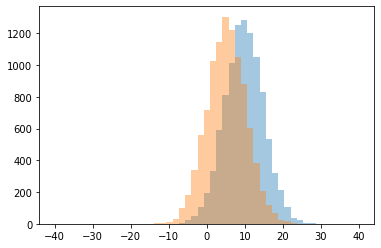

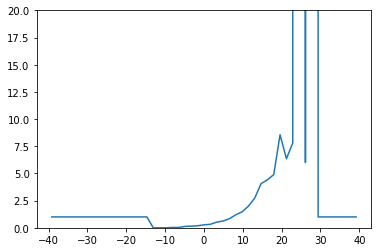

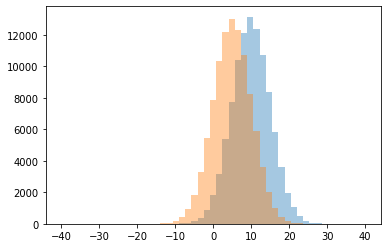

0 0.0
1 0.030303030303030304
2 0.03125
3 0.1270718232044199
4 0.15294117647058825
5 0.1889483065953654
6 0.2727272727272727
7 0.3232421875
8 0.518324607329843
9 0.6237547892720307
10 0.8326497128794094
11 1.0
12 1.1933333333333334
13 1.4613636363636364
14 1.9867549668874172
15 2.7317708333333335
16 4.0588235294117645
17 4.413223140495868
18 4.893939393939394
19 6.0
20 6.352941176470588
21 7.8
22 8.56
23 999999.0




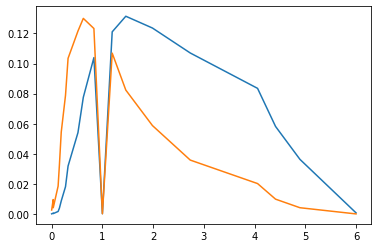

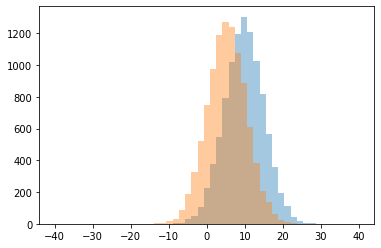

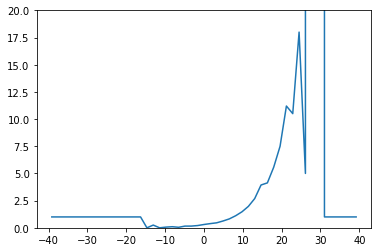

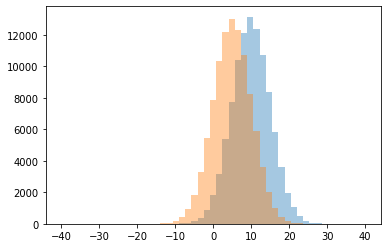

0 0.0
1 0.047058823529411764
2 0.0625
3 0.1
4 0.15591397849462366
5 0.15692307692307692
6 0.20689655172413793
7 0.25
8 0.3038821954484605
9 0.3858751279426817
10 0.45836837678721615
11 0.6253943217665615
12 0.8196457326892109
13 1.0
14 1.1104921077065923
15 1.4751131221719458
16 1.9689542483660132
17 2.6876640419947506
18 3.9371980676328504
19 4.131386861313868
20 5.0
21 5.578125
22 7.5
23 10.5
24 11.2
25 18.0
26 999999.0




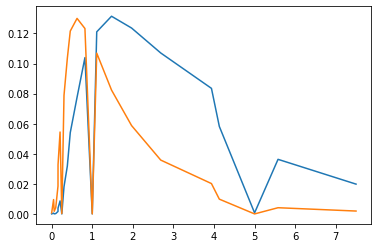

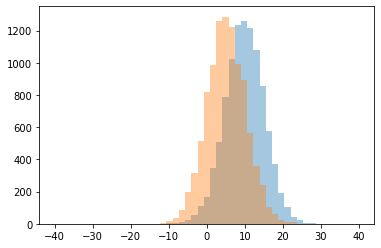

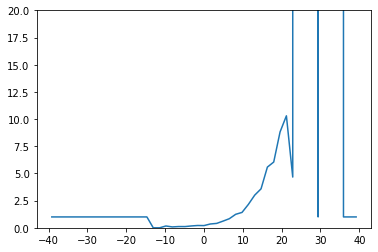

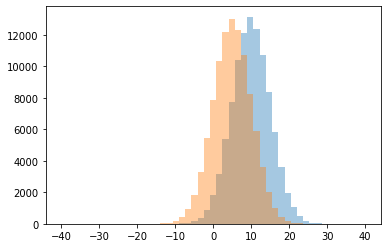

0 0.0
1 0.08108108108108109
2 0.11224489795918367
3 0.11494252873563218
4 0.16666666666666666
5 0.16932907348242812
6 0.20341047503045068
7 0.21206225680933852
8 0.35085945399393326
9 0.4041368337311058
10 0.6135303265940902
11 0.8370188370188371
12 1.0
13 1.2412060301507537
14 1.4147982062780269
15 2.150442477876106
16 3.002785515320334
17 3.5840336134453783
18 4.666666666666667
19 5.58252427184466
20 6.049180327868853
21 8.818181818181818
22 10.3
23 999999.0




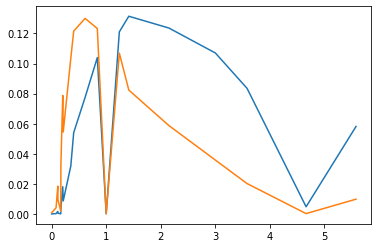

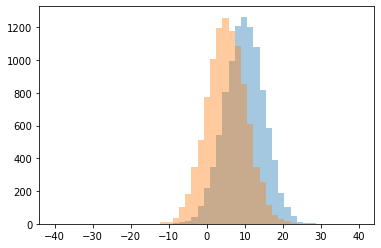

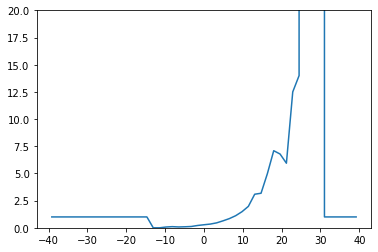

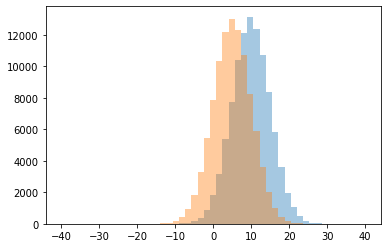

0 0.0
1 0.07142857142857142
2 0.07766990291262135
3 0.09392265193370165
4 0.10526315789473684
5 0.12034383954154727
6 0.21372549019607842
7 0.28
8 0.3426294820717131
9 0.45454545454545453
10 0.6401273885350318
11 0.8447837150127226
12 1.0
13 1.1131554737810487
14 1.4830011723329426
15 1.9704918032786884
16 3.0885714285714285
17 3.1782945736434107
18 4.982905982905983
19 5.9411764705882355
20 6.785714285714286
21 7.090909090909091
22 12.5
23 14.0
24 999999.0




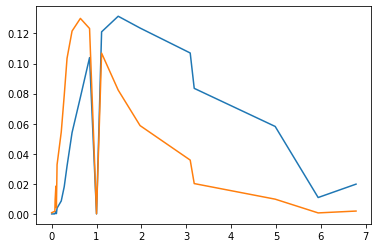

on f= 0.06896551724137931


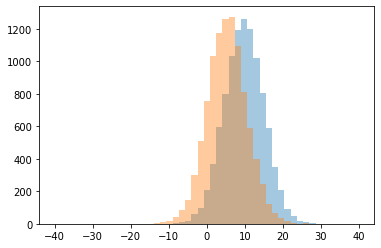

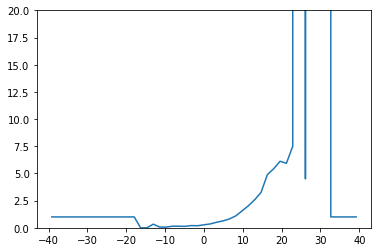

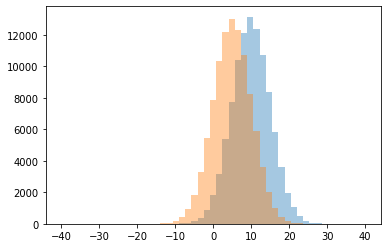

0 0.0
1 0.0625
2 0.07142857142857142
3 0.1342281879194631
4 0.14457831325301204
5 0.14634146341463414
6 0.19140625
7 0.20333333333333334
8 0.2760898282694848
9 0.3333333333333333
10 0.3588748787584869
11 0.5098039215686274
12 0.6347068145800316
13 0.8109803921568628
14 1.0
15 1.0915750915750915
16 1.5522755227552276
17 2.0236486486486487
18 2.580808080808081
19 3.2550607287449393
20 4.5
21 4.892561983471074
22 5.4375
23 5.933333333333334
24 6.117647058823529
25 7.5
26 999999.0




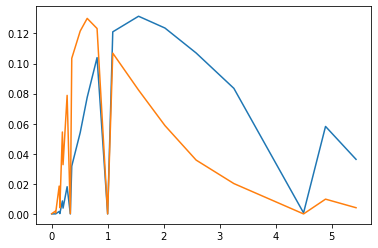

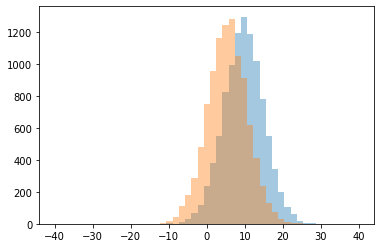

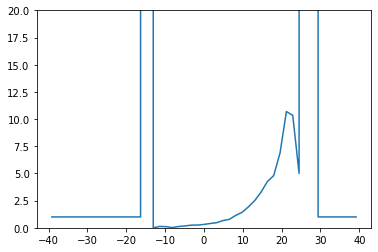

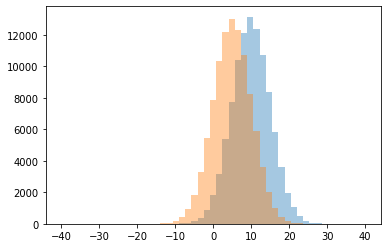

0 0.0
1 0.024390243902439025
2 0.10526315789473684
3 0.11926605504587157
4 0.125
5 0.17318435754189945
6 0.24475524475524477
7 0.25
8 0.3125
9 0.39622641509433965
10 0.4691252144082333
11 0.6642570281124498
12 0.7767369242779079
13 1.0
14 1.1391801715919925
15 1.4205914567360352
16 1.9176090468497577
17 2.4987775061124693
18 3.280334728033473
19 4.253846153846154
20 4.805555555555555
21 5.0
22 6.896551724137931
23 10.333333333333334
24 10.7
25 999999.0




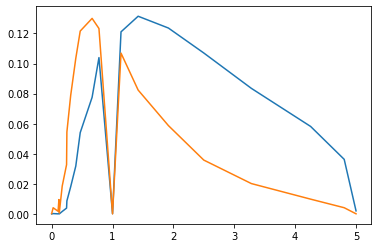

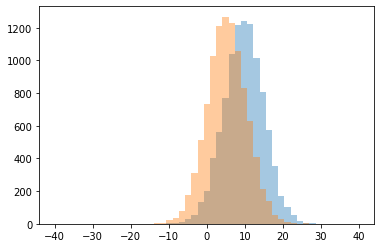

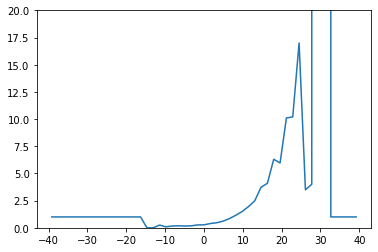

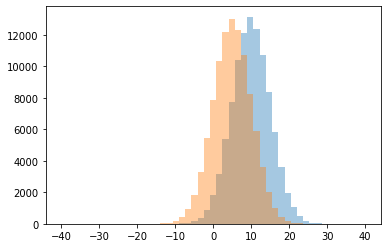

0 0.0
1 0.09090909090909091
2 0.16201117318435754
3 0.16666666666666666
4 0.18064516129032257
5 0.18421052631578946
6 0.25
7 0.26614481409001955
8 0.2722298221614227
9 0.39261418853255586
10 0.4652892561983471
11 0.6072555205047319
12 0.8452768729641694
13 1.0
14 1.1462264150943395
15 1.4909747292418774
16 1.9397781299524564
17 2.4744525547445257
18 3.5
19 3.7314814814814814
20 4.0
21 4.0928571428571425
22 5.9655172413793105
23 6.303571428571429
24 10.1
25 10.2
26 17.0
27 999999.0




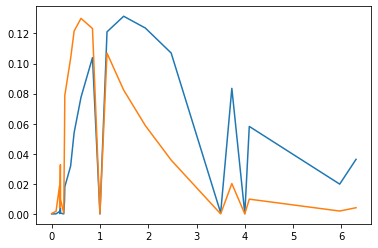

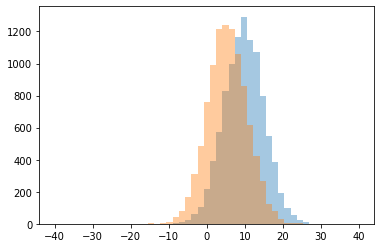

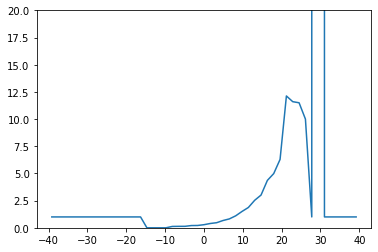

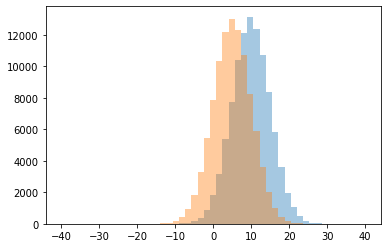

0 0.0
1 0.125
2 0.13414634146341464
3 0.13609467455621302
4 0.2057877813504823
5 0.2139917695473251
6 0.285336856010568
7 0.39656912209889
8 0.4691865242399343
9 0.6701612903225806
10 0.8175842235004108
11 1.0
12 1.101038715769594
13 1.5040745052386495
14 1.8680781758957654
15 2.5319148936170213
16 3.0113207547169814
17 4.36
18 4.987012987012987
19 6.290322580645161
20 10.0
21 11.5
22 11.6
23 12.125
24 999999.0




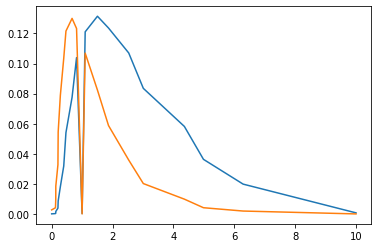

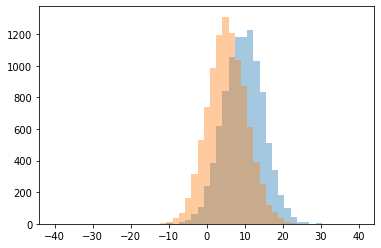

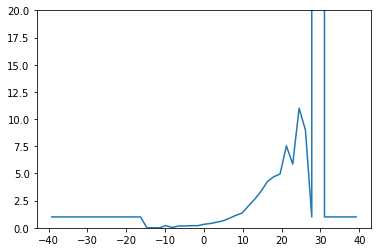

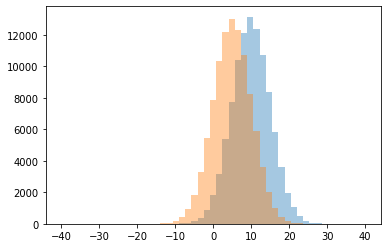

0 0.0
1 0.02702702702702703
2 0.16363636363636364
3 0.17142857142857143
4 0.1949685534591195
5 0.1951219512195122
6 0.2
7 0.3225371120107962
8 0.3917004048582996
9 0.5171548117154812
10 0.6412213740458015
11 0.8734491315136477
12 1.0
13 1.1395572666025024
14 1.3516609392898054
15 2.0032733224222588
16 2.628498727735369
17 3.353413654618474
18 4.24793388429752
19 4.694444444444445
20 4.945945945945946
21 5.857142857142857
22 7.538461538461538
23 9.0
24 11.0
25 999999.0




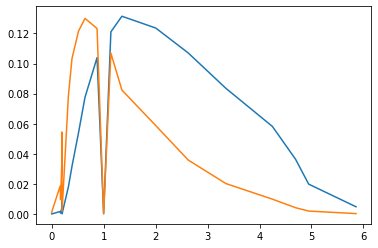

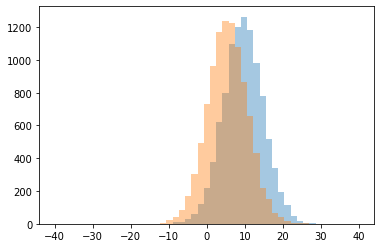

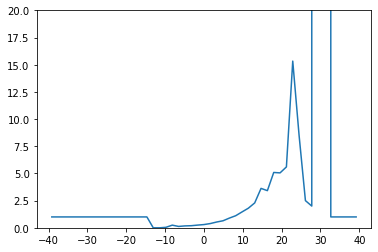

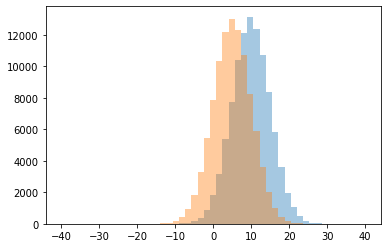

0 0.0
1 0.043478260869565216
2 0.12643678160919541
3 0.1744186046511628
4 0.19281045751633988
5 0.24390243902439024
6 0.24848484848484848
7 0.2978142076502732
8 0.39067357512953366
9 0.5316239316239316
10 0.645682001614205
11 0.8916938110749185
12 1.0
13 1.1100832562442182
14 1.4595842956120093
15 1.8036529680365296
16 2.0
17 2.2883720930232556
18 2.5
19 3.4172185430463577
20 3.625
21 5.051282051282051
22 5.08955223880597
23 5.6
24 8.5
25 15.333333333333334
26 999999.0




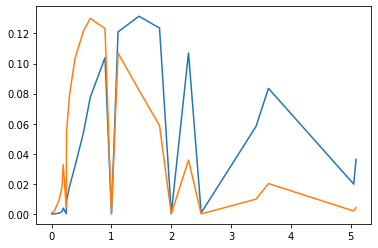

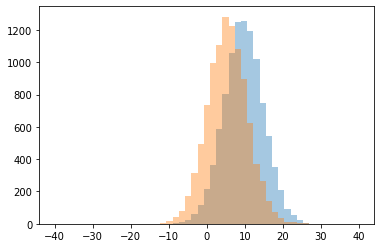

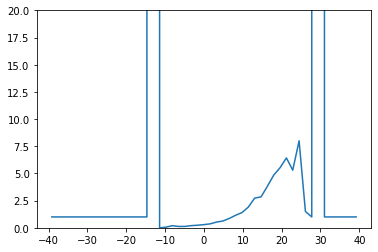

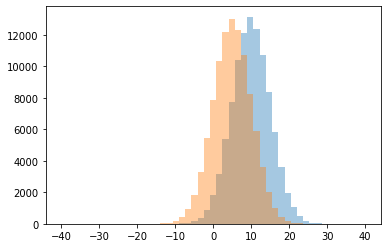

0 0.0
1 0.05555555555555555
2 0.12345679012345678
3 0.12571428571428572
4 0.1951219512195122
5 0.19873817034700317
6 0.2383838383838384
7 0.29132791327913277
8 0.3657314629258517
9 0.5294117647058824
10 0.6263650546021841
11 0.8633387888707038
12 1.0
13 1.1551246537396123
14 1.4038031319910516
15 1.5
16 1.9074960127591707
17 2.7372654155495977
18 2.840909090909091
19 3.8181818181818183
20 4.8493150684931505
21 5.3
22 5.526315789473684
23 6.428571428571429
24 8.0
25 999999.0




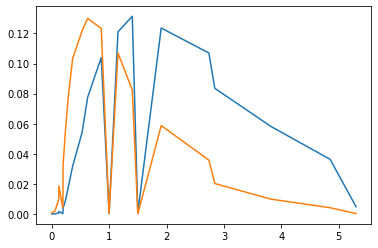

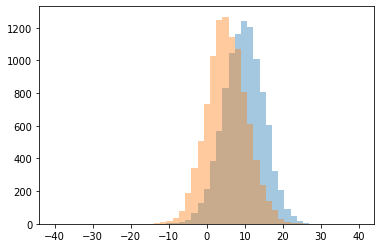

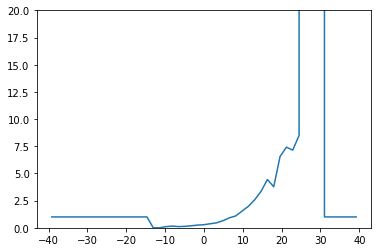

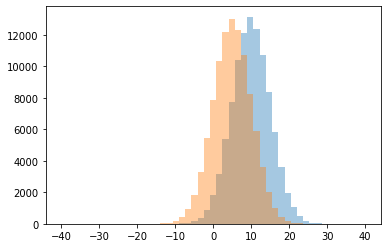

0 0.0
1 0.10526315789473684
2 0.1111111111111111
3 0.13297872340425532
4 0.15789473684210525
5 0.187683284457478
6 0.24803149606299213
7 0.28746594005449594
8 0.37365853658536585
9 0.45753205128205127
10 0.6561514195583596
11 0.9176882661996497
12 1.0
13 1.0869158878504672
14 1.5339925834363413
15 1.9722222222222223
16 2.582051282051282
17 3.35
18 3.776470588235294
19 4.437956204379562
20 6.5625
21 7.142857142857143
22 7.416666666666667
23 8.5
24 999999.0




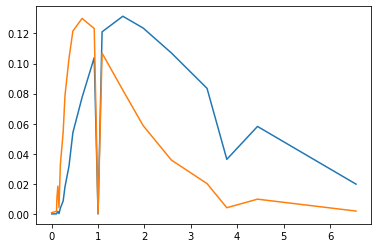

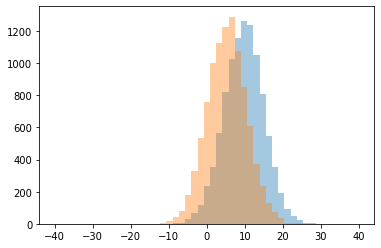

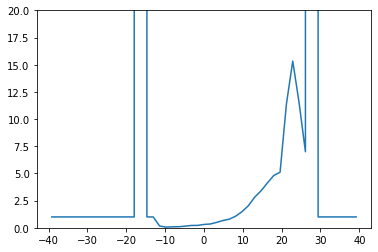

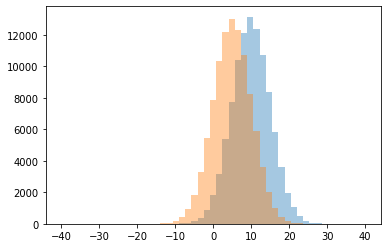

0 0.0625
1 0.09090909090909091
2 0.09876543209876543
3 0.14835164835164835
4 0.16666666666666666
5 0.21406727828746178
6 0.2209737827715356
7 0.30779392338177014
8 0.3502994011976048
9 0.499113475177305
10 0.6721044045676998
11 0.7945736434108527
12 1.0
13 1.071362372567192
14 1.4841363102232668
15 2.0311475409836066
16 2.8176943699731902
17 3.399159663865546
18 4.121212121212121
19 4.808219178082192
20 5.108108108108108
21 7.0
22 11.375
23 11.5
24 15.333333333333334
25 999999.0




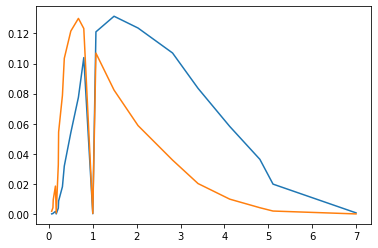

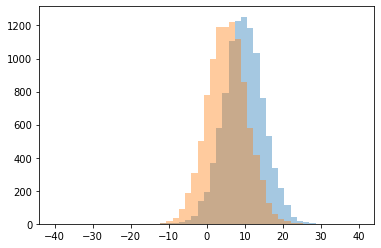

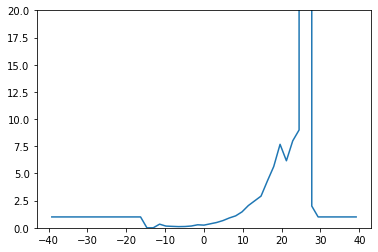

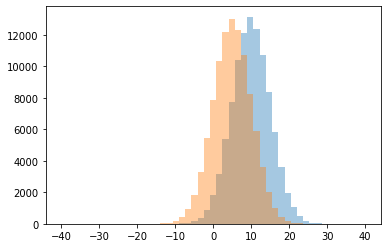

0 0.0
1 0.10869565217391304
2 0.11891891891891893
3 0.13157894736842105
4 0.15789473684210525
5 0.16393442622950818
6 0.24552429667519182
7 0.27634194831013914
8 0.3333333333333333
9 0.36710130391173523
10 0.48866498740554154
11 0.6658249158249159
12 0.9052287581699346
13 1.0
14 1.098478066248881
15 1.4654970760233919
16 2.0
17 2.0466321243523318
18 2.4820143884892087
19 2.9160305343511452
20 4.306451612903226
21 5.633333333333334
22 6.166666666666667
23 7.678571428571429
24 8.0
25 9.0
26 999999.0




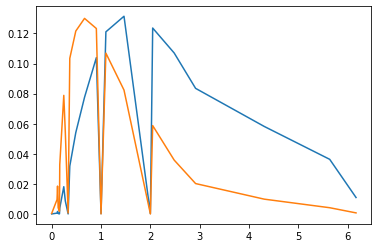

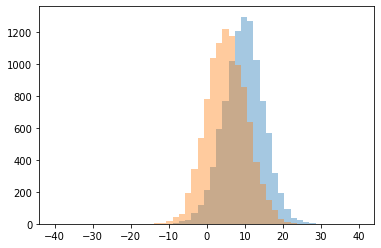

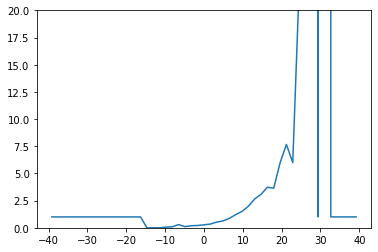

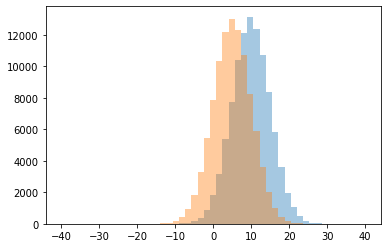

0 0.0
1 0.058823529411764705
2 0.09090909090909091
3 0.10880829015544041
4 0.1907514450867052
5 0.21335807050092764
6 0.2727272727272727
7 0.29508196721311475
8 0.3448940269749518
9 0.5215479331574319
10 0.6299019607843137
11 0.8685326547921968
12 1.0
13 1.2104208416833668
14 1.5087108013937283
15 1.9812792511700468
16 2.649484536082474
17 3.0796812749003983
18 3.6436781609195403
19 3.7302631578947367
20 5.96875
21 6.0
22 7.666666666666667
23 22.0
24 999999.0




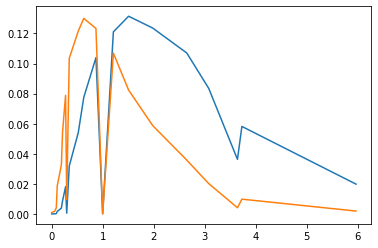

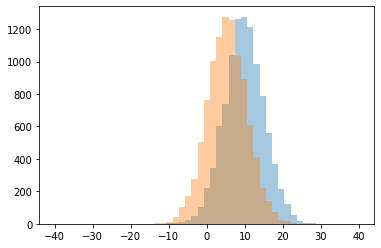

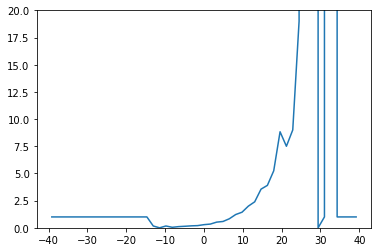

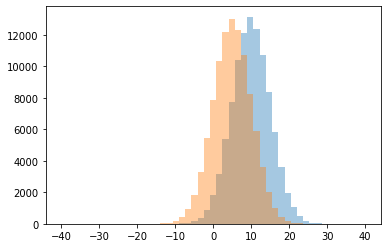

0 0.0
1 0.046511627906976744
2 0.10891089108910891
3 0.1411764705882353
4 0.16666666666666666
5 0.17921146953405018
6 0.20118343195266272
7 0.28888888888888886
8 0.34228855721393037
9 0.5212858384013901
10 0.582089552238806
11 0.8310756972111554
12 1.0
13 1.2199612403100775
14 1.4337078651685393
15 1.993431855500821
16 2.389830508474576
17 3.5565610859728505
18 3.902097902097902
19 5.242857142857143
20 7.5
21 8.833333333333334
22 9.0
23 19.0
24 999999.0




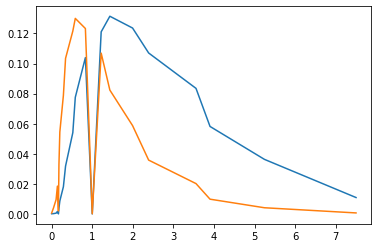

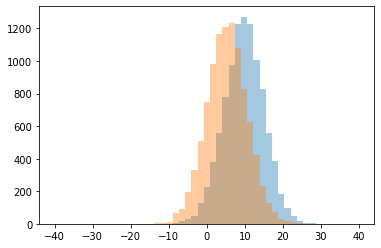

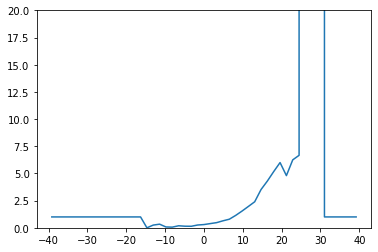

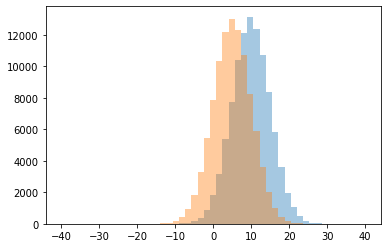

0 0.0
1 0.06060606060606061
2 0.07692307692307693
3 0.1402439024390244
4 0.14646464646464646
5 0.18681318681318682
6 0.25
7 0.2564102564102564
8 0.29812834224598933
9 0.3333333333333333
10 0.387589013224822
11 0.4755784061696658
12 0.643801652892562
13 0.7904142973192526
14 1.0
15 1.1400742115027829
16 1.5380894800483675
17 1.9631410256410255
18 2.3942992874109263
19 3.519148936170213
20 4.3023255813953485
21 4.8
22 5.173333333333333
23 6.0
24 6.25
25 6.666666666666667
26 999999.0




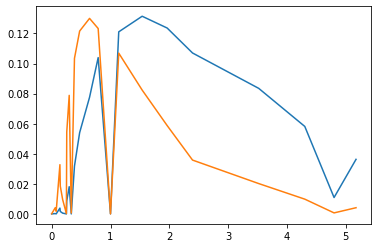

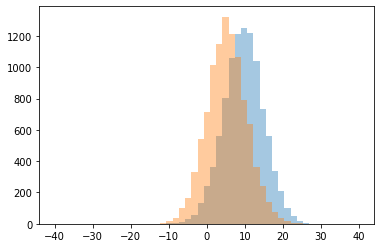

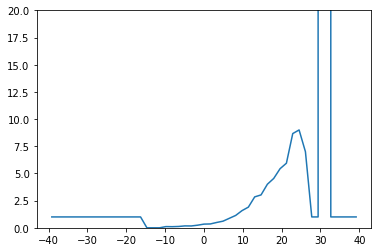

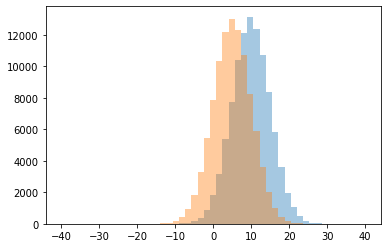

0 0.0
1 0.10256410256410256
2 0.1111111111111111
3 0.12244897959183673
4 0.1686746987951807
5 0.1746987951807229
6 0.24080882352941177
7 0.3389355742296919
8 0.3543307086614173
9 0.4900086880973067
10 0.6092214663643235
11 0.8736581337737407
12 1.0
13 1.1369606003752346
14 1.5790139064475348
15 1.9015625
16 2.8438356164383563
17 3.024793388429752
18 4.007142857142857
19 4.54054054054054
20 5.435897435897436
21 5.9411764705882355
22 7.0
23 8.666666666666666
24 9.0
25 999999.0




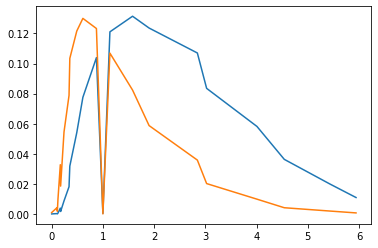

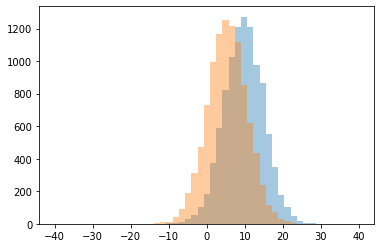

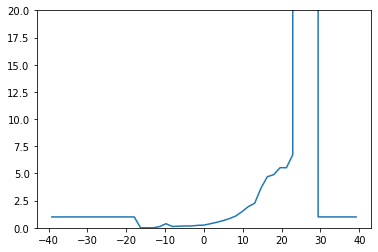

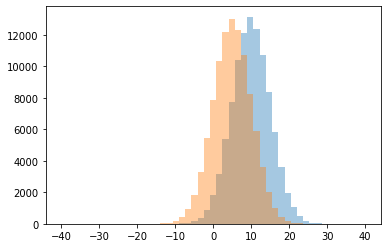

0 0.0
1 0.1111111111111111
2 0.12195121951219512
3 0.14772727272727273
4 0.1693121693121693
5 0.16987179487179488
6 0.225531914893617
7 0.2476060191518468
8 0.37386934673366834
9 0.375
10 0.5051457975986278
11 0.6565737051792828
12 0.8440065681444991
13 1.0
14 1.08125
15 1.4871495327102804
16 1.9516908212560387
17 2.260969976905312
18 3.6610169491525424
19 4.703389830508475
20 4.887323943661972
21 5.526315789473684
22 5.53125
23 6.714285714285714
24 999999.0




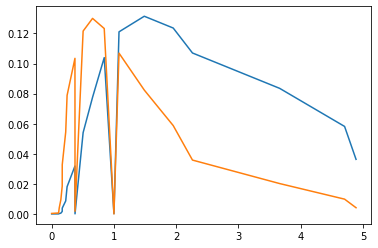

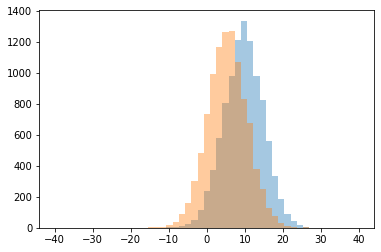

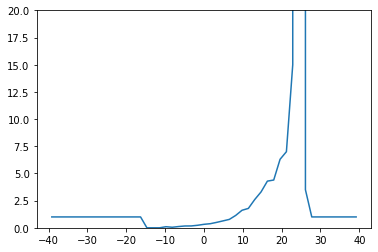

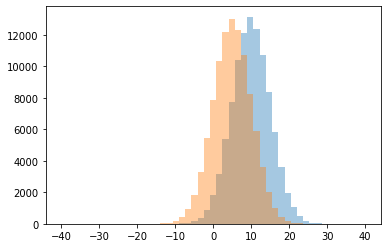

0 0.0
1 0.05
2 0.1
3 0.11627906976744186
4 0.16666666666666666
5 0.17105263157894737
6 0.23251028806584362
7 0.3201634877384196
8 0.37751004016064255
9 0.5
10 0.6355731225296443
11 0.7734067663257278
12 1.0
13 1.1365762394761458
14 1.6120481927710844
15 1.7831858407079646
16 2.5963060686015833
17 3.298804780876494
18 3.5
19 4.292307692307692
20 4.394736842105263
21 6.3
22 7.0
23 15.0
24 999999.0




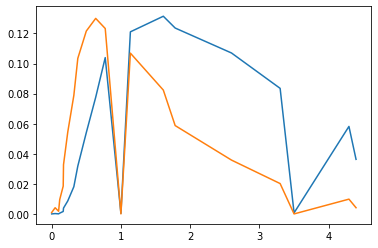

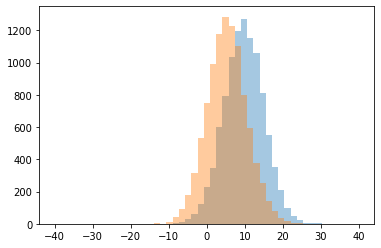

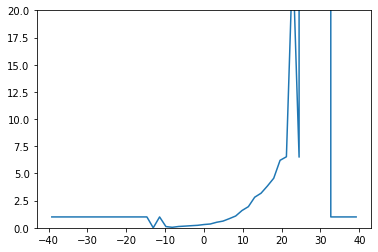

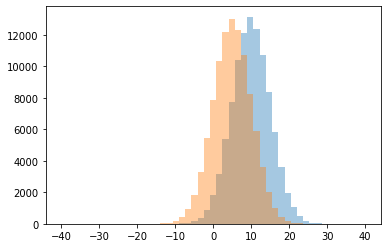

0 0.0
1 0.045454545454545456
2 0.1111111111111111
3 0.12087912087912088
4 0.15469613259668508
5 0.19365079365079366
6 0.22830188679245284
7 0.3009320905459387
8 0.3505050505050505
9 0.5089058524173028
10 0.616822429906542
11 0.8424489795918367
12 1.0
13 1.0843155031731642
14 1.589711417816813
15 1.9441624365482233
16 2.8138297872340425
17 3.1811023622047245
18 3.8402777777777777
19 4.558441558441558
20 6.205882352941177
21 6.5
22 6.533333333333333
23 25.0
24 999999.0




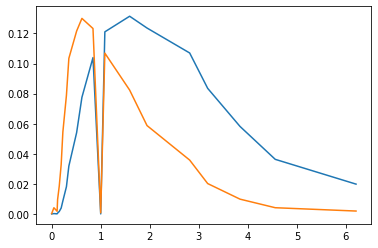

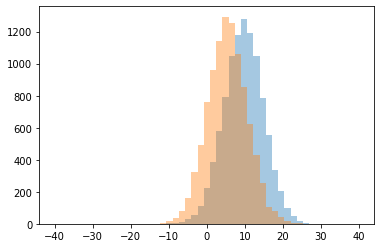

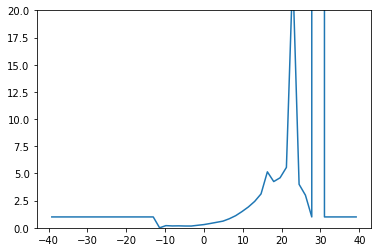

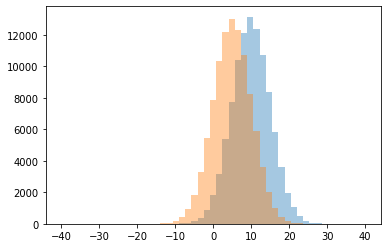

0 0.0
1 0.16307692307692306
2 0.16463414634146342
3 0.17142857142857143
4 0.1794871794871795
5 0.2
6 0.2310838445807771
7 0.29697766097240474
8 0.39771547248182765
9 0.5056967572304996
10 0.6140757927300851
11 0.8346645367412141
12 1.0
13 1.11531190926276
14 1.4947491248541425
15 1.9163987138263665
16 2.4305555555555554
17 3.0
18 3.119047619047619
19 4.0
20 4.253164556962025
21 4.6
22 5.148148148148148
23 5.555555555555555
24 23.5
25 999999.0




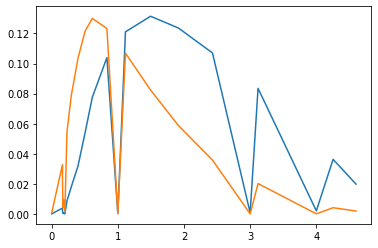

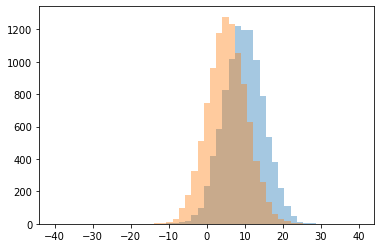

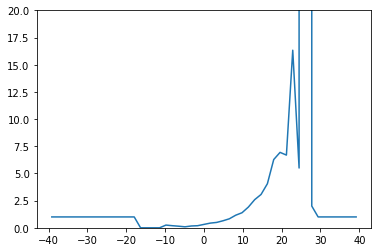

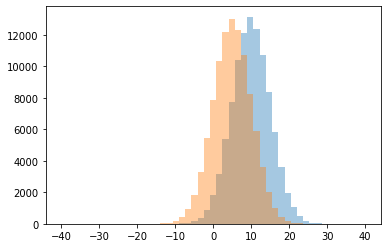

0 0.0
1 0.0903954802259887
2 0.14736842105263157
3 0.16666666666666666
4 0.1925343811394892
5 0.1935483870967742
6 0.25
7 0.3132530120481928
8 0.4315352697095436
9 0.49490662139219016
10 0.6463223787167449
11 0.827922077922078
12 1.0
13 1.1571969696969697
14 1.3854166666666667
15 1.9057507987220448
16 2.0
17 2.58974358974359
18 3.065891472868217
19 4.053030303030303
20 5.5
21 6.278688524590164
22 6.6875
23 6.9375
24 16.333333333333332
25 999999.0




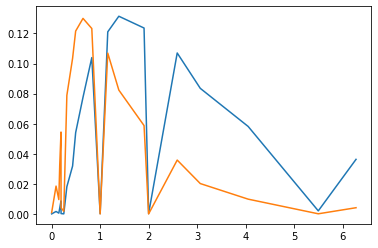

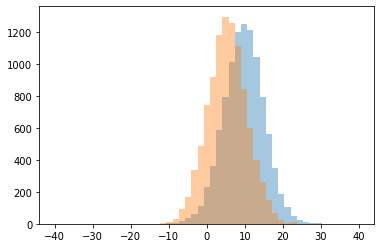

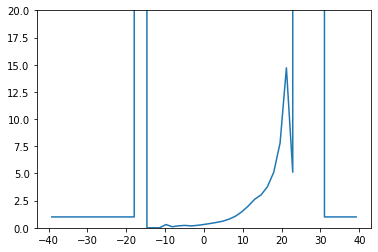

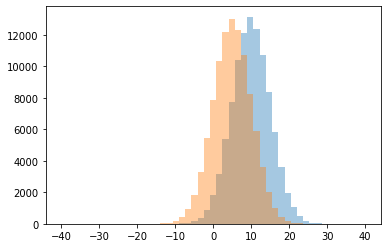

0 0.0
1 0.1
2 0.17404129793510326
3 0.1827956989247312
4 0.22023809523809523
5 0.22839506172839505
6 0.3
7 0.3090418353576248
8 0.3969465648854962
9 0.49746192893401014
10 0.6126543209876543
11 0.8052464228934817
12 1.0
13 1.0772686433063792
14 1.486935866983373
15 2.0132890365448506
16 2.6256281407035176
17 3.0229007633587788
18 3.771812080536913
19 5.102941176470588
20 5.111111111111111
21 7.791666666666667
22 14.714285714285714
23 999999.0




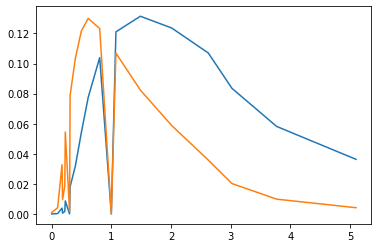

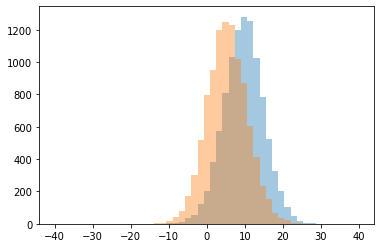

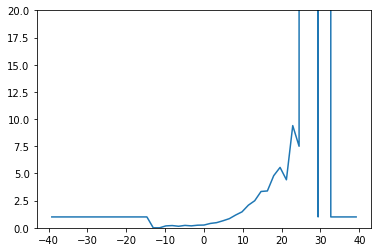

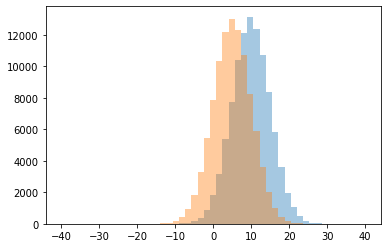

0 0.0
1 0.14102564102564102
2 0.17647058823529413
3 0.1782178217821782
4 0.20512820512820512
5 0.22093023255813954
6 0.23892100192678228
7 0.2528160200250313
8 0.40021008403361347
9 0.47543713572023316
10 0.6474358974358975
11 0.8406504065040651
12 1.0
13 1.1762977473065621
14 1.4673539518900343
15 2.079734219269103
16 2.489051094890511
17 3.3404255319148937
18 3.3896103896103895
19 4.416666666666667
20 4.794117647058823
21 5.555555555555555
22 7.5
23 9.4
24 999999.0




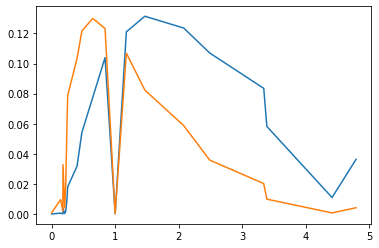

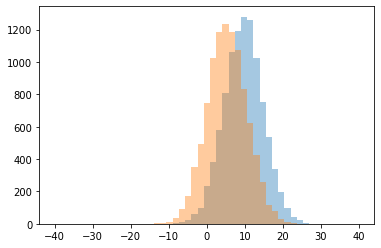

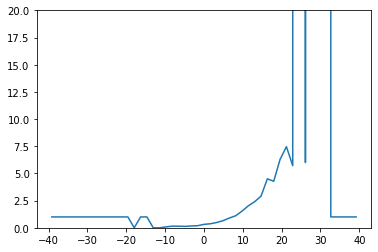

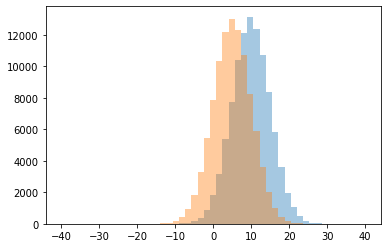

0 0.0
1 0.08333333333333333
2 0.12941176470588237
3 0.14606741573033707
4 0.15151515151515152
5 0.1671388101983003
6 0.19153225806451613
7 0.3163538873994638
8 0.3701171875
9 0.48653198653198654
10 0.6545012165450121
11 0.8986486486486487
12 1.0
13 1.1069767441860465
14 1.5311004784688995
15 2.024154589371981
16 2.4004683840749412
17 2.9182879377431905
18 4.2784810126582276
19 4.504201680672269
20 5.714285714285714
21 6.0
22 6.290322580645161
23 7.461538461538462
24 999999.0




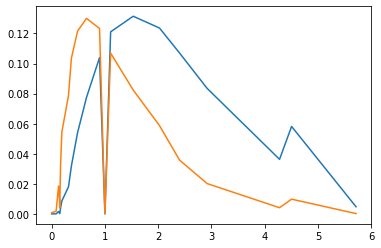

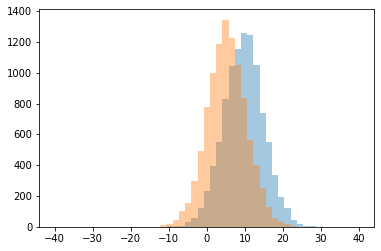

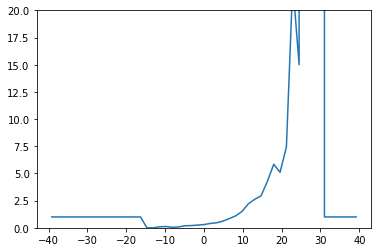

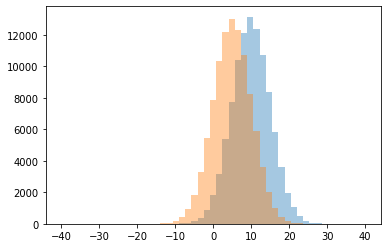

0 0.0
1 0.045454545454545456
2 0.07920792079207921
3 0.09090909090909091
4 0.11764705882352941
5 0.1910828025477707
6 0.2033898305084746
7 0.25101214574898784
8 0.2969151670951157
9 0.3985943775100402
10 0.4649789029535865
11 0.6175595238095238
12 0.8492257538712307
13 1.0
14 1.0978157644824311
15 1.507177033492823
16 2.206039076376554
17 2.623441396508728
18 2.9365079365079363
19 4.271317829457364
20 5.105263157894737
21 5.844827586206897
22 7.4375
23 15.0
24 22.5
25 999999.0




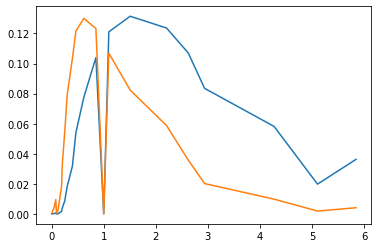

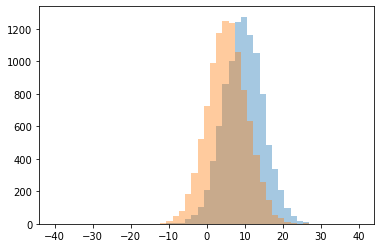

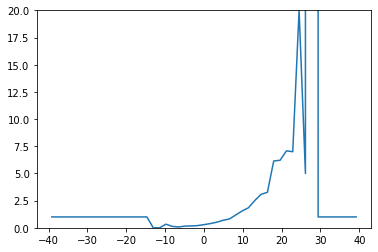

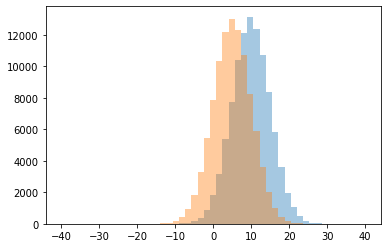

0 0.0
1 0.0759493670886076
2 0.13043478260869565
3 0.15591397849462366
4 0.16987179487179488
5 0.20384615384615384
6 0.2896551724137931
7 0.3333333333333333
8 0.3878787878787879
9 0.5119047619047619
10 0.6877502001601281
11 0.8108326596604689
12 1.0
13 1.173748819641171
14 1.5442424242424242
15 1.8372827804107426
16 2.498812351543943
17 3.076923076923077
18 3.2635135135135136
19 5.0
20 6.1454545454545455
21 6.212121212121212
22 7.0
23 7.071428571428571
24 20.0
25 999999.0




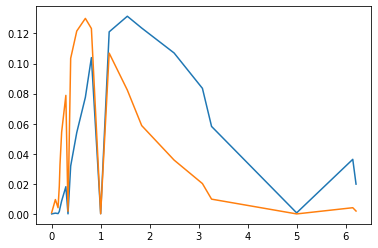

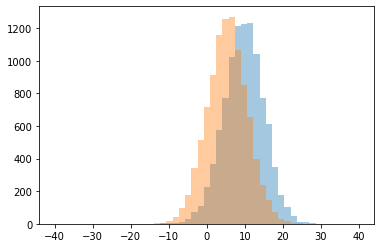

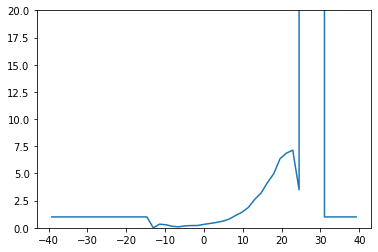

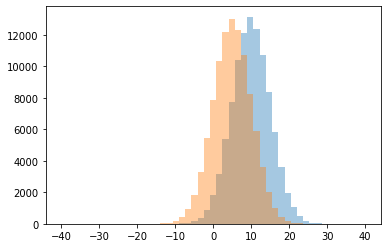

0 0.0
1 0.09090909090909091
2 0.13953488372093023
3 0.17613636363636365
4 0.20699708454810495
5 0.21135029354207435
6 0.2777777777777778
7 0.3174825174825175
8 0.3333333333333333
9 0.4037199124726477
10 0.4961106309420916
11 0.6157517899761337
12 0.8070866141732284
13 1.0
14 1.1385767790262171
15 1.4337631887456037
16 1.873668188736682
17 2.6155778894472363
18 3.190871369294606
19 3.5
20 4.148648648648648
21 4.9714285714285715
22 6.357142857142857
23 6.866666666666666
24 7.142857142857143
25 999999.0




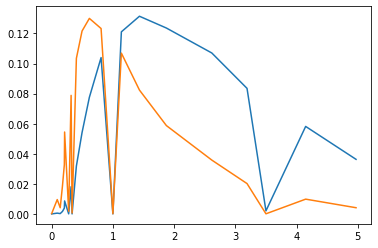

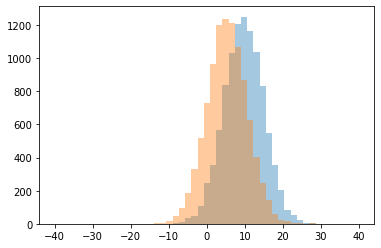

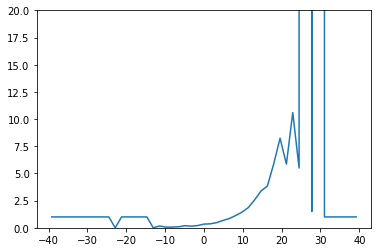

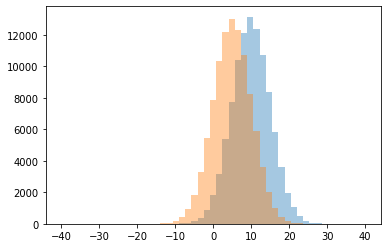

0 0.0
1 0.058823529411764705
2 0.06382978723404255
3 0.09473684210526316
4 0.15060240963855423
5 0.16666666666666666
6 0.1956521739130435
7 0.20576923076923076
8 0.34065934065934067
9 0.36645962732919257
10 0.4749582637729549
11 0.6744749596122779
12 0.8521882741535921
13 1.0
14 1.129455909943715
15 1.443418013856813
16 1.5
17 1.8624
18 2.5785536159600997
19 3.3877551020408165
20 3.8450704225352115
21 5.5
22 5.857142857142857
23 5.883333333333334
24 8.24
25 10.6
26 999999.0




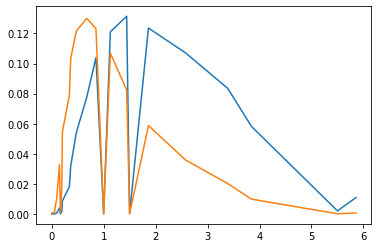

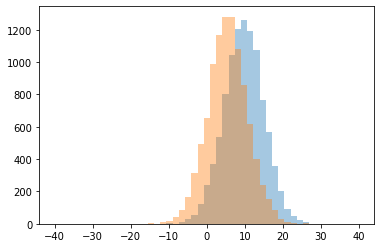

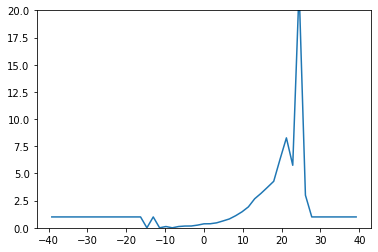

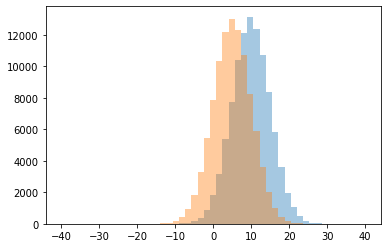

0 0.0
1 0.11764705882352941
2 0.16071428571428573
3 0.16560509554140126
4 0.24798387096774194
5 0.3660030627871363
6 0.37336024217961655
7 0.45726495726495725
8 0.6303837118245889
9 0.8134270101483216
10 1.0
11 1.113573407202216
12 1.470314318975553
13 1.9225806451612903
14 2.672456575682382
15 3.0
16 3.169421487603306
17 3.7171052631578947
18 4.27710843373494
19 5.75
20 6.3125
21 8.272727272727273
22 22.0




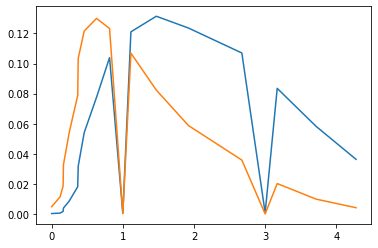

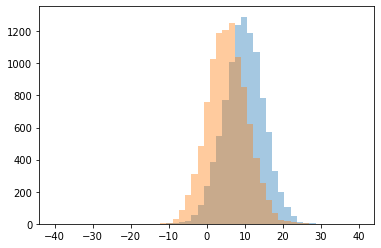

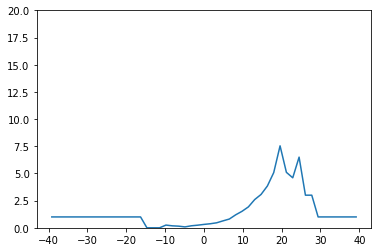

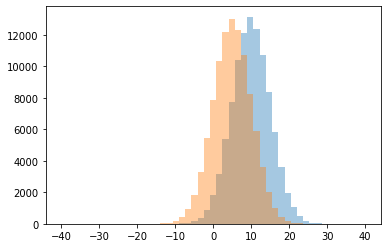

0 0.0
1 0.08241758241758242
2 0.1511627906976744
3 0.18181818181818182
4 0.18387096774193548
5 0.24066390041493776
6 0.25
7 0.31225296442687744
8 0.3729308666017527
9 0.46057046979865773
10 0.6379453189726595
11 0.8060654429369514
12 1.0
13 1.1938283510125363
14 1.5170387779083432
15 1.9209677419354838
16 2.5970873786407767
17 3.0
18 3.066666666666667
19 3.8456375838926173
20 4.6
21 5.076923076923077
22 5.1
23 6.5
24 7.538461538461538




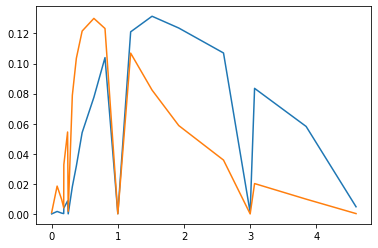

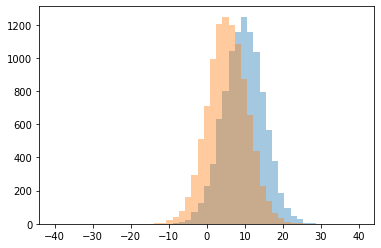

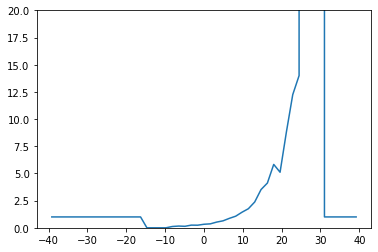

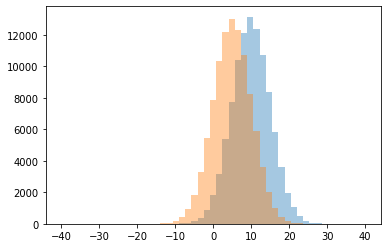

0 0.0
1 0.11904761904761904
2 0.13836477987421383
3 0.16
4 0.23929961089494164
5 0.24579124579124578
6 0.32531824611032534
7 0.3631790744466801
8 0.5252692626346314
9 0.6402243589743589
10 0.8681135225375626
11 1.0
12 1.066604995374653
13 1.4344827586206896
14 1.7537993920972645
15 2.3729977116704806
16 3.517699115044248
17 4.115942028985507
18 5.111111111111111
19 5.8307692307692305
20 8.818181818181818
21 12.25
22 14.0
23 999999.0




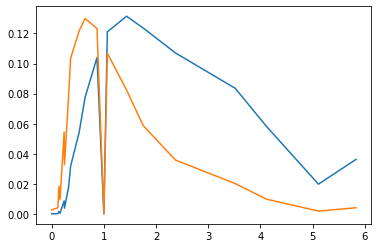

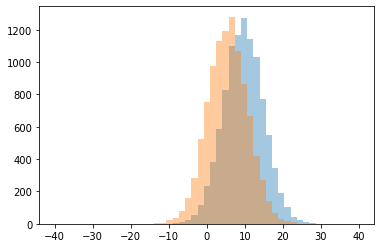

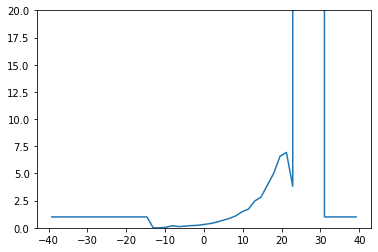

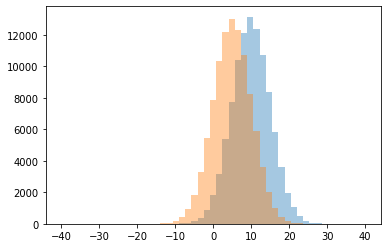

0 0.0
1 0.047619047619047616
2 0.1125
3 0.1509433962264151
4 0.1891891891891892
5 0.20284697508896798
6 0.2262357414448669
7 0.3072847682119205
8 0.38996929375639716
9 0.5195035460992907
10 0.694048616932104
11 0.8579234972677595
12 1.0
13 1.096622889305816
14 1.4733796296296295
15 1.7177177177177176
16 2.460620525059666
17 2.8315018315018317
18 3.8181818181818183
19 3.9214285714285713
20 5.0144927536231885
21 6.586206896551724
22 6.933333333333334
23 999999.0




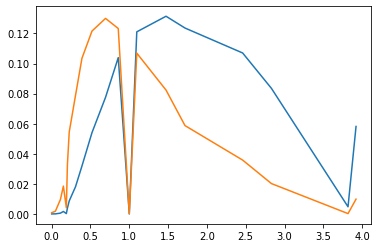

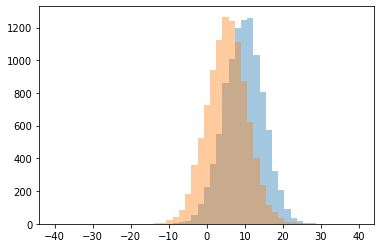

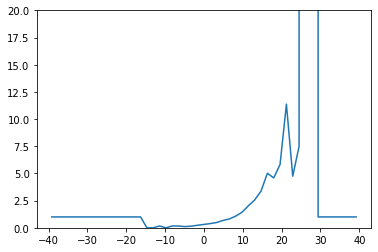

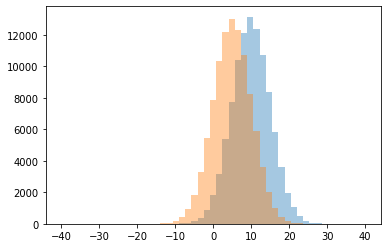

0 0.0
1 0.11049723756906077
2 0.15083798882681565
3 0.16091954022988506
4 0.16666666666666666
5 0.17073170731707318
6 0.23371647509578544
7 0.30939226519337015
8 0.3885350318471338
9 0.4871111111111111
10 0.6800947867298578
11 0.8107890499194848
12 1.0
13 1.0756756756756756
14 1.428735632183908
15 2.022508038585209
16 2.5621890547263684
17 3.3781512605042017
18 4.585714285714285
19 4.75
20 5.017543859649122
21 5.828571428571428
22 7.5
23 11.375
24 999999.0




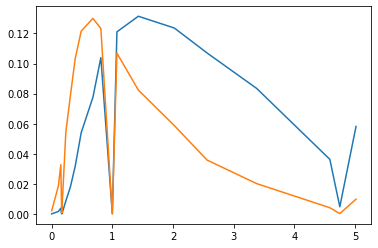

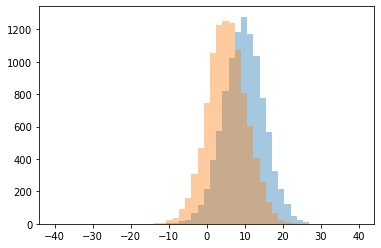

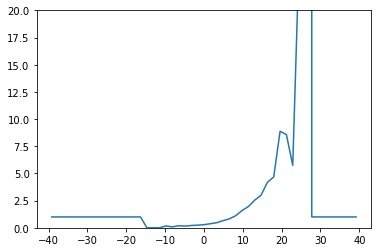

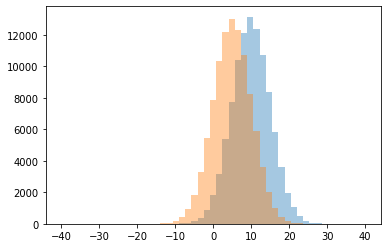

0 0.0
1 0.08571428571428572
2 0.1592356687898089
3 0.17391304347826086
4 0.18888888888888888
5 0.21172638436482086
6 0.24197002141327623
7 0.2859060402684564
8 0.375
9 0.4661224489795918
10 0.656
11 0.8236714975845411
12 1.0
13 1.1074766355140186
14 1.5875776397515529
15 1.9534109816971714
16 2.5405405405405403
17 3.0
18 4.176470588235294
19 4.681159420289855
20 5.75
21 8.571428571428571
22 8.875
23 25.0
24 999999.0




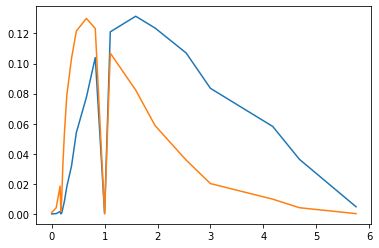

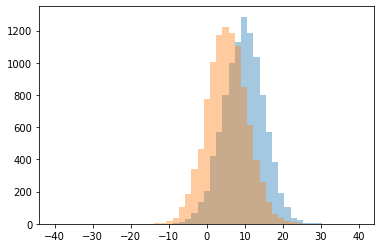

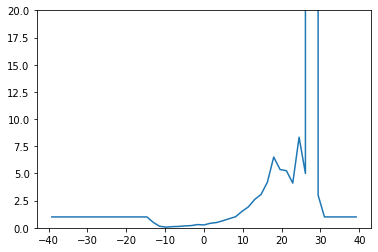

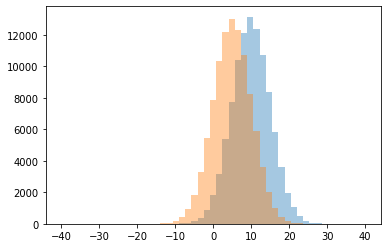

0 0.0625
1 0.10526315789473684
2 0.125
3 0.14285714285714285
4 0.17582417582417584
5 0.20294117647058824
6 0.2616580310880829
7 0.296137339055794
8 0.41592039800995023
9 0.4863247863247863
10 0.5
11 0.6535947712418301
12 0.8420608108108109
13 1.0
14 1.0217588395285584
15 1.5147232037691403
16 1.921951219512195
17 2.608040201005025
18 3.0
19 3.0653846153846156
20 4.111111111111111
21 4.198529411764706
22 5.0
23 5.25
24 5.361111111111111
25 6.508474576271187
26 8.333333333333334
27 999999.0




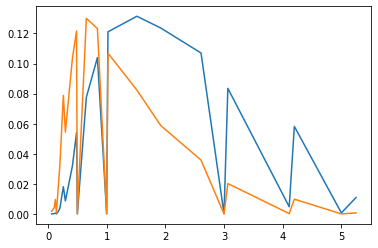

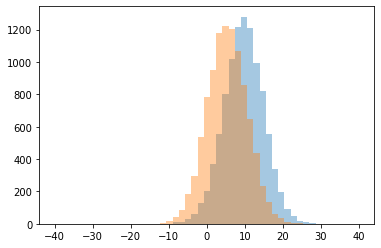

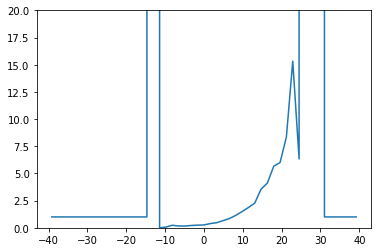

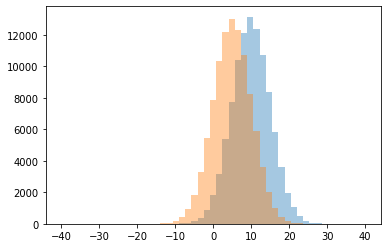

0 0.0
1 0.06666666666666667
2 0.16042780748663102
3 0.1686746987951807
4 0.2150170648464164
5 0.23255813953488372
6 0.24344569288389514
7 0.26248399487836105
8 0.38929695697796435
9 0.4686971235194585
10 0.6555102040816326
11 0.8492922564529559
12 1.0
13 1.139252336448598
14 1.48664343786295
15 1.8644067796610169
16 2.264236902050114
17 3.5474137931034484
18 4.118518518518519
19 5.666666666666667
20 6.0
21 6.333333333333333
22 8.363636363636363
23 15.333333333333334
24 999999.0




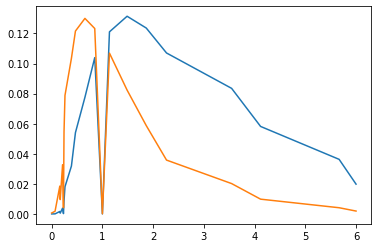

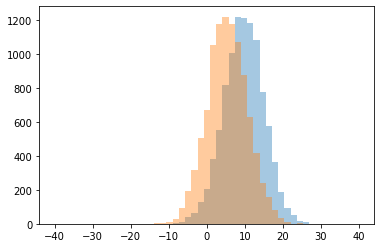

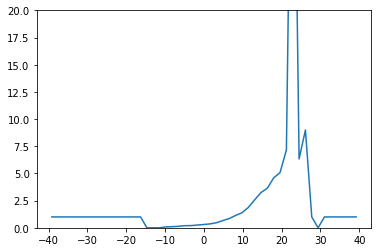

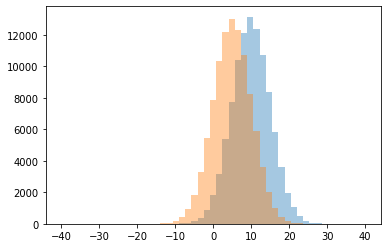

0 0.0
1 0.08333333333333333
2 0.10344827586206896
3 0.13829787234042554
4 0.1958762886597938
5 0.20189274447949526
6 0.2554027504911591
7 0.3044776119402985
8 0.36242884250474383
9 0.47198641765704585
10 0.6685761047463176
11 0.8543607112616427
12 1.0
13 1.139252336448598
14 1.3849658314350797
15 1.8736176935229067
16 2.5785714285714287
17 3.245833333333333
18 3.6455696202531644
19 4.594936708860759
20 5.081081081081081
21 6.333333333333333
22 7.153846153846154
23 9.0
24 51.0




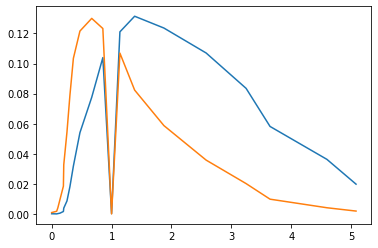

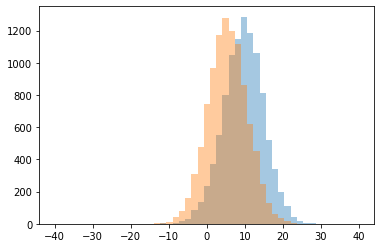

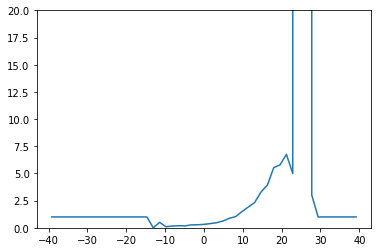

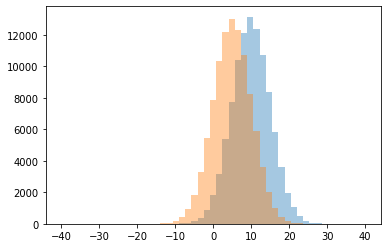

0 0.0
1 0.1
2 0.1590909090909091
3 0.1761006289308176
4 0.19480519480519481
5 0.2692307692307692
6 0.2797494780793319
7 0.316711590296496
8 0.38636363636363635
9 0.4697872340425532
10 0.5
11 0.6246081504702194
12 0.8716666666666667
13 1.0
14 1.0295964125560537
15 1.4953488372093022
16 1.9143780290791599
17 2.331868131868132
18 3.0
19 3.299595141700405
20 3.9242424242424243
21 5.0
22 5.532258064516129
23 5.794117647058823
24 6.75
25 999999.0




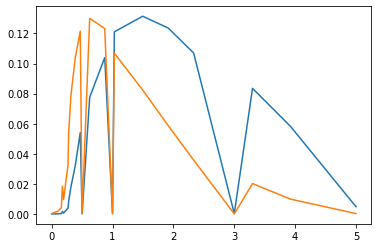

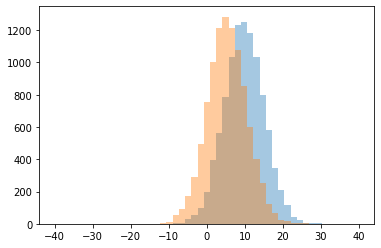

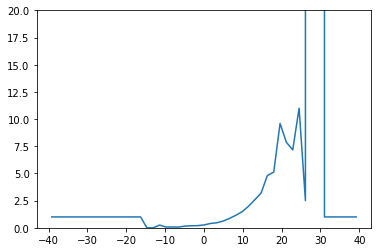

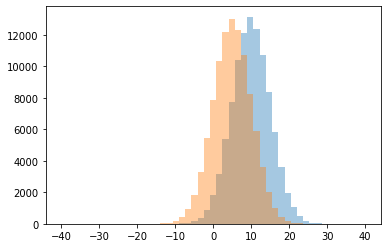

0 0.0
1 0.06521739130434782
2 0.07142857142857142
3 0.07407407407407407
4 0.1588235294117647
5 0.1875
6 0.19838056680161945
7 0.25
8 0.26162018592297476
9 0.3946053946053946
10 0.4612850082372323
11 0.6141855027279813
12 0.8532563891178895
13 1.0
14 1.1449814126394051
15 1.4700352526439482
16 1.9683860232945092
17 2.5
18 2.568238213399504
19 3.187250996015936
20 4.809917355371901
21 5.117647058823529
22 7.166666666666667
23 7.866666666666666
24 9.590909090909092
25 11.0
26 999999.0




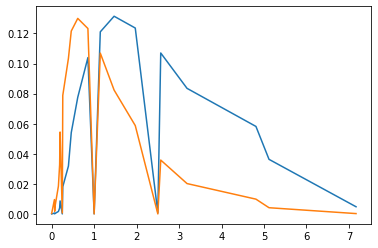

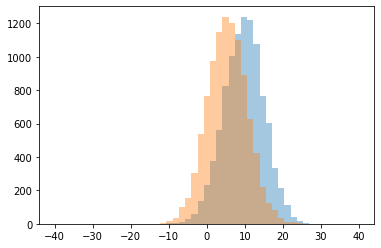

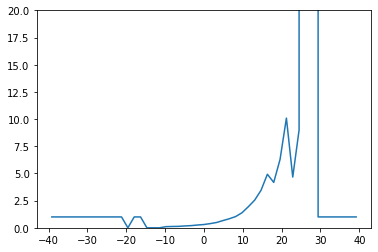

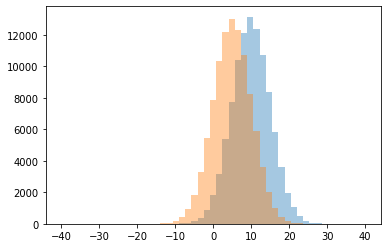

0 0.0
1 0.10526315789473684
2 0.12121212121212122
3 0.13131313131313133
4 0.16993464052287582
5 0.20198675496688742
6 0.2569832402234637
7 0.30247718383311606
8 0.3870636550308008
9 0.490418118466899
10 0.6666666666666666
11 0.8330564784053156
12 1.0
13 1.0346399270738378
14 1.387458006718925
15 1.940988835725678
16 2.5473933649289098
17 3.4524886877828056
18 4.175
19 4.666666666666667
20 4.926229508196721
21 6.294117647058823
22 9.0
23 10.090909090909092
24 999999.0




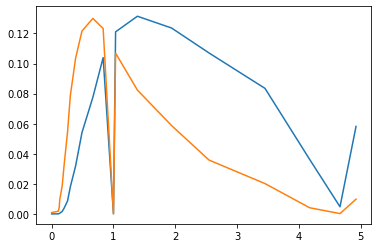

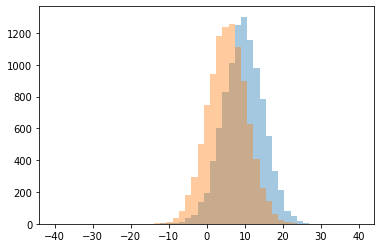

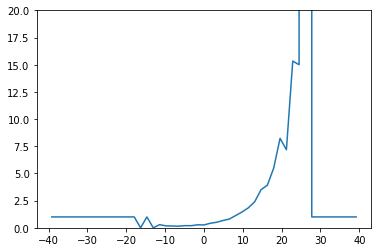

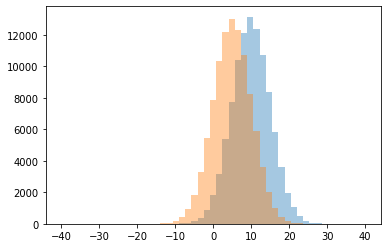

0 0.0
1 0.14814814814814814
2 0.16216216216216217
3 0.18181818181818182
4 0.1952054794520548
5 0.19889502762430938
6 0.26273458445040215
7 0.2757936507936508
8 0.2857142857142857
9 0.4163135593220339
10 0.5097210481825867
11 0.6696284329563813
12 0.8046068308181096
13 1.0
14 1.1278127812781278
15 1.4542410714285714
16 1.839171974522293
17 2.3970588235294117
18 3.5
19 3.921985815602837
20 5.5
21 7.181818181818182
22 8.23076923076923
23 15.0
24 15.333333333333334
25 999999.0




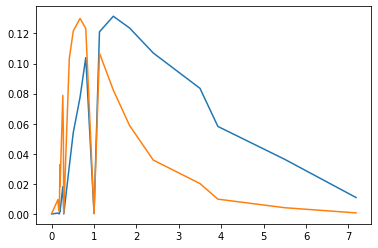

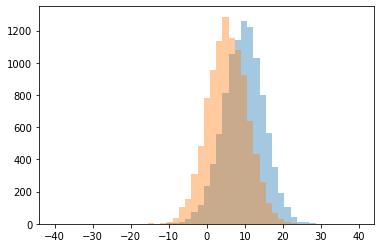

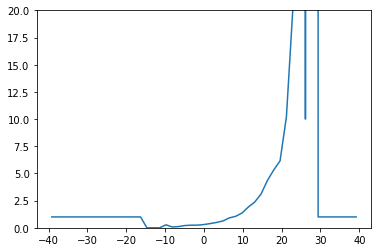

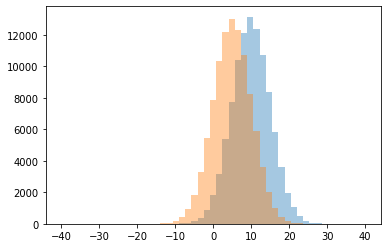

0 0.0
1 0.07692307692307693
2 0.11428571428571428
3 0.20915032679738563
4 0.24025974025974026
5 0.2443064182194617
6 0.2727272727272727
7 0.30038510911424904
8 0.3903966597077244
9 0.49382716049382713
10 0.6306376360808709
11 0.9125541125541126
12 1.0
13 1.0545790934320074
14 1.3581445523193096
15 1.909375
16 2.36697247706422
17 3.1011673151750974
18 4.346153846153846
19 5.318181818181818
20 6.161290322580645
21 10.0
22 10.2
23 20.0
24 999999.0




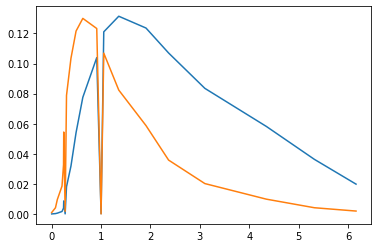

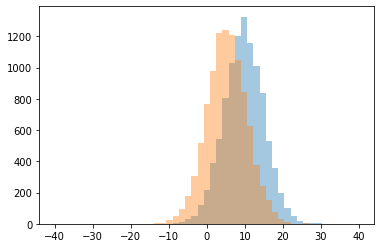

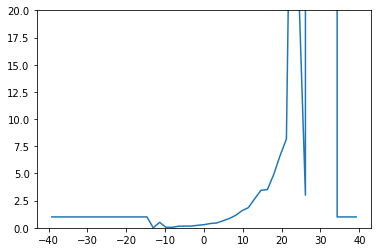

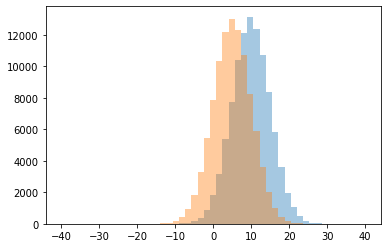

0 0.0
1 0.041666666666666664
2 0.045454545454545456
3 0.14432989690721648
4 0.15555555555555556
5 0.16013071895424835
6 0.229126213592233
7 0.2845953002610966
8 0.39591836734693875
9 0.44353518821603927
10 0.5
11 0.6486704270749396
12 0.8514851485148515
13 1.0
14 1.1476190476190475
15 1.5729537366548043
16 1.8544
17 2.671957671957672
18 3.0
19 3.4545454545454546
20 3.513333333333333
21 4.904109589041096
22 6.633333333333334
23 8.166666666666666
24 21.0
25 50.0
26 999999.0




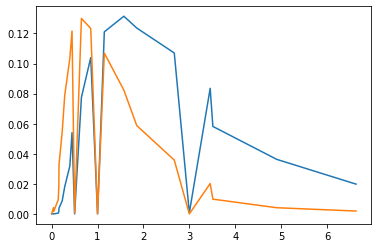

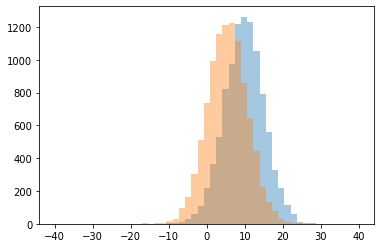

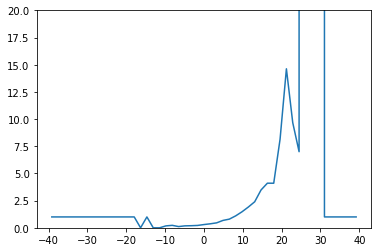

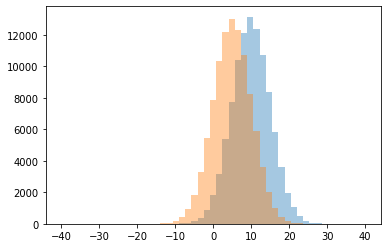

0 0.0
1 0.1134020618556701
2 0.17647058823529413
3 0.17901234567901234
4 0.19281045751633988
5 0.2172211350293542
6 0.22580645161290322
7 0.29850746268656714
8 0.3682092555331992
9 0.455565142364107
10 0.6795716639209226
11 0.7973856209150327
12 1.0
13 1.098021582733813
14 1.4737456242707119
15 1.9114906832298137
16 2.3945578231292517
17 3.4801762114537445
18 4.1
19 4.102941176470588
20 7.0
21 8.148148148148149
22 9.666666666666666
23 14.625
24 999999.0




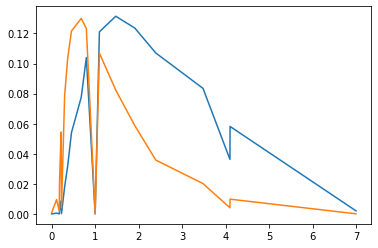

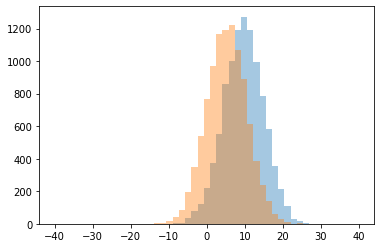

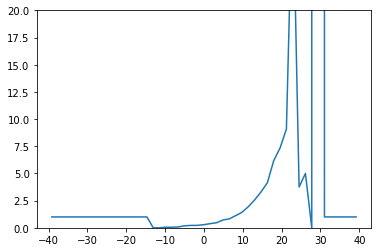

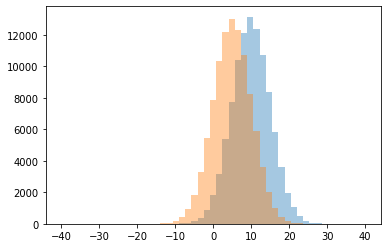

0 0.0
1 0.04878048780487805
2 0.05555555555555555
3 0.08139534883720931
4 0.18974358974358974
5 0.22063037249283668
6 0.22509225092250923
7 0.2896103896103896
8 0.3837448559670782
9 0.4700342465753425
10 0.7189597315436241
11 0.8203445447087777
12 1.0
13 1.1200750469043153
14 1.4271300448430493
15 1.9446254071661238
16 2.5684754521963824
17 3.3037974683544302
18 3.75
19 4.15
20 5.0
21 6.172413793103448
22 7.344827586206897
23 9.083333333333334
24 32.0
25 999999.0




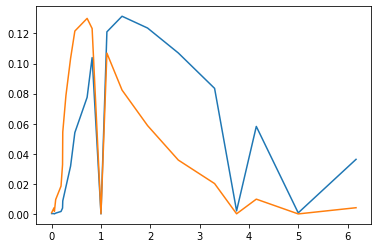

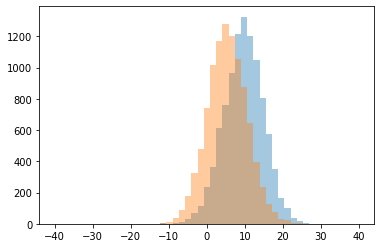

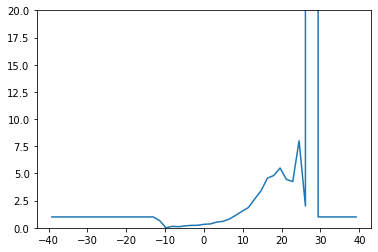

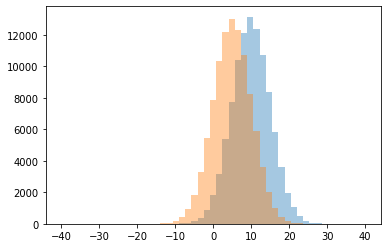

0 0.0
1 0.10227272727272728
2 0.13157894736842105
3 0.17318435754189945
4 0.2236024844720497
5 0.23125
6 0.3216216216216216
7 0.3556650246305419
8 0.5238907849829352
9 0.5927956147220047
10 0.6666666666666666
11 0.8006644518272426
12 1.0
13 1.1496212121212122
14 1.5160183066361557
15 1.8604651162790697
16 2.0
17 2.6473551637279598
18 3.406779661016949
19 4.25
20 4.454545454545454
21 4.563492063492063
22 4.808219178082192
23 5.5
24 8.0
25 999999.0




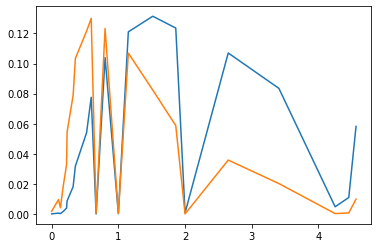

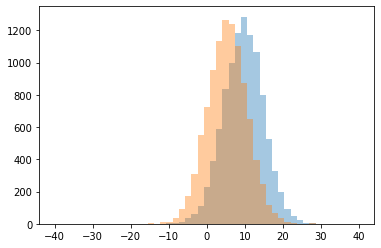

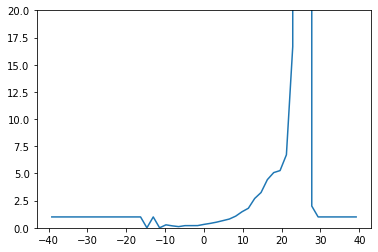

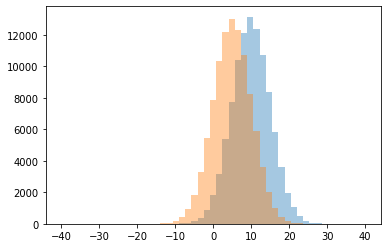

0 0.0
1 0.10869565217391304
2 0.1794871794871795
3 0.19883040935672514
4 0.2
5 0.20218579234972678
6 0.2727272727272727
7 0.313969571230982
8 0.40713536201469047
9 0.5207780725022104
10 0.6619160728424386
11 0.8062953995157385
12 1.0
13 1.0715579710144927
14 1.4758620689655173
15 1.7975460122699387
16 2.0
17 2.69873417721519
18 3.2439024390243905
19 4.432203389830509
20 5.078125
21 5.2631578947368425
22 6.714285714285714
23 16.666666666666668
24 999999.0




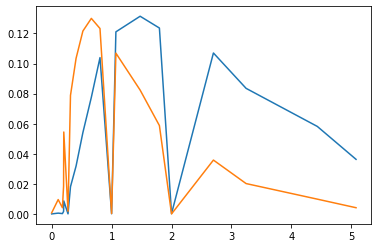

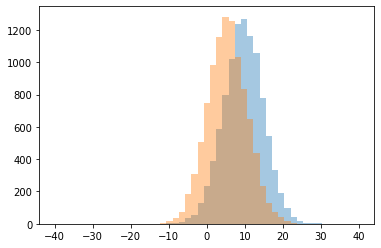

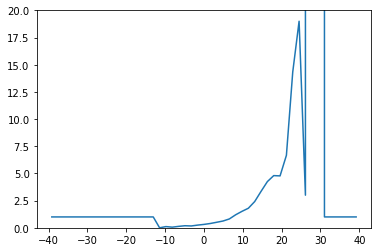

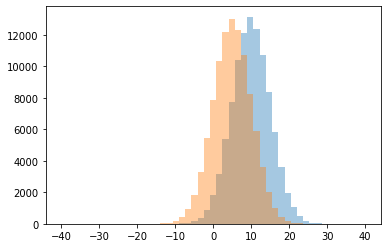

0 0.0
1 0.058823529411764705
2 0.1111111111111111
3 0.13157894736842105
4 0.16883116883116883
5 0.19021739130434784
6 0.24803149606299213
7 0.31241655540720964
8 0.39613034623217924
9 0.5082108902333622
10 0.6232449297971919
11 0.8138424821002387
12 1.0
13 1.1988360814742969
14 1.5155502392344498
15 1.7990726429675425
16 2.414187643020595
17 3.0
18 3.3491379310344827
19 4.25
20 4.775
21 4.8
22 6.666666666666667
23 14.333333333333334
24 19.0
25 999999.0




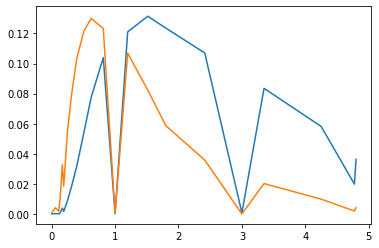

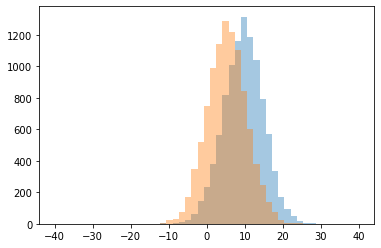

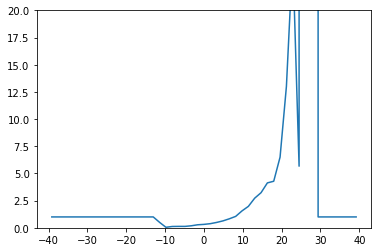

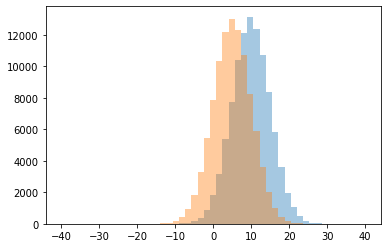

0 0.047619047619047616
1 0.12121212121212122
2 0.12941176470588237
3 0.12987012987012986
4 0.18518518518518517
5 0.2774566473988439
6 0.31501340482573725
7 0.3800403225806452
8 0.4943231441048035
9 0.5
10 0.6371406371406372
11 0.828125
12 1.0
13 1.0496838301716351
14 1.5555555555555556
15 1.9701986754966887
16 2.7258485639686683
17 3.2285714285714286
18 4.130434782608695
19 4.282051282051282
20 5.666666666666667
21 6.5
22 13.0
23 25.0
24 999999.0




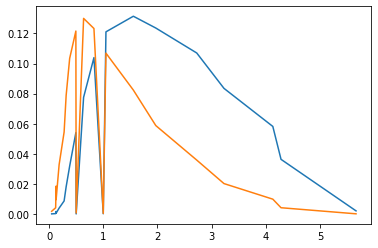

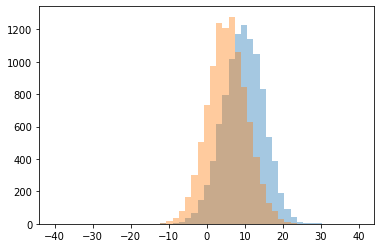

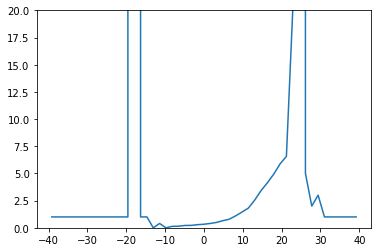

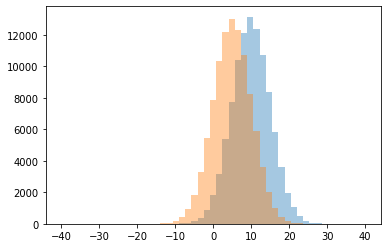

0 0.0
1 0.13513513513513514
2 0.14473684210526316
3 0.2155688622754491
4 0.22333333333333333
5 0.2879684418145957
6 0.32833787465940056
7 0.39959016393442626
8 0.4
9 0.49637389202256244
10 0.6573080099091659
11 0.7934272300469484
12 1.0
13 1.0997177798682973
14 1.4498229043683588
15 1.8126984126984127
16 2.0
17 2.5474452554744524
18 3.0
19 3.419753086419753
20 4.1395348837209305
21 4.935897435897436
22 5.0
23 5.875
24 6.571428571428571
25 20.0
26 999999.0




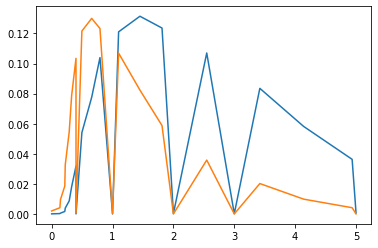

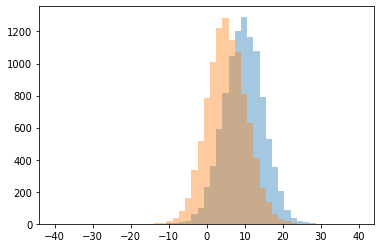

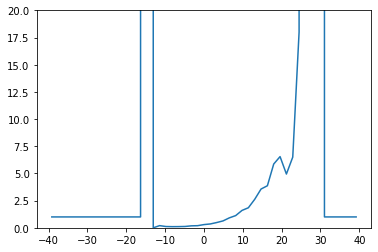

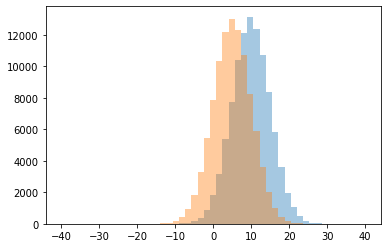

0 0.0
1 0.10526315789473684
2 0.10975609756097561
3 0.11764705882352941
4 0.12195121951219512
5 0.17964071856287425
6 0.195357833655706
7 0.2
8 0.2951653944020356
9 0.35410484668644904
10 0.48278688524590163
11 0.6334630350194552
12 0.9143356643356644
13 1.0
14 1.1223155929038282
15 1.599009900990099
16 1.8431061806656102
17 2.6189320388349513
18 3.565610859728507
19 3.8676470588235294
20 4.944444444444445
21 5.866666666666666
22 6.5
23 6.548387096774194
24 18.0
25 999999.0




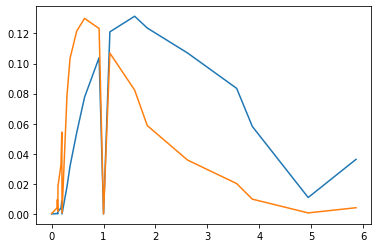

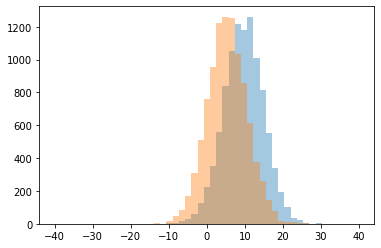

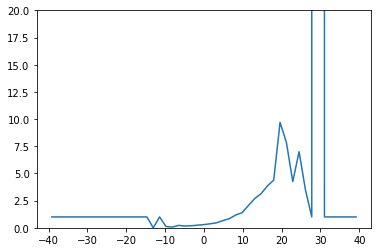

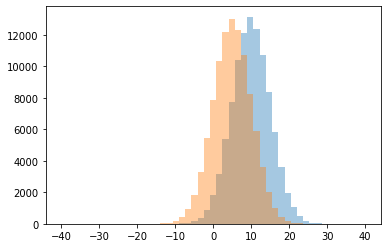

0 0.0
1 0.06521739130434782
2 0.125
3 0.16374269005847952
4 0.18770226537216828
5 0.21951219512195122
6 0.2421875
7 0.29658792650918636
8 0.3706806282722513
9 0.460655737704918
10 0.6645519429024583
11 0.8386581469648562
12 1.0
13 1.1768115942028985
14 1.3812865497076023
15 2.043831168831169
16 2.6888297872340425
17 3.1346153846153846
18 3.5
19 3.8472222222222223
20 4.25
21 4.3896103896103895
22 7.0
23 7.846153846153846
24 9.7
25 999999.0




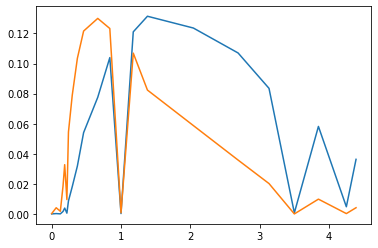

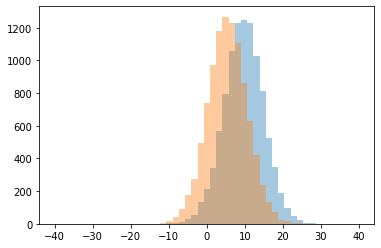

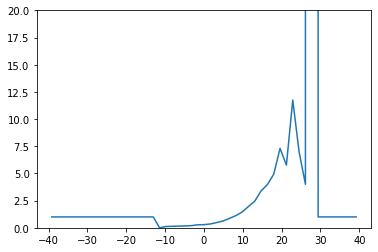

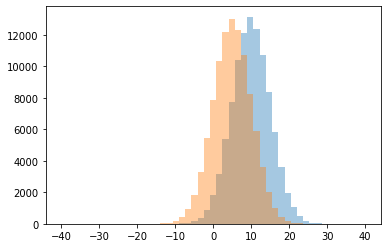

0 0.0
1 0.11764705882352941
2 0.13953488372093023
3 0.15555555555555556
4 0.1724137931034483
5 0.19927536231884058
6 0.27235772357723576
7 0.2886178861788618
8 0.35288065843621397
9 0.4826418289585097
10 0.6269716088328076
11 0.8599348534201955
12 1.0
13 1.1120144534778682
14 1.4439306358381503
15 1.9523052464228934
16 2.4441805225653206
17 3.3875
18 3.977272727272727
19 4.0
20 4.928571428571429
21 5.764705882352941
22 7.0
23 7.3076923076923075
24 11.75
25 999999.0




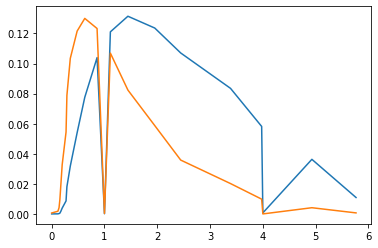

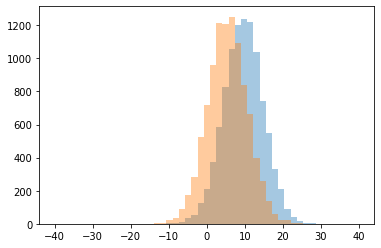

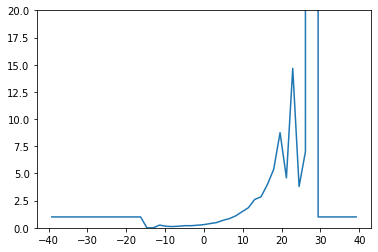

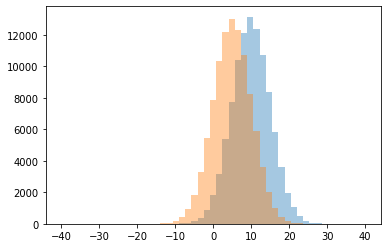

0 0.0
1 0.11428571428571428
2 0.14285714285714285
3 0.14444444444444443
4 0.19217081850533807
5 0.1977401129943503
6 0.23954372623574144
7 0.25
8 0.2926490984743412
9 0.39166666666666666
10 0.4831275720164609
11 0.6882255389718076
12 0.8434504792332268
13 1.0
14 1.0959780621572213
15 1.4761904761904763
16 1.8444108761329305
17 2.606516290726817
18 2.8544061302681993
19 3.8
20 3.9782608695652173
21 4.6
22 5.387096774193548
23 7.0
24 8.75
25 14.666666666666666
26 999999.0




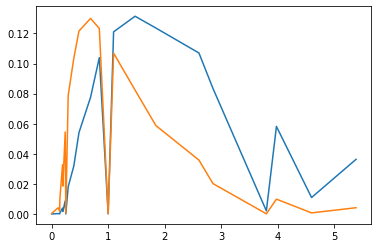

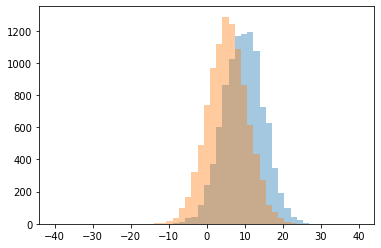

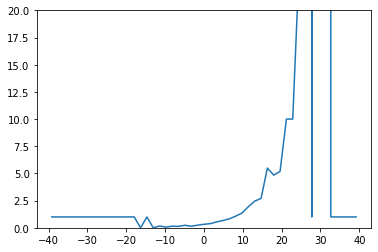

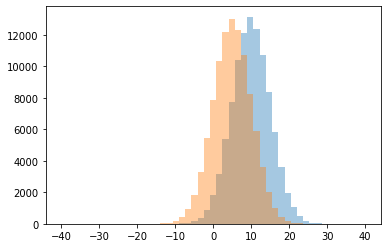

0 0.0
1 0.06666666666666667
2 0.13131313131313133
3 0.13975155279503104
4 0.14705882352941177
5 0.16666666666666666
6 0.23214285714285715
7 0.24335378323108384
8 0.32476319350473615
9 0.38405797101449274
10 0.5412186379928315
11 0.6692546583850931
12 0.8236714975845411
13 1.0
14 1.0716911764705883
15 1.3602771362586605
16 1.9429967426710097
17 2.4530892448512587
18 2.7
19 4.847222222222222
20 5.1891891891891895
21 5.491228070175438
22 10.0
23 24.0
24 999999.0




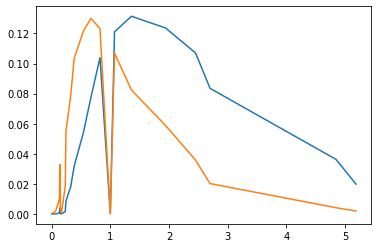

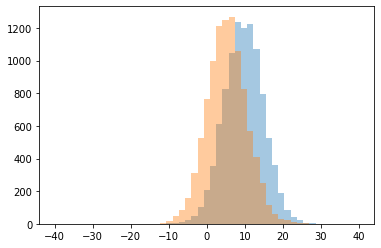

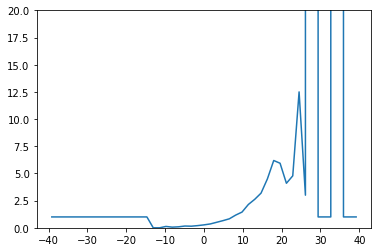

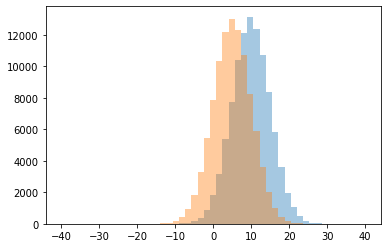

0 0.0
1 0.06
2 0.09195402298850575
3 0.125
4 0.14743589743589744
5 0.1625
6 0.20076481835564053
7 0.2690288713910761
8 0.3557114228456914
9 0.5066115702479339
10 0.6592
11 0.8266351457840819
12 1.0
13 1.168560606060606
14 1.4463208685162847
15 2.1453590192644483
16 2.6170731707317074
17 3.0
18 3.1887550200803214
19 4.095238095238095
20 4.495726495726496
21 4.777777777777778
22 5.9375
23 6.189655172413793
24 12.5
25 999999.0




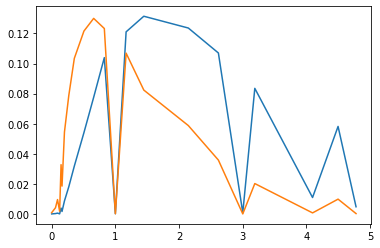

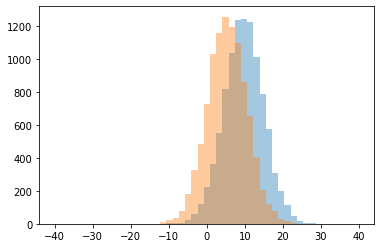

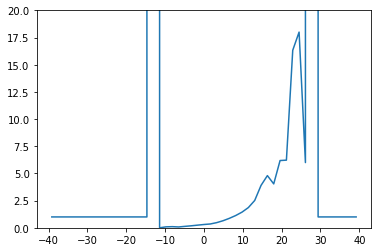

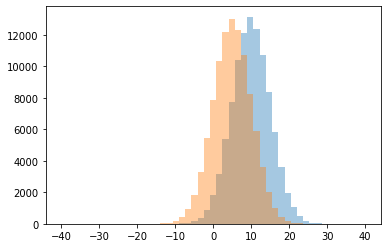

0 0.0
1 0.07692307692307693
2 0.08695652173913043
3 0.10526315789473684
4 0.13259668508287292
5 0.18404907975460122
6 0.2448559670781893
7 0.3036935704514364
8 0.35208535402521823
9 0.47459086993970717
10 0.6489277204130263
11 0.8696741854636592
12 1.0
13 1.1280653950953679
14 1.4414831981460023
15 1.8601823708206686
16 2.512376237623762
17 3.9014778325123154
18 4.038961038961039
19 4.8
20 6.0
21 6.1875
22 6.222222222222222
23 16.333333333333332
24 18.0
25 999999.0




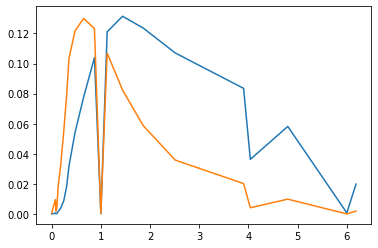

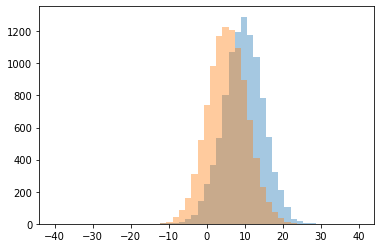

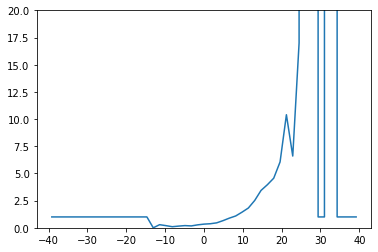

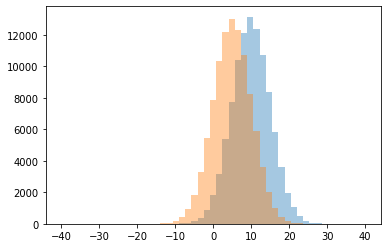

0 0.0
1 0.1
2 0.1566265060240964
3 0.17307692307692307
4 0.2
5 0.20253164556962025
6 0.2706333973128599
7 0.2857142857142857
8 0.33827493261455527
9 0.37398373983739835
10 0.4550898203592814
11 0.6576797385620915
12 0.8888888888888888
13 1.0
14 1.0873521383075524
15 1.4376391982182628
16 1.820710973724884
17 2.513317191283293
18 3.43859649122807
19 3.963235294117647
20 4.563380281690141
21 6.057142857142857
22 6.6
23 10.4
24 17.0
25 999999.0




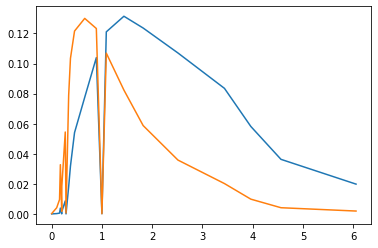

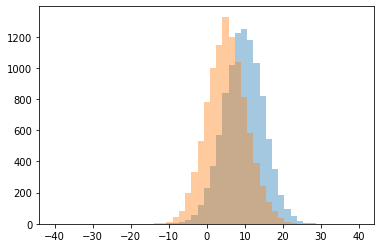

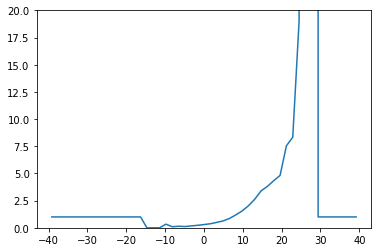

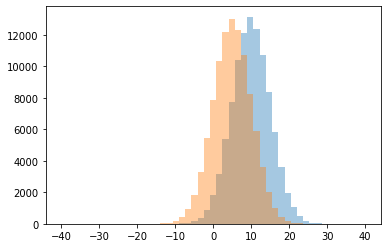

0 0.0
1 0.0975609756097561
2 0.115
3 0.14285714285714285
4 0.17575757575757575
5 0.22916666666666666
6 0.29781771501925547
7 0.3333333333333333
8 0.37011033099297896
9 0.4956293706293706
10 0.6295180722891566
11 0.8515429524603837
12 1.0
13 1.1799807507218478
14 1.54064039408867
15 2.018867924528302
16 2.623409669211196
17 3.3900414937759336
18 3.8098591549295775
19 4.333333333333333
20 4.815789473684211
21 7.538461538461538
22 8.333333333333334
23 19.0
24 999999.0




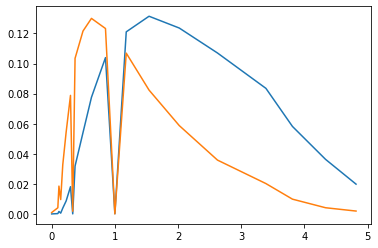

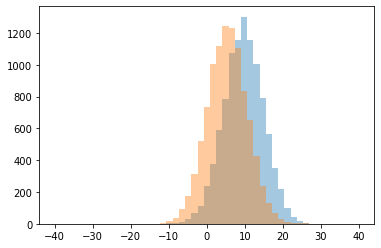

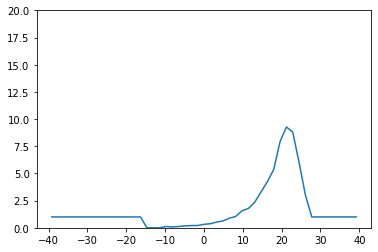

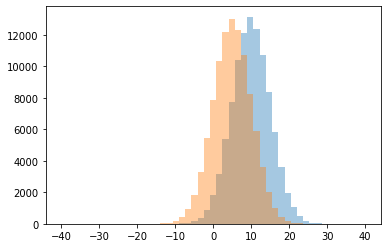

0 0.0
1 0.08108108108108109
2 0.11764705882352941
3 0.11827956989247312
4 0.1751412429378531
5 0.20766773162939298
6 0.21001926782273603
7 0.32060027285129605
8 0.37475149105367794
9 0.5273052820053715
10 0.6318327974276527
11 0.8763222131814483
12 1.0
13 1.0443037974683544
14 1.5604790419161676
15 1.7769230769230768
16 2.348946135831382
17 3.0
18 3.301255230125523
19 4.2388059701492535
20 5.369230769230769
21 6.0
22 7.928571428571429
23 8.8
24 9.272727272727273




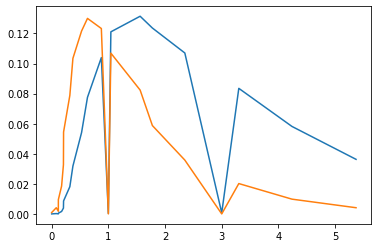

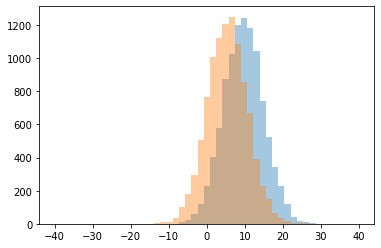

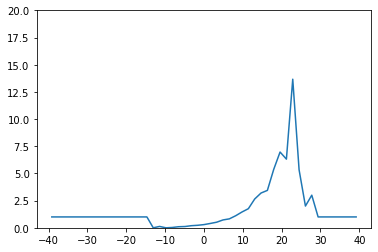

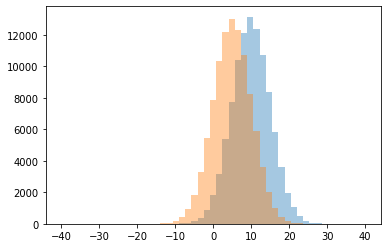

0 0.0
1 0.030303030303030304
2 0.09900990099009901
3 0.11731843575418995
4 0.125
5 0.19322033898305085
6 0.23076923076923078
7 0.2942708333333333
8 0.399402390438247
9 0.5142857142857142
10 0.7230514096185738
11 0.8216
12 1.0
13 1.1089566020313943
14 1.455503512880562
15 1.7570789865871832
16 2.0
17 2.649746192893401
18 3.0
19 3.1991341991341993
20 3.4407894736842106
21 5.333333333333333
22 5.375
23 6.315789473684211
24 6.96969696969697
25 13.666666666666666




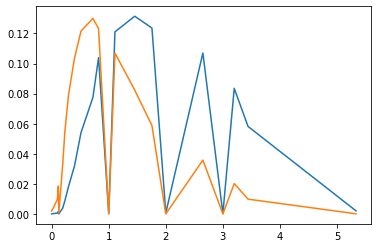

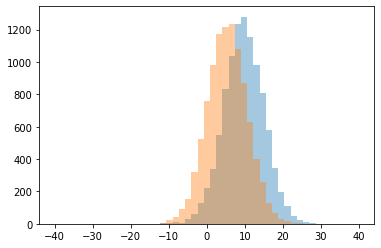

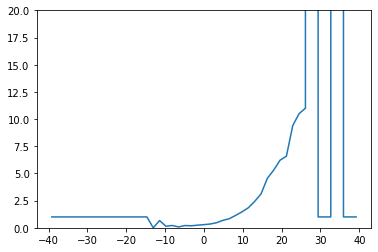

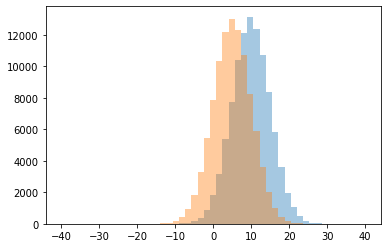

0 0.0
1 0.07865168539325842
2 0.14285714285714285
3 0.18553459119496854
4 0.21052631578947367
5 0.21428571428571427
6 0.2413793103448276
7 0.2919418758256275
8 0.34831460674157305
9 0.4705380017079419
10 0.6666666666666666
11 0.6850328947368421
12 0.8391269199676638
13 1.0
14 1.143253234750462
15 1.4678899082568808
16 1.8437001594896332
17 2.4292803970223327
18 3.1196911196911197
19 4.559055118110236
20 5.3076923076923075
21 6.21875
22 6.588235294117647
23 9.4
24 10.5
25 11.0
26 999999.0




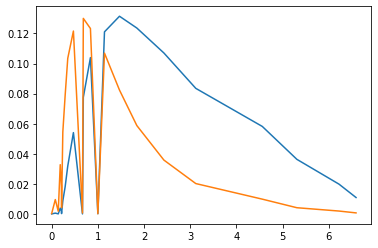

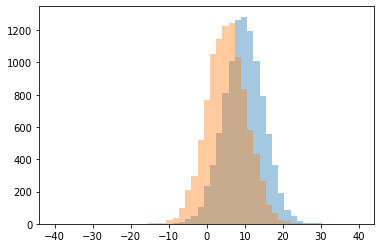

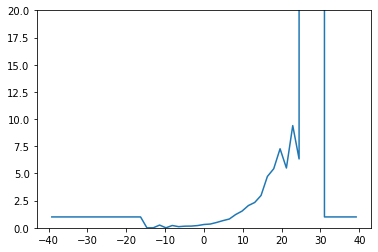

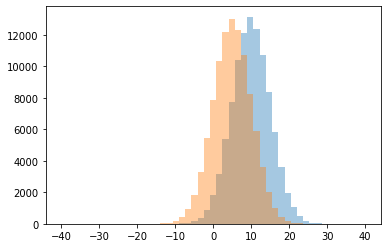

0 0.0
1 0.10526315789473684
2 0.1497584541062802
3 0.1564625850340136
4 0.20656370656370657
5 0.21212121212121213
6 0.25
7 0.30497382198952877
8 0.34629981024667933
9 0.49213286713286714
10 0.6609477124183006
11 0.8088353413654619
12 1.0
13 1.221042471042471
14 1.534688995215311
15 2.0445205479452055
16 2.3294930875576036
17 2.973684210526316
18 4.720338983050848
19 5.432835820895522
20 5.5
21 6.333333333333333
22 7.269230769230769
23 9.4
24 999999.0




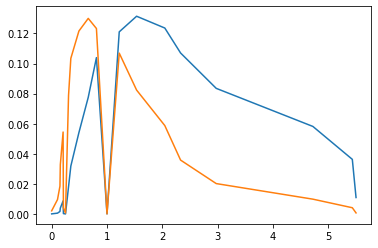

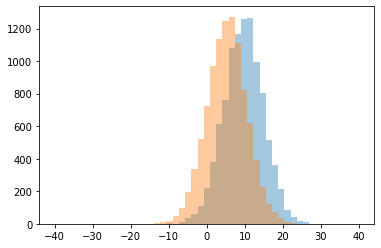

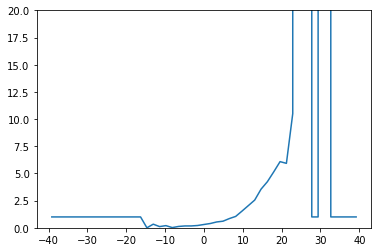

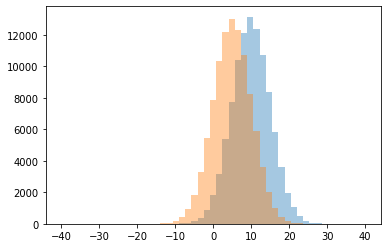

0 0.0
1 0.02040816326530612
2 0.1111111111111111
3 0.125
4 0.17010309278350516
5 0.1710914454277286
6 0.2
7 0.21183206106870228
8 0.3052486187845304
9 0.3333333333333333
10 0.39503619441571874
11 0.5369068541300527
12 0.6076861489191353
13 0.8483896307934015
14 1.0
15 1.0467625899280575
16 1.5371498172959805
17 2.0420032310177705
18 2.549872122762148
19 3.5530973451327434
20 4.239669421487603
21 5.142857142857143
22 5.928571428571429
23 6.085714285714285
24 10.5
25 999999.0




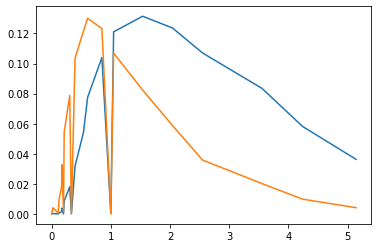

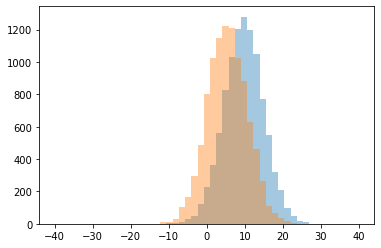

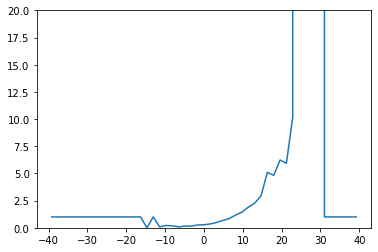

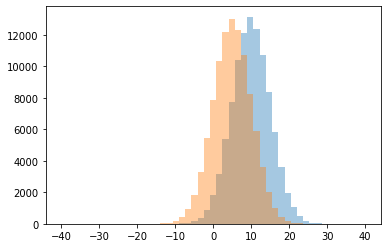

0 0.0
1 0.08571428571428572
2 0.09090909090909091
3 0.15699658703071673
4 0.16363636363636364
5 0.18518518518518517
6 0.21428571428571427
7 0.257201646090535
8 0.2805486284289277
9 0.35546875
10 0.49214659685863876
11 0.6783960720130933
12 0.8551324503311258
13 1.0
14 1.1736585365853658
15 1.4463276836158192
16 1.8987341772151898
17 2.2711496746203905
18 2.9427480916030535
19 4.82089552238806
20 5.101851851851852
21 5.9375
22 6.235294117647059
23 10.2
24 999999.0




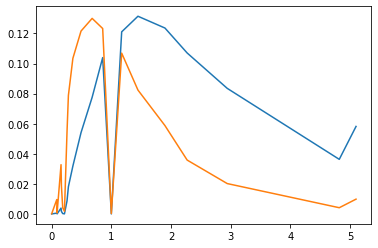

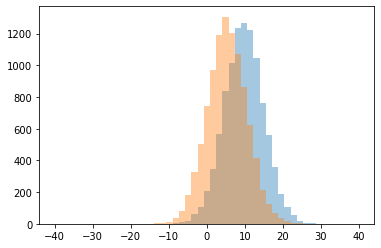

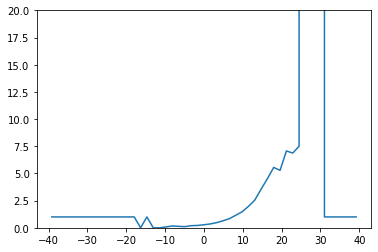

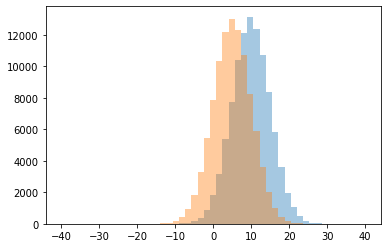

0 0.0
1 0.07692307692307693
2 0.10555555555555556
3 0.13253012048192772
4 0.17142857142857143
5 0.1951219512195122
6 0.21669980119284293
7 0.27994616419919244
8 0.35537190082644626
9 0.4752724224643755
10 0.6431852986217458
11 0.8391376451077943
12 1.0
13 1.1481826654240448
14 1.4664351851851851
15 1.9630225080385852
16 2.5351089588377724
17 3.546728971962617
18 4.516129032258065
19 5.285714285714286
20 5.553846153846154
21 6.875
22 7.066666666666666
23 7.5
24 999999.0




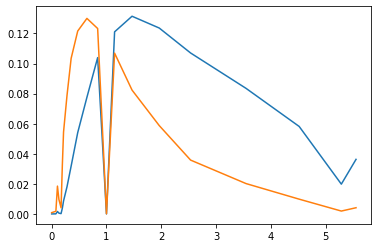

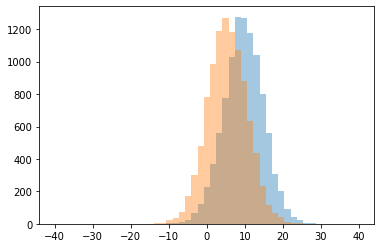

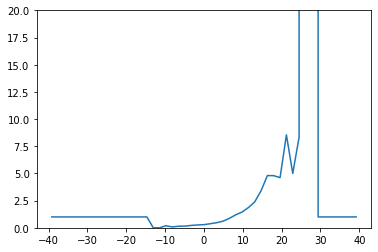

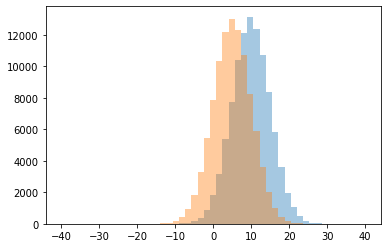

0 0.0
1 0.07894736842105263
2 0.14666666666666667
3 0.15294117647058825
4 0.19047619047619047
5 0.22073578595317725
6 0.2604166666666667
7 0.28974358974358977
8 0.37601626016260165
9 0.47053872053872053
10 0.6099290780141844
11 0.8683544303797468
12 1.0
13 1.19234360410831
14 1.44874715261959
15 1.8564668769716088
16 2.379862700228833
17 3.402542372881356
18 4.613636363636363
19 4.796875
20 4.803418803418803
21 5.0
22 8.333333333333334
23 8.545454545454545
24 999999.0




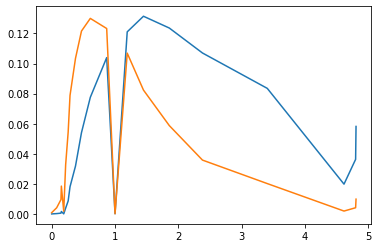

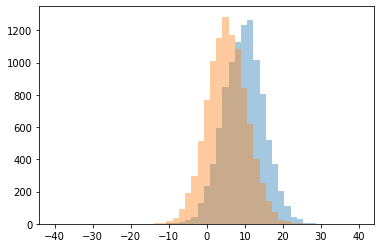

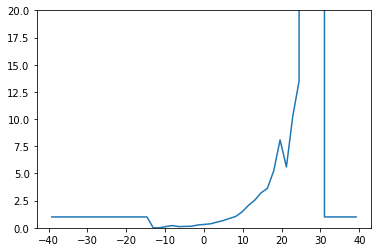

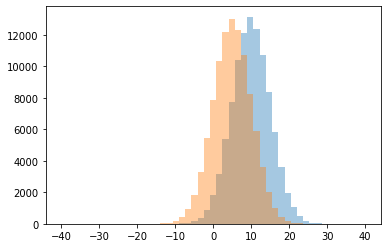

0 0.0
1 0.1111111111111111
2 0.11235955056179775
3 0.12953367875647667
4 0.13945578231292516
5 0.20588235294117646
6 0.25440313111545987
7 0.3072916666666667
8 0.3673267326732673
9 0.5147313691507799
10 0.6599221789883268
11 0.8555555555555555
12 1.0
13 1.040590405904059
14 1.4568047337278107
15 2.053484602917342
16 2.536159600997506
17 3.2151394422310755
18 3.625
19 5.23943661971831
20 5.6
21 8.08
22 10.25
23 13.5
24 999999.0




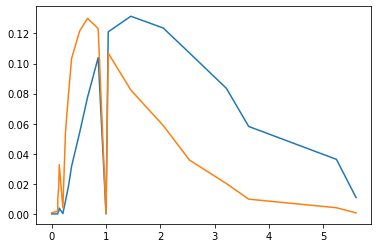

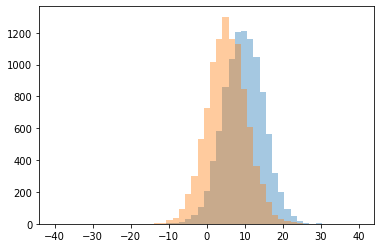

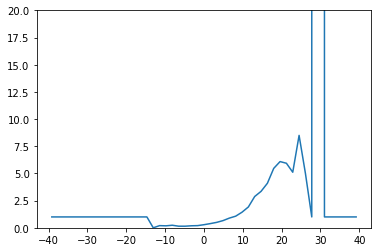

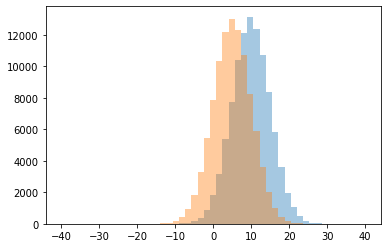

0 0.0
1 0.14736842105263157
2 0.14893617021276595
3 0.18181818181818182
4 0.18543046357615894
5 0.2
6 0.20037453183520598
7 0.23529411764705882
8 0.28512396694214875
9 0.38605108055009824
10 0.4991394148020654
11 0.6610299769408148
12 0.8913793103448275
13 1.0
14 1.0690265486725663
15 1.4348341232227488
16 1.9158415841584158
17 2.879120879120879
18 3.350806451612903
19 4.094202898550725
20 5.0
21 5.111111111111111
22 5.4655172413793105
23 5.9375
24 6.090909090909091
25 8.5
26 999999.0




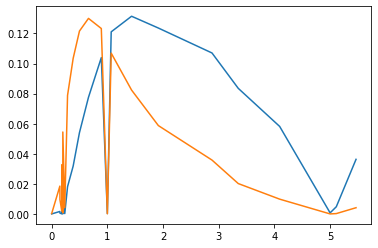

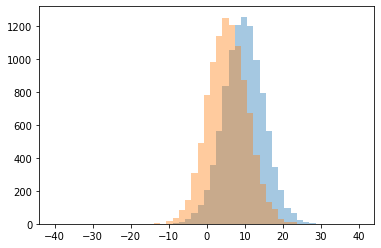

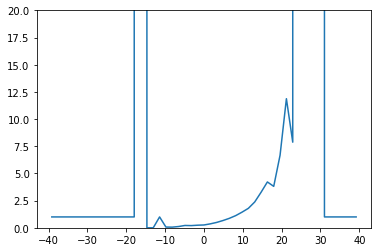

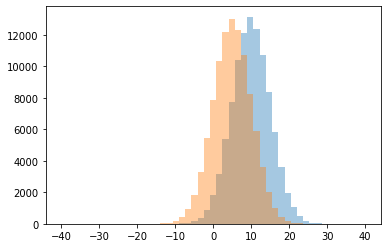

0 0.0
1 0.06060606060606061
2 0.06666666666666667
3 0.11764705882352941
4 0.20257234726688103
5 0.2152777777777778
6 0.23877551020408164
7 0.2599231754161332
8 0.36289500509684
9 0.4942932396839333
10 0.6693290734824281
11 0.8701406120760959
12 1.0
13 1.1196660482374767
14 1.4382151029748285
15 1.7901785714285714
16 2.373205741626794
17 3.263374485596708
18 3.811111111111111
19 4.2164179104477615
20 6.67741935483871
21 7.875
22 11.875
23 999999.0




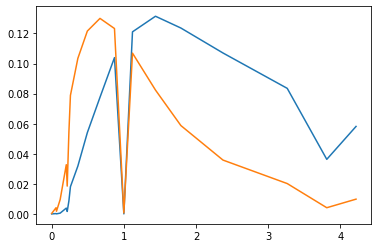

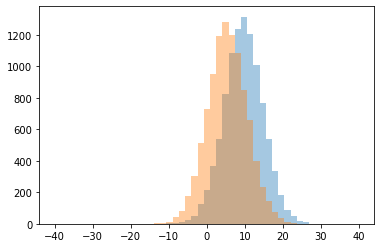

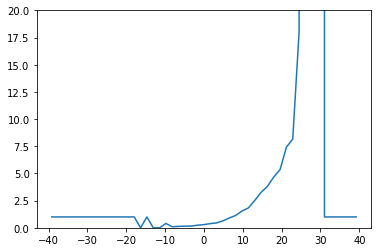

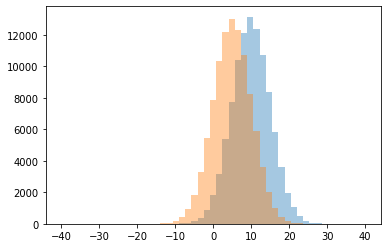

0 0.0
1 0.09523809523809523
2 0.13253012048192772
3 0.14857142857142858
4 0.16013071895424835
5 0.2407766990291262
6 0.29218106995884774
7 0.3857442348008386
8 0.4
9 0.45142378559463986
10 0.6417445482866043
11 0.9040066777963273
12 1.0
13 1.1361545538178472
14 1.5434272300469483
15 1.82701062215478
16 2.508728179551122
17 3.2584745762711864
18 3.8028169014084505
19 4.666666666666667
20 5.352941176470588
21 7.416666666666667
22 8.166666666666666
23 18.0
24 999999.0




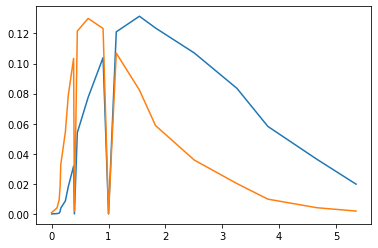

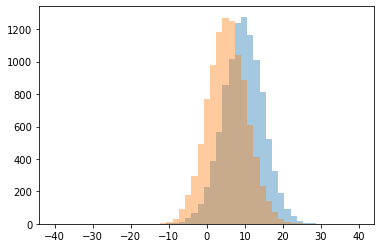

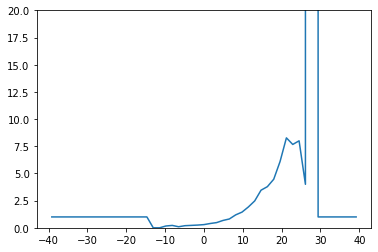

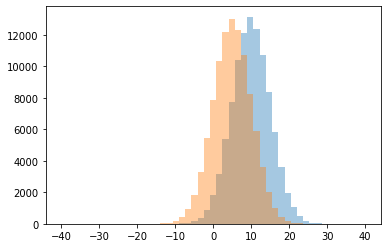

0 0.0
1 0.0967741935483871
2 0.16666666666666666
3 0.19428571428571428
4 0.21875
5 0.2222222222222222
6 0.2505091649694501
7 0.293888166449935
8 0.3965341488277268
9 0.47928994082840237
10 0.6764009471191792
11 0.8113509192645884
12 1.0
13 1.1892411143131605
14 1.4429378531073447
15 1.9161184210526316
16 2.471882640586797
17 3.4595744680851066
18 3.7841726618705036
19 4.0
20 4.465753424657534
21 6.096774193548387
22 7.666666666666667
23 8.0
24 8.272727272727273
25 999999.0




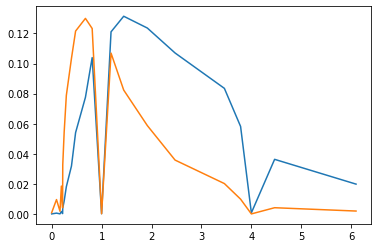

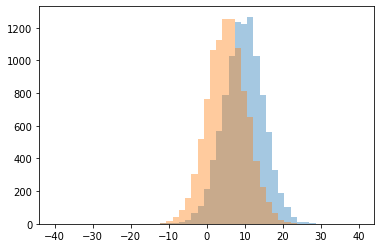

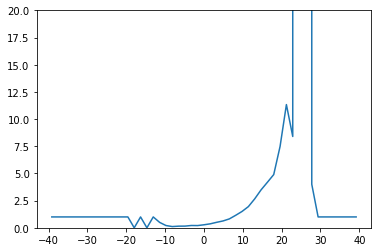

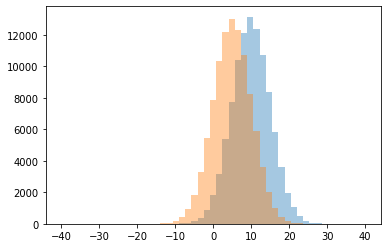

0 0.0
1 0.11363636363636363
2 0.1511627906976744
3 0.15527950310559005
4 0.2053742802303263
5 0.21052631578947367
6 0.2119205298013245
7 0.27712418300653596
8 0.36679174484052535
9 0.5
10 0.5048888888888889
11 0.6291866028708134
12 0.8184713375796179
13 1.0
14 1.149489322191272
15 1.5030750307503076
16 1.9477726574500769
17 2.6623376623376624
18 3.4867256637168142
19 4.0
20 4.185185185185185
21 4.895522388059701
22 7.48
23 8.4
24 11.333333333333334
25 999999.0




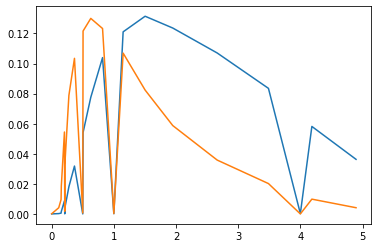

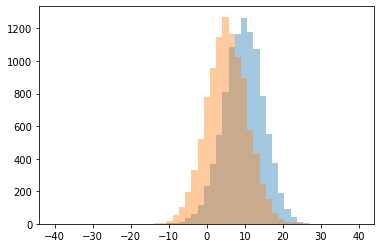

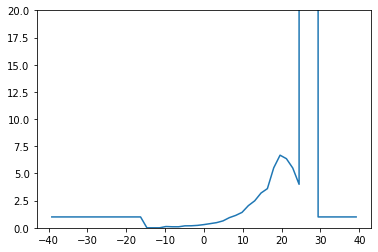

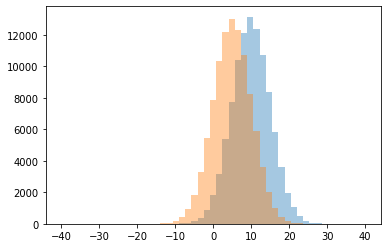

0 0.0
1 0.09433962264150944
2 0.11764705882352941
3 0.1794871794871795
4 0.18618618618618618
5 0.2230769230769231
6 0.29577464788732394
7 0.38477580813347234
8 0.47685589519650656
9 0.6360062893081762
10 0.9329320722269991
11 1.0
12 1.1396484375
13 1.417693169092945
14 2.0381282495667246
15 2.4814814814814814
16 3.2
17 3.6013071895424837
18 4.0
19 5.5
20 5.514705882352941
21 6.357142857142857
22 6.678571428571429
23 999999.0




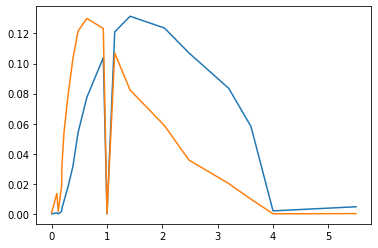

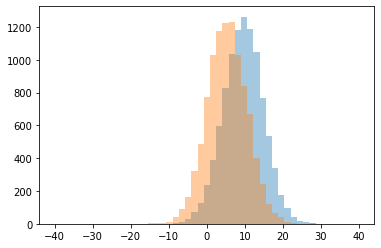

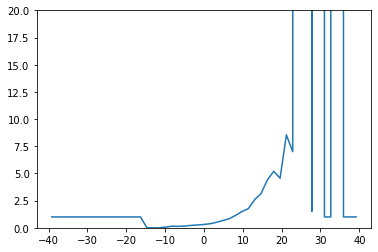

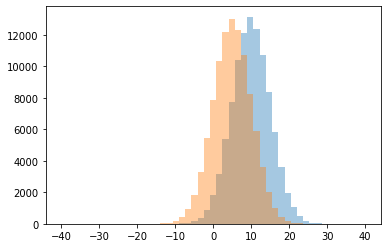

0 0.0
1 0.07142857142857142
2 0.13186813186813187
3 0.15
4 0.1656441717791411
5 0.221875
6 0.2613168724279835
7 0.30749354005167956
8 0.37536372453928224
9 0.5089209855564996
10 0.6740016299918501
11 0.8400974025974026
12 1.0
13 1.1485436893203884
14 1.5
15 1.7678571428571428
16 2.5915841584158414
17 3.152263374485597
18 4.401639344262295
19 4.564102564102564
20 5.196969696969697
21 7.0
22 8.545454545454545
23 999999.0




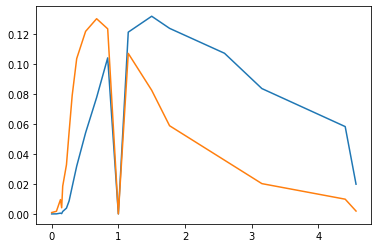

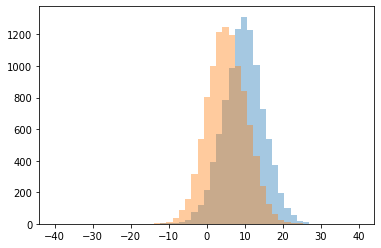

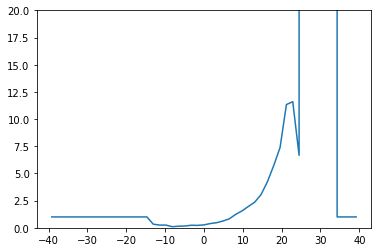

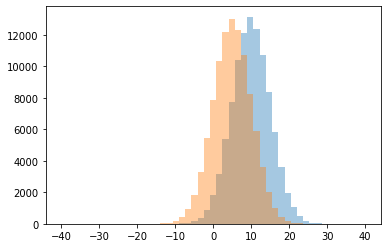

0 0.10256410256410256
1 0.14444444444444443
2 0.16560509554140126
3 0.22263450834879406
4 0.23492063492063492
5 0.25
6 0.2692307692307692
7 0.3333333333333333
8 0.3906093906093906
9 0.4699588477366255
10 0.6266025641025641
11 0.825542570951586
12 1.0
13 1.2367101303911736
14 1.5545023696682465
15 1.963258785942492
16 2.3551401869158877
17 3.0546218487394956
18 4.228346456692913
19 5.723076923076923
20 6.666666666666667
21 7.384615384615385
22 11.333333333333334
23 11.6
24 999999.0




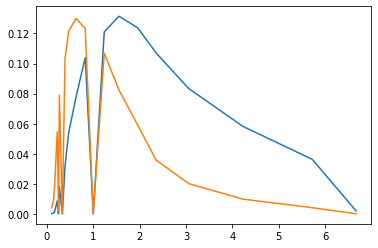

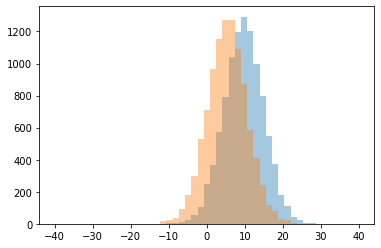

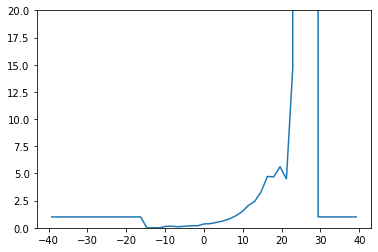

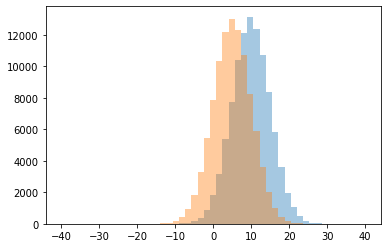

0 0.0
1 0.1
2 0.13636363636363635
3 0.14285714285714285
4 0.14444444444444443
5 0.1893687707641196
6 0.192090395480226
7 0.3540197461212976
8 0.3811007268951194
9 0.49783549783549785
10 0.624113475177305
11 0.8181102362204724
12 1.0
13 1.1020220588235294
14 1.4782608695652173
15 2.0476190476190474
16 2.4317073170731707
17 3.3057851239669422
18 4.5
19 4.69620253164557
20 4.7155172413793105
21 5.625
22 14.666666666666666
23 999999.0




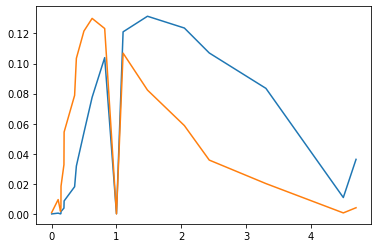

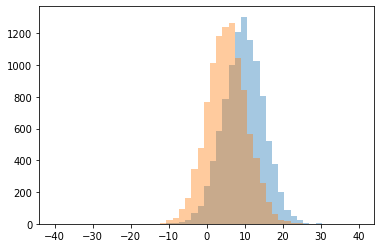

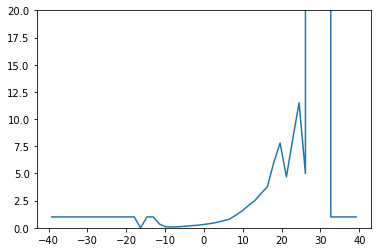

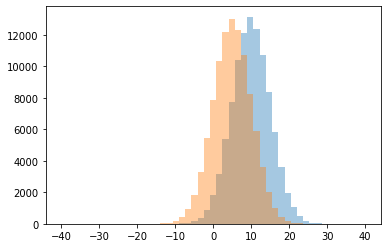

0 0.0
1 0.08108108108108109
2 0.09090909090909091
3 0.09574468085106383
4 0.14545454545454545
5 0.1896551724137931
6 0.2384937238493724
7 0.3077922077922078
8 0.3333333333333333
9 0.39250493096646943
10 0.49323181049069376
11 0.6368038740920097
12 0.7900552486187845
13 1.0
14 1.152963671128107
15 1.544378698224852
16 2.045936395759717
17 2.4902912621359223
18 3.1484375
19 3.782608695652174
20 4.684210526315789
21 5.0
22 5.984126984126984
23 7.8076923076923075
24 8.166666666666666
25 11.5
26 999999.0




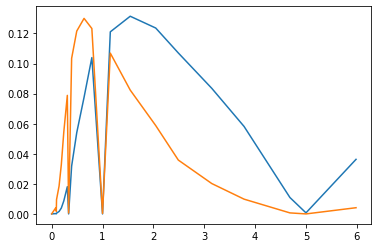

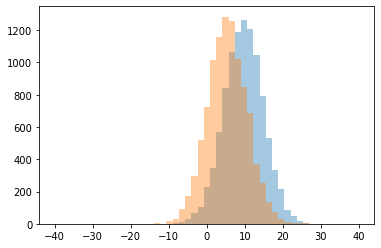

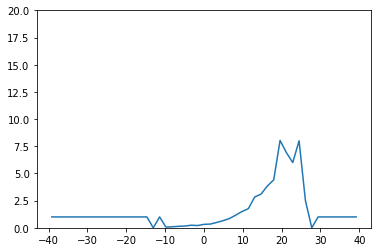

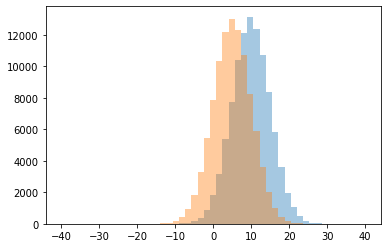

0 0.0
1 0.06666666666666667
2 0.09375
3 0.1348314606741573
4 0.16374269005847952
5 0.20656370656370657
6 0.23809523809523808
7 0.31767955801104975
8 0.3425196850393701
9 0.49006050129645634
10 0.6539360872954014
11 0.8459094519459889
12 1.0
13 1.1647058823529413
14 1.4970414201183433
15 1.7616959064327486
16 2.5
17 2.831978319783198
18 3.1019607843137256
19 3.847826086956522
20 4.407894736842105
21 6.0
22 6.916666666666667
23 8.0
24 8.037037037037036




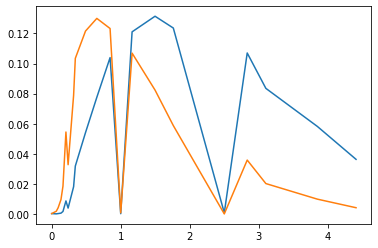

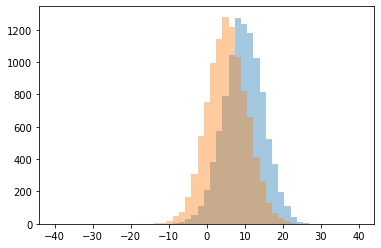

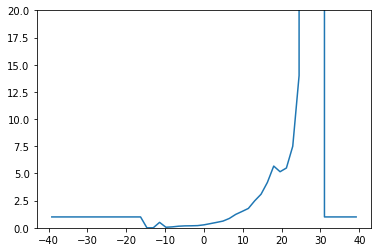

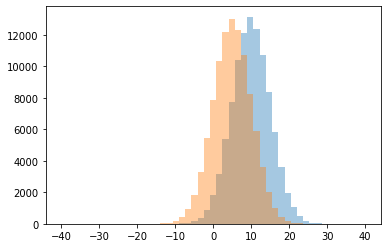

0 0.0
1 0.05
2 0.0851063829787234
3 0.14666666666666667
4 0.17682926829268292
5 0.18446601941747573
6 0.2011070110701107
7 0.2724867724867725
8 0.3840725806451613
9 0.49868995633187774
10 0.5
11 0.6182669789227166
12 0.8609053497942387
13 1.0
14 1.2318137730358876
15 1.5012165450121655
16 1.7809667673716012
17 2.4818401937046004
18 3.087121212121212
19 4.174603174603175
20 5.157894736842105
21 5.5
22 5.676923076923077
23 7.5
24 14.0
25 999999.0




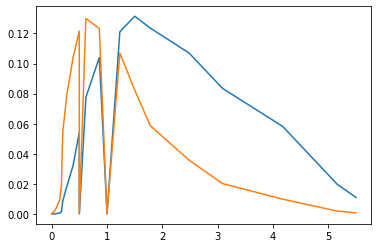

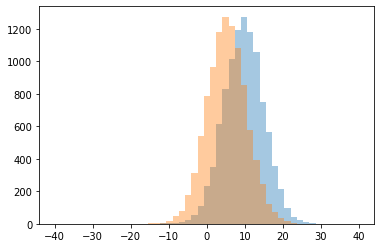

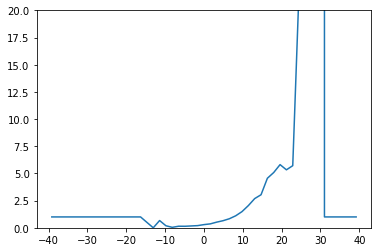

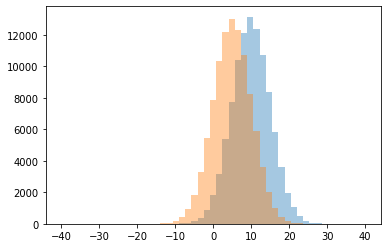

0 0.0
1 0.043478260869565216
2 0.14124293785310735
3 0.14473684210526316
4 0.17041800643086816
5 0.1875
6 0.20037105751391465
7 0.2929936305732484
8 0.3616580310880829
9 0.5
10 0.5195246179966044
11 0.6514555468135327
12 0.6666666666666666
13 0.8316912972085386
14 1.0
15 1.1037037037037036
16 1.4900584795321636
17 2.0431778929188256
18 2.687022900763359
19 3.040650406504065
20 4.556451612903226
21 5.085714285714285
22 5.333333333333333
23 5.714285714285714
24 5.8108108108108105
25 22.0
26 999999.0




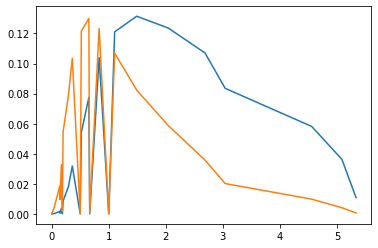

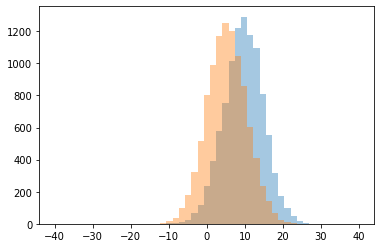

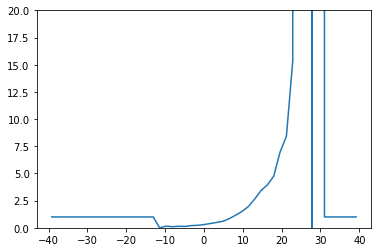

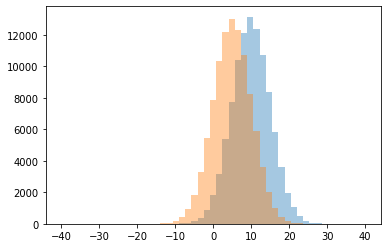

0 0.0
1 0.10256410256410256
2 0.12222222222222222
3 0.13861386138613863
4 0.15
5 0.20186335403726707
6 0.22928709055876687
7 0.2967581047381546
8 0.3941236068895643
9 0.49230769230769234
10 0.6012810248198559
11 0.8467943380516236
12 1.0
13 1.1620591039084842
14 1.5029103608847496
15 1.9550748752079867
16 2.6464891041162226
17 3.4219409282700424
18 3.95
19 4.746268656716418
20 6.96
21 8.416666666666666
22 15.333333333333334
23 999999.0




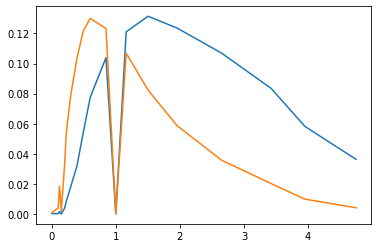

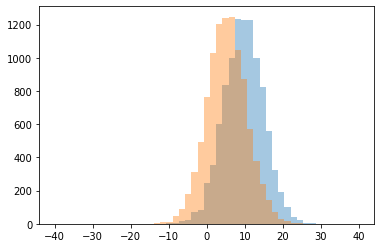

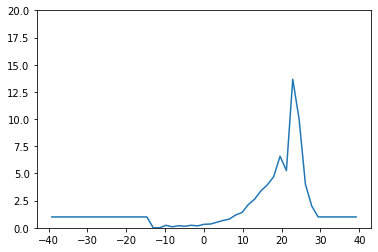

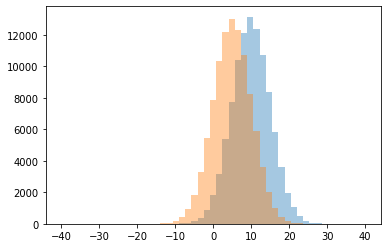

0 0.0
1 0.09090909090909091
2 0.13966480446927373
3 0.17373737373737375
4 0.19318181818181818
5 0.23076923076923078
6 0.23300970873786409
7 0.3206806282722513
8 0.34626576139670223
9 0.5012468827930174
10 0.6728444802578566
11 0.8019246190858059
12 1.0
13 1.1808612440191388
14 1.4050343249427917
15 2.0
16 2.1416083916083917
17 2.6419098143236073
18 3.4132231404958677
19 3.9507042253521125
20 4.0
21 4.7101449275362315
22 5.2631578947368425
23 6.586206896551724
24 10.0
25 13.666666666666666




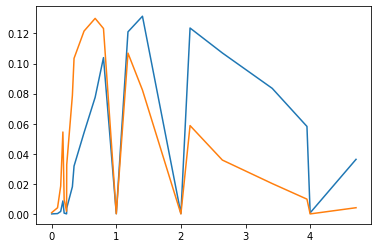

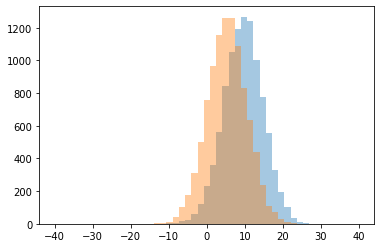

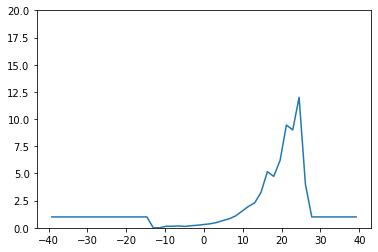

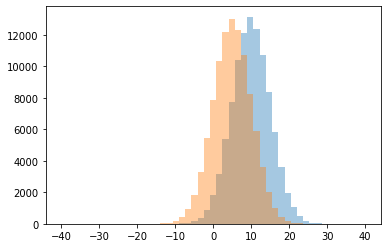

0 0.0
1 0.12571428571428572
2 0.14285714285714285
3 0.17
4 0.19230769230769232
5 0.23847695390781562
6 0.30566534914361
7 0.3703319502074689
8 0.4896013864818024
9 0.669047619047619
10 0.8347895154884829
11 1.0
12 1.0963302752293578
13 1.5295536791314837
14 1.9621451104100947
15 2.2922374429223744
16 3.26890756302521
17 4.0
18 4.728571428571429
19 5.166666666666667
20 6.193548387096774
21 9.0
22 9.454545454545455
23 12.0




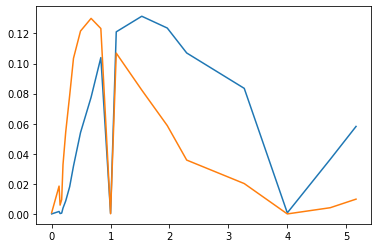

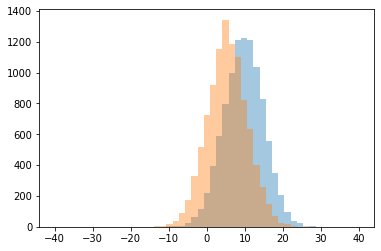

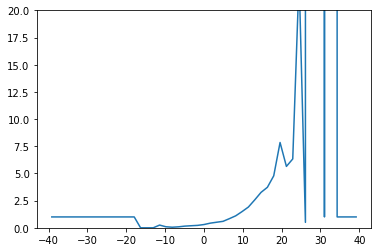

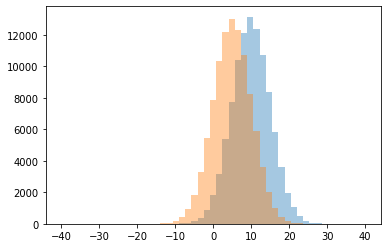

0 0.0
1 0.05263157894736842
2 0.09090909090909091
3 0.09523809523809523
4 0.15517241379310345
5 0.1903323262839879
6 0.22243713733075435
7 0.25
8 0.3002754820936639
9 0.4282608695652174
10 0.5
11 0.5125758889852559
12 0.5934475055845123
13 0.8392255892255892
14 1.0
15 1.0998185117967332
16 1.488456865127582
17 1.9069400630914826
18 2.5643564356435644
19 3.2588235294117647
20 3.7248322147651005
21 4.780821917808219
22 5.647058823529412
23 6.333333333333333
24 7.846153846153846
25 23.0
26 999999.0




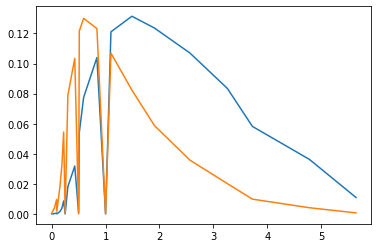

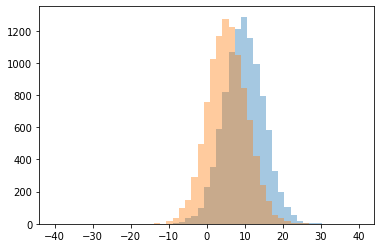

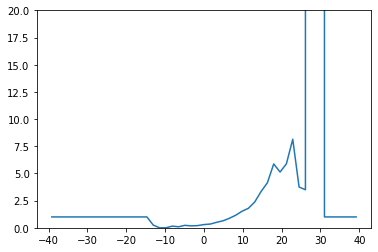

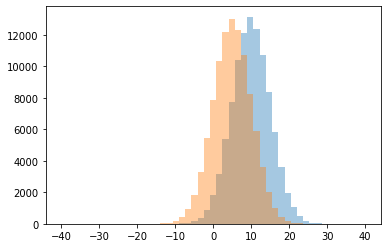

0 0.0
1 0.09375
2 0.15384615384615385
3 0.17465753424657535
4 0.2028397565922921
5 0.22758620689655173
6 0.25
7 0.29736842105263156
8 0.3460038986354776
9 0.5038560411311054
10 0.6446540880503144
11 0.8719412724306689
12 1.0
13 1.1548757170172084
14 1.5212765957446808
15 1.7919254658385093
16 2.3699284009546537
17 3.3347280334728033
18 3.5
19 3.75
20 4.141843971631205
21 5.128205128205129
22 5.875
23 5.888888888888889
24 8.142857142857142
25 999999.0




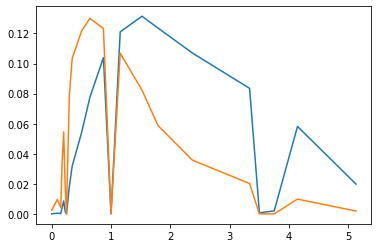

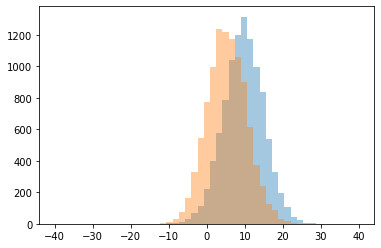

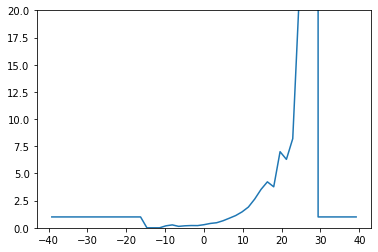

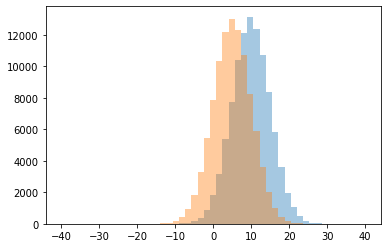

0 0.0
1 0.13333333333333333
2 0.18181818181818182
3 0.18404907975460122
4 0.20257826887661143
5 0.20795107033639143
6 0.26666666666666666
7 0.2857142857142857
8 0.4
9 0.46682847896440127
10 0.647493837304848
11 0.8825531914893617
12 1.0
13 1.1262959472196041
14 1.4616240266963292
15 1.9055374592833876
16 2.643617021276596
17 3.5316455696202533
18 3.7701149425287355
19 4.2265625
20 6.294117647058823
21 7.0
22 8.2
23 21.0
24 999999.0




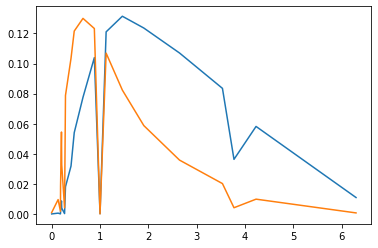

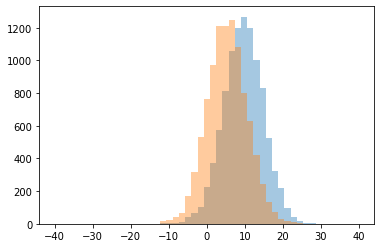

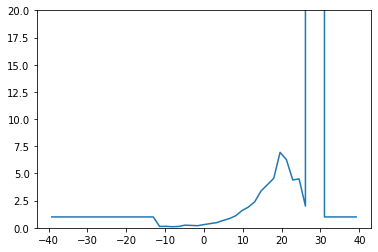

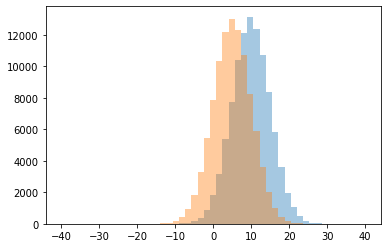

0 0.1
1 0.12307692307692308
2 0.125
3 0.13636363636363635
4 0.192090395480226
5 0.21904761904761905
6 0.24260355029585798
7 0.29673202614379085
8 0.38699690402476783
9 0.4735973597359736
10 0.6730132450331126
11 0.8462770216172938
12 1.0
13 1.10803324099723
14 1.5857321652065082
15 1.9059011164274322
16 2.0
17 2.386634844868735
18 3.3877551020408165
19 3.962406015037594
20 4.4
21 4.5
22 4.549295774647887
23 6.266666666666667
24 6.9375
25 999999.0




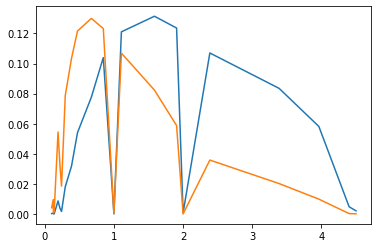

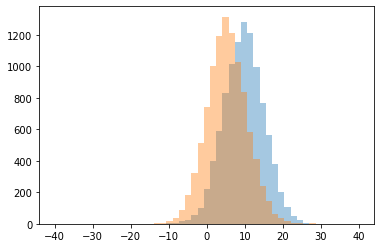

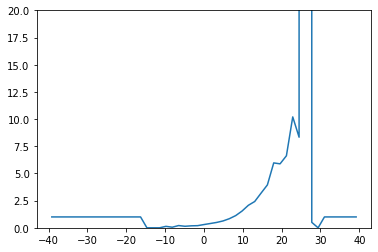

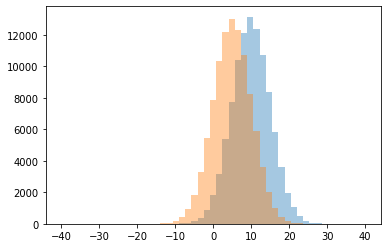

0 0.0
1 0.05405405405405406
2 0.13333333333333333
3 0.14054054054054055
4 0.18153846153846154
5 0.1968810916179337
6 0.20689655172413793
7 0.29905277401894453
8 0.3944223107569721
9 0.49370277078085645
10 0.5
11 0.629657794676806
12 0.8374587458745875
13 1.0
14 1.121477162293489
15 1.538369304556355
16 2.0700854700854703
17 2.4174757281553396
18 3.1875
19 3.944055944055944
20 5.882352941176471
21 5.96875
22 6.625
23 8.333333333333334
24 10.2
25 999999.0




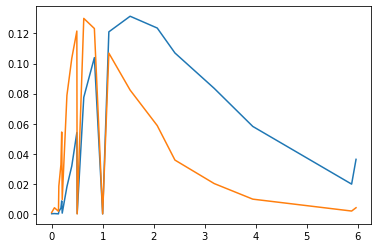

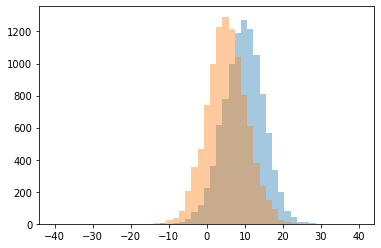

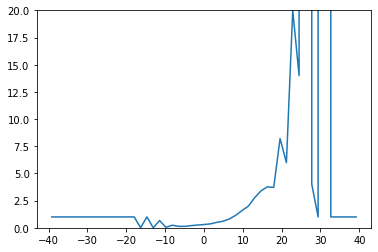

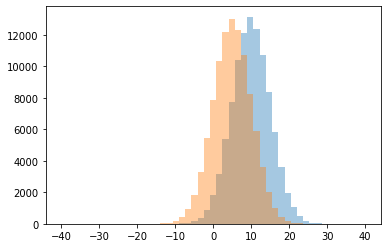

0 0.0
1 0.045454545454545456
2 0.1330049261083744
3 0.13414634146341464
4 0.20168067226890757
5 0.23529411764705882
6 0.25213675213675213
7 0.300944669365722
8 0.3604417670682731
9 0.4991869918699187
10 0.6021671826625387
11 0.6666666666666666
12 0.8175842235004108
13 1.0
14 1.1482194417709335
15 1.5865504358655043
16 1.9918032786885247
17 2.7736842105263158
18 3.403361344537815
19 3.7111111111111112
20 3.7682119205298013
21 4.0
22 6.0
23 8.208333333333334
24 14.0
25 20.0
26 999999.0




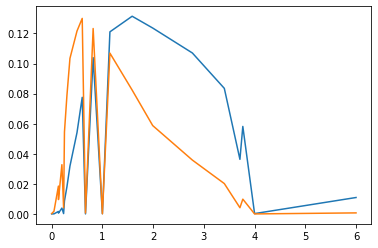

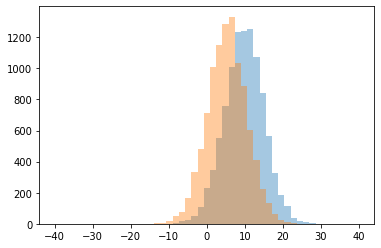

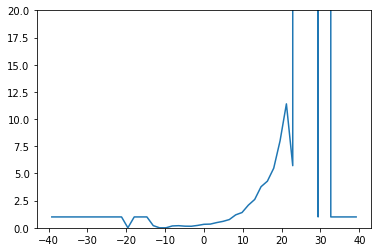

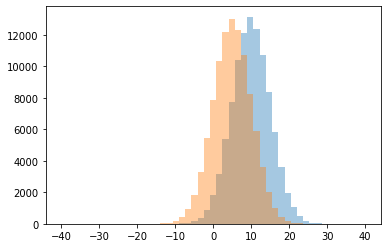

0 0.0
1 0.14242424242424243
2 0.1497005988023952
3 0.1702127659574468
4 0.19480519480519481
5 0.2
6 0.2190082644628099
7 0.32253521126760565
8 0.34095427435387676
9 0.47863993025283347
10 0.5915822291504287
11 0.7582582582582582
12 1.0
13 1.1901544401544402
14 1.4049773755656108
15 2.0848585690515806
16 2.6067961165048543
17 3.779279279279279
18 4.287878787878788
19 5.483333333333333
20 5.714285714285714
21 8.0
22 11.4
23 999999.0




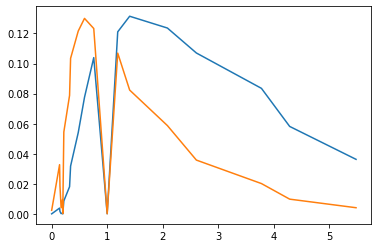

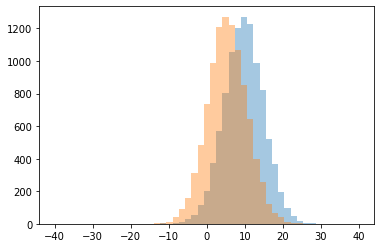

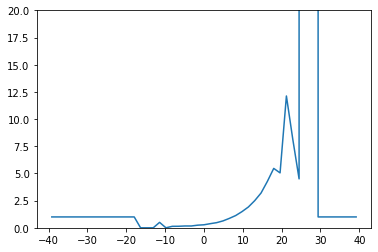

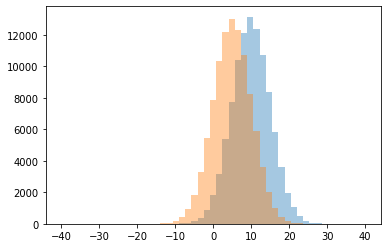

0 0.0
1 0.13636363636363635
2 0.14130434782608695
3 0.16666666666666666
4 0.16770186335403728
5 0.24123711340206186
6 0.27717391304347827
7 0.3803245436105477
8 0.4735537190082645
9 0.5
10 0.6346456692913386
11 0.8657937806873978
12 1.0
13 1.1266416510318948
14 1.4894613583138174
15 1.912772585669782
16 2.4962025316455696
17 3.198443579766537
18 4.270491803278689
19 4.5
20 5.051282051282051
21 5.462686567164179
22 8.166666666666666
23 12.125
24 999999.0




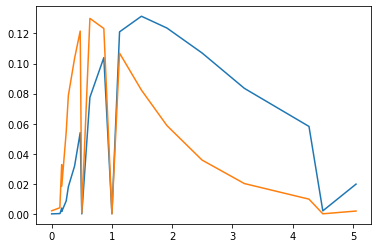

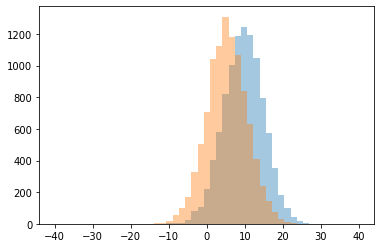

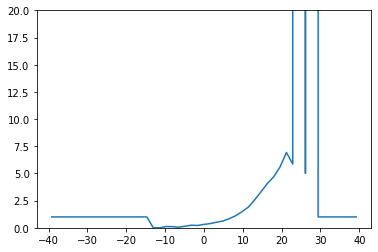

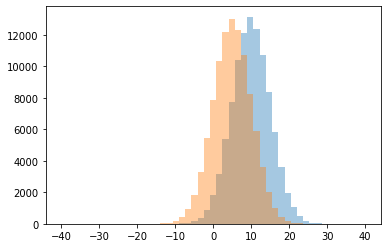

0 0.0
1 0.05154639175257732
2 0.10526315789473684
3 0.11764705882352941
4 0.14534883720930233
5 0.21272365805168986
6 0.23853211009174313
7 0.3125884016973126
8 0.38808837656099904
9 0.5168738898756661
10 0.627196333078686
11 0.8469991546914624
12 1.0
13 1.1095505617977528
14 1.4803804994054697
15 1.9044585987261147
16 2.575980392156863
17 3.316666666666667
18 4.078014184397163
19 4.693333333333333
20 5.0
21 5.606060606060606
22 5.857142857142857
23 6.928571428571429
24 999999.0




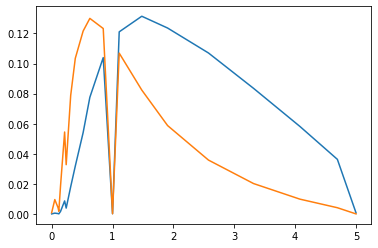

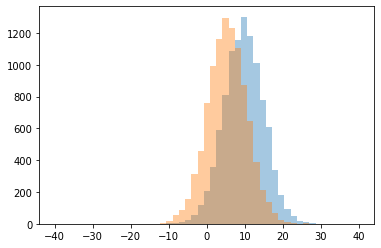

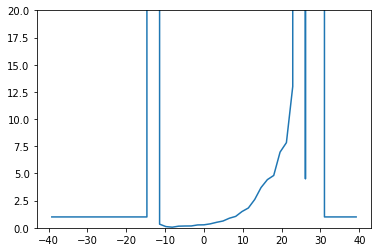

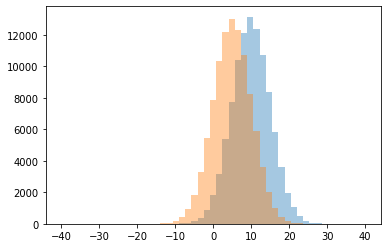

0 0.05555555555555555
1 0.1111111111111111
2 0.14942528735632185
3 0.16455696202531644
4 0.16932907348242812
5 0.26304347826086955
6 0.2742782152230971
7 0.3333333333333333
8 0.3640040444893832
9 0.5060344827586207
10 0.6247104247104247
11 0.8805848903330625
12 1.0
13 1.0489573889392565
14 1.4965517241379311
15 1.82225656877898
16 2.6030927835051547
17 3.7014218009478674
18 4.430656934306569
19 4.5
20 4.814285714285714
21 6.961538461538462
22 7.833333333333333
23 13.0
24 999999.0




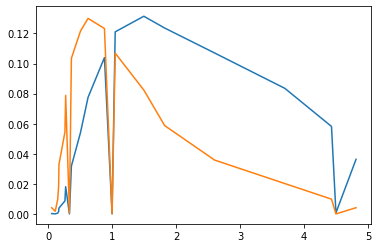

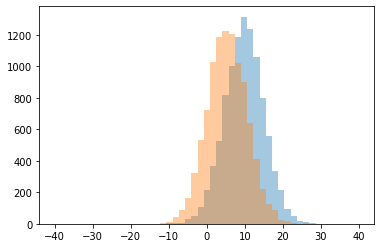

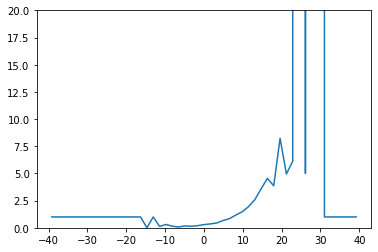

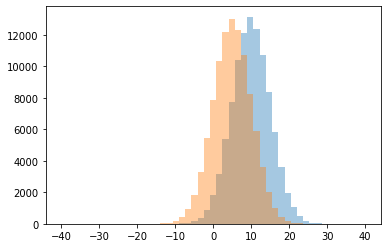

0 0.0
1 0.07865168539325842
2 0.125
3 0.14461538461538462
4 0.14634146341463414
5 0.17177914110429449
6 0.19439252336448598
7 0.29379310344827586
8 0.3076923076923077
9 0.35609756097560974
10 0.4415475189234651
11 0.6672117743254292
12 0.8329177057356608
13 1.0
14 1.1650294695481336
15 1.4627363737486097
16 1.9329173166926676
17 2.5714285714285716
18 3.569506726457399
19 3.8620689655172415
20 4.544715447154472
21 4.947368421052632
22 5.0
23 6.125
24 8.23076923076923
25 999999.0




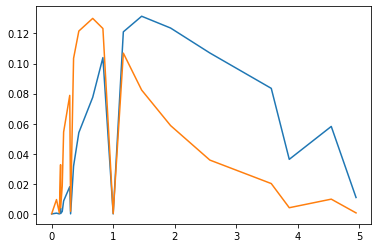

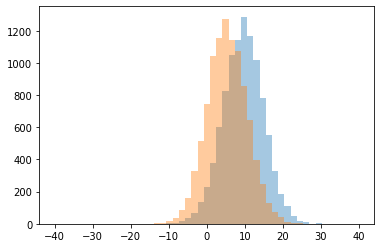

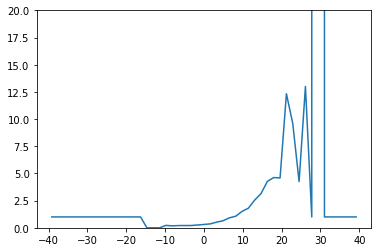

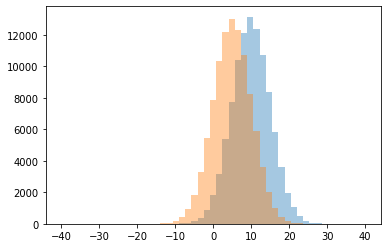

0 0.0
1 0.17647058823529413
2 0.20689655172413793
3 0.2085889570552147
4 0.21036585365853658
5 0.2222222222222222
6 0.25918762088974856
7 0.30655957161981257
8 0.3611911623439001
9 0.5221162185602776
10 0.6459968602825745
11 0.9161572052401746
12 1.0
13 1.0632558139534884
14 1.5064327485380118
15 1.8024691358024691
16 2.5513784461152884
17 3.149193548387097
18 4.25
19 4.271317829457364
20 4.585365853658536
21 4.619718309859155
22 9.6
23 12.333333333333334
24 13.0
25 999999.0




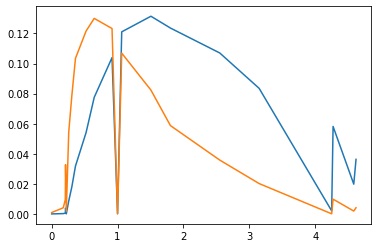

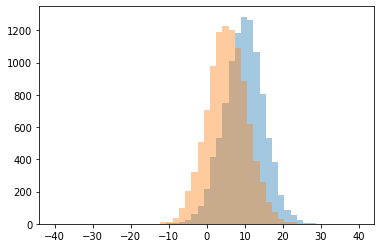

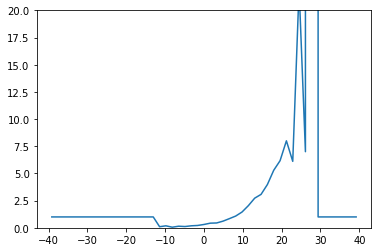

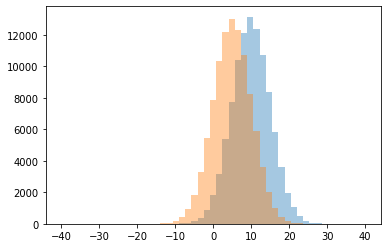

0 0.05555555555555555
1 0.1
2 0.11650485436893204
3 0.14583333333333334
4 0.18181818181818182
5 0.18322981366459629
6 0.21456692913385828
7 0.30638297872340425
8 0.42594484167517876
9 0.4450041981528128
10 0.6110659072416599
11 0.8407005838198499
12 1.0
13 1.0795974382433668
14 1.4508474576271186
15 2.0370967741935484
16 2.7263427109974425
17 3.0727969348659006
18 3.9776119402985075
19 5.291666666666667
20 6.111111111111111
21 6.172413793103448
22 7.0
23 8.0
24 22.0
25 999999.0




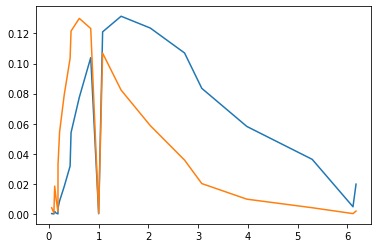

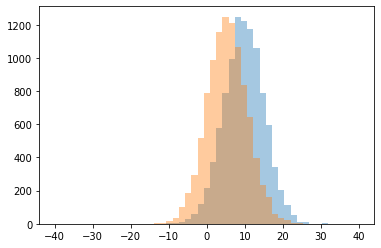

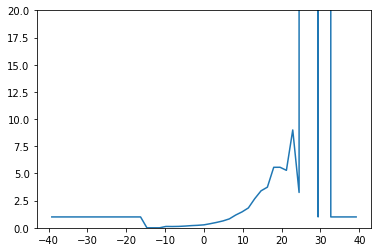

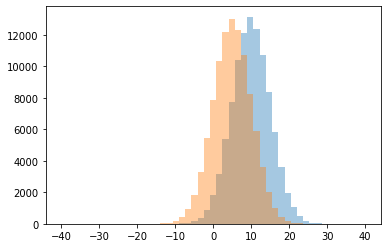

0 0.0
1 0.11764705882352941
2 0.125
3 0.12871287128712872
4 0.15760869565217392
5 0.20068027210884354
6 0.22823984526112184
7 0.2719186785260483
8 0.3786802030456853
9 0.49740932642487046
10 0.6329317269076306
11 0.8199834847233691
12 1.0
13 1.174035747883349
14 1.4623655913978495
15 1.8271028037383177
16 2.6742424242424243
17 3.25
18 3.4008620689655173
19 3.7375
20 5.285714285714286
21 5.564516129032258
22 5.5675675675675675
23 9.0
24 999999.0




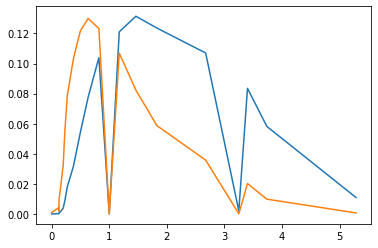

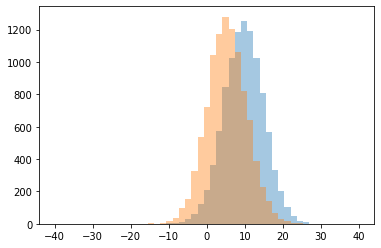

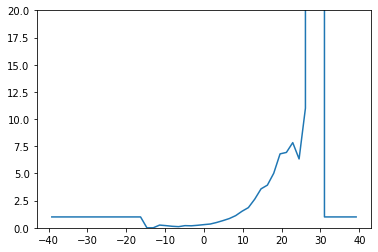

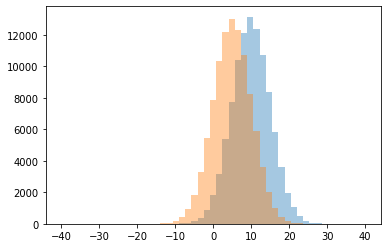

0 0.0
1 0.10526315789473684
2 0.1388888888888889
3 0.1834862385321101
4 0.1986754966887417
5 0.2
6 0.23134328358208955
7 0.25
8 0.2924137931034483
9 0.34836852207293667
10 0.4906143344709898
11 0.6625
12 0.8514522821576763
13 1.0
14 1.119698397737983
15 1.5218978102189782
16 1.855140186915888
17 2.6298200514138816
18 3.582222222222222
19 3.923611111111111
20 5.015151515151516
21 6.333333333333333
22 6.8
23 6.933333333333334
24 7.833333333333333
25 11.0
26 999999.0




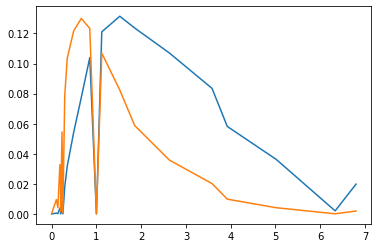

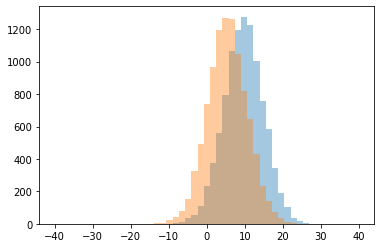

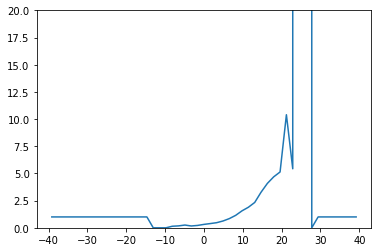

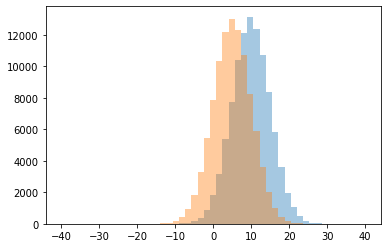

0 0.0
1 0.14285714285714285
2 0.1676829268292683
3 0.17721518987341772
4 0.21836734693877552
5 0.25333333333333335
6 0.31393775372124494
7 0.3894628099173554
8 0.4707357859531773
9 0.6259842519685039
10 0.8461538461538461
11 1.0
12 1.1454545454545455
13 1.561124694376528
14 1.8888888888888888
15 2.3294663573085845
16 3.271551724137931
17 4.083916083916084
18 4.6891891891891895
19 5.135135135135135
20 5.428571428571429
21 10.4
22 999999.0




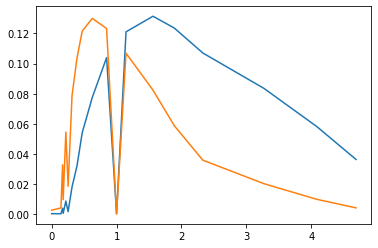

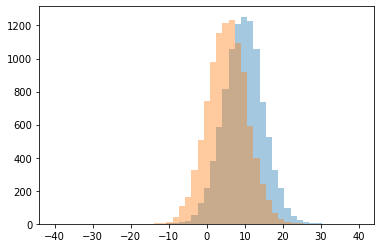

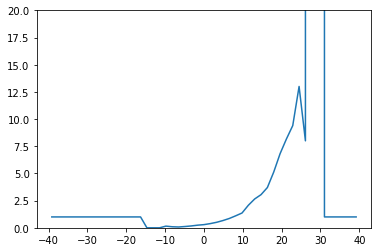

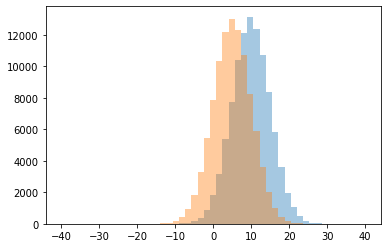

0 0.0
1 0.07407407407407407
2 0.09523809523809523
3 0.11801242236024845
4 0.15384615384615385
5 0.17073170731707318
6 0.24165029469548133
7 0.291497975708502
8 0.38650306748466257
9 0.5069444444444444
10 0.6685855263157895
11 0.8589951377633711
12 1.0
13 1.102189781021898
14 1.3604777415852334
15 2.074324324324324
16 2.6532663316582914
17 3.049586776859504
18 3.704225352112676
19 5.126984126984127
20 6.8125
21 8.0
22 8.166666666666666
23 9.4
24 13.0
25 999999.0




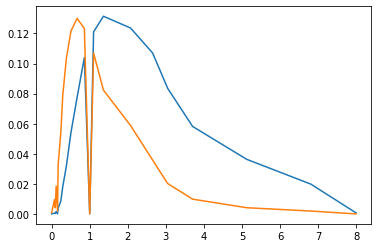

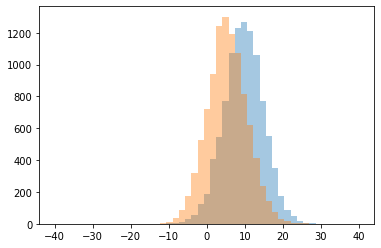

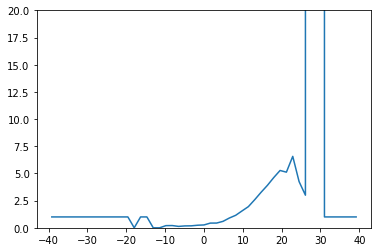

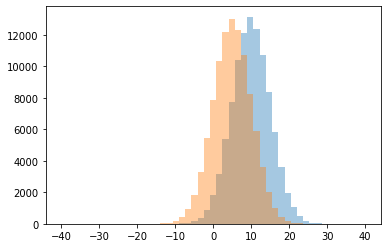

0 0.0
1 0.12941176470588237
2 0.17341040462427745
3 0.18125
4 0.2
5 0.20588235294117646
6 0.2366412213740458
7 0.26243093922651933
8 0.4323748668796592
9 0.4364951768488746
10 0.5926210607225212
11 0.899581589958159
12 1.0
13 1.1492537313432836
14 1.5513447432762837
15 1.9454253611556982
16 2.5839416058394162
17 3.0
18 3.26271186440678
19 3.9014084507042255
20 4.25
21 4.618421052631579
22 5.117647058823529
23 5.2727272727272725
24 6.571428571428571
25 999999.0




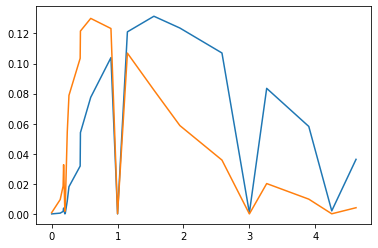

on f= 0.10344827586206896


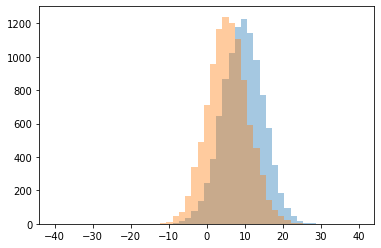

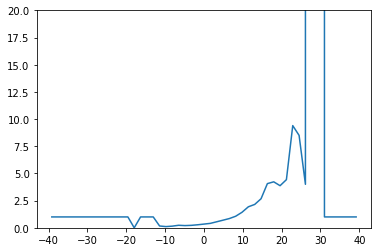

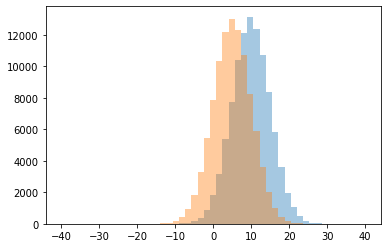

0 0.0
1 0.1111111111111111
2 0.15217391304347827
3 0.16666666666666666
4 0.20359281437125748
5 0.22514619883040934
6 0.2318840579710145
7 0.27755102040816326
8 0.3418079096045198
9 0.407098121085595
10 0.5527896995708155
11 0.6997578692493946
12 0.8498748957464554
13 1.0
14 1.0632339656729901
15 1.4289044289044288
16 1.9322033898305084
17 2.1491228070175437
18 2.671280276816609
19 3.872340425531915
20 4.0
21 4.0638297872340425
22 4.228915662650603
23 4.428571428571429
24 8.5
25 9.4
26 999999.0




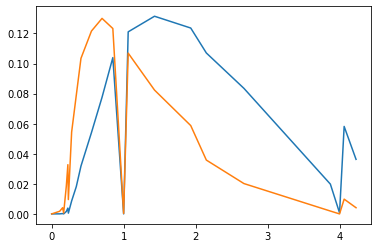

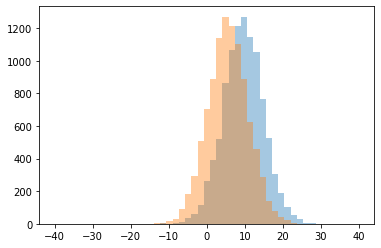

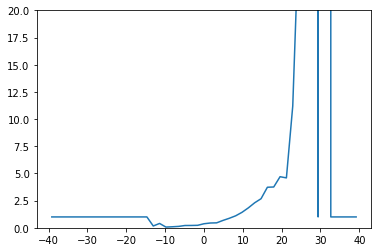

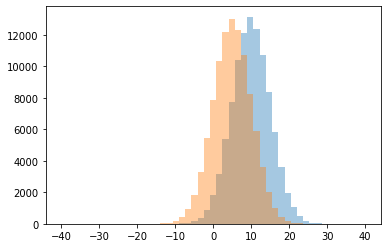

0 0.06666666666666667
1 0.09375
2 0.12903225806451613
3 0.16666666666666666
4 0.2111111111111111
5 0.2150170648464164
6 0.2283464566929134
7 0.37252124645892354
8 0.4
9 0.4401805869074492
10 0.45621716287215414
11 0.6789929189614476
12 0.8764415156507414
13 1.0
14 1.103542234332425
15 1.4247191011235956
16 1.8349358974358974
17 2.3034934497816595
18 2.674825174825175
19 3.730496453900709
20 3.753086419753086
21 4.590909090909091
22 4.7
23 11.2
24 28.0
25 999999.0




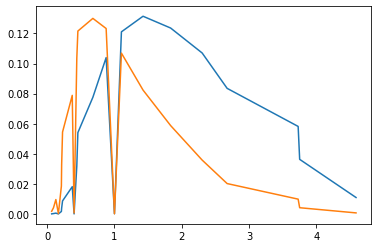

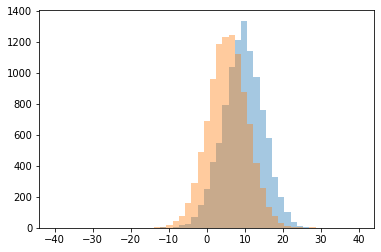

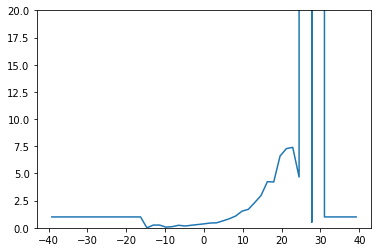

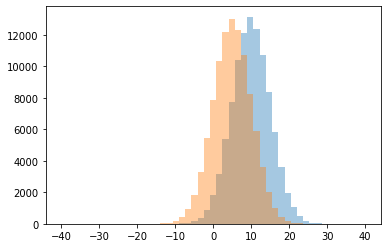

0 0.0
1 0.0625
2 0.10638297872340426
3 0.16352201257861634
4 0.2328767123287671
5 0.23426573426573427
6 0.25
7 0.29835390946502055
8 0.36231884057971014
9 0.43912591050988553
10 0.459915611814346
11 0.5
12 0.6417546709991877
13 0.8330658105939005
14 1.0
15 1.0839285714285714
16 1.5303550973654065
17 1.7034277198211625
18 2.3190476190476192
19 2.9725490196078432
20 4.217948717948718
21 4.242647058823529
22 4.666666666666667
23 6.6
24 7.285714285714286
25 7.4
26 999999.0




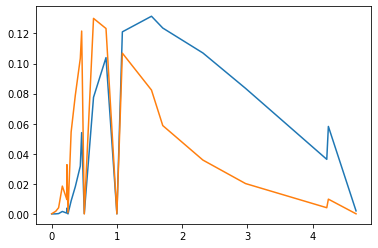

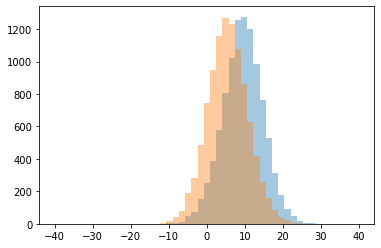

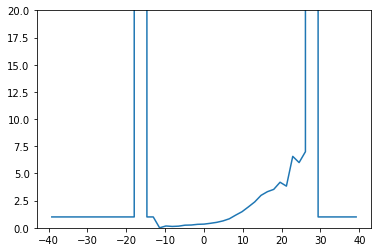

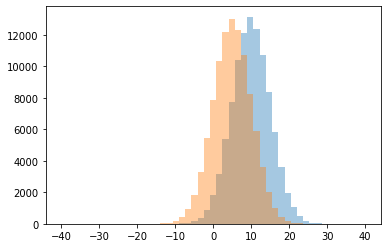

0 0.0
1 0.125
2 0.1518987341772152
3 0.16666666666666666
4 0.24064171122994651
5 0.25622775800711745
6 0.31893004115226337
7 0.33827493261455527
8 0.4126984126984127
9 0.5008620689655172
10 0.6340694006309149
11 0.8294069861900893
12 1.0
13 1.1655813953488372
14 1.480278422273782
15 1.9201277955271565
16 2.378313253012048
17 2.984313725490196
18 3.3207547169811322
19 3.534090909090909
20 3.8333333333333335
21 4.190476190476191
22 6.0
23 6.571428571428571
24 7.0
25 999999.0




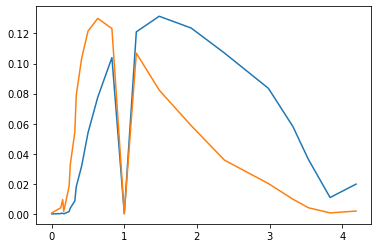

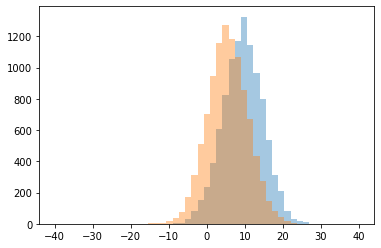

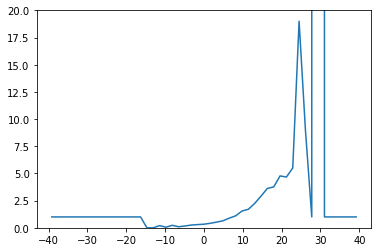

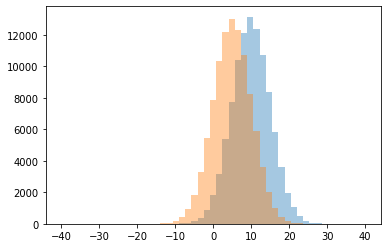

0 0.0
1 0.05555555555555555
2 0.0958904109589041
3 0.16568047337278108
4 0.2
5 0.22857142857142856
6 0.2540192926045016
7 0.29571984435797666
8 0.3314366998577525
9 0.4143763213530655
10 0.5220017256255393
11 0.64576802507837
12 0.8918005071851226
13 1.0
14 1.100375234521576
15 1.5436554132712457
16 1.7019374068554396
17 2.245939675174014
18 2.9163636363636365
19 3.6216216216216215
20 3.7590361445783134
21 4.666666666666667
22 4.7727272727272725
23 5.5
24 9.0
25 19.0
26 999999.0




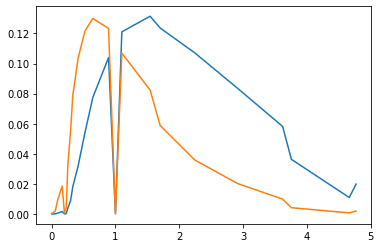

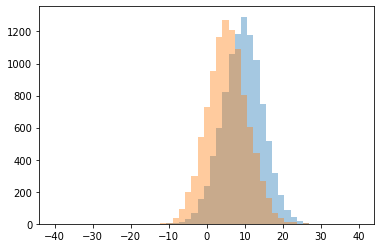

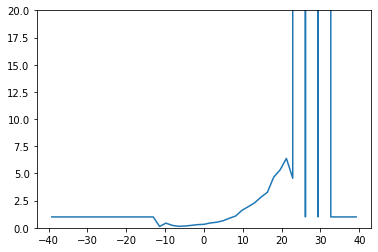

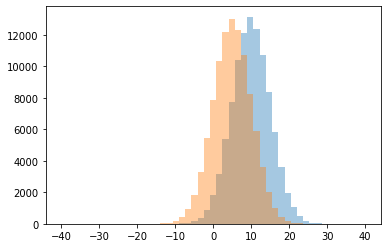

0 0.125
1 0.1368421052631579
2 0.16161616161616163
3 0.2222222222222222
4 0.22333333333333333
5 0.2912801484230056
6 0.3204951856946355
7 0.42857142857142855
8 0.4426919032597266
9 0.511986301369863
10 0.6462264150943396
11 0.8768595041322315
12 1.0
13 1.0881542699724518
14 1.6089663760896638
15 1.9454545454545455
16 2.304054054054054
17 2.821969696969697
18 3.2658227848101267
19 4.555555555555555
20 4.661764705882353
21 5.323529411764706
22 6.384615384615385
23 999999.0




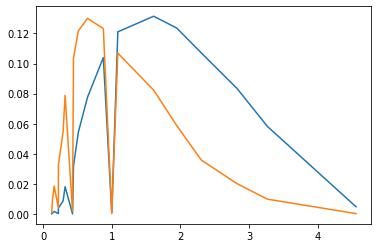

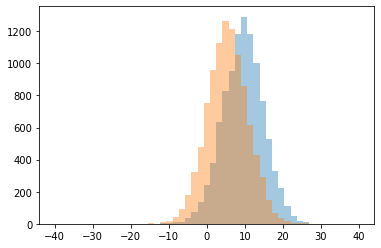

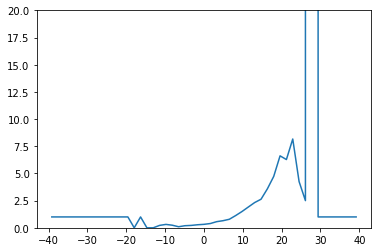

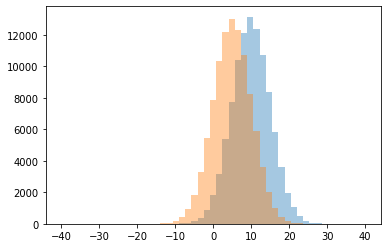

0 0.0
1 0.09782608695652174
2 0.192090395480226
3 0.2204968944099379
4 0.2222222222222222
5 0.23809523809523808
6 0.2803347280334728
7 0.3125
8 0.3187830687830688
9 0.3924843423799583
10 0.5639431616341031
11 0.6529644268774704
12 0.7847165160230074
13 1.0
14 1.126546146527117
15 1.4994192799070847
16 1.9143780290791599
17 2.324074074074074
18 2.5
19 2.6288659793814433
20 3.5850340136054424
21 4.25
22 4.728571428571429
23 6.277777777777778
24 6.617647058823529
25 8.166666666666666
26 999999.0




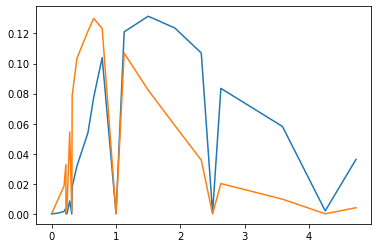

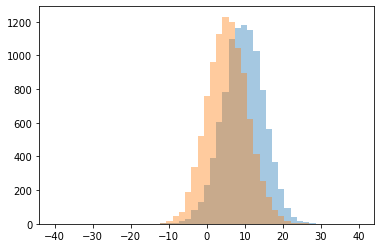

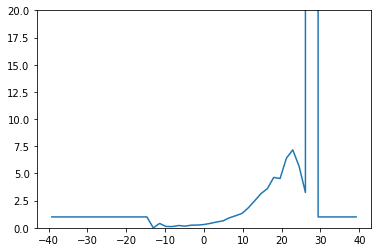

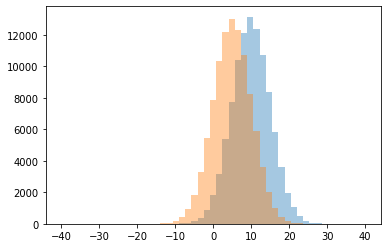

0 0.0
1 0.1111111111111111
2 0.125
3 0.1497326203208556
4 0.2112676056338028
5 0.24260355029585798
6 0.2504816955684008
7 0.3034300791556728
8 0.4
9 0.40582726326742974
10 0.5349867139061116
11 0.6373983739837399
12 0.9159034138218152
13 1.0
14 1.112810707456979
15 1.3221476510067114
16 1.8432
17 2.4891041162227605
18 3.1468253968253967
19 3.25
20 3.605095541401274
21 4.533333333333333
22 4.632911392405063
23 5.666666666666667
24 6.4
25 7.166666666666667
26 999999.0




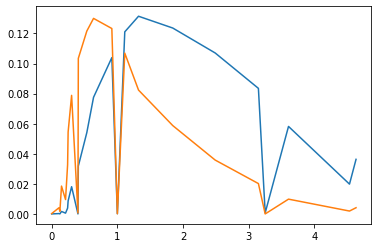

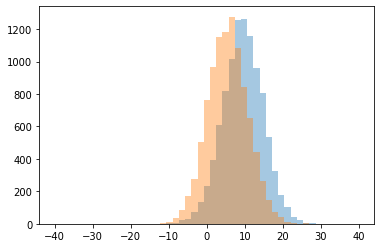

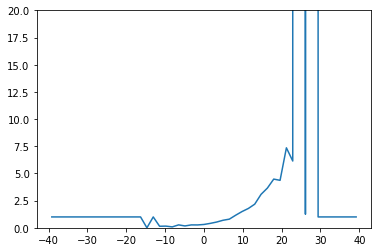

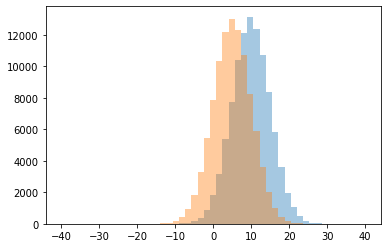

0 0.0
1 0.08333333333333333
2 0.14285714285714285
3 0.15384615384615385
4 0.17058823529411765
5 0.2633663366336634
6 0.26618705035971224
7 0.2682926829268293
8 0.3075916230366492
9 0.4074457083764219
10 0.5291557876414273
11 0.6926333615580017
12 0.7954545454545454
13 1.0
14 1.1576036866359447
15 1.25
16 1.4940758293838863
17 1.7788018433179724
18 2.1715575620767495
19 3.0763358778625953
20 3.6530612244897958
21 4.365853658536586
22 4.47945205479452
23 6.142857142857143
24 7.357142857142857
25 999999.0




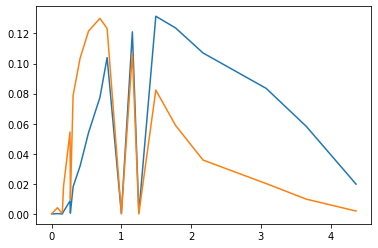

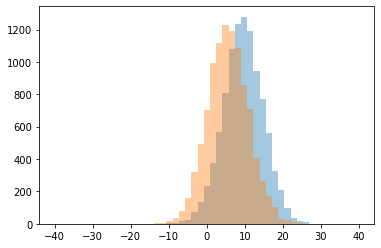

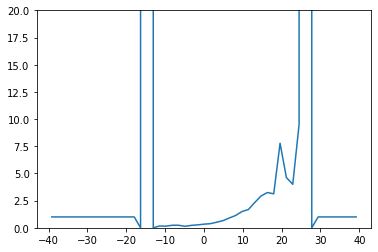

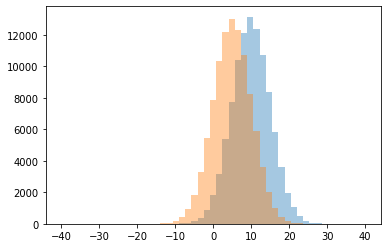

0 0.0
1 0.1375
2 0.15
3 0.16666666666666666
4 0.2225705329153605
5 0.2345679012345679
6 0.23529411764705882
7 0.2693877551020408
8 0.3338088445078459
9 0.3796576032225579
10 0.5116696588868941
11 0.6585365853658537
12 0.9043624161073825
13 1.0
14 1.1343146274149034
15 1.495906432748538
16 1.681241184767278
17 2.3234567901234566
18 2.9242424242424243
19 3.123809523809524
20 3.244186046511628
21 4.0
22 4.619047619047619
23 7.777777777777778
24 9.5
25 999999.0




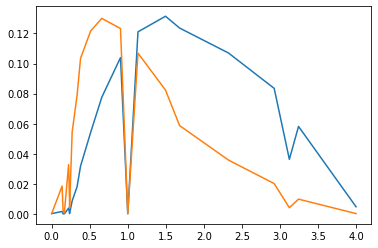

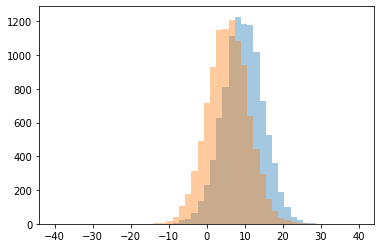

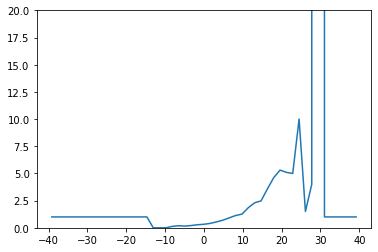

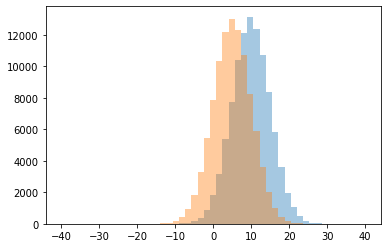

0 0.0
1 0.13157894736842105
2 0.1564245810055866
3 0.19047619047619047
4 0.21019108280254778
5 0.28105906313645623
6 0.32398316970546986
7 0.40665236051502146
8 0.5447437011294527
9 0.7027729636048526
10 0.9181141439205955
11 1.0
12 1.1308755760368663
13 1.2590233545647558
14 1.5
15 1.8537735849056605
16 2.3031674208144794
17 2.474402730375427
18 3.574324324324324
19 4.0
20 4.615384615384615
21 5.0
22 5.1
23 5.305555555555555
24 10.0
25 999999.0




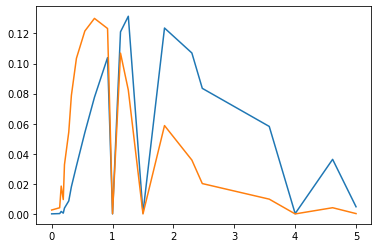

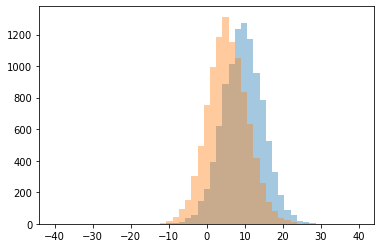

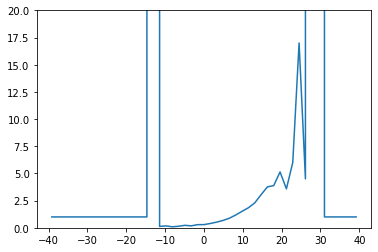

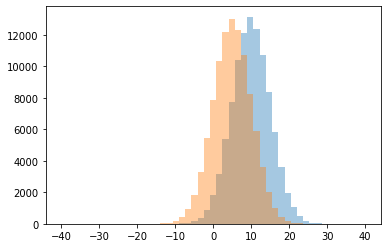

0 0.09090909090909091
1 0.125
2 0.14285714285714285
3 0.17647058823529413
4 0.17940199335548174
5 0.22727272727272727
6 0.2903225806451613
7 0.29310344827586204
8 0.39558232931726905
9 0.5228426395939086
10 0.6755521706016756
11 0.8784722222222222
12 1.0
13 1.1754051477597711
14 1.5155131264916468
15 1.8409448818897638
16 2.2853717026378897
17 3.0387596899224807
18 3.5833333333333335
19 3.762589928057554
20 3.880952380952381
21 4.5
22 5.138888888888889
23 6.0
24 17.0
25 999999.0




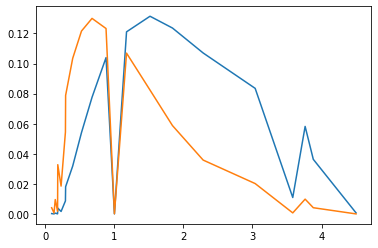

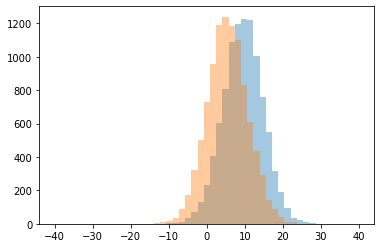

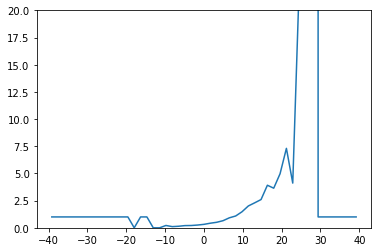

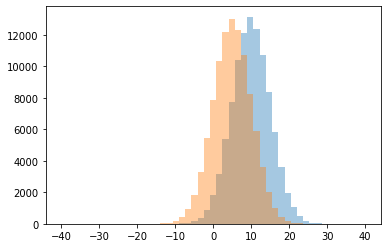

0 0.0
1 0.10810810810810811
2 0.14285714285714285
3 0.2023121387283237
4 0.2111801242236025
5 0.21428571428571427
6 0.25396825396825395
7 0.3177441540577717
8 0.4224318658280922
9 0.5063078216989066
10 0.6521388216303471
11 0.9180743243243243
12 1.0
13 1.086285195277021
14 1.4753309265944645
15 2.0098846787479405
16 2.2981651376146788
17 2.597938144329897
18 3.6436781609195403
19 3.914285714285714
20 4.111111111111111
21 4.973684210526316
22 7.3076923076923075
23 22.0
24 999999.0




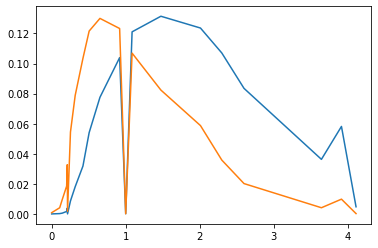

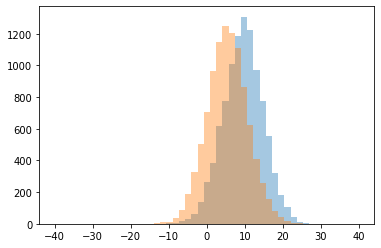

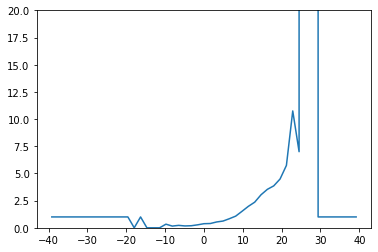

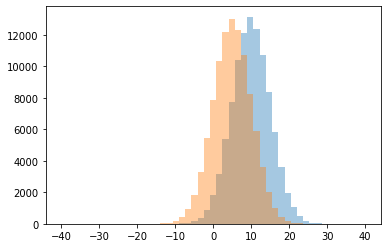

0 0.0
1 0.15789473684210525
2 0.1711229946524064
3 0.1901840490797546
4 0.2235294117647059
5 0.2732673267326733
6 0.3333333333333333
7 0.3773049645390071
8 0.3940020682523268
9 0.5370531822144725
10 0.619887730553328
11 0.8349917081260365
12 1.0
13 1.0721370604147882
14 1.517401392111369
15 1.9742351046698874
16 2.3567961165048543
17 3.0392156862745097
18 3.5384615384615383
19 3.855421686746988
20 4.487804878048781
21 5.7368421052631575
22 7.0
23 10.75
24 999999.0




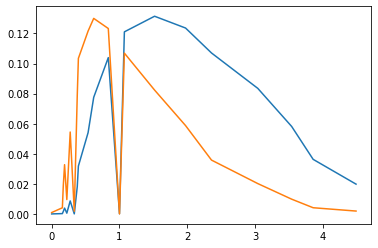

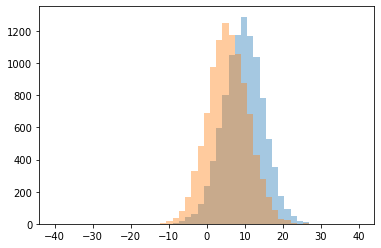

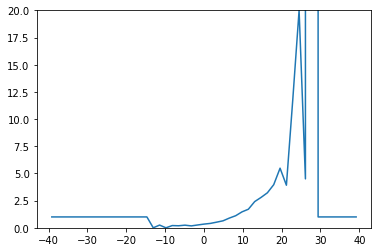

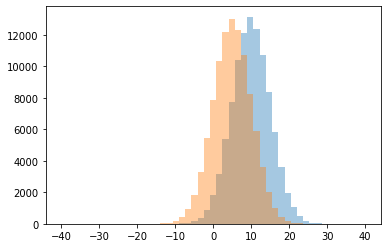

0 0.0
1 0.17575757575757575
2 0.1875
3 0.20588235294117646
4 0.24242424242424243
5 0.25
6 0.2597938144329897
7 0.34008683068017365
8 0.40349075975359344
9 0.5191972076788831
10 0.6418864908073542
11 0.8938879456706282
12 1.0
13 1.1107954545454546
14 1.4664391353811148
15 1.7076023391812865
16 2.411627906976744
17 2.793594306049822
18 3.2195121951219514
19 3.9166666666666665
20 3.966292134831461
21 4.5
22 5.483870967741935
23 11.75
24 20.0
25 999999.0




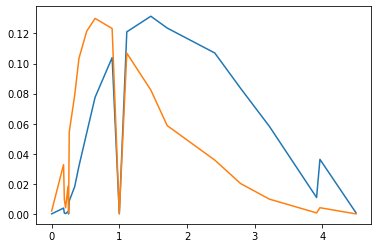

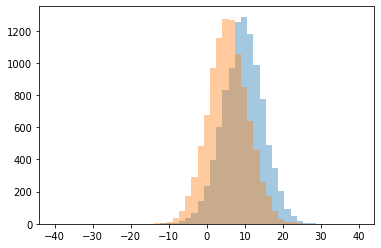

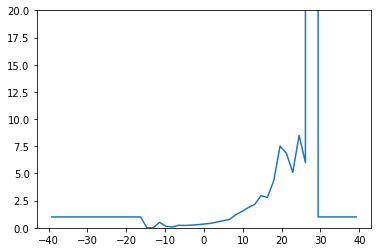

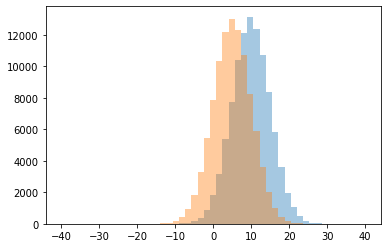

0 0.0
1 0.07692307692307693
2 0.14285714285714285
3 0.2159090909090909
4 0.23076923076923078
5 0.24305555555555555
6 0.28778467908902694
7 0.3480825958702065
8 0.4053497942386831
9 0.5
10 0.5247181266261925
11 0.6520031421838177
12 0.7636363636363637
13 1.0
14 1.1914691943127962
15 1.5135135135135136
16 1.8555729984301412
17 2.152173913043478
18 2.7954545454545454
19 2.954198473282443
20 4.325
21 5.1
22 6.0
23 6.846153846153846
24 7.518518518518518
25 8.5
26 999999.0




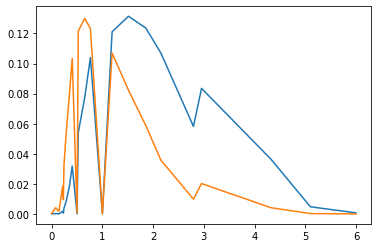

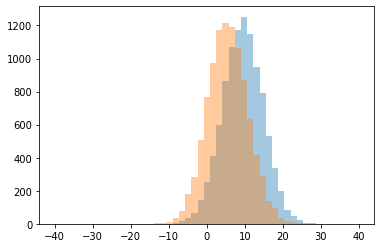

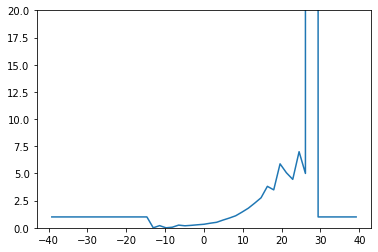

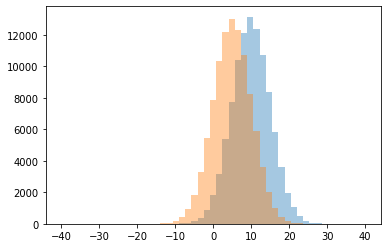

0 0.0
1 0.05263157894736842
2 0.1853932584269663
3 0.2
4 0.22614840989399293
5 0.24675324675324675
6 0.2784313725490196
7 0.3259452411994785
8 0.4234326824254882
9 0.5072340425531915
10 0.7106347897774113
11 0.8960603520536463
12 1.0
13 1.1055607917059378
14 1.4435483870967742
15 1.805337519623234
16 2.2696897374701672
17 2.759581881533101
18 3.4895833333333335
19 3.8142857142857145
20 4.454545454545454
21 5.0
22 5.0625
23 5.882352941176471
24 7.0
25 999999.0




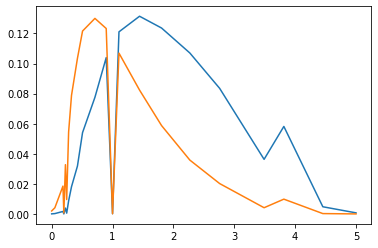

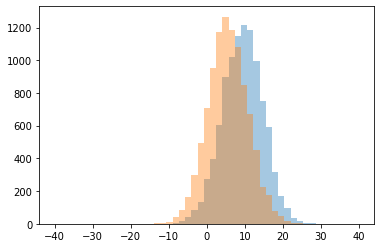

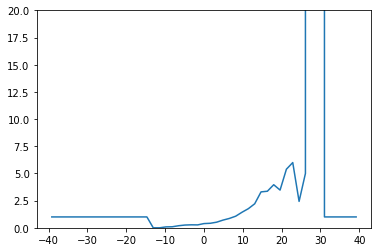

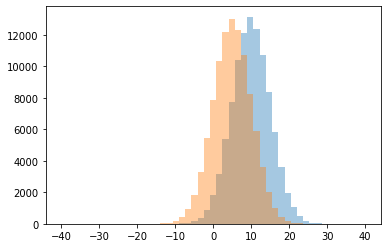

0 0.0
1 0.08333333333333333
2 0.09523809523809523
3 0.19047619047619047
4 0.25308641975308643
5 0.2668024439918534
6 0.27424749163879597
7 0.38787023977433005
8 0.41596638655462187
9 0.5170648464163823
10 0.707740916271722
11 0.8596787827557059
12 1.0
13 1.0667903525046383
14 1.4312573443008225
15 1.7592867756315007
16 2.2084257206208426
17 2.4285714285714284
18 3.303964757709251
19 3.3636363636363638
20 3.4693877551020407
21 3.9625
22 5.0
23 5.388888888888889
24 6.0
25 999999.0




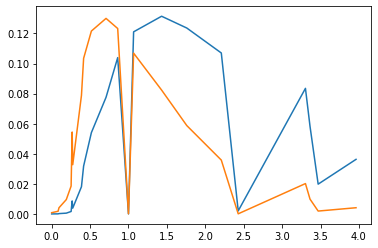

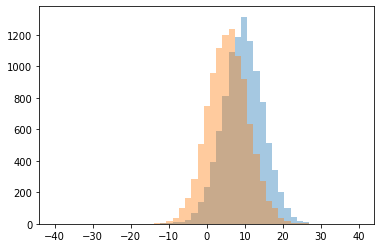

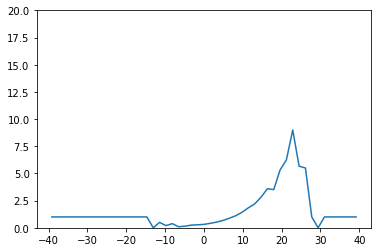

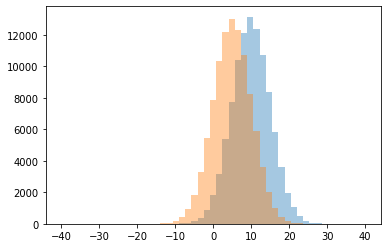

0 0.0
1 0.1
2 0.14545454545454545
3 0.2
4 0.24647887323943662
5 0.27380952380952384
6 0.31543624161073824
7 0.38235294117647056
8 0.4109014675052411
9 0.5
10 0.5246195165622203
11 0.675
12 0.8787388843977365
13 1.0
14 1.1096532333645737
15 1.4282608695652175
16 1.838351822503962
17 2.1977272727272728
18 2.8175182481751824
19 3.510204081632653
20 3.5944055944055946
21 5.315789473684211
22 5.5
23 5.666666666666667
24 6.25
25 9.0




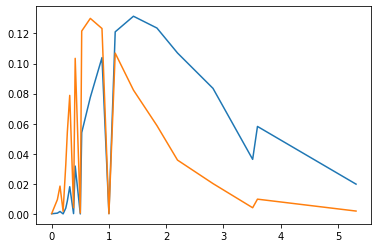

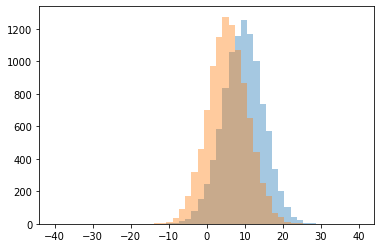

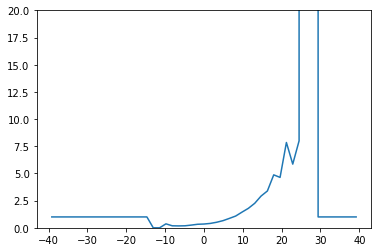

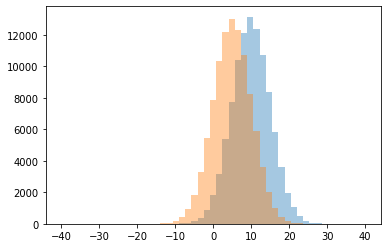

0 0.0
1 0.17391304347826086
2 0.18421052631578946
3 0.18452380952380953
4 0.24922118380062305
5 0.3246753246753247
6 0.3467048710601719
7 0.36363636363636365
8 0.40329218106995884
9 0.5100261551874455
10 0.6569858712715856
11 0.8639344262295082
12 1.0
13 1.0814606741573034
14 1.4430379746835442
15 1.789877300613497
16 2.2522522522522523
17 2.91699604743083
18 3.386904761904762
19 4.636363636363637
20 4.869565217391305
21 5.857142857142857
22 7.846153846153846
23 8.0
24 999999.0




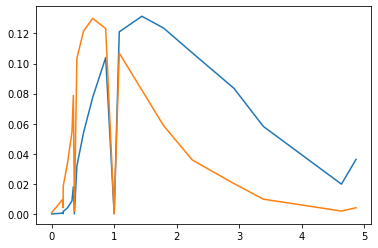

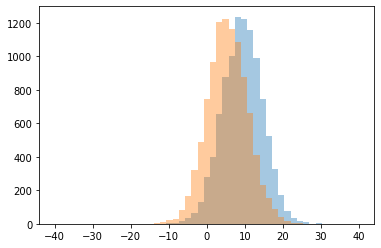

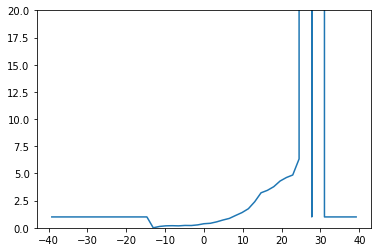

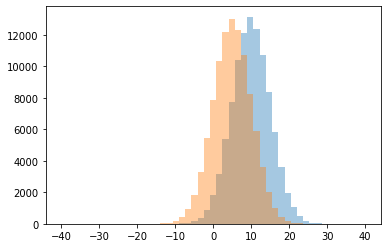

0 0.0
1 0.125
2 0.17857142857142858
3 0.18181818181818182
4 0.1935483870967742
5 0.209375
6 0.21686746987951808
7 0.2673469387755102
8 0.375
9 0.41511387163561075
10 0.5465116279069767
11 0.7166257166257166
12 0.8634020618556701
13 1.0
14 1.1369485294117647
15 1.4011428571428572
16 1.7534039334341907
17 2.3946731234866827
18 3.2198275862068964
19 3.4444444444444446
20 3.7790697674418605
21 4.3
22 4.625
23 4.857142857142857
24 6.333333333333333
25 999999.0




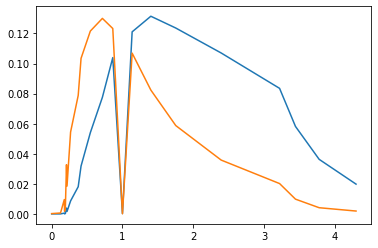

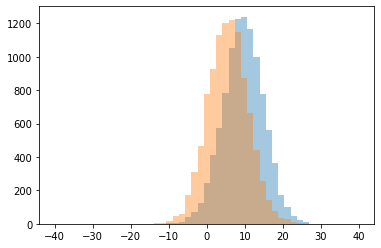

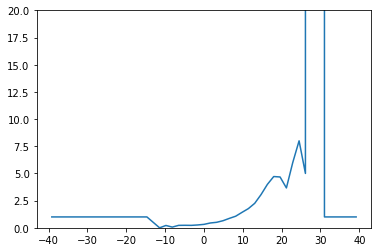

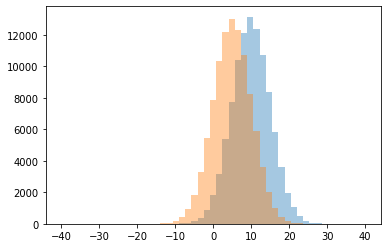

0 0.0
1 0.06521739130434782
2 0.21428571428571427
3 0.22402597402597402
4 0.22413793103448276
5 0.23121387283236994
6 0.2606837606837607
7 0.3161953727506427
8 0.44264069264069267
9 0.5
10 0.5057471264367817
11 0.6511240632805995
12 0.8660640920295809
13 1.0
14 1.065217391304348
15 1.4208715596330275
16 1.7639939485627836
17 2.25
18 3.0549019607843135
19 3.6666666666666665
20 3.992857142857143
21 4.675675675675675
22 4.714285714285714
23 5.0
24 6.0
25 8.0
26 999999.0




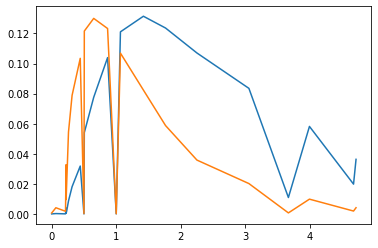

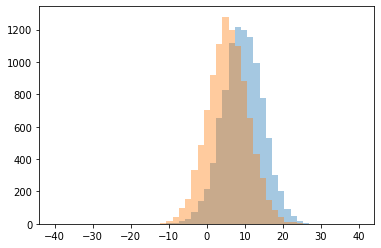

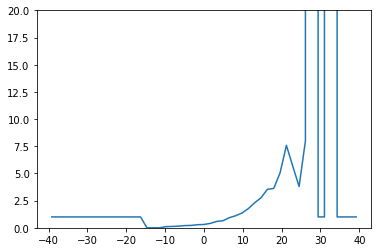

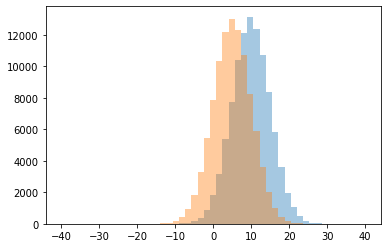

0 0.0
1 0.10526315789473684
2 0.125
3 0.15306122448979592
4 0.20512820512820512
5 0.21987951807228914
6 0.28512396694214875
7 0.3039772727272727
8 0.40543478260869564
9 0.585958595859586
10 0.64765625
11 0.9299416180150125
12 1.0
13 1.1112123974475843
14 1.3594104308390023
15 1.7660550458715596
16 2.3055555555555554
17 2.7615658362989324
18 3.54
19 3.619047619047619
20 3.8
21 5.05
22 5.666666666666667
23 7.583333333333333
24 8.0
25 999999.0




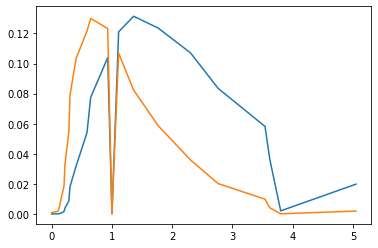

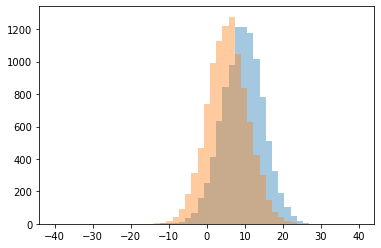

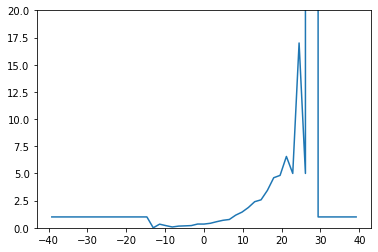

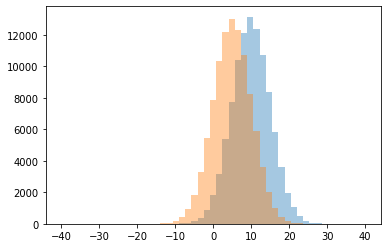

0 0.0
1 0.075
2 0.15555555555555556
3 0.1774193548387097
4 0.2
5 0.20382165605095542
6 0.3333333333333333
7 0.3428184281842818
8 0.34615384615384615
9 0.4147325933400605
10 0.5617777777777778
11 0.6904176904176904
12 0.7658574784651527
13 1.0
14 1.1636363636363636
15 1.4433849821215734
16 1.8664546899841017
17 2.4018912529550827
18 2.5723684210526314
19 3.439189189189189
20 4.605633802816901
21 4.82051282051282
22 5.0
23 6.5625
24 17.0
25 999999.0




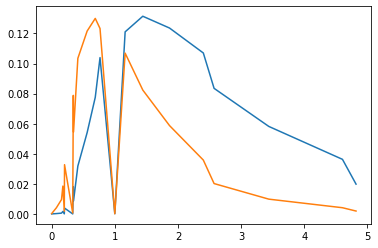

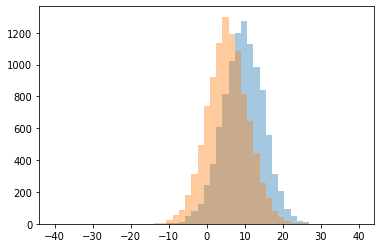

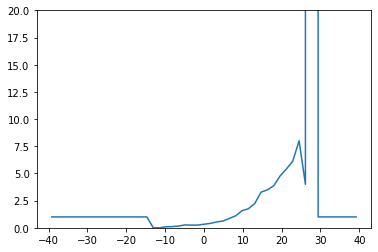

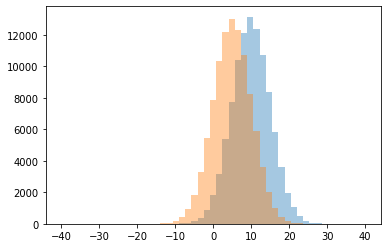

0 0.0
1 0.09523809523809523
2 0.10909090909090909
3 0.16279069767441862
4 0.2468354430379747
5 0.24949698189134809
6 0.2640449438202247
7 0.327027027027027
8 0.40608034744842564
9 0.5343915343915344
10 0.6264411990776326
11 0.8590604026845637
12 1.0
13 1.103321033210332
14 1.5707257072570726
15 1.754276827371695
16 2.228506787330317
17 3.27734375
18 3.490566037735849
19 3.8641975308641974
20 4.0
21 4.767441860465116
22 5.411764705882353
23 6.125
24 8.0
25 999999.0




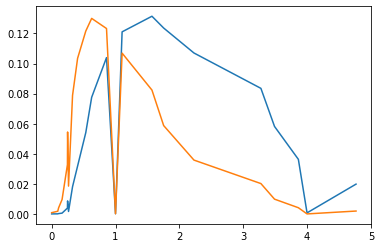

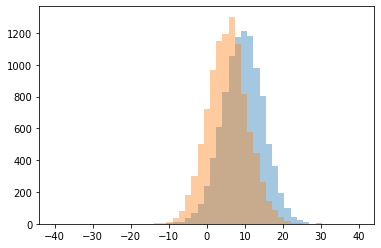

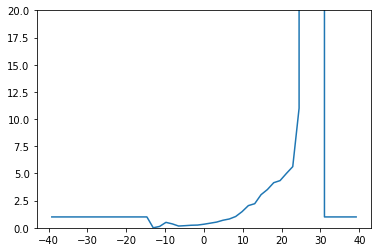

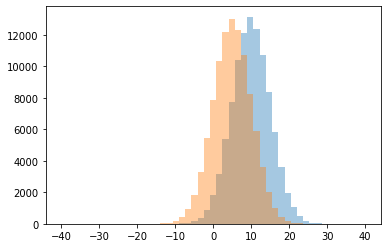

0 0.0
1 0.125
2 0.1625
3 0.1956521739130435
4 0.23509933774834438
5 0.25149700598802394
6 0.33055555555555555
7 0.3611111111111111
8 0.42650103519668736
9 0.5
10 0.5260416666666666
11 0.6956521739130435
12 0.8112049117421335
13 1.0
14 1.038938053097345
15 1.4816625916870416
16 2.0413793103448277
17 2.216704288939052
18 3.0456273764258555
19 3.5174825174825175
20 4.149425287356322
21 4.340909090909091
22 5.0
23 5.625
24 11.0
25 999999.0




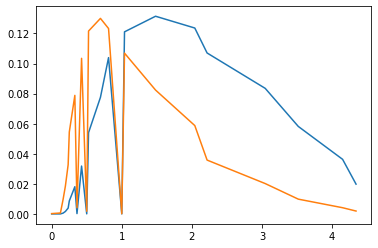

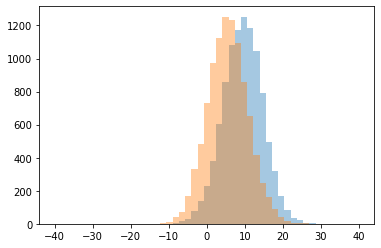

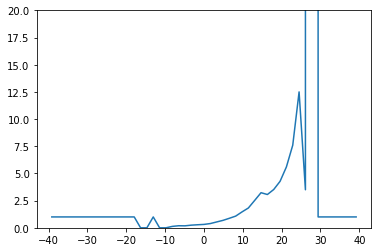

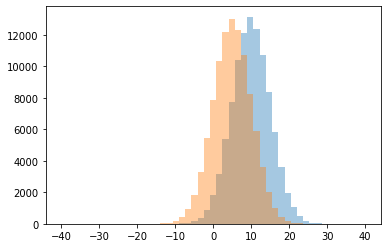

0 0.0
1 0.1282051282051282
2 0.18128654970760233
3 0.1891891891891892
4 0.24316109422492402
5 0.2800829875518672
6 0.3118131868131868
7 0.39014373716632444
8 0.5373665480427047
9 0.6839584996009577
10 0.8745954692556634
11 1.0
12 1.075091575091575
13 1.4620770128354725
14 1.8215384615384616
15 2.5217391304347827
16 3.0617283950617282
17 3.2285714285714286
18 3.5
19 3.522222222222222
20 4.275
21 5.6
22 7.6
23 12.5
24 999999.0




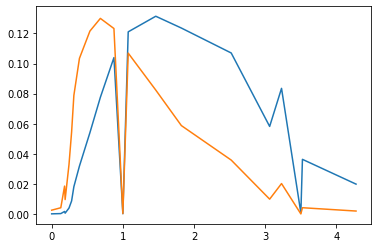

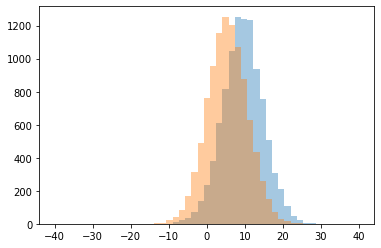

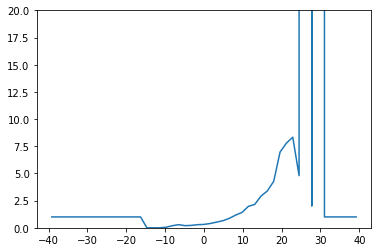

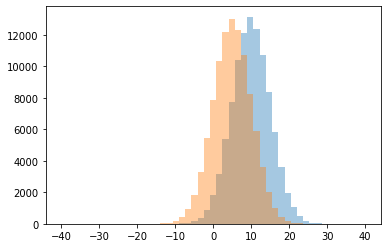

0 0.0
1 0.047619047619047616
2 0.19047619047619047
3 0.19760479041916168
4 0.22186495176848875
5 0.2874743326488706
6 0.2891566265060241
7 0.3110236220472441
8 0.3966597077244259
9 0.5250431778929189
10 0.653876898481215
11 0.8694929343308395
12 1.0
13 1.169776119402985
14 1.412770809578107
15 1.9712918660287082
16 2.0
17 2.1490825688073394
18 2.918918918918919
19 3.3933333333333335
20 4.277777777777778
21 4.8
22 6.966666666666667
23 7.785714285714286
24 8.333333333333334
25 999999.0




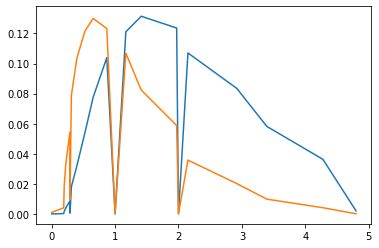

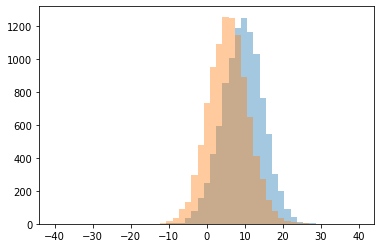

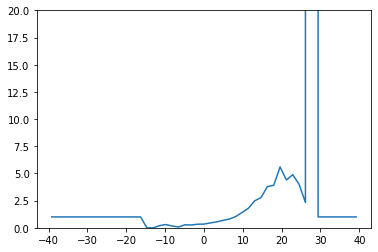

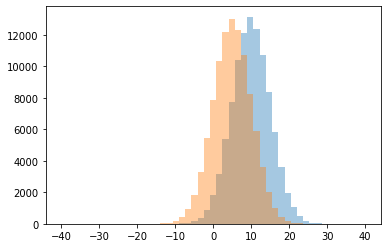

0 0.0
1 0.07608695652173914
2 0.16216216216216217
3 0.2
4 0.2593856655290102
5 0.27611940298507465
6 0.3
7 0.33052631578947367
8 0.33923705722070846
9 0.44842105263157894
10 0.5445362718089991
11 0.6807324840764332
12 0.8038430744595677
13 1.0
14 1.0331010452961673
15 1.4054054054054055
16 1.7938461538461539
17 2.3333333333333335
18 2.4806763285024154
19 2.7838827838827838
20 3.7916666666666665
21 3.909090909090909
22 4.0
23 4.4
24 4.888888888888889
25 5.6
26 999999.0




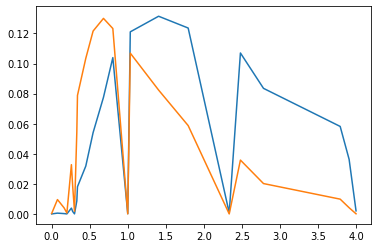

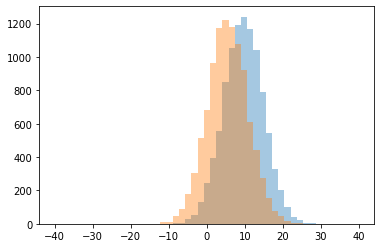

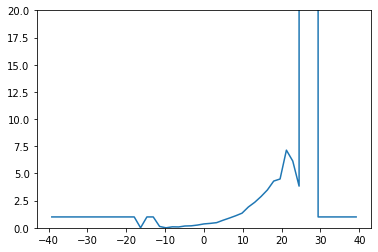

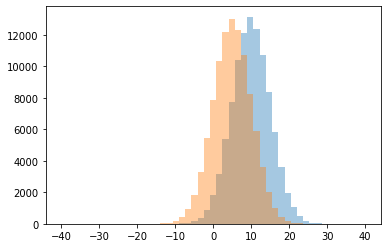

0 0.0
1 0.07865168539325842
2 0.08888888888888889
3 0.125
4 0.16477272727272727
5 0.18211920529801323
6 0.2543689320388349
7 0.35777126099706746
8 0.40621761658031086
9 0.4748078565328779
10 0.6936936936936937
11 0.8937977909940527
12 1.0
13 1.1066790352504638
14 1.3445287107258939
15 1.9131147540983606
16 2.3445945945945947
17 2.875912408759124
18 3.480769230769231
19 3.8333333333333335
20 4.298701298701299
21 4.488888888888889
22 6.142857142857143
23 7.142857142857143
24 999999.0




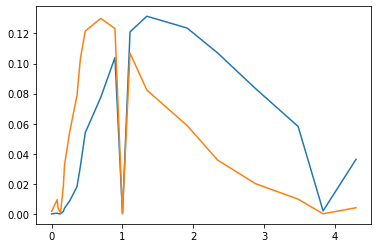

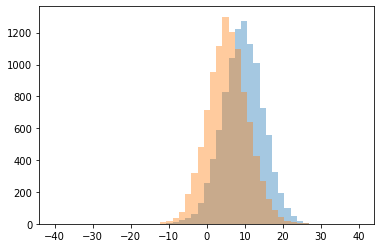

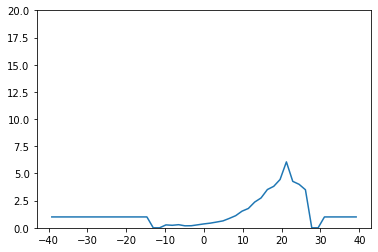

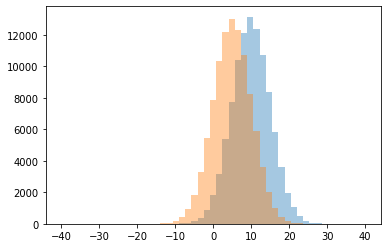

0 0.0
1 0.1827956989247312
2 0.19003115264797507
3 0.23076923076923078
4 0.26666666666666666
5 0.27385892116182575
6 0.2857142857142857
7 0.35893854748603354
8 0.42902208201892744
9 0.5300448430493273
10 0.6361538461538462
11 0.8648424543946932
12 1.0
13 1.1147540983606556
14 1.5301204819277108
15 1.778301886792453
16 2.36768149882904
17 2.744360902255639
18 3.5
19 3.518987341772152
20 3.813953488372093
21 4.0
22 4.2727272727272725
23 4.441860465116279
24 6.0625




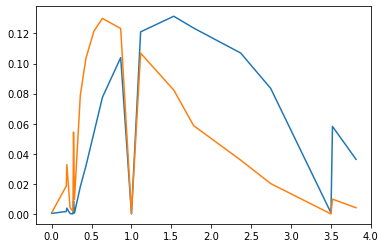

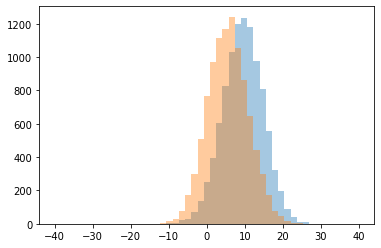

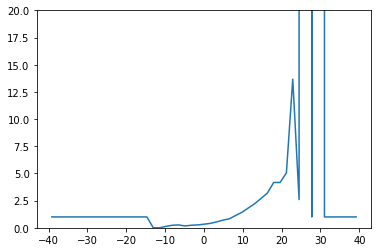

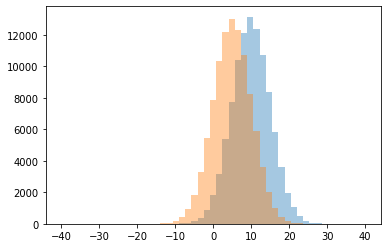

0 0.0
1 0.13333333333333333
2 0.1676300578034682
3 0.23333333333333334
4 0.23666666666666666
5 0.26429980276134124
6 0.26666666666666666
7 0.32941176470588235
8 0.4059917355371901
9 0.5434198746642793
10 0.7053800170794193
11 0.8276972624798712
12 1.0
13 1.1354166666666667
14 1.4287369640787948
15 1.8253477588871716
16 2.2199546485260773
17 2.6
18 2.703333333333333
19 3.1954022988505746
20 4.1688311688311686
21 4.170212765957447
22 5.055555555555555
23 13.666666666666666
24 999999.0




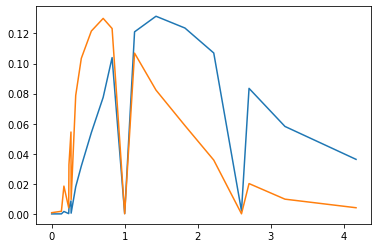

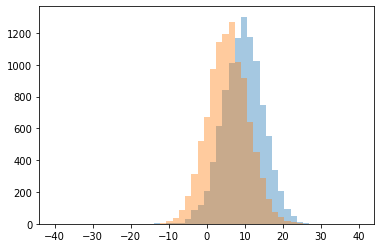

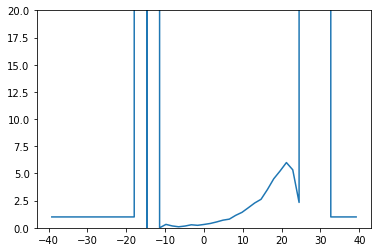

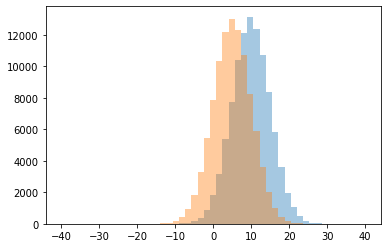

0 0.0
1 0.09302325581395349
2 0.16091954022988506
3 0.17142857142857143
4 0.22840690978886757
5 0.27741935483870966
6 0.3074626865671642
7 0.3125
8 0.3987667009249743
9 0.5398773006134969
10 0.7026800670016751
11 0.7971586424625099
12 1.0
13 1.1452404317958784
14 1.4229508196721312
15 1.847723704866562
16 2.282850779510022
17 2.3333333333333335
18 2.6223776223776225
19 3.5126582278481013
20 4.506666666666667
21 5.225
22 5.333333333333333
23 6.0
24 999999.0




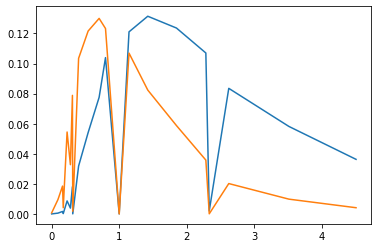

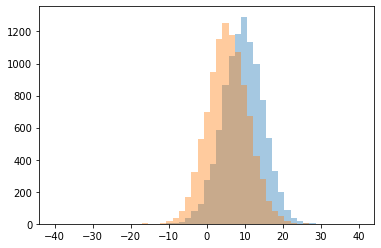

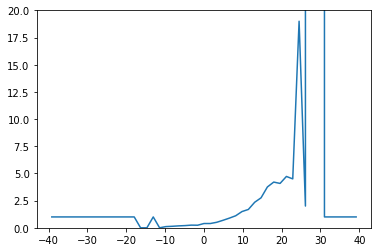

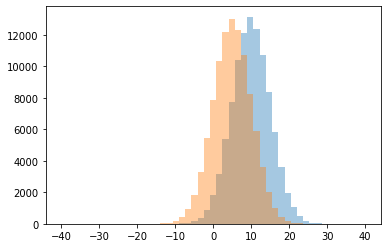

0 0.0
1 0.1111111111111111
2 0.1388888888888889
3 0.17721518987341772
4 0.20238095238095238
5 0.23719165085388993
6 0.2453416149068323
7 0.39341917024320455
8 0.3940677966101695
9 0.5056277056277056
10 0.6900958466453674
11 0.8880407124681934
12 1.0
13 1.1063432835820894
14 1.4953703703703705
15 1.687964338781575
16 2.0
17 2.3505882352941176
18 2.757142857142857
19 3.7552447552447554
20 4.081632653061225
21 4.205128205128205
22 4.5
23 4.722222222222222
24 19.0
25 999999.0




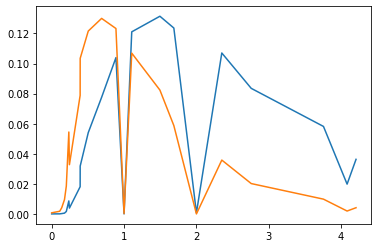

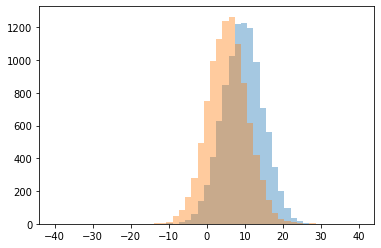

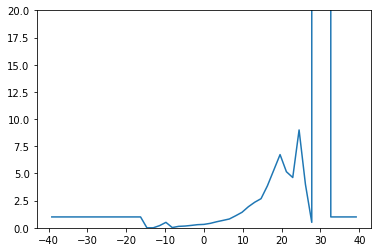

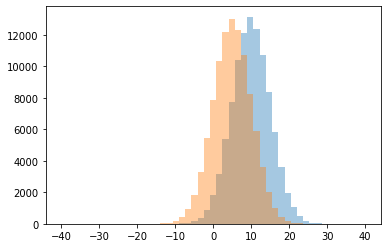

0 0.0
1 0.022222222222222223
2 0.13253012048192772
3 0.16049382716049382
4 0.2
5 0.2206405693950178
6 0.2880324543610548
7 0.3147410358565737
8 0.4102822580645161
9 0.5
10 0.5561450044208665
11 0.6809024979854955
12 0.8102766798418972
13 1.0
14 1.1081818181818182
15 1.4267441860465115
16 1.9368932038834952
17 2.35
18 2.6792452830188678
19 3.856164383561644
20 4.0
21 4.625
22 5.157894736842105
23 5.292307692307692
24 6.733333333333333
25 9.0
26 999999.0




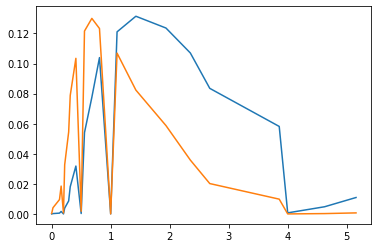

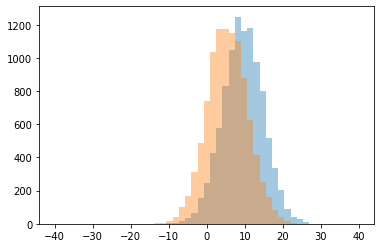

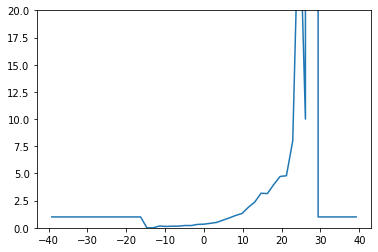

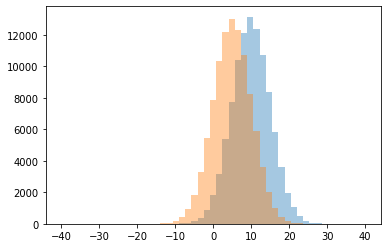

0 0.0
1 0.125
2 0.15
3 0.16666666666666666
4 0.20634920634920634
5 0.21212121212121213
6 0.3135245901639344
7 0.3333333333333333
8 0.4119922630560928
9 0.4931972789115646
10 0.70578231292517
11 0.9088541666666666
12 1.0
13 1.1354545454545455
14 1.316326530612245
15 1.8849840255591055
16 2.3616504854368934
17 3.1463414634146343
18 3.1785714285714284
19 3.976470588235294
20 4.72093023255814
21 4.7894736842105265
22 8.0
23 10.0
24 31.0
25 999999.0




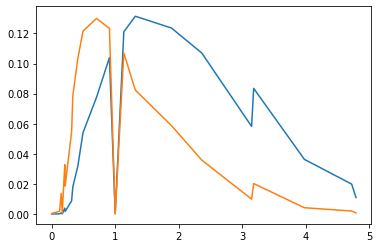

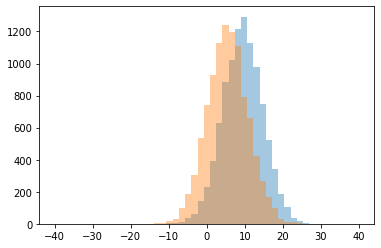

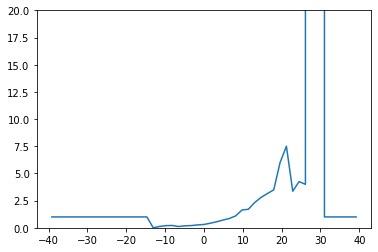

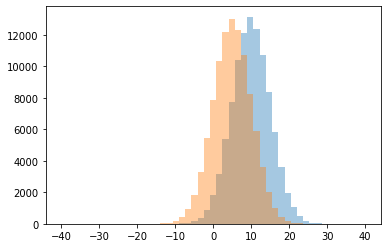

0 0.0
1 0.1188118811881188
2 0.125
3 0.18181818181818182
4 0.2
5 0.2052980132450331
6 0.21212121212121213
7 0.26591760299625467
8 0.30634278002699056
9 0.4219590958019376
10 0.5548672566371682
11 0.7135961383748994
12 0.8560669456066946
13 1.0
14 1.0972972972972972
15 1.6375158428390368
16 1.706060606060606
17 2.324644549763033
18 2.794776119402985
19 3.1515151515151514
20 3.3636363636363638
21 3.484848484848485
22 4.0
23 4.25
24 6.0
25 7.5
26 999999.0




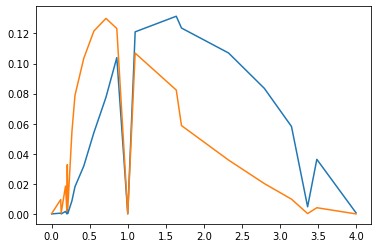

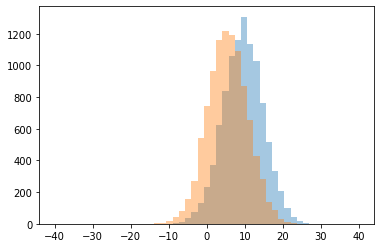

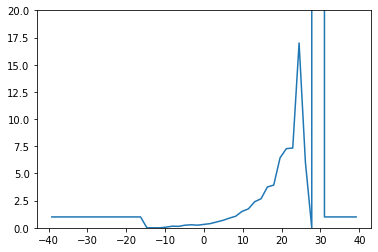

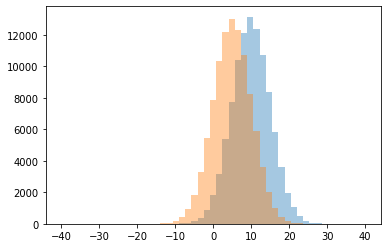

0 0.0
1 0.05555555555555555
2 0.13253012048192772
3 0.15
4 0.24050632911392406
5 0.24125230202578268
6 0.2767527675276753
7 0.3140161725067385
8 0.3854922279792746
9 0.5370689655172414
10 0.6855500821018062
11 0.889168765743073
12 1.0
13 1.0634191176470589
14 1.5074971164936564
15 1.7381316998468606
16 2.4018691588785046
17 2.670175438596491
18 3.753623188405797
19 3.929411764705882
20 6.0
21 6.4375
22 7.285714285714286
23 7.333333333333333
24 17.0
25 999999.0




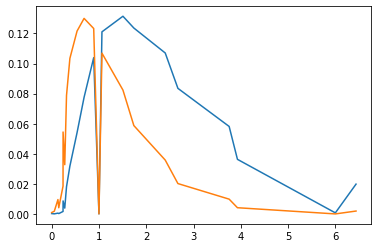

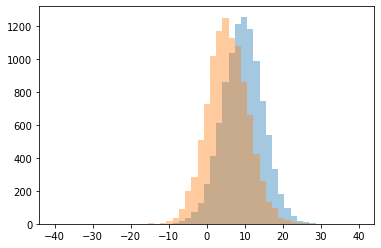

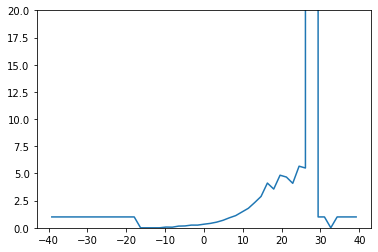

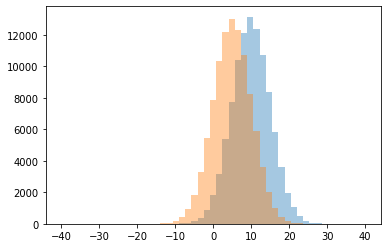

0 0.0
1 0.05555555555555555
2 0.06666666666666667
3 0.15555555555555556
4 0.1708542713567839
5 0.24703557312252963
6 0.24825174825174826
7 0.3314917127071823
8 0.40532544378698226
9 0.5209940017137961
10 0.6893514811849479
11 0.9182948490230906
12 1.0
13 1.1203703703703705
14 1.4576074332171893
15 1.7945205479452055
16 2.32311320754717
17 2.883720930232558
18 3.5638297872340425
19 4.090909090909091
20 4.114503816793893
21 4.666666666666667
22 4.837837837837838
23 5.5
24 5.666666666666667
25 999999.0




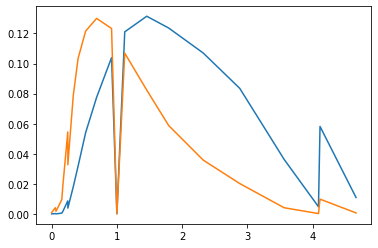

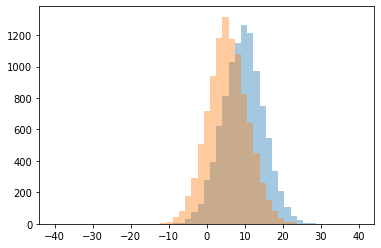

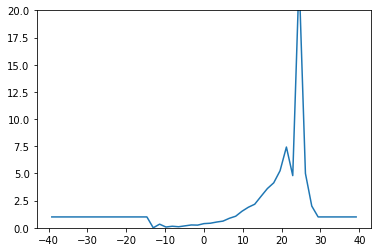

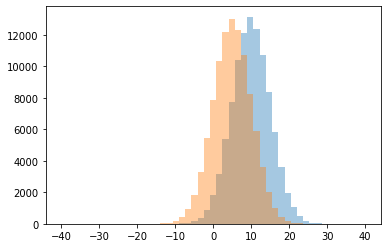

0 0.0
1 0.07142857142857142
2 0.0963855421686747
3 0.14285714285714285
4 0.1781609195402299
5 0.24703557312252963
6 0.2611683848797251
7 0.3333333333333333
8 0.3852573018080668
9 0.4204909284951974
10 0.529212531752752
11 0.615793470007593
12 0.8740425531914894
13 1.0
14 1.0638297872340425
15 1.5241545893719808
16 1.8911353032659408
17 2.0
18 2.1674107142857144
19 2.895348837209302
20 3.609271523178808
21 4.135802469135802
22 4.8
23 5.0
24 5.25
25 7.428571428571429
26 23.0




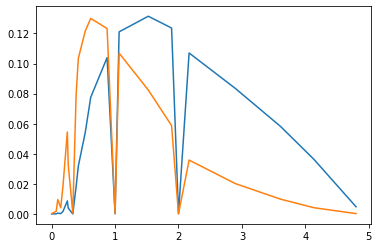

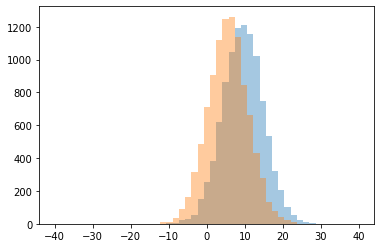

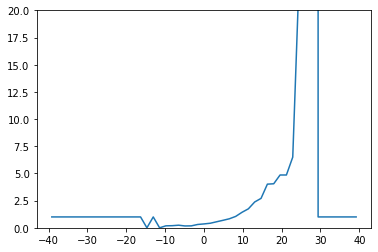

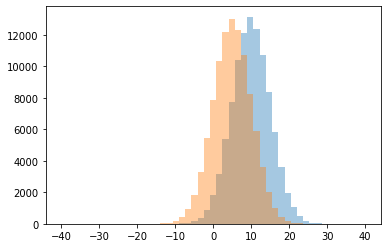

0 0.0
1 0.1696969696969697
2 0.17777777777777778
3 0.18181818181818182
4 0.19444444444444445
5 0.2391304347826087
6 0.30515463917525776
7 0.3563380281690141
8 0.4198895027624309
9 0.5554561717352415
10 0.6888
11 0.8287073750991277
12 1.0
13 1.047451669595782
14 1.4268867924528301
15 1.7439759036144578
16 2.3758700696055683
17 2.7065217391304346
18 4.015037593984962
19 4.050632911392405
20 4.857142857142857
21 6.5
22 23.0
23 999999.0




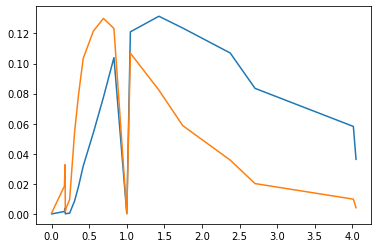

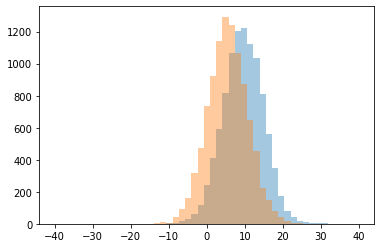

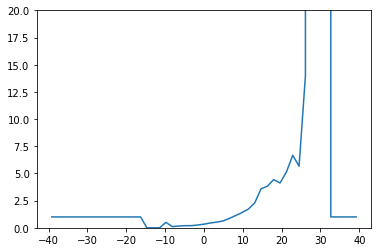

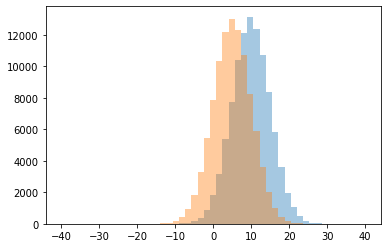

0 0.0
1 0.1111111111111111
2 0.16304347826086957
3 0.1949685534591195
4 0.1974921630094044
5 0.2542372881355932
6 0.3333333333333333
7 0.4436008676789588
8 0.5
9 0.5174825174825175
10 0.6318638824439289
11 0.8620967741935484
12 1.0
13 1.1282771535580525
14 1.4032073310423825
15 1.7204301075268817
16 2.2841409691629955
17 3.584070796460177
18 3.828767123287671
19 4.119047619047619
20 4.435897435897436
21 5.133333333333334
22 5.666666666666667
23 6.666666666666667
24 14.0
25 999999.0




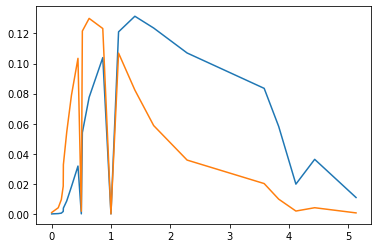

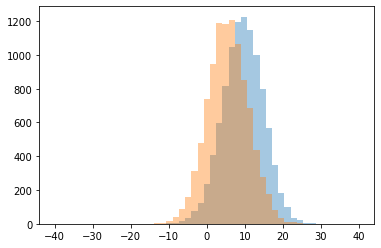

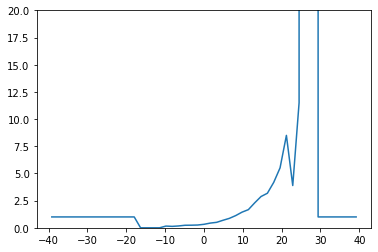

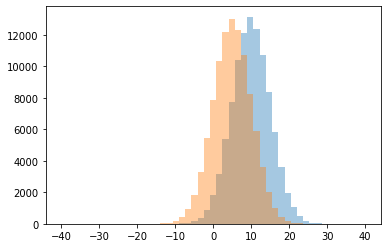

0 0.0
1 0.13157894736842105
2 0.15789473684210525
3 0.17045454545454544
4 0.23270440251572327
5 0.23961661341853036
6 0.25523012552301255
7 0.32157394843962006
8 0.4334038054968288
9 0.5033613445378151
10 0.6923728813559322
11 0.8667218543046358
12 1.0
13 1.1222953904045154
14 1.4389671361502347
15 1.6690962099125364
16 2.2958715596330275
17 2.8772563176895307
18 3.17877094972067
19 3.888888888888889
20 4.178571428571429
21 5.515151515151516
22 8.5
23 11.5
24 999999.0




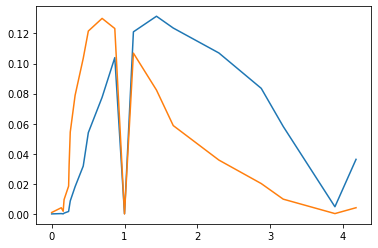

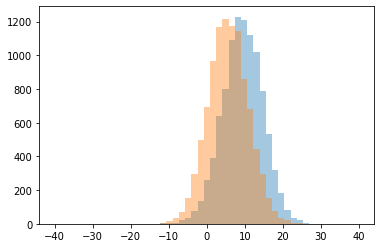

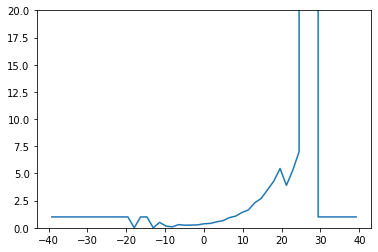

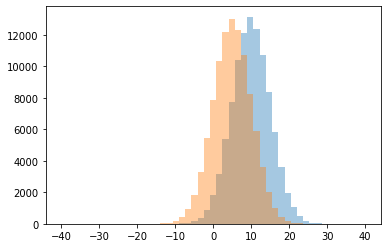

0 0.0
1 0.08571428571428572
2 0.15789473684210525
3 0.23684210526315788
4 0.25
5 0.2685370741482966
6 0.29411764705882354
7 0.3708513708513709
8 0.4045643153526971
9 0.5
10 0.5476394849785408
11 0.6565324568611339
12 0.9333902647309992
13 1.0
14 1.0752405949256343
15 1.413068844807468
16 1.6403508771929824
17 2.2995495495495497
18 2.689419795221843
19 3.4740259740259742
20 3.9047619047619047
21 4.283783783783784
22 5.285714285714286
23 5.454545454545454
24 7.0
25 999999.0




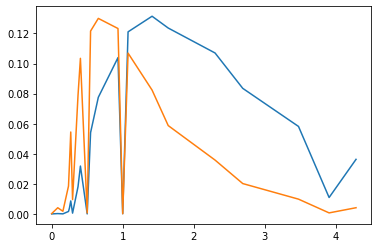

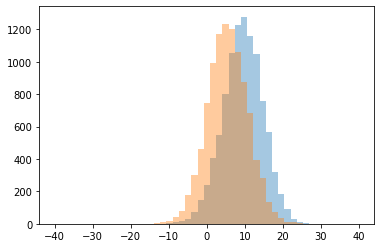

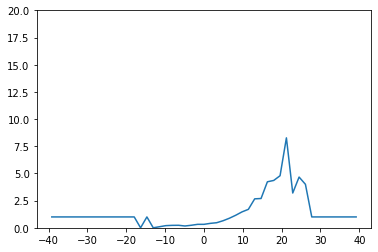

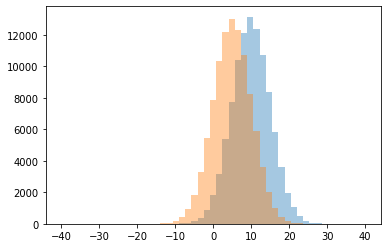

0 0.0
1 0.1
2 0.16666666666666666
3 0.2
4 0.225
5 0.23076923076923078
6 0.23333333333333334
7 0.3181818181818182
8 0.31860776439089694
9 0.4080808080808081
10 0.46757679180887374
11 0.6477732793522267
12 0.8777038269550749
13 1.0
14 1.1523988711194733
15 1.4639175257731958
16 1.6973684210526316
17 2.66412213740458
18 2.693950177935943
19 3.2
20 4.0
21 4.231343283582089
22 4.3561643835616435
23 4.666666666666667
24 4.7894736842105265
25 8.272727272727273




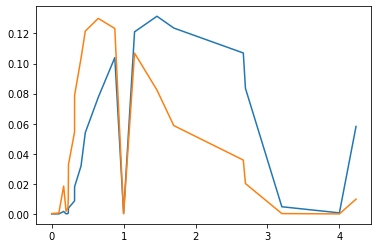

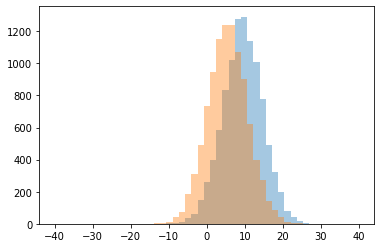

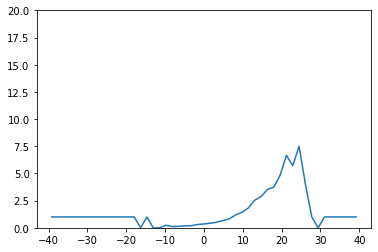

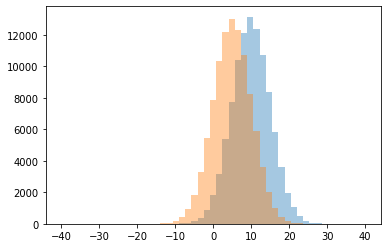

0 0.0
1 0.11627906976744186
2 0.136986301369863
3 0.18085106382978725
4 0.1935483870967742
5 0.23076923076923078
6 0.3022312373225152
7 0.35278154681139756
8 0.42133051742344246
9 0.5086805555555556
10 0.6712328767123288
11 0.824575586095392
12 1.0
13 1.1884328358208955
14 1.4296788482834994
15 1.826645264847512
16 2.5338345864661656
17 2.8703703703703702
18 3.5214285714285714
19 3.7325581395348837
20 4.0
21 4.829268292682927
22 5.714285714285714
23 6.666666666666667
24 7.5




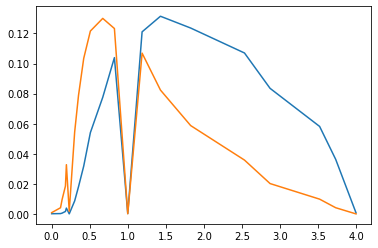

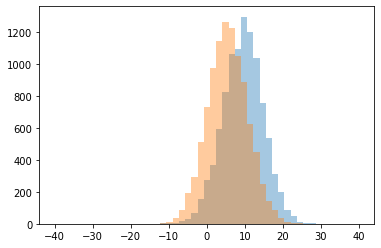

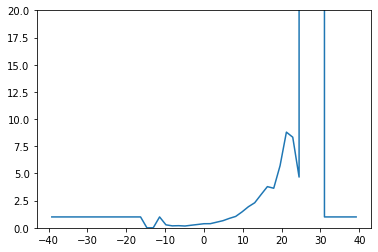

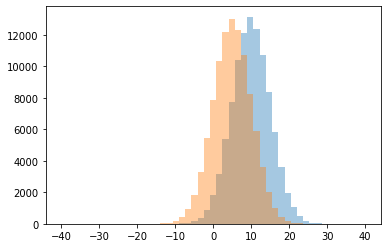

0 0.0
1 0.1641025641025641
2 0.1794871794871795
3 0.19540229885057472
4 0.23711340206185566
5 0.2727272727272727
6 0.3045186640471513
7 0.375
8 0.37923946557040084
9 0.5174520069808028
10 0.655035685963521
11 0.8659035159443991
12 1.0
13 1.0458452722063036
14 1.4616252821670428
15 1.9355877616747181
16 2.3022222222222224
17 3.0524193548387095
18 3.63953488372093
19 3.7872340425531914
20 4.666666666666667
21 5.714285714285714
22 8.333333333333334
23 8.8
24 999999.0




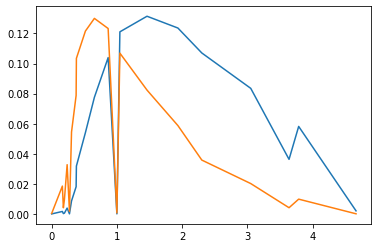

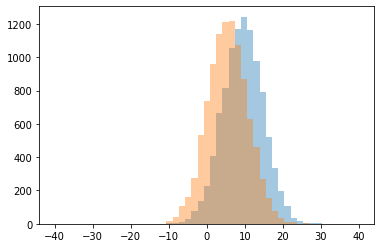

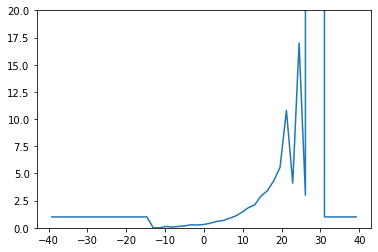

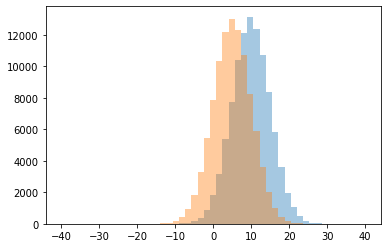

0 0.0
1 0.07142857142857142
2 0.125
3 0.17901234567901234
4 0.2560747663551402
5 0.2815884476534296
6 0.3071718538565629
7 0.42231491136600624
8 0.5859649122807018
9 0.6729818780889621
10 0.867816091954023
11 1.0
12 1.0892193308550187
13 1.4320276497695852
14 1.847376788553259
15 2.1103896103896105
16 2.925925925925926
17 3.0
18 3.411764705882353
19 4.111111111111111
20 4.324675324675325
21 5.571428571428571
22 10.8
23 17.0
24 999999.0




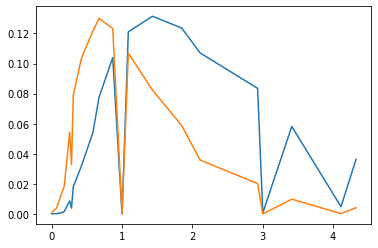

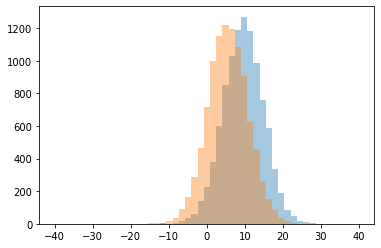

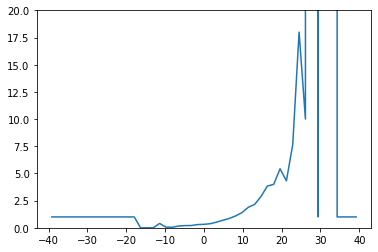

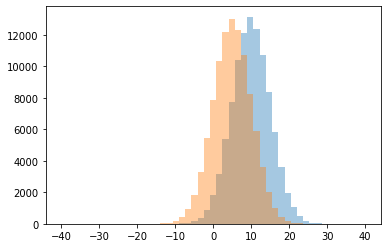

0 0.0
1 0.05263157894736842
2 0.0625
3 0.16304347826086957
4 0.2037037037037037
5 0.2103448275862069
6 0.2974137931034483
7 0.3179916317991632
8 0.3776223776223776
9 0.4
10 0.5229835212489159
11 0.6963993453355155
12 0.8595317725752508
13 1.0
14 1.094843462246777
15 1.3997797356828194
16 1.8913738019169328
17 2.1553610503282274
18 2.8893129770992365
19 3.8366013071895426
20 4.0
21 4.315789473684211
22 5.428571428571429
23 7.666666666666667
24 10.0
25 18.0
26 999999.0




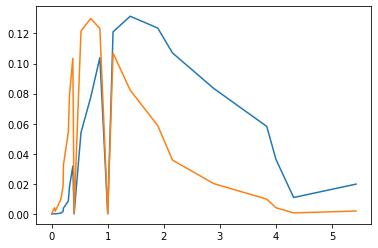

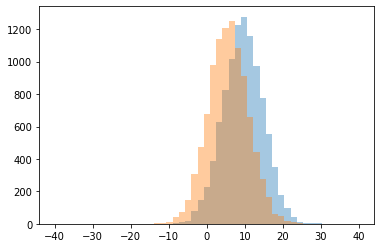

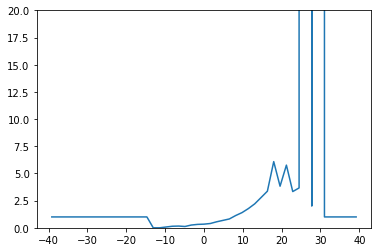

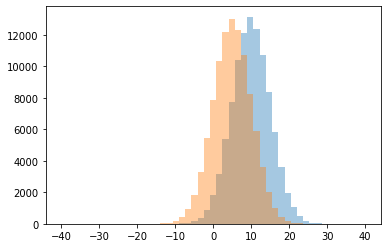

0 0.0
1 0.07142857142857142
2 0.12080536912751678
3 0.14285714285714285
4 0.16
5 0.2532467532467532
6 0.3136842105263158
7 0.3353028064992615
8 0.3953013278855976
9 0.5527240773286467
10 0.6823821339950372
11 0.8128
12 1.0
13 1.128110599078341
14 1.3971553610503282
15 1.7671232876712328
16 2.0
17 2.2013574660633486
18 2.781362007168459
19 3.3333333333333335
20 3.3658536585365852
21 3.6666666666666665
22 3.8260869565217392
23 5.764705882352941
24 6.086206896551724
25 999999.0




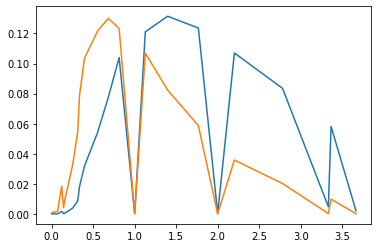

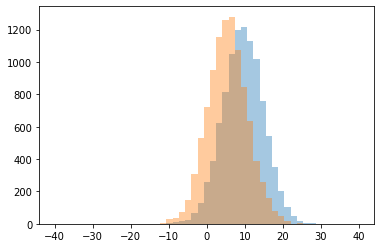

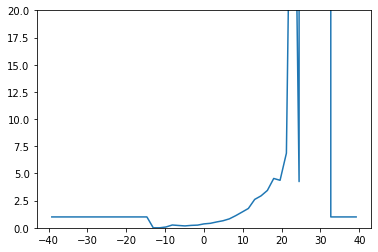

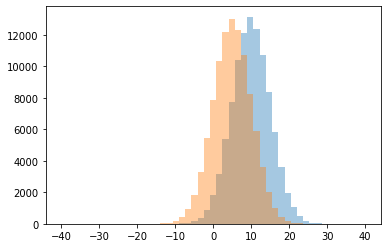

0 0.0
1 0.07407407407407407
2 0.17333333333333334
3 0.21333333333333335
4 0.22295081967213115
5 0.24716981132075472
6 0.2571428571428571
7 0.36
8 0.41201264488935724
9 0.5377276669557676
10 0.6481334392374901
11 0.821875
12 1.0
13 1.1154562383612663
14 1.4431279620853081
15 1.777602523659306
16 2.6112531969309463
17 2.9382239382239383
18 3.4367088607594938
19 4.25
20 4.369565217391305
21 4.538461538461538
22 6.866666666666666
23 51.0
24 999999.0




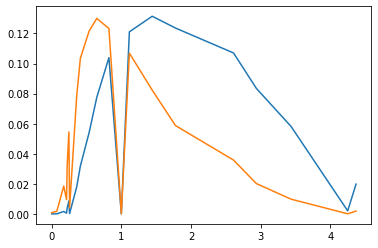

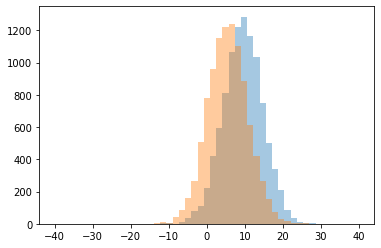

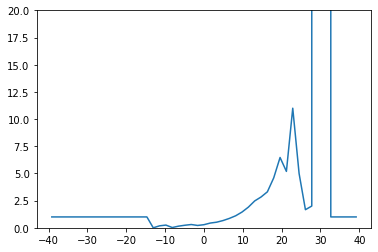

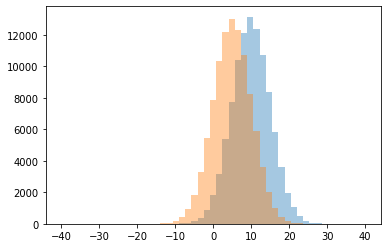

0 0.0
1 0.025
2 0.15294117647058825
3 0.18181818181818182
4 0.21568627450980393
5 0.2356687898089172
6 0.25
7 0.2864450127877238
8 0.3018867924528302
9 0.4369134515119917
10 0.5160729800173762
11 0.6653027823240589
12 0.8627925746569814
13 1.0
14 1.1058823529411765
15 1.4487034949267192
16 1.6666666666666667
17 1.9003267973856208
18 2.0
19 2.471291866028708
20 2.8333333333333335
21 3.3092105263157894
22 4.594594594594595
23 5.0
24 5.1875
25 6.46875
26 11.0
27 999999.0




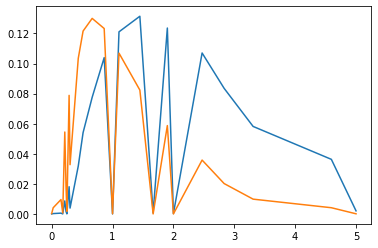

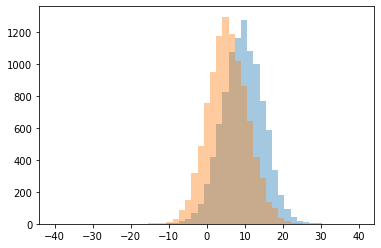

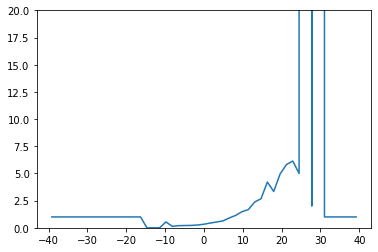

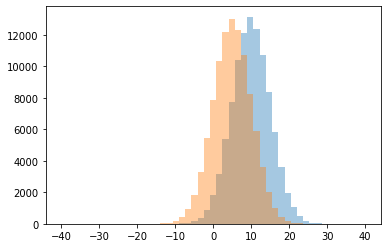

0 0.0
1 0.13333333333333333
2 0.19767441860465115
3 0.20945945945945946
4 0.22012578616352202
5 0.25614754098360654
6 0.3293492695883134
7 0.4386149003147954
8 0.5314091680814941
9 0.5384615384615384
10 0.6365740740740741
11 0.9057239057239057
12 1.0
13 1.1432777232580962
14 1.4797219003476245
15 1.6770186335403727
16 2.0
17 2.3729216152019004
18 2.6770833333333335
19 3.34
20 4.2086330935251794
21 4.944444444444445
22 5.0
23 5.8125
24 6.142857142857143
25 999999.0




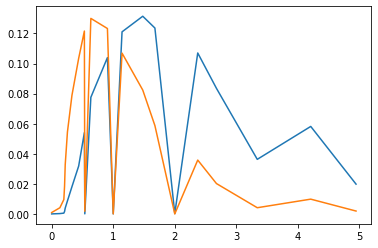

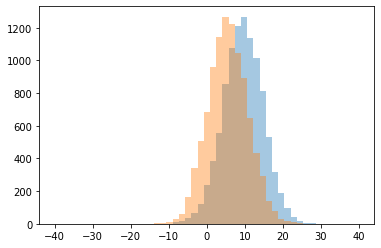

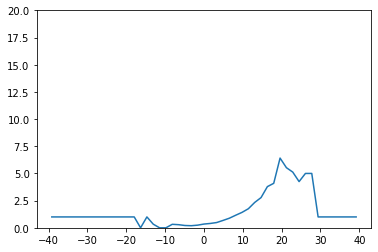

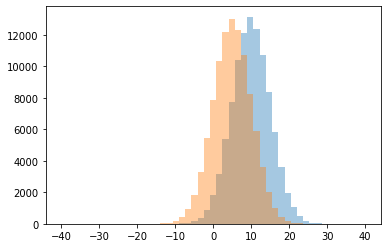

0 0.0
1 0.1924198250728863
2 0.21212121212121213
3 0.24356435643564356
4 0.2857142857142857
5 0.32142857142857145
6 0.3333333333333333
7 0.3445255474452555
8 0.4
9 0.48384279475982533
10 0.6772151898734177
11 0.8812448812448812
12 1.0
13 1.1555343511450382
14 1.4188129899216126
15 1.7530864197530864
16 2.3325688073394497
17 2.7781569965870307
18 3.7872340425531914
19 4.090909090909091
20 4.25
21 5.0
22 5.125
23 5.529411764705882
24 6.413793103448276




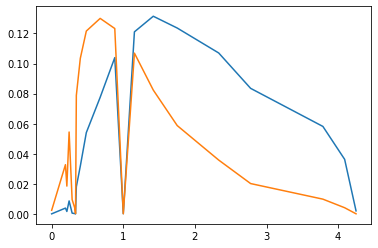

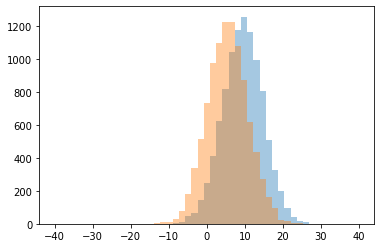

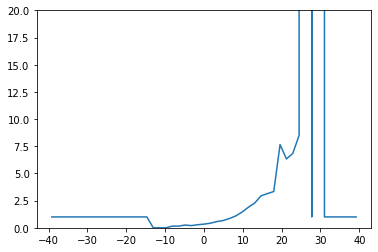

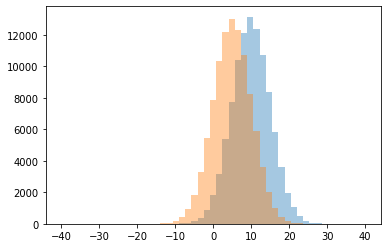

0 0.0
1 0.1518987341772152
2 0.15625
3 0.20058997050147492
4 0.25555555555555554
5 0.2815533980582524
6 0.336986301369863
7 0.42034943473792397
8 0.5689497716894977
9 0.6650326797385621
10 0.8506122448979592
11 1.0
12 1.087037037037037
13 1.4441887226697354
14 1.889430894308943
15 2.2775229357798166
16 2.9416058394160585
17 3.1419753086419755
18 3.336734693877551
19 6.333333333333333
20 6.833333333333333
21 7.653846153846154
22 8.5
23 999999.0




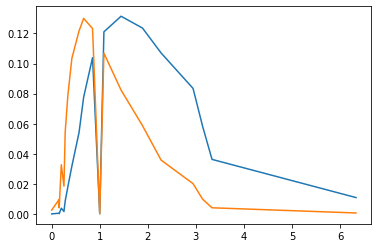

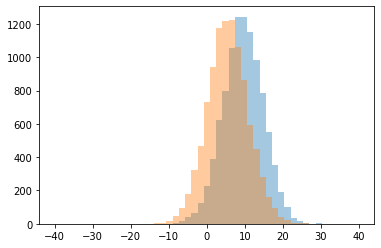

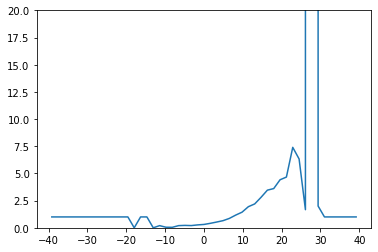

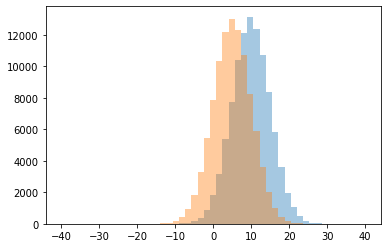

0 0.0
1 0.044444444444444446
2 0.05263157894736842
3 0.2
4 0.20496894409937888
5 0.2215909090909091
6 0.26666666666666666
7 0.3091655266757866
8 0.4110169491525424
9 0.5293617021276595
10 0.6554276315789473
11 0.8625204582651391
12 1.0
13 1.1677662582469368
14 1.4353348729792148
15 1.6666666666666667
16 1.9408783783783783
17 2.0
18 2.1959910913140313
19 2.804270462633452
20 3.4625
21 3.6082474226804124
22 4.4186046511627906
23 4.666666666666667
24 6.333333333333333
25 7.4
26 999999.0




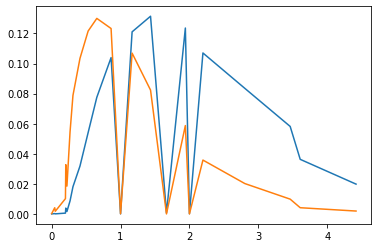

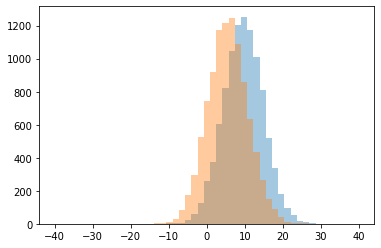

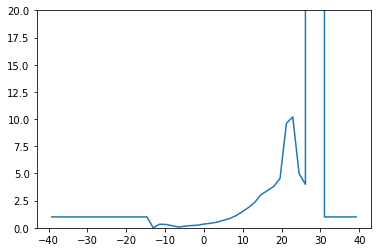

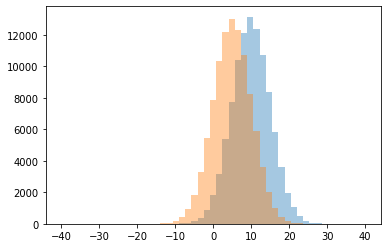

0 0.0
1 0.07228915662650602
2 0.14942528735632185
3 0.1875
4 0.2108843537414966
5 0.23518164435946462
6 0.3076923076923077
7 0.3333333333333333
8 0.34496644295302015
9 0.4102285092491839
10 0.5140664961636828
11 0.6787479406919276
12 0.8425702811244979
13 1.0
14 1.1017415215398716
15 1.4649532710280373
16 1.8578199052132702
17 2.334101382488479
18 3.049056603773585
19 3.414473684210526
20 3.8068181818181817
21 4.0
22 4.55
23 5.0
24 9.6
25 10.2
26 999999.0




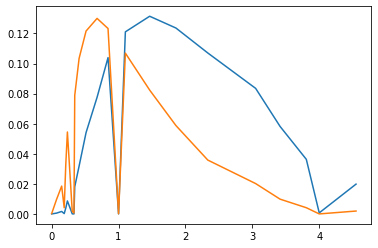

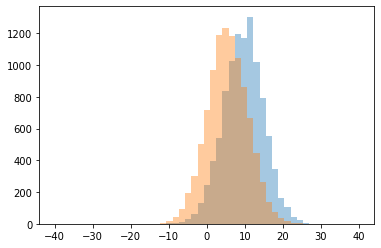

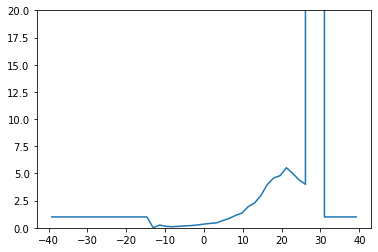

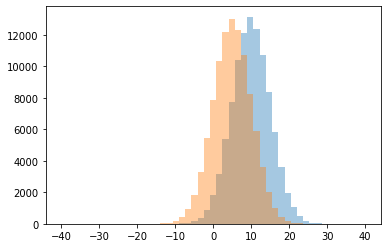

0 0.0
1 0.0975609756097561
2 0.13333333333333333
3 0.13829787234042554
4 0.17277486910994763
5 0.20860927152317882
6 0.25
7 0.2613861386138614
8 0.34265734265734266
9 0.40515463917525774
10 0.45492839090143217
11 0.6793831168831169
12 0.8655959425190194
13 1.0
14 1.1447746883988494
15 1.3612078977932636
16 1.9550224887556222
17 2.295045045045045
18 2.992424242424242
19 3.985611510791367
20 4.0
21 4.4
22 4.586666666666667
23 4.794117647058823
24 5.0
25 5.526315789473684
26 999999.0




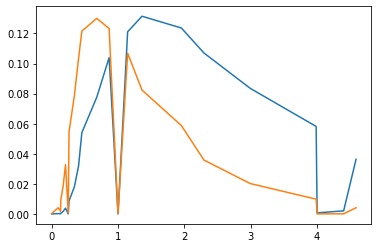

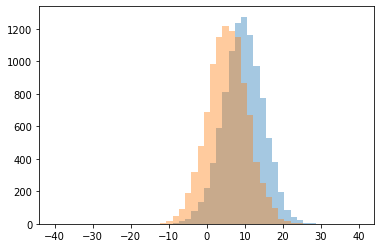

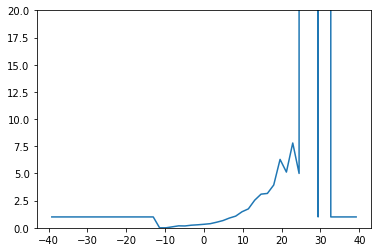

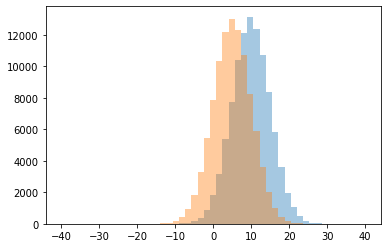

0 0.0
1 0.08888888888888889
2 0.1693121693121693
3 0.1797752808988764
4 0.2389937106918239
5 0.27615062761506276
6 0.32365747460087085
7 0.38022426095820594
8 0.5139130434782608
9 0.6661184210526315
10 0.8954468802698144
11 1.0
12 1.0729166666666667
13 1.4756944444444444
14 1.7406296851574212
15 2.5392670157068062
16 3.095617529880478
17 3.1607142857142856
18 3.9375
19 5.0
20 5.125
21 6.290322580645161
22 7.8
23 999999.0




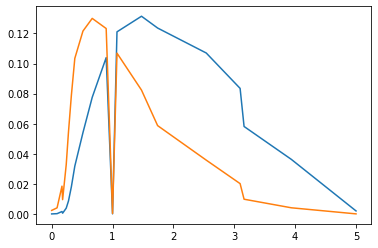

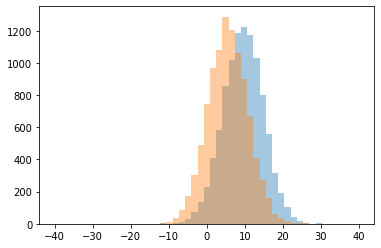

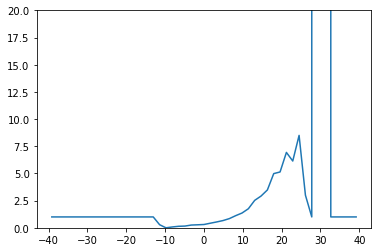

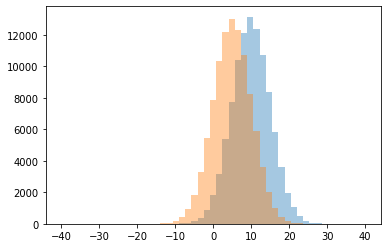

0 0.0
1 0.07692307692307693
2 0.13793103448275862
3 0.1588235294117647
4 0.25249169435215946
5 0.2766393442622951
6 0.2857142857142857
7 0.30335570469798656
8 0.4216494845360825
9 0.5378228782287823
10 0.6653726708074534
11 0.8446843853820598
12 1.0
13 1.1157102539981185
14 1.3588888888888888
15 1.752608047690015
16 2.5245098039215685
17 2.92
18 3.0
19 3.48125
20 4.984126984126984
21 5.135135135135135
22 6.142857142857143
23 6.933333333333334
24 8.5
25 999999.0




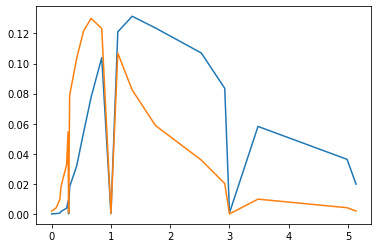

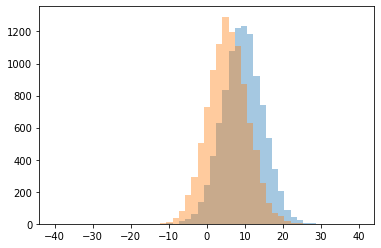

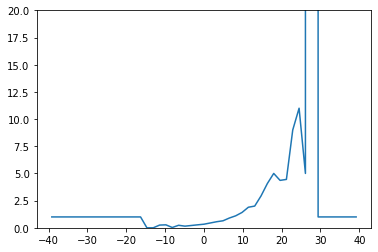

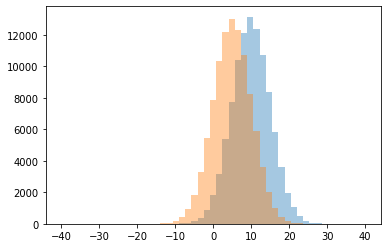

0 0.0
1 0.02857142857142857
2 0.15168539325842698
3 0.21232876712328766
4 0.23170731707317074
5 0.25
6 0.2727272727272727
7 0.27345309381237526
8 0.33104395604395603
9 0.44375
10 0.5584299732381802
11 0.6447368421052632
12 0.8981636060100167
13 1.0
14 1.1018018018018019
15 1.411697247706422
16 1.8913738019169328
17 1.9978260869565216
18 2.932806324110672
19 4.075757575757576
20 4.361702127659575
21 4.45
22 5.0
23 9.0
24 11.0
25 999999.0




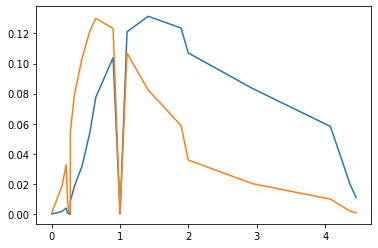

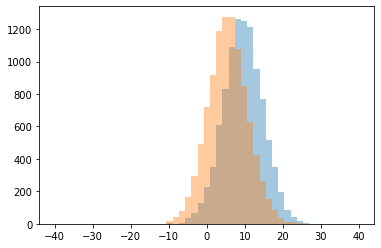

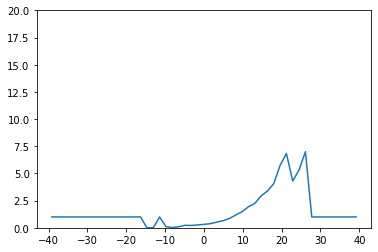

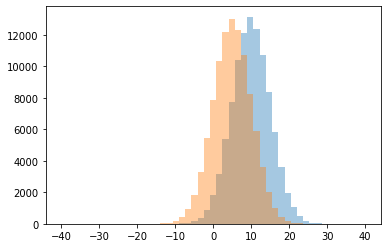

0 0.0
1 0.023255813953488372
2 0.09210526315789473
3 0.10526315789473684
4 0.21621621621621623
5 0.2289156626506024
6 0.2653061224489796
7 0.3138075313807531
8 0.3812636165577342
9 0.515177065767285
10 0.6525157232704403
11 0.8518808777429467
12 1.0
13 1.175977653631285
14 1.4728773584905661
15 1.9314194577352473
16 2.2347417840375585
17 2.920152091254753
18 3.3815789473684212
19 4.057471264367816
20 4.3
21 5.333333333333333
22 5.735294117647059
23 6.833333333333333
24 7.0




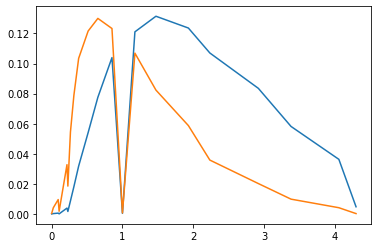

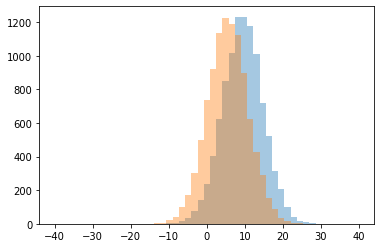

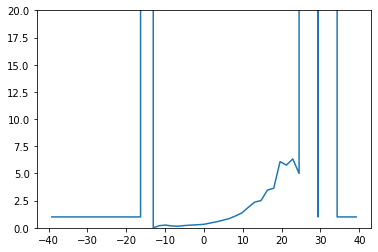

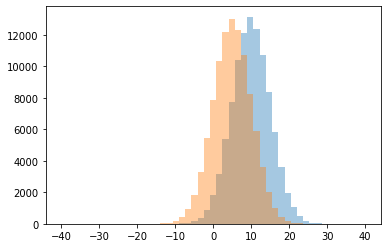

0 0.0
1 0.14705882352941177
2 0.15789473684210525
3 0.2
4 0.21176470588235294
5 0.25
6 0.2796780684104628
7 0.32157394843962006
8 0.44069640914036995
9 0.5520282186948854
10 0.6951915240423798
11 0.8536585365853658
12 1.0
13 1.0970614425645593
14 1.3761160714285714
15 1.8860353130016052
16 2.3613053613053614
17 2.5069444444444446
18 3.4635761589403975
19 3.63953488372093
20 5.0
21 5.764705882352941
22 6.088235294117647
23 6.333333333333333
24 999999.0




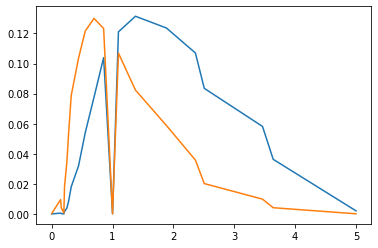

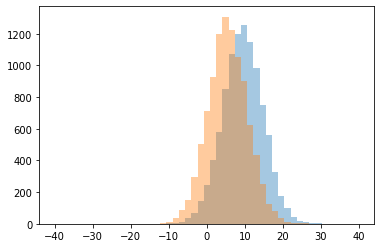

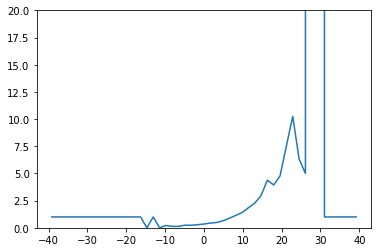

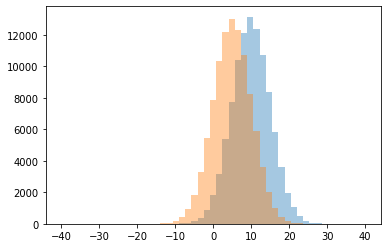

0 0.0
1 0.13157894736842105
2 0.13333333333333333
3 0.21428571428571427
4 0.2356902356902357
5 0.24
6 0.28542914171656686
7 0.34691011235955055
8 0.43379978471474706
9 0.48497495826377296
10 0.6490825688073395
11 0.8771498771498771
12 1.0
13 1.1406844106463878
14 1.3913525498891353
15 1.8429487179487178
16 2.2591743119266057
17 2.9683794466403164
18 3.9397590361445785
19 4.375
20 4.783783783783784
21 5.0
22 6.333333333333333
23 7.538461538461538
24 10.25
25 999999.0




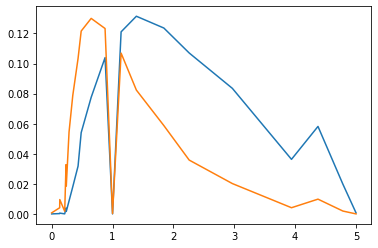

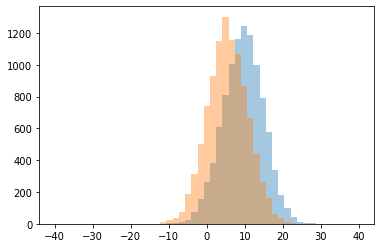

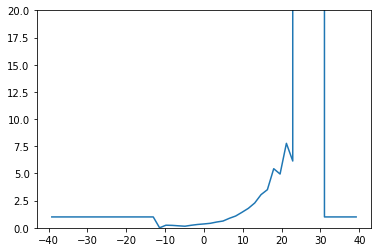

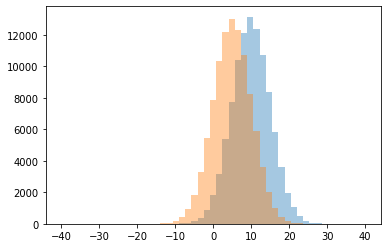

0 0.0
1 0.14516129032258066
2 0.18181818181818182
3 0.2222222222222222
4 0.23397435897435898
5 0.23809523809523808
6 0.306
7 0.3549257759784076
8 0.41353383458646614
9 0.5304878048780488
10 0.6221198156682027
11 0.8726169844020797
12 1.0
13 1.0841908325537886
14 1.428078250863061
15 1.7906626506024097
16 2.280821917808219
17 3.05
18 3.5060975609756095
19 4.945945945945946
20 5.435483870967742
21 6.142857142857143
22 7.769230769230769
23 999999.0




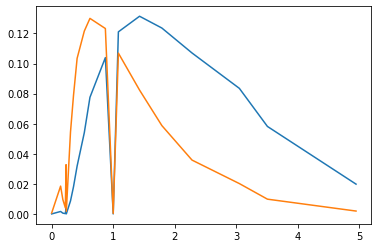

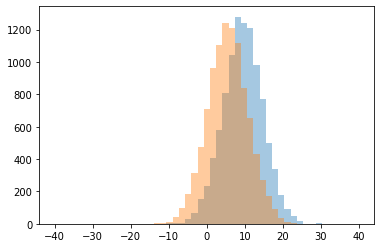

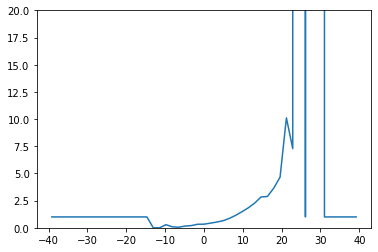

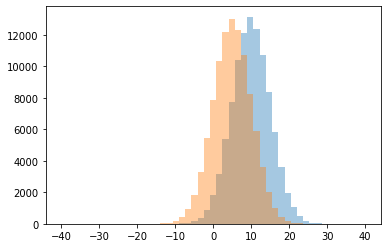

0 0.0
1 0.05
2 0.09090909090909091
3 0.15934065934065933
4 0.20317460317460317
5 0.2857142857142857
6 0.3263157894736842
7 0.33146067415730335
8 0.42604166666666665
9 0.5248868778280543
10 0.6494762288477035
11 0.8650662251655629
12 1.0
13 1.147982062780269
14 1.4797619047619048
15 1.8414634146341464
16 2.275462962962963
17 2.8345588235294117
18 2.8793103448275863
19 3.6451612903225805
20 4.657894736842105
21 7.285714285714286
22 10.11111111111111
23 999999.0




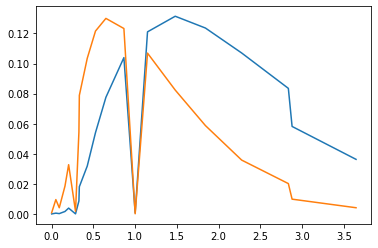

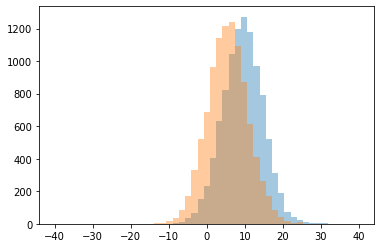

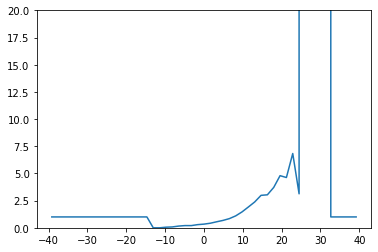

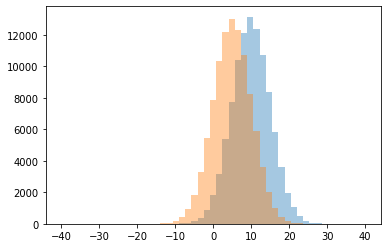

0 0.0
1 0.05555555555555555
2 0.07894736842105263
3 0.15853658536585366
4 0.20241691842900303
5 0.20348837209302326
6 0.2903846153846154
7 0.3381712626995646
8 0.42028985507246375
9 0.5538057742782152
10 0.6795716639209226
11 0.8428686543110395
12 1.0
13 1.0960658737419946
14 1.4615384615384615
15 1.9138211382113821
16 2.3765281173594133
17 2.9849624060150375
18 3.0350877192982457
19 3.125
20 3.7142857142857144
21 4.625
22 4.794871794871795
23 6.833333333333333
24 999999.0




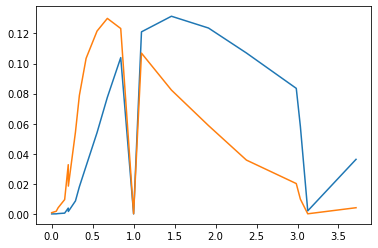

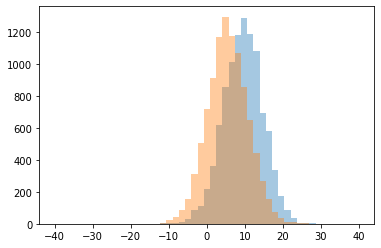

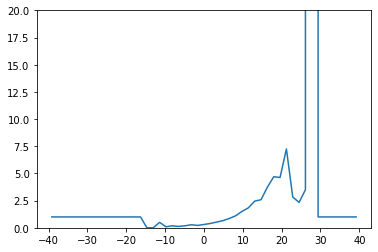

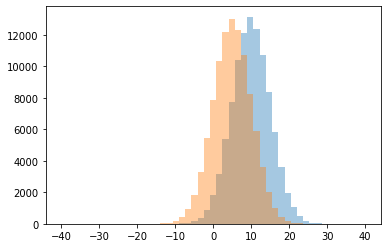

0 0.0
1 0.09523809523809523
2 0.12790697674418605
3 0.18181818181818182
4 0.18471337579617833
5 0.21936758893280633
6 0.27936507936507937
7 0.3047091412742382
8 0.39847161572052403
9 0.5
10 0.5255972696245734
11 0.6607555898226677
12 0.8600508905852418
13 1.0
14 1.106641721234799
15 1.505827505827506
16 1.8377125193199382
17 2.3333333333333335
18 2.4547511312217196
19 2.582089552238806
20 2.8333333333333335
21 3.5
22 3.7371794871794872
23 4.631578947368421
24 4.694444444444445
25 7.25
26 999999.0




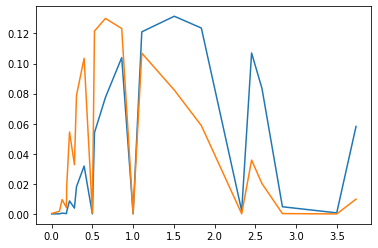

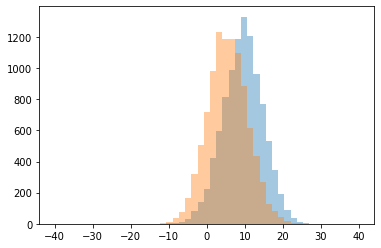

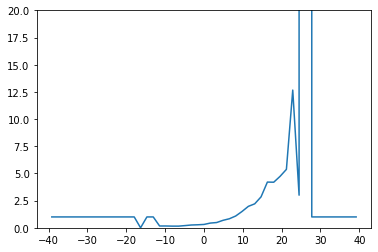

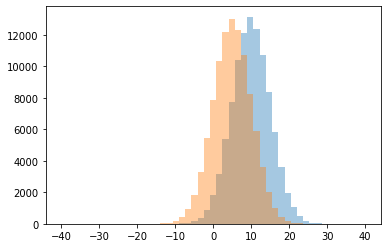

0 0.0
1 0.15384615384615385
2 0.16666666666666666
3 0.20245398773006135
4 0.25705329153605017
5 0.2777777777777778
6 0.308659217877095
7 0.4341164453524004
8 0.48457792207792205
9 0.6869198312236287
10 0.8308080808080808
11 1.0
12 1.0838650865998176
13 1.5011286681715577
14 1.9722675367047309
15 2.203661327231121
16 2.8450184501845017
17 3.0
18 4.192771084337349
19 4.2047244094488185
20 4.7317073170731705
21 5.375
22 12.666666666666666
23 999999.0




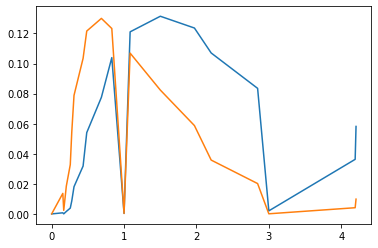

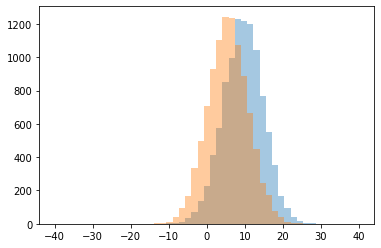

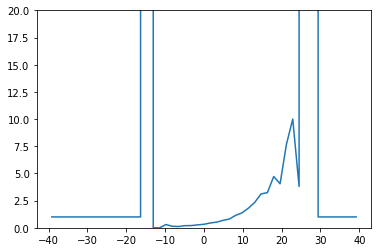

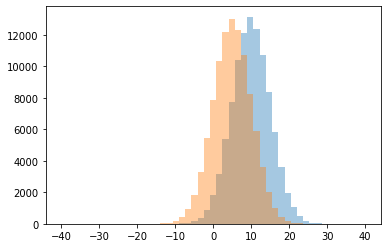

0 0.0
1 0.11956521739130435
2 0.13953488372093023
3 0.19642857142857142
4 0.20474777448071216
5 0.2685370741482966
6 0.3
7 0.3234463276836158
8 0.443010752688172
9 0.5213055303717135
10 0.6838294448913917
11 0.8042071197411004
12 1.0
13 1.1444547996272134
14 1.3751412429378531
15 1.8033033033033032
16 2.3340807174887894
17 3.113821138211382
18 3.2339181286549707
19 3.8
20 4.048780487804878
21 4.72
22 7.666666666666667
23 10.0
24 999999.0




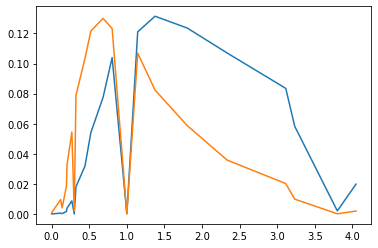

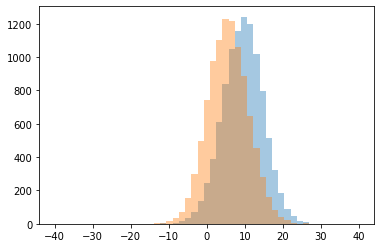

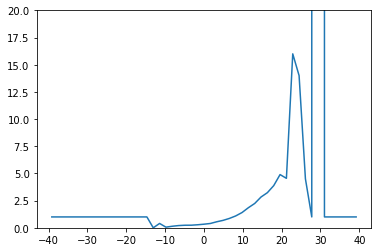

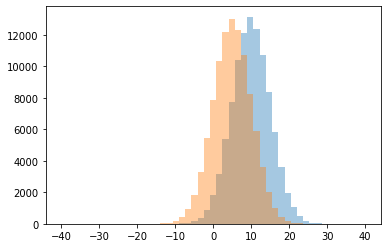

0 0.0
1 0.058823529411764705
2 0.14285714285714285
3 0.2054794520547945
4 0.2356687898089172
5 0.23920265780730898
6 0.2791164658634538
7 0.33198924731182794
8 0.3967280163599182
9 0.4
10 0.552536231884058
11 0.6818551668022783
12 0.859721082854799
13 1.0
14 1.0907372400756143
15 1.4033898305084747
16 1.847457627118644
17 2.237885462555066
18 2.8333333333333335
19 3.23125
20 3.8795180722891565
21 4.5
22 4.55
23 4.894736842105263
24 14.0
25 16.0
26 999999.0




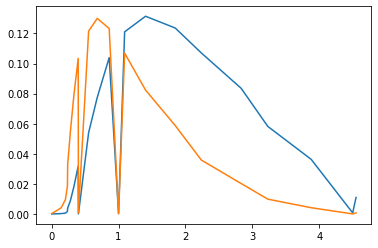

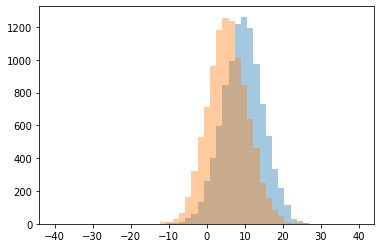

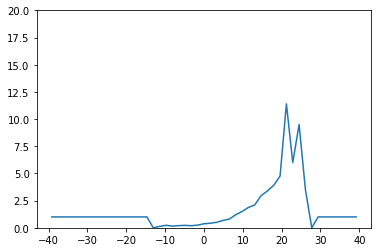

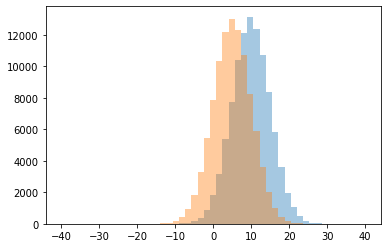

0 0.0
1 0.125
2 0.16129032258064516
3 0.19003115264797507
4 0.19696969696969696
5 0.22424242424242424
6 0.23076923076923078
7 0.24763705103969755
8 0.36923076923076925
9 0.4197916666666667
10 0.5046570702794242
11 0.6746411483253588
12 0.8016194331983806
13 1.0
14 1.2047477744807122
15 1.4929078014184398
16 1.8703125
17 2.1010752688172043
18 2.9516129032258065
19 3.3836477987421385
20 3.5
21 3.9069767441860463
22 4.760869565217392
23 6.0
24 9.5
25 11.4




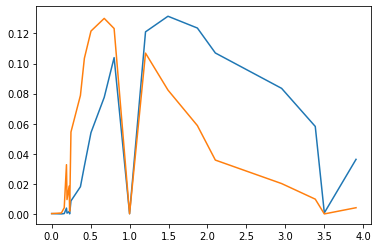

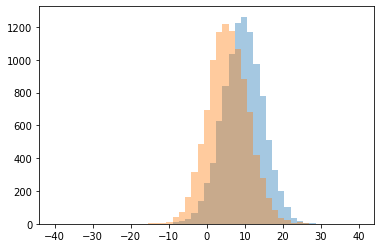

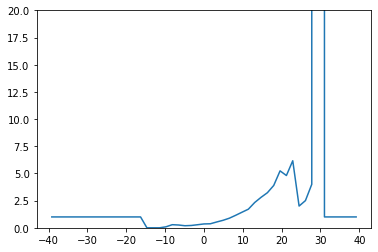

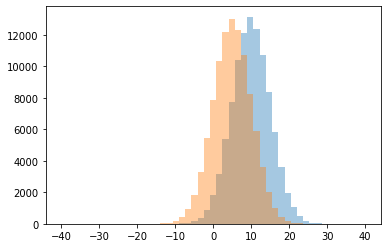

0 0.0
1 0.09090909090909091
2 0.1901840490797546
3 0.21405750798722045
4 0.25675675675675674
5 0.2830578512396694
6 0.2857142857142857
7 0.354978354978355
8 0.37037037037037035
9 0.5342465753424658
10 0.6880131362889984
11 0.8824531516183987
12 1.0
13 1.150375939849624
14 1.4335981838819523
15 1.7119883040935673
16 2.0
17 2.3269689737470167
18 2.5
19 2.802158273381295
20 3.2264150943396226
21 3.8941176470588235
22 4.0
23 4.809523809523809
24 5.2368421052631575
25 6.166666666666667
26 999999.0




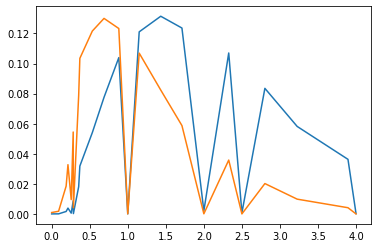

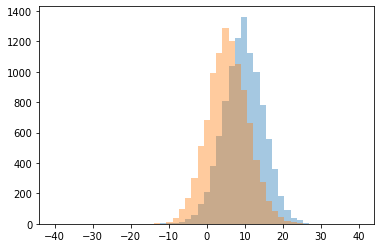

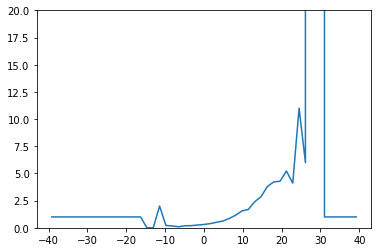

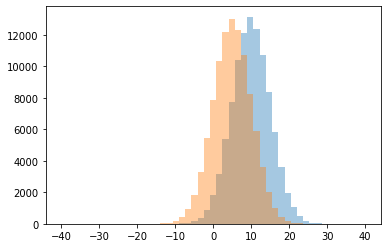

0 0.0
1 0.09473684210526316
2 0.16666666666666666
3 0.1893491124260355
4 0.19798657718120805
5 0.21428571428571427
6 0.2563600782778865
7 0.3064516129032258
8 0.38585858585858585
9 0.5111111111111111
10 0.6280155642023346
11 0.8603491271820449
12 1.0
13 1.160952380952381
14 1.55125284738041
15 1.6953242835595776
16 2.0
17 2.3980815347721824
18 2.8644688644688645
19 3.802721088435374
20 4.111111111111111
21 4.22093023255814
22 4.285714285714286
23 5.222222222222222
24 6.0
25 11.0
26 999999.0




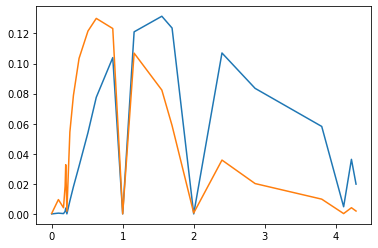

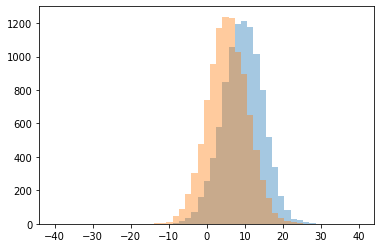

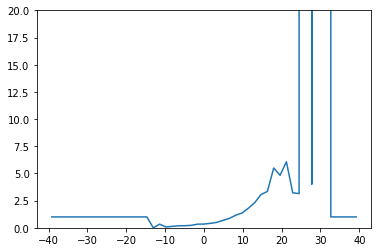

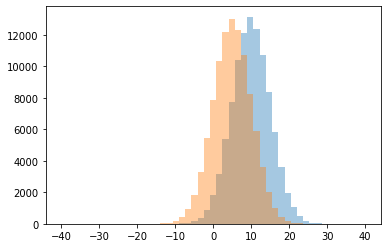

0 0.0
1 0.07692307692307693
2 0.13333333333333333
3 0.18604651162790697
4 0.19318181818181818
5 0.22697368421052633
6 0.3333333333333333
7 0.33473684210526317
8 0.34324324324324323
9 0.4112734864300626
10 0.4940068493150685
11 0.684168012924071
12 0.8609756097560975
13 1.0
14 1.158252427184466
15 1.3579418344519016
16 1.800918836140888
17 2.3136363636363635
18 3.0613026819923372
19 3.142857142857143
20 3.2222222222222223
21 3.3483870967741933
22 4.0
23 4.828571428571428
24 5.5
25 6.071428571428571
26 999999.0




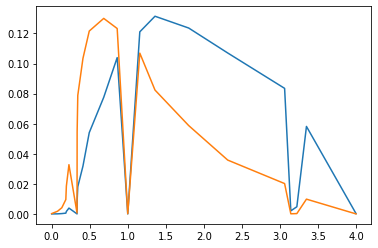

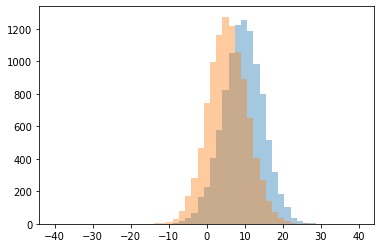

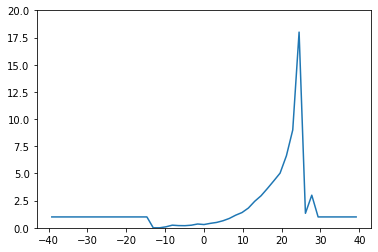

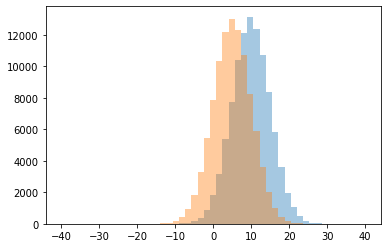

0 0.0
1 0.09090909090909091
2 0.19540229885057472
3 0.20253164556962025
4 0.23859649122807017
5 0.2413793103448276
6 0.3002680965147453
7 0.34913793103448276
8 0.4084507042253521
9 0.4948453608247423
10 0.647843137254902
11 0.8613617719442166
12 1.0
13 1.1609848484848484
14 1.3333333333333333
15 1.4035874439461884
16 1.8159509202453987
17 2.436724565756824
18 2.9448529411764706
19 3.0
20 3.612676056338028
21 4.3108108108108105
22 5.027027027027027
23 6.625
24 9.0
25 18.0




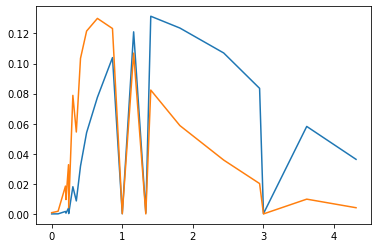

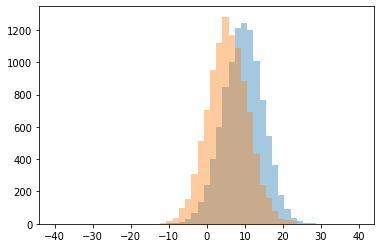

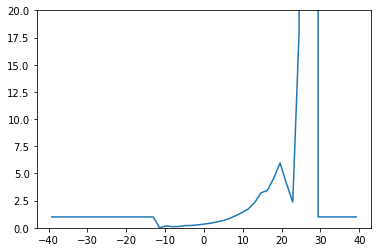

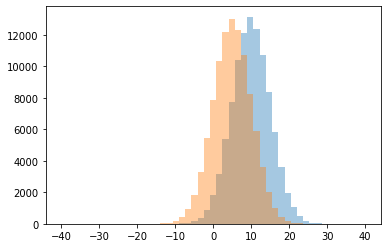

0 0.0
1 0.10526315789473684
2 0.11578947368421053
3 0.17647058823529413
4 0.20394736842105263
5 0.21359223300970873
6 0.267578125
7 0.3375886524822695
8 0.4206098843322818
9 0.5344057193923145
10 0.6606864274570983
11 0.8556789069171649
12 1.0
13 1.1111111111111112
14 1.4002254791431792
15 1.7405797101449276
16 2.323325635103926
17 2.375
18 3.2184873949579833
19 3.4367088607594938
20 4.090909090909091
21 4.569620253164557
22 5.966666666666667
23 18.0
24 999999.0




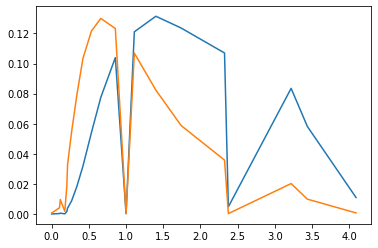

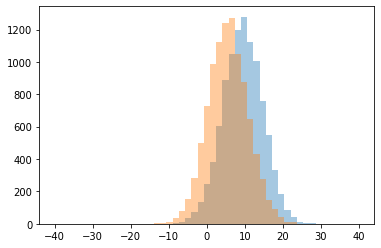

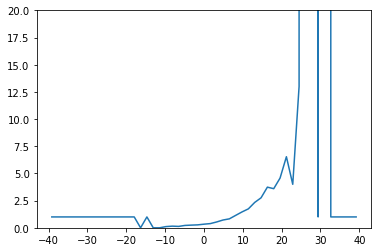

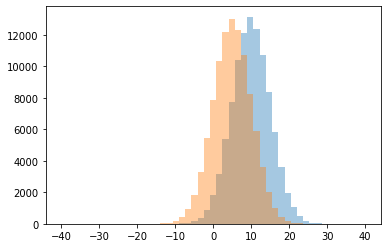

0 0.0
1 0.1111111111111111
2 0.1282051282051282
3 0.15151515151515152
4 0.21794871794871795
5 0.24647887323943662
6 0.26961770623742454
7 0.33287671232876714
8 0.3866396761133603
9 0.5364768683274022
10 0.715670436187399
11 0.8224666142969363
12 1.0
13 1.1429933269780743
14 1.4600456621004567
15 1.7410852713178295
16 2.3333333333333335
17 2.7572463768115942
18 3.597826086956522
19 3.73972602739726
20 4.0
21 4.575
22 6.538461538461538
23 13.0
24 999999.0




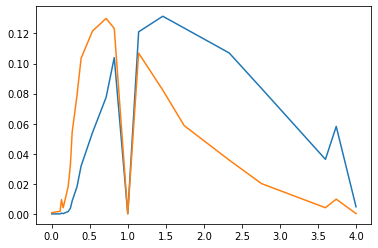

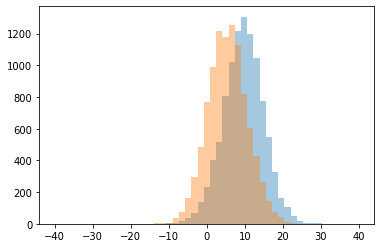

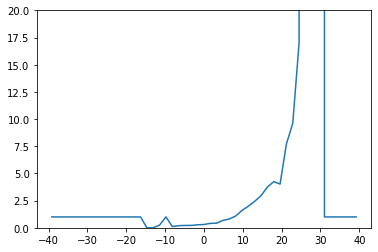

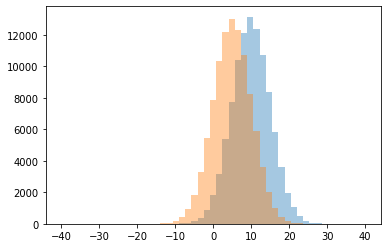

0 0.0
1 0.11764705882352941
2 0.19480519480519481
3 0.21739130434782608
4 0.21885521885521886
5 0.25
6 0.27720739219712526
7 0.30378096479791394
8 0.40524193548387094
9 0.42411812961443807
10 0.6822033898305084
11 0.8111553784860558
12 1.0
13 1.0817777777777777
14 1.6004901960784315
15 1.9850993377483444
16 2.4348837209302325
17 2.9580152671755724
18 3.73972602739726
19 4.024390243902439
20 4.246753246753247
21 7.714285714285714
22 9.6
23 17.0
24 999999.0




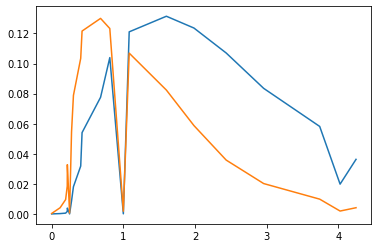

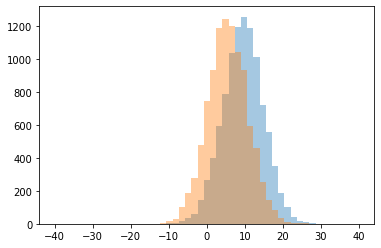

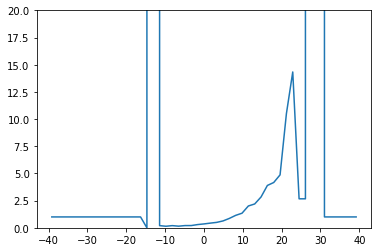

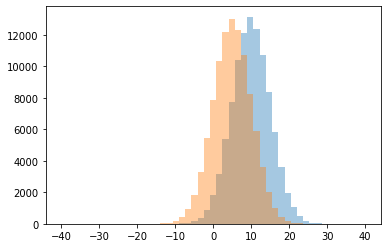

0 0.0
1 0.14285714285714285
2 0.15
3 0.2
4 0.20430107526881722
5 0.20640569395017794
6 0.2964509394572025
7 0.35656836461126007
8 0.43009605122732125
9 0.4983164983164983
10 0.6311146752205292
11 0.8629568106312292
12 1.0
13 1.144359464627151
14 1.3422174840085288
15 2.006734006734007
16 2.1922246220302375
17 2.6666666666666665
18 2.8346456692913384
19 3.895104895104895
20 4.166666666666667
21 4.868421052631579
22 10.5
23 14.333333333333334
24 999999.0




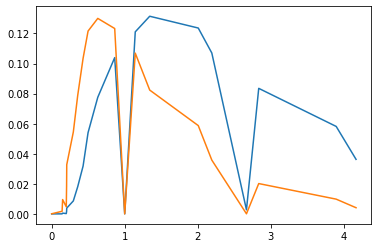

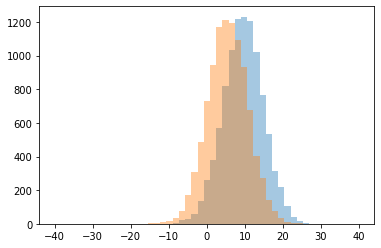

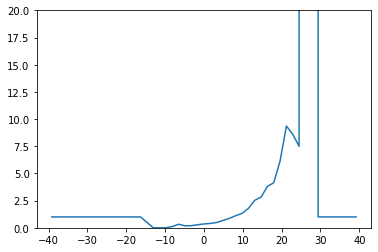

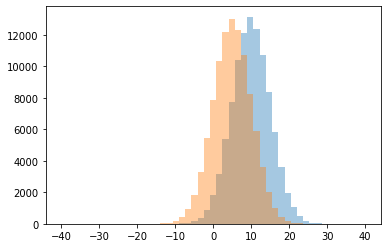

0 0.0
1 0.1111111111111111
2 0.18235294117647058
3 0.19543973941368079
4 0.2804123711340206
5 0.3246753246753247
6 0.35382513661202186
7 0.4029692470837752
8 0.4872013651877133
9 0.5
10 0.6765922249793217
11 0.8649328859060402
12 1.0
13 1.1125343092406221
14 1.3236559139784947
15 1.7787610619469028
16 2.528395061728395
17 2.8198529411764706
18 3.801418439716312
19 4.144736842105263
20 6.138888888888889
21 7.5
22 8.6
23 9.363636363636363
24 999999.0




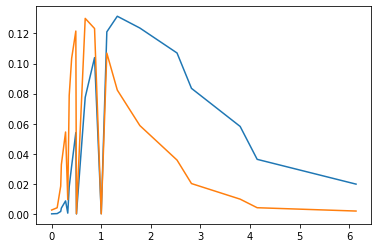

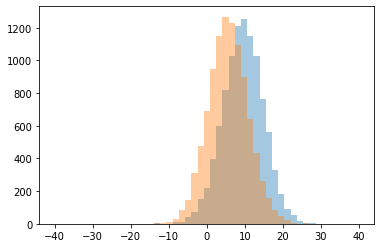

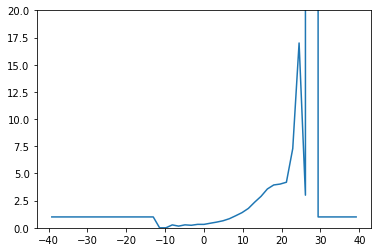

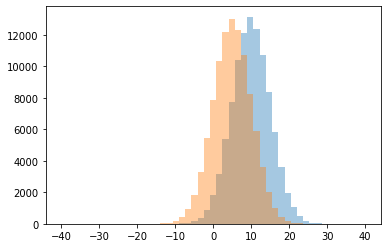

0 0.0
1 0.15476190476190477
2 0.23225806451612904
3 0.26666666666666666
4 0.2708333333333333
5 0.3144927536231884
6 0.31645569620253167
7 0.42133051742344246
8 0.5231037489102005
9 0.6458990536277602
10 0.8350934199837531
11 1.0
12 1.1080586080586081
13 1.395995550611791
14 1.7826086956521738
15 2.360091743119266
16 2.8943396226415095
17 3.0
18 3.573248407643312
19 3.9404761904761907
20 4.021739130434782
21 4.190476190476191
22 7.285714285714286
23 17.0
24 999999.0




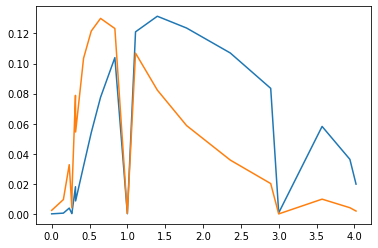

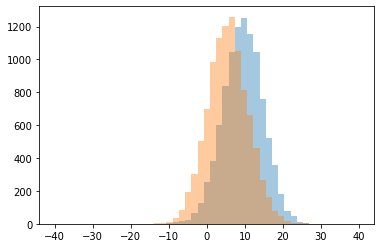

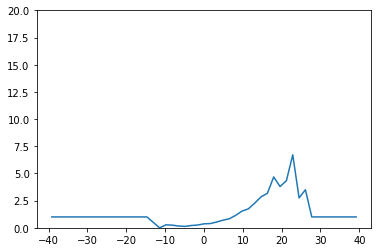

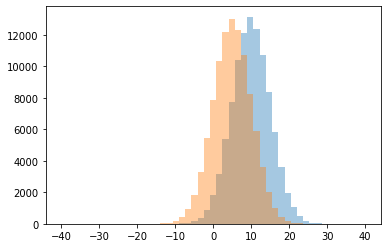

0 0.0
1 0.12886597938144329
2 0.16279069767441862
3 0.2098360655737705
4 0.24324324324324326
5 0.2549407114624506
6 0.2727272727272727
7 0.3649425287356322
8 0.3896236012207528
9 0.5
10 0.53315649867374
11 0.6988352745424293
12 0.8317460317460318
13 1.0
14 1.1429933269780743
15 1.5348837209302326
16 1.742081447963801
17 2.2683982683982684
18 2.75
19 2.843283582089552
20 3.175757575757576
21 3.5
22 3.7916666666666665
23 4.333333333333333
24 4.675324675324675
25 6.714285714285714




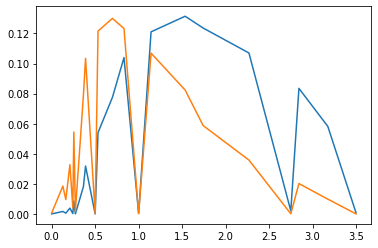

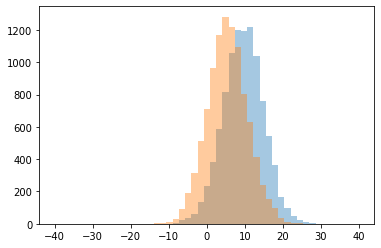

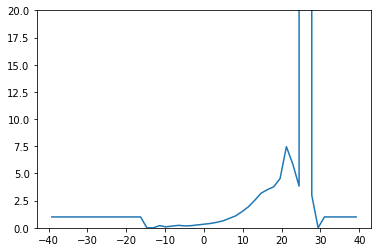

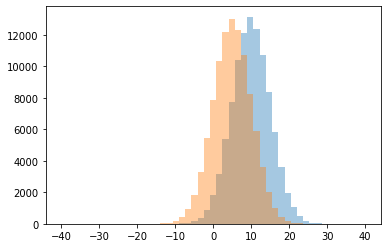

0 0.0
1 0.09090909090909091
2 0.16129032258064516
3 0.17277486910994763
4 0.19745222929936307
5 0.2
6 0.22580645161290322
7 0.26848249027237353
8 0.3290960451977401
9 0.39751552795031053
10 0.5021385799828914
11 0.6388455538221529
12 0.8672131147540983
13 1.0
14 1.097985347985348
15 1.4869240348692403
16 1.9270998415213947
17 2.5266990291262137
18 3.0
19 3.1799163179916317
20 3.509677419354839
21 3.7708333333333335
22 3.8333333333333335
23 4.527777777777778
24 5.875
25 7.461538461538462
26 999999.0




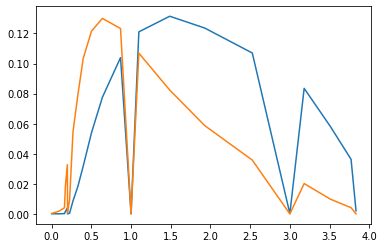

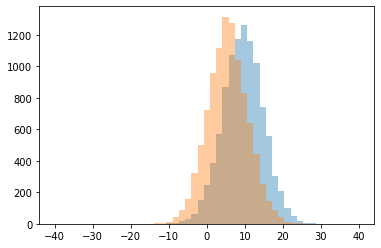

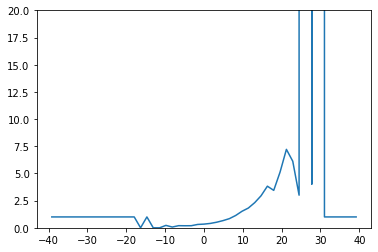

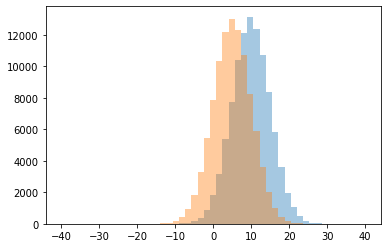

0 0.0
1 0.06976744186046512
2 0.18867924528301888
3 0.19254658385093168
4 0.19540229885057472
5 0.2222222222222222
6 0.30784708249496984
7 0.3388888888888889
8 0.4027196652719665
9 0.5130278526504941
10 0.6605783866057838
11 0.8405341712490181
12 1.0
13 1.133076181292189
14 1.5211097708082026
15 1.8178963893249607
16 2.312925170068027
17 2.9444444444444446
18 3.0
19 3.4431818181818183
20 3.8275862068965516
21 4.0
22 5.125
23 6.125
24 7.214285714285714
25 999999.0




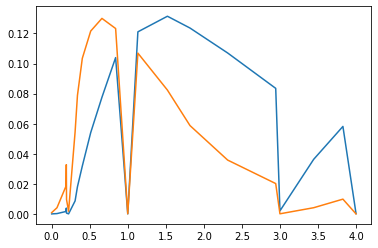

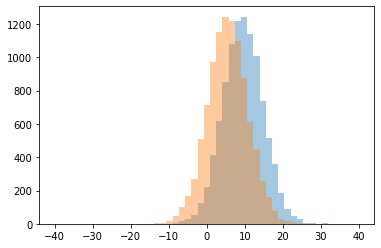

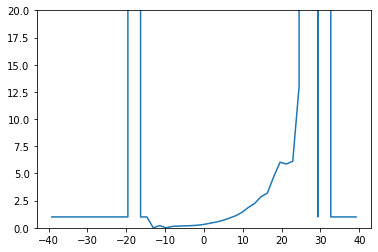

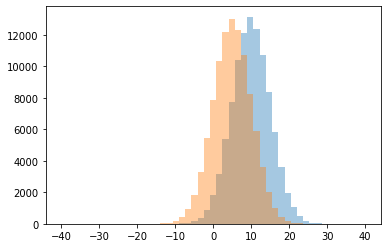

0 0.0
1 0.1276595744680851
2 0.16161616161616163
3 0.17682926829268292
4 0.19852941176470587
5 0.2
6 0.240234375
7 0.31136044880785413
8 0.42489711934156377
9 0.5373913043478261
10 0.6840836012861736
11 0.8875205254515599
12 1.0
13 1.108991825613079
14 1.4200913242009132
15 1.8686371100164203
16 2.247767857142857
17 2.86046511627907
18 3.1925465838509317
19 4.701298701298701
20 5.866666666666666
21 6.032258064516129
22 6.125
23 13.0
24 999999.0




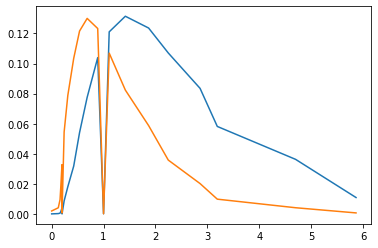

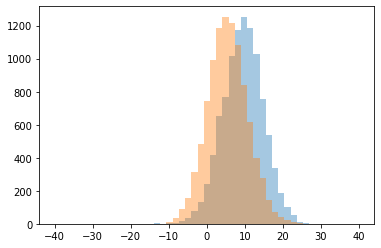

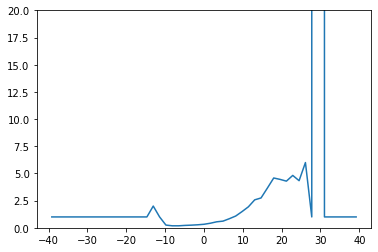

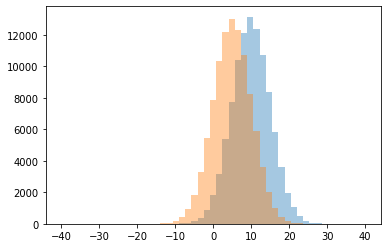

0 0.1839080459770115
1 0.18421052631578946
2 0.22012578616352202
3 0.24358974358974358
4 0.25
5 0.27628865979381445
6 0.3243606998654105
7 0.41951710261569414
8 0.5505902192242833
9 0.6139088729016786
10 0.8360790774299836
11 1.0
12 1.081180811808118
13 1.489311163895487
14 1.9284552845528455
15 2.0
16 2.5714285714285716
17 2.7454545454545456
18 3.6530612244897958
19 4.291666666666667
20 4.333333333333333
21 4.4523809523809526
22 4.581081081081081
23 4.818181818181818
24 6.0
25 999999.0




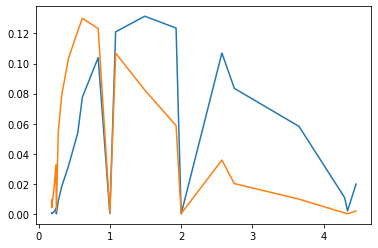

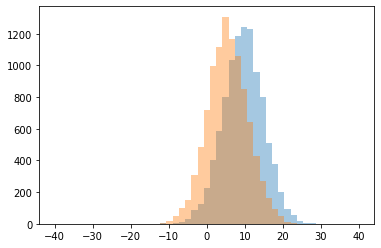

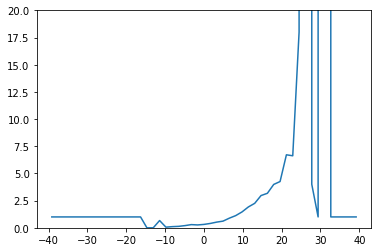

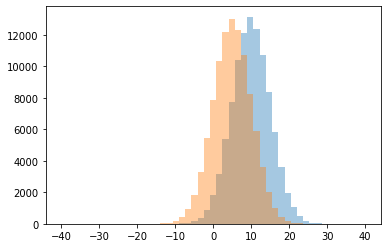

0 0.0
1 0.058823529411764705
2 0.10638297872340426
3 0.1326530612244898
4 0.20134228187919462
5 0.26337448559670784
6 0.2931596091205212
7 0.3120665742024965
8 0.4004004004004004
9 0.5228290062667861
10 0.6131498470948012
11 0.6666666666666666
12 0.8860325621251071
13 1.0
14 1.119698397737983
15 1.4606345475910694
16 1.9174454828660437
17 2.250585480093677
18 2.966542750929368
19 3.1739130434782608
20 3.9893617021276597
21 4.0
22 4.25531914893617
23 6.625
24 6.714285714285714
25 18.0
26 999999.0




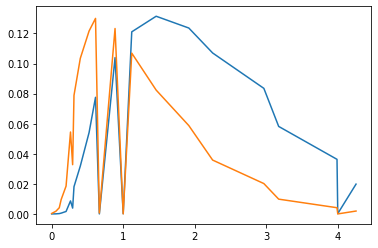

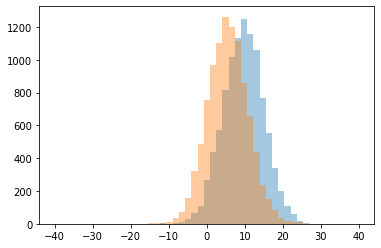

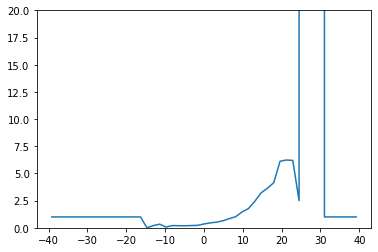

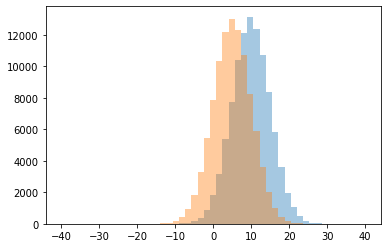

0 0.0
1 0.07142857142857142
2 0.1870967741935484
3 0.1917808219178082
4 0.2
5 0.20588235294117646
6 0.2080745341614907
7 0.2249488752556237
8 0.3333333333333333
9 0.3527080581241744
10 0.4515463917525773
11 0.51952770208901
12 0.6476642913697546
13 0.8452579034941764
14 1.0
15 1.0197663971248876
16 1.4551804423748544
17 1.7606707317073171
18 2.4200913242009134
19 2.5
20 3.209205020920502
21 3.638157894736842
22 4.146341463414634
23 6.121212121212121
24 6.2
25 6.235294117647059
26 999999.0




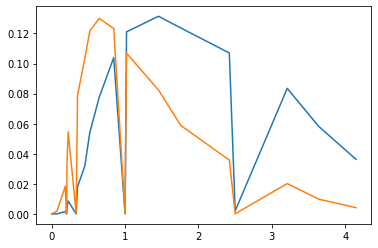

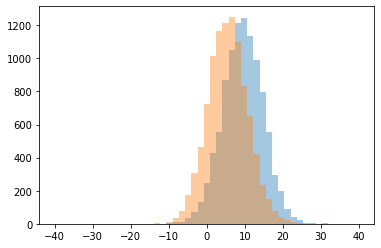

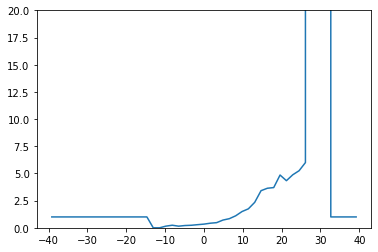

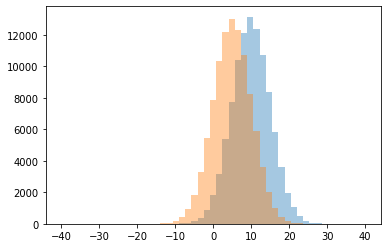

0 0.0
1 0.15
2 0.15384615384615385
3 0.20903954802259886
4 0.23300970873786409
5 0.23684210526315788
6 0.2878787878787879
7 0.338865836791148
8 0.42193675889328064
9 0.47427101200686106
10 0.7124075595727198
11 0.8386581469648562
12 1.0
13 1.103542234332425
14 1.4945978391356542
15 1.7446153846153847
16 2.3404255319148937
17 3.4145299145299144
18 3.638157894736842
19 3.7
20 4.333333333333333
21 4.853658536585366
22 4.875
23 5.25
24 6.0
25 999999.0




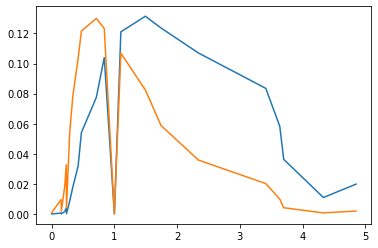

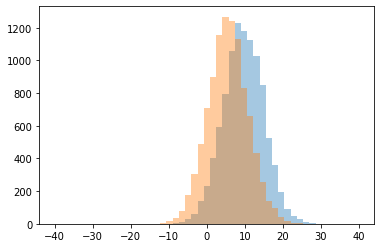

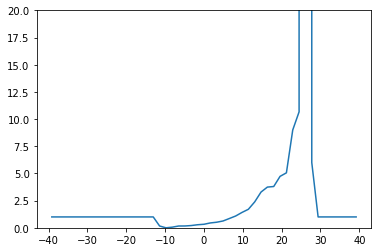

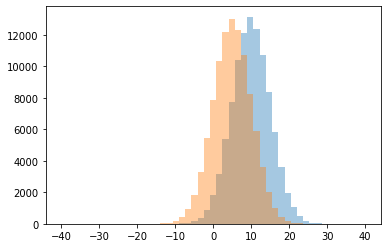

0 0.0
1 0.058823529411764705
2 0.16455696202531644
3 0.16666666666666666
4 0.16759776536312848
5 0.2079207920792079
6 0.2813141683778234
7 0.3248587570621469
8 0.44642857142857145
9 0.5125541125541125
10 0.6261829652996845
11 0.8535800482703138
12 1.0
13 1.0855379188712522
14 1.4148681055155876
15 1.70196671709531
16 2.382830626450116
17 3.2895752895752897
18 3.74468085106383
19 3.797872340425532
20 4.7317073170731705
21 5.055555555555555
22 6.0
23 9.0
24 10.666666666666666
25 999999.0




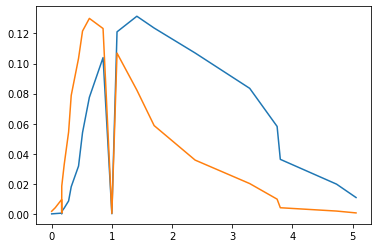

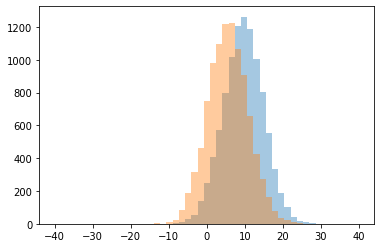

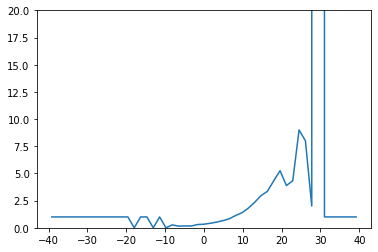

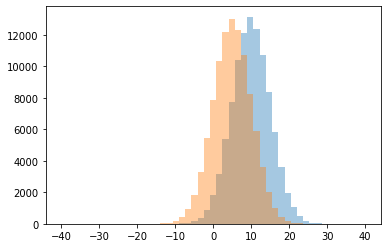

0 0.0
1 0.15294117647058825
2 0.1640378548895899
3 0.17204301075268819
4 0.2692307692307692
5 0.3028322440087146
6 0.32977303070761016
7 0.4169215086646279
8 0.5237659963436929
9 0.6578947368421053
10 0.8315617334423548
11 1.0
12 1.1321462043111528
13 1.3883388338833884
14 1.8109756097560976
15 2.0
16 2.3466042154566744
17 2.96309963099631
18 3.3493975903614457
19 3.8846153846153846
20 4.324675324675325
21 4.333333333333333
22 5.25
23 8.0
24 9.0
25 999999.0




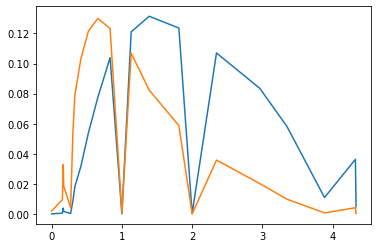

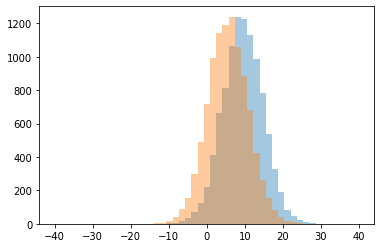

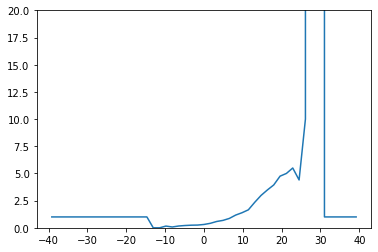

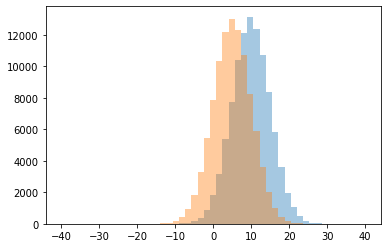

0 0.0
1 0.075
2 0.15789473684210525
3 0.16483516483516483
4 0.21019108280254778
5 0.23986486486486486
6 0.25153374233128833
7 0.3068340306834031
8 0.4120603015075377
9 0.5807017543859649
10 0.6817800167926112
11 0.8617623282134196
12 1.0
13 1.1709159584513693
14 1.3861834654586636
15 1.653958944281525
16 2.342042755344418
17 2.977272727272727
18 3.4805194805194803
19 3.9397590361445785
20 4.4
21 4.75
22 5.0
23 5.5
24 10.0
25 999999.0




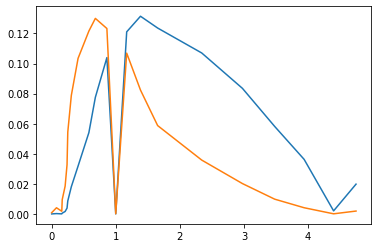

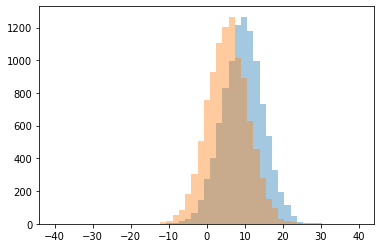

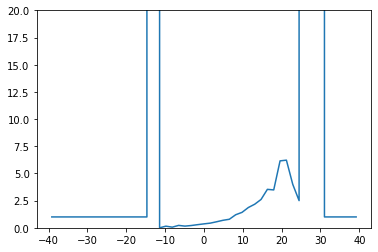

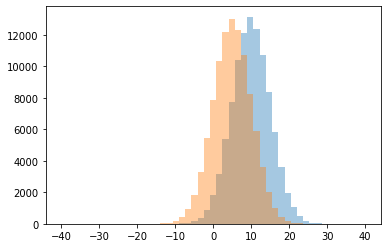

0 0.0
1 0.058823529411764705
2 0.15
3 0.15555555555555556
4 0.21052631578947367
5 0.22093023255813954
6 0.2885375494071146
7 0.3615894039735099
8 0.4296455424274973
9 0.5560578661844484
10 0.6907730673316709
11 0.7851500789889415
12 1.0
13 1.2003948667324777
14 1.4195725534308212
15 1.8666666666666667
16 2.168122270742358
17 2.5
18 2.606382978723404
19 3.4842105263157896
20 3.5364238410596025
21 4.0
22 6.15625
23 6.222222222222222
24 999999.0




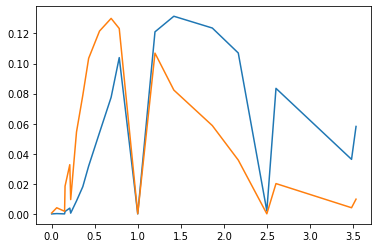

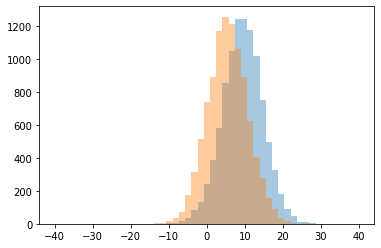

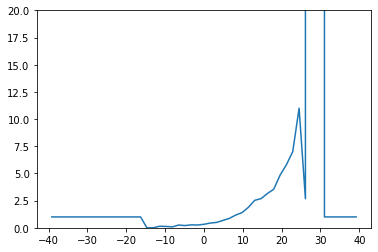

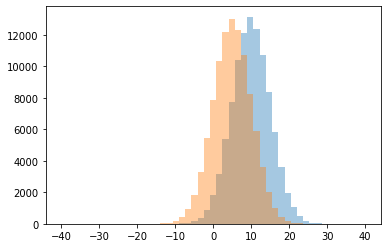

0 0.0
1 0.08333333333333333
2 0.125
3 0.14285714285714285
4 0.2057142857142857
5 0.2535211267605634
6 0.25675675675675674
7 0.2692307692307692
8 0.3234100135317997
9 0.43575418994413406
10 0.4974402730375427
11 0.6783161239078633
12 0.8635990139687757
13 1.0
14 1.170433145009416
15 1.3961840628507296
16 1.8803827751196172
17 2.525925925925926
18 2.6666666666666665
19 2.683274021352313
20 3.1528662420382165
21 3.5483870967741935
22 4.837837837837838
23 5.8
24 7.0
25 11.0
26 999999.0




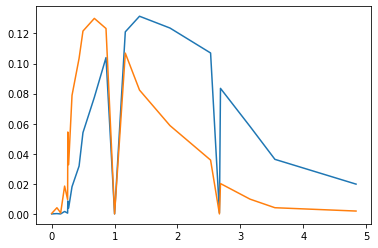

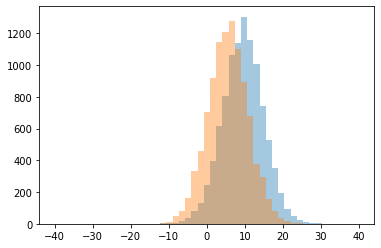

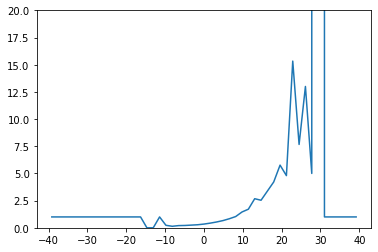

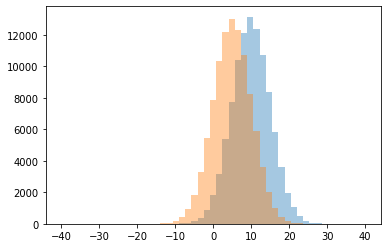

0 0.0
1 0.14
2 0.20253164556962025
3 0.2147239263803681
4 0.23076923076923078
5 0.2469879518072289
6 0.28043478260869564
7 0.3432624113475177
8 0.43028322440087147
9 0.5357766143106457
10 0.664185277088503
11 0.8330721003134797
12 1.0
13 1.0344514959202176
14 1.4553571428571428
15 1.7100591715976332
16 2.5342465753424657
17 2.675531914893617
18 3.375796178343949
19 4.216867469879518
20 4.8
21 5.0
22 5.764705882352941
23 7.666666666666667
24 13.0
25 15.333333333333334
26 999999.0




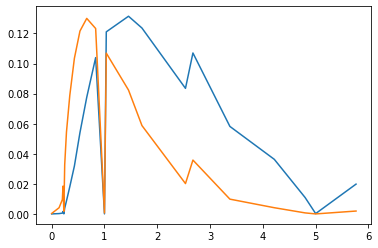

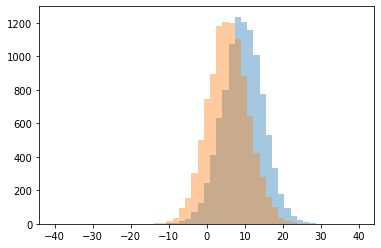

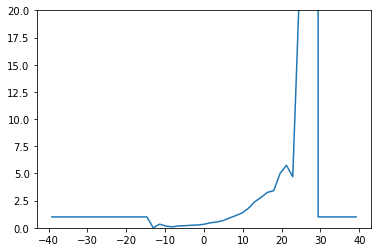

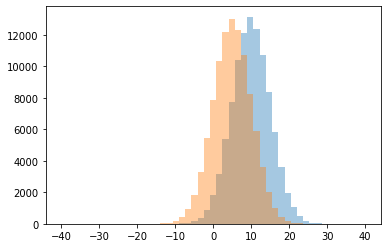

0 0.0
1 0.08823529411764706
2 0.15789473684210525
3 0.17204301075268819
4 0.19230769230769232
5 0.23432343234323433
6 0.25149700598802394
7 0.32707774798927614
8 0.3333333333333333
9 0.45707915273132665
10 0.5320945945945946
11 0.6605960264900662
12 0.8974145120934112
13 1.0
14 1.1194570135746607
15 1.3608597285067874
16 1.7906976744186047
17 2.3966745843230406
18 2.7906137184115525
19 3.259259259259259
20 3.4183673469387754
21 4.7
22 5.0
23 5.75
24 21.0
25 999999.0




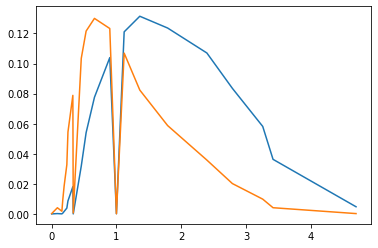

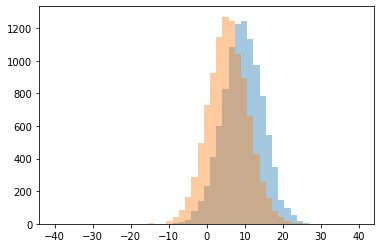

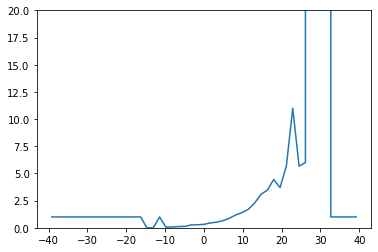

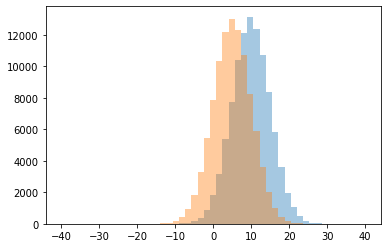

0 0.0
1 0.05555555555555555
2 0.07317073170731707
3 0.11494252873563218
4 0.12883435582822086
5 0.2655172413793103
6 0.2787878787878788
7 0.31830601092896177
8 0.4449244060475162
9 0.5226876090750436
10 0.6530291109362707
11 0.8743961352657005
12 1.0
13 1.1775431861804222
14 1.3921787709497206
15 1.7063253012048192
16 2.2833723653395785
17 3.0862745098039217
18 3.464968152866242
19 3.7
20 4.443037974683544
21 5.666666666666667
22 5.705882352941177
23 6.0
24 11.0
25 999999.0




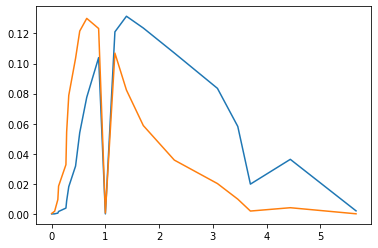

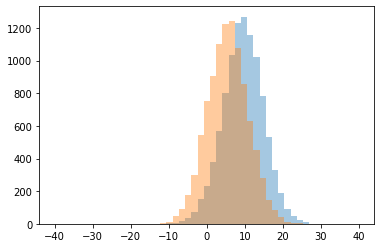

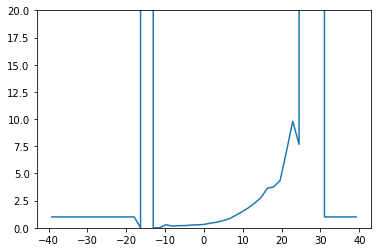

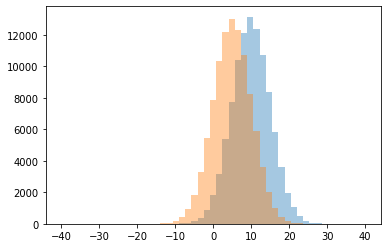

0 0.0
1 0.15217391304347827
2 0.2
3 0.2011173184357542
4 0.2516778523489933
5 0.27472527472527475
6 0.2857142857142857
7 0.30851063829787234
8 0.42099447513812155
9 0.5181818181818182
10 0.6552287581699346
11 0.8323932312651088
12 1.0
13 1.1428571428571428
14 1.4772991850989523
15 1.836248012718601
16 2.272727272727273
17 2.7872340425531914
18 3.636986301369863
19 3.7701149425287355
20 4.340909090909091
21 7.0
22 7.666666666666667
23 9.8
24 999999.0




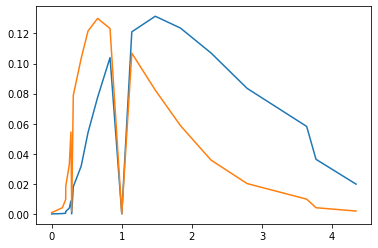

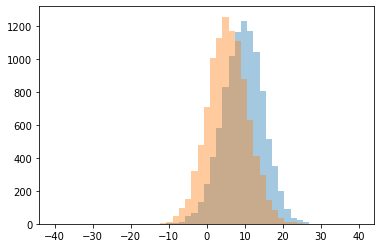

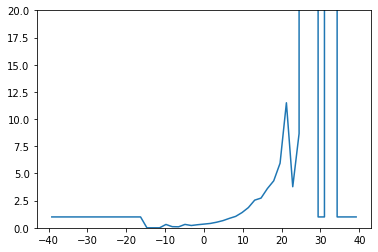

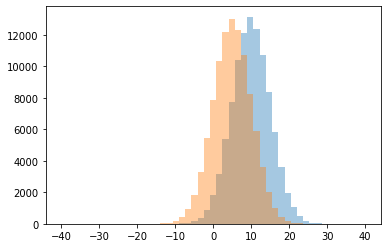

0 0.0
1 0.09090909090909091
2 0.10416666666666667
3 0.2118380062305296
4 0.28361344537815125
5 0.3076923076923077
6 0.31125827814569534
7 0.34129213483146065
8 0.4009950248756219
9 0.5141592920353982
10 0.6613672496025437
11 0.8670076726342711
12 1.0
13 1.0503597122302157
14 1.4006810442678774
15 1.8587301587301588
16 2.5439024390243903
17 2.733108108108108
18 3.6083916083916083
19 3.7777777777777777
20 4.320987654320987
21 5.9411764705882355
22 8.666666666666666
23 11.5
24 999999.0




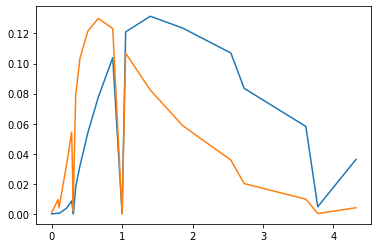

on f= 0.13793103448275862


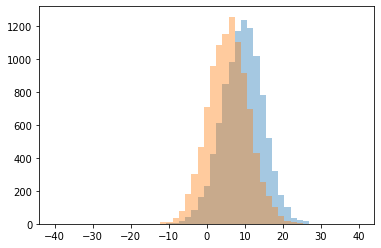

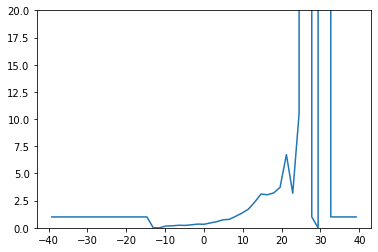

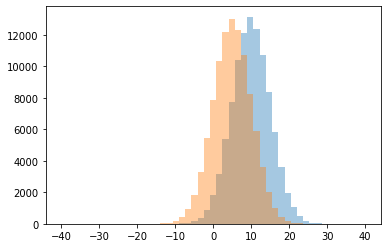

0 0.0
1 0.16666666666666666
2 0.18181818181818182
3 0.22099447513812154
4 0.23376623376623376
5 0.2730263157894737
6 0.3234463276836158
7 0.3418803418803419
8 0.44467640918580376
9 0.5625
10 0.7344290657439446
11 0.7799841143764893
12 1.0
13 1.0577617328519855
14 1.3555798687089715
15 1.7136690647482014
16 2.3674418604651164
17 3.0409356725146197
18 3.1031746031746033
19 3.1818181818181817
20 3.207920792079208
21 3.723404255319149
22 6.733333333333333
23 10.5
24 999999.0




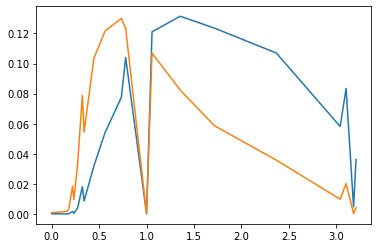

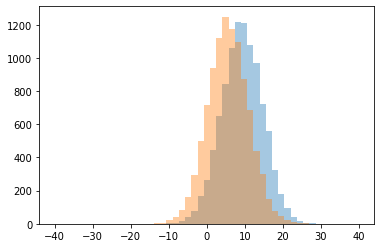

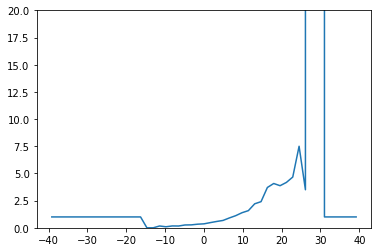

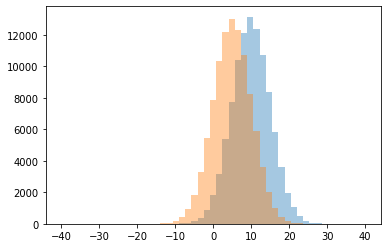

0 0.0
1 0.09523809523809523
2 0.16470588235294117
3 0.16666666666666666
4 0.17073170731707318
5 0.25925925925925924
6 0.2696245733788396
7 0.3319919517102616
8 0.3645251396648045
9 0.47649572649572647
10 0.5822898032200358
11 0.6762820512820513
12 0.9052901023890785
13 1.0
14 1.1143641354071363
15 1.3876146788990826
16 1.577485380116959
17 2.207289293849658
18 2.4046822742474916
19 3.5
20 3.7086092715231787
21 3.872340425531915
22 4.075
23 4.173913043478261
24 4.666666666666667
25 7.5
26 999999.0




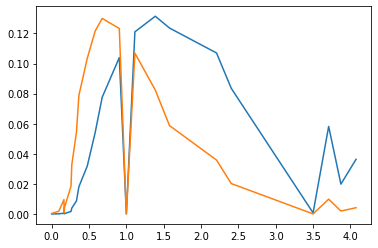

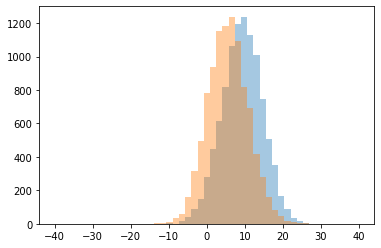

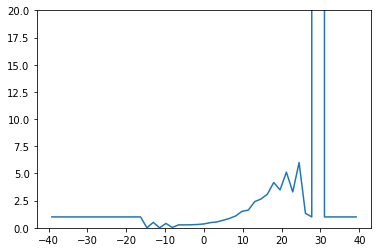

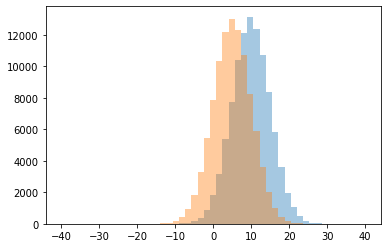

0 0.0
1 0.03125
2 0.26875
3 0.2711864406779661
4 0.2779552715654952
5 0.305668016194332
6 0.355584082156611
7 0.4
8 0.4754273504273504
9 0.5
10 0.5351257588898526
11 0.6900337837837838
12 0.8570274636510501
13 1.0
14 1.0915750915750915
15 1.3333333333333333
16 1.5134474327628362
17 1.6305916305916306
18 2.409090909090909
19 2.648936170212766
20 3.0920245398773005
21 3.3
22 3.4893617021276597
23 4.1647058823529415
24 5.117647058823529
25 6.0
26 999999.0




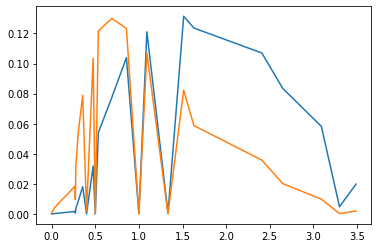

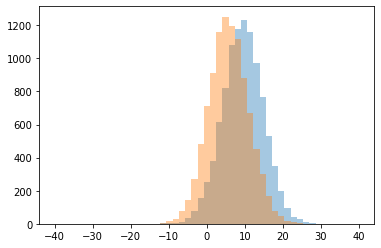

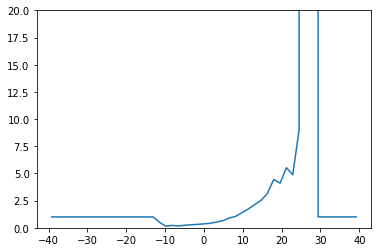

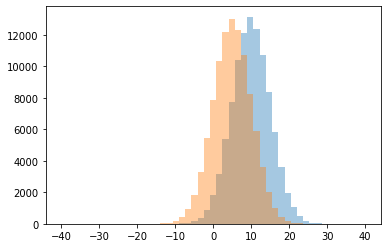

0 0.14285714285714285
1 0.16883116883116883
2 0.21875
3 0.23776223776223776
4 0.2783882783882784
5 0.31950207468879666
6 0.35864978902953587
7 0.41712403951701427
8 0.5
9 0.5289042277825712
10 0.65814696485623
11 0.9061190276613579
12 1.0
13 1.052820053715309
14 1.4018161180476731
15 1.7328358208955223
16 2.1362637362637362
17 2.5247524752475248
18 3.161676646706587
19 4.104166666666667
20 4.443037974683544
21 4.875
22 5.529411764705882
23 9.0
24 999999.0




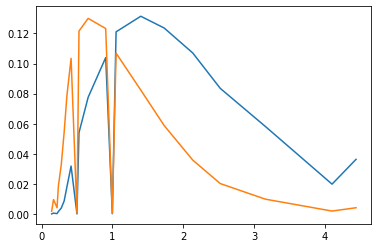

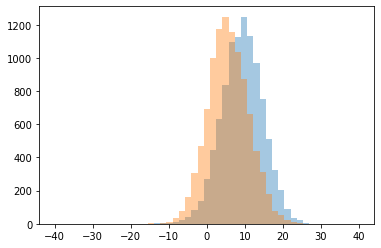

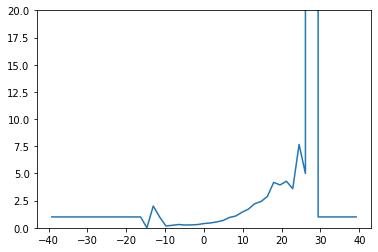

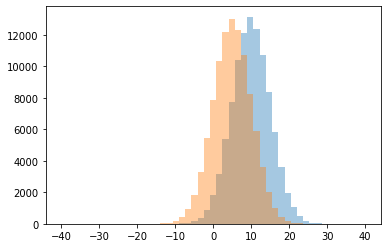

0 0.0
1 0.16666666666666666
2 0.22857142857142856
3 0.25609756097560976
4 0.2662337662337662
5 0.29723991507430997
6 0.3026315789473684
7 0.39105339105339104
8 0.44455544455544455
9 0.5387234042553192
10 0.6712218649517685
11 0.9480968858131488
12 1.0
13 1.0828516377649327
14 1.429553264604811
15 1.7147192716236723
16 2.0
17 2.217889908256881
18 2.4212218649517685
19 2.8876404494382024
20 3.6
21 3.9411764705882355
22 4.17948717948718
23 4.285714285714286
24 5.0
25 7.666666666666667
26 999999.0




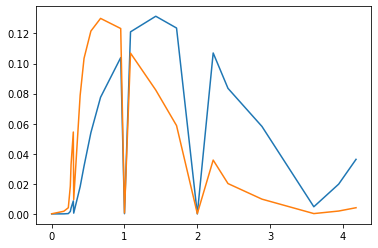

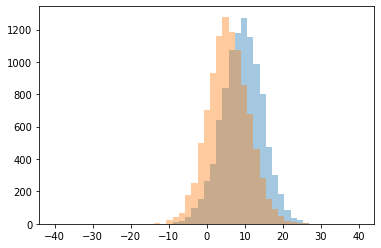

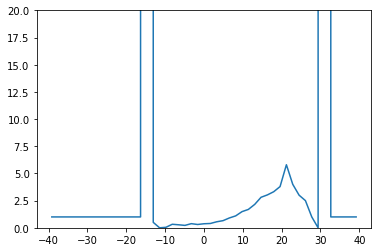

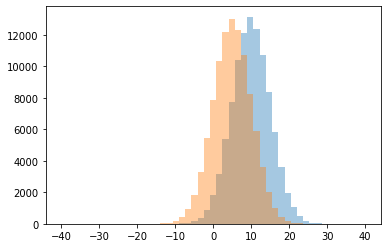

0 0.0
1 0.045454545454545456
2 0.22285714285714286
3 0.27692307692307694
4 0.3046092184368738
5 0.325
6 0.37163120567375885
7 0.3803921568627451
8 0.3967741935483871
9 0.5
10 0.5522904062229905
11 0.6559812353401094
12 0.9038785834738617
13 1.0
14 1.0959925442684064
15 1.4871495327102804
16 1.6901615271659325
17 2.1525054466230937
18 2.5
19 2.807017543859649
20 3.0
21 3.0256410256410255
22 3.318681318681319
23 3.7916666666666665
24 4.0
25 5.8
26 999999.0




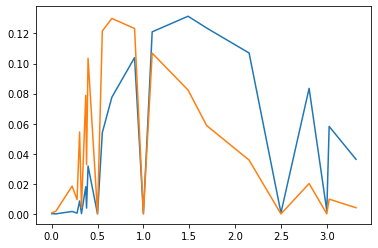

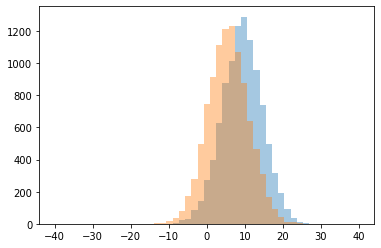

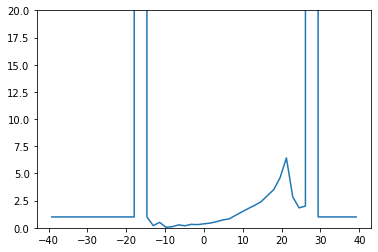

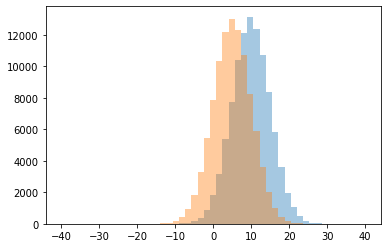

0 0.05
1 0.10256410256410256
2 0.1871345029239766
3 0.2
4 0.2692307692307692
5 0.2923387096774194
6 0.31785714285714284
7 0.36644295302013424
8 0.43530701754385964
9 0.5
10 0.5679567956795679
11 0.7252475247524752
12 0.8248175182481752
13 1.0
14 1.1543498596819457
15 1.4675767918088738
16 1.7776049766718507
17 1.8333333333333333
18 2.0
19 2.0669546436285096
20 2.396103896103896
21 2.8461538461538463
22 2.9585798816568047
23 3.511111111111111
24 4.609756097560975
25 6.428571428571429
26 999999.0




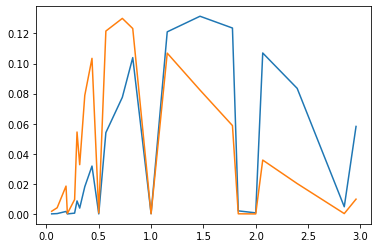

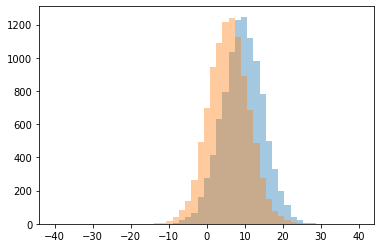

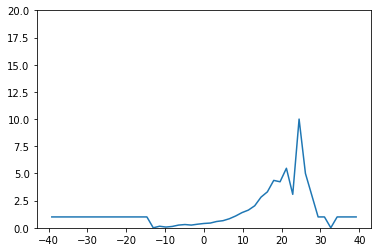

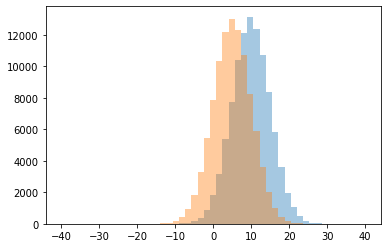

0 0.0
1 0.06666666666666667
2 0.125
3 0.14285714285714285
4 0.25
5 0.3
6 0.3313008130081301
7 0.39798850574712646
8 0.4369034994697773
9 0.580110497237569
10 0.6545754328112119
11 0.8325281803542673
12 1.0
13 1.0879218472468917
14 1.397982062780269
15 1.6273653566229986
16 2.024793388429752
17 2.822463768115942
18 3.0
19 3.076923076923077
20 3.3066666666666666
21 4.23404255319149
22 4.36
23 5.0
24 5.476190476190476
25 10.0




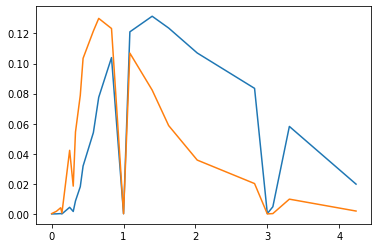

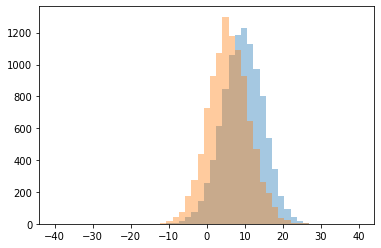

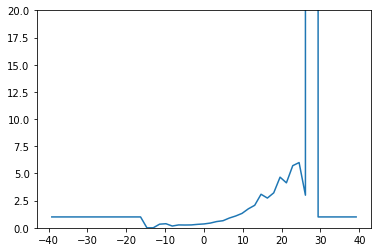

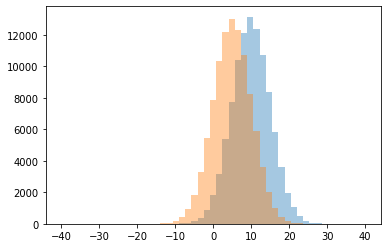

0 0.0
1 0.16279069767441862
2 0.2558139534883721
3 0.2638888888888889
4 0.2644927536231884
5 0.31746031746031744
6 0.3333333333333333
7 0.3544827586206897
8 0.375
9 0.43473570658036675
10 0.573953488372093
11 0.6515384615384615
12 0.897370653095844
13 1.0
14 1.0853211009174313
15 1.324353448275862
16 1.7461300309597523
17 2.070212765957447
18 2.7346938775510203
19 3.0
20 3.0846153846153848
21 3.2149532710280373
22 4.136363636363637
23 4.657894736842105
24 5.714285714285714
25 6.0
26 999999.0




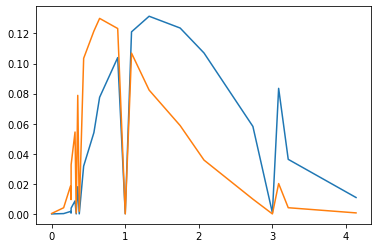

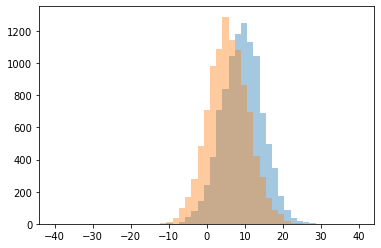

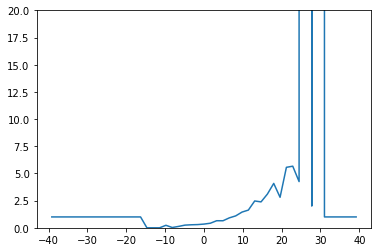

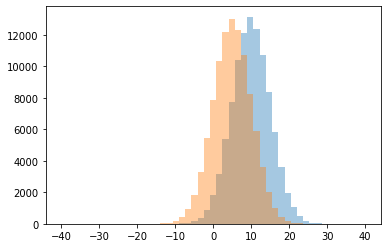

0 0.0
1 0.02702702702702703
2 0.12871287128712872
3 0.23076923076923078
4 0.24550898203592814
5 0.2775800711743772
6 0.29568788501026694
7 0.34177215189873417
8 0.4201424211597152
9 0.6485647788983708
10 0.6498161764705882
11 0.9143356643356644
12 1.0
13 1.0944444444444446
14 1.4457274826789839
15 1.6293103448275863
16 2.0
17 2.382758620689655
18 2.4680851063829787
19 2.806451612903226
20 3.099378881987578
21 4.08235294117647
22 4.25
23 5.5625
24 5.666666666666667
25 999999.0




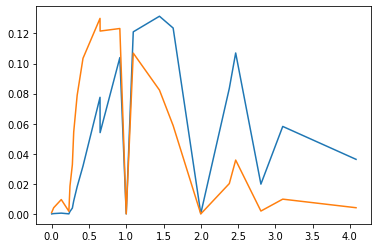

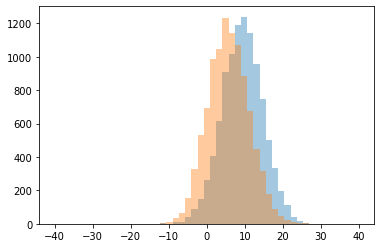

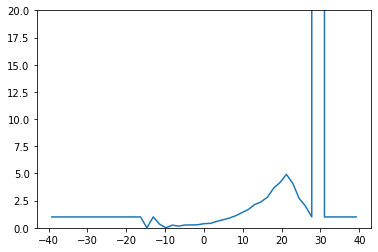

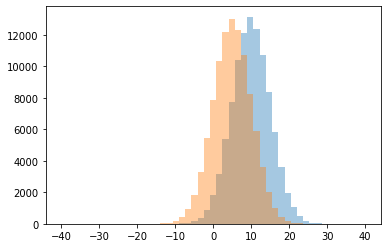

0 0.0
1 0.15625
2 0.24242424242424243
3 0.25806451612903225
4 0.2606060606060606
5 0.2781954887218045
6 0.3333333333333333
7 0.38095238095238093
8 0.4089068825910931
9 0.5853193517635844
10 0.7360323886639676
11 0.8907342657342657
12 1.0
13 1.1100746268656716
14 1.3979706877113867
15 1.689807976366322
16 2.0
17 2.1358574610244987
18 2.388535031847134
19 2.7142857142857144
20 2.810055865921788
21 3.659340659340659
22 4.1
23 4.170212765957447
24 4.913043478260869
25 999999.0




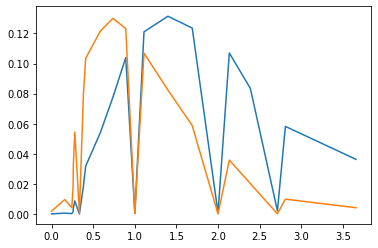

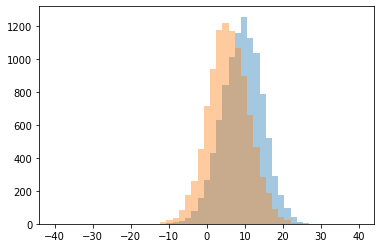

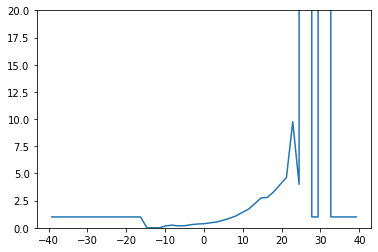

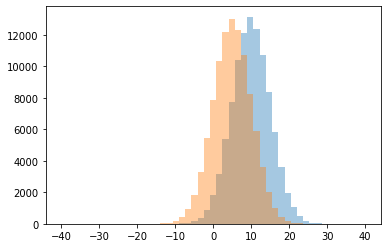

0 0.0
1 0.1728395061728395
2 0.18181818181818182
3 0.19653179190751446
4 0.24242424242424243
5 0.28846153846153844
6 0.34945054945054943
7 0.37517433751743373
8 0.4596602972399151
9 0.5351397121083827
10 0.6901062959934587
11 0.8668941979522184
12 1.0
13 1.0841908325537886
14 1.403567447045708
15 1.7075757575757575
16 2.211087420042644
17 2.745644599303136
18 2.7967914438502675
19 3.310344827586207
20 3.977272727272727
21 4.0
22 4.619047619047619
23 9.75
24 999999.0




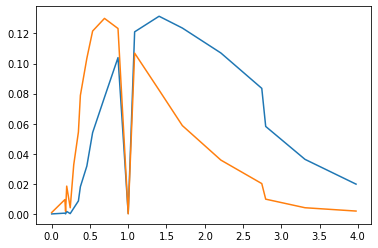

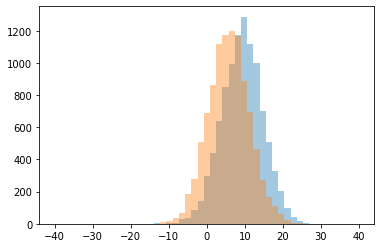

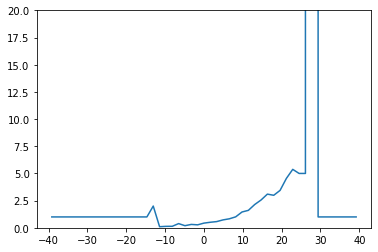

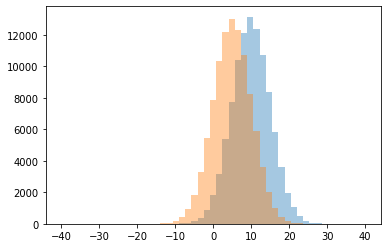

0 0.1
1 0.13333333333333333
2 0.1388888888888889
3 0.1945945945945946
4 0.2725490196078431
5 0.3107142857142857
6 0.38571428571428573
7 0.4312590448625181
8 0.5093023255813953
9 0.5704035874439461
10 0.7263427109974424
11 0.827212020033389
12 1.0
13 1.0068669527896996
14 1.4542372881355932
15 1.6040172166427547
16 2.0
17 2.1416309012875536
18 2.556363636363636
19 2.9909090909090907
20 3.096969696969697
21 3.440677966101695
22 4.545454545454546
23 5.0
24 5.375
25 999999.0




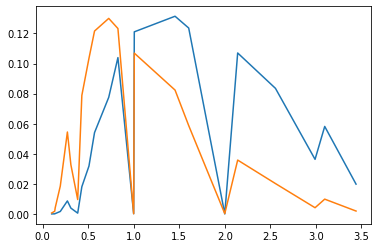

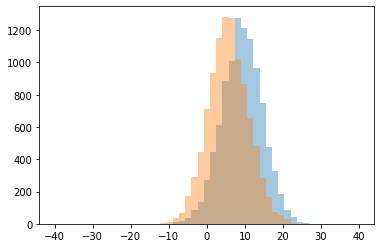

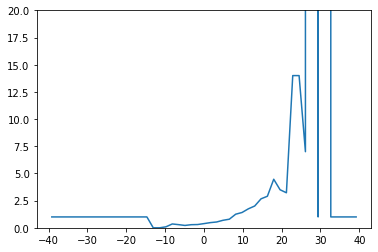

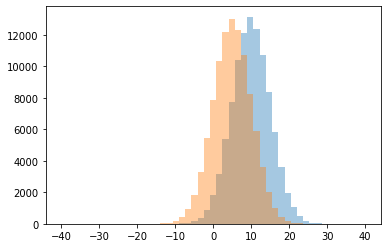

0 0.0
1 0.09090909090909091
2 0.21764705882352942
3 0.28620689655172415
4 0.2898550724637681
5 0.29977628635346754
6 0.35294117647058826
7 0.385049365303244
8 0.47593582887700536
9 0.5352480417754569
10 0.6905689789555729
11 0.7909162098668755
12 1.0
13 1.2504911591355599
14 1.4074074074074074
15 1.7458143074581431
16 2.004149377593361
17 2.6654804270462633
18 2.901840490797546
19 3.2222222222222223
20 3.5
21 4.465753424657534
22 7.0
23 14.0
24 999999.0




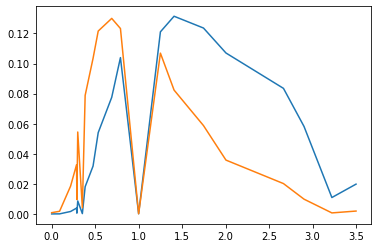

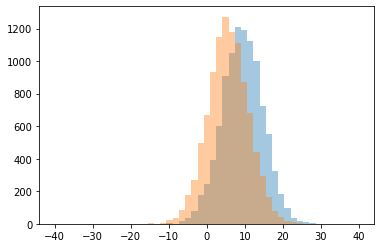

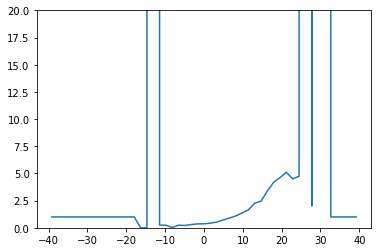

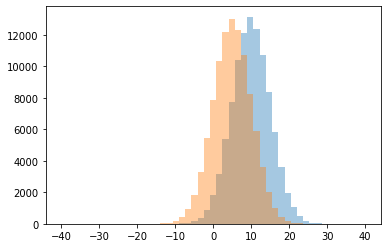

0 0.0
1 0.02857142857142857
2 0.21264367816091953
3 0.23809523809523808
4 0.24096385542168675
5 0.25
6 0.299625468164794
7 0.3603238866396761
8 0.36731634182908546
9 0.4221267454350161
10 0.525674499564839
11 0.7156323644933229
12 0.8923728813559322
13 1.0
14 1.0844564240790655
15 1.364678899082569
16 1.641812865497076
17 2.0
18 2.264705882352941
19 2.4527027027027026
20 3.3865030674846626
21 4.194805194805195
22 4.5
23 4.625
24 4.75
25 5.105263157894737
26 999999.0




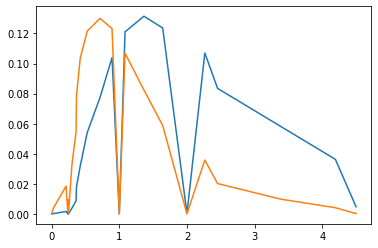

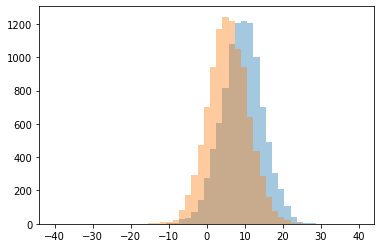

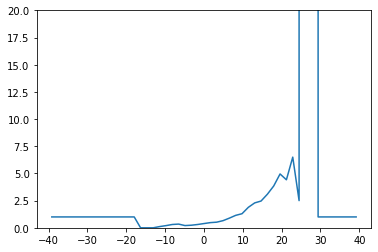

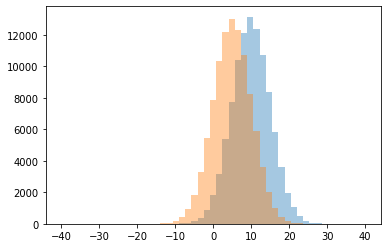

0 0.0
1 0.1111111111111111
2 0.2
3 0.20588235294117646
4 0.23711340206185566
5 0.3036093418259023
6 0.30434782608695654
7 0.3411764705882353
8 0.39
9 0.475531914893617
10 0.5175363558597091
11 0.6556717618664522
12 0.8881578947368421
13 1.0
14 1.144486692015209
15 1.2957446808510638
16 1.8845553822152885
17 2.2906178489702516
18 2.461267605633803
19 2.5
20 3.088607594936709
21 3.848101265822785
22 4.416666666666667
23 4.9523809523809526
24 6.5
25 999999.0




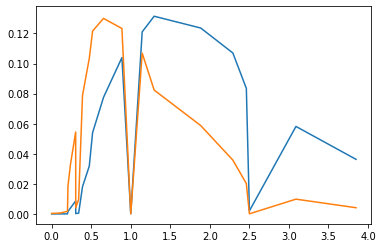

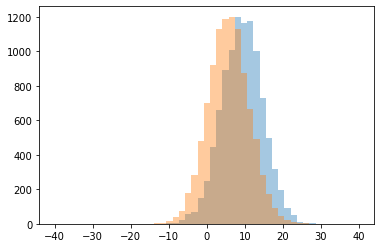

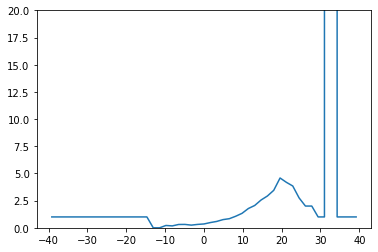

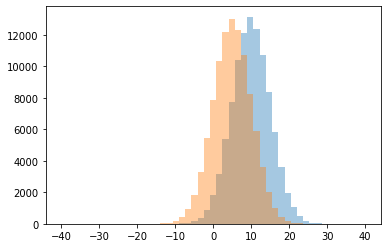

0 0.0
1 0.175
2 0.21428571428571427
3 0.24647887323943662
4 0.3055555555555556
5 0.3107344632768362
6 0.31185031185031187
7 0.35285714285714287
8 0.4810400866738895
9 0.5842198581560284
10 0.7529510961214165
11 0.8376353039134055
12 1.0
13 1.062111801242236
14 1.329532497149373
15 1.7737556561085972
16 2.0
17 2.053169734151329
18 2.5543859649122806
19 2.75
20 2.9235294117647057
21 3.4456521739130435
22 3.8461538461538463
23 4.181818181818182
24 4.5813953488372094
25 999999.0




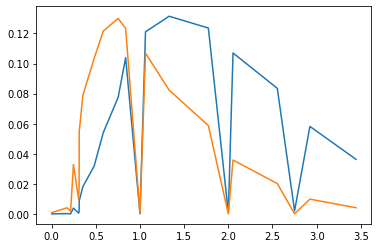

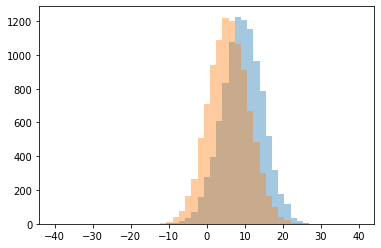

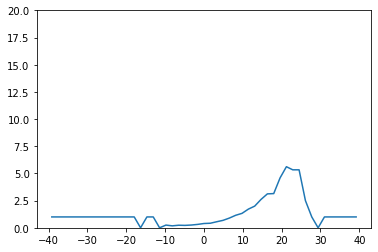

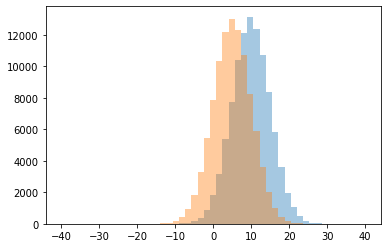

0 0.0
1 0.1794871794871795
2 0.22289156626506024
3 0.23684210526315788
4 0.25
5 0.2537313432835821
6 0.31237721021611004
7 0.39492242595204513
8 0.41959531416400425
9 0.5559633027522936
10 0.6839080459770115
11 0.8935993349958438
12 1.0
13 1.1511737089201879
14 1.328193832599119
15 1.717910447761194
16 1.9937759336099585
17 2.5
18 2.611295681063123
19 3.1204819277108435
20 3.1470588235294117
21 4.589743589743589
22 5.333333333333333
23 5.619047619047619




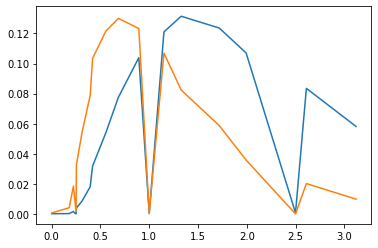

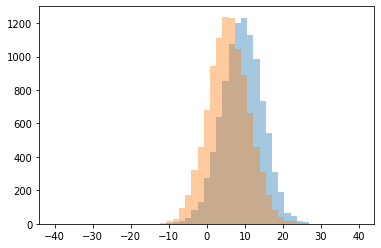

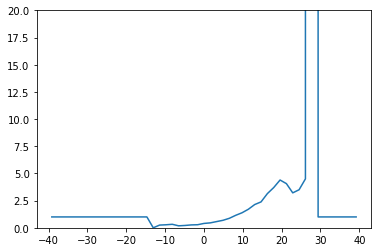

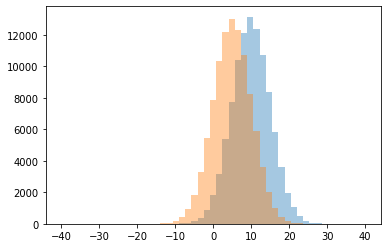

0 0.0
1 0.1827956989247312
2 0.21511627906976744
3 0.25
4 0.265625
5 0.2777777777777778
6 0.2826086956521739
7 0.3225806451612903
8 0.40175953079178883
9 0.45387062566277836
10 0.5724572457245725
11 0.6898222940226171
12 0.8729641693811075
13 1.0
14 1.1475095785440612
15 1.3820224719101124
16 1.706060606060606
17 2.13882863340564
18 2.381877022653722
19 3.145348837209302
20 3.2142857142857144
21 3.5
22 3.7023809523809526
23 4.0625
24 4.395348837209302
25 4.5
26 999999.0




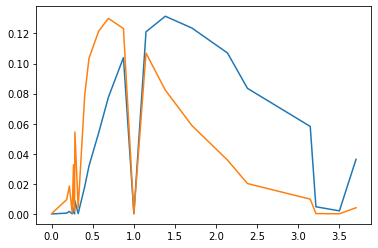

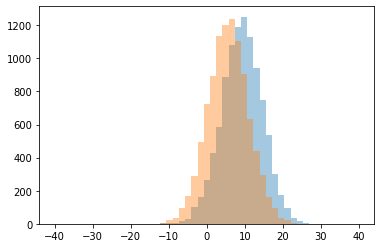

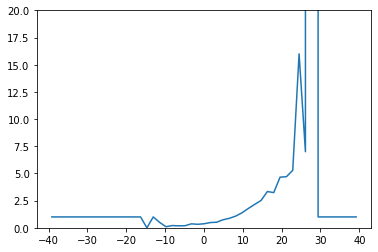

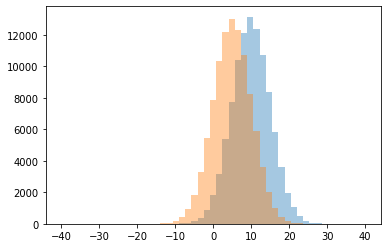

0 0.0
1 0.1
2 0.18085106382978725
3 0.1893491124260355
4 0.20588235294117646
5 0.32323232323232326
6 0.3623693379790941
7 0.3698060941828255
8 0.4826038159371493
9 0.5
10 0.5123022847100176
11 0.740432612312812
12 0.870863599677159
13 1.0
14 1.0751811594202898
15 1.380374862183021
16 1.7779527559055117
17 2.1552511415525113
18 2.5117845117845117
19 3.236559139784946
20 3.3375
21 4.657894736842105
22 4.7
23 5.285714285714286
24 7.0
25 16.0
26 999999.0




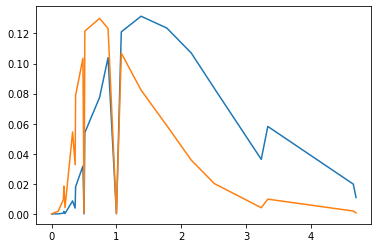

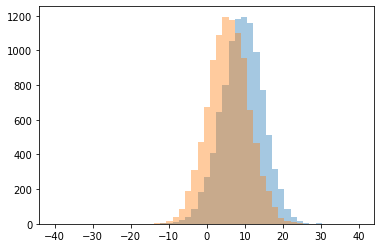

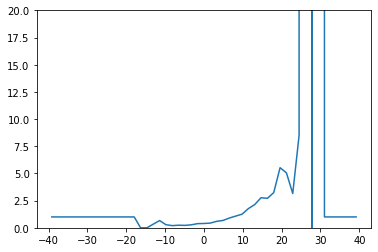

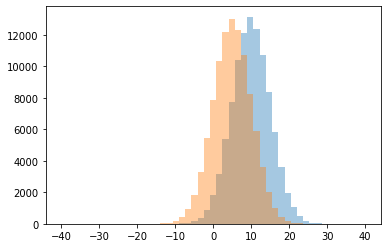

0 0.0
1 0.2
2 0.22340425531914893
3 0.23863636363636365
4 0.2747603833865815
5 0.2857142857142857
6 0.3333333333333333
7 0.38266384778012685
8 0.39644970414201186
9 0.4337221633085896
10 0.5948434622467772
11 0.6666666666666666
12 0.6747899159663866
13 0.8977853492333902
14 1.0
15 1.0765027322404372
16 1.251572327044025
17 1.7640791476407915
18 2.1354838709677417
19 2.7127659574468086
20 2.7661870503597124
21 3.1538461538461537
22 3.2346938775510203
23 5.0588235294117645
24 5.527777777777778
25 8.5
26 999999.0




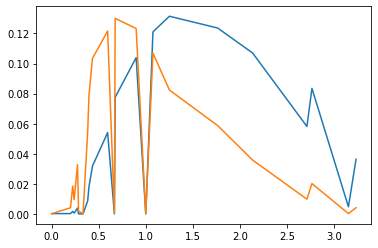

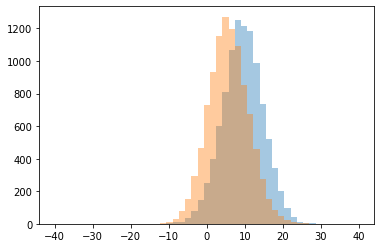

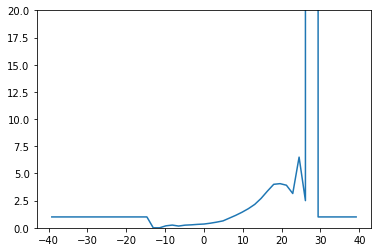

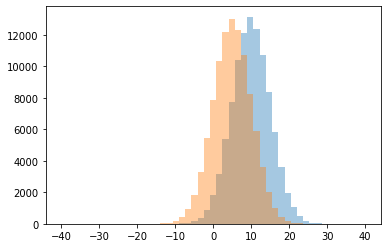

0 0.0
1 0.16049382716049382
2 0.18181818181818182
3 0.24342105263157895
4 0.25
5 0.272108843537415
6 0.315450643776824
7 0.34615384615384615
8 0.4229122055674518
9 0.5212489158716392
10 0.6360062893081762
11 0.8897243107769424
12 1.0
13 1.1446886446886446
14 1.4312573443008225
15 1.7589285714285714
16 2.150655021834061
17 2.5
18 2.6996336996337
19 3.1538461538461537
20 3.3701298701298703
21 3.9166666666666665
22 4.0
23 4.061224489795919
24 6.5
25 999999.0




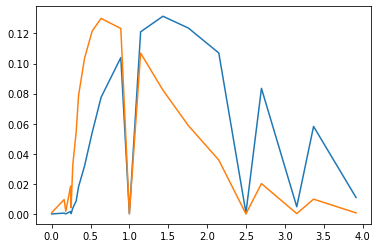

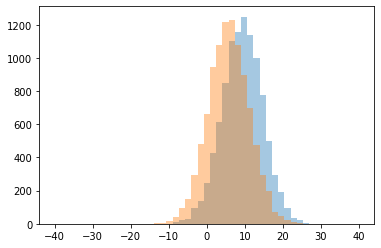

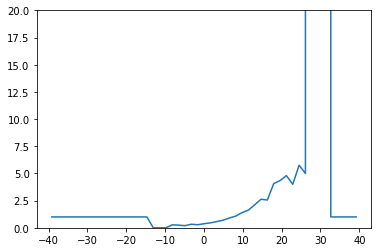

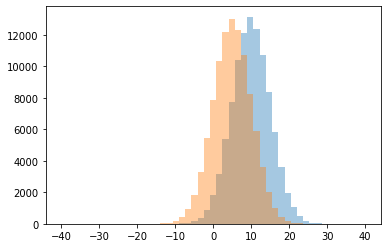

0 0.0
1 0.19727891156462585
2 0.24489795918367346
3 0.275
4 0.28274428274428276
5 0.3277027027027027
6 0.37367624810892586
7 0.45291005291005293
8 0.567191844300278
9 0.6987654320987654
10 0.8989405052974735
11 1.0
12 1.0734200743494424
13 1.391304347826087
14 1.6284074605451937
15 2.1183932346723044
16 2.5538461538461537
17 2.6271186440677967
18 4.0
19 4.068493150684931
20 4.340909090909091
21 4.8
22 5.0
23 5.75
24 999999.0




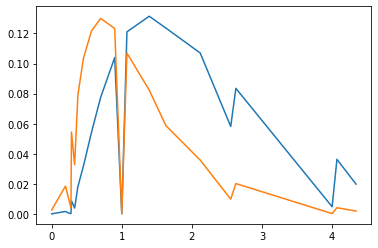

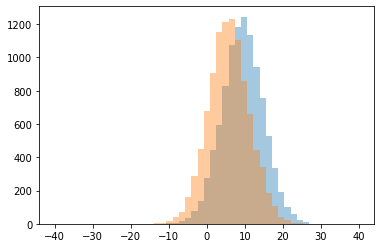

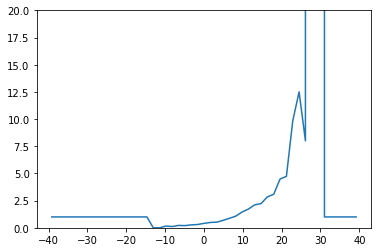

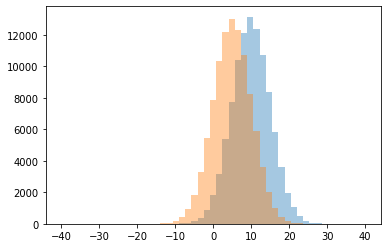

0 0.0
1 0.11627906976744186
2 0.15789473684210525
3 0.20125786163522014
4 0.2191780821917808
5 0.27017543859649124
6 0.3022222222222222
7 0.40795287187039764
8 0.4911894273127753
9 0.5173611111111112
10 0.6831683168316832
11 0.870235198702352
12 1.0
13 1.066847335140018
14 1.447674418604651
15 1.7201210287443267
16 2.1123595505617976
17 2.2271386430678466
18 2.8440860215053765
19 3.0833333333333335
20 4.488372093023256
21 4.7272727272727275
22 8.0
23 9.833333333333334
24 12.5
25 999999.0




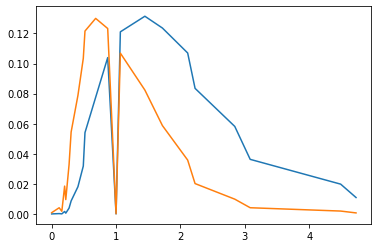

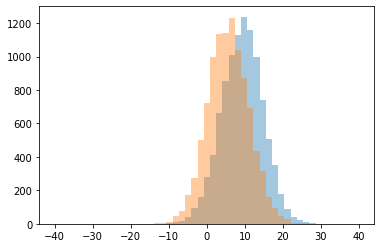

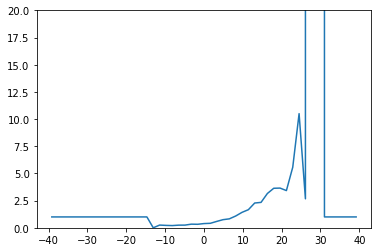

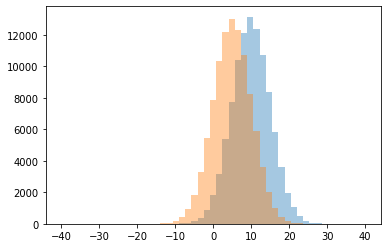

0 0.0
1 0.20454545454545456
2 0.2222222222222222
3 0.24324324324324326
4 0.24705882352941178
5 0.25
6 0.3232931726907631
7 0.33454545454545453
8 0.3883495145631068
9 0.4130653266331658
10 0.5855379188712522
11 0.7471566054243219
12 0.8232899022801303
13 1.0
14 1.0837343599615015
15 1.4213547646383466
16 1.6647482014388488
17 2.279176201372998
18 2.3375394321766563
19 2.6666666666666665
20 3.1552795031055902
21 3.423076923076923
22 3.6354166666666665
23 3.6530612244897958
24 5.571428571428571
25 10.5
26 999999.0




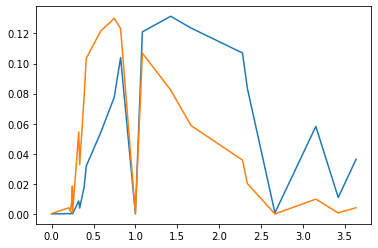

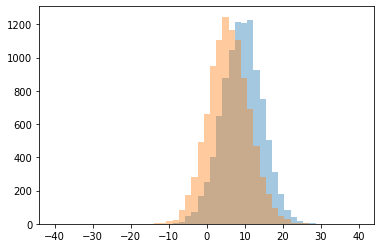

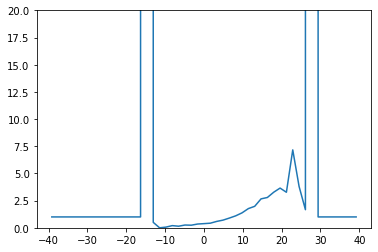

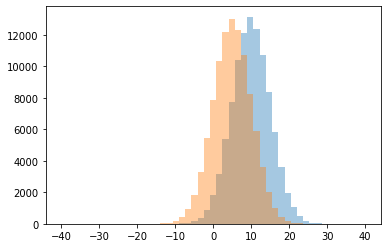

0 0.0
1 0.0625
2 0.14634146341463414
3 0.2
4 0.23943661971830985
5 0.2543352601156069
6 0.3469387755102041
7 0.38310708898944196
8 0.4237644584647739
9 0.5
10 0.5862691960252936
11 0.7054574638844302
12 0.8945111492281304
13 1.0
14 1.0995475113122173
15 1.3742889647326508
16 1.6666666666666667
17 1.7662337662337662
18 1.9764453961456103
19 2.6607773851590104
20 2.7888888888888888
21 3.269230769230769
22 3.2736842105263158
23 3.6530612244897958
24 3.8
25 7.166666666666667
26 999999.0




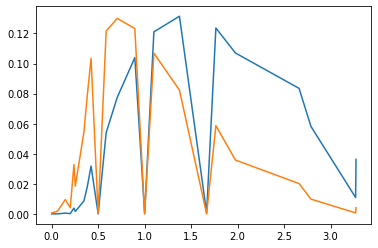

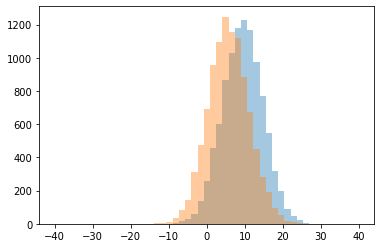

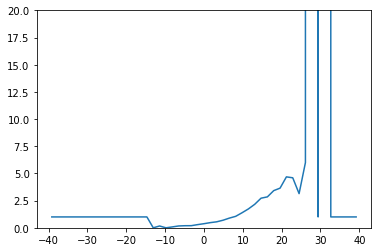

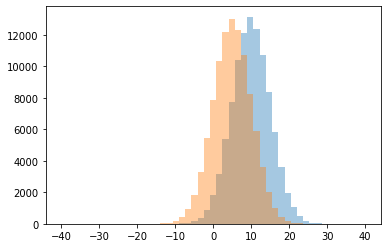

0 0.0
1 0.08108108108108109
2 0.16666666666666666
3 0.1686746987951807
4 0.1917808219178082
5 0.1955128205128205
6 0.2920168067226891
7 0.37735849056603776
8 0.47539267015706804
9 0.5501824817518248
10 0.6952686447473937
11 0.890625
12 1.0
13 1.0545129579982127
14 1.3826185101580135
15 1.7333333333333334
16 2.16
17 2.723404255319149
18 2.844559585492228
19 3.142857142857143
20 3.4193548387096775
21 3.6481481481481484
22 4.6
23 4.684210526315789
24 6.0
25 999999.0




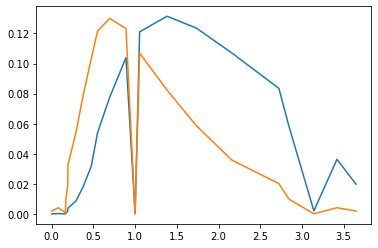

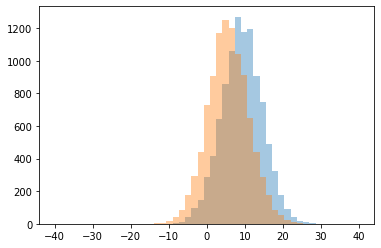

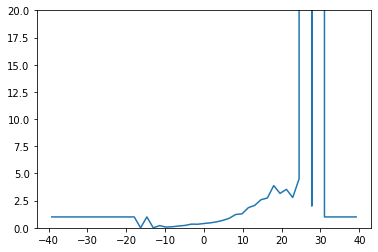

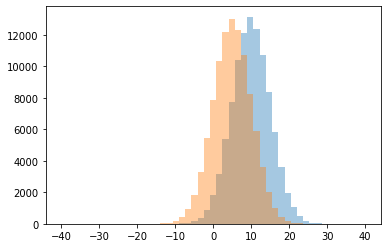

0 0.0
1 0.06666666666666667
2 0.0975609756097561
3 0.16279069767441862
4 0.2
5 0.21787709497206703
6 0.32801822323462415
7 0.33676975945017185
8 0.39339752407152684
9 0.456353591160221
10 0.5488013698630136
11 0.6864
12 0.8801996672212978
13 1.0
14 1.2223291626564003
15 1.2869660460021906
16 1.8500772797527048
17 2.0
18 2.06378132118451
19 2.58477508650519
20 2.741573033707865
21 2.7857142857142856
22 3.1636363636363636
23 3.5384615384615383
24 3.880952380952381
25 4.5
26 999999.0




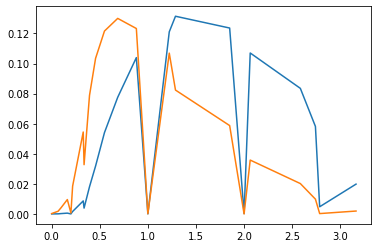

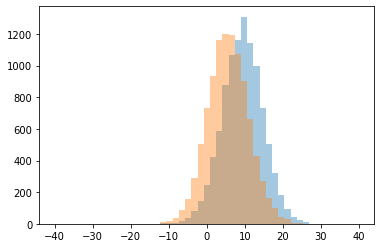

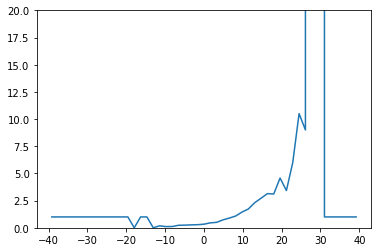

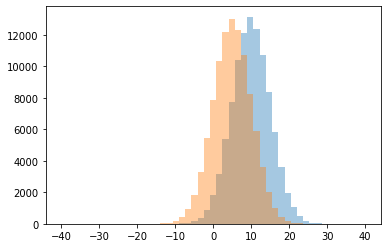

0 0.0
1 0.1111111111111111
2 0.11764705882352941
3 0.18181818181818182
4 0.23255813953488372
5 0.24516129032258063
6 0.2698961937716263
7 0.2859960552268245
8 0.332421340629275
9 0.453475935828877
10 0.5025817555938038
11 0.7312186978297162
12 0.895397489539749
13 1.0
14 1.0837988826815643
15 1.449612403100775
16 1.7287878787878788
17 2.308584686774942
18 2.720149253731343
19 3.1067961165048543
20 3.14375
21 3.4285714285714284
22 4.575
23 6.0
24 9.0
25 10.5
26 999999.0




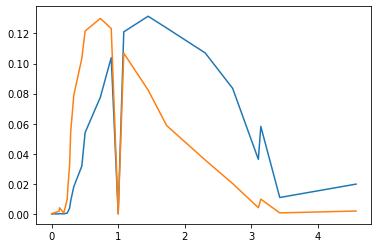

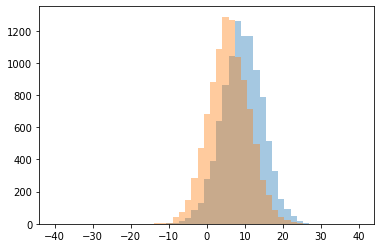

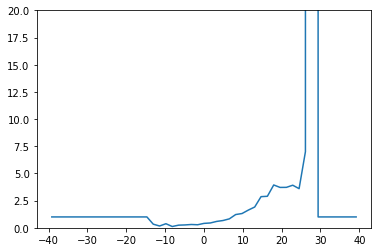

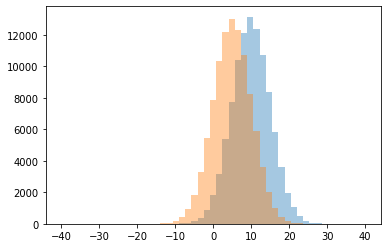

0 0.11904761904761904
1 0.16666666666666666
2 0.24324324324324326
3 0.2635135135135135
4 0.2799145299145299
5 0.3041958041958042
6 0.3333333333333333
7 0.375
8 0.4052863436123348
9 0.4444444444444444
10 0.5865561694290976
11 0.6697746697746698
12 0.8217665615141956
13 1.0
14 1.2195357833655707
15 1.3120089786756453
16 1.6312849162011174
17 1.911823647294589
18 2.8649635036496353
19 2.898876404494382
20 3.6
21 3.7142857142857144
22 3.72
23 3.9166666666666665
24 3.9404761904761907
25 7.0
26 999999.0




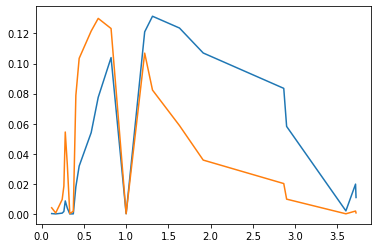

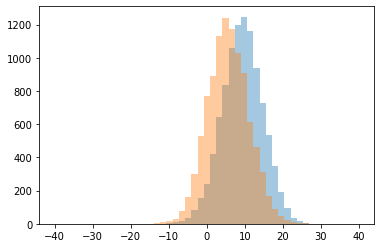

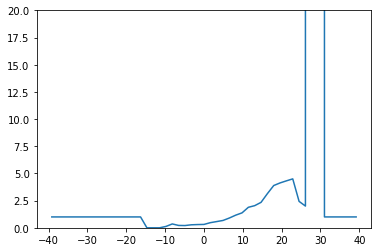

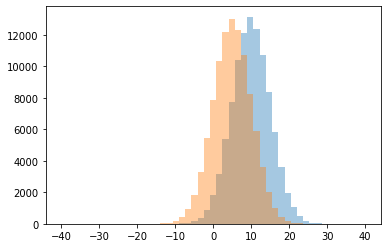

0 0.0
1 0.125
2 0.2073170731707317
3 0.21794871794871795
4 0.2757475083056478
5 0.29791271347248577
6 0.3103896103896104
7 0.3548387096774194
8 0.4707865168539326
9 0.5721877767936226
10 0.6750202101859337
11 0.8995744680851064
12 1.0
13 1.1619786614936953
14 1.3733480176211454
15 1.8859934853420195
16 2.0
17 2.036796536796537
18 2.3408360128617365
19 2.4285714285714284
20 3.1411764705882352
21 3.8876404494382024
22 4.127659574468085
23 4.318181818181818
24 4.5
25 999999.0




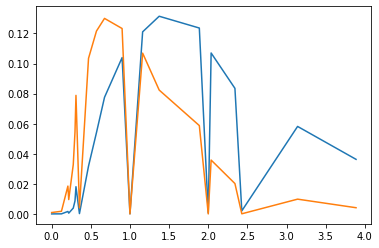

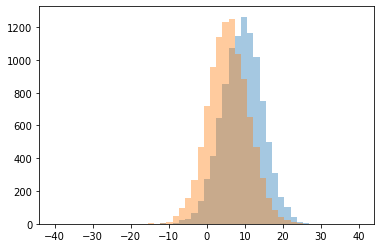

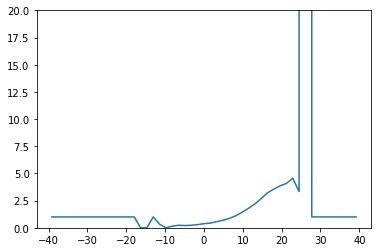

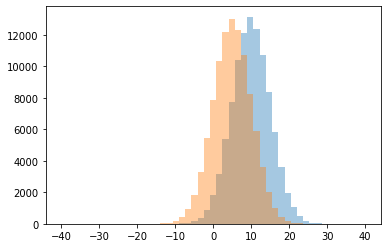

0 0.0
1 0.14893617021276595
2 0.20512820512820512
3 0.23404255319148937
4 0.2342007434944238
5 0.2929936305732484
6 0.3333333333333333
7 0.3786407766990291
8 0.4330543933054393
9 0.5654082528533801
10 0.6965012205044752
11 0.8582866293034428
12 1.0
13 1.1058710298363812
14 1.4266365688487586
15 1.7852760736196318
16 2.180257510729614
17 2.6714285714285713
18 3.2115384615384617
19 3.3333333333333335
20 3.5517241379310347
21 3.86046511627907
22 4.08
23 4.555555555555555
24 999999.0




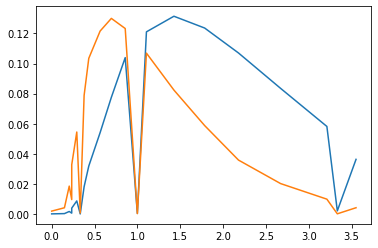

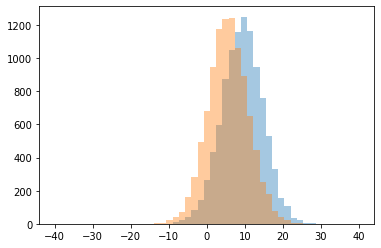

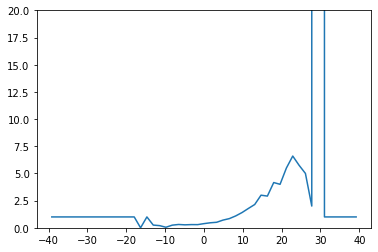

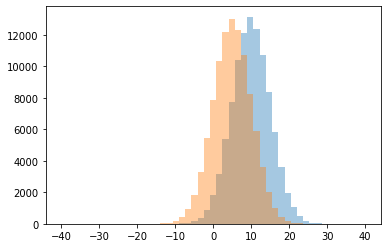

0 0.0
1 0.05
2 0.2
3 0.24390243902439024
4 0.25
5 0.2732919254658385
6 0.2909090909090909
7 0.29473684210526313
8 0.3055555555555556
9 0.383601756954612
10 0.4613756613756614
11 0.508071367884452
12 0.708502024291498
13 0.8444802578565673
14 1.0
15 1.0914231856738925
16 1.4024663677130045
17 1.7782874617737003
18 2.0
19 2.1422121896162527
20 2.9171270718232045
21 3.0
22 4.0
23 4.1625
24 5.0
25 5.5
26 5.75
27 6.6
28 999999.0




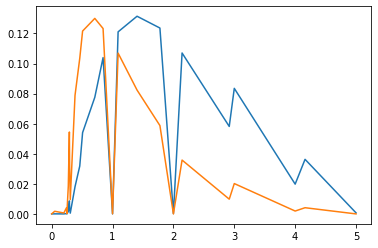

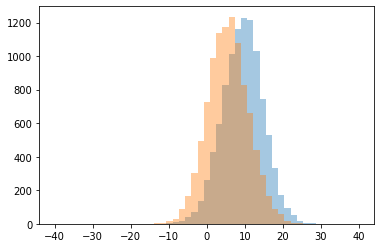

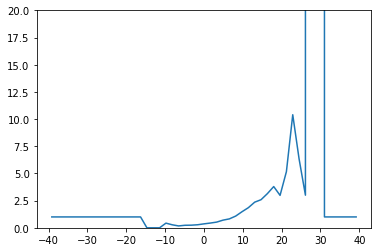

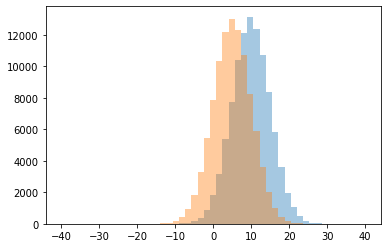

0 0.0
1 0.1724137931034483
2 0.23214285714285715
3 0.24092409240924093
4 0.27586206896551724
5 0.2799188640973631
6 0.3626373626373626
7 0.42857142857142855
8 0.43566362715298884
9 0.5236842105263158
10 0.7040816326530612
11 0.8186234817813766
12 1.0
13 1.077849860982391
14 1.4795180722891565
15 1.851063829787234
16 2.358447488584475
17 2.58477508650519
18 2.9827586206896552
19 3.0
20 3.142857142857143
21 3.793103448275862
22 5.166666666666667
23 6.333333333333333
24 10.4
25 999999.0




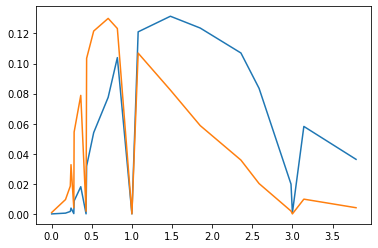

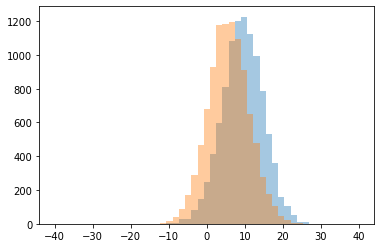

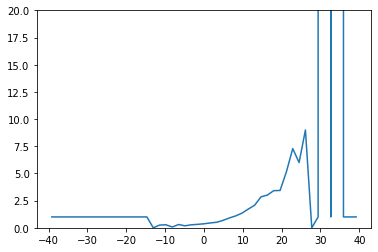

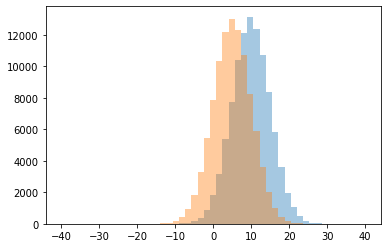

0 0.0
1 0.075
2 0.1834319526627219
3 0.25
4 0.27526132404181186
5 0.2777777777777778
6 0.3023255813953488
7 0.31827956989247314
8 0.36764705882352944
9 0.4482758620689655
10 0.5076400679117148
11 0.682741116751269
12 0.9046822742474916
13 1.0
14 1.0949771689497716
15 1.3487348734873488
16 1.726574500768049
17 2.0838574423480085
18 2.850909090909091
19 3.0113636363636362
20 3.4150943396226414
21 3.4347826086956523
22 5.15
23 6.0
24 7.285714285714286
25 9.0
26 999999.0




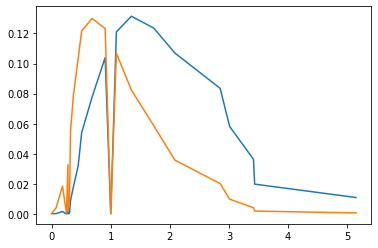

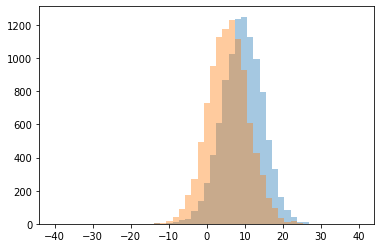

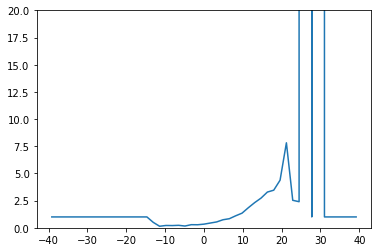

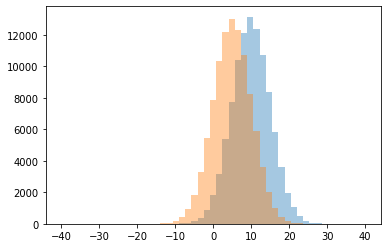

0 0.14285714285714285
1 0.16279069767441862
2 0.20512820512820512
3 0.21428571428571427
4 0.22826086956521738
5 0.2804878048780488
6 0.2867647058823529
7 0.33653846153846156
8 0.4380252100840336
9 0.5
10 0.5394853593611357
11 0.7404255319148936
12 0.8363192182410424
13 1.0
14 1.1037567084078712
15 1.3455328310010763
16 1.8491803278688526
17 2.318604651162791
18 2.4
19 2.5294117647058822
20 2.732876712328767
21 3.287581699346405
22 3.4583333333333335
23 4.378378378378378
24 7.818181818181818
25 999999.0




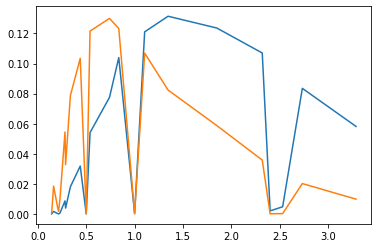

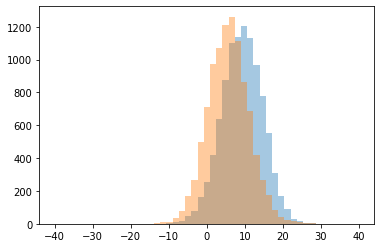

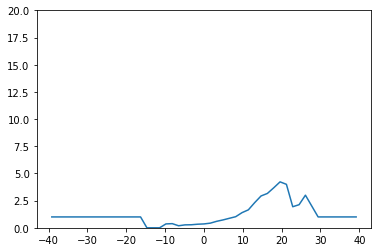

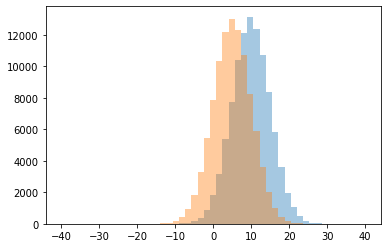

0 0.0
1 0.1875
2 0.26900584795321636
3 0.2798507462686567
4 0.33
5 0.3563380281690141
6 0.35714285714285715
7 0.38235294117647056
8 0.4276923076923077
9 0.596441947565543
10 0.7241948802642444
11 0.8739095955590801
12 1.0
13 1.020627802690583
14 1.3935185185185186
15 1.652046783625731
16 1.9375
17 2.0
18 2.125
19 2.316546762589928
20 2.9283018867924526
21 3.0
22 3.16
23 3.6785714285714284
24 4.0
25 4.225




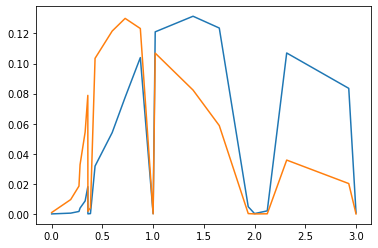

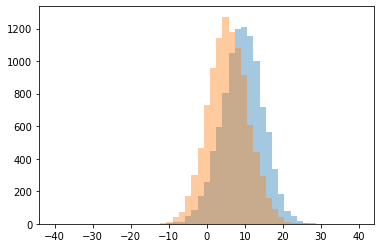

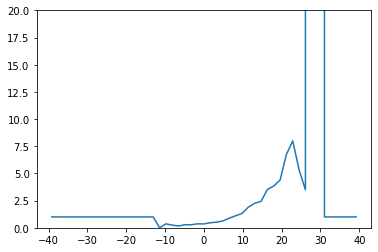

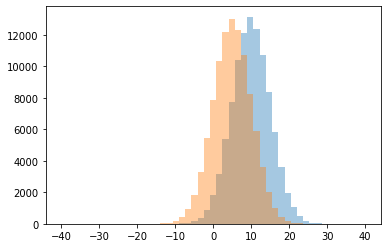

0 0.0
1 0.16901408450704225
2 0.24390243902439024
3 0.27647058823529413
4 0.2833333333333333
5 0.35665294924554186
6 0.36363636363636365
7 0.3655913978494624
8 0.46596858638743455
9 0.5179039301310043
10 0.6331500392772977
11 0.8888888888888888
12 1.0
13 1.1064814814814814
14 1.3187772925764192
15 1.8998357963875205
16 2.2545045045045047
17 2.4305084745762713
18 3.5
19 3.525
20 3.840909090909091
21 4.380952380952381
22 5.333333333333333
23 6.75
24 8.0
25 999999.0




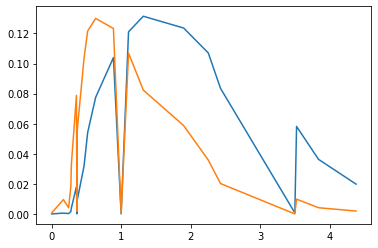

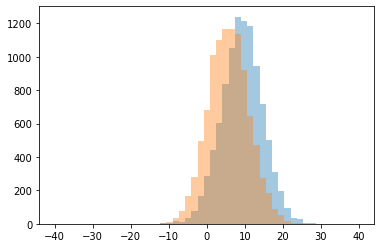

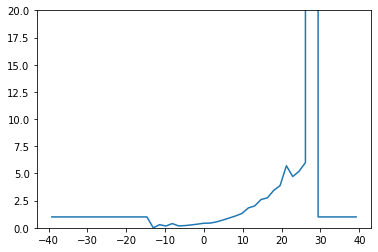

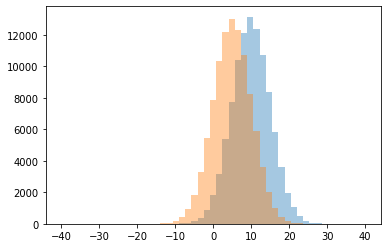

0 0.0
1 0.16666666666666666
2 0.17567567567567569
3 0.20359281437125748
4 0.26595744680851063
5 0.2857142857142857
6 0.33805668016194335
7 0.3888888888888889
8 0.4208211143695015
9 0.43478260869565216
10 0.5468607825295724
11 0.7172236503856041
12 0.9016253207869974
13 1.0
14 1.09347442680776
15 1.323177366702938
16 1.8297213622291022
17 2.0106609808102345
18 2.601449275362319
19 2.7540983606557377
20 3.4395604395604398
21 3.88
22 4.714285714285714
23 5.2
24 5.705882352941177
25 6.0
26 999999.0




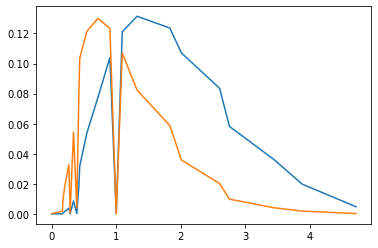

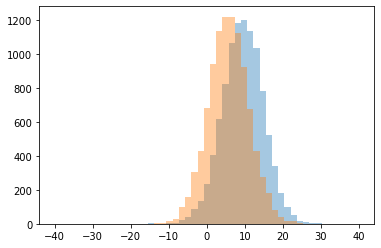

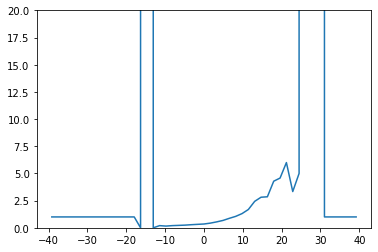

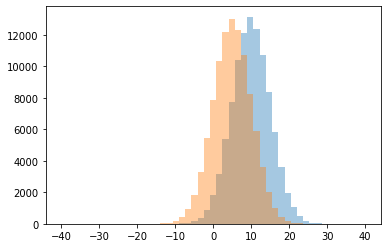

0 0.0
1 0.15789473684210525
2 0.2
3 0.2222222222222222
4 0.24528301886792453
5 0.2847682119205298
6 0.31786542923433875
7 0.3490427098674521
8 0.42948038176033937
9 0.5440140845070423
10 0.6773662551440329
11 0.8720262510254306
12 1.0
13 1.0506666666666666
14 1.3051031487513571
15 1.6835066864784547
16 2.4342723004694835
17 2.812274368231047
18 2.8532608695652173
19 3.3333333333333335
20 4.2875
21 4.575
22 5.0
23 6.0
24 999999.0




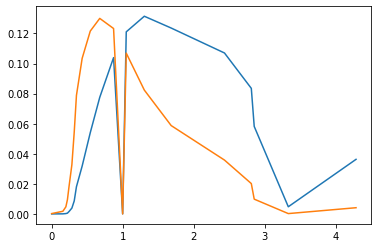

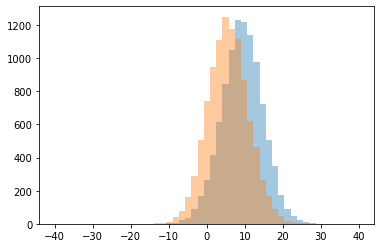

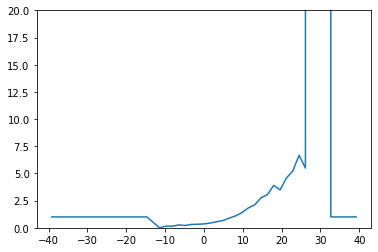

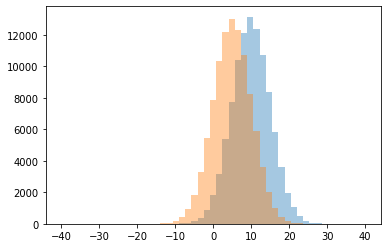

0 0.0
1 0.14634146341463414
2 0.15384615384615385
3 0.2111801242236025
4 0.26582278481012656
5 0.30927835051546393
6 0.32673267326732675
7 0.35994587280108253
8 0.4365750528541226
9 0.5
10 0.5544554455445545
11 0.6730615507593924
12 0.8903061224489796
13 1.0
14 1.100983020554066
15 1.401836969001148
16 1.828525641025641
17 2.1120689655172415
18 2.763358778625954
19 3.0421686746987953
20 3.48
21 3.9
22 4.578947368421052
23 5.222222222222222
24 5.5
25 6.666666666666667
26 999999.0




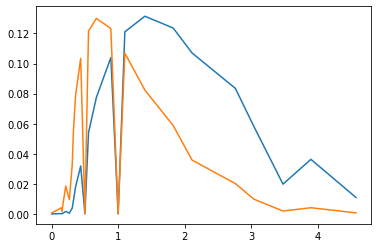

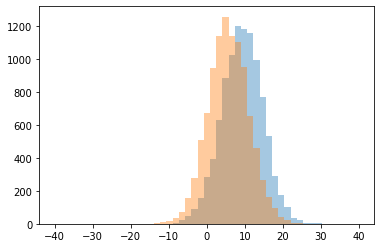

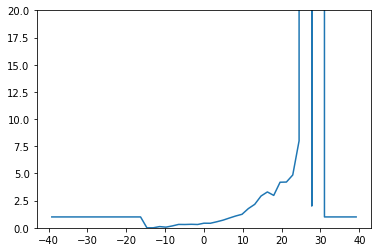

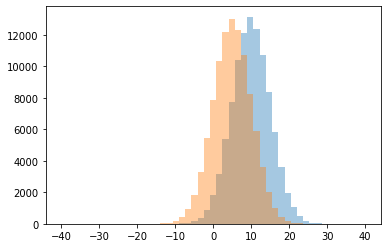

0 0.0
1 0.058823529411764705
2 0.1111111111111111
3 0.17142857142857143
4 0.3037974683544304
5 0.30434782608695654
6 0.3108108108108108
7 0.3225806451612903
8 0.4171066525871172
9 0.4223880597014925
10 0.5518453427065027
11 0.7022292993630573
12 0.8974583698510079
13 1.0
14 1.085144927536232
15 1.2423603793466806
16 1.7679389312977098
17 2.0
18 2.1565217391304348
19 2.923954372623574
20 2.979591836734694
21 3.298136645962733
22 4.190476190476191
23 4.208333333333333
24 4.857142857142857
25 8.0
26 999999.0




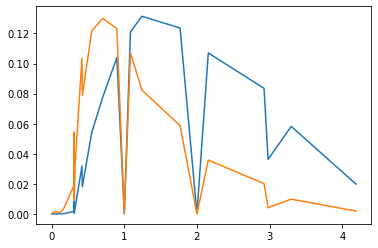

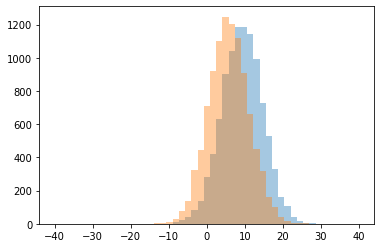

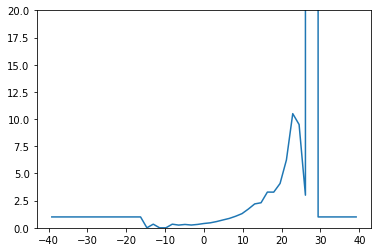

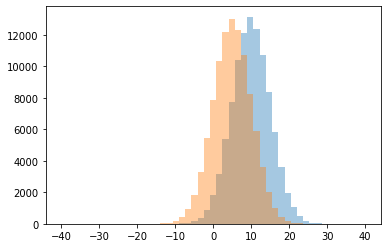

0 0.0
1 0.25
2 0.2546583850931677
3 0.30714285714285716
4 0.3108108108108108
5 0.3333333333333333
6 0.39603960396039606
7 0.4581066376496192
8 0.5754545454545454
9 0.7217321571772254
10 0.8640132669983416
11 1.0
12 1.0635631154879142
13 1.3036303630363035
14 1.7254901960784315
15 2.1969026548672566
16 2.3037974683544302
17 3.0
18 3.28
19 3.2857142857142856
20 4.076923076923077
21 6.235294117647059
22 9.5
23 10.5
24 999999.0




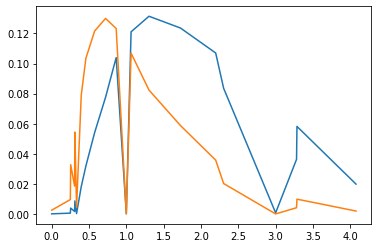

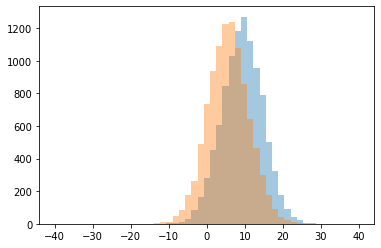

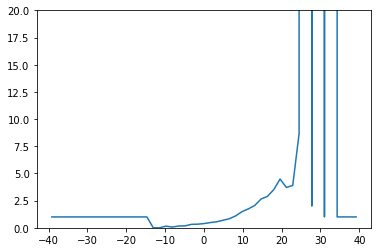

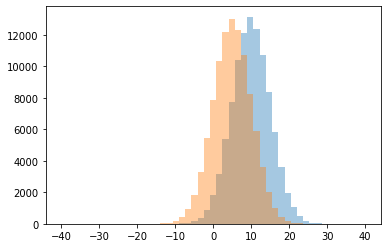

0 0.0
1 0.06666666666666667
2 0.15384615384615385
3 0.16470588235294117
4 0.17415730337078653
5 0.3169811320754717
6 0.3333333333333333
7 0.3866120218579235
8 0.4802981895633653
9 0.5526075022872827
10 0.6928104575163399
11 0.8329297820823245
12 1.0
13 1.0963855421686748
14 1.4853801169590644
15 1.7406832298136645
16 2.0
17 2.051502145922747
18 2.6498316498316496
19 2.8850574712643677
20 3.5053763440860215
21 3.7083333333333335
22 3.9
23 4.487179487179487
24 8.666666666666666
25 999999.0




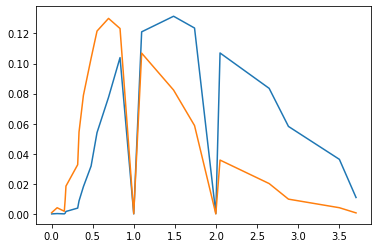

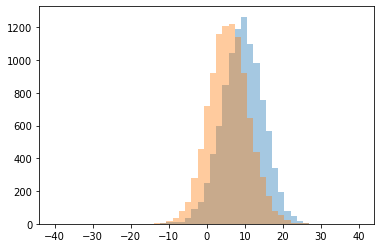

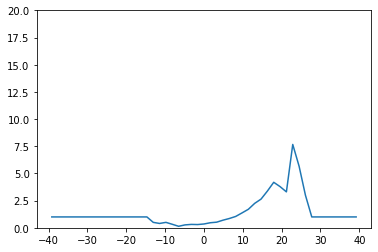

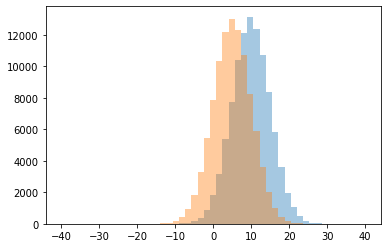

0 0.13924050632911392
1 0.26666666666666666
2 0.2982456140350877
3 0.3120567375886525
4 0.3235294117647059
5 0.35097493036211697
6 0.4
7 0.4646354733405876
8 0.5
9 0.5176876617773943
10 0.7009113504556752
11 0.8552739165985282
12 1.0
13 1.0438981562774363
14 1.369047619047619
15 1.703416149068323
16 2.2488584474885847
17 2.63986013986014
18 3.0
19 3.3043478260869565
20 3.377245508982036
21 3.7884615384615383
22 4.185185185185185
23 5.666666666666667
24 7.666666666666667




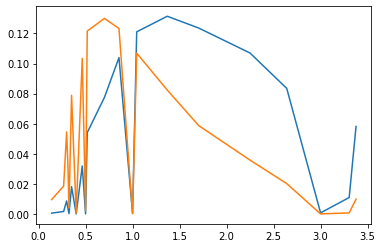

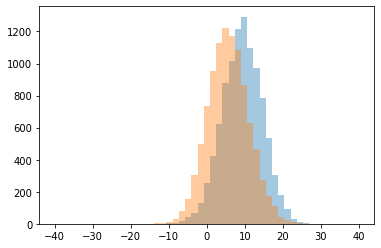

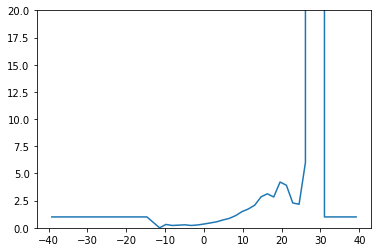

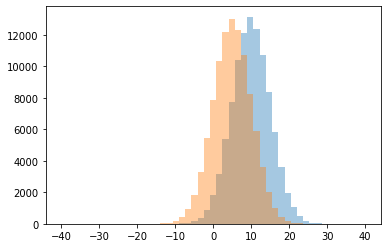

0 0.0
1 0.21428571428571427
2 0.2145214521452145
3 0.24390243902439024
4 0.26305220883534136
5 0.27388535031847133
6 0.3076923076923077
7 0.34688346883468835
8 0.44607329842931936
9 0.5
10 0.549645390070922
11 0.7215397215397216
12 0.8671209540034072
13 1.0
14 1.1228070175438596
15 1.4884792626728112
16 1.7325949367088607
17 2.0790598290598292
18 2.1666666666666665
19 2.2857142857142856
20 2.8333333333333335
21 2.8442028985507246
22 3.127906976744186
23 3.9130434782608696
24 4.209302325581396
25 6.0
26 999999.0




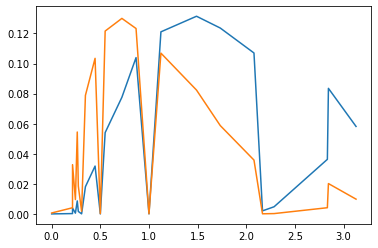

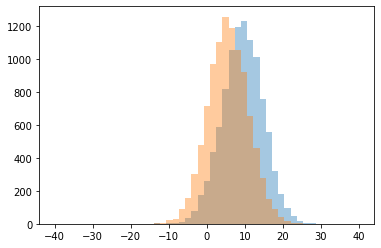

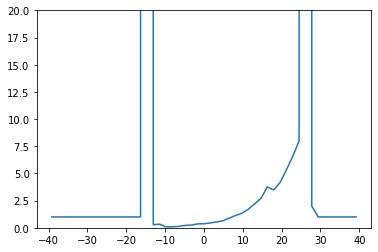

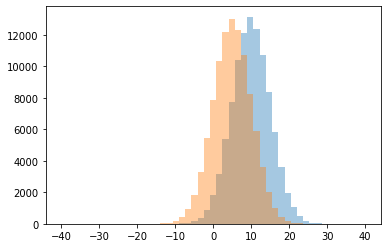

0 0.08695652173913043
1 0.09375
2 0.125
3 0.21794871794871795
4 0.25165562913907286
5 0.2857142857142857
6 0.3333333333333333
7 0.3625
8 0.3659217877094972
9 0.4484536082474227
10 0.5349682107175295
11 0.6515513126491647
12 0.8873949579831932
13 1.0
14 1.1358024691358024
15 1.339499455930359
16 1.7075038284839203
17 2.0
18 2.206971677559913
19 2.716845878136201
20 3.4782608695652173
21 3.7583892617449663
22 4.162790697674419
23 5.333333333333333
24 6.571428571428571
25 8.0
26 999999.0




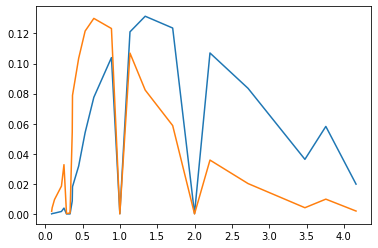

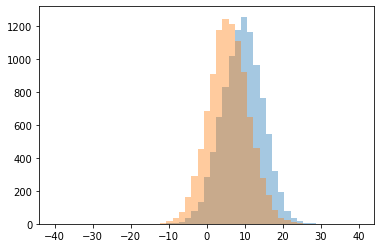

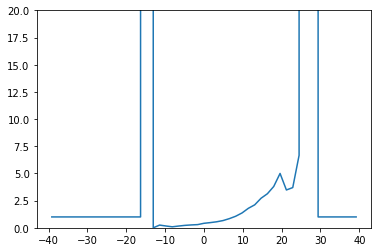

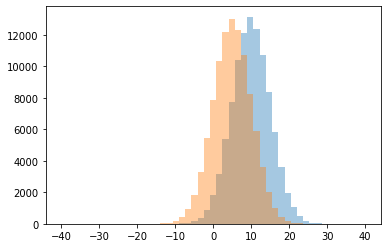

0 0.0
1 0.09090909090909091
2 0.16216216216216217
3 0.16666666666666666
4 0.2236024844720497
5 0.25
6 0.2636986301369863
7 0.2926829268292683
8 0.4143484626647145
9 0.47744774477447743
10 0.5532821824381927
11 0.6642570281124498
12 0.8422791081750619
13 1.0
14 1.062330623306233
15 1.3652173913043477
16 1.7932098765432098
17 2.111597374179431
18 2.717857142857143
19 3.132183908045977
20 3.4782608695652173
21 3.7
22 3.8
23 5.0
24 6.666666666666667
25 999999.0




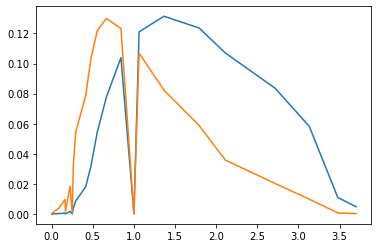

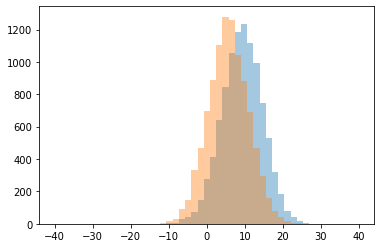

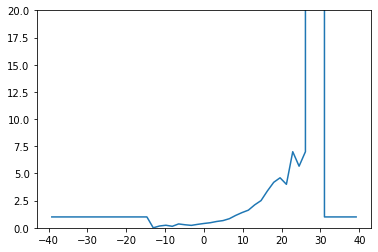

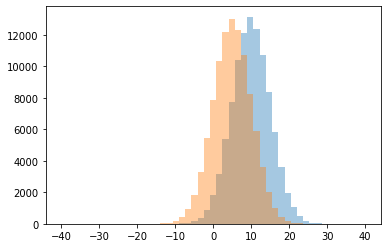

0 0.0
1 0.13793103448275862
2 0.16666666666666666
3 0.22356495468277945
4 0.23529411764705882
5 0.28
6 0.3169164882226981
7 0.35555555555555557
8 0.3976945244956772
9 0.4672686230248307
10 0.5815217391304348
11 0.6622361219702892
12 0.8366375892149088
13 1.0
14 1.1392891450528337
15 1.399092970521542
16 1.6217391304347826
17 2.110403397027601
18 2.5033557046979866
19 3.388535031847134
20 4.0
21 4.184210526315789
22 4.6
23 5.666666666666667
24 7.0
25 999999.0




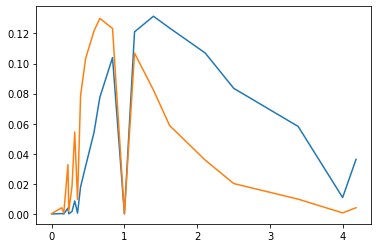

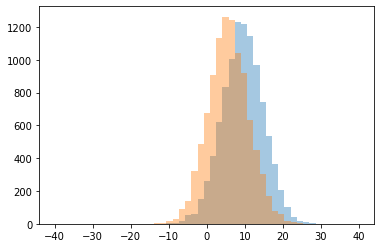

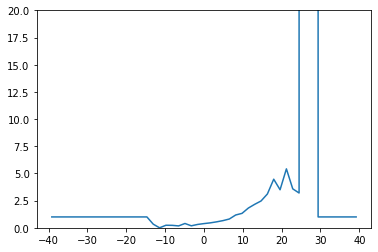

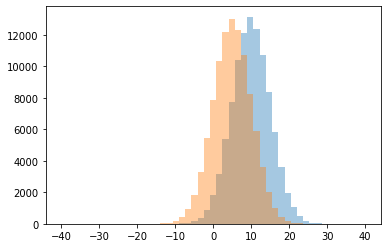

0 0.0
1 0.17391304347826086
2 0.18322981366459629
3 0.22580645161290322
4 0.23529411764705882
5 0.30879345603271985
6 0.3333333333333333
7 0.38666666666666666
8 0.3971631205673759
9 0.45464601769911506
10 0.5486725663716814
11 0.6608557844690967
12 0.8090249798549557
13 1.0
14 1.1775431861804222
15 1.3275109170305677
16 1.8174603174603174
17 2.1603563474387526
18 2.466887417218543
19 3.11046511627907
20 3.2
21 3.5
22 3.5833333333333335
23 4.469135802469136
24 5.421052631578948
25 999999.0




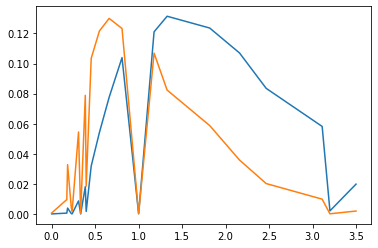

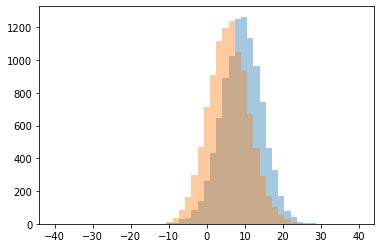

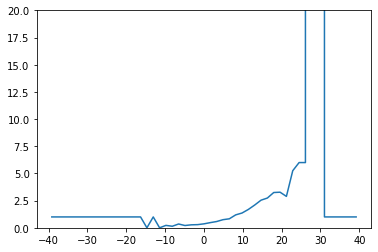

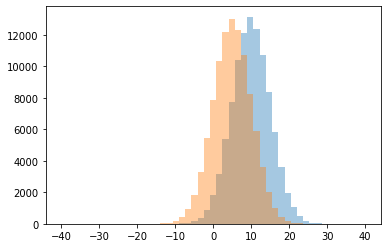

0 0.0
1 0.14285714285714285
2 0.21084337349397592
3 0.2222222222222222
4 0.2733333333333333
5 0.2908704883227176
6 0.3493975903614458
7 0.36427566807313644
8 0.4762954796030871
9 0.5770609318996416
10 0.7466555183946488
11 0.8278092158447857
12 1.0
13 1.1883920076117982
14 1.3587540279269603
15 1.6894502228826151
16 2.0954446854663775
17 2.541095890410959
18 2.738095238095238
19 2.888888888888889
20 3.2450980392156863
21 3.2745098039215685
22 5.25
23 6.0
24 999999.0




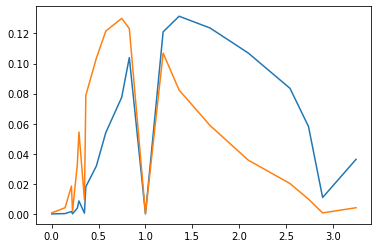

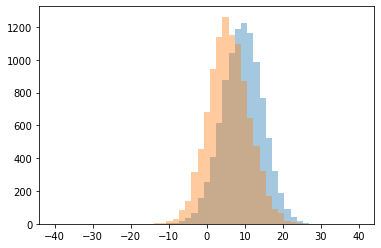

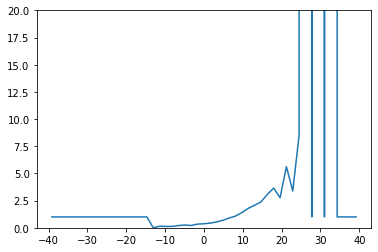

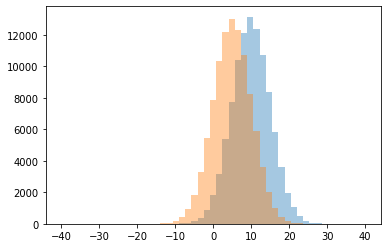

0 0.0
1 0.125
2 0.14285714285714285
3 0.20930232558139536
4 0.21725239616613418
5 0.2535211267605634
6 0.33769063180827885
7 0.3733528550512445
8 0.42948038176033937
9 0.5413005272407733
10 0.6967537608867775
11 0.901213171577123
12 1.0
13 1.0846994535519126
14 1.412442396313364
15 1.7972136222910218
16 2.0824524312896404
17 2.3894080996884735
18 2.7611940298507465
19 3.0764705882352943
20 3.3846153846153846
21 3.659090909090909
22 5.625
23 8.5
24 999999.0




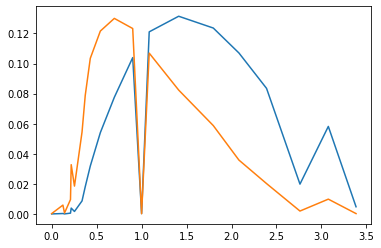

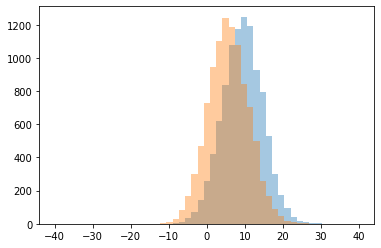

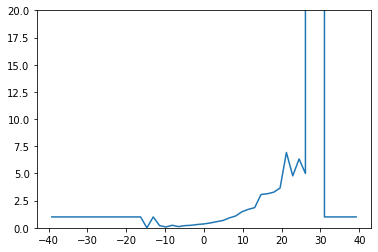

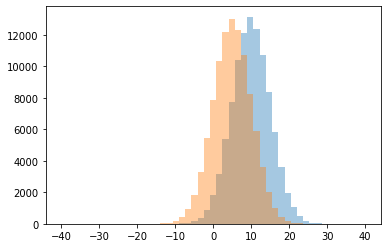

0 0.0
1 0.07692307692307693
2 0.1111111111111111
3 0.2
4 0.20118343195266272
5 0.23076923076923078
6 0.23178807947019867
7 0.3057324840764331
8 0.35665294924554186
9 0.4455026455026455
10 0.5638009049773756
11 0.6733708769107
12 0.9090909090909091
13 1.0
14 1.0888888888888888
15 1.4798578199052133
16 1.6984352773826459
17 1.856
18 3.0656370656370657
19 3.1301775147928996
20 3.2747252747252746
21 3.6595744680851063
22 4.777777777777778
23 5.0
24 6.333333333333333
25 6.928571428571429
26 999999.0




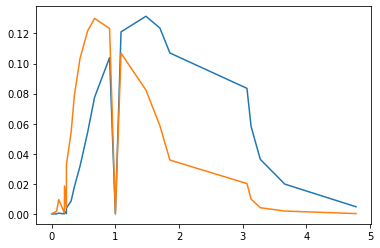

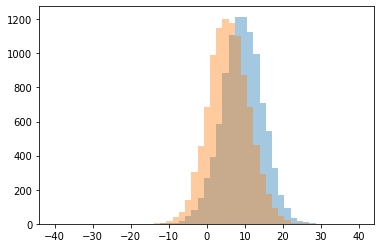

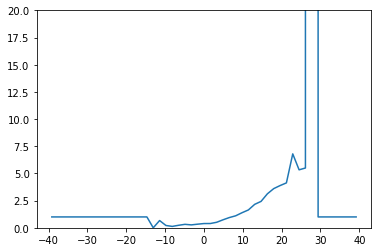

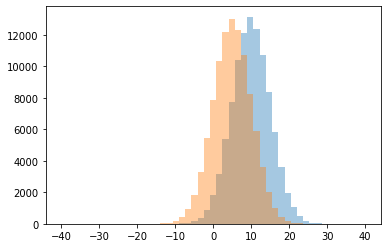

0 0.0
1 0.1282051282051282
2 0.21428571428571427
3 0.2318840579710145
4 0.2682119205298013
5 0.3191489361702128
6 0.3333333333333333
7 0.39098837209302323
8 0.39375629405840884
9 0.5073848827106864
10 0.6666666666666666
11 0.7346089850249584
12 0.9422750424448217
13 1.0
14 1.103542234332425
15 1.3867276887871853
16 1.640875912408759
17 2.158008658008658
18 2.4280821917808217
19 3.125714285714286
20 3.6043956043956045
21 3.883720930232558
22 4.130434782608695
23 5.333333333333333
24 5.5
25 6.8
26 999999.0




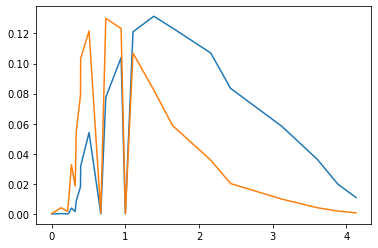

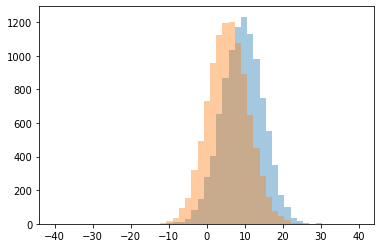

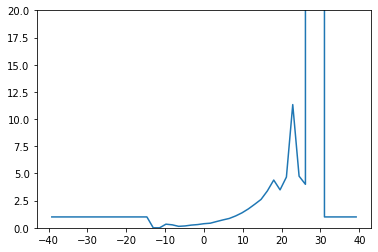

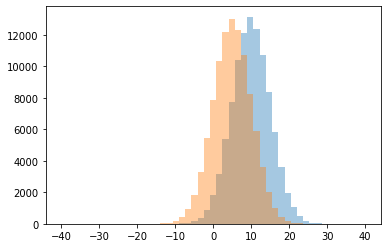

0 0.0
1 0.13541666666666666
2 0.16993464052287582
3 0.2484472049689441
4 0.2727272727272727
5 0.29591836734693877
6 0.3333333333333333
7 0.37756497948016415
8 0.42379958246346555
9 0.5786666666666667
10 0.7259816207184628
11 0.8616666666666667
12 1.0
13 1.092264678471575
14 1.378076062639821
15 1.7380585516178737
16 2.163716814159292
17 2.6097560975609757
18 3.3950617283950617
19 3.489795918367347
20 4.0
21 4.3924050632911396
22 4.666666666666667
23 4.75
24 11.333333333333334
25 999999.0




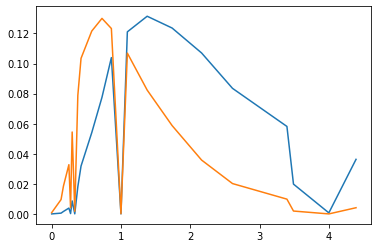

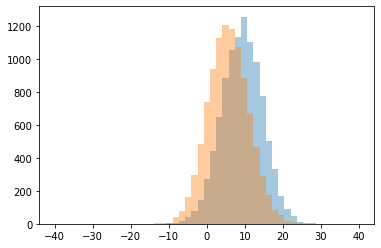

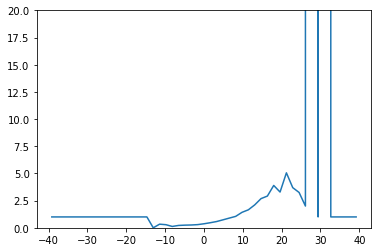

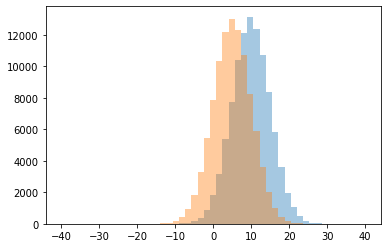

0 0.0
1 0.125
2 0.21794871794871795
3 0.24390243902439024
4 0.25838926174496646
5 0.2857142857142857
6 0.2915811088295688
7 0.3333333333333333
8 0.37027027027027026
9 0.46751863684771033
10 0.5767524401064774
11 0.7336641852770885
12 0.8933107535986452
13 1.0
14 1.0511152416356877
15 1.4235560588901472
16 1.6546546546546546
17 2.0
18 2.10752688172043
19 2.685121107266436
20 2.9186046511627906
21 3.25
22 3.2884615384615383
23 3.6923076923076925
24 3.895348837209302
25 5.055555555555555
26 999999.0




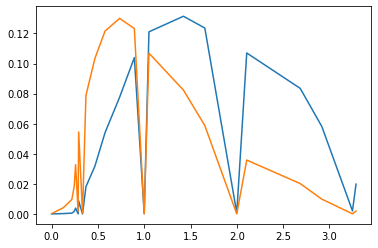

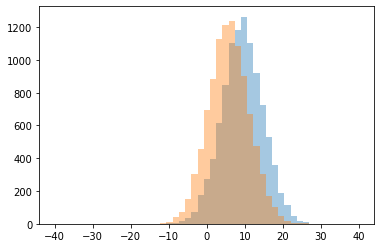

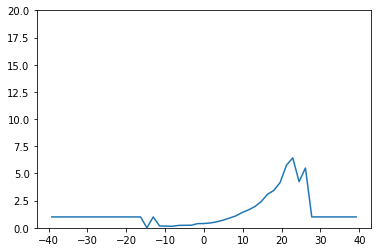

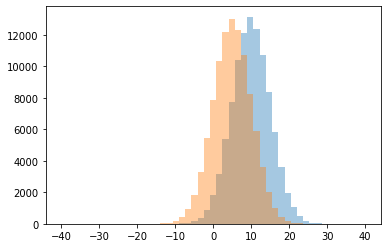

0 0.0
1 0.13953488372093023
2 0.15384615384615385
3 0.16666666666666666
4 0.2191780821917808
5 0.23178807947019867
6 0.23452768729641693
7 0.3864628820960699
8 0.3919308357348703
9 0.445578231292517
10 0.5469858156028369
11 0.7004950495049505
12 0.8919354838709678
13 1.0
14 1.0903225806451613
15 1.3966850828729283
16 1.6423248882265276
17 1.9429175475687104
18 2.3894389438943895
19 3.0755813953488373
20 3.4326923076923075
21 4.155555555555556
22 4.25
23 5.5
24 5.75
25 6.428571428571429




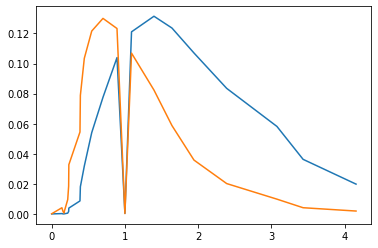

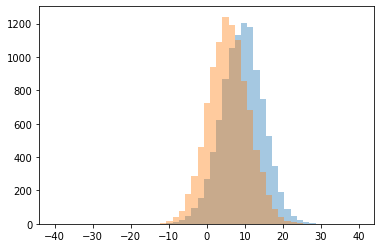

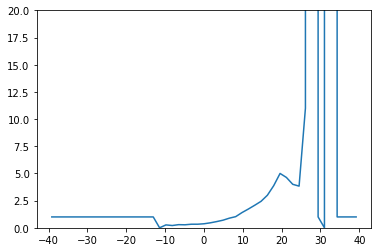

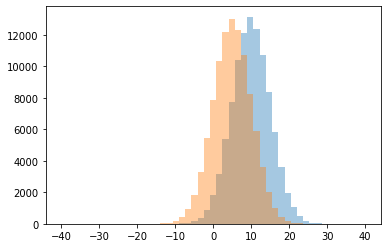

0 0.0
1 0.20930232558139536
2 0.26666666666666666
3 0.2768361581920904
4 0.2894736842105263
5 0.328719723183391
6 0.3297180043383948
7 0.37052341597796146
8 0.4575371549893843
9 0.5710357470210816
10 0.6994359387590653
11 0.8859060402684564
12 1.0
13 1.0253623188405796
14 1.4014002333722286
15 1.726608187134503
16 2.0719101123595505
17 2.435064935064935
18 2.994285714285714
19 3.8333333333333335
20 3.8777777777777778
21 4.0
22 4.631578947368421
23 5.0
24 11.0
25 999999.0




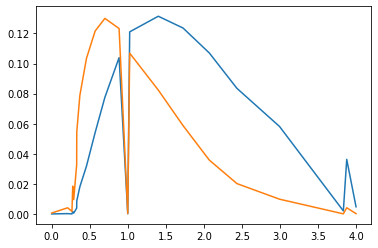

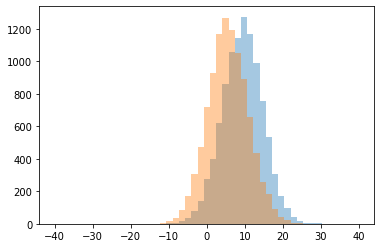

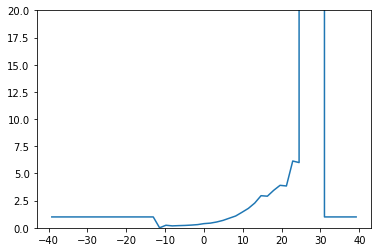

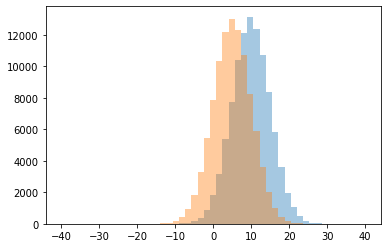

0 0.0
1 0.17647058823529413
2 0.2
3 0.21764705882352942
4 0.23529411764705882
5 0.24918032786885247
6 0.2926315789473684
7 0.3840782122905028
8 0.4294940796555436
9 0.5338474721508141
10 0.680379746835443
11 0.8842281879194631
12 1.0
13 1.0854700854700854
14 1.4282511210762332
15 1.784732824427481
16 2.272935779816514
17 2.907103825136612
18 2.953125
19 3.449438202247191
20 3.8461538461538463
21 3.9069767441860463
22 6.0
23 6.142857142857143
24 999999.0




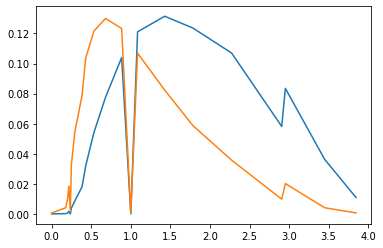

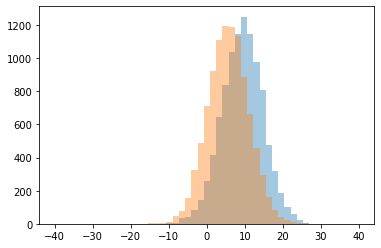

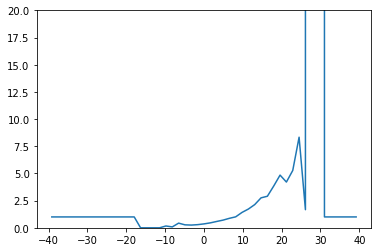

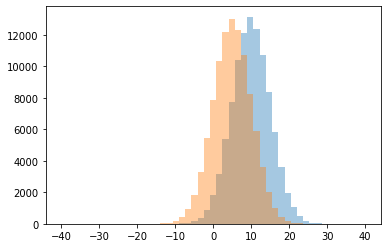

0 0.0
1 0.08163265306122448
2 0.16666666666666666
3 0.25077399380804954
4 0.2727272727272727
5 0.2889344262295082
6 0.3590462833099579
7 0.42857142857142855
8 0.45336225596529284
9 0.5825067628494139
10 0.7055369127516778
11 0.8704793944491169
12 1.0
13 1.0079295154185022
14 1.415158371040724
15 1.6666666666666667
16 1.7233082706766918
17 2.1334792122538295
18 2.7551020408163267
19 2.902439024390244
20 3.8433734939759034
21 4.208333333333333
22 4.846153846153846
23 5.2727272727272725
24 8.333333333333334
25 999999.0




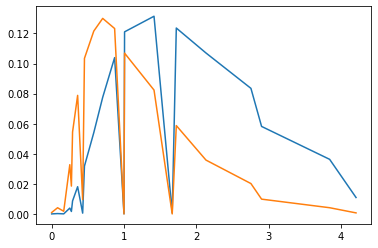

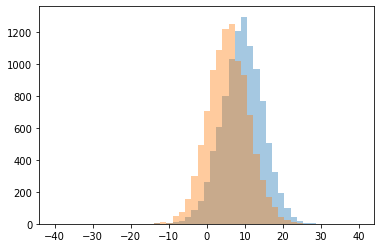

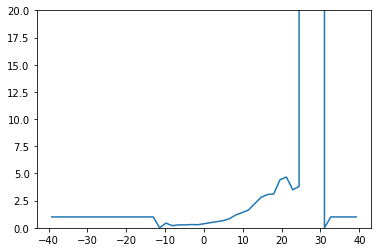

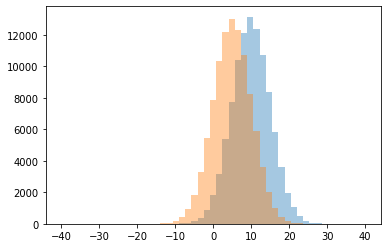

0 0.0
1 0.1956521739130435
2 0.2679738562091503
3 0.2702702702702703
4 0.2834008097165992
5 0.2996632996632997
6 0.371994342291372
7 0.42857142857142855
8 0.47406639004149376
9 0.5564738292011019
10 0.6587171052631579
11 0.8262610088070457
12 1.0
13 1.1817288801571708
14 1.39247311827957
15 1.6284875183553598
16 2.220183486238532
17 2.7992700729927007
18 3.0602409638554215
19 3.1142857142857143
20 3.5
21 3.8
22 4.431818181818182
23 4.666666666666667
24 999999.0




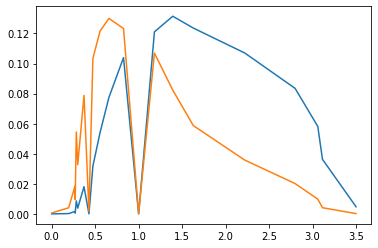

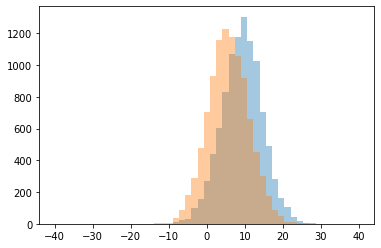

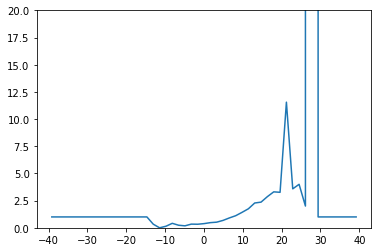

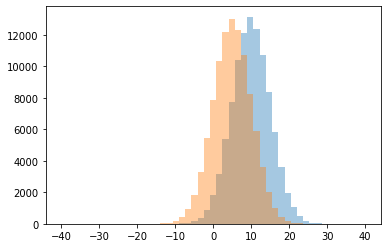

0 0.0
1 0.14285714285714285
2 0.1813186813186813
3 0.23595505617977527
4 0.3277310924369748
5 0.3333333333333333
6 0.33797909407665505
7 0.38330975954738333
8 0.4117647058823529
9 0.47368421052631576
10 0.5181034482758621
11 0.678921568627451
12 0.9066213921901528
13 1.0
14 1.111531190926276
15 1.420479302832244
16 1.7473363774733637
17 2.0
18 2.2806236080178173
19 2.3612040133779266
20 2.866279069767442
21 3.2653061224489797
22 3.3058823529411763
23 3.5833333333333335
24 4.0
25 11.555555555555555
26 999999.0




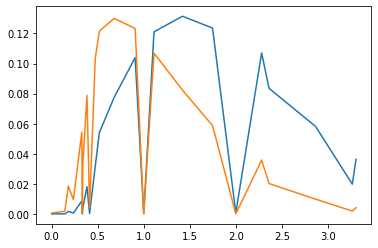

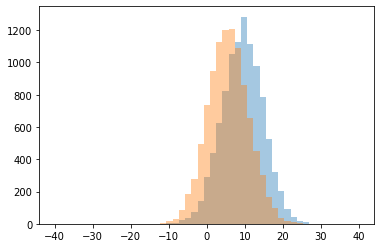

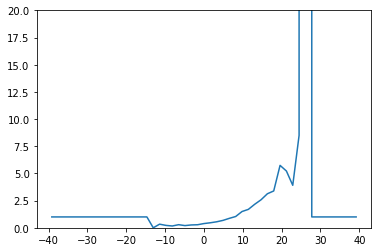

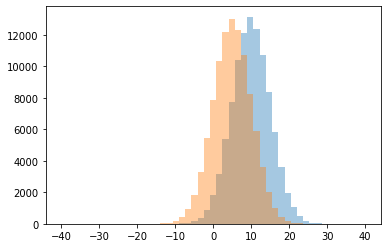

0 0.0
1 0.16666666666666666
2 0.20320855614973263
3 0.2222222222222222
4 0.2616487455197133
5 0.281947261663286
6 0.2857142857142857
7 0.3333333333333333
8 0.3902439024390244
9 0.4619450317124736
10 0.5527950310559007
11 0.6821963394342762
12 0.8698175787728026
13 1.0
14 1.0386384544618215
15 1.49708284714119
16 1.6951219512195121
17 2.164079822616408
18 2.577049180327869
19 3.130952380952381
20 3.389473684210526
21 3.909090909090909
22 5.222222222222222
23 5.742857142857143
24 8.5
25 999999.0




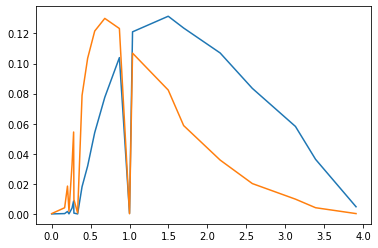

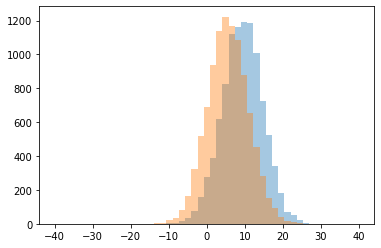

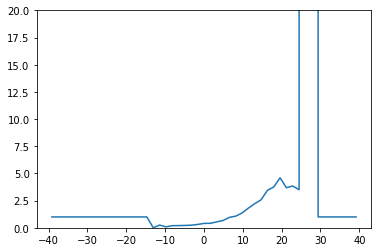

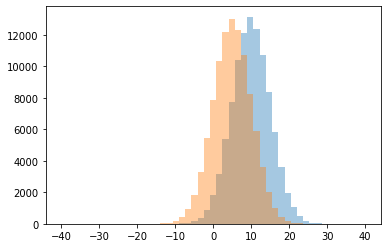

0 0.0
1 0.08695652173913043
2 0.19444444444444445
3 0.20481927710843373
4 0.21686746987951808
5 0.2392638036809816
6 0.25
7 0.3076923076923077
8 0.4031791907514451
9 0.4132055378061768
10 0.5408252853380158
11 0.6737530662305805
12 0.9580838323353293
13 1.0
14 1.070902394106814
15 1.3572241183162685
16 1.8076335877862595
17 2.2158590308370045
18 2.5709219858156027
19 3.4444444444444446
20 3.5
21 3.6842105263157894
22 3.7472527472527473
23 3.8461538461538463
24 4.6
25 999999.0




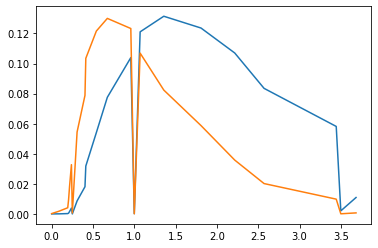

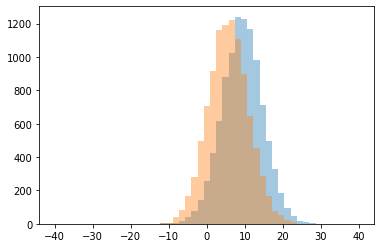

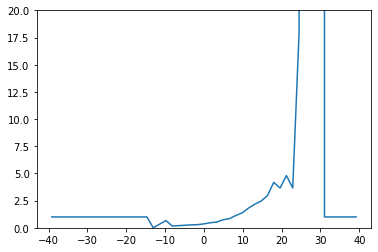

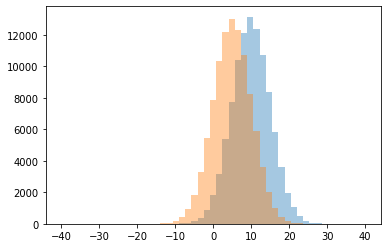

0 0.0
1 0.16666666666666666
2 0.19753086419753085
3 0.23353293413173654
4 0.2697841726618705
5 0.289738430583501
6 0.3333333333333333
7 0.3622159090909091
8 0.4671772428884026
9 0.529664660361135
10 0.6666666666666666
11 0.7367979882648784
12 0.8387888707037643
13 1.0
14 1.123076923076923
15 1.3666666666666667
16 1.802773497688752
17 2.168141592920354
18 2.4567474048442905
19 2.9467455621301775
20 3.66
21 3.6666666666666665
22 4.177215189873418
23 4.8
24 18.0
25 999999.0




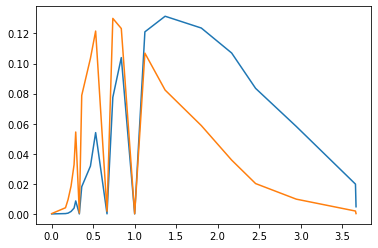

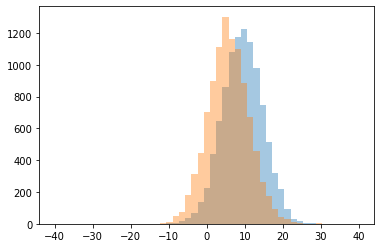

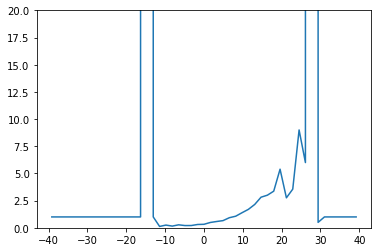

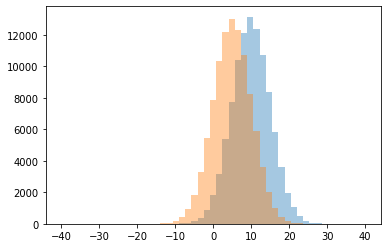

0 0.125
1 0.1568627450980392
2 0.20670391061452514
3 0.2090032154340836
4 0.25
5 0.273972602739726
6 0.30493273542600896
7 0.32193732193732194
8 0.489432703003337
9 0.5
10 0.579372197309417
11 0.659247889485802
12 0.9277730008598453
13 1.0
14 1.0653950953678475
15 1.3864406779661016
16 1.6943620178041543
17 2.146288209606987
18 2.757575757575758
19 2.8150943396226413
20 3.0
21 3.3684210526315788
22 3.5555555555555554
23 5.390243902439025
24 6.0
25 9.0
26 999999.0




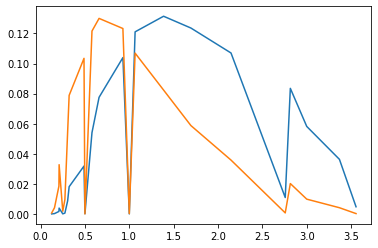

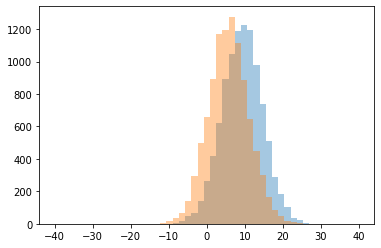

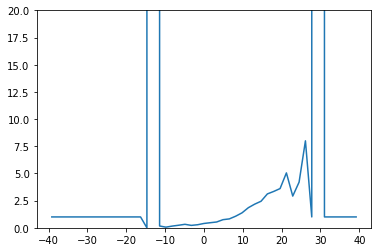

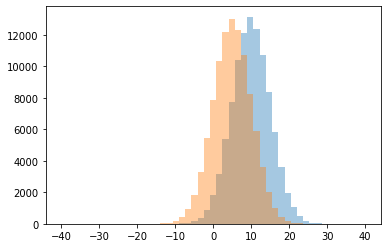

0 0.0
1 0.058823529411764705
2 0.15789473684210525
3 0.16666666666666666
4 0.2226027397260274
5 0.23529411764705882
6 0.282
7 0.32142857142857145
8 0.3990895295902883
9 0.4681564245810056
10 0.5342465753424658
11 0.7474916387959866
12 0.8189655172413793
13 1.0
14 1.0672645739910314
15 1.37570303712036
16 1.8500772797527048
17 2.1755555555555555
18 2.442244224422442
19 2.9166666666666665
20 3.1165644171779143
21 3.3448275862068964
22 3.607843137254902
23 4.2
24 5.05
25 8.0
26 999999.0




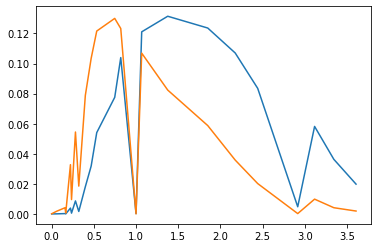

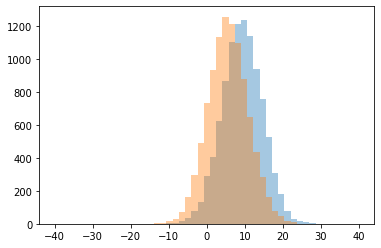

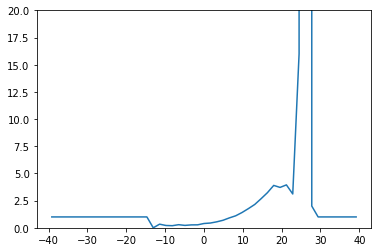

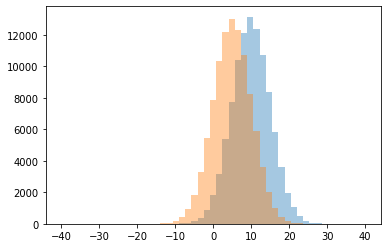

0 0.0
1 0.1935483870967742
2 0.21428571428571427
3 0.2222222222222222
4 0.2668918918918919
5 0.2729124236252546
6 0.2857142857142857
7 0.3333333333333333
8 0.3953488372093023
9 0.4376344086021505
10 0.5476190476190477
11 0.6918789808917197
12 0.9102141680395387
13 1.0
14 1.1031021897810218
15 1.4061433447098977
16 1.7623456790123457
17 2.0
18 2.1441647597254003
19 2.6713780918727914
20 3.111111111111111
21 3.226993865030675
22 3.7142857142857144
23 3.8987341772151898
24 3.9473684210526314
25 16.0
26 999999.0




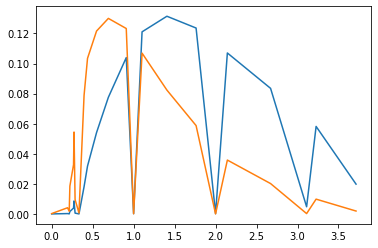

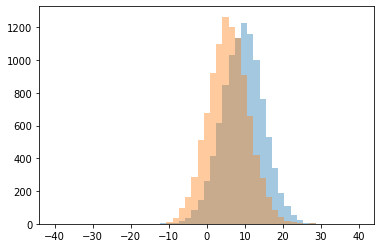

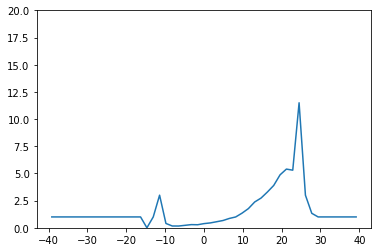

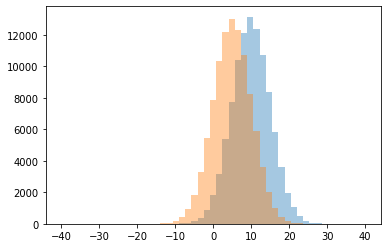

0 0.0
1 0.16326530612244897
2 0.16666666666666666
3 0.22699386503067484
4 0.28094302554027506
5 0.2926829268292683
6 0.3851851851851852
7 0.4
8 0.4491341991341991
9 0.55858310626703
10 0.6703557312252965
11 0.8609492089925063
12 0.9964819700967458
13 1.0
14 1.3333333333333333
15 1.3465346534653466
16 1.763277693474962
17 2.375296912114014
18 2.7347670250896057
19 3.0
20 3.2901234567901234
21 3.896551724137931
22 4.871794871794871
23 5.3
24 5.4
25 11.5




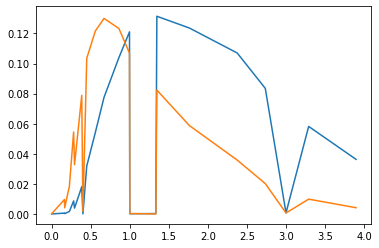

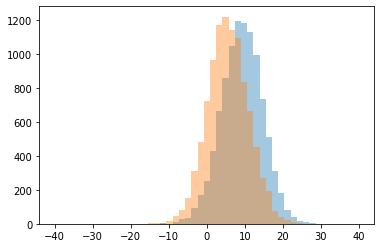

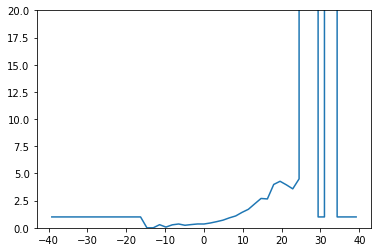

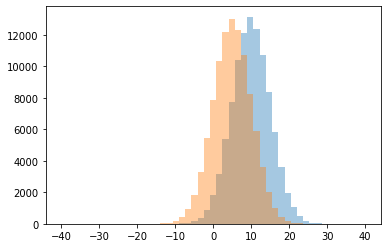

0 0.0
1 0.06666666666666667
2 0.23333333333333334
3 0.2727272727272727
4 0.2857142857142857
5 0.2977346278317152
6 0.34854771784232363
7 0.35
8 0.3525773195876289
9 0.4420289855072464
10 0.565587734241908
11 0.7029459901800328
12 0.9136125654450262
13 1.0
14 1.089171974522293
15 1.4179640718562874
16 1.7012012012012012
17 2.2035398230088497
18 2.654639175257732
19 2.698529411764706
20 3.5833333333333335
21 3.95
22 3.9871794871794872
23 4.27906976744186
24 4.5
25 999999.0




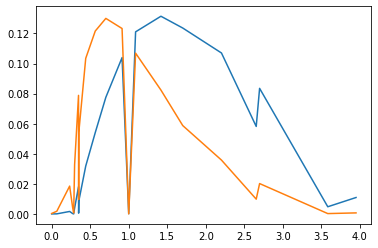

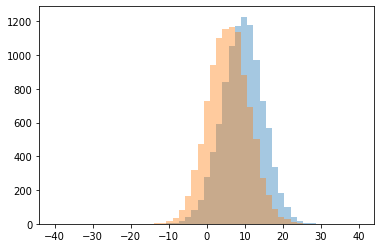

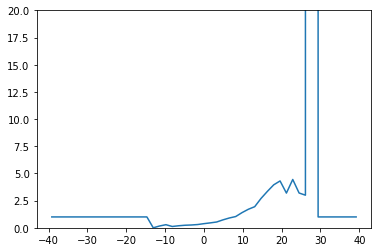

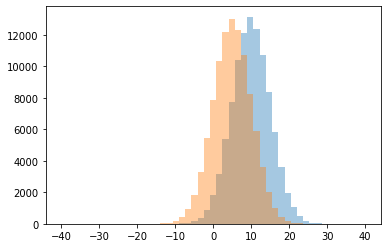

0 0.0
1 0.12121212121212122
2 0.16666666666666666
3 0.1875
4 0.2345679012345679
5 0.2578616352201258
6 0.2857142857142857
7 0.29957805907172996
8 0.38154269972451793
9 0.4527098831030818
10 0.5335144927536232
11 0.7311361665221162
12 0.9023972602739726
13 1.0
14 1.034330985915493
15 1.3954545454545455
16 1.7047756874095514
17 1.942
18 2.7026022304832713
19 3.0
20 3.193548387096774
21 3.2
22 3.3491124260355027
23 3.9529411764705884
24 4.309523809523809
25 4.444444444444445
26 999999.0




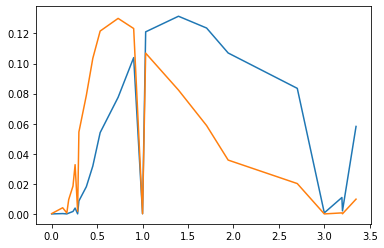

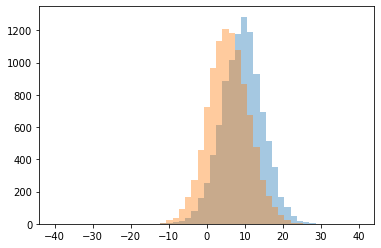

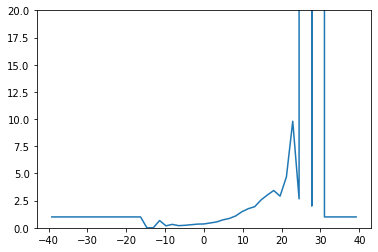

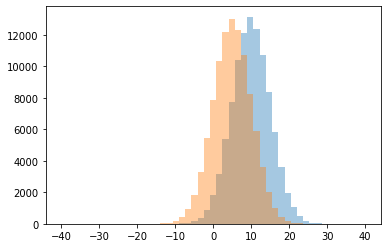

0 0.0
1 0.18181818181818182
2 0.1978021978021978
3 0.23030303030303031
4 0.28413284132841327
5 0.3142857142857143
6 0.3405639913232104
7 0.35318559556786705
8 0.4451345755693582
9 0.5405643738977073
10 0.6666666666666666
11 0.7326158940397351
12 0.8597972972972973
13 1.0
14 1.091581868640148
15 1.4838337182448036
16 1.76
17 1.941544885177453
18 2.0
19 2.5608856088560885
20 2.6666666666666665
21 2.912280701754386
22 3.017543859649123
23 3.4313725490196076
24 4.681818181818182
25 9.8
26 999999.0




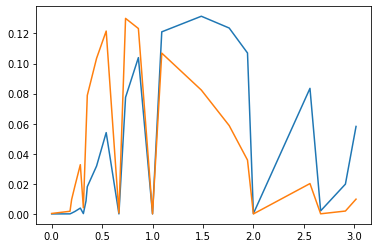

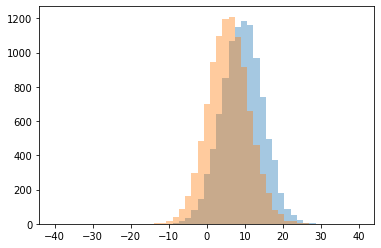

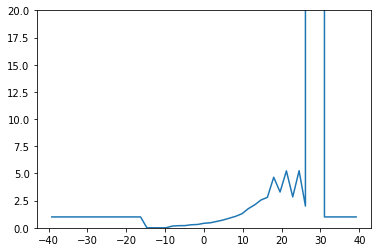

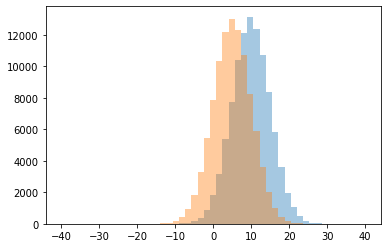

0 0.0
1 0.15789473684210525
2 0.19540229885057472
3 0.20245398773006135
4 0.2789115646258503
5 0.3049792531120332
6 0.41512125534950073
7 0.4604012671594509
8 0.5850773430391265
9 0.7135678391959799
10 0.8842018196856907
11 1.0
12 1.0560146923783287
13 1.2979189485213583
14 1.762917933130699
15 2.0
16 2.111111111111111
17 2.5605536332179932
18 2.8022598870056497
19 2.8421052631578947
20 3.290909090909091
21 4.65
22 5.235294117647059
23 5.25
24 999999.0




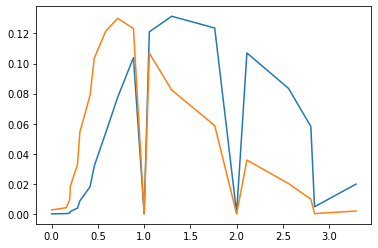

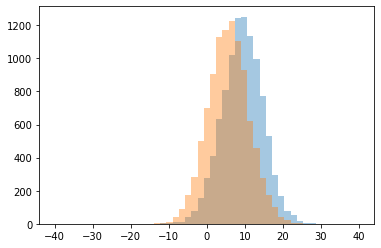

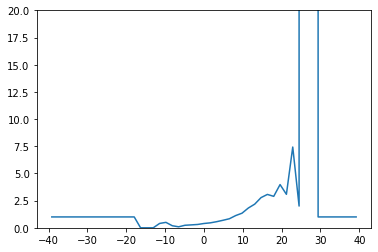

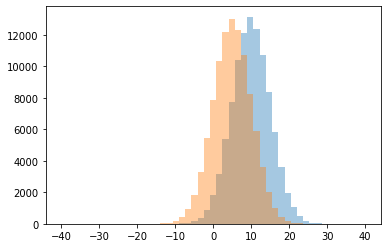

0 0.0
1 0.09090909090909091
2 0.19047619047619047
3 0.23295454545454544
4 0.26785714285714285
5 0.3061630218687873
6 0.39628040057224606
7 0.4
8 0.4557522123893805
9 0.5
10 0.562444641275465
11 0.6917164816396243
12 0.8312958435207825
13 1.0
14 1.1246612466124661
15 1.3433476394849786
16 1.8218298555377208
17 2.0
18 2.1742919389978215
19 2.776978417266187
20 2.8932038834951457
21 3.069364161849711
22 3.08
23 3.9767441860465116
24 7.428571428571429
25 999999.0




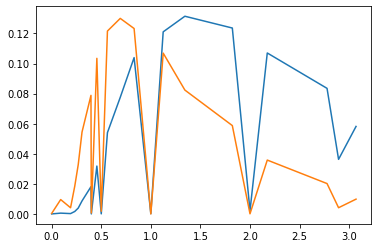

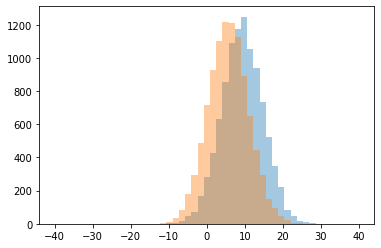

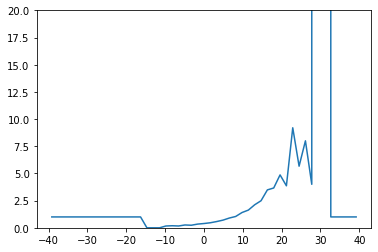

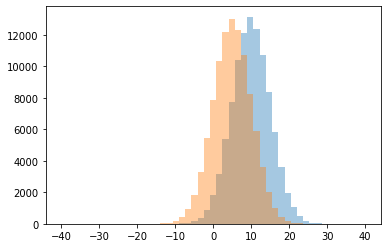

0 0.0
1 0.16666666666666666
2 0.1891891891891892
3 0.2356902356902357
4 0.2598870056497175
5 0.3408624229979466
6 0.39330543933054396
7 0.4632829373650108
8 0.574410163339383
9 0.7055921052631579
10 0.8978583196046128
11 1.0
12 1.0417777777777777
13 1.4049493813273342
14 1.6286594761171032
15 2.119369369369369
16 2.489795918367347
17 3.486666666666667
18 3.663157894736842
19 3.8636363636363638
20 4.0
21 4.866666666666666
22 5.666666666666667
23 8.0
24 9.2
25 999999.0




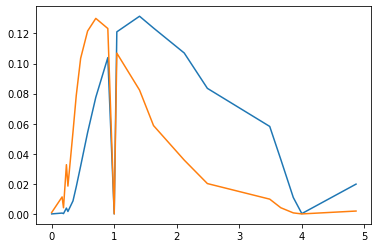

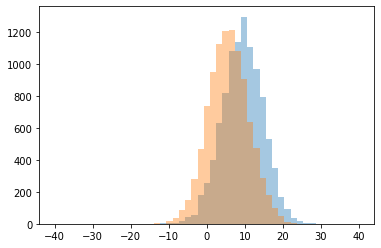

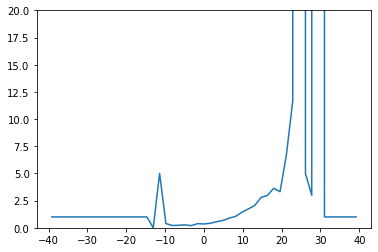

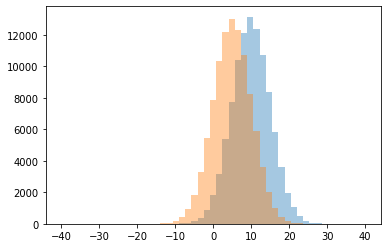

0 0.0
1 0.19784172661870503
2 0.21052631578947367
3 0.23529411764705882
4 0.2684563758389262
5 0.35006784260515605
6 0.38085106382978723
7 0.3888888888888889
8 0.41789473684210526
9 0.5595026642984015
10 0.6746490503715937
11 0.8910891089108911
12 1.0
13 1.0536044362292052
14 1.434254143646409
15 1.7362637362637363
16 2.0529661016949152
17 2.788732394366197
18 2.9775280898876404
19 3.0
20 3.32
21 3.6354166666666665
22 5.0
23 6.714285714285714
24 11.666666666666666
25 999999.0




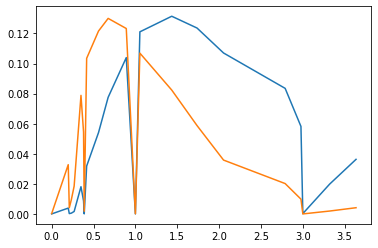

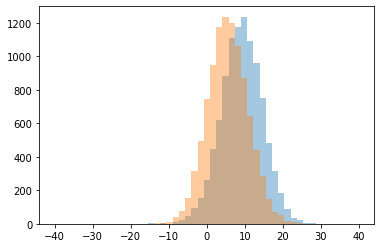

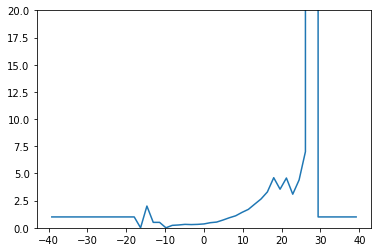

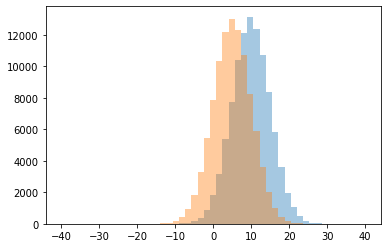

0 0.0
1 0.225
2 0.2597402597402597
3 0.2961783439490446
4 0.3150406504065041
5 0.3157894736842105
6 0.3557951482479784
7 0.4694092827004219
8 0.5
9 0.5268542199488491
10 0.7144012944983819
11 0.9233971690258118
12 1.0
13 1.1043233082706767
14 1.4188722669735327
15 1.6940993788819876
16 2.0
17 2.176470588235294
18 2.6514084507042255
19 3.090909090909091
20 3.2993197278911564
21 3.549019607843137
22 4.4
23 4.578947368421052
24 4.608695652173913
25 7.0
26 999999.0




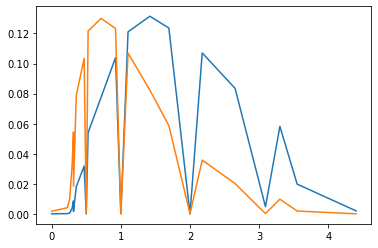

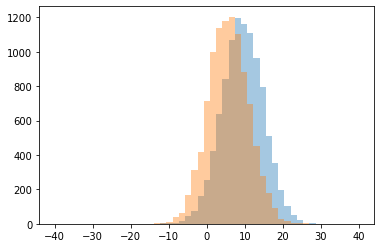

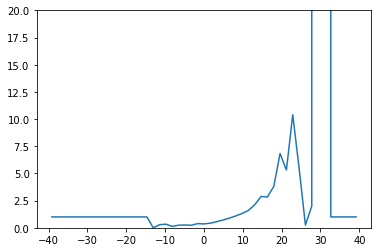

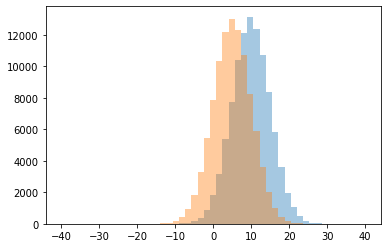

0 0.0
1 0.13157894736842105
2 0.2347266881028939
3 0.24193548387096775
4 0.25
5 0.25882352941176473
6 0.2857142857142857
7 0.3333333333333333
8 0.3576437587657784
9 0.3827751196172249
10 0.4228456913827655
11 0.5620052770448549
12 0.7156196943972836
13 0.8878737541528239
14 1.0
15 1.086285195277021
16 1.3167420814479638
17 1.5905172413793103
18 2.0
19 2.1186813186813187
20 2.8287292817679557
21 2.880434782608696
22 3.795698924731183
23 5.315789473684211
24 5.5
25 6.827586206896552
26 10.4
27 999999.0




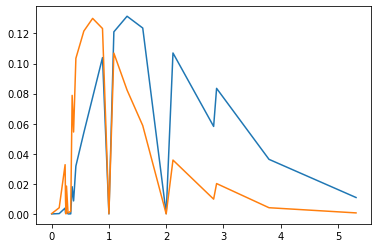

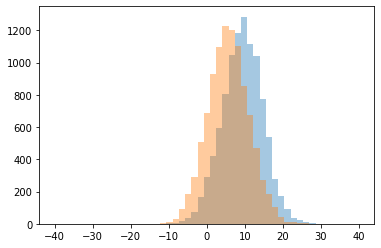

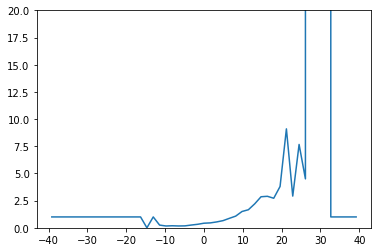

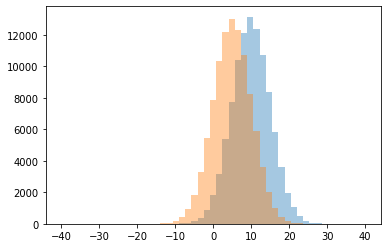

0 0.0
1 0.16666666666666666
2 0.16853932584269662
3 0.1774193548387097
4 0.1875
5 0.25
6 0.2534722222222222
7 0.32220039292730845
8 0.42212518195050946
9 0.4514038876889849
10 0.5400728597449909
11 0.6577017114914425
12 0.8696013289036545
13 1.0
14 1.0733031674208144
15 1.5
16 1.6607142857142858
17 2.2029598308668077
18 2.7184466019417477
19 2.8555555555555556
20 2.8978494623655915
21 2.9166666666666665
22 3.8
23 4.5
24 7.666666666666667
25 9.1
26 999999.0




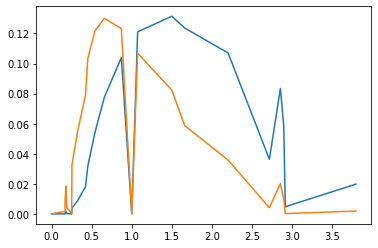

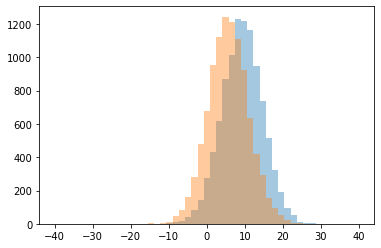

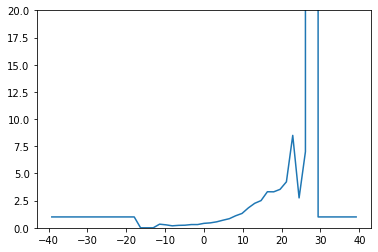

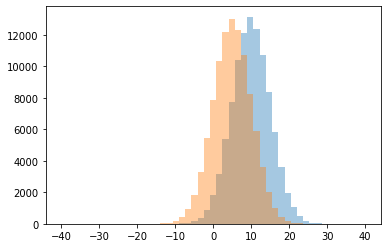

0 0.0
1 0.18181818181818182
2 0.225
3 0.2389937106918239
4 0.2727272727272727
5 0.2976939203354298
6 0.2978723404255319
7 0.3333333333333333
8 0.4091580502215657
9 0.45320715036803366
10 0.5493333333333333
11 0.6993569131832797
12 0.8384171475680132
13 1.0
14 1.1078167115902966
15 1.3203463203463204
16 1.8320251177394034
17 2.2523809523809524
18 2.503401360544218
19 2.75
20 3.3092783505154637
21 3.3161290322580643
22 3.537037037037037
23 4.2272727272727275
24 7.0
25 8.5
26 999999.0




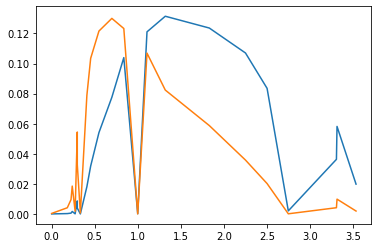

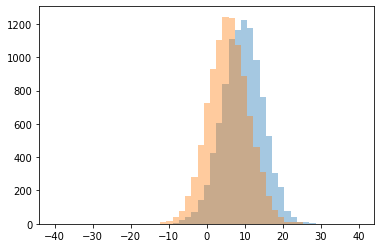

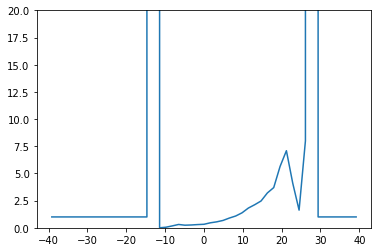

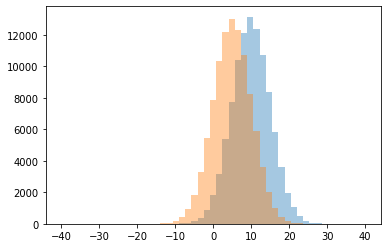

0 0.0
1 0.05263157894736842
2 0.175
3 0.23952095808383234
4 0.2597864768683274
5 0.2966101694915254
6 0.30666666666666664
7 0.3236914600550964
8 0.4581545064377682
9 0.5471014492753623
10 0.6757843925985519
11 0.8956310679611651
12 1.0
13 1.084033613445378
14 1.3772522522522523
15 1.625
16 1.816358024691358
17 2.123110151187905
18 2.466019417475728
19 3.207317073170732
20 3.6987951807228914
21 4.1
22 5.641025641025641
23 7.090909090909091
24 8.0
25 999999.0




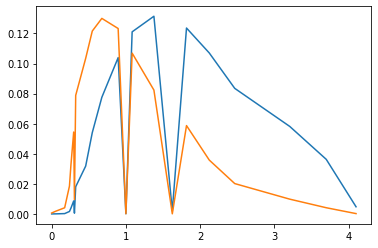

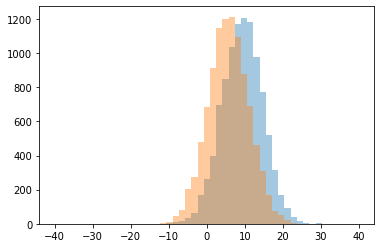

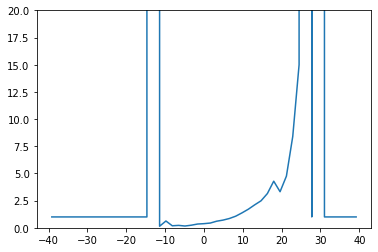

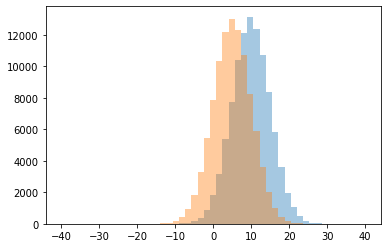

0 0.14285714285714285
1 0.16417910447761194
2 0.18604651162790697
3 0.2222222222222222
4 0.23897058823529413
5 0.3471933471933472
6 0.3806734992679356
7 0.437636761487965
8 0.606457242582897
9 0.625
10 0.7077435470441299
11 0.854080791426216
12 1.0
13 1.0666058394160585
14 1.3744292237442923
15 1.7115942028985507
16 2.1123110151187907
17 2.4838709677419355
18 3.1506024096385543
19 3.32
20 4.287671232876712
21 4.75
22 8.4
23 15.0
24 999999.0




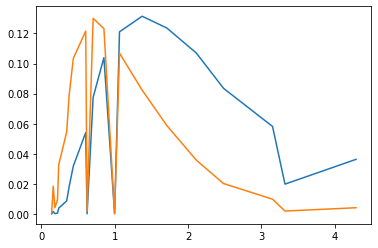

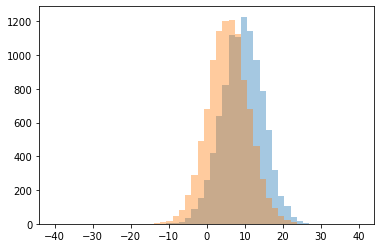

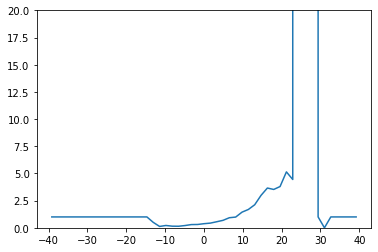

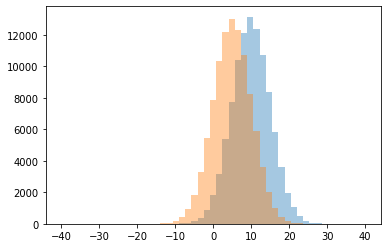

0 0.0
1 0.125
2 0.14285714285714285
3 0.14893617021276595
4 0.20710059171597633
5 0.21428571428571427
6 0.2961672473867596
7 0.3054989816700611
8 0.37774524158125916
9 0.43034055727554177
10 0.5
11 0.5559440559440559
12 0.6855241264559068
13 0.9261410788381743
14 0.9866548042704626
15 1.0
16 1.4401408450704225
17 1.6858407079646018
18 2.1198257080610023
19 2.984848484848485
20 3.5274725274725274
21 3.6578947368421053
22 3.7954545454545454
23 4.444444444444445
24 5.142857142857143
25 999999.0




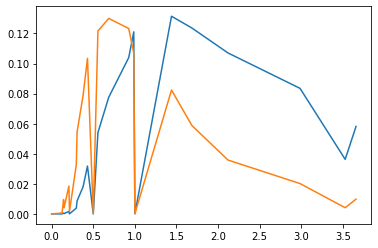

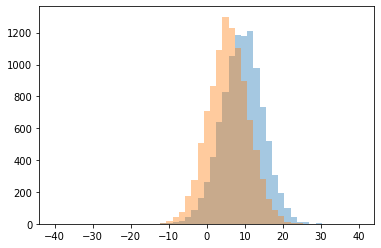

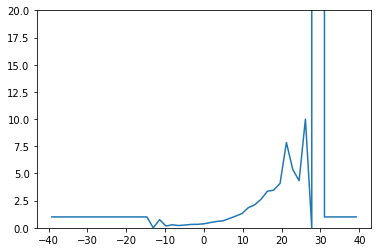

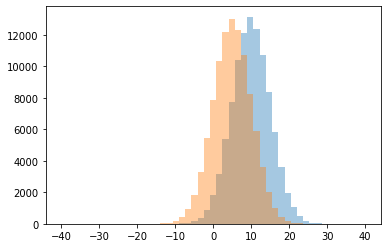

0 0.0
1 0.16666666666666666
2 0.21052631578947367
3 0.2543352601156069
4 0.275
5 0.31386861313868614
6 0.3188976377952756
7 0.36827195467422097
8 0.4809688581314879
9 0.5875343721356554
10 0.6376923076923077
11 0.75
12 0.8537774167343624
13 1.0
14 1.0744777475022707
15 1.3129175946547884
16 1.8529862174578866
17 2.116883116883117
18 2.625
19 3.361290322580645
20 3.465909090909091
21 4.083333333333333
22 4.333333333333333
23 5.375
24 7.846153846153846
25 10.0
26 999999.0




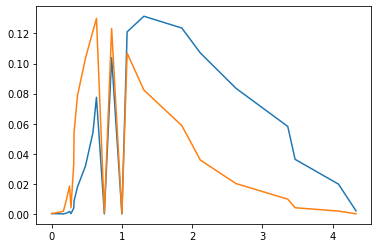

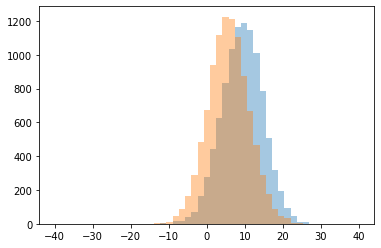

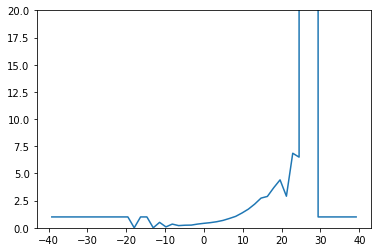

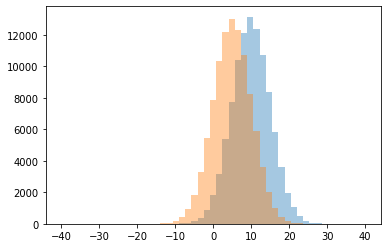

0 0.0
1 0.08333333333333333
2 0.20224719101123595
3 0.23780487804878048
4 0.2482758620689655
5 0.3409090909090909
6 0.34297520661157027
7 0.4124629080118694
8 0.47334754797441364
9 0.5
10 0.5581395348837209
11 0.6791836734693878
12 0.8569065343258891
13 1.0
14 1.051490514905149
15 1.3623853211009174
16 1.7166416791604198
17 2.1810344827586206
18 2.731707317073171
19 2.8857142857142857
20 2.90625
21 3.686046511627907
22 4.409090909090909
23 6.5
24 6.857142857142857
25 999999.0




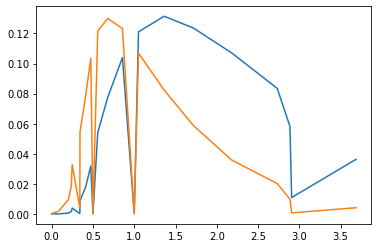

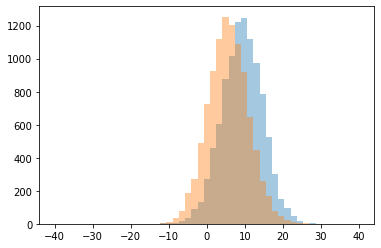

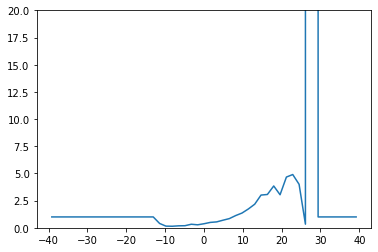

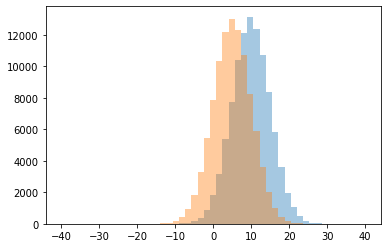

0 0.14285714285714285
1 0.15384615384615385
2 0.18181818181818182
3 0.1925133689839572
4 0.27494908350305497
5 0.3271375464684015
6 0.3333333333333333
7 0.3729281767955801
8 0.4
9 0.4962243797195254
10 0.5434198746642793
11 0.6985645933014354
12 0.8453865336658354
13 1.0
14 1.1252302025782688
15 1.357608695652174
16 1.7321981424148607
17 2.169642857142857
18 3.0114942528735633
19 3.0408163265306123
20 3.064327485380117
21 3.8461538461538463
22 4.0
23 4.666666666666667
24 4.9
25 999999.0




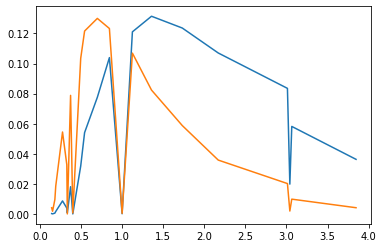

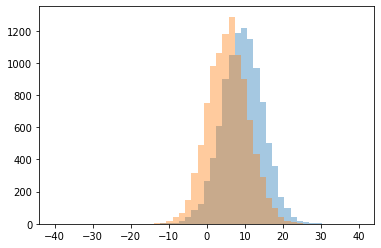

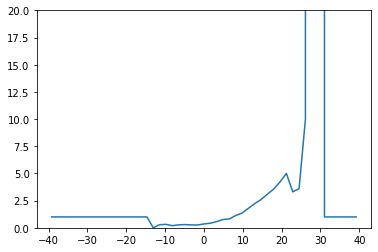

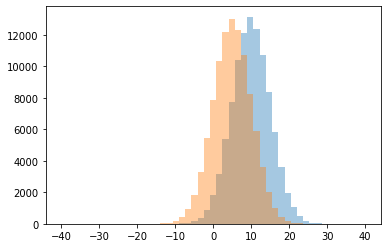

0 0.0
1 0.1951219512195122
2 0.2581967213114754
3 0.2626582278481013
4 0.2727272727272727
5 0.2857142857142857
6 0.296551724137931
7 0.3157894736842105
8 0.3550531914893617
9 0.418200408997955
10 0.5729068673565381
11 0.7614601018675722
12 0.8142968142968143
13 1.0
14 1.1338432122370936
15 1.3518930957683741
16 1.7900466562986004
17 2.2224770642201834
18 2.597938144329897
19 3.0920245398773005
20 3.3076923076923075
21 3.5643564356435644
22 3.6
23 4.225
24 5.0
25 10.0
26 999999.0




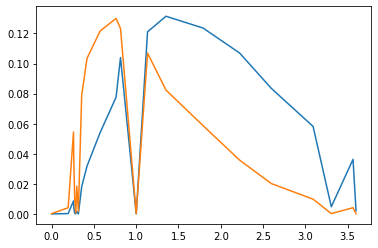

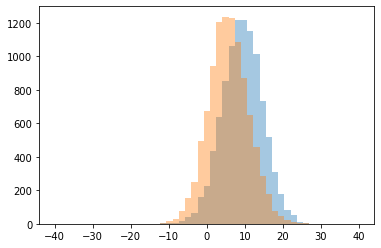

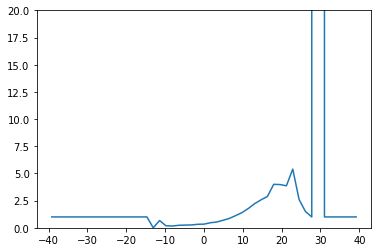

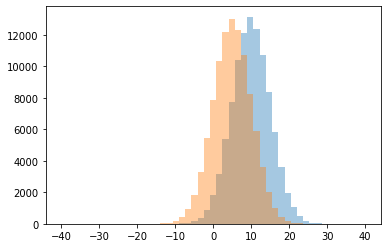

0 0.0
1 0.16666666666666666
2 0.1875
3 0.22784810126582278
4 0.25
5 0.26
6 0.3225152129817444
7 0.33580980683506684
8 0.46390658174097665
9 0.5295095594347464
10 0.6666666666666666
11 0.6909385113268608
12 0.8619008935824533
13 1.0
14 1.1216589861751152
15 1.3979357798165137
16 1.5
17 1.779320987654321
18 2.223684210526316
19 2.5719298245614035
20 2.6
21 2.88268156424581
22 3.8636363636363638
23 3.977272727272727
24 4.0
25 5.4
26 999999.0




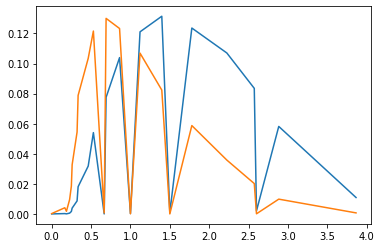

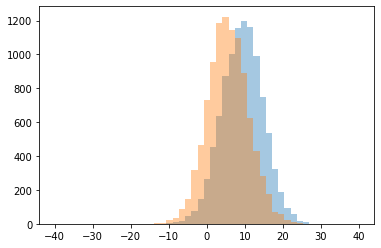

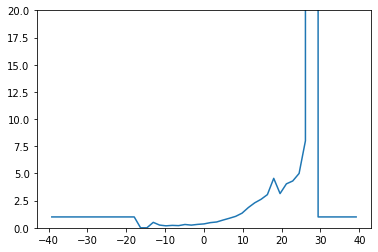

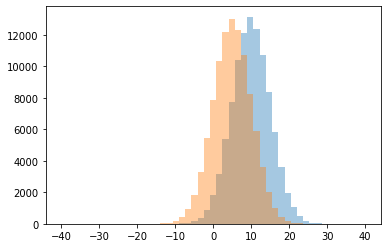

0 0.0
1 0.18181818181818182
2 0.2
3 0.2222222222222222
4 0.2468354430379747
5 0.25
6 0.30405405405405406
7 0.3139784946236559
8 0.35792349726775957
9 0.47489539748953974
10 0.5
11 0.5353535353535354
12 0.7113654946852003
13 0.8760907504363001
14 1.0
15 1.0536851683348498
16 1.3442069741282339
17 1.8637820512820513
18 2.2962962962962963
19 2.6210526315789475
20 3.0514285714285716
21 3.15
22 4.043478260869565
23 4.3076923076923075
24 4.549295774647887
25 5.0
26 8.0
27 999999.0




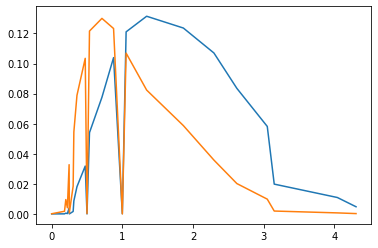

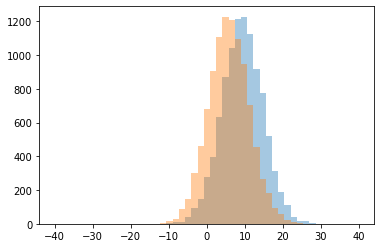

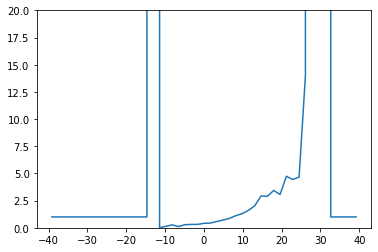

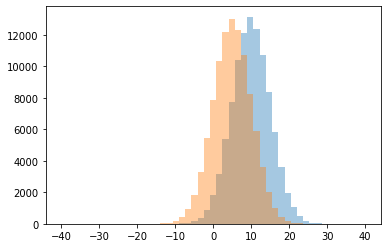

0 0.0
1 0.11764705882352941
2 0.14285714285714285
3 0.26666666666666666
4 0.2857142857142857
5 0.31
6 0.3146551724137931
7 0.4108983799705449
8 0.4375690607734807
9 0.5732368896925859
10 0.7126530612244898
11 0.8650662251655629
12 1.0
13 1.1095890410958904
14 1.2980972515856237
15 1.5963172804532577
16 2.022075055187638
17 2.8944444444444444
18 2.924812030075188
19 3.0655737704918034
20 3.4347826086956523
21 4.444444444444445
22 4.666666666666667
23 4.739130434782608
24 14.0
25 999999.0




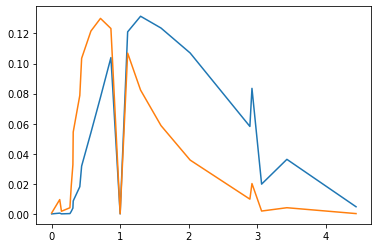

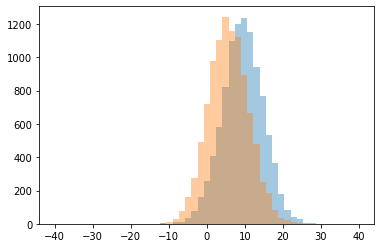

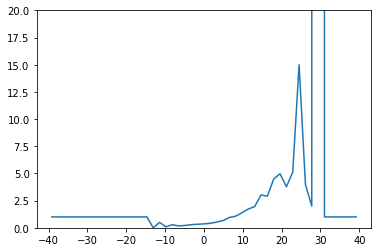

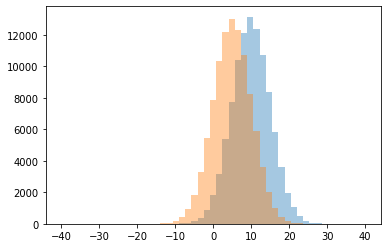

0 0.0
1 0.09090909090909091
2 0.16883116883116883
3 0.21604938271604937
4 0.2851985559566787
5 0.2857142857142857
6 0.32790224032586557
7 0.36022253129346316
8 0.4155578300921187
9 0.5
10 0.5262681159420289
11 0.662379421221865
12 0.9524221453287197
13 1.0
14 1.0686274509803921
15 1.3856502242152466
16 1.7297297297297298
17 1.9521829521829521
18 2.0
19 2.907103825136612
20 3.0236220472440944
21 3.772727272727273
22 4.0
23 4.493827160493828
24 4.972222222222222
25 5.125
26 15.0
27 999999.0




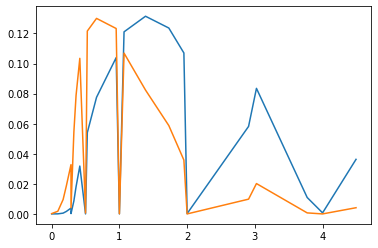

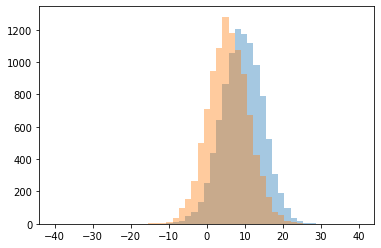

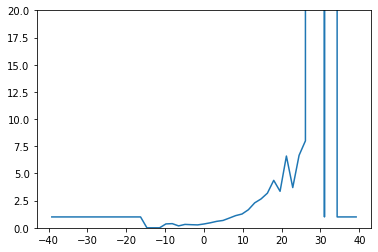

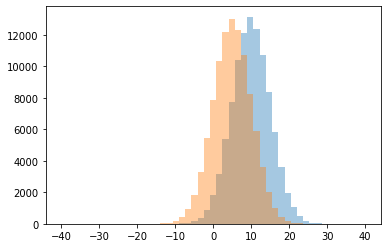

0 0.0
1 0.17525773195876287
2 0.26706827309236947
3 0.2857142857142857
4 0.3116883116883117
5 0.35161744022503516
6 0.35714285714285715
7 0.38235294117647056
8 0.459830866807611
9 0.5926267281105991
10 0.6752537080405933
11 0.8949152542372881
12 1.0
13 1.120817843866171
14 1.267529665587918
15 1.6602373887240356
16 2.2950819672131146
17 2.6543624161073827
18 3.182926829268293
19 3.357142857142857
20 3.7
21 4.366197183098592
22 6.6
23 6.666666666666667
24 8.0
25 999999.0




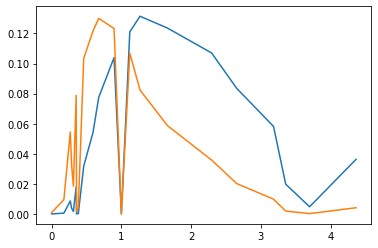

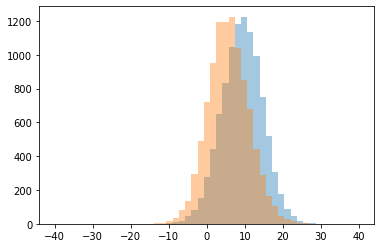

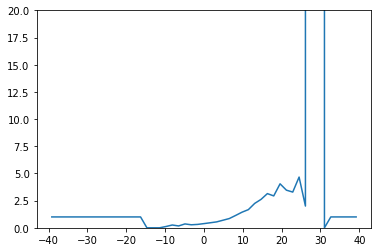

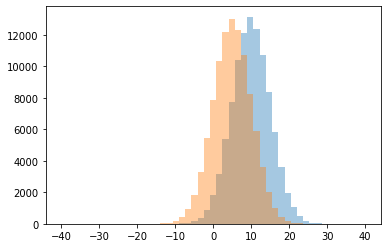

0 0.0
1 0.11764705882352941
2 0.17073170731707318
3 0.2571428571428571
4 0.2773972602739726
5 0.3122448979591837
6 0.3560606060606061
7 0.3855755894590846
8 0.4636459430979979
9 0.5440067057837384
10 0.6968174204355109
11 0.8521241830065359
12 1.0
13 1.1388621022179364
14 1.436107854630715
15 1.6705882352941177
16 2.0
17 2.244343891402715
18 2.6145833333333335
19 2.933333333333333
20 3.144578313253012
21 3.2857142857142856
22 3.4615384615384617
23 4.045454545454546
24 4.666666666666667
25 999999.0




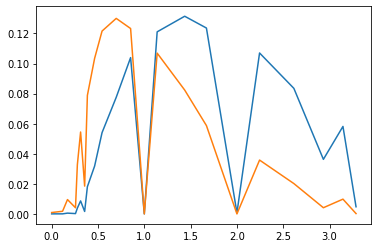

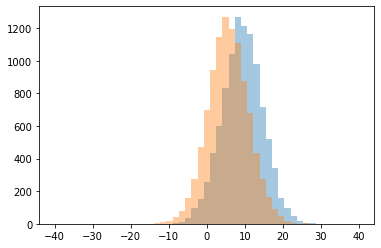

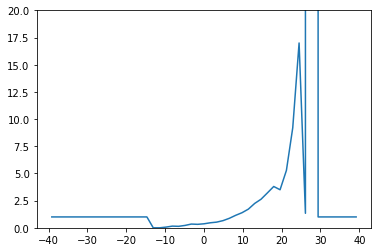

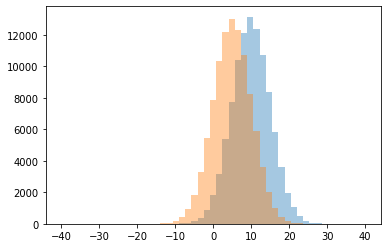

0 0.0
1 0.0625
2 0.13580246913580246
3 0.15384615384615385
4 0.21739130434782608
5 0.3192389006342495
6 0.34296028880866425
7 0.3681948424068768
8 0.46129374337221635
9 0.5218531468531469
10 0.6587677725118484
11 0.8729096989966555
12 1.0
13 1.1482820976491863
14 1.3333333333333333
15 1.3878718535469108
16 1.7172312223858615
17 2.242562929061785
18 2.6286764705882355
19 3.208588957055215
20 3.5
21 3.8
22 5.277777777777778
23 9.2
24 17.0
25 999999.0




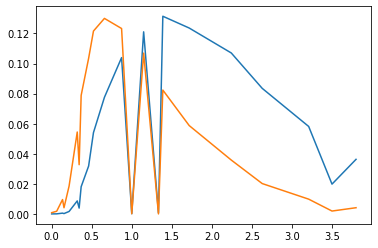

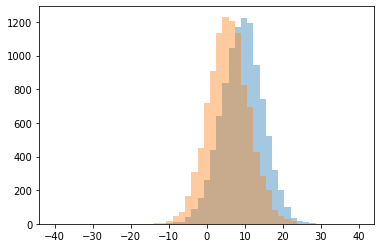

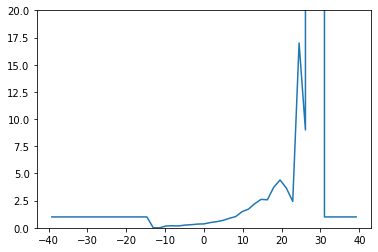

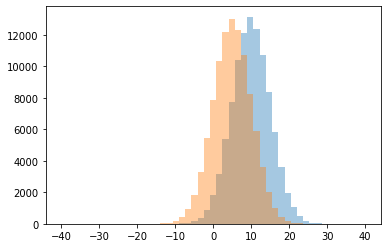

0 0.0
1 0.16666666666666666
2 0.16901408450704225
3 0.1875
4 0.25
5 0.2857142857142857
6 0.34151785714285715
7 0.3597222222222222
8 0.48180815876515987
9 0.5639894086496028
10 0.6815597075548334
11 0.8703241895261845
12 1.0
13 1.0317460317460319
14 1.4818401937046004
15 1.7136690647482014
16 2.211267605633803
17 2.4285714285714284
18 2.5763546798029555
19 2.612676056338028
20 3.642857142857143
21 3.7294117647058824
22 4.4
23 9.0
24 17.0
25 999999.0




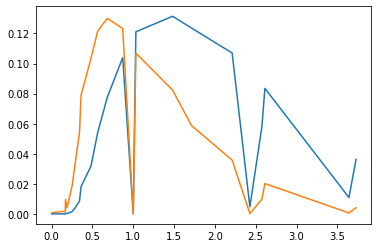

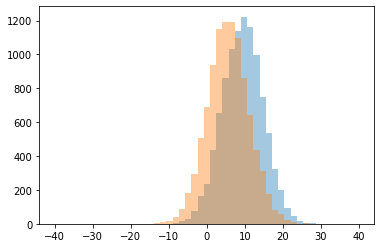

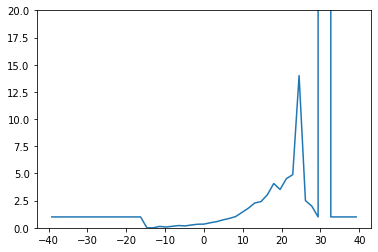

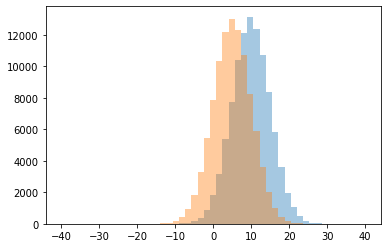

0 0.0
1 0.07142857142857142
2 0.125
3 0.13953488372093023
4 0.17032967032967034
5 0.20689655172413793
6 0.2585034013605442
7 0.32741617357001973
8 0.3386627906976744
9 0.46325878594249204
10 0.5664639443961772
11 0.7260504201680672
12 0.8634840871021775
13 1.0
14 1.0336363636363637
15 1.4171494785631518
16 1.8040435458786936
17 2.0
18 2.279816513761468
19 2.414239482200647
20 2.5
21 3.0395480225988702
22 3.526315789473684
23 4.075
24 4.523809523809524
25 4.888888888888889
26 14.0
27 999999.0




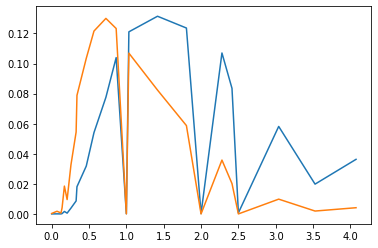

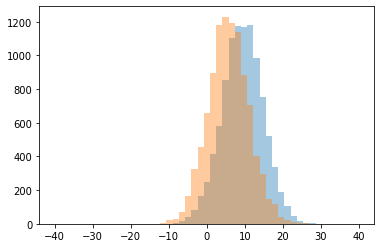

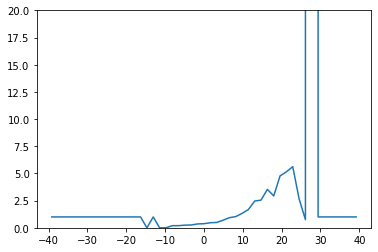

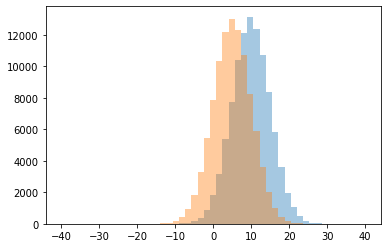

0 0.0
1 0.1935483870967742
2 0.19718309859154928
3 0.24404761904761904
4 0.25925925925925924
5 0.35667396061269147
6 0.37652439024390244
7 0.4659217877094972
8 0.4915254237288136
9 0.6943089430894309
10 0.75
11 0.9294117647058824
12 1.0
13 1.0271453590192645
14 1.3216704288939052
15 1.678520625889047
16 2.4613466334164587
17 2.5472972972972974
18 2.6666666666666665
19 2.9304347826086956
20 3.5337837837837838
21 4.775
22 5.15
23 5.625
24 999999.0




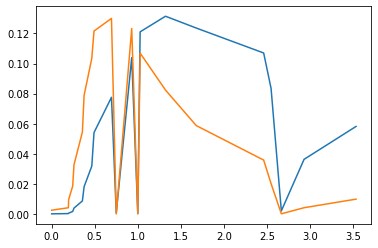

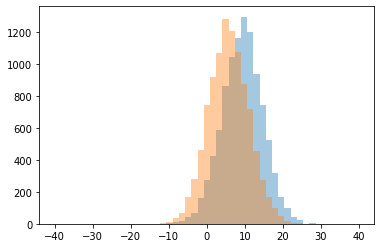

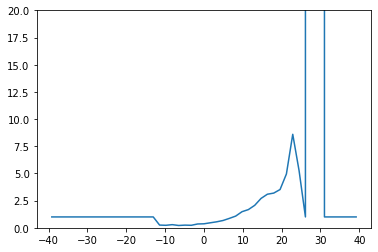

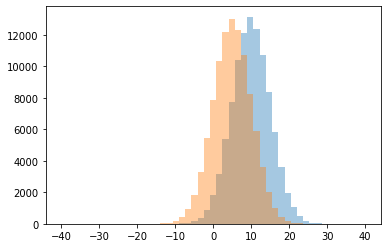

0 0.21428571428571427
1 0.23049645390070922
2 0.23076923076923078
3 0.24550898203592814
4 0.25
5 0.2894736842105263
6 0.35129310344827586
7 0.3684210526315789
8 0.46078431372549017
9 0.550656660412758
10 0.6703039750584567
11 0.8650662251655629
12 1.0
13 1.0760667903525047
14 1.481142857142857
15 1.6740947075208914
16 2.066225165562914
17 2.7018181818181817
18 3.088757396449704
19 3.191919191919192
20 3.5208333333333335
21 4.95
22 5.25
23 8.6
24 999999.0




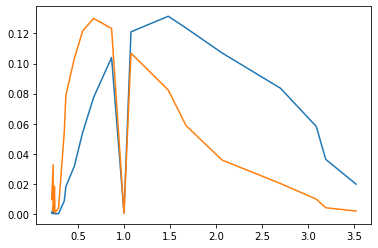

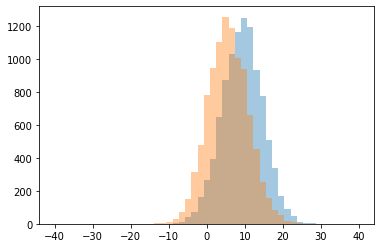

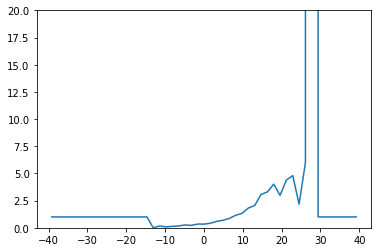

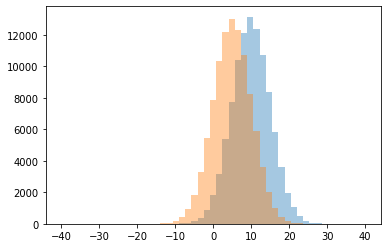

0 0.0
1 0.08333333333333333
2 0.13333333333333333
3 0.16666666666666666
4 0.16901408450704225
5 0.22364217252396165
6 0.26174496644295303
7 0.3380102040816326
8 0.34375
9 0.41561181434599154
10 0.5907441016333939
11 0.6931637519872814
12 0.8649328859060402
13 1.0
14 1.1537698412698412
15 1.3266171792152703
16 1.817905918057663
17 2.0481400437636763
18 2.1666666666666665
19 2.982142857142857
20 3.062992125984252
21 3.2987012987012987
22 4.011904761904762
23 4.4
24 4.8
25 6.0
26 999999.0




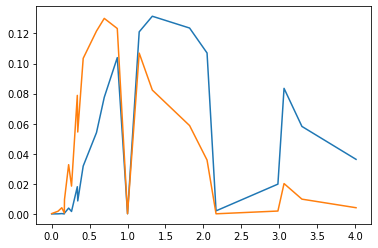

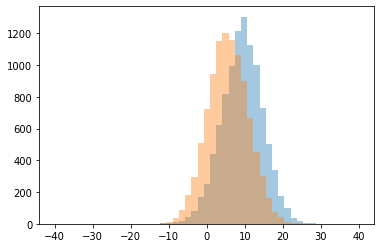

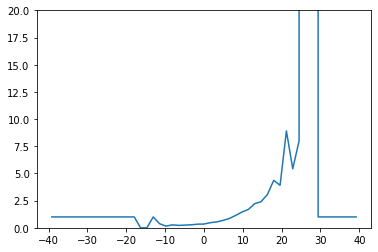

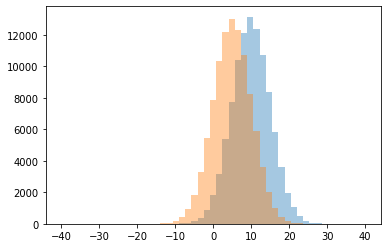

0 0.0
1 0.15384615384615385
2 0.2222222222222222
3 0.24725274725274726
4 0.2702702702702703
5 0.2773972602739726
6 0.3333333333333333
7 0.3453038674033149
8 0.375
9 0.46977730646871685
10 0.5386620330147698
11 0.68
12 0.8551724137931035
13 1.0
14 1.1421845574387948
15 1.453229398663697
16 1.686656671664168
17 2.2195121951219514
18 2.402640264026403
19 3.0606060606060606
20 3.911111111111111
21 4.363636363636363
22 5.428571428571429
23 8.0
24 8.909090909090908
25 999999.0




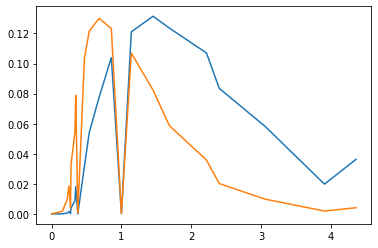

on f= 0.1724137931034483


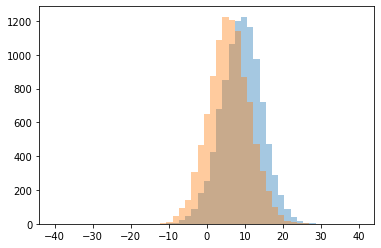

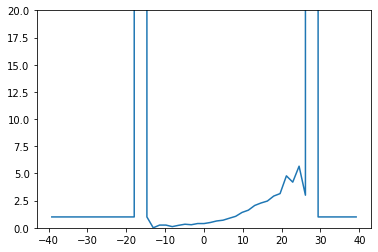

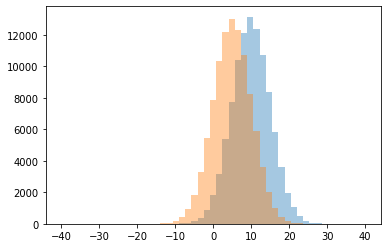

0 0.0
1 0.10869565217391304
2 0.22826086956521738
3 0.25
4 0.2819672131147541
5 0.32867132867132864
6 0.3904320987654321
7 0.3913978494623656
8 0.4868871151653364
9 0.6285714285714286
10 0.6986076986076986
11 0.8799668874172185
12 1.0
13 1.0553116769095698
14 1.4129181084198386
15 1.6216968011126565
16 2.0549682875264272
17 2.2825396825396824
18 2.461139896373057
19 2.919191919191919
20 3.0
21 3.1454545454545455
22 4.2
23 4.777777777777778
24 5.666666666666667
25 999999.0




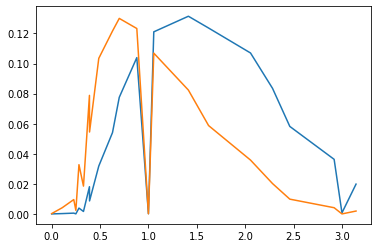

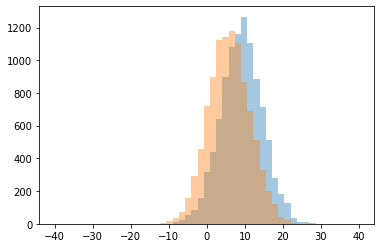

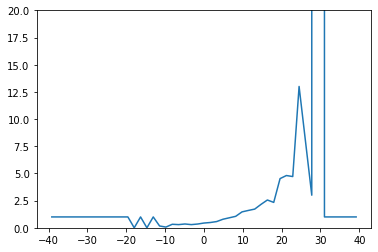

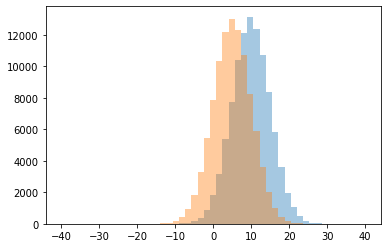

0 0.0
1 0.06666666666666667
2 0.16666666666666666
3 0.29333333333333333
4 0.2935153583617747
5 0.32432432432432434
6 0.34649122807017546
7 0.3503184713375796
8 0.4376731301939058
9 0.4866369710467706
10 0.5735950044603033
11 0.7879053461875548
12 0.9209183673469388
13 1.0
14 1.0543970988213962
15 1.4635838150289018
16 1.596820809248555
17 1.7198443579766538
18 2.1575757575757577
19 2.3361344537815127
20 2.557213930348259
21 3.0
22 4.525
23 4.714285714285714
24 4.8076923076923075
25 8.0
26 13.0
27 999999.0




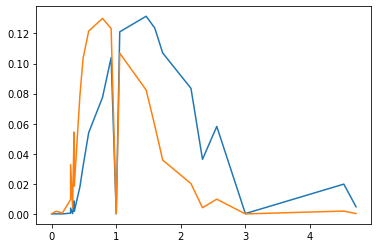

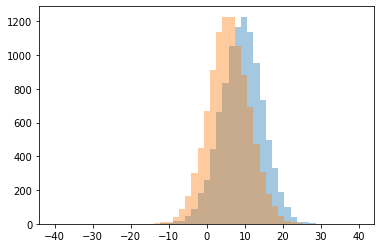

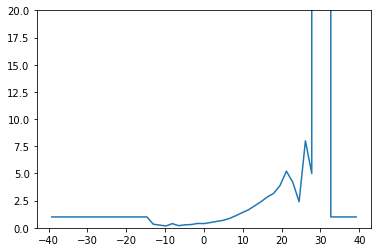

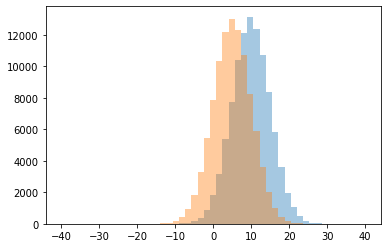

0 0.16666666666666666
1 0.19767441860465115
2 0.25
3 0.2727272727272727
4 0.3010033444816054
5 0.3333333333333333
6 0.38461538461538464
7 0.38622754491017963
8 0.4
9 0.4824945295404814
10 0.5848724714160071
11 0.6810766721044046
12 0.8581907090464548
13 1.0
14 1.105313092979127
15 1.3873159682899208
16 1.6483357452966716
17 2.025531914893617
18 2.4
19 2.839080459770115
20 3.173076923076923
21 3.8979591836734695
22 4.2
23 5.0
24 5.2105263157894735
25 8.0
26 999999.0




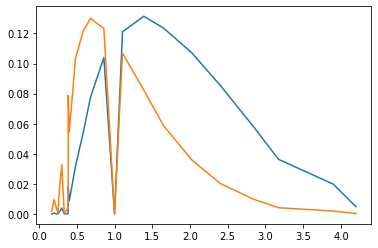

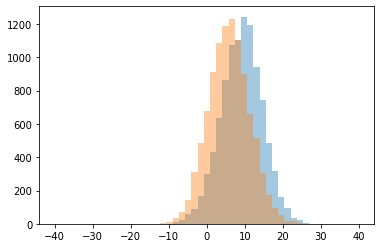

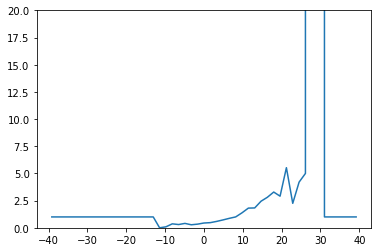

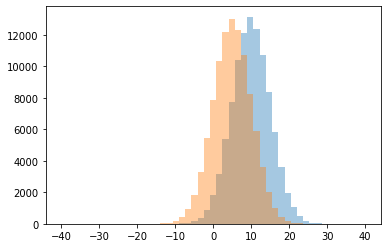

0 0.0
1 0.09090909090909091
2 0.2783171521035599
3 0.3
4 0.3374485596707819
5 0.36363636363636365
6 0.40425531914893614
7 0.4401772525849335
8 0.47426067907995617
9 0.5885608856088561
10 0.7243697478991596
11 0.8708367181153533
12 1.0
13 1.0009041591320071
14 1.3791574279379157
15 1.81089258698941
16 1.8271844660194174
17 2.25
18 2.445901639344262
19 2.808139534883721
20 2.909090909090909
21 3.288659793814433
22 4.2
23 5.0
24 5.529411764705882
25 999999.0




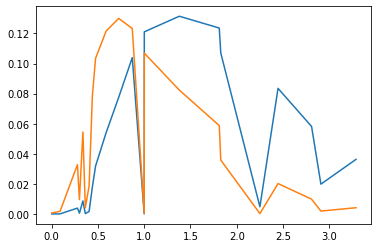

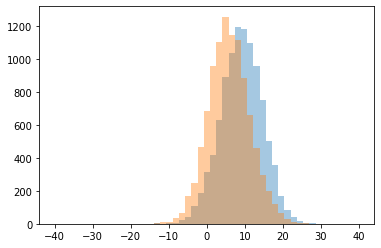

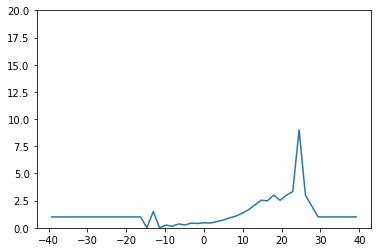

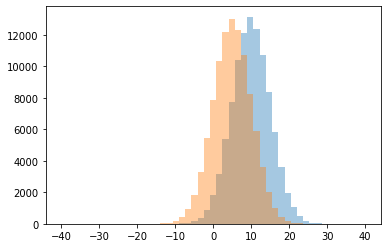

0 0.0
1 0.14705882352941177
2 0.25
3 0.2603550295857988
4 0.35294117647058826
5 0.3952991452991453
6 0.43373493975903615
7 0.43664921465968587
8 0.46266471449487556
9 0.5679347826086957
10 0.7085987261146497
11 0.9049694856146469
12 1.0
13 1.0691202872531418
14 1.3318284424379232
15 1.5
16 1.6575757575757575
17 2.0
18 2.084967320261438
19 2.487562189054726
20 2.5303030303030303
21 2.535593220338983
22 3.0
23 3.0084745762711864
24 3.3333333333333335
25 9.0




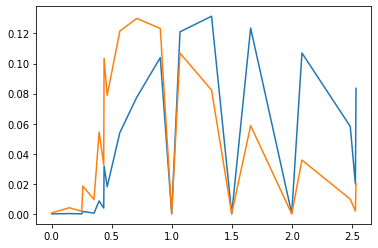

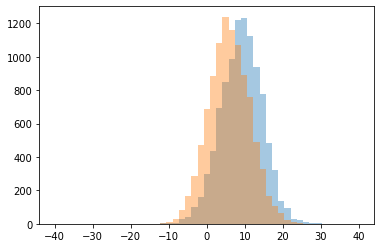

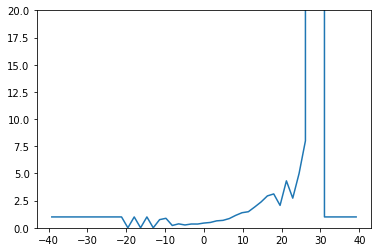

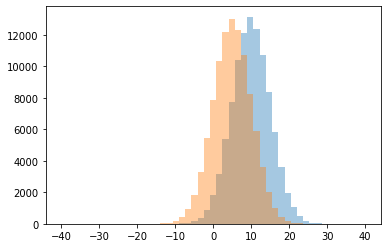

0 0.0
1 0.21428571428571427
2 0.2606060606060606
3 0.34541577825159914
4 0.34843205574912894
5 0.3625
6 0.43731778425655976
7 0.4915445321307779
8 0.6386321626617375
9 0.6844229217110573
10 0.75
11 0.8514680483592401
12 0.875
13 1.0
14 1.1433926897844424
15 1.3869516310461192
16 1.4789473684210526
17 1.9142857142857144
18 2.0615384615384613
19 2.374233128834356
20 2.727272727272727
21 2.933333333333333
22 3.1153846153846154
23 4.318181818181818
24 5.0
25 8.0
26 999999.0




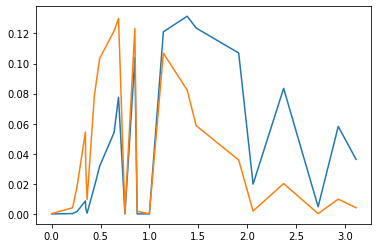

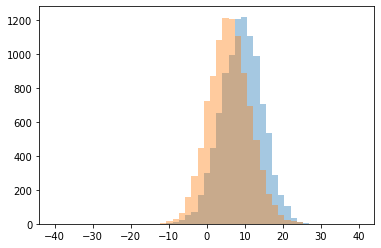

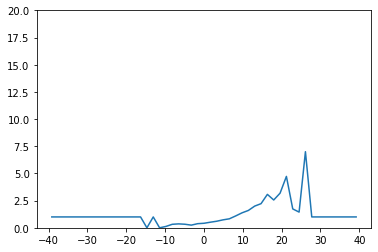

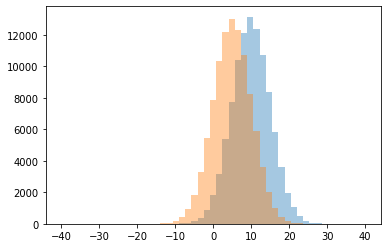

0 0.0
1 0.125
2 0.24561403508771928
3 0.3225806451612903
4 0.3269230769230769
5 0.36065573770491804
6 0.3789237668161435
7 0.41632088520055327
8 0.5137931034482759
9 0.6031307550644567
10 0.7306425041186162
11 0.826302729528536
12 1.0
13 1.091237579042457
14 1.3761261261261262
15 1.4444444444444444
16 1.595959595959596
17 1.736842105263158
18 1.995959595959596
19 2.220125786163522
20 2.5575221238938055
21 3.0742857142857143
22 3.185185185185185
23 4.7272727272727275
24 7.0




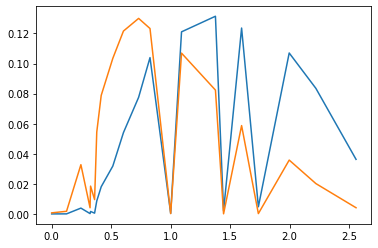

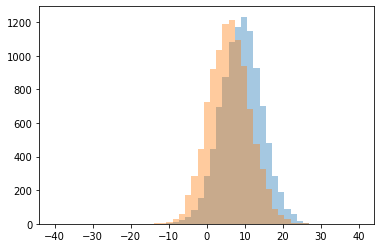

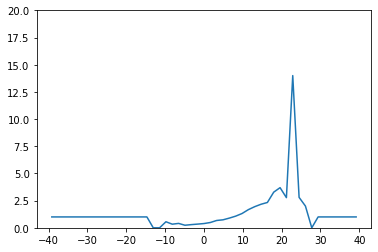

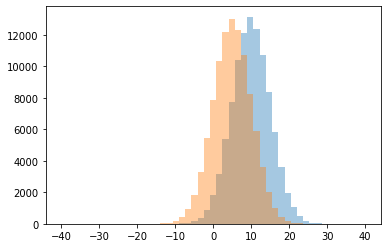

0 0.0
1 0.23563218390804597
2 0.29225352112676056
3 0.3333333333333333
4 0.3400900900900901
5 0.39088397790055246
6 0.40350877192982454
7 0.48642779587404994
8 0.5555555555555556
9 0.6734299516908212
10 0.7348993288590604
11 0.891358024691358
12 1.0
13 1.0722781335773102
14 1.3130990415335464
15 1.6705539358600583
16 1.9433962264150944
17 2.0
18 2.166153846153846
19 2.3285024154589373
20 2.774193548387097
21 2.8
22 3.2790697674418605
23 3.6923076923076925
24 14.0




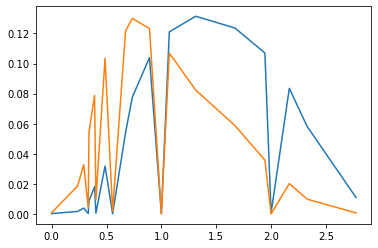

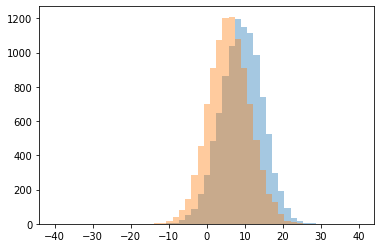

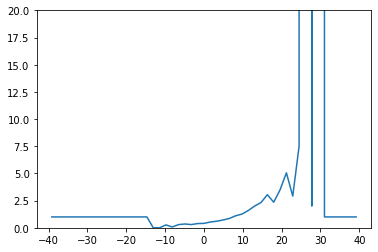

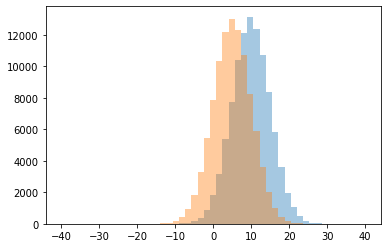

0 0.0
1 0.07894736842105263
2 0.26666666666666666
3 0.2948717948717949
4 0.2972027972027972
5 0.34965034965034963
6 0.389010989010989
7 0.40772532188841204
8 0.5302530253025303
9 0.604089219330855
10 0.7171381031613977
11 0.8586776859504133
12 1.0
13 1.1055555555555556
14 1.2651265126512652
15 1.5937052932761087
16 2.0
17 2.0040650406504064
18 2.32807570977918
19 2.352
20 2.9166666666666665
21 3.046511627906977
22 3.4909090909090907
23 5.055555555555555
24 7.5
25 999999.0




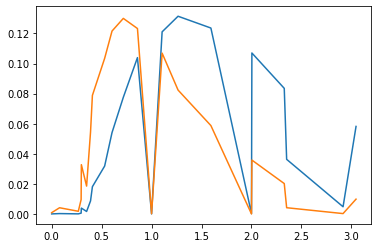

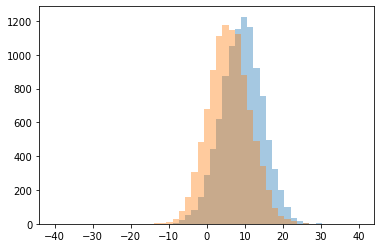

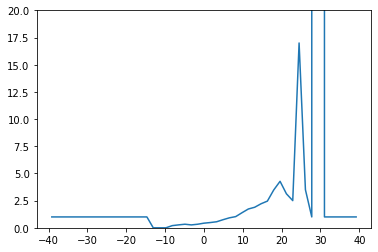

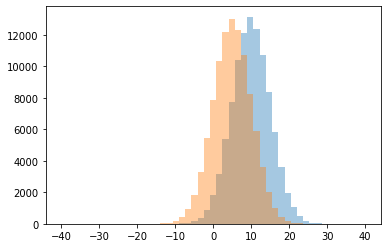

0 0.0
1 0.2
2 0.26644736842105265
3 0.2692307692307692
4 0.3278008298755187
5 0.3291139240506329
6 0.42584434654919234
7 0.4835164835164835
8 0.5563570784490532
9 0.7436332767402377
10 0.9155052264808362
11 1.0
12 1.0285204991087344
13 1.3873159682899208
14 1.7299703264094954
15 1.8895705521472392
16 2.210526315789474
17 2.4554455445544554
18 2.5
19 3.129032258064516
20 3.478723404255319
21 3.5
22 4.276595744680851
23 17.0
24 999999.0




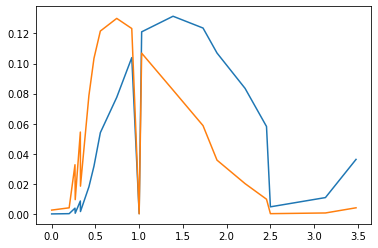

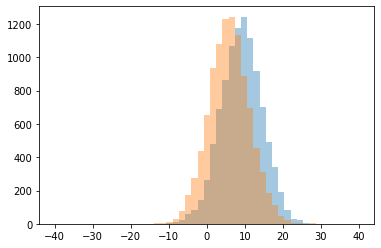

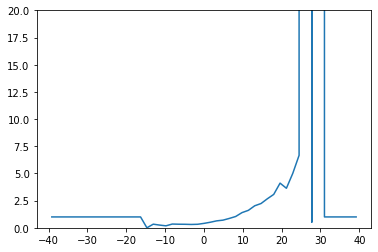

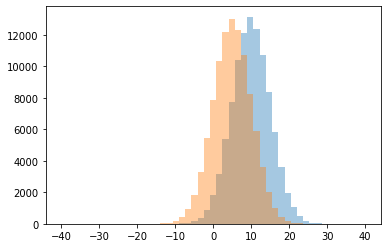

0 0.0
1 0.18181818181818182
2 0.25
3 0.3079710144927536
4 0.3236994219653179
5 0.32413793103448274
6 0.32894736842105265
7 0.3333333333333333
8 0.3448275862068966
9 0.40644171779141103
10 0.5
11 0.5112540192926045
12 0.6382189239332097
13 0.7040650406504065
14 0.8629032258064516
15 1.0
16 1.0397526501766785
17 1.397752808988764
18 1.6048850574712643
19 2.0242290748898677
20 2.2332268370607027
21 2.6721311475409837
22 3.0714285714285716
23 3.6363636363636362
24 4.108695652173913
25 5.0
26 6.666666666666667
27 999999.0




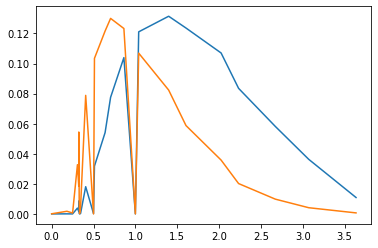

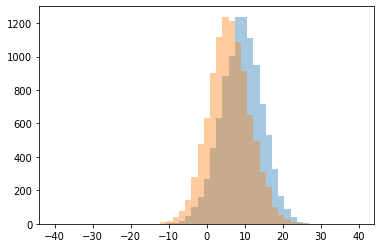

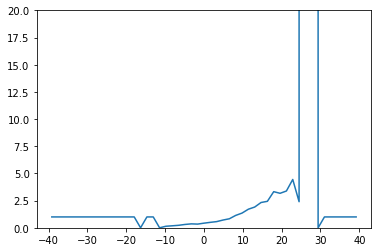

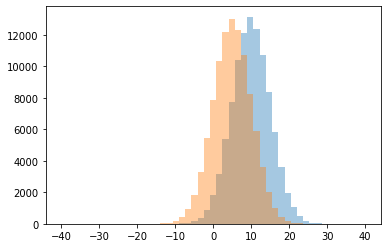

0 0.0
1 0.14285714285714285
2 0.18421052631578946
3 0.22972972972972974
4 0.3076923076923077
5 0.34029227557411273
6 0.36200716845878134
7 0.42630744849445323
8 0.5016648168701443
9 0.5689964157706093
10 0.7132471728594507
11 0.8297520661157025
12 1.0
13 1.1391705069124425
14 1.3522975929978118
15 1.7096774193548387
16 1.909456740442656
17 2.3268608414239482
18 2.4
19 2.4357798165137616
20 3.173076923076923
21 3.323232323232323
22 3.3846153846153846
23 4.444444444444445
24 999999.0




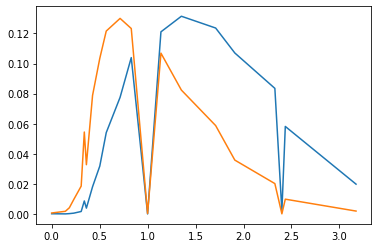

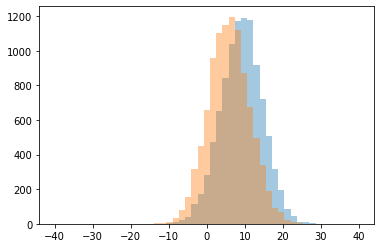

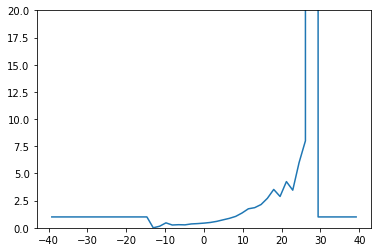

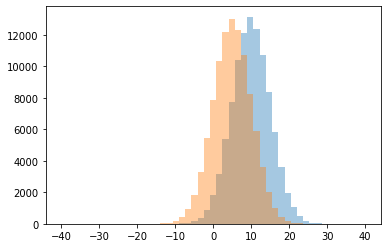

0 0.0
1 0.14285714285714285
2 0.2571428571428571
3 0.2709677419354839
4 0.2857142857142857
5 0.35555555555555557
6 0.3861607142857143
7 0.4303030303030303
8 0.45454545454545453
9 0.490625
10 0.5902085222121487
11 0.7306689834926151
12 0.8680033416875522
13 1.0
14 1.049194991055456
15 1.360411899313501
16 1.7473997028231798
17 1.8528225806451613
18 2.13905325443787
19 2.7112299465240643
20 2.8823529411764706
21 3.4615384615384617
22 3.5280898876404496
23 4.25
24 6.0
25 8.0
26 999999.0




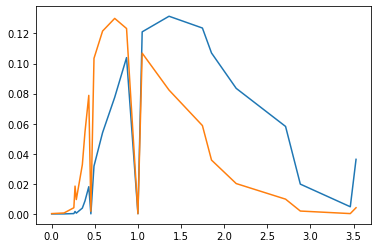

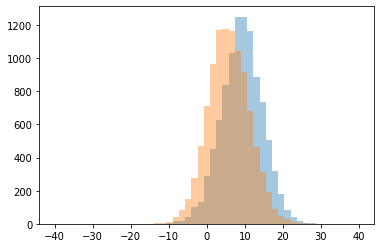

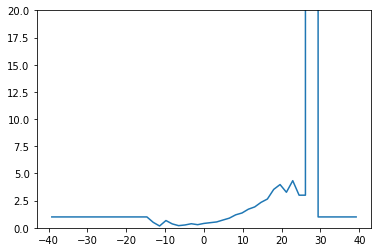

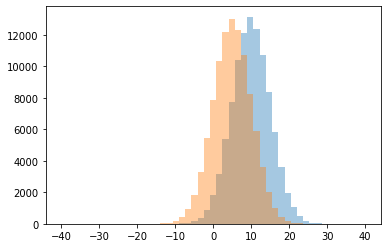

0 0.16666666666666666
1 0.19753086419753085
2 0.26
3 0.2863247863247863
4 0.358974358974359
5 0.37454545454545457
6 0.40308988764044945
7 0.4714434060228453
8 0.5
9 0.5389888603256212
10 0.6666666666666666
11 0.7161125319693095
12 0.8874570446735395
13 1.0
14 1.1931166347992352
15 1.3631406761177753
16 1.71071953010279
17 1.920086393088553
18 2.340764331210191
19 2.6458333333333335
20 3.0
21 3.269230769230769
22 3.533333333333333
23 3.977777777777778
24 4.333333333333333
25 999999.0




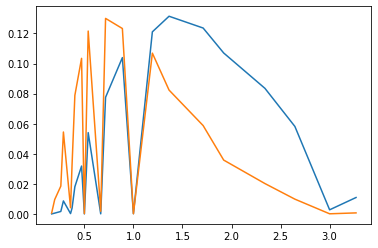

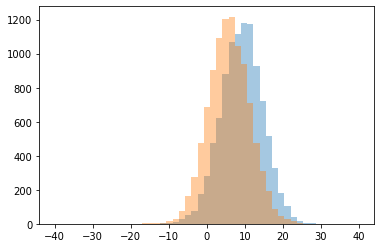

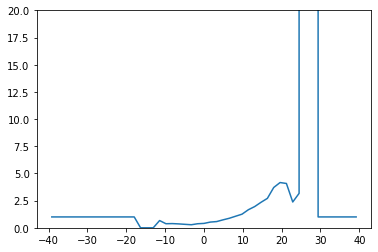

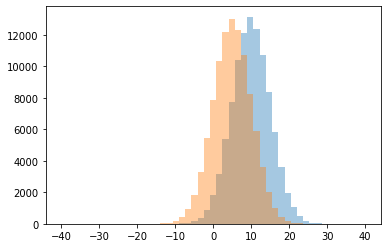

0 0.0
1 0.2815884476534296
2 0.3192771084337349
3 0.358974358974359
4 0.3728813559322034
5 0.375
6 0.3870967741935484
7 0.40406976744186046
8 0.5259668508287293
9 0.5724770642201835
10 0.6666666666666666
11 0.7315045719035744
12 0.8775677896466721
13 1.0
14 1.066857688634193
15 1.2531914893617022
16 1.661951909476662
17 1.9536842105263157
18 2.3474025974025974
19 2.375
20 2.7068062827225132
21 3.1666666666666665
22 3.707865168539326
23 4.076923076923077
24 4.162790697674419
25 999999.0




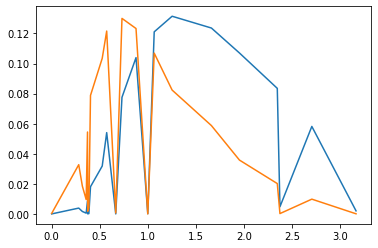

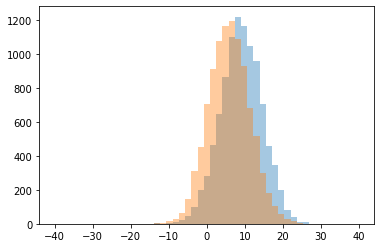

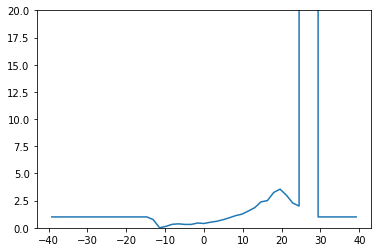

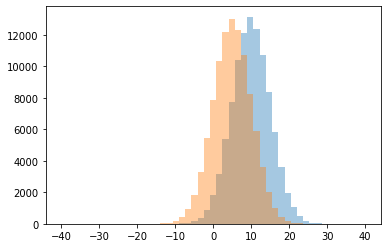

0 0.0
1 0.13333333333333333
2 0.3103448275862069
3 0.31309904153354634
4 0.3225806451612903
5 0.36363636363636365
6 0.3963068181818182
7 0.44026548672566373
8 0.5115257958287596
9 0.5990740740740741
10 0.7431506849315068
11 0.75
12 0.922883487007544
13 1.0
14 1.120183486238532
15 1.255639097744361
16 1.5411764705882354
17 1.8516377649325626
18 2.0
19 2.2777777777777777
20 2.387205387205387
21 2.5
22 3.0
23 3.2523364485981308
24 3.5535714285714284
25 999999.0




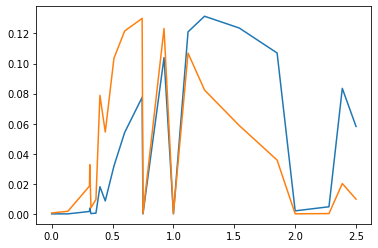

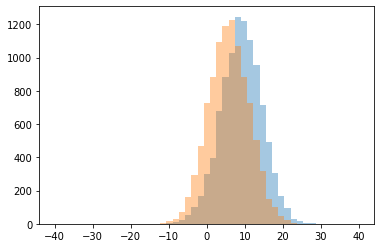

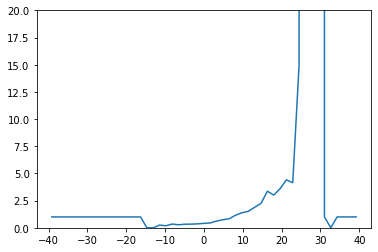

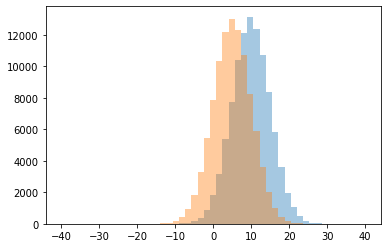

0 0.0
1 0.1875
2 0.25
3 0.2777777777777778
4 0.32926829268292684
5 0.336734693877551
6 0.34615384615384615
7 0.36324786324786323
8 0.40796703296703296
9 0.44721906923950056
10 0.6210045662100456
11 0.7416107382550335
12 0.8375510204081633
13 1.0
14 1.162313432835821
15 1.3820861678004535
16 1.5185185185185186
17 1.889108910891089
18 2.251572327044025
19 3.0098039215686274
20 3.36734693877551
21 3.595744680851064
22 4.142857142857143
23 4.409090909090909
24 15.0
25 999999.0




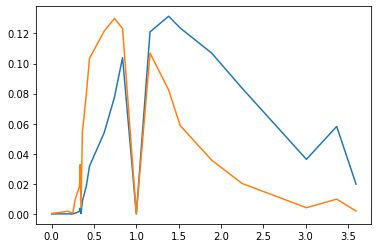

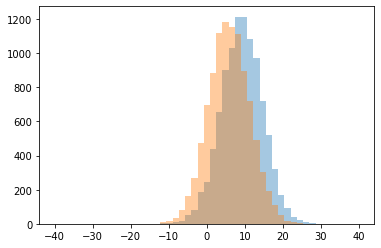

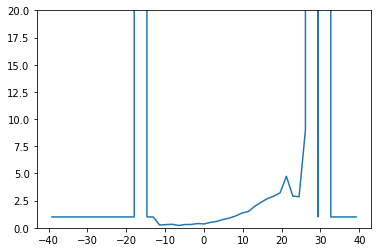

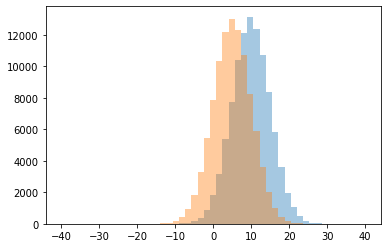

0 0.2125
1 0.25
2 0.29411764705882354
3 0.30303030303030304
4 0.30597014925373134
5 0.3235294117647059
6 0.35488505747126436
7 0.3919491525423729
8 0.49434389140271495
9 0.5880250223413762
10 0.7631133671742809
11 0.8942807625649913
12 1.0
13 1.09000900090009
14 1.3579418344519016
15 1.5041551246537397
16 1.975609756097561
17 2.3508196721311476
18 2.682051282051282
19 2.857142857142857
20 2.909090909090909
21 2.923076923076923
22 3.2115384615384617
23 4.7368421052631575
24 9.0
25 999999.0




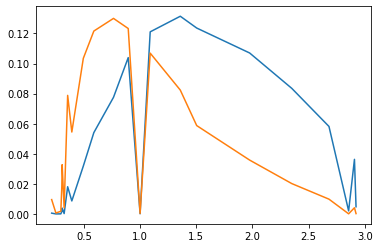

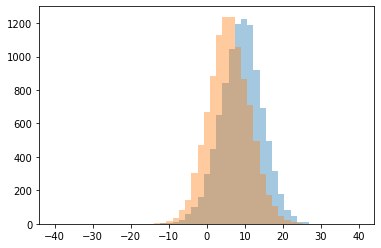

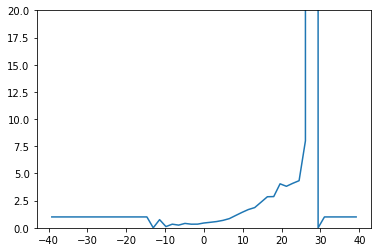

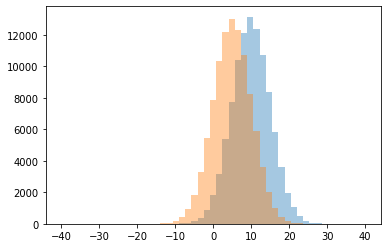

0 0.0
1 0.1111111111111111
2 0.24691358024691357
3 0.33223684210526316
4 0.3333333333333333
5 0.336864406779661
6 0.4027777777777778
7 0.44245142002989535
8 0.5050847457627119
9 0.575354609929078
10 0.6834008097165992
11 0.75
12 0.8441033925686591
13 1.0
14 1.1335227272727273
15 1.418308227114716
16 1.6793785310734464
17 1.8585858585858586
18 2.3559322033898304
19 2.8563218390804597
20 2.871559633027523
21 3.8181818181818183
22 4.045454545454546
23 4.090909090909091
24 4.333333333333333
25 8.0
26 999999.0




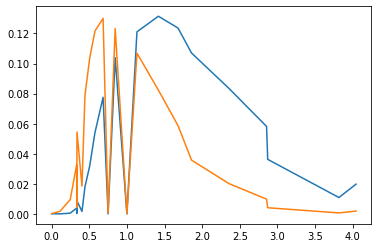

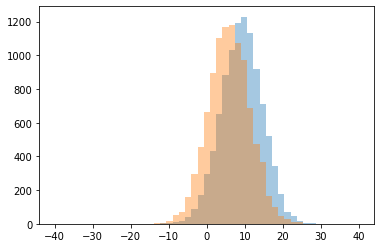

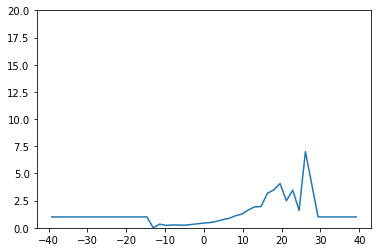

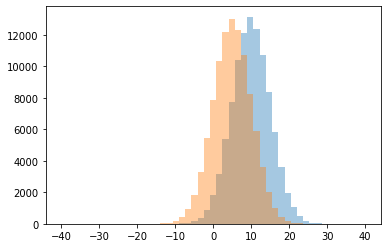

0 0.0
1 0.2222222222222222
2 0.2422360248447205
3 0.25
4 0.26
5 0.3016949152542373
6 0.3333333333333333
7 0.3706140350877193
8 0.43993993993993996
9 0.48494983277591974
10 0.5936363636363636
11 0.759656652360515
12 0.8743633276740238
13 1.0
14 1.1119402985074627
15 1.2657054582904221
16 1.6
17 1.644927536231884
18 1.9243697478991597
19 1.9505494505494505
20 2.4827586206896552
21 3.175757575757576
22 3.4615384615384617
23 3.479591836734694
24 4.0
25 4.068181818181818
26 7.0




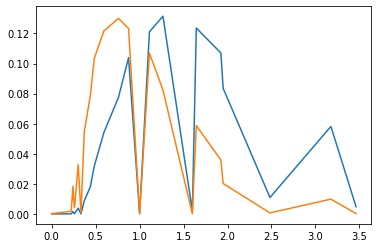

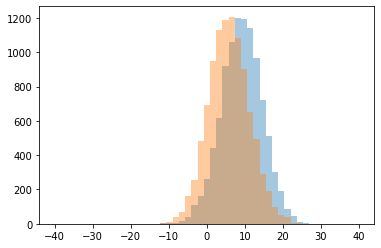

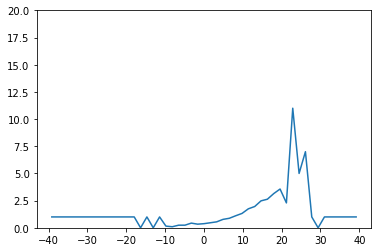

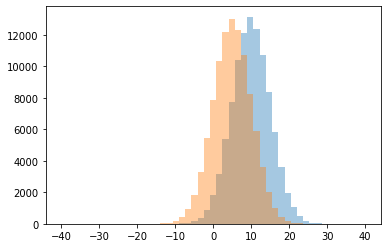

0 0.0
1 0.0975609756097561
2 0.15384615384615385
3 0.23943661971830985
4 0.24074074074074073
5 0.33471933471933474
6 0.37971014492753624
7 0.4308300395256917
8 0.4631578947368421
9 0.5473870682019486
10 0.7744107744107744
11 0.875724937862469
12 1.0
13 1.1073080481036077
14 1.3219026548672566
15 1.7469325153374233
16 1.9574036511156188
17 2.289473684210526
18 2.4794520547945207
19 2.6288659793814433
20 3.1458333333333335
21 3.5660377358490565
22 5.0
23 7.0
24 11.0




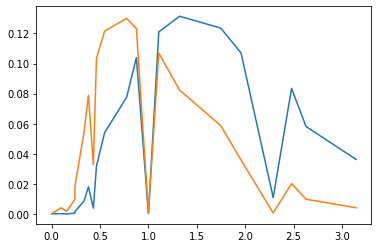

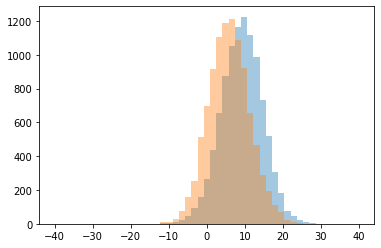

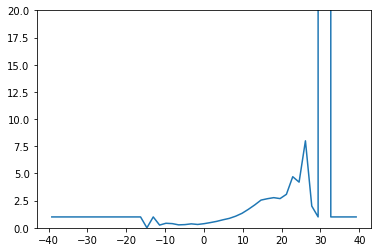

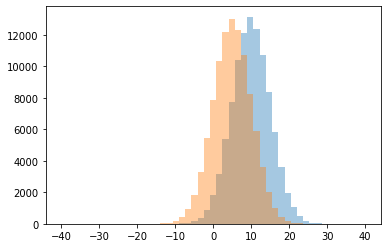

0 0.0
1 0.25
2 0.2702702702702703
3 0.29375
4 0.30739299610894943
5 0.36363636363636365
6 0.37841726618705035
7 0.38461538461538464
8 0.4166666666666667
9 0.4786885245901639
10 0.5914855072463768
11 0.736753574432296
12 0.8673805601317958
13 1.0
14 1.0679522497704317
15 1.3329706202393907
16 1.6986301369863013
17 2.0
18 2.1025641025641026
19 2.548611111111111
20 2.6752577319587627
21 2.6865671641791047
22 2.772727272727273
23 3.08
24 4.2
25 4.7
26 8.0
27 999999.0




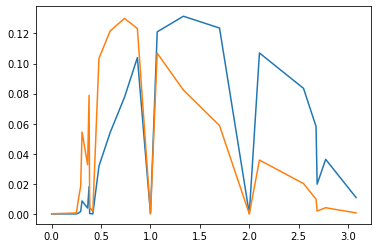

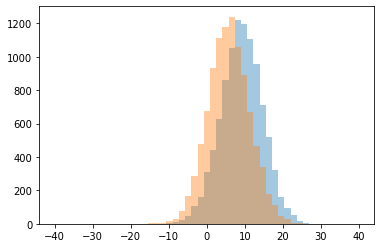

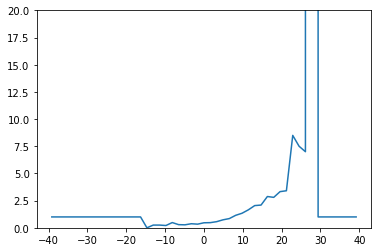

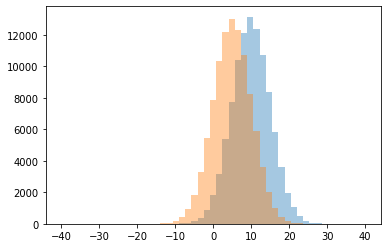

0 0.0
1 0.21052631578947367
2 0.25
3 0.27439024390243905
4 0.2894736842105263
5 0.33541666666666664
6 0.3732394366197183
7 0.46142433234421365
8 0.4742489270386266
9 0.48148148148148145
10 0.5644724977457168
11 0.7336170212765958
12 0.8482647296206618
13 1.0
14 1.1481132075471698
15 1.3381858902575587
16 1.652694610778443
17 2.0427350427350426
18 2.090909090909091
19 2.8
20 2.8777777777777778
21 3.326530612244898
22 3.4074074074074074
23 7.0
24 7.5
25 8.5
26 999999.0




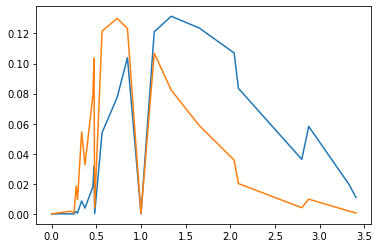

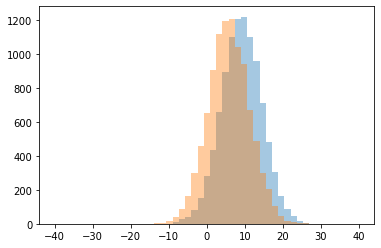

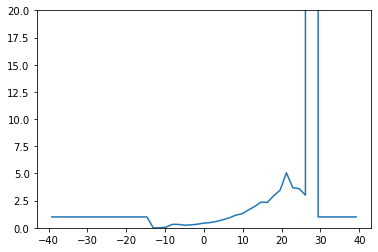

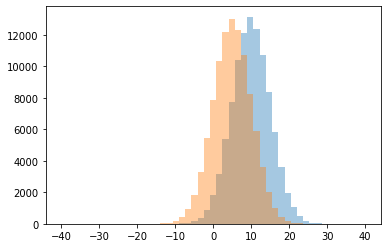

0 0.0
1 0.05555555555555555
2 0.23636363636363636
3 0.271523178807947
4 0.3111111111111111
5 0.3157894736842105
6 0.33406113537117904
7 0.4327217125382263
8 0.48287292817679556
9 0.5894454382826476
10 0.7479061976549414
11 0.912106135986733
12 1.0
13 1.1605769230769232
14 1.2920634920634921
15 1.6354166666666667
16 1.9631901840490797
17 2.3300970873786406
18 2.3654485049833887
19 2.951923076923077
20 3.0
21 3.4583333333333335
22 3.6
23 3.6923076923076925
24 5.0588235294117645
25 999999.0




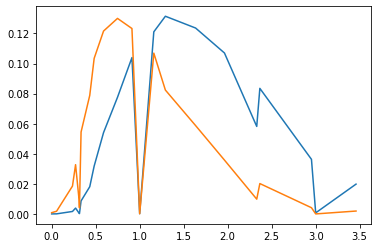

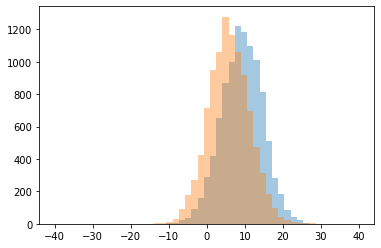

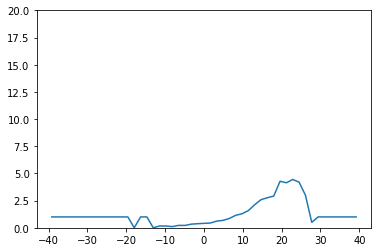

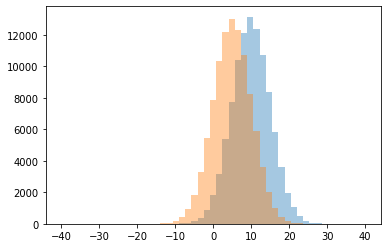

0 0.0
1 0.10714285714285714
2 0.16666666666666666
3 0.21714285714285714
4 0.22340425531914893
5 0.3345724907063197
6 0.375886524822695
7 0.4067321178120617
8 0.4392819429778247
9 0.5
10 0.6154571159283695
11 0.6823161189358372
12 0.8577549271636675
13 1.0
14 1.149056603773585
15 1.289760348583878
16 1.5835734870317002
17 2.1242105263157893
18 2.589171974522293
19 2.766304347826087
20 2.917525773195876
21 3.0
22 4.142857142857143
23 4.2
24 4.27906976744186
25 4.444444444444445




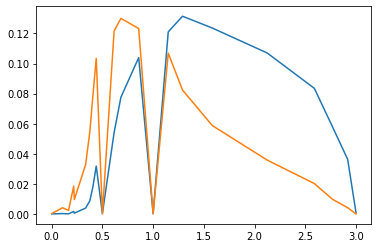

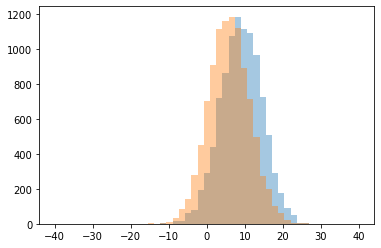

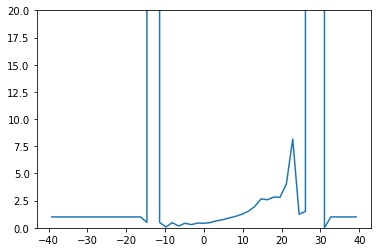

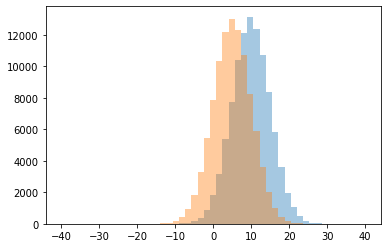

0 0.0
1 0.07692307692307693
2 0.16091954022988506
3 0.29136690647482016
4 0.41418439716312055
5 0.4206896551724138
6 0.43429844097995546
7 0.4722222222222222
8 0.48521358159912376
9 0.5
10 0.6463742166517458
11 0.7474137931034482
12 0.9090143218197135
13 1.0
14 1.055111111111111
15 1.25
16 1.2519596864501679
17 1.5
18 1.5264623955431755
19 1.9536290322580645
20 2.580808080808081
21 2.661764705882353
22 2.8095238095238093
23 2.826923076923077
24 4.045454545454546
25 8.166666666666666
26 999999.0




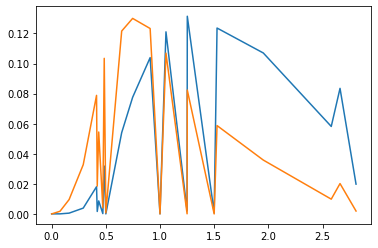

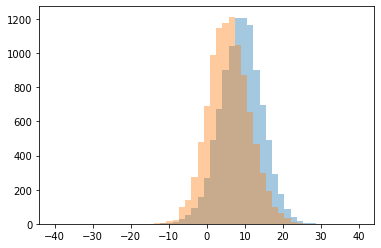

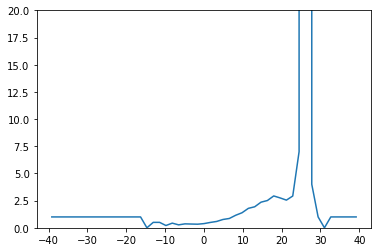

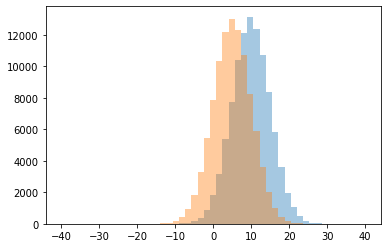

0 0.0
1 0.21052631578947367
2 0.2708333333333333
3 0.33194154488517746
4 0.34545454545454546
5 0.36231884057971014
6 0.3855072463768116
7 0.42857142857142855
8 0.49294354838709675
9 0.5
10 0.5834782608695652
11 0.766156462585034
12 0.857495881383855
13 1.0
14 1.152963671128107
15 1.3837342497136311
16 1.7886676875957122
17 1.9334763948497855
18 2.358108108108108
19 2.5076923076923077
20 2.5454545454545454
21 2.75
22 2.923076923076923
23 2.93
24 4.0
25 7.0
26 999999.0




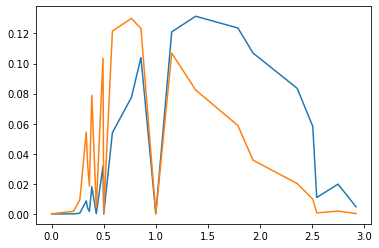

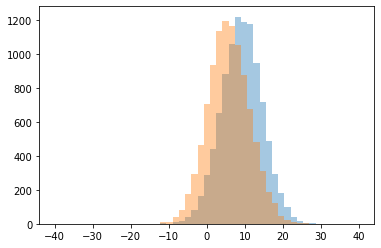

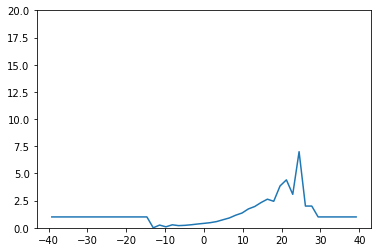

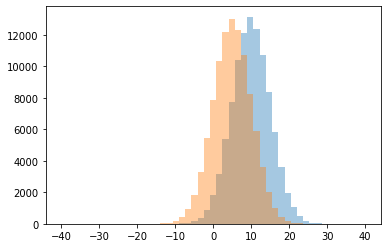

0 0.0
1 0.09090909090909091
2 0.2
3 0.22727272727272727
4 0.25
5 0.275
6 0.28040540540540543
7 0.34913793103448276
8 0.40793201133144474
9 0.4732334047109208
10 0.573568281938326
11 0.740989103101425
12 0.9048843187660668
13 1.0
14 1.158745247148289
15 1.3581235697940504
16 1.7345132743362832
17 1.9566115702479339
18 2.0
19 2.3214285714285716
20 2.43801652892562
21 2.6324324324324326
22 3.076923076923077
23 3.851063829787234
24 4.409090909090909
25 7.0




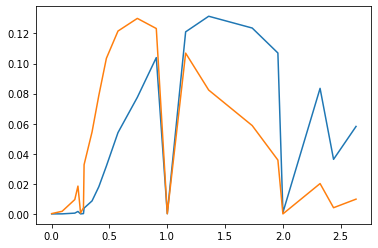

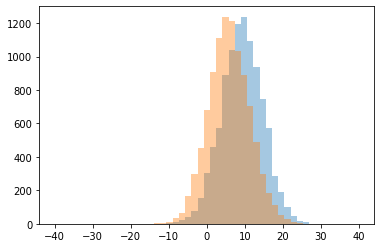

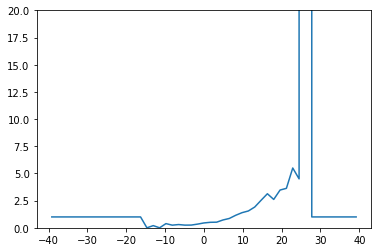

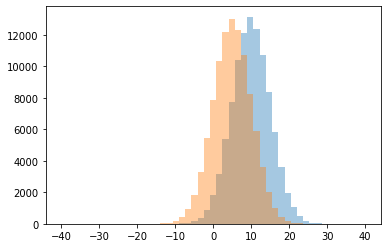

0 0.0
1 0.2
2 0.24324324324324326
3 0.24550898203592814
4 0.2508361204013378
5 0.29850746268656714
6 0.3399122807017544
7 0.38461538461538464
8 0.4470588235294118
9 0.5055187637969095
10 0.5175517551755175
11 0.7205169628432956
12 0.8597359735973598
13 1.0
14 1.1505791505791505
15 1.3910112359550562
16 1.548158640226629
17 1.9081632653061225
18 2.527027027027027
19 2.609090909090909
20 3.131868131868132
21 3.4727272727272727
22 3.6296296296296298
23 4.5
24 5.5
25 999999.0




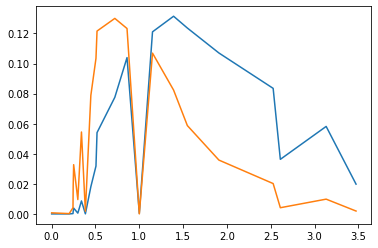

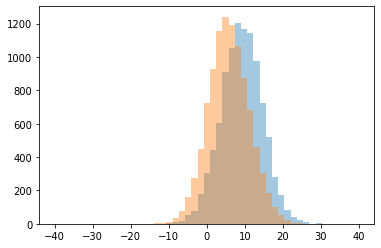

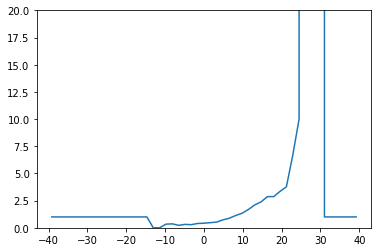

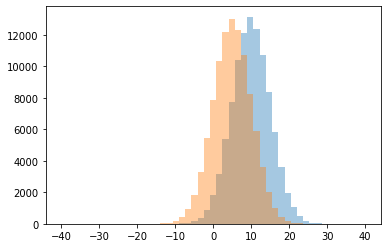

0 0.0
1 0.22784810126582278
2 0.2867647058823529
3 0.31446540880503143
4 0.3333333333333333
5 0.36363636363636365
6 0.3977777777777778
7 0.4224376731301939
8 0.4736275565123789
9 0.523356401384083
10 0.734085414987913
11 0.8824517212426533
12 1.0
13 1.1303939962476548
14 1.3356164383561644
15 1.6813509544787077
16 2.103671706263499
17 2.382838283828383
18 2.86734693877551
19 2.868131868131868
20 3.3529411764705883
21 3.772727272727273
22 6.666666666666667
23 10.0
24 999999.0




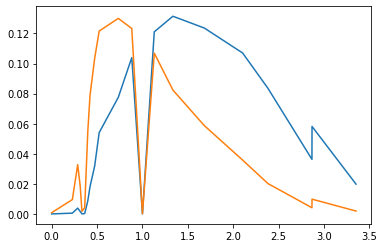

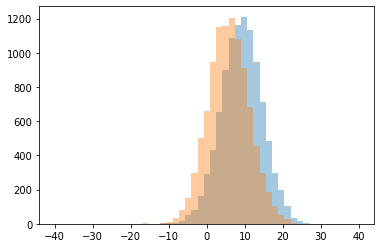

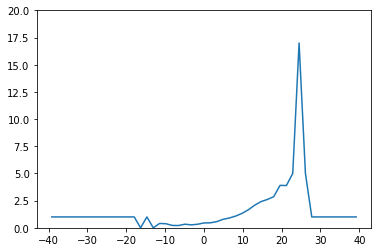

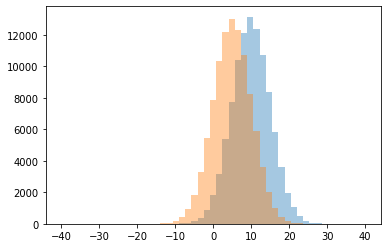

0 0.0
1 0.20987654320987653
2 0.21875
3 0.2684563758389262
4 0.3273809523809524
5 0.3310810810810811
6 0.375
7 0.4
8 0.44680851063829785
9 0.4586864406779661
10 0.5655951346655083
11 0.777681660899654
12 0.9021558872305141
13 1.0
14 1.077849860982391
15 1.326396495071194
16 1.6569343065693432
17 2.0789473684210527
18 2.4087837837837838
19 2.60752688172043
20 2.8640776699029127
21 3.888888888888889
22 3.9019607843137254
23 5.0
24 17.0




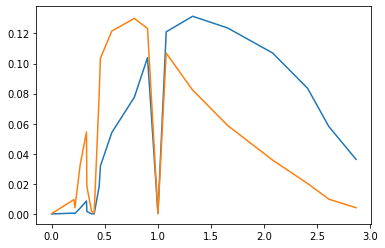

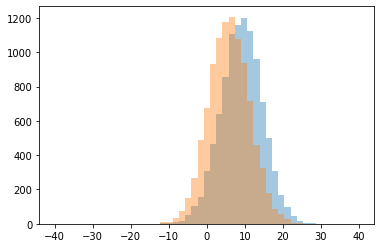

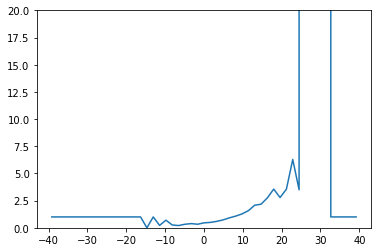

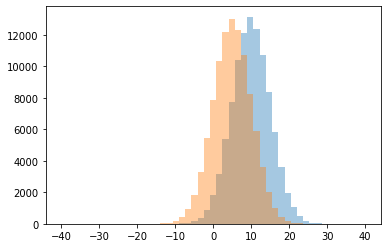

0 0.0
1 0.2077922077922078
2 0.2222222222222222
3 0.2571428571428571
4 0.32679738562091504
5 0.3271604938271605
6 0.3857677902621723
7 0.45548961424332346
8 0.49571734475374735
9 0.5905730129390019
10 0.7
11 0.724342663273961
12 0.9146644573322287
13 1.0
14 1.075139146567718
15 1.2771855010660982
16 1.5722300140252454
17 2.0757575757575757
18 2.1707317073170733
19 2.7527472527472527
20 2.783333333333333
21 3.5
22 3.5555555555555554
23 3.558139534883721
24 6.285714285714286
25 999999.0




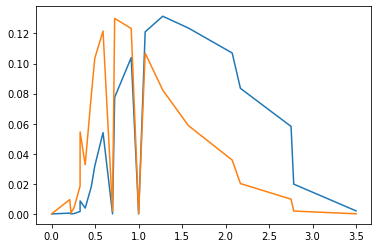

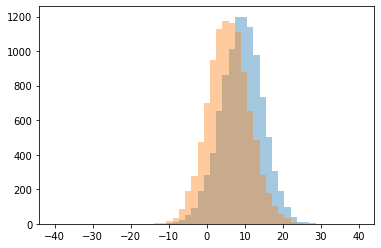

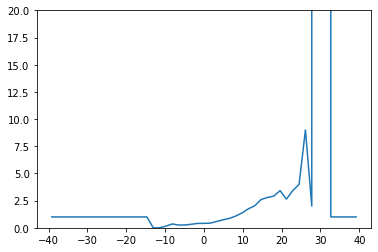

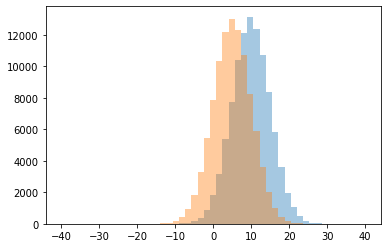

0 0.0
1 0.15789473684210525
2 0.2558139534883721
3 0.26063829787234044
4 0.3237410071942446
5 0.35294117647058826
6 0.40380549682875266
7 0.40746054519368724
8 0.43083421330517424
9 0.5817051509769094
10 0.7359454855195912
11 0.8678111587982833
12 1.0
13 1.0764388489208634
14 1.3671607753705814
15 1.7446483180428134
16 2.0
17 2.020618556701031
18 2.602836879432624
19 2.638888888888889
20 2.7845303867403315
21 2.914285714285714
22 3.4166666666666665
23 3.418181818181818
24 4.0
25 9.0
26 999999.0




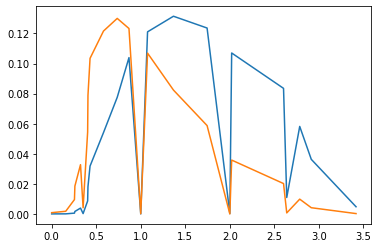

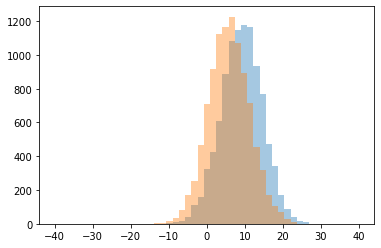

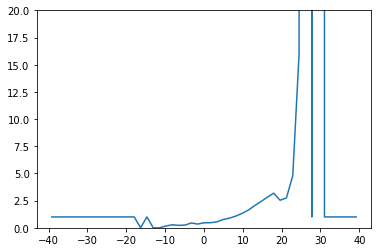

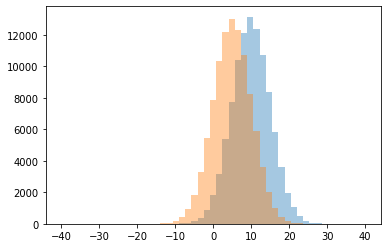

0 0.0
1 0.16666666666666666
2 0.225
3 0.25
4 0.2777777777777778
5 0.3418803418803419
6 0.4426877470355731
7 0.46056338028169014
8 0.4682713347921225
9 0.5400355871886121
10 0.7626827171109201
11 0.8833605220228385
12 1.0
13 1.0728971962616822
14 1.3202247191011236
15 1.6288515406162465
16 2.0393873085339167
17 2.419558359621451
18 2.537313432835821
19 2.7419354838709675
20 2.8154761904761907
21 3.1869158878504673
22 4.777777777777778
23 16.0
24 999999.0




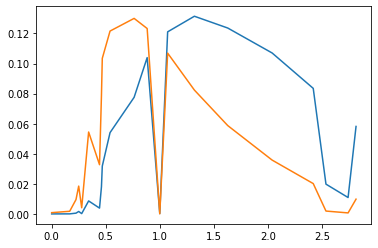

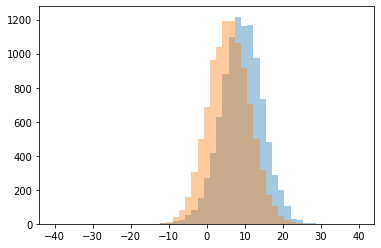

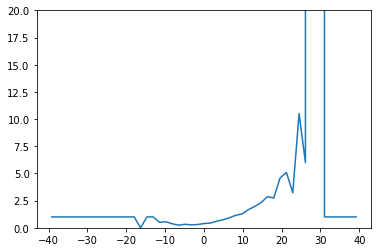

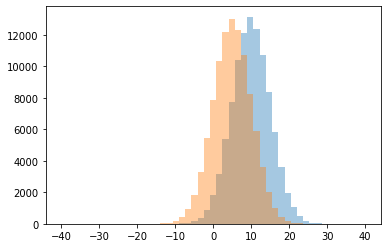

0 0.0
1 0.24096385542168675
2 0.2730263157894737
3 0.3032128514056225
4 0.32075471698113206
5 0.3684210526315789
6 0.39035087719298245
7 0.43198338525441327
8 0.5
9 0.5555555555555556
10 0.6051873198847262
11 0.7394957983193278
12 0.9201680672268907
13 1.0
14 1.1470311027332705
15 1.276013143483023
16 1.6652421652421652
17 1.965725806451613
18 2.3132911392405062
19 2.7403846153846154
20 2.863095238095238
21 3.2222222222222223
22 4.5813953488372094
23 5.095238095238095
24 6.0
25 10.5
26 999999.0




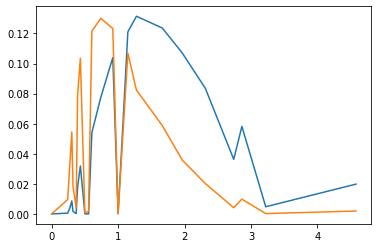

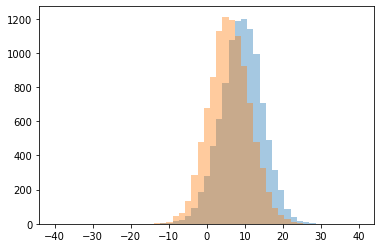

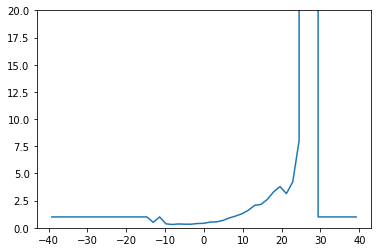

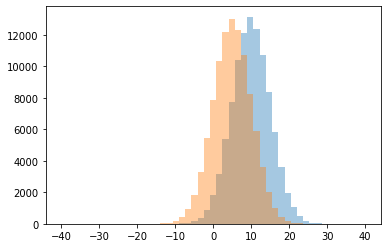

0 0.30434782608695654
1 0.3282442748091603
2 0.3321678321678322
3 0.35384615384615387
4 0.36363636363636365
5 0.3945720250521921
6 0.413589364844904
7 0.5
8 0.5296167247386759
9 0.5451327433628319
10 0.6782178217821783
11 0.9058823529411765
12 1.0
13 1.0829535095715588
14 1.2951351351351352
15 1.6141843971631207
16 2.06875
17 2.152439024390244
18 2.617021276595745
19 3.1481481481481484
20 3.3191489361702127
21 3.7884615384615383
22 4.222222222222222
23 8.0
24 999999.0




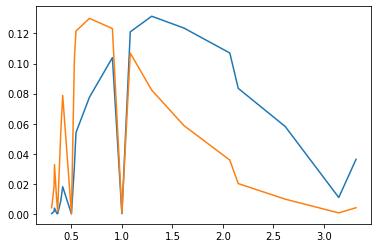

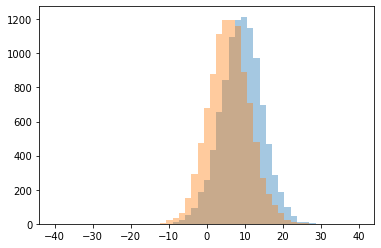

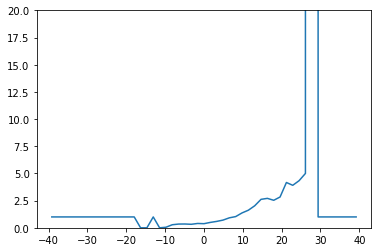

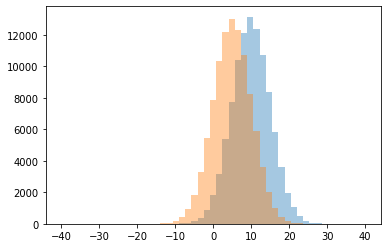

0 0.0
1 0.05
2 0.28125
3 0.3231292517006803
4 0.34375
5 0.34868421052631576
6 0.37905604719764013
7 0.3987341772151899
8 0.4954337899543379
9 0.5879712746858169
10 0.7079497907949791
11 0.9170854271356784
12 1.0
13 1.0310077519379846
14 1.3682432432432432
15 1.617771509167842
16 2.025
17 2.5309734513274336
18 2.6179775280898876
19 2.706896551724138
20 2.8333333333333335
21 3.909090909090909
22 4.166666666666667
23 4.333333333333333
24 5.0
25 999999.0




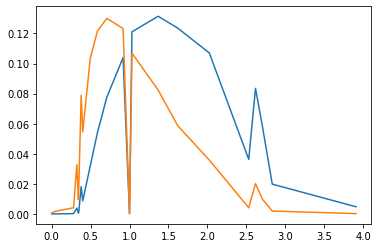

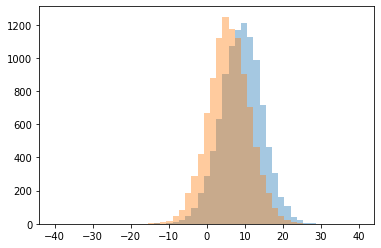

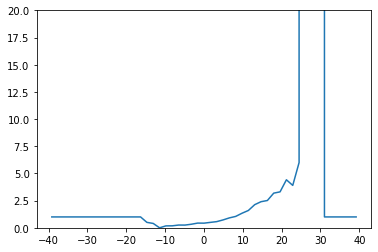

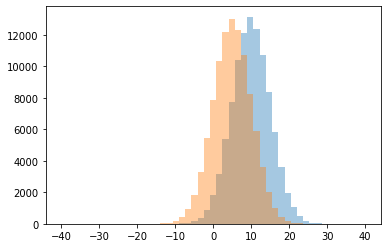

0 0.0
1 0.17647058823529413
2 0.18181818181818182
3 0.25
4 0.25301204819277107
5 0.3263888888888889
6 0.4
7 0.42750373692077726
8 0.4326241134751773
9 0.4977220956719818
10 0.5
11 0.5666965085049239
12 0.7227564102564102
13 0.9107142857142857
14 1.0
15 1.0474485228290062
16 1.3396017699115044
17 1.5929078014184397
18 2.127429805615551
19 2.4006734006734005
20 2.510869565217391
21 3.1875
22 3.306122448979592
23 3.9
24 4.416666666666667
25 6.0
26 999999.0




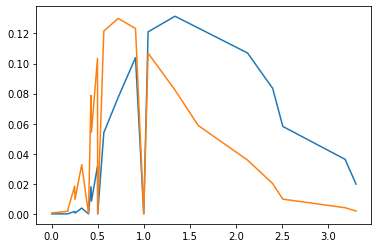

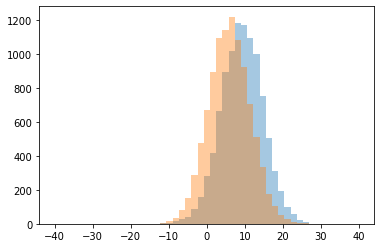

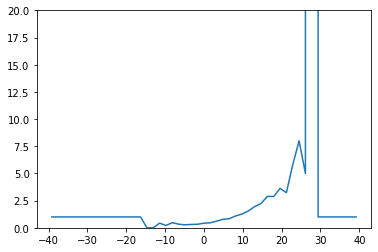

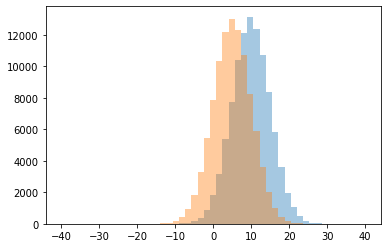

0 0.0
1 0.21428571428571427
2 0.2733333333333333
3 0.3087719298245614
4 0.32563025210084034
5 0.3333333333333333
6 0.4223880597014925
7 0.42857142857142855
8 0.4641255605381166
9 0.47058823529411764
10 0.6093321134492223
11 0.7833333333333333
12 0.8359310910582445
13 1.0
14 1.0895660203139428
15 1.269272529858849
16 1.5511363636363635
17 1.955078125
18 2.2373887240356085
19 2.878504672897196
20 2.8914285714285715
21 3.2333333333333334
22 3.6226415094339623
23 5.0
24 5.8
25 8.0
26 999999.0




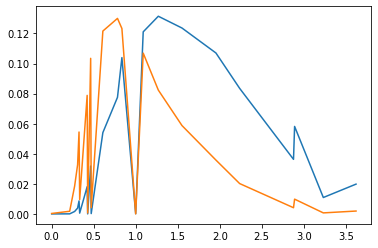

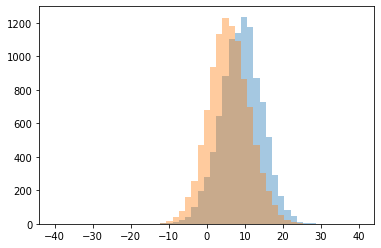

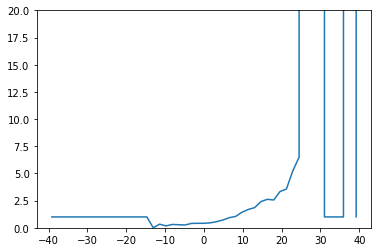

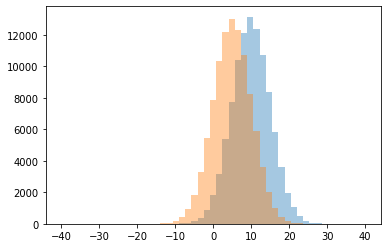

0 0.0
1 0.17647058823529413
2 0.2578616352201258
3 0.28378378378378377
4 0.3076923076923077
5 0.3333333333333333
6 0.40077821011673154
7 0.4148936170212766
8 0.415929203539823
9 0.4562899786780384
10 0.5677816901408451
11 0.7206840390879479
12 0.9330508474576271
13 1.0
14 1.0477064220183485
15 1.4333719582850522
16 1.6867816091954022
17 1.859275053304904
18 2.4139072847682117
19 2.5565217391304347
20 2.621212121212121
21 3.34
22 3.5652173913043477
23 5.222222222222222
24 6.5
25 999999.0




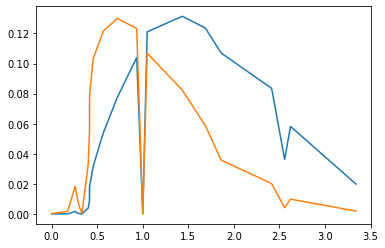

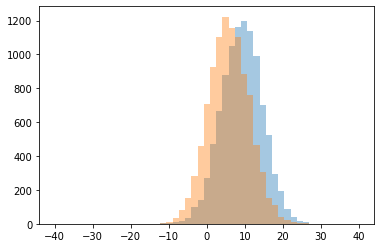

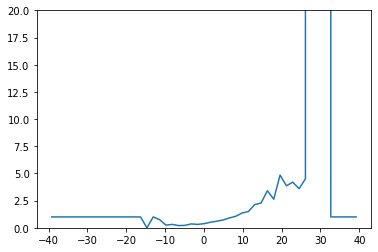

KeyboardInterrupt: 

In [25]:
import numpy as np
import matplotlib.pyplot as plt
np.seterr(all='ignore')

bins = np.linspace(-40,40,50)
centers = 0.5*(bins[1:] + bins[:-1])

def step1(N = 1000, f = 0., g = 1.):
    nAx,nAy = np.random.multinomial(N,[f, 1.-f])
    nBx,nBy = np.random.multinomial(N,[g, 1.-g])
    out = [nAx,nAy,nBx,nBy]
    return out

def step2(mux = 5, muy = 10, sx = 5, sy = 5, nx=10, ny=10):
    out = np.concatenate([np.random.normal(mux,sx,nx),np.random.normal(muy,sy,ny)])
    return out

def WS2(X_test, Y_test, N = 1000, f = 0.49, g = 0.51, mux = 5, muy = 10, sx = 5, sy = 5):
    step1vals = step1(N,f,g);
    A = step2(mux,muy,sx,sy,step1vals[0],step1vals[1]);
    B = step2(mux,muy,sx,sy,step1vals[2],step1vals[3]);
    
    plt.figure()
    plt.hist(A, bins = bins, alpha = 0.4)
    plt.hist(B, bins = bins, alpha = 0.4)
    
    plt.show()
    
    histA,_ = np.histogram(A,bins=bins)
    histB,_ = np.histogram(B,bins=bins)
    
    
    
    LLRs = np.nan_to_num(histA/histB,posinf=999999,neginf=999999,nan=1)
    

    plt.figure()
    plt.plot(centers, LLRs)
    plt.ylim(0,20)
    plt.show()
    
    
    LLRs_unique = list(set(LLRs))

    LLRs_unique.sort()
    
    plt.figure()
    plt.hist(X_test, bins = bins, alpha = 0.4)
    plt.hist(Y_test, bins = bins, alpha = 0.4)
    plt.show()

    histX,_ = np.histogram(X_test,bins=bins)
    histY,_ = np.histogram(Y_test,bins=bins)
    histX = histX/np.sum(histX)
    histY = histY/np.sum(histY)
    

    for i in range(len(LLRs_unique)):
        print(i, LLRs_unique[i])
    print()
    print()
    PRA = [np.sum(histX[LLRs == LLRs_unique[i]]) for i in range(len(LLRs_unique))]
    PRB = [np.sum(histY[LLRs == LLRs_unique[i]]) for i in range(len(LLRs_unique))]
    
    plt.figure()
    plt.plot(LLRs_unique[:-4], PRA[:-4])
    plt.plot(LLRs_unique[:-4], PRB[:-4])
    plt.xlabel("LLR")
    
    plt.show()

    AUC = 0.
    for i in range(len(PRA)):
        for j in range(i+1,len(PRB)):
            AUC += PRA[i]*PRB[j]
        AUC += 0.5*PRA[i]*PRB[i]

    AUC = max(AUC,1.-AUC)
    return (AUC)

N = 10000
mux = 5
muy = 10
sx = 5
sy = 5
ntoys = 100

step1vals_test = step1(100000,0.,1.);
X_test = step2(mux,muy,sx,sy,step1vals_test[0],step1vals_test[1]);
Y_test = step2(mux,muy,sx,sy,step1vals_test[2],step1vals_test[3]);

fs = []
for k in range(ntoys):
    fs+=[WS2(X_test,Y_test,N,0,1,mux,muy,sx,sy)]
    pass
fs.sort()

xvals_full = []
yvals_full = []
eyvals_full = []

xvals_weak = []
yvals_weak = []
eyvals_weak = []

for f in np.linspace(0.,1.,30):
    print("on f=",f)
    g = 1.-f
    ws2 = []
    for k in range(ntoys):
        ws2+=[WS2(X_test,Y_test,N,f,g,mux,muy,sx,sy)]
        pass
    ws2.sort()
    xvals_weak += [f]
    yvals_weak += [ws2[int(len(ws2)*0.5)]]
    eyvals_weak += [0.5*(ws2[int(len(ws2)*0.75)]-ws2[int(len(ws2)*0.25)])]

    xvals_full += [f]
    yvals_full += [fs[int(len(fs)*0.5)]]
    eyvals_full += [0.5*(fs[int(len(fs)*0.75)]-fs[int(len(fs)*0.25)])]
    pass

plt.errorbar(xvals_weak,yvals_weak,eyvals_weak,marker="^",color="blue",ls="")
plt.errorbar(xvals_full,yvals_full,eyvals_full,marker="o",color="black",ls="")
plt.ylim([0.5,1.])
plt.xlabel("$f_1(=1-f_2)$")
plt.ylabel("AUC")

plt.savefig('plot'+str(N)+'.pdf',bbox_inches='tight')